# Separate GS Inversion

In [2]:
%matplotlib inline
from IPython import display
from utils import *
import io_utils as io
import vis_utils as vis
import matplotlib.pyplot as plt
import matplotlib
import numpy as np
import pandas as pd
from scipy.stats import beta, expon, truncnorm, norm, uniform
from scipy.sparse.linalg import lsqr
from scipy.optimize import minimize
from time import process_time
from functools import reduce
from pandas import ExcelWriter
from pandas import ExcelFile
import xlrd
import re
import copy
from matplotlib import cm

pd.options.display.float_format = '{:,g}'.format
plt.style.use(['ggplot'])

In [3]:
filename = "./data/colima/colima_real_data.csv"

raw_df, grid = io.import_colima(filename)

grid.to_csv("data/colima/colima_grid.csv", sep=" ", header=False, index=False)

display.display(raw_df)

,Sample no.,Easting,Northing,MassArea,Thickness,"[-5,-4)","[-4,-3)","[-3,-2)","[-2,-1)","[-1,0)","[0,1)","[1,2)","[2,3)","[3,4)",radius
16,VF0004a,1499,1506,625.8,60,19.2,31,18,11,6,2,1,0.6,0.9,"2,124.86"
18,VF0006a3,1957,1997,417.2,40,6.7,30,25,17,11,5,1,0.8,0.8,"2,796.04"
17,VF0005a3,1787,2173,500.64,48,10.1,30,24,16,9,3,1,0.7,1,"2,813.41"
37,VF0603509,-770,3082,594.51,57,11.3,25,25,19,11,4,1,0.6,0.5,"3,176.73"
31,VF0508a3,-1673,3152,125.16,12,10,22,24,16,10,4,2,0.8,0.8,"3,568.48"
36,VF0518a3,-637,4876,166.88,16,3.1,21,25,22,16,7,2,0.9,0.8,"4,917.43"
35,VF0517a,-1268,5048,125.16,12,9.8,14,17,20,17,10,4,2.1,1.8,"5,204.82"
34,VF0516a3,-2101,5517,93.87,9,4.1,15,19,19,19,12,4,2.6,2.8,"5,903.52"
33,VF0514a3,-2250,5771,62.58,6,0.1,9,13,19,21,14,7,4.6,5.6,"6,194.11"
32,VF0513a,-2272,5925,62.58,6,4.2,9,17,19,17,11,8,5.5,4.2,"6,345.68"


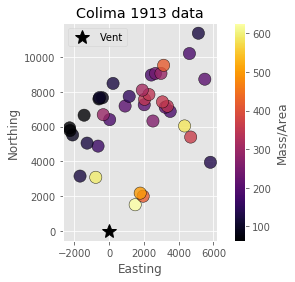

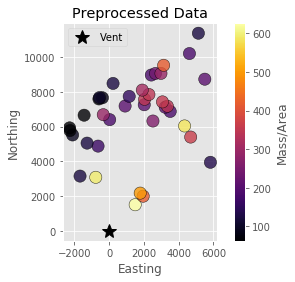

In [4]:
vis.plot_sample(raw_df, vent=(0,0), log=False, title="Colima 1913 data", cbar_label="Mass/Area")
plt.show()
# plt.savefig("colima/all_points.png", dpi=200, format='png')

obs_df = raw_df.copy()

# obs_df = obs_df.drop([16, 18, 17, 37, 31])
#This is going to be 100 across. Just needs to be the same as the other dfs. 
obs_df["Residual"] = obs_df["MassArea"]/obs_df["MassArea"]*100

vis.plot_sample(obs_df, vent=(0,0), log=False, title="Preprocessed Data", cbar_label="Mass/Area")
# plt.savefig("colima/All_trans.png", dpi=200, format='png')
plt.show()

In [5]:
t2_const_df, _, _, _ = io.read_tephra2("data/colima/colima_tephra2_const_wind_sim_data.txt")

t2_const_df["Residual"] = t2_const_df["MassArea"]/obs_df["MassArea"]

display.display(t2_const_df.head())

,Easting,Northing,Elevation,MassArea,"[-5,-4)","[-4,-3)","[-3,-2)","[-2,-1)","[-1,0)","[0,1)","[1,2)","[2,3)","[3,4)",radius,Residual
16,1499,1506,2500,"1,394.46",17.2005,24.2121,24.7779,18.9162,10.8457,3.58293,0.449327,0.015328,2.84769e-05,"2,124.86",2.22828
18,1957,1997,2500,"1,216.15",14.016,22.3619,24.864,20.2838,12.7356,4.93885,0.76913,0.0307052,6.30498e-05,"2,796.04",2.91503
17,1787,2173,2500,"1,251",13.877,22.2837,24.8861,20.3522,12.8046,4.98427,0.780754,0.0313104,6.44789e-05,"2,813.41",2.4988
37,-770,3082,2500,359.399,14.8025,22.8299,24.5313,19.4545,12.2828,5.13528,0.922533,0.0410962,9.09858e-05,"3,176.73",0.60453
31,-1673,3152,2500,134.301,15.3664,23.3283,24.4813,18.8191,11.7036,5.16746,1.07907,0.054478,0.000131905,"3,568.48",1.07303


In [6]:
config = io.read_tephra2_config("data/colima/colima_config.txt")

globs = {
    "LITHIC_DIAMETER_THRESHOLD": 7.,
    "PUMICE_DIAMETER_THRESHOLD": -1.,
    "AIR_VISCOSITY": 0.000018325,
    "AIR_DENSITY":  1.293,
    "GRAVITY": 9.81,
}






# Update parameters
# COL STEPS need to be small enough so the 
# layer height can be kept for an inversion with a high H
config["COL_STEPS"] = 20
theoretical_max = 45000 #The H value will be as close as possible to this
layer_thickness = ((config["PLUME_HEIGHT"]-config["VENT_ELEVATION"])/config["COL_STEPS"])

inversion_steps = np.round((config["COL_STEPS"]*(theoretical_max - config["VENT_ELEVATION"]))/\
                  (config["PLUME_HEIGHT"]-config["VENT_ELEVATION"]))
closest_H = ((inversion_steps*(config["PLUME_HEIGHT"] - config["VENT_ELEVATION"]))/\
             config["COL_STEPS"]) + config["VENT_ELEVATION"]
print("This number needs to be low enough to invert efficiently:")
print(inversion_steps)
print("If not, decrease COL_STEPS or theoretical max")
print("Closest Possible Theoretical Max Column Height:")
print(closest_H)

config["INV_STEPS"] = int(inversion_steps)
config["THEO_MAX_COL"] = closest_H
config["PART_STEPS"] = 9

config["MAX_GRAINSIZE"] = -5
config["MIN_GRAINSIZE"] = 4

# Additional parameter: Constant wind speed
config["WIND_SPEED"] = 10

# To ensure monotonicity:
# config["DIFFUSION_COEFFICIENT"] = 1.7*config["FALL_TIME_THRESHOLD"]

print("INPUT PARAMETERS:")
display.display(config)
display.display(globs)

This number needs to be low enough to invert efficiently:
40.0
If not, decrease COL_STEPS or theoretical max
Closest Possible Theoretical Max Column Height:
44915.0
INPUT PARAMETERS:


{'VENT_EASTING': 0.0,
 'VENT_NORTHING': 0.0,
 'VENT_ELEVATION': 3085.0,
 'PLUME_HEIGHT': 24000.0,
 'ALPHA': 1.02,
 'BETA': 1.56,
 'ERUPTION_MASS': 55000000000.0,
 'MAX_GRAINSIZE': -5,
 'MIN_GRAINSIZE': 4,
 'MEDIAN_GRAINSIZE': -1.8,
 'STD_GRAINSIZE': 2.4,
 'EDDY_CONST': 0.04,
 'DIFFUSION_COEFFICIENT': 4016.0,
 'FALL_TIME_THRESHOLD': 6458.0,
 'LITHIC_DENSITY': 2700.0,
 'PUMICE_DENSITY': 1024.0,
 'COL_STEPS': 20,
 'PART_STEPS': 9,
 'PLUME_MODEL': 2.0,
 'INV_STEPS': 40,
 'THEO_MAX_COL': 44915.0,
 'WIND_SPEED': 10}

{'LITHIC_DIAMETER_THRESHOLD': 7.0,
 'PUMICE_DIAMETER_THRESHOLD': -1.0,
 'AIR_VISCOSITY': 1.8325e-05,
 'AIR_DENSITY': 1.293,
 'GRAVITY': 9.81}

,centroid,density,interval,lower,probability,upper
0,-4.5,"1,024","[-5,-4)",-5,0.0683375,-4
1,-3.5,"1,024","[-4,-3)",-4,0.109203,-3
2,-2.5,"1,024","[-3,-2)",-3,0.146694,-2
3,-1.5,"1,024","[-2,-1)",-2,0.16565,-1
4,-0.5,"1,024","[-1,0)",-1,0.157243,0
5,0.5,"1,233.5","[0,1)",0,0.125474,1
6,1.5,"1,443","[1,2)",1,0.0841661,2
7,2.5,"1,652.5","[2,3)",2,0.0474595,3
8,3.5,"1,862","[3,4)",3,0.0224962,4


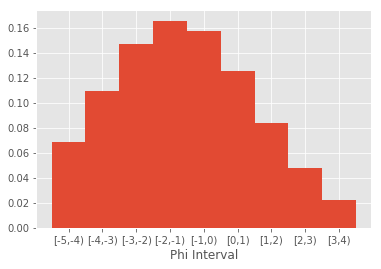

In [7]:
theo_phi_steps = get_phi_steps(config["MIN_GRAINSIZE"], config["MAX_GRAINSIZE"], 
                          config["PART_STEPS"], 
                          config["MEDIAN_GRAINSIZE"], config["STD_GRAINSIZE"],
                          globs["LITHIC_DIAMETER_THRESHOLD"], 
                          globs["PUMICE_DIAMETER_THRESHOLD"], 
                          config["LITHIC_DENSITY"], config["PUMICE_DENSITY"])
step_width = (config["MAX_GRAINSIZE"] - config["MIN_GRAINSIZE"])/config["PART_STEPS"]

display.display(pd.DataFrame(theo_phi_steps))



probs = [phi["probability"].copy() for phi in theo_phi_steps]
x = [phi["centroid"] for phi in theo_phi_steps]
labels = [phi["interval"] for phi in theo_phi_steps]
fig, ax = plt.subplots(facecolor='w', edgecolor='k')
ax.bar(x, probs, width=1, align="center")
ax.set_xticks(x)
ax.set_xticklabels(labels)
plt.xlabel("Phi Interval")
plt.show()

[0.05231643 0.16945065 0.20390996 0.20809308 0.19893822 0.12429353
 0.02893896 0.00704844 0.00701073]
[-4.5, -3.5, -2.5, -1.5, -0.5, 0.5, 1.5, 2.5, 3.5]


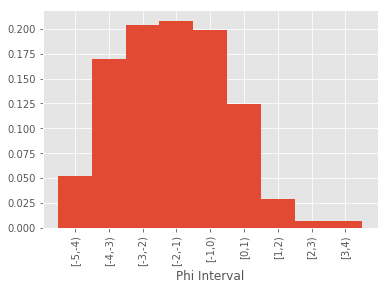

[{'lower': -5, 'upper': -4.0, 'interval': '[-5,-4)', 'centroid': -4.5, 'density': 1024.0, 'probability': 0.052316431318540024}, {'lower': -4.0, 'upper': -3.0, 'interval': '[-4,-3)', 'centroid': -3.5, 'density': 1024.0, 'probability': 0.1694506511837887}, {'lower': -3.0, 'upper': -2.0, 'interval': '[-3,-2)', 'centroid': -2.5, 'density': 1024.0, 'probability': 0.20390996005463202}, {'lower': -2.0, 'upper': -1.0, 'interval': '[-2,-1)', 'centroid': -1.5, 'density': 1024.0, 'probability': 0.2080930801364657}, {'lower': -1.0, 'upper': 0.0, 'interval': '[-1,0)', 'centroid': -0.5, 'density': 1024.0, 'probability': 0.19893821897376404}, {'lower': 0.0, 'upper': 1.0, 'interval': '[0,1)', 'centroid': 0.5, 'density': 1233.5, 'probability': 0.12429352702169855}, {'lower': 1.0, 'upper': 2.0, 'interval': '[1,2)', 'centroid': 1.5, 'density': 1443.0, 'probability': 0.028938961877603735}, {'lower': 2.0, 'upper': 3.0, 'interval': '[2,3)', 'centroid': 2.5, 'density': 1652.5, 'probability': 0.00704844304499

In [8]:
naive_tgsd = get_tgsd(obs_df, theo_phi_steps)
print(naive_tgsd)
print(x)
fig, ax = plt.subplots(facecolor='w', edgecolor='k')
ax.bar(x, naive_tgsd, width=1, align="center")
ax.set_xticks(x)
ax.set_xticklabels(labels, rotation=90)
plt.xlabel("Phi Interval")
plt.show()

naive_phi_steps = theo_phi_steps.copy()
for i, phi in enumerate(naive_phi_steps):
    phi["probability"] = naive_tgsd[i]
print(naive_phi_steps)

In [9]:

grid = obs_df[["Easting", "Northing"]]
wind_angle = np.radians(55)

u = config["WIND_SPEED"]*np.cos(wind_angle)
v = config["WIND_SPEED"]*np.sin(wind_angle)

forward_df = gaussian_stack_forward(
    grid, int(config["COL_STEPS"]), config["VENT_ELEVATION"], 
    config["PLUME_HEIGHT"], 2500, naive_phi_steps, (config["ALPHA"], config["BETA"]), 
    config["ERUPTION_MASS"], 
    (u,v), config["DIFFUSION_COEFFICIENT"], config["EDDY_CONST"],
    config["FALL_TIME_THRESHOLD"]
)

forward_df["radius"] = np.sqrt(forward_df["Easting"]**2 + forward_df["Northing"]**2)
forward_df = forward_df.sort_values(by=['radius'])
forward_df["Residual"] = forward_df["MassArea"].values/obs_df["MassArea"].values
display.display(forward_df.head())

print(u, v)

,Northing,Easting,"[-5,-4)","[-4,-3)","[-3,-2)","[-2,-1)","[-1,0)","[0,1)","[1,2)","[2,3)","[3,4)",MassArea,radius,Residual
0,1506,1499,10.2913,29.5685,27.288,18.924,10.9616,2.84099,0.123803,0.001825,7.10812e-06,"1,678.84","2,124.86",2.68271
1,1997,1957,8.3142,27.1464,27.2807,20.2572,12.8676,3.91805,0.212099,0.00365928,1.57598e-05,"1,462.8","2,796.04",3.50624
2,2173,1787,8.22952,27.0446,27.2982,20.3207,12.9346,3.95335,0.215267,0.00373077,1.61147e-05,"1,504.98","2,813.41",3.00611
3,3082,-770,8.7488,27.7372,27.0418,19.5747,12.5223,4.11323,0.256923,0.00494637,2.29538e-05,428.027,"3,176.73",0.719966
4,3152,-1673,9.0285,28.313,27.0764,19.0615,12.0333,4.17711,0.303382,0.0066199,3.35645e-05,158.425,"3,568.48",1.26578


5.7357643635104605 8.191520442889917


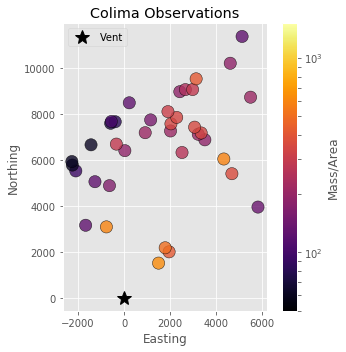

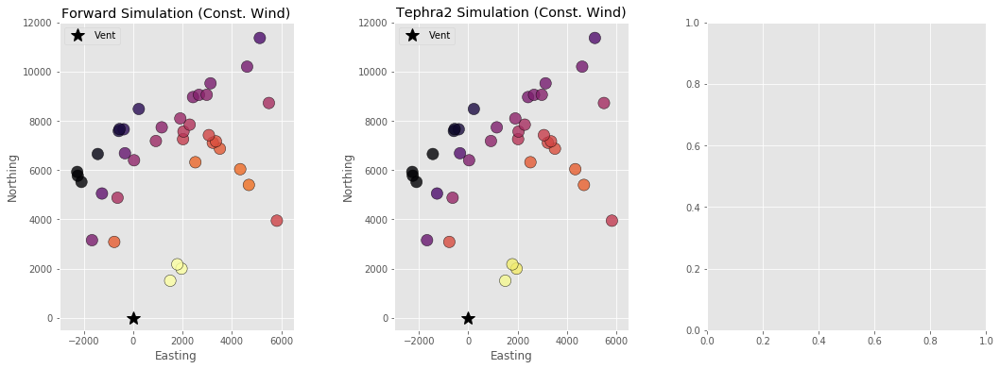

In [10]:

fig, ax = plt.subplots(1, 1, figsize=(5,5))

vis.plot_sample(obs_df, vent=(0,0), log=True, bounds=(50, 1500),
            title="Colima Observations", cbar_label="Mass/Area", ax = ax)
plt.tight_layout()
plt.show()


fig, axs = plt.subplots(1, 3, figsize=(
        18,6), facecolor='w', edgecolor='k')
axs = axs.ravel()

vis.plot_sample(forward_df, vent=(0,0), log=True, bounds=(50, 1500), show_cbar=False,
            title="Forward Simulation (Const. Wind)", cbar_label="Mass/Area", ax=axs[0])
vis.plot_sample(t2_const_df, vent=(0,0), log=True, bounds=(50, 1500), show_cbar=False,
            title="Tephra2 Simulation (Const. Wind)", cbar_label="Mass/Area", ax=axs[1])
# vis.plot_sample(t2_df, vent=(0,0), log=True, bounds=(50, 1500),
#             title="Tephra2 Simulation (NOAA Wind)", cbar_label="Mass/Area", ax=axs[2])
axs[0].set_xlim([-3000, 6500])
axs[0].set_ylim([-500, 12000])
axs[1].set_xlim([-3000, 6500])
axs[1].set_ylim([-500, 12000])
plt.show()




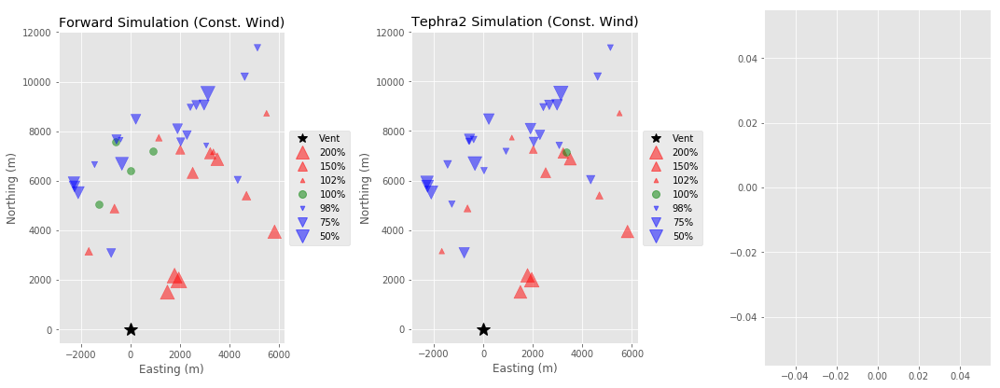

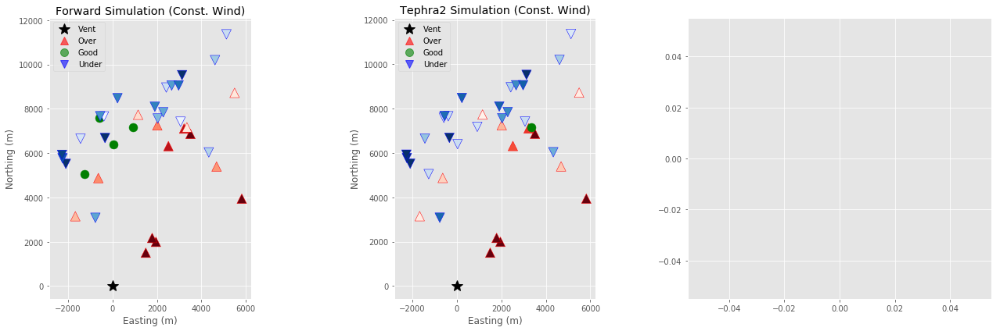

In [11]:
fig, axs = plt.subplots(1, 3, figsize=(
        15,6), facecolor='w', edgecolor='k')
axs = axs.ravel()


vis.plot_residuals(forward_df, vent=(0,0), values="Residual",
            title="Forward Simulation (Const. Wind)", 
            plot_type = "size", ax=axs[0])
vis.plot_residuals(t2_const_df, vent=(0,0), values="Residual",
            title="Tephra2 Simulation (Const. Wind)", 
             plot_type = "size", ax=axs[1])
# vis.plot_residuals(t2_df, vent=(0,0), values="Residual",
#             title="Tephra2 Simulation (NOAA Wind)", 
#              plot_type = "size", ax=axs[2])


plt.tight_layout()
plt.show()

fig, axs = plt.subplots(1, 3, figsize=(
        18,6), facecolor='w', edgecolor='k')
axs = axs.ravel()


vis.plot_residuals(forward_df, vent=(0,0), values="Residual",
            title="Forward Simulation (Const. Wind)", 
            plot_type = "cmap", ax=axs[0], show_cbar = False)
vis.plot_residuals(t2_const_df, vent=(0,0), values="Residual",
            title="Tephra2 Simulation (Const. Wind)", 
             plot_type = "cmap", ax=axs[1], show_cbar = False)
# vis.plot_residuals(t2_df, vent=(0,0), values="Residual",
#             title="Tephra2 Simulation (NOAA Wind)", 
#              plot_type = "cmap", ax=axs[2], show_cbar = True)


# plt.tight_layout()
plt.show()

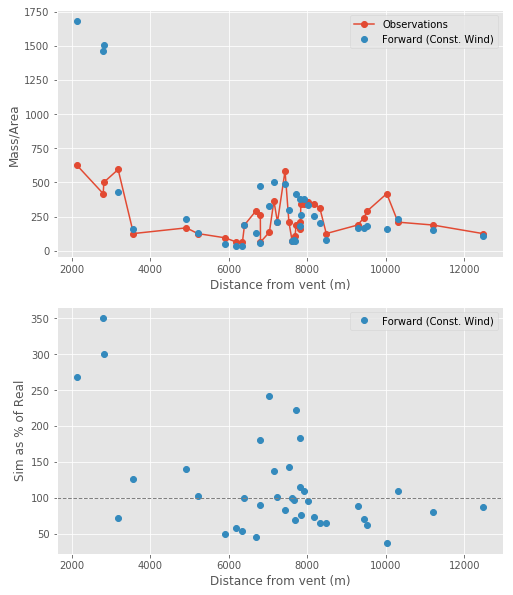

In [12]:
fig, axs = plt.subplots(2,1, figsize=(
        8,10), facecolor='w', edgecolor='k')
axs = axs.ravel()

axs[0].plot(obs_df["radius"].values, obs_df["MassArea"].values, 'C0o-', label="Observations")
# plt.plot(rotdf["radius"].values, rotdf["MassArea"].values, 'C1o-')
axs[0].plot(forward_df["radius"].values, forward_df["MassArea"].values, 'C1o', label="Forward (Const. Wind)")
# axs[0].plot(t2_const_df["radius"].values, t2_const_df["MassArea"].values, 'C2o', label="Tephra2 (Const. Wind)")
# axs[0].plot(t2_df["radius"].values, t2_df["MassArea"].values, 'C3o', label="Tephra2 (NOAA Wind)")
axs[0].legend()
axs[0].set_xlabel("Distance from vent (m)")
axs[0].set_ylabel("Mass/Area")

axs[1].plot(forward_df["radius"].values, forward_df["Residual"].values*100, 'C1o', label="Forward (Const. Wind)")
# axs[1].plot(t2_const_df["radius"].values, t2_const_df["Residual"].values*100, 'C2o', label="Tephra2 (Const. Wind)")
# axs[1].plot(t2_df["radius"].values, t2_df["Residual"].values*100, 'C3o', label="Tephra2 (NOAA Wind)")
axs[1].axhline(100, linestyle="--", lw=1, c="gray")
axs[1].legend()
axs[1].set_xlabel("Distance from vent (m)")
axs[1].set_ylabel("Sim as % of Real")
plt.show()

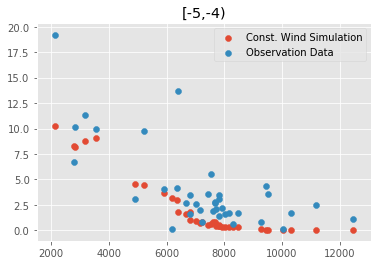

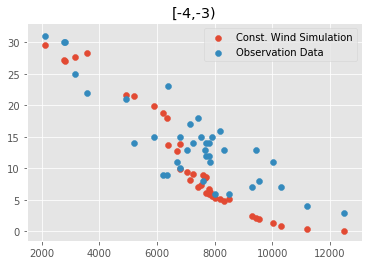

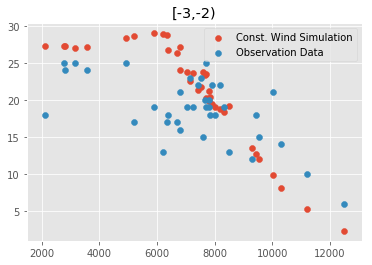

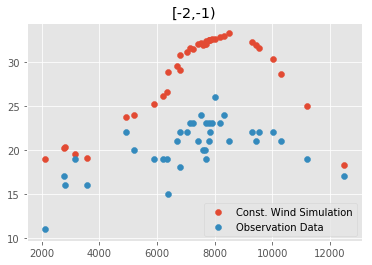

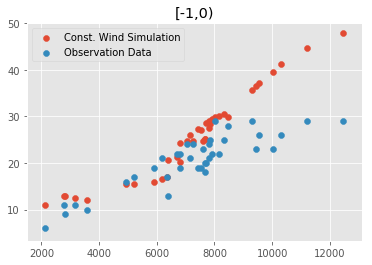

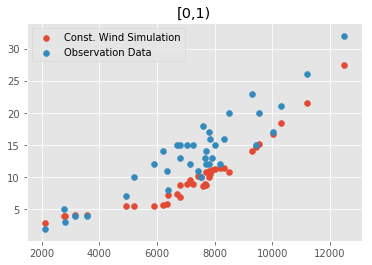

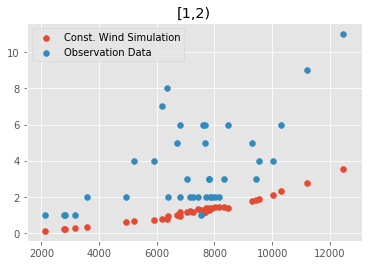

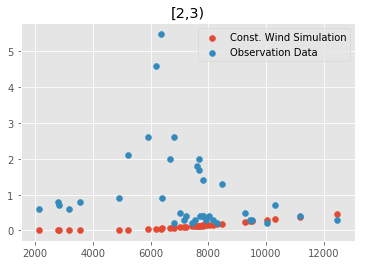

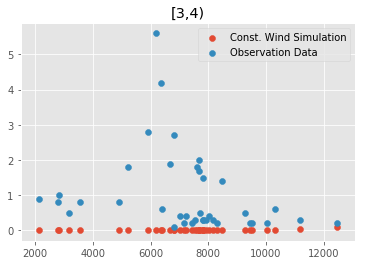

In [13]:
#TGSD calculation?
forward_tgsd = []
# t2_const_tgsd = []
# t2_tgsd = []
obs_tgsd = []
for phi_step in naive_phi_steps:
    plt.scatter(forward_df["radius"], forward_df[phi_step["interval"]], label="Const. Wind Simulation")
#     plt.scatter(t2_const_df["radius"], t2_const_df[phi_step["interval"]], label="T2 Const. Wind Simulation")
#     plt.scatter(t2_df["radius"], t2_df[phi_step["interval"]], label="T2 NOAA Wind Simulation")
    plt.scatter(obs_df["radius"], obs_df[phi_step["interval"]], label="Observation Data")
    plt.legend()
    plt.title(phi_step["interval"])
    plt.show()
    
    forward_tgsd += [forward_df[phi_step["interval"]].sum()/len(forward_df)]
#     t2_const_tgsd += [t2_const_df[phi_step["interval"]].sum()/len(t2_const_df)]
#     t2_tgsd += [t2_df[phi_step["interval"]].sum()/len(t2_df)]
    obs_tgsd += [obs_df[phi_step["interval"]].sum()/len(obs_df)]

In [14]:


def col_truncnorm(mean, top=config["THEO_MAX_COL"]):
    bottom = 5000
    std = (top - bottom)/4
    standard_a, standard_b = (bottom - mean) / std, (top - mean) / std
    return truncnorm.rvs(standard_a, standard_b, loc=mean, scale=std)

def lognorm(prior, bottom=0):
    std_norm = norm.rvs()
    std_lognorm = np.exp(std_norm)
    lognorm = bottom + (prior-bottom)*std_lognorm
    return lognorm

def normal(prior):
    std_norm = norm.rvs()
    normal = prior*std_norm
    return normal

def uninformed(bottom, top):
    unif = uniform.rvs(loc = bottom, scale = (top-bottom))
    return unif


In [15]:
full_inversion_priors = {
    "a": 1.00002,
    "b": 1.13405,
    "h1": 44908,
    "u": 2.60482,
    "v": 5.33615,
    "D": 5999.9,
    "ftt": 6458,
    "eta": 2.34894,
    "zeta": 0
}

phi_probs = [
    0.058657896918929336,
    0.15114329504320803,
    0.15644352749157492,
    0.15138125134809738,
    0.17100876050061856,
    0.1814490666782764,
    0.06799943098150356,
    0.01682410991463832,
    0.045092661123153584
]

,invert,sample_function,value
a,True,<function uninformed at 0x000001C7A6731510>,"[1.01, 5]"
b,True,<function uninformed at 0x000001C7A6731510>,"[1.01, 5]"
h1,True,<function uninformed at 0x000001C7A6731510>,"[5000, 44915.0]"
u,False,<function uninformed at 0x000001C7A6731510>,"[2.60482, 10]"
v,False,<function uninformed at 0x000001C7A6731510>,"[5.33615, 10]"
D,False,<function uninformed at 0x000001C7A6731510>,"[5999.9, 6000]"
ftt,False,<function uninformed at 0x000001C7A6731510>,"[6458.0, 10000]"
eta,False,<function uninformed at 0x000001C7A6731510>,"[2.34894, 10]"
zeta,False,<function uninformed at 0x000001C7A6731510>,"[0, 0]"


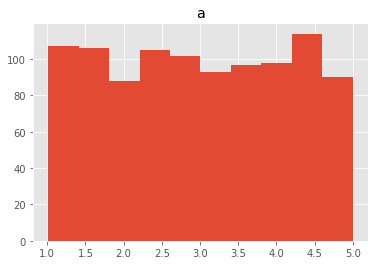

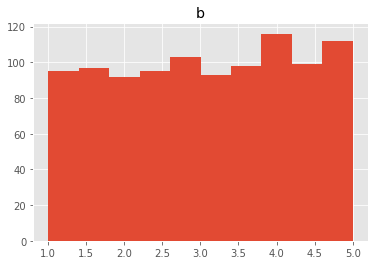

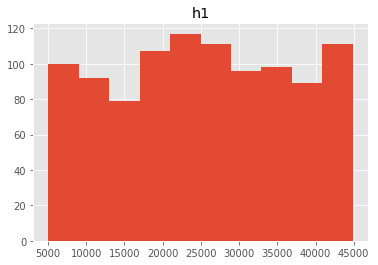

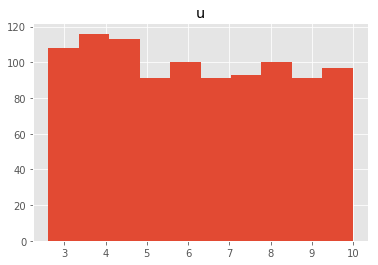

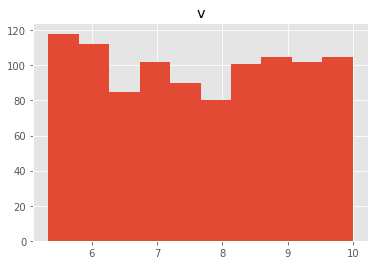

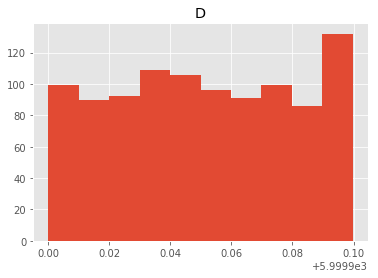

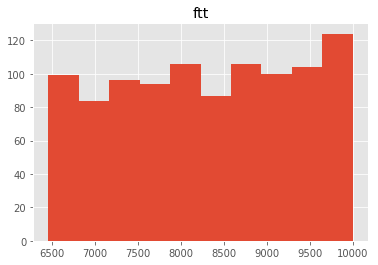

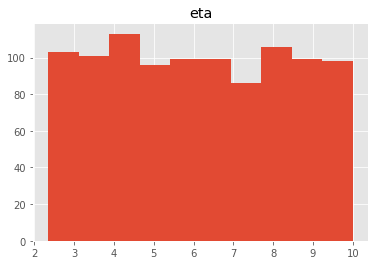

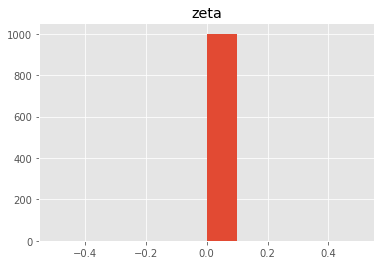

In [16]:
param_config = {
    "a": {
        "value":[1.01, 5],
        "invert":True,
        "sample_function": uninformed
    },
    "b": {
        "value":[1.01, 5],
        "invert":True,
        "sample_function": uninformed
    },
    "h1": {
        "value":[5000, config["THEO_MAX_COL"]],
        "invert":True,
        "sample_function": uninformed
    },
    "u": {
        "value":[full_inversion_priors["u"], 10],
        "invert":False,
        "sample_function": uninformed
    },
    "v": {
        "value":[full_inversion_priors["v"], 10],
        "invert":False,
        "sample_function": uninformed
    },
    "D": {
        "value":[full_inversion_priors["D"], 6000],
        "invert":False,
        "sample_function": uninformed
    },
    "ftt": {
        "value":[config["FALL_TIME_THRESHOLD"], 10000],
        "invert":False,
        "sample_function": uninformed
    },
    "eta": {
        "value":[full_inversion_priors["eta"], 10],
        "invert":False,
        "sample_function": uninformed
    },
    "zeta": {
        "value":[0, 0],
        "invert":False,
        "sample_function": uninformed
    },
}


# param_config = {
#     "a": {
#         "value":[full_inversion_priors["a"], 5],
#         "invert":False,
#         "sample_function": uninformed
#     },
#     "b": {
#         "value":[full_inversion_priors["b"], 5],
#         "invert":False,
#         "sample_function": uninformed
#     },
#     "h1": {
#         "value":[full_inversion_priors["h1"], config["THEO_MAX_COL"]],
#         "invert":False,
#         "sample_function": uninformed
#     },
#     "u": {
#         "value":[full_inversion_priors["u"], 10],
#         "invert":False,
#         "sample_function": uninformed
#     },
#     "v": {
#         "value":[full_inversion_priors["v"], 10],
#         "invert":False,
#         "sample_function": uninformed
#     },
#     "D": {
#         "value":[full_inversion_priors["D"], 6000],
#         "invert":False,
#         "sample_function": uninformed
#     },
#     "ftt": {
#         "value":[config["FALL_TIME_THRESHOLD"], 10000],
#         "invert":False,
#         "sample_function": uninformed
#     },
#     "eta": {
#         "value":[full_inversion_priors["eta"], 10],
#         "invert":False,
#         "sample_function": uninformed
#     },
#     "zeta": {
#         "value":[0, 0],
#         "invert":False,
#         "sample_function": uninformed
#     },
# }

param_config_df = pd.DataFrame(param_config)
display.display(param_config_df.T)

for key, val in param_config.items():
    x = [val["sample_function"](*val["value"]) for i in range(1000)]
    plt.hist(x)
    plt.title(key)
    plt.show()



========[-5,-4)========
Run 0===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	4.89e+02 	4.77e+02 	0.9761 		1.0000


C:\Users\nmostert\Documents\repos\inversion_project\utils.py:452: RuntimeWarning: divide by zero encountered in log
  return np.log(p)


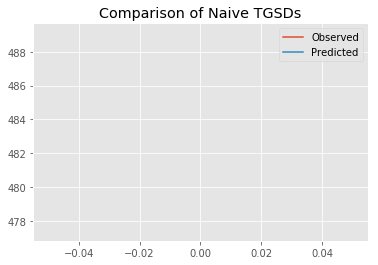

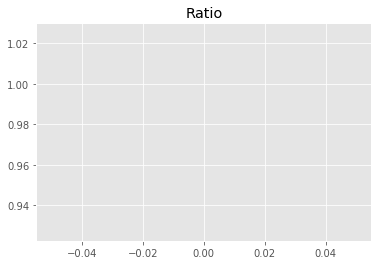

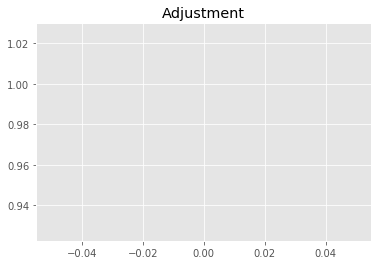

2808765173.849925
1


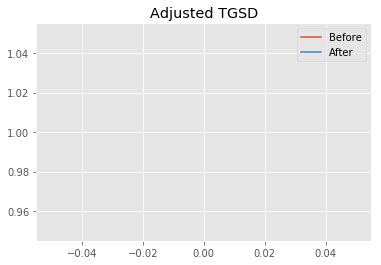

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.20855 	1.90749 	38788.9 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 2.8774e+09
After: 		|2.47139 	1.96607 	44308.6 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 384.403
New Misfit: 287.725
Convergence:
0.2515030613588183

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	5.06e+02 	4.77e+02 	0.9430 		1.0000


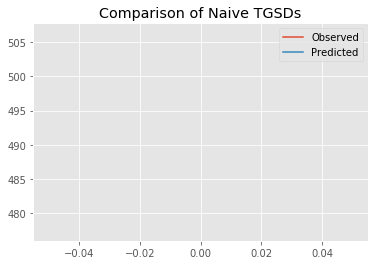

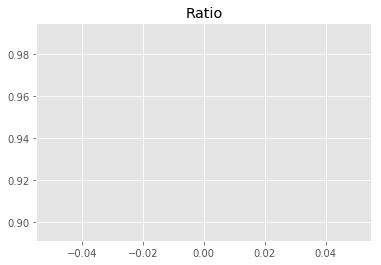

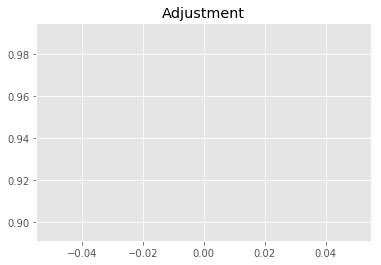

2713349020.36946
1


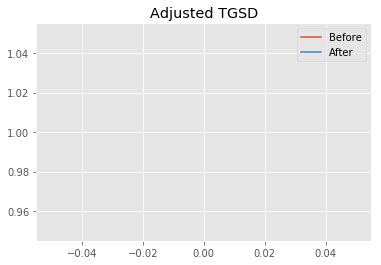

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.47139 	1.96607 	44308.6 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 2.8774e+09
After: 		|2.74835 	1.96097 	44914.8 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 287.725
New Misfit: 282.54
Convergence:
0.018020284809860863

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	5.13e+02 	4.77e+02 	0.9306 		1.0000


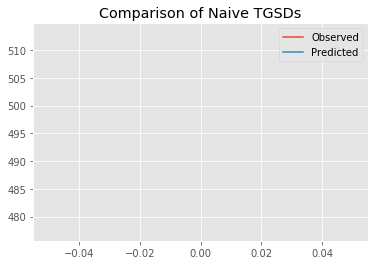

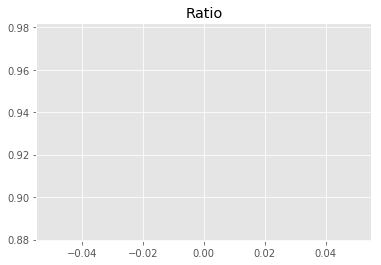

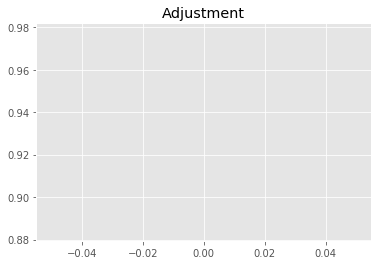

2677785369.389688
1


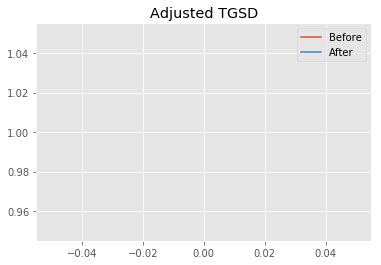

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.74835 	1.96097 	44914.8 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 2.8774e+09
After: 		|1.75135 	1.37132 	44915 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 282.54
New Misfit: 270.94
Convergence:
0.041054149346010406

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	4.99e+02 	4.77e+02 	0.9568 		1.0000


C:\Users\nmostert\Documents\repos\inversion_project\utils.py:473: RuntimeWarning: divide by zero encountered in double_scalars
  factor_a = (1/((a-1)*(b-1)*(H-h1)))


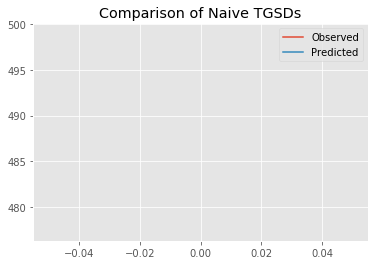

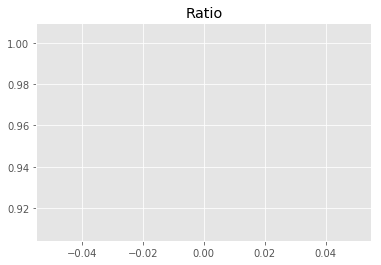

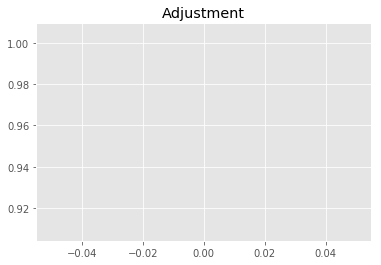

2753090817.930489
1


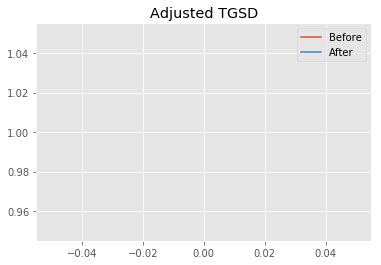

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.75135 	1.37132 	44915 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0


C:\Users\nmostert\Documents\repos\inversion_project\utils.py:457: RuntimeWarning: divide by zero encountered in log
  h1_star = -np.log(-np.log(h1/H))
c:\users\nmostert\envs\spew\lib\site-packages\scipy\optimize\optimize.py:562: RuntimeWarning: invalid value encountered in subtract
  if (numpy.max(numpy.ravel(numpy.abs(sim[1:] - sim[0]))) <= xatol and
c:\users\nmostert\envs\spew\lib\site-packages\numpy\core\_methods.py:26: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims)
c:\users\nmostert\envs\spew\lib\site-packages\scipy\optimize\optimize.py:567: RuntimeWarning: invalid value encountered in subtract
  xr = (1 + rho) * xbar - rho * sim[-1]
C:\Users\nmostert\Documents\repos\inversion_project\utils.py:439: RuntimeWarning: invalid value encountered in less
  heights = z[(z>=z_min) & (z<h1)]
C:\Users\nmostert\Documents\repos\inversion_project\utils.py:444: RuntimeWarning: invalid value encountered in less
  plume[(z>=z_min) & (z<h1)] = 

New Total Mass: 2.8774e+09
After: 		|1.75135 	1.35338 	44915 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 270.94
New Misfit: 270.252
Convergence:
0.002541576671685036

____________________
a = 1.75135	b = 1.35338	            h1 = 44915.00000	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 2877403722.51970
Success: True
Status: Successful convergence.
Iterations: 4
Misfit: 270.2518147592888
Prior Misfit: 384.403,	 Post Misfit: 270.252


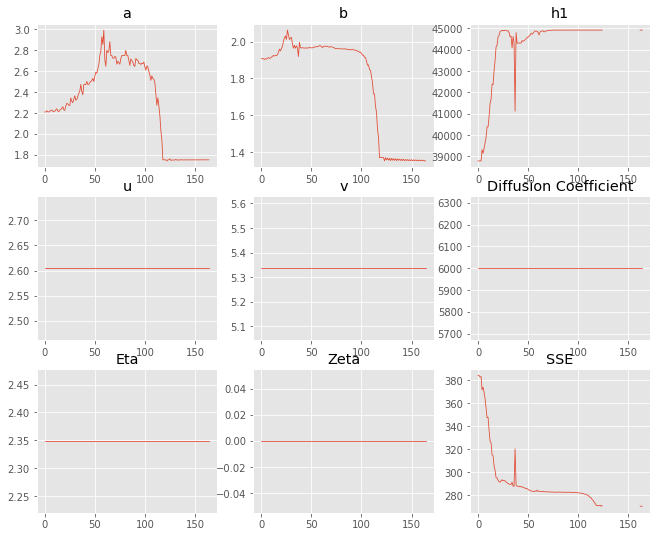

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,2.20855,1.75135
b,1.90749,1.35338
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"38,788.9","44,915"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 1 Time: 0.087 minutes


Estimated remaining run time: 0.780 minutes


Run 1===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	4.84e+02 	4.77e+02 	0.9867 		1.0000


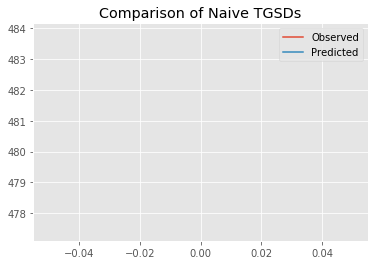

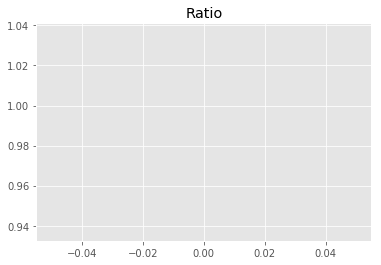

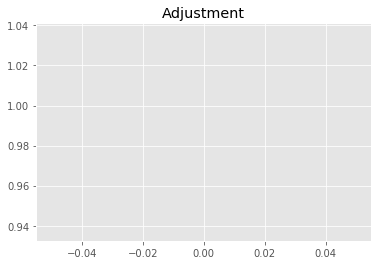

2839243701.5988255
1


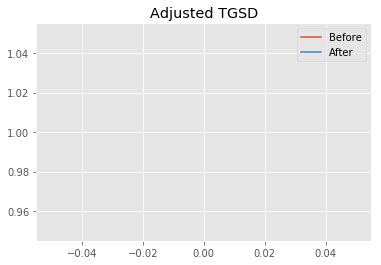

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.52325 	3.25441 	35907.2 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 2.8774e+09
After: 		|1.54512 	1.21536 	44812.2 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 659.511
New Misfit: 267.733
Convergence:
0.5940429446451871

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	4.95e+02 	4.77e+02 	0.9646 		1.0000


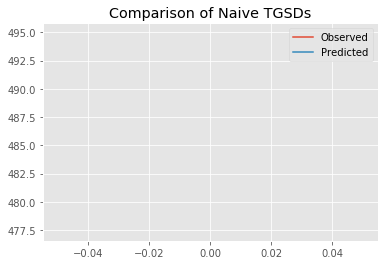

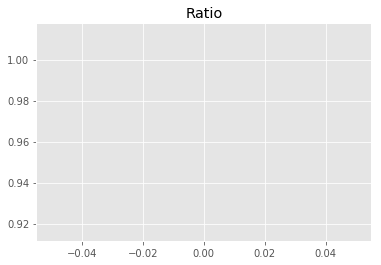

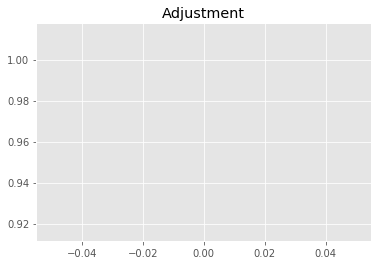

2775665459.5471644
1


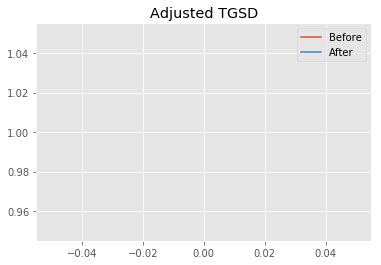

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.54512 	1.21536 	44812.2 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 2.8774e+09
After: 		|1.49602 	1.03684 	43969.3 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 267.733
New Misfit: 262.994
Convergence:
0.017700334439471364

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	4.98e+02 	4.77e+02 	0.9580 		1.0000


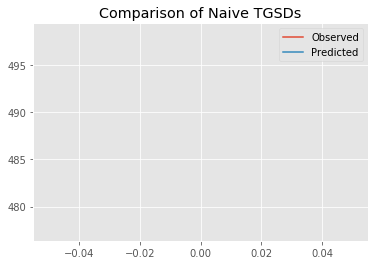

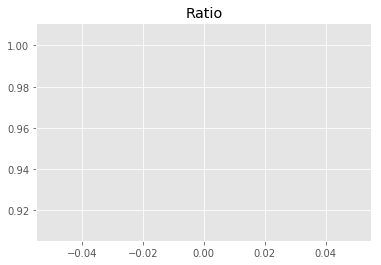

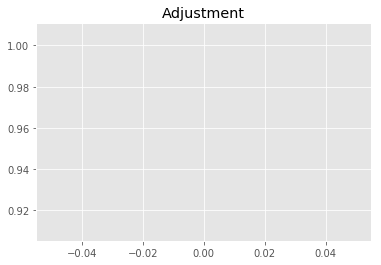

2756530517.177307
1


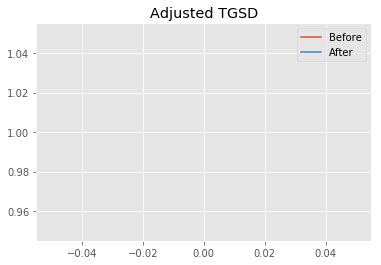

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.49602 	1.03684 	43969.3 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 2.8774e+09
After: 		|1.39944 	1.00008 	44876.3 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 262.994
New Misfit: 261.877
Convergence:
0.004250201219623855

____________________
a = 1.39944	b = 1.00008	            h1 = 44876.33670	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 2877403722.51970
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 261.8765112222007
Prior Misfit: 659.511,	 Post Misfit: 261.877


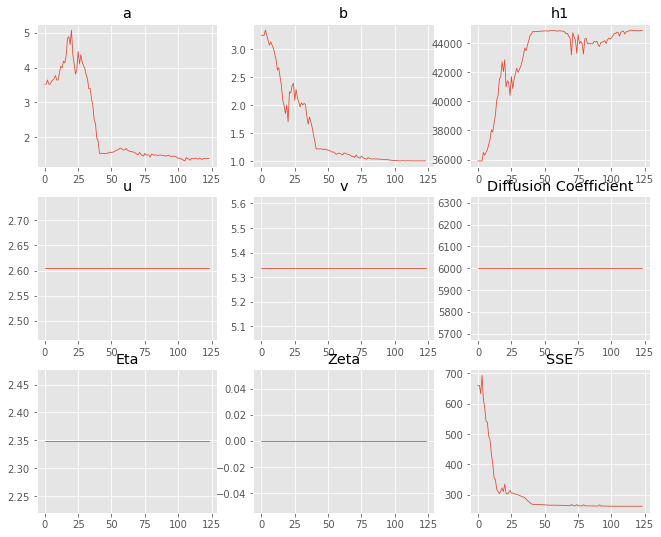

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,3.52325,1.39944
b,3.25441,1.00008
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"35,907.2","44,876.3"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 2 Time: 0.068 minutes


Estimated remaining run time: 0.877 minutes


Run 2===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	5.25e+02 	4.77e+02 	0.9089 		1.0000


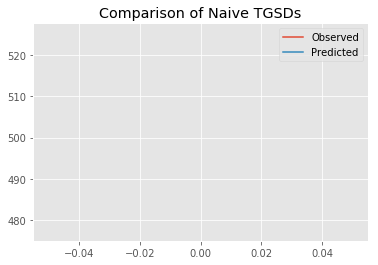

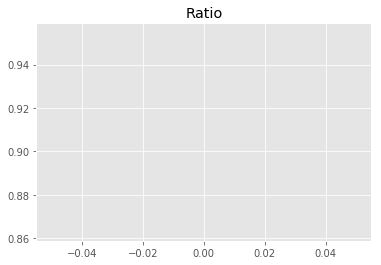

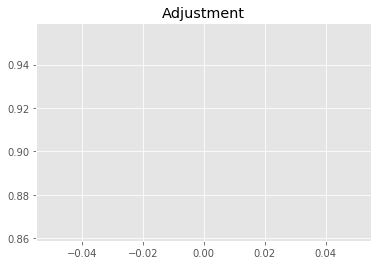

2615355284.830306
1


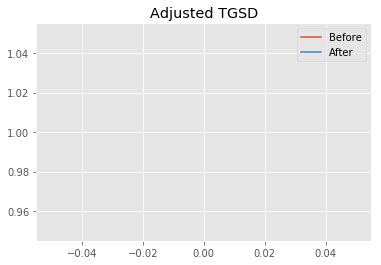

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|4.97987 	2.5894 	41293.5 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 2.8774e+09
After: 		|1.8741 	1.47656 	44909.6 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 308.409
New Misfit: 273.468
Convergence:
0.11329472879145945

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	5.01e+02 	4.77e+02 	0.9536 		1.0000


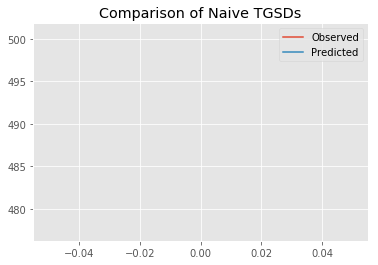

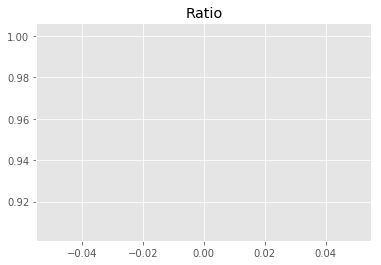

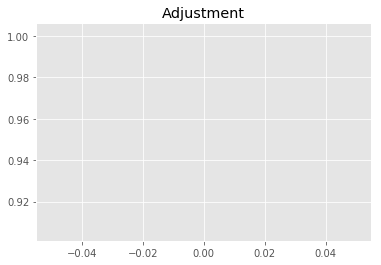

2743787446.1038866
1


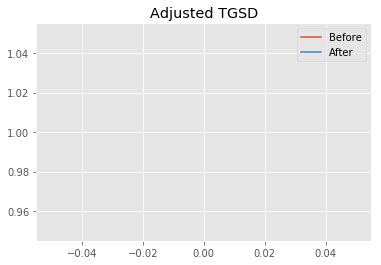

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.8741 	1.47656 	44909.6 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 2.8774e+09
After: 		|1.89221 	1.25376 	44858.6 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 273.468
New Misfit: 268.714
Convergence:
0.017383808998721363

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	5.07e+02 	4.77e+02 	0.9420 		1.0000


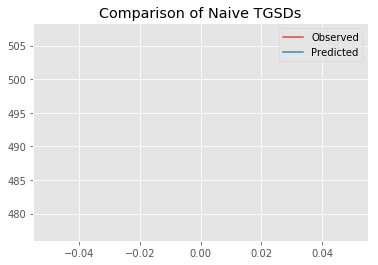

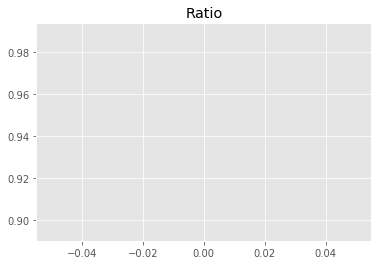

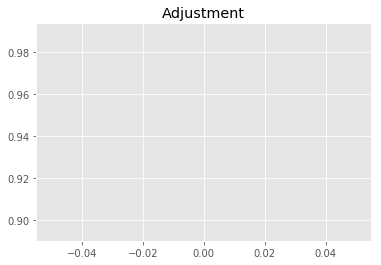

2710464170.3716016
1


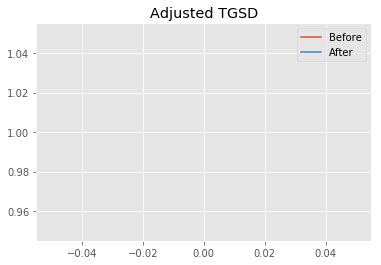

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.89221 	1.25376 	44858.6 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 2.8774e+09
After: 		|1.37994 	1.02128 	44334 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 268.714
New Misfit: 262.538
Convergence:
0.022984883555579542

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	4.94e+02 	4.77e+02 	0.9674 		1.0000


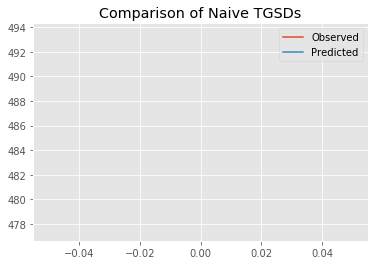

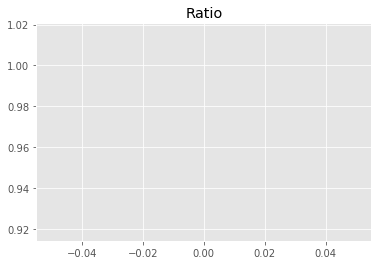

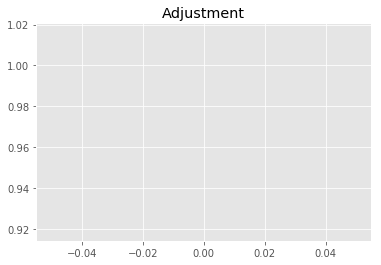

2783597412.828879
1


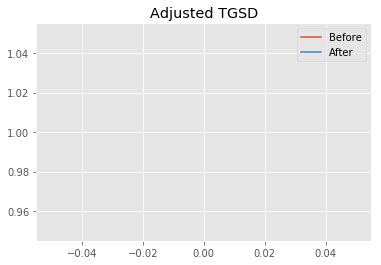

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.37994 	1.02128 	44334 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 2.8774e+09
After: 		|1.40472 	1.00052 	44714.9 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 262.538
New Misfit: 261.889
Convergence:
0.002471082974653523

____________________
a = 1.40472	b = 1.00052	            h1 = 44714.94612	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 2877403722.51970
Success: True
Status: Successful convergence.
Iterations: 4
Misfit: 261.88900060807566
Prior Misfit: 308.409,	 Post Misfit: 261.889


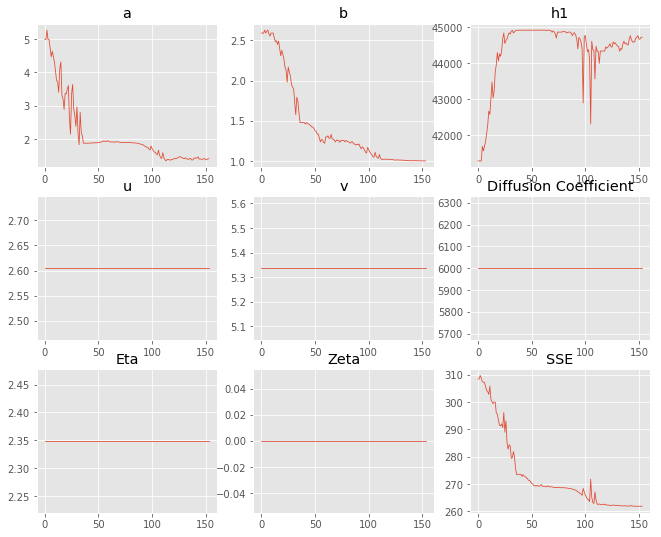

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,4.97987,1.40472
b,2.5894,1.00052
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"41,293.5","44,714.9"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 3 Time: 0.083 minutes


Estimated remaining run time: 0.950 minutes


Run 3===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	5.33e+02 	4.77e+02 	0.8964 		1.0000


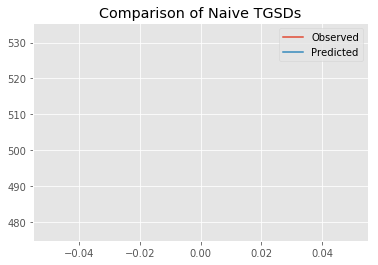

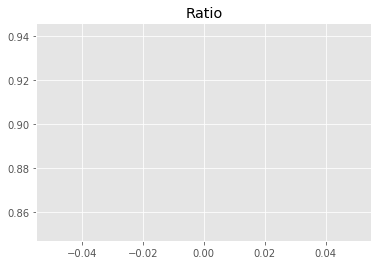

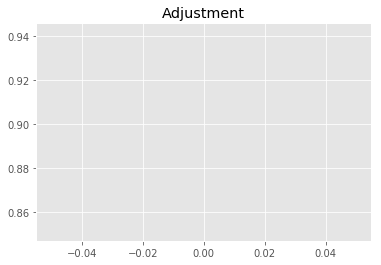

2579380877.303844
1


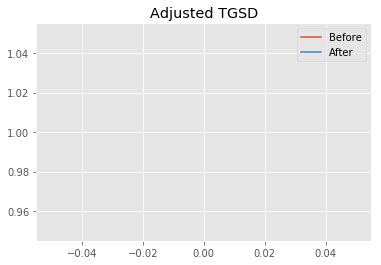

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|4.80438 	1.84049 	43767.4 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 2.8774e+09
After: 		|2.5991 	1.82042 	44350.9 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 326.234
New Misfit: 281.357
Convergence:
0.1375614380076599

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	5.12e+02 	4.77e+02 	0.9325 		1.0000


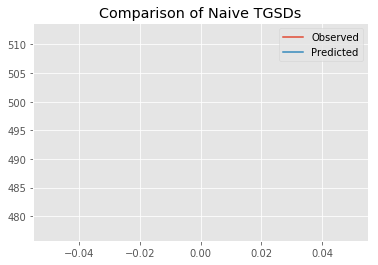

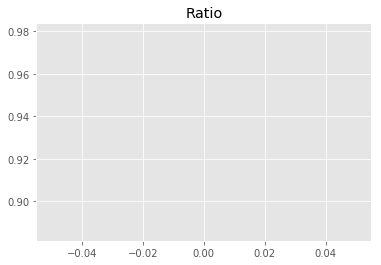

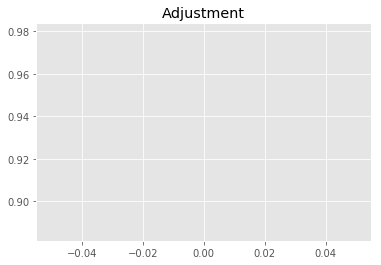

2683304431.183923
1


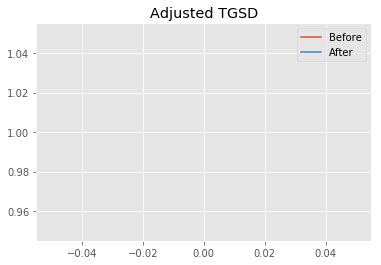

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.5991 	1.82042 	44350.9 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 2.8774e+09
After: 		|2.02254 	1.4999 	44914.8 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 281.357
New Misfit: 272.964
Convergence:
0.029829776861208912

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	5.05e+02 	4.77e+02 	0.9455 		1.0000


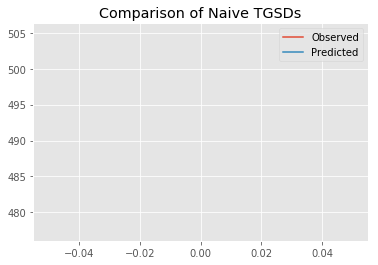

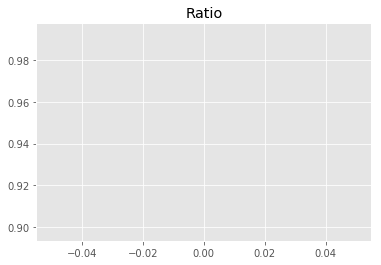

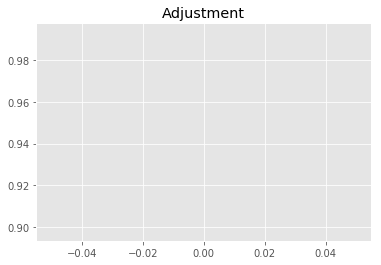

2720595746.8111467
1


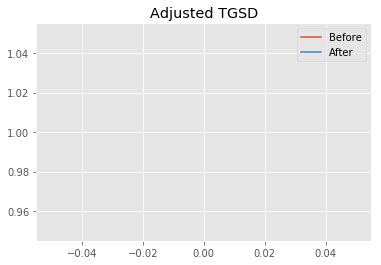

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.02254 	1.4999 	44914.8 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 2.8774e+09
After: 		|2.02034 	1.34028 	44914.1 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 272.964
New Misfit: 270.688
Convergence:
0.008337433451704571

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	5.09e+02 	4.77e+02 	0.9388 		1.0000


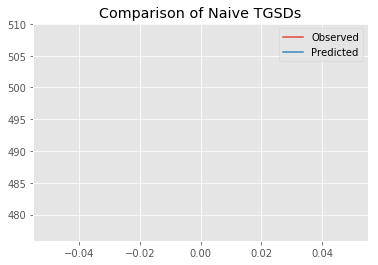

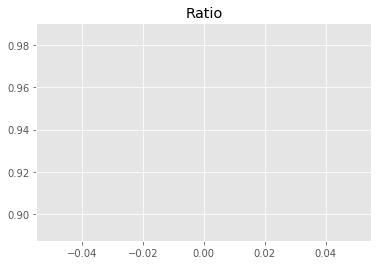

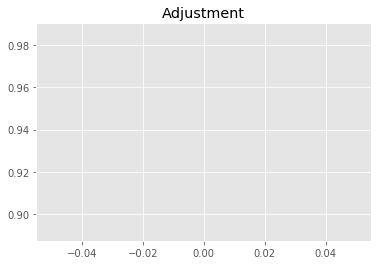

2701377235.8779645
1


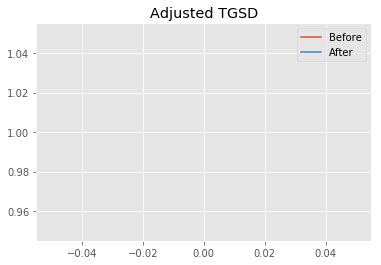

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.02034 	1.34028 	44914.1 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 2.8774e+09
After: 		|1.37077 	1.07987 	44915 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 270.688
New Misfit: 264.726
Convergence:
0.022027469381713728

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	4.91e+02 	4.77e+02 	0.9724 		1.0000


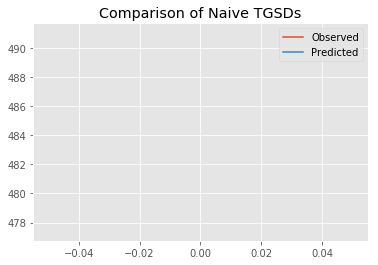

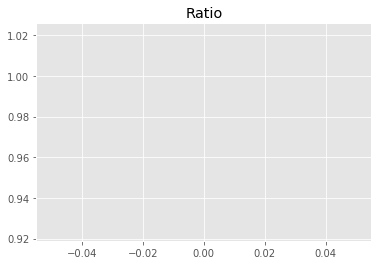

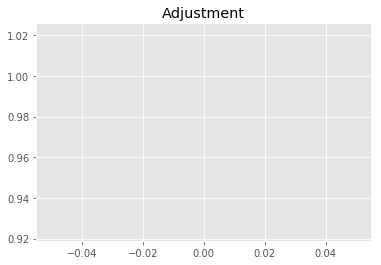

2797862355.6475725
1


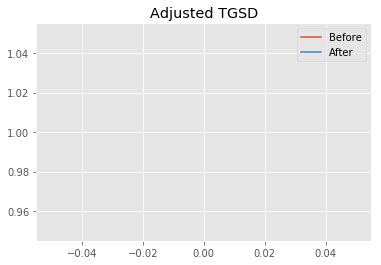

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.37077 	1.07987 	44915 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 2.8774e+09
After: 		|1.37077 	1.07039 	44915 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 264.726
New Misfit: 264.316
Convergence:
0.0015461140845539757

____________________
a = 1.37077	b = 1.07039	            h1 = 44915.00000	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 2877403722.51970
Success: True
Status: Successful convergence.
Iterations: 5
Misfit: 264.3162161430175
Prior Misfit: 326.234,	 Post Misfit: 264.316


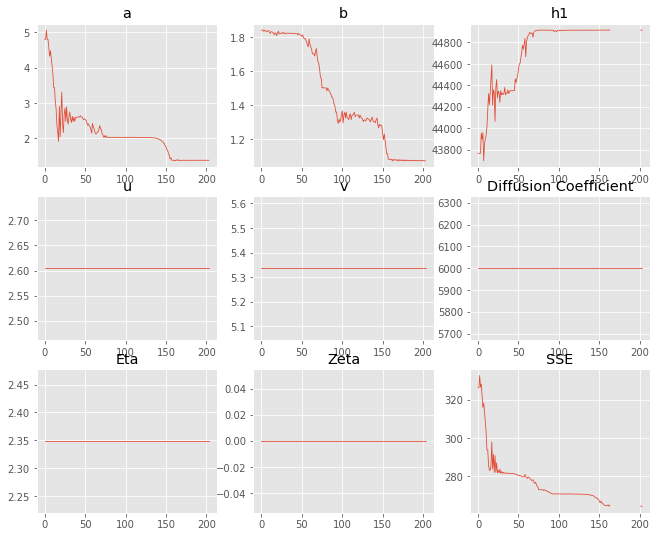

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,4.80438,1.37077
b,1.84049,1.07039
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"43,767.4","44,915"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 4 Time: 0.104 minutes


Estimated remaining run time: 1.023 minutes


Run 4===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	4.95e+02 	4.77e+02 	0.9640 		1.0000


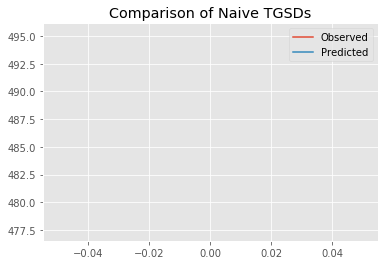

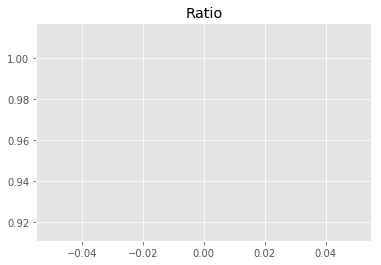

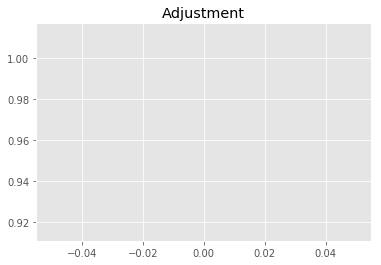

2773841084.01996
1


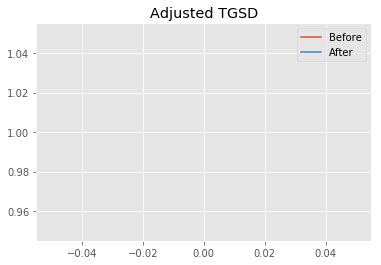

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|4.59833 	2.0883 	29807.1 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 2.8774e+09
After: 		|3.83735 	2.0703 	39811.1 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 657.673
New Misfit: 307.817
Convergence:
0.5319604373620462

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	5.19e+02 	4.77e+02 	0.9194 		1.0000


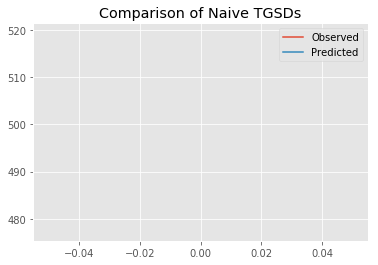

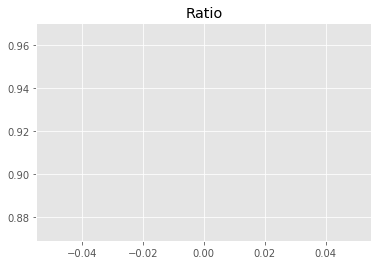

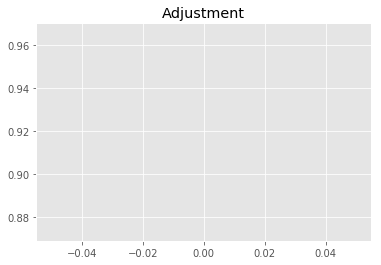

2645417660.521131
1


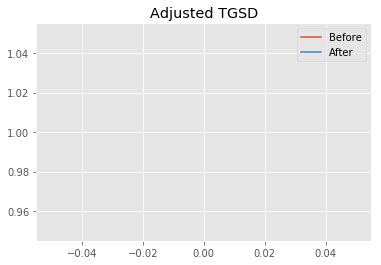

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.83735 	2.0703 	39811.1 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 2.8774e+09
After: 		|2.75409 	2.00085 	44784.2 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 307.817
New Misfit: 283.702
Convergence:
0.07834164124364335

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	5.12e+02 	4.77e+02 	0.9319 		1.0000


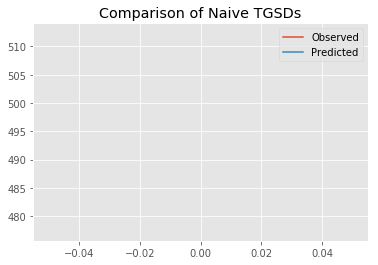

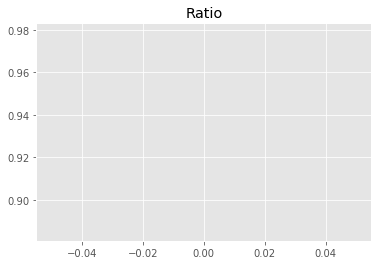

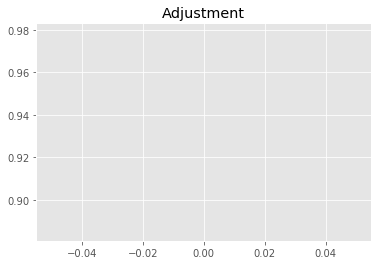

2681456214.2672253
1


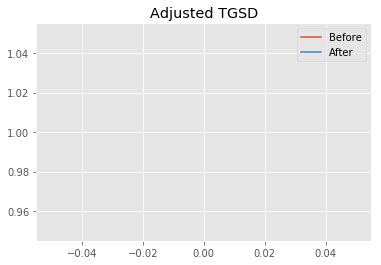

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.75409 	2.00085 	44784.2 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 2.8774e+09
After: 		|2.76753 	1.99986 	44915 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 283.702
New Misfit: 283.26
Convergence:
0.0015559886204202598

____________________
a = 2.76753	b = 1.99986	            h1 = 44914.99995	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 2877403722.51970
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 283.2604441119594
Prior Misfit: 657.673,	 Post Misfit: 283.26


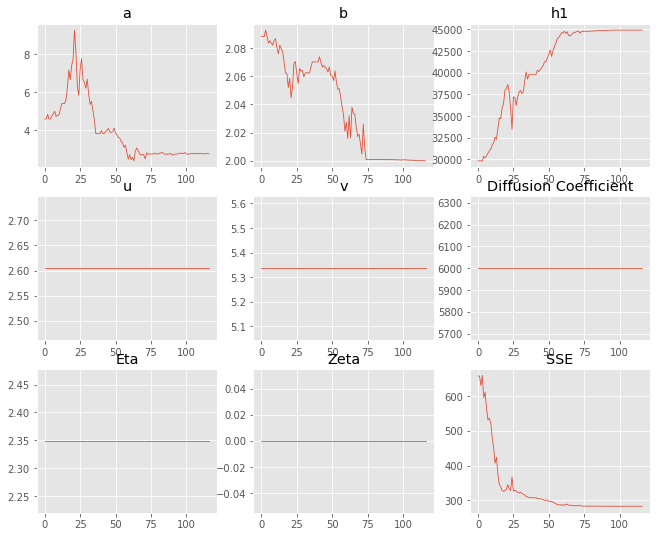

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,4.59833,2.76753
b,2.0883,1.99986
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"29,807.1","44,915"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 5 Time: 0.064 minutes


Estimated remaining run time: 0.945 minutes


Run 5===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	5.20e+02 	4.77e+02 	0.9185 		1.0000


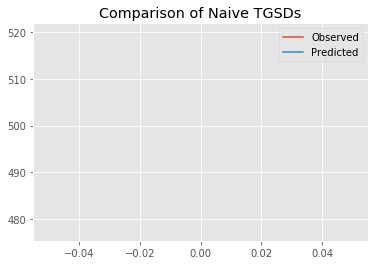

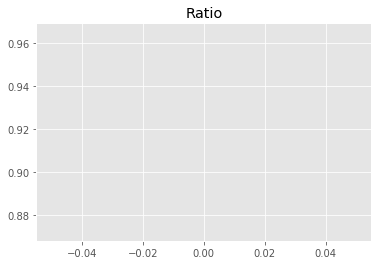

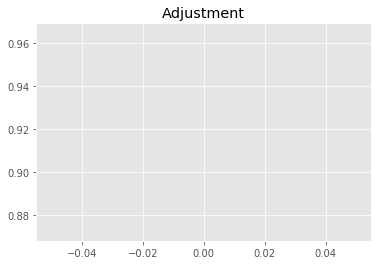

2643019064.7482567
1


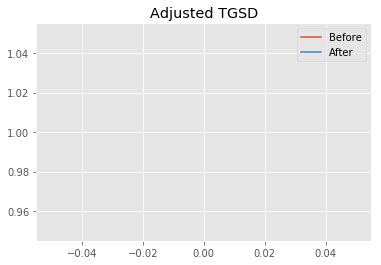

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.73368 	1.74416 	37857.5 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 2.8774e+09
After: 		|2.33146 	1.751 	44447.3 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 313.099
New Misfit: 280.105
Convergence:
0.10537969547835314

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	5.07e+02 	4.77e+02 	0.9409 		1.0000


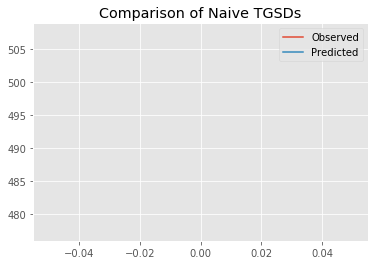

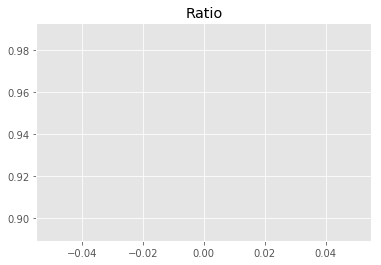

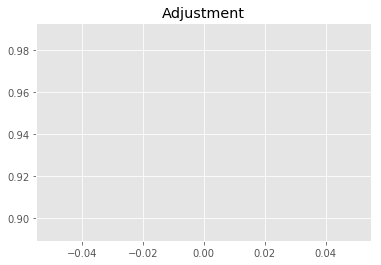

2707352190.3006916
1


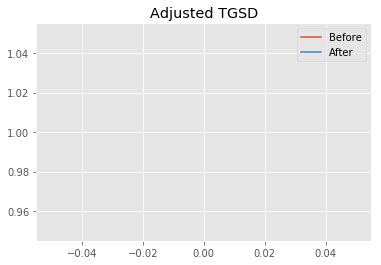

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.33146 	1.751 	44447.3 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 2.8774e+09
After: 		|1.43921 	1.03461 	44915 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 280.105
New Misfit: 262.615
Convergence:
0.06244139249408937

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	4.96e+02 	4.77e+02 	0.9626 		1.0000


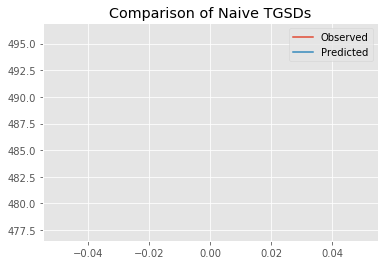

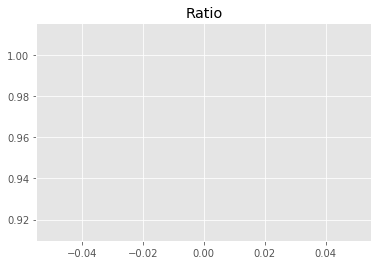

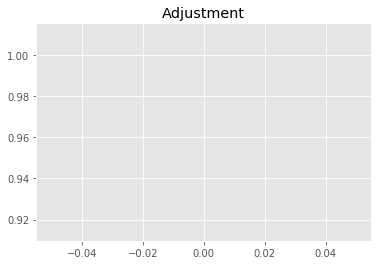

2769778515.537807
1


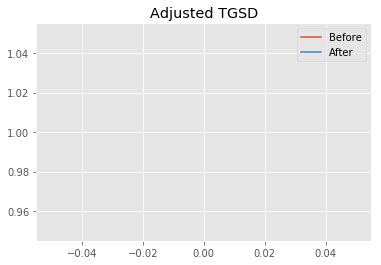

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.43921 	1.03461 	44915 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 2.8774e+09
After: 		|1.4006 	1.00001 	44827.6 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 262.615
New Misfit: 261.875
Convergence:
0.00281513043891588

____________________
a = 1.40060	b = 1.00001	            h1 = 44827.64453	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 2877403722.51970
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 261.8754746152309
Prior Misfit: 313.099,	 Post Misfit: 261.875


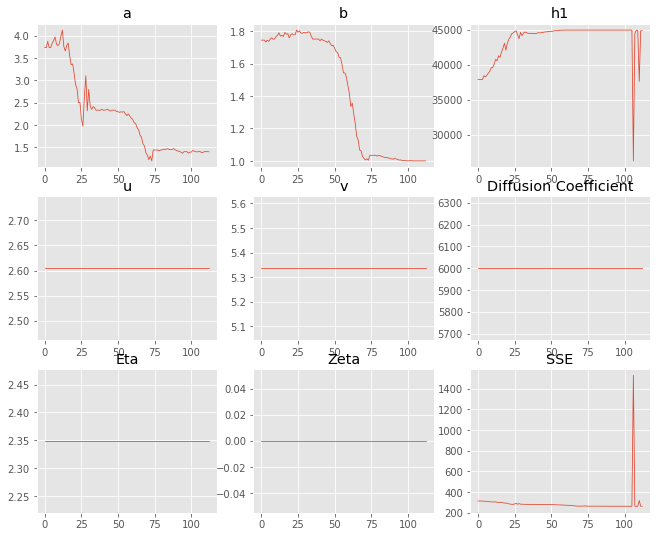

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,3.73368,1.4006
b,1.74416,1.00001
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"37,857.5","44,827.6"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 6 Time: 0.063 minutes


Estimated remaining run time: 0.869 minutes


Run 6===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	4.90e+02 	4.77e+02 	0.9734 		1.0000


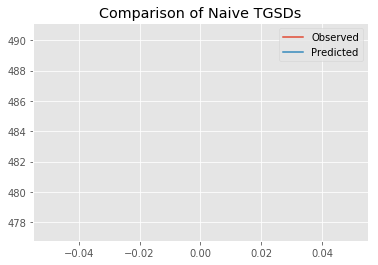

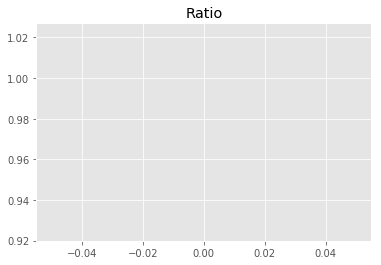

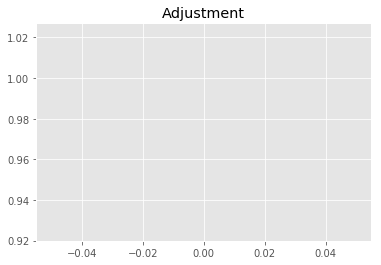

2800901830.6479497
1


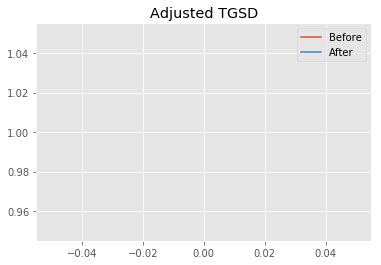

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|4.29965 	3.82774 	36866.8 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 2.8774e+09
After: 		|3.45003 	2.12748 	43691.7 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 595.92
New Misfit: 291.504
Convergence:
0.5108338485098503

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	5.20e+02 	4.77e+02 	0.9186 		1.0000


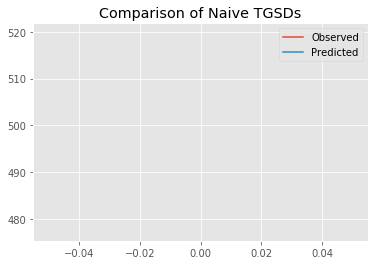

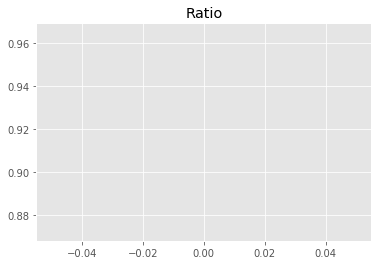

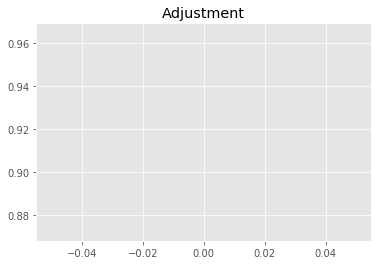

2643262839.14837
1


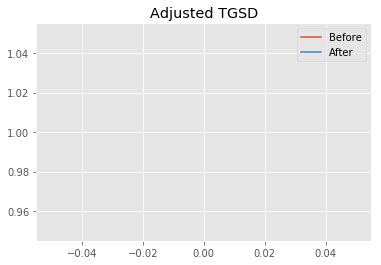

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.45003 	2.12748 	43691.7 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 2.8774e+09
After: 		|1.78484 	1.3531 	44915 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 291.504
New Misfit: 269.929
Convergence:
0.07401079978094288

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	5.01e+02 	4.77e+02 	0.9534 		1.0000


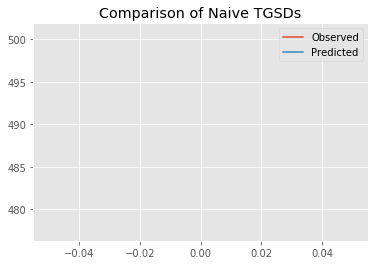

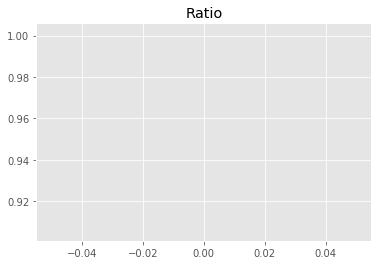

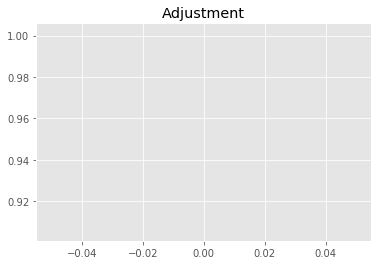

2743427889.717024
1


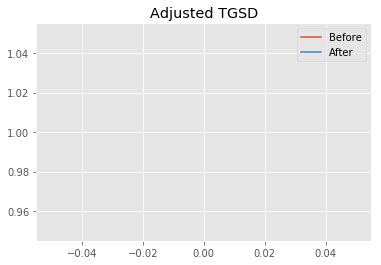

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.78484 	1.3531 	44915 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 2.8774e+09
After: 		|1.78484 	1.33519 	44915 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 269.929
New Misfit: 269.383
Convergence:
0.0020244547267398607

____________________
a = 1.78484	b = 1.33519	            h1 = 44915.00000	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 2877403722.51970
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 269.3829885848054
Prior Misfit: 595.92,	 Post Misfit: 269.383


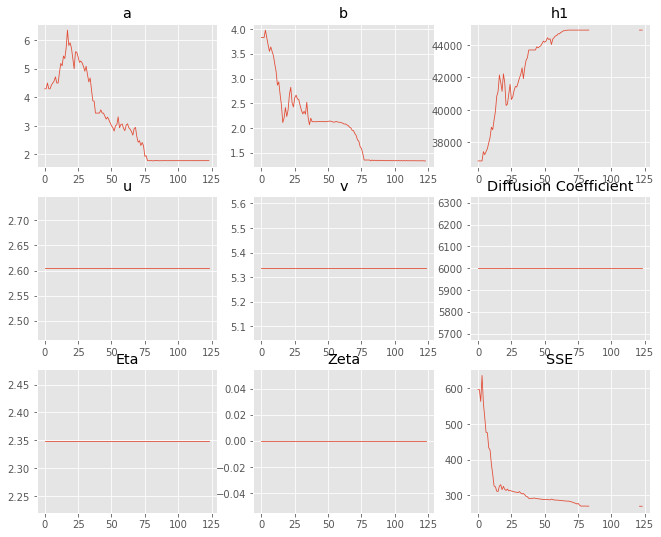

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,4.29965,1.78484
b,3.82774,1.33519
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"36,866.8","44,915"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 7 Time: 0.068 minutes


Estimated remaining run time: 0.804 minutes


Run 7===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	5.10e+02 	4.77e+02 	0.9363 		1.0000


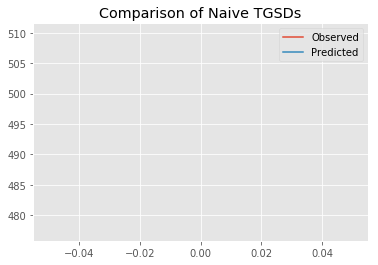

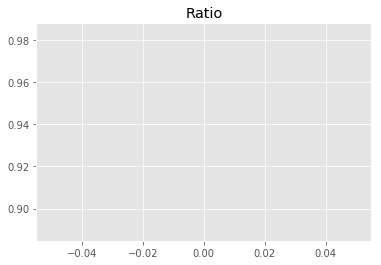

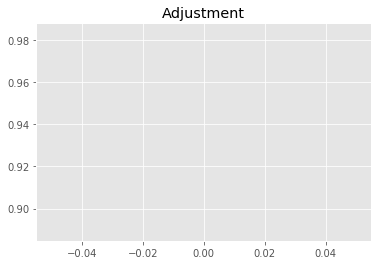

2694000649.8454175
1


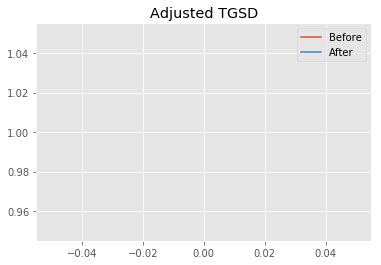

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.06173 	2.38789 	43658.8 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 2.8774e+09
After: 		|1.44457 	1.15122 	44915 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 300.849
New Misfit: 266.55
Convergence:
0.11400579260334667

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	4.92e+02 	4.77e+02 	0.9698 		1.0000


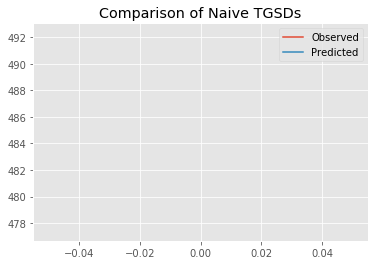

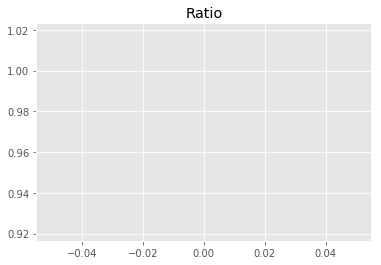

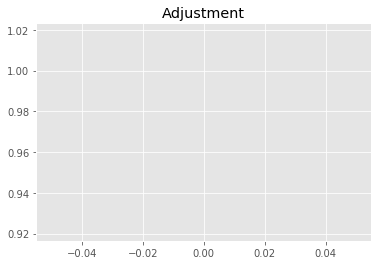

2790504224.8079915
1


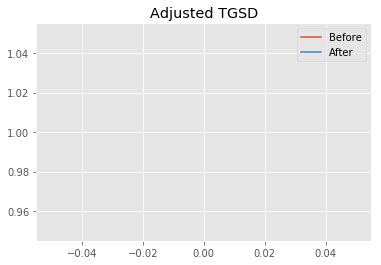

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.44457 	1.15122 	44915 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 2.8774e+09
After: 		|1.43138 	1.01971 	44914.3 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 266.55
New Misfit: 262.3
Convergence:
0.0159460730124882

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	4.96e+02 	4.77e+02 	0.9623 		1.0000


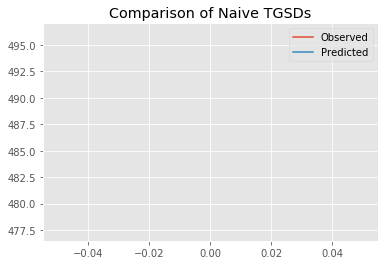

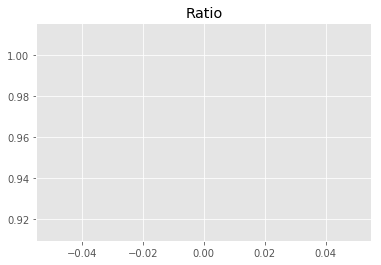

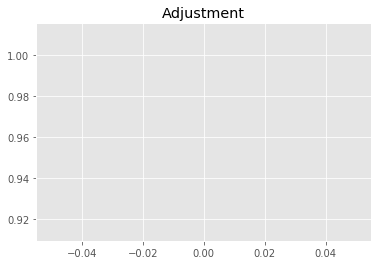

2769043930.2217803
1


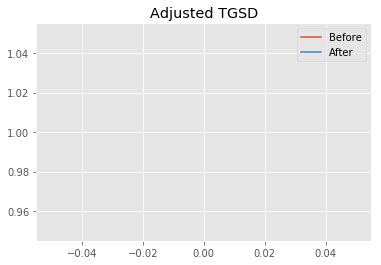

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.43138 	1.01971 	44914.3 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 2.8774e+09
After: 		|1.39229 	1.00049 	44792.2 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 262.3
New Misfit: 261.888
Convergence:
0.0015717186576401291

____________________
a = 1.39229	b = 1.00049	            h1 = 44792.16760	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 2877403722.51970
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 261.8875226033707
Prior Misfit: 300.849,	 Post Misfit: 261.888


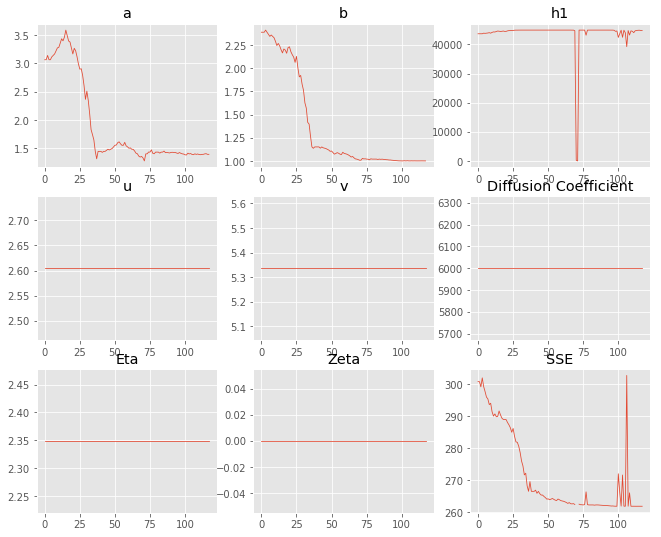

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,3.06173,1.39229
b,2.38789,1.00049
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"43,658.8","44,792.2"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 8 Time: 0.065 minutes


Estimated remaining run time: 0.735 minutes


Run 8===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	4.81e+02 	4.77e+02 	0.9930 		1.0000


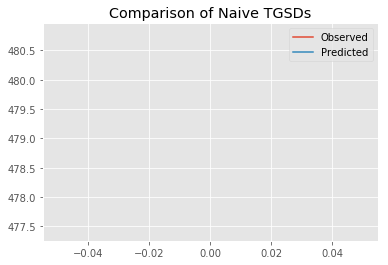

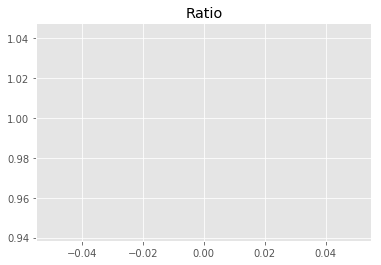

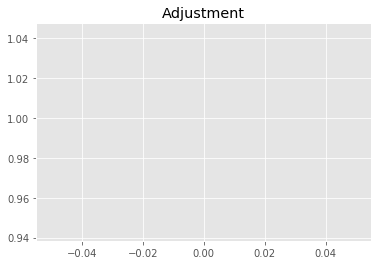

2857231039.1089396
1


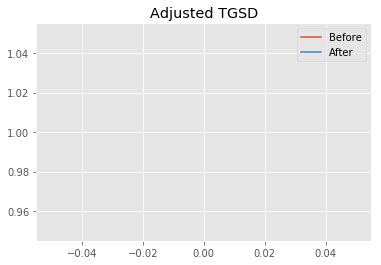

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.33888 	2.08359 	36157.3 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 2.8774e+09
After: 		|2.68883 	1.79431 	44913.6 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 516.087
New Misfit: 280.414
Convergence:
0.45665322206930187

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	5.15e+02 	4.77e+02 	0.9276 		1.0000


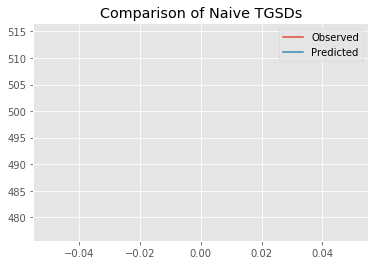

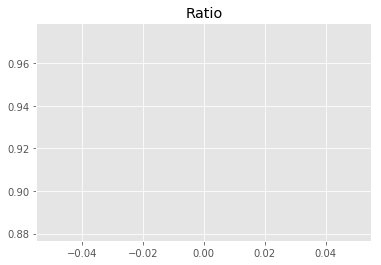

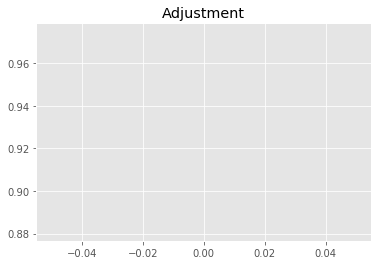

2669176539.900436
1


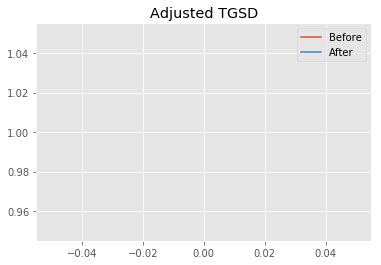

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.68883 	1.79431 	44913.6 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 2.8774e+09
After: 		|2.04284 	1.49281 	44332.8 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 280.414
New Misfit: 274.073
Convergence:
0.022615589697622514

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	5.05e+02 	4.77e+02 	0.9450 		1.0000


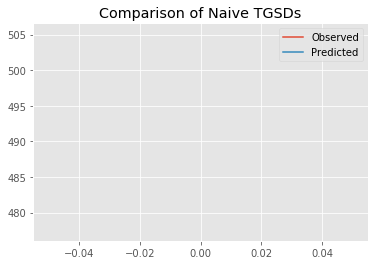

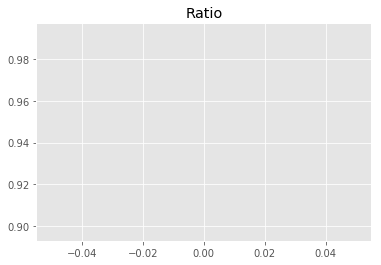

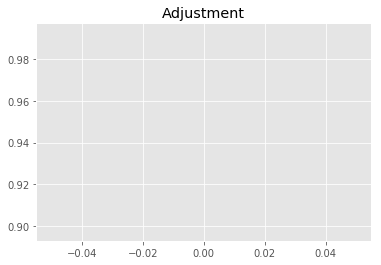

2719210957.8114266
1


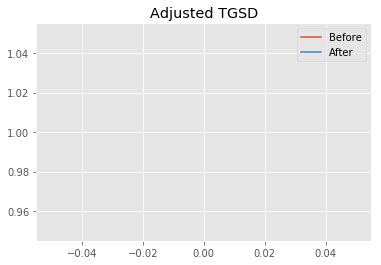

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.04284 	1.49281 	44332.8 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 2.8774e+09
After: 		|1.9761 	1.33724 	44802.6 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 274.073
New Misfit: 270.2
Convergence:
0.014128659694333301

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	5.07e+02 	4.77e+02 	0.9411 		1.0000


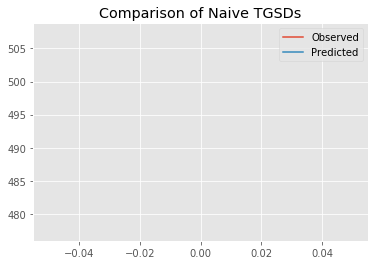

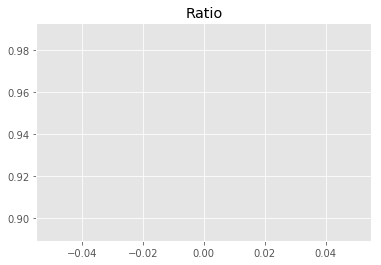

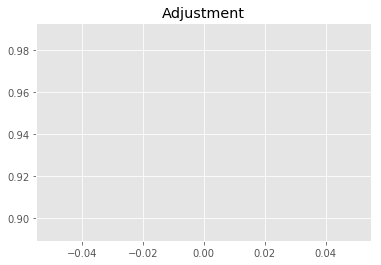

2707979832.831071
1


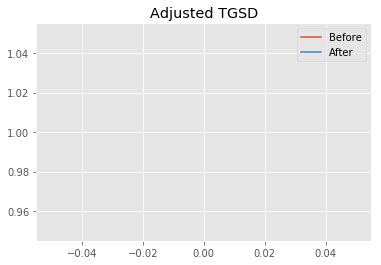

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.9761 	1.33724 	44802.6 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 2.8774e+09
After: 		|1.66487 	1.14904 	44911.5 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 270.2
New Misfit: 265.422
Convergence:
0.017683469643439642

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	5.02e+02 	4.77e+02 	0.9512 		1.0000


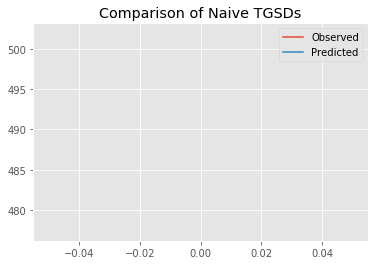

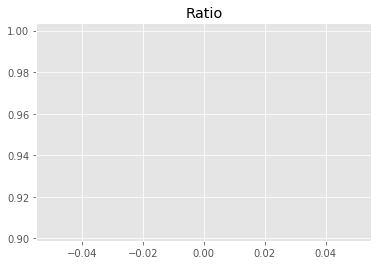

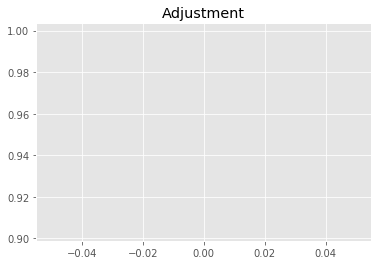

2736922081.9261193
1


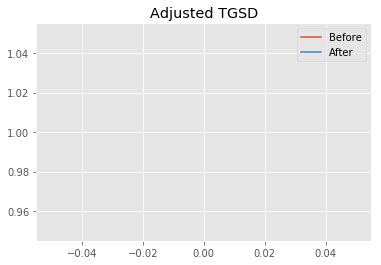

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.66487 	1.14904 	44911.5 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 2.8774e+09
After: 		|1.36969 	1.00875 	44753.8 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 265.422
New Misfit: 262.172
Convergence:
0.012245789228023388

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	4.93e+02 	4.77e+02 	0.9675 		1.0000


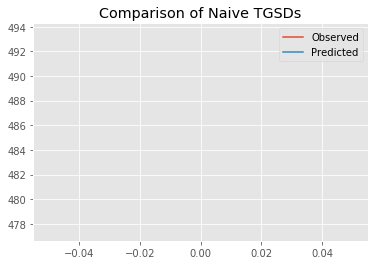

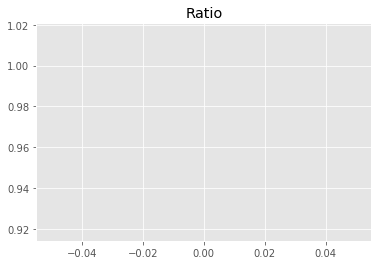

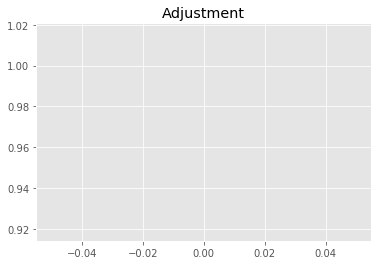

2783825433.865066
1


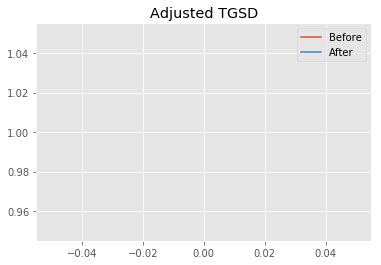

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.36969 	1.00875 	44753.8 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 2.8774e+09
After: 		|1.39908 	1.00002 	44796.6 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 262.172
New Misfit: 261.875
Convergence:
0.0011322407341172363

____________________
a = 1.39908	b = 1.00002	            h1 = 44796.56584	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 2877403722.51970
Success: True
Status: Successful convergence.
Iterations: 6
Misfit: 261.87512199403415
Prior Misfit: 516.087,	 Post Misfit: 261.875


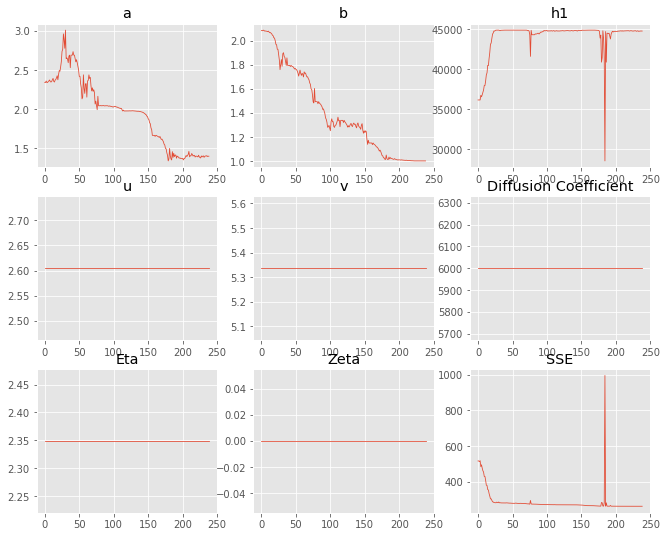

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,2.33888,1.39908
b,2.08359,1.00002
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"36,157.3","44,796.6"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 9 Time: 0.122 minutes


Estimated remaining run time: 0.723 minutes


Run 9===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	5.15e+02 	4.77e+02 	0.9264 		1.0000


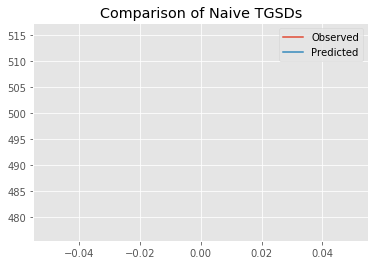

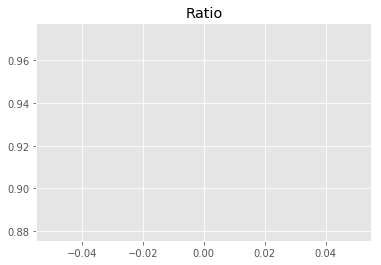

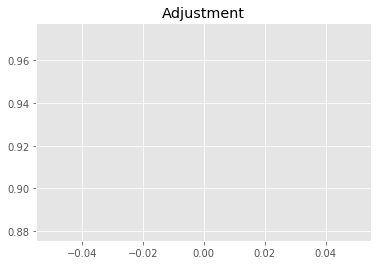

2665649658.9093733
1


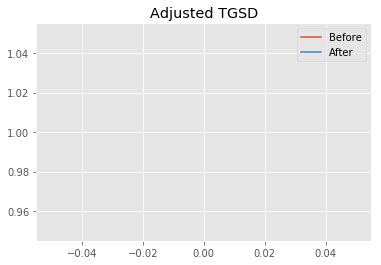

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.97395 	1.63509 	39681.2 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 2.8774e+09
After: 		|1.86801 	1.41134 	44881.4 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 301.847
New Misfit: 271.245
Convergence:
0.10138366053171773

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	5.02e+02 	4.77e+02 	0.9508 		1.0000


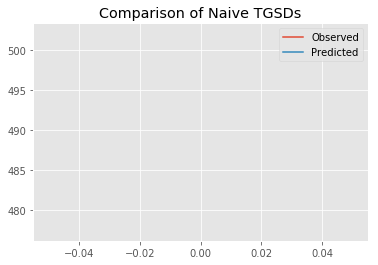

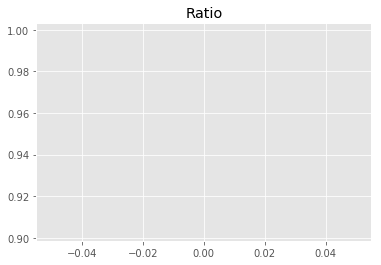

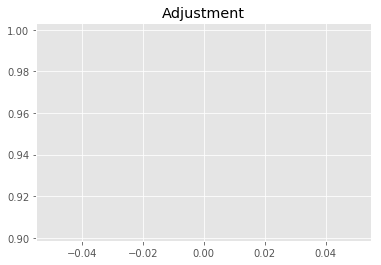

2735863666.114141
1


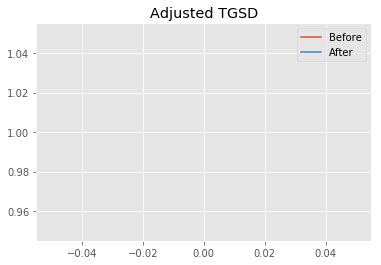

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.86801 	1.41134 	44881.4 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 2.8774e+09
After: 		|1.81124 	1.16211 	44358.4 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 271.245
New Misfit: 267.588
Convergence:
0.013481688036808465

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	5.06e+02 	4.77e+02 	0.9427 		1.0000


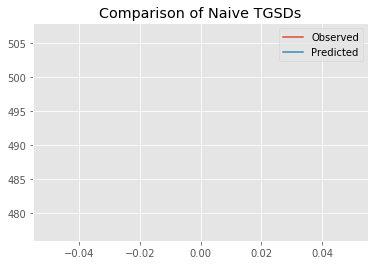

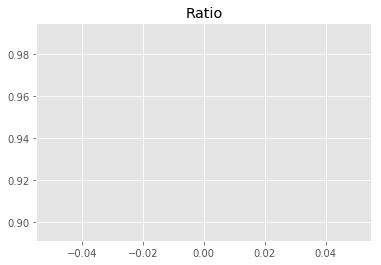

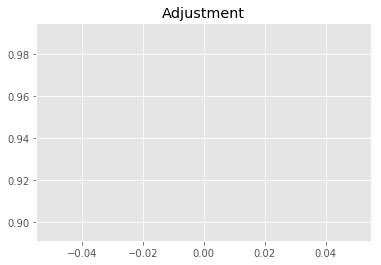

2712662873.913428
1


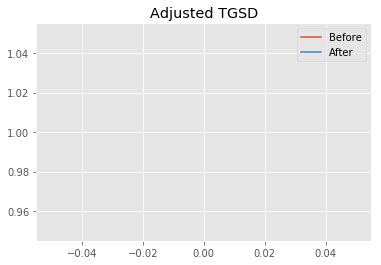

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.81124 	1.16211 	44358.4 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 2.8774e+09
After: 		|1.40584 	1.04838 	44912.7 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 267.588
New Misfit: 263.101
Convergence:
0.016766755370713878

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	4.94e+02 	4.77e+02 	0.9666 		1.0000


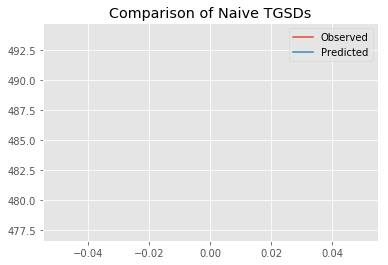

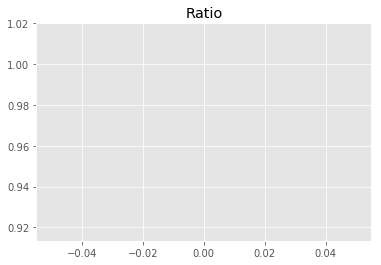

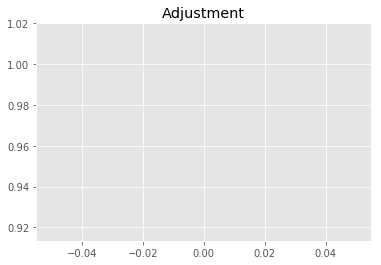

2781417627.6041822
1


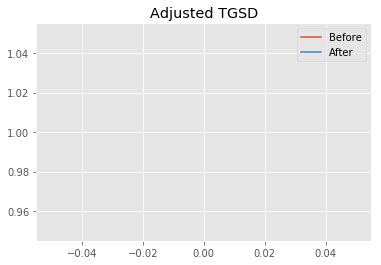

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.40584 	1.04838 	44912.7 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 2.8774e+09
After: 		|1.41763 	1.00114 	44906.5 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 263.101
New Misfit: 261.922
Convergence:
0.004482213980686947

____________________
a = 1.41763	b = 1.00114	            h1 = 44906.48610	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 2877403722.51970
Success: True
Status: Successful convergence.
Iterations: 4
Misfit: 261.9219495080642
Prior Misfit: 301.847,	 Post Misfit: 261.922


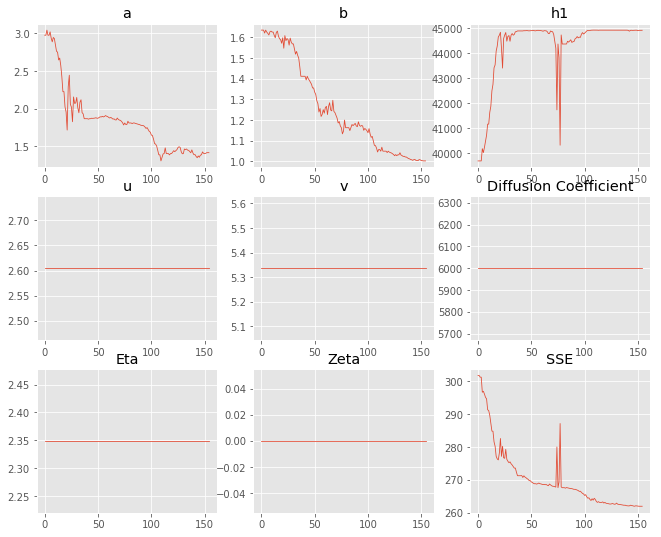

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,2.97395,1.41763
b,1.63509,1.00114
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"39,681.2","44,906.5"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 10 Time: 0.086 minutes


Estimated remaining run time: 0.662 minutes


Run 10===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	5.18e+02 	4.77e+02 	0.9208 		1.0000


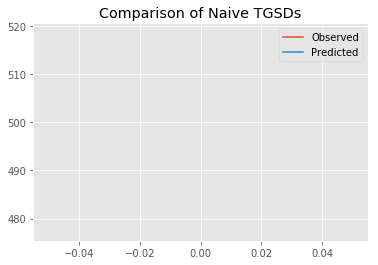

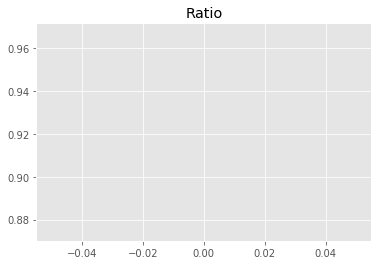

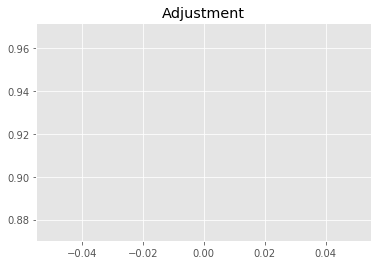

2649477522.0783195
1


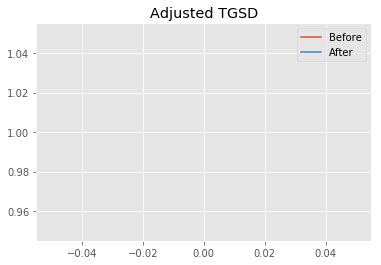

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.30286 	2.08404 	43740.9 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 2.8774e+09
After: 		|2.54538 	1.83476 	44915 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 290.088
New Misfit: 280.008
Convergence:
0.034747524270379415

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	5.11e+02 	4.77e+02 	0.9339 		1.0000


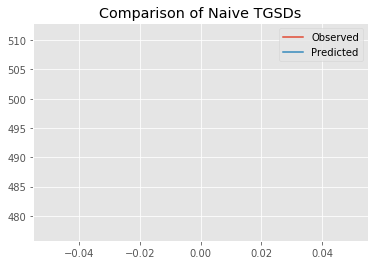

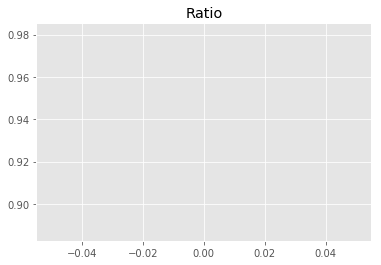

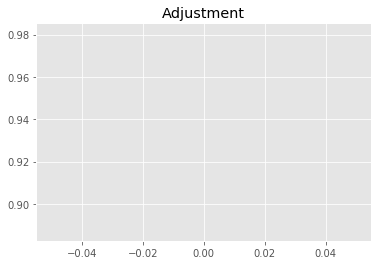

2687316996.9575753
1


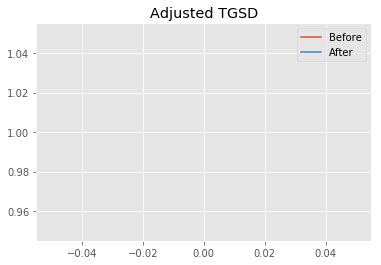

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.54538 	1.83476 	44915 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 2.8774e+09
After: 		|1.519 	1.30121 	44884.9 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 280.008
New Misfit: 272.921
Convergence:
0.0253104226312398

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	4.91e+02 	4.77e+02 	0.9725 		1.0000


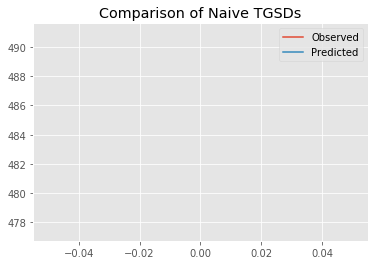

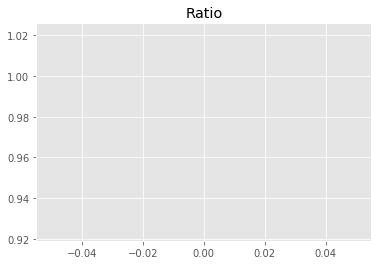

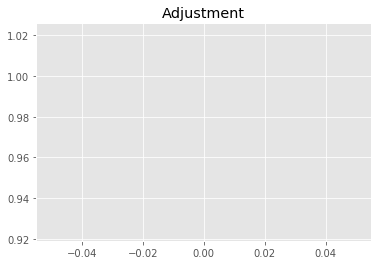

2798206023.3917613
1


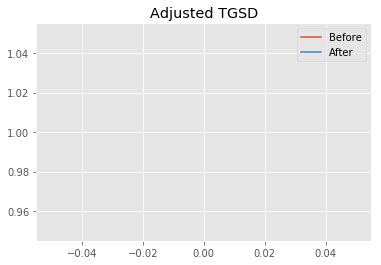

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.519 	1.30121 	44884.9 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 2.8774e+09
After: 		|1.65476 	1.14189 	44158.7 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 272.921
New Misfit: 265.68
Convergence:
0.026528579506925692

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	5.01e+02 	4.77e+02 	0.9520 		1.0000


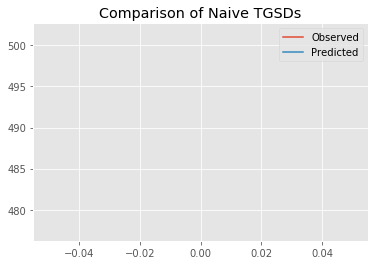

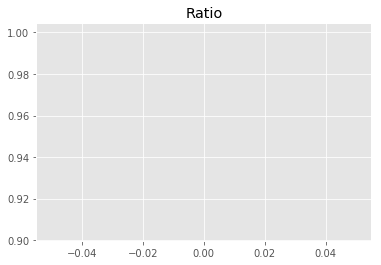

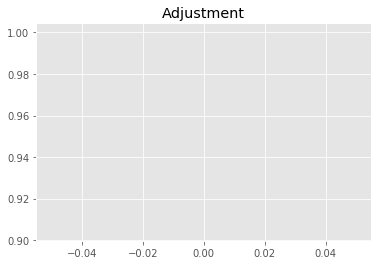

2739374199.957834
1


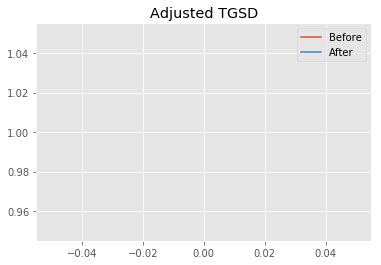

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.65476 	1.14189 	44158.7 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 2.8774e+09
After: 		|1.38431 	1.00413 	44861.7 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 265.68
New Misfit: 261.986
Convergence:
0.013904235889605165

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	4.94e+02 	4.77e+02 	0.9657 		1.0000


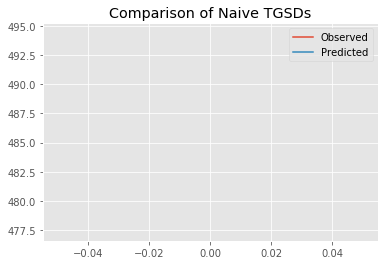

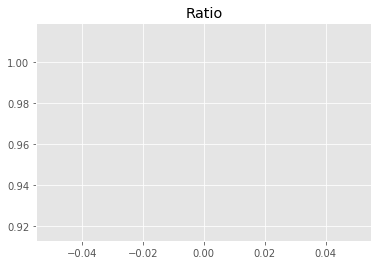

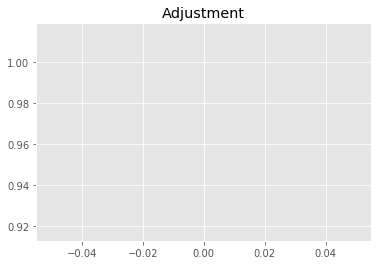

2778769898.7070346
1


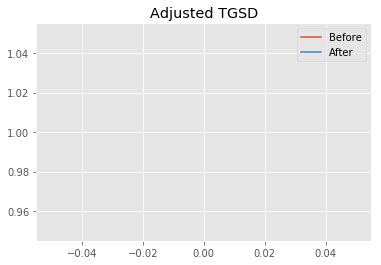

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.38431 	1.00413 	44861.7 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 2.8774e+09
After: 		|1.39877 	1 	44911.3 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 261.986
New Misfit: 261.875
Convergence:
0.0004262330940734604

____________________
a = 1.39877	b = 1.00000	            h1 = 44911.34678	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 2877403722.51970
Success: True
Status: Successful convergence.
Iterations: 5
Misfit: 261.8747071558891
Prior Misfit: 290.088,	 Post Misfit: 261.875


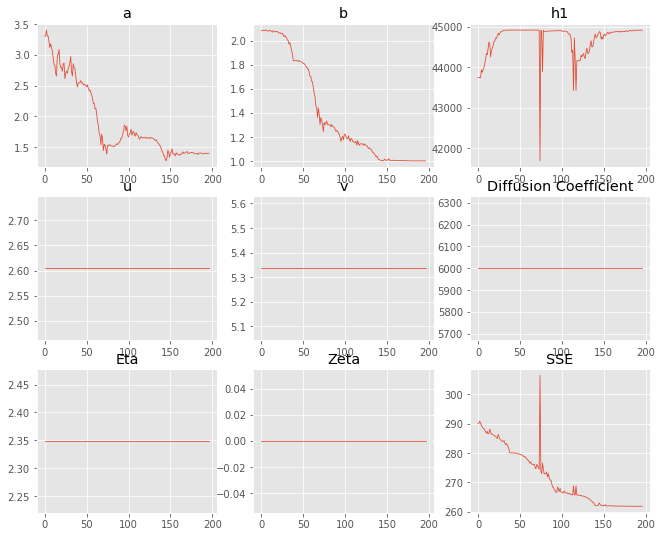

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,3.30286,1.39877
b,2.08404,1
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"43,740.9","44,911.3"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 11 Time: 0.109 minutes


Estimated remaining run time: 0.613 minutes


Run 11===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	4.98e+02 	4.77e+02 	0.9584 		1.0000


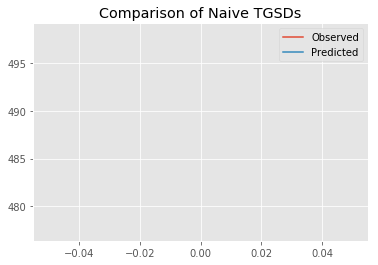

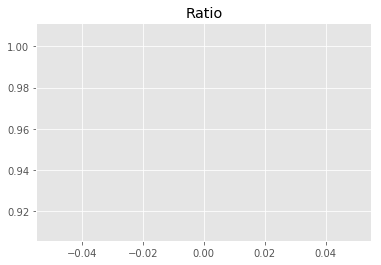

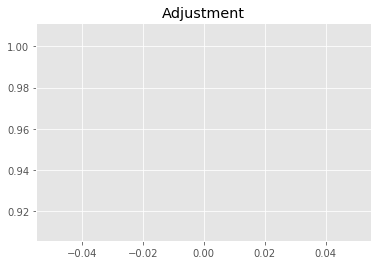

2757695915.376604
1


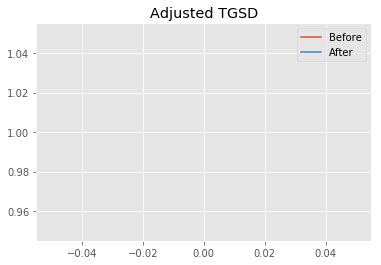

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.02643 	1.64573 	42502.2 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 2.8774e+09
After: 		|2.00408 	1.33192 	44912.6 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 297.106
New Misfit: 270.443
Convergence:
0.08974266422275597

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	5.08e+02 	4.77e+02 	0.9393 		1.0000


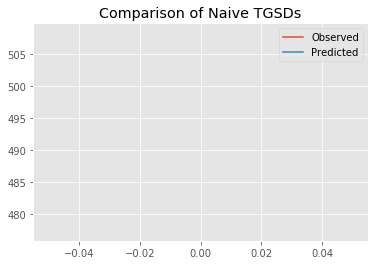

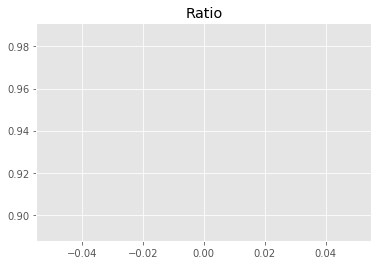

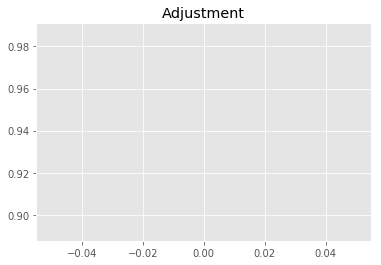

2702767423.9581633
1


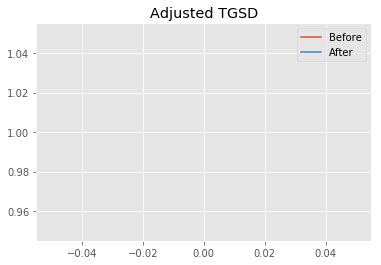

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.00408 	1.33192 	44912.6 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 2.8774e+09
After: 		|1.91765 	1.27647 	44915 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 270.443
New Misfit: 269.102
Convergence:
0.004959947685811016

____________________
a = 1.91765	b = 1.27647	            h1 = 44915.00000	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 2877403722.51970
Success: True
Status: Successful convergence.
Iterations: 2
Misfit: 269.101904329949
Prior Misfit: 297.106,	 Post Misfit: 269.102


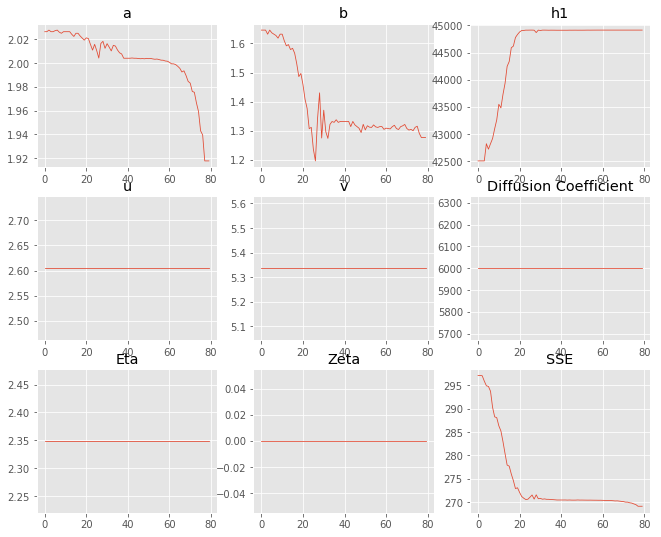

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,2.02643,1.91765
b,1.64573,1.27647
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"42,502.2","44,915"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 12 Time: 0.053 minutes


Estimated remaining run time: 0.523 minutes


Run 12===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	5.25e+02 	4.77e+02 	0.9088 		1.0000


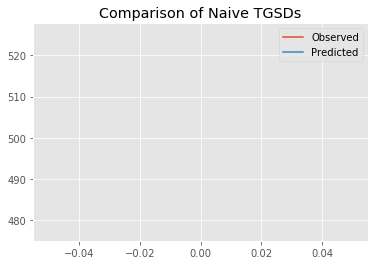

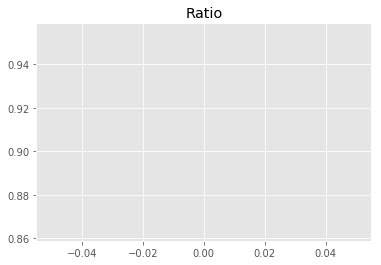

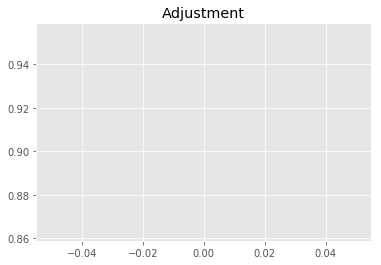

2614923680.110748
1


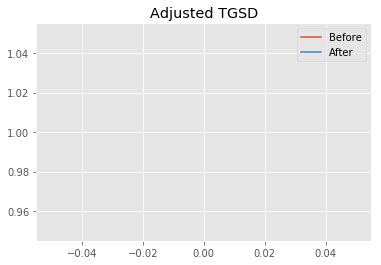

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|4.21094 	1.77754 	38729.3 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 2.8774e+09
After: 		|2.78616 	1.84509 	43769.1 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 308.091
New Misfit: 284.758
Convergence:
0.07573206076049192

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	5.14e+02 	4.77e+02 	0.9282 		1.0000


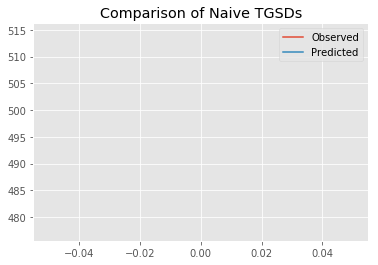

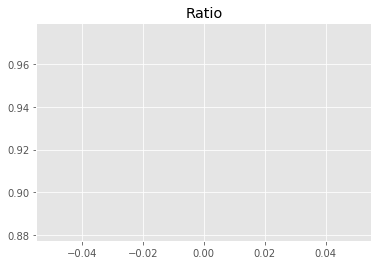

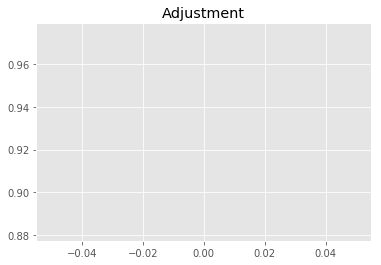

2670751863.4841704
1


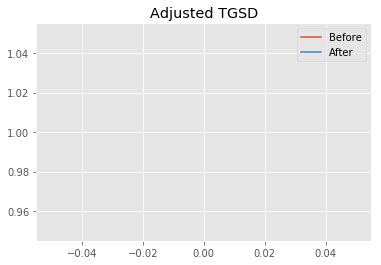

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.78616 	1.84509 	43769.1 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 2.8774e+09
After: 		|2.45738 	1.78545 	44883.1 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 284.758
New Misfit: 279.078
Convergence:
0.019946991028286377

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	5.10e+02 	4.77e+02 	0.9358 		1.0000


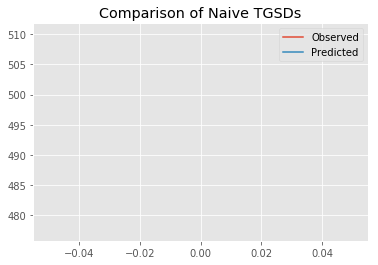

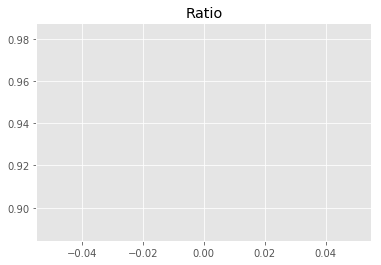

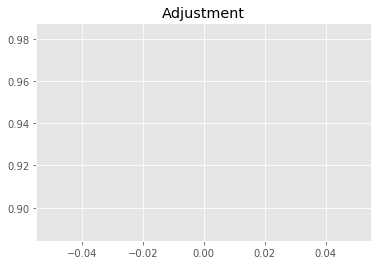

2692706767.825353
1


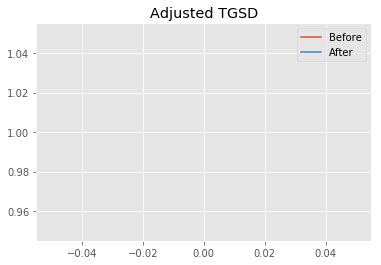

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.45738 	1.78545 	44883.1 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 2.8774e+09
After: 		|1.53048 	1.11497 	44914.2 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 279.078
New Misfit: 264.375
Convergence:
0.0526853297163051

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	4.97e+02 	4.77e+02 	0.9596 		1.0000


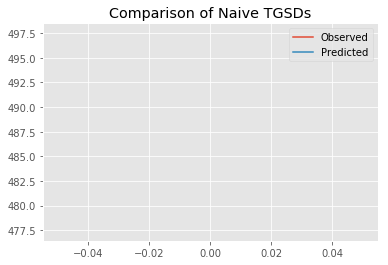

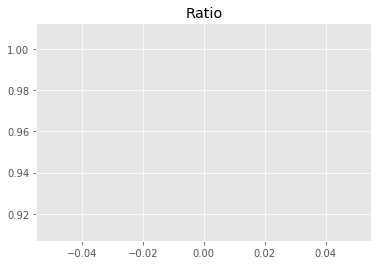

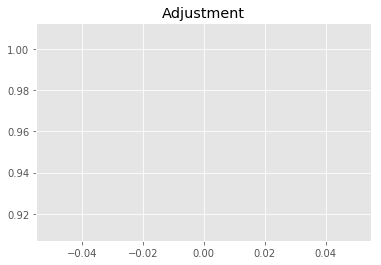

2761284858.403914
1


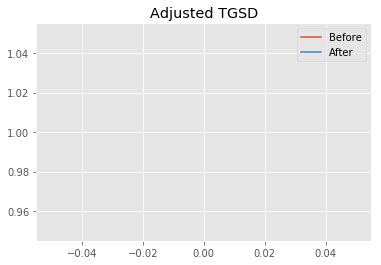

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.53048 	1.11497 	44914.2 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 2.8774e+09
After: 		|1.37866 	1.00103 	44461.9 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 264.375
New Misfit: 261.926
Convergence:
0.009261277095946107

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	4.94e+02 	4.77e+02 	0.9661 		1.0000


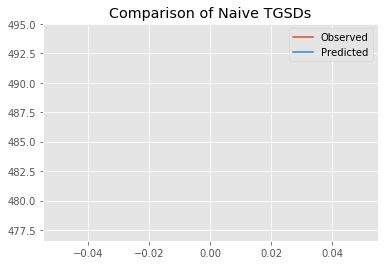

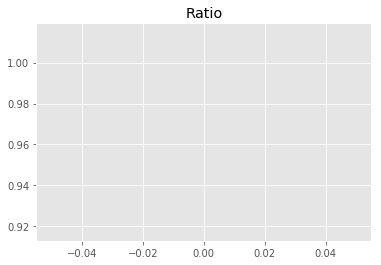

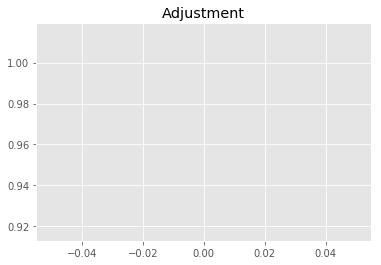

2779740489.5119367
1


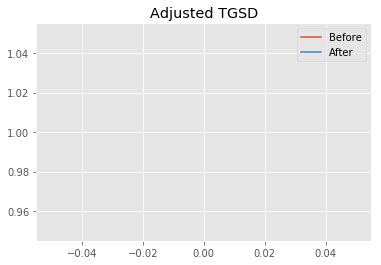

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.37866 	1.00103 	44461.9 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 2.8774e+09
After: 		|1.39856 	1.00005 	44325.8 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 261.926
New Misfit: 261.876
Convergence:
0.00019334613062238007

____________________
a = 1.39856	b = 1.00005	            h1 = 44325.77579	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 2877403722.51970
Success: True
Status: Successful convergence.
Iterations: 5
Misfit: 261.87575003040644
Prior Misfit: 308.091,	 Post Misfit: 261.876


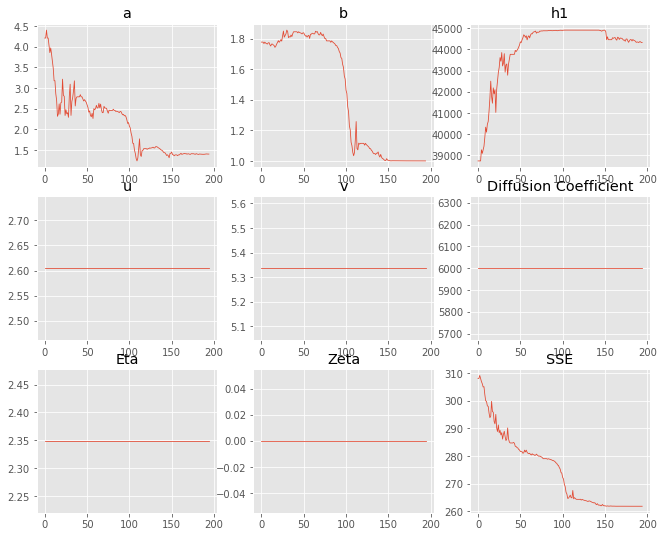

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,4.21094,1.39856
b,1.77754,1.00005
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"38,729.3","44,325.8"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 13 Time: 0.111 minutes


Estimated remaining run time: 0.464 minutes


Run 13===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	4.90e+02 	4.77e+02 	0.9746 		1.0000


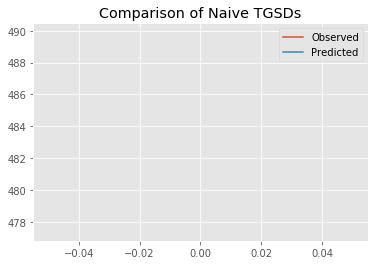

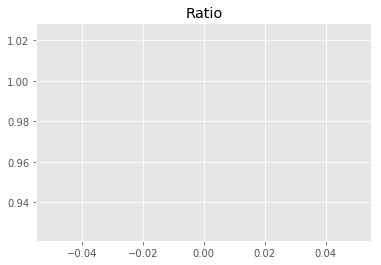

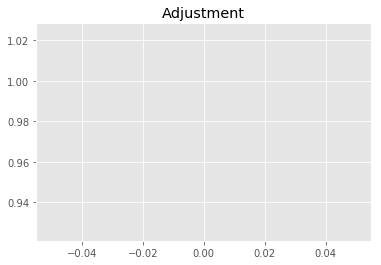

2804460379.4918637
1


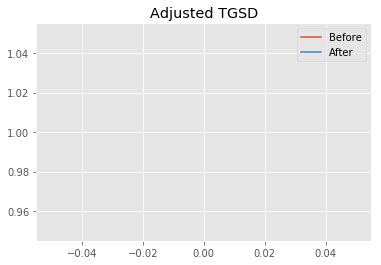

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.21462 	2.84497 	37402 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 2.8774e+09
After: 		|1.69854 	1.22033 	44894 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 503.064
New Misfit: 266.724
Convergence:
0.46980056913303503

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	5.01e+02 	4.77e+02 	0.9526 		1.0000


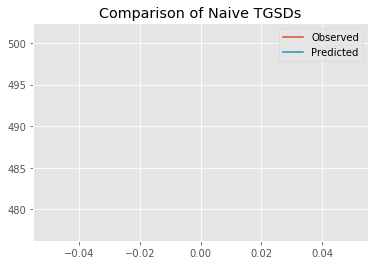

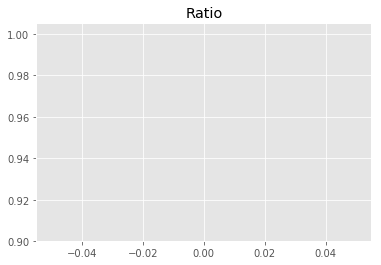

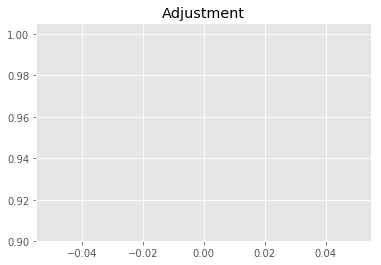

2741016383.695312
1


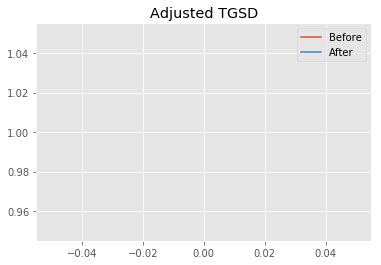

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.69854 	1.22033 	44894 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 2.8774e+09
After: 		|1.51643 	1.04462 	44447 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 266.724
New Misfit: 263.138
Convergence:
0.013444209400229995

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	4.99e+02 	4.77e+02 	0.9567 		1.0000


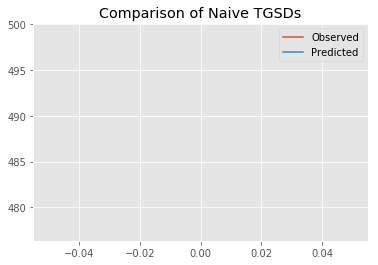

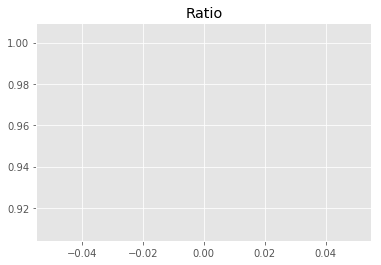

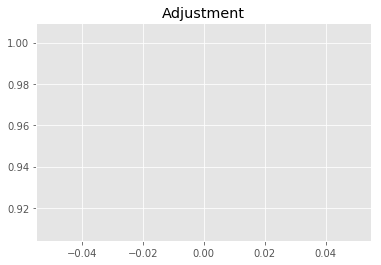

2752744725.7972565
1


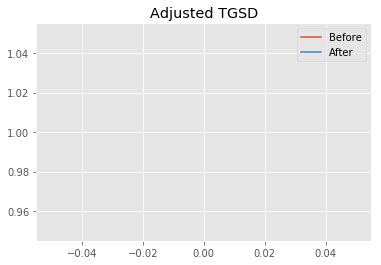

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.51643 	1.04462 	44447 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 2.8774e+09
After: 		|1.40747 	1.00008 	44745.3 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 263.138
New Misfit: 261.883
Convergence:
0.0047707510649187

____________________
a = 1.40747	b = 1.00008	            h1 = 44745.31608	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 2877403722.51970
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 261.8828255176215
Prior Misfit: 503.064,	 Post Misfit: 261.883


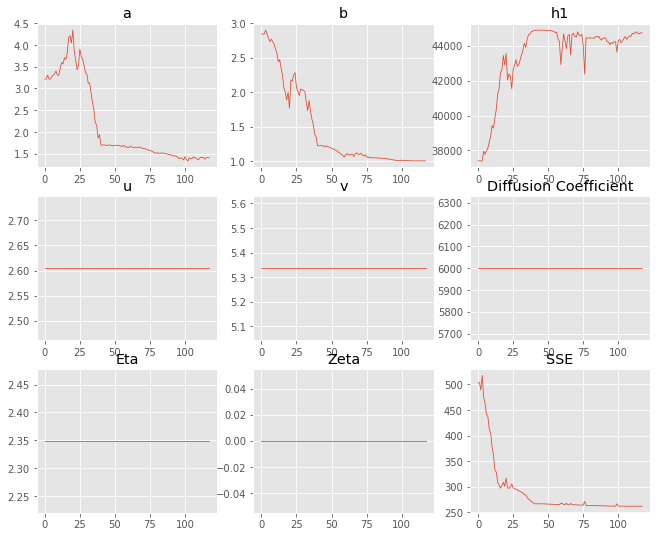

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,3.21462,1.40747
b,2.84497,1.00008
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"37,402","44,745.3"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 14 Time: 0.070 minutes


Estimated remaining run time: 0.384 minutes


Run 14===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	4.74e+02 	4.77e+02 	1.0075 		1.0000


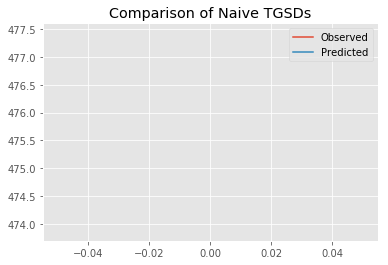

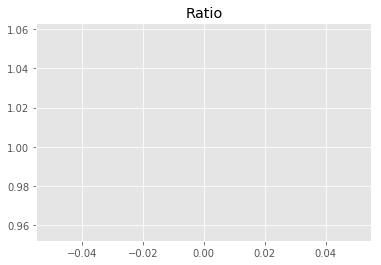

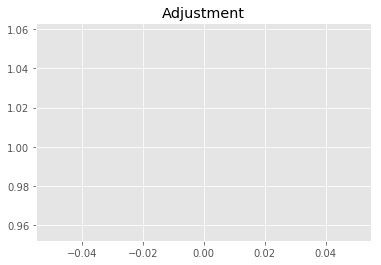

2898946176.987637
1


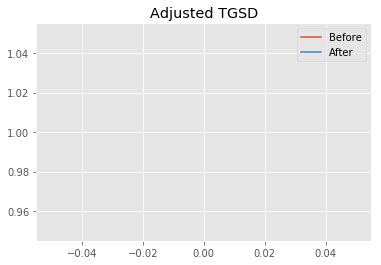

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.43206 	1.32659 	28043.6 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 2.8774e+09
After: 		|1.39718 	1.00012 	44913.1 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 1015.64
New Misfit: 261.877
Convergence:
0.7421557519145152

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	4.95e+02 	4.77e+02 	0.9642 		1.0000


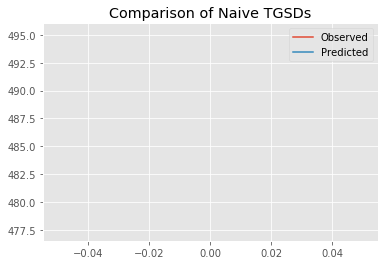

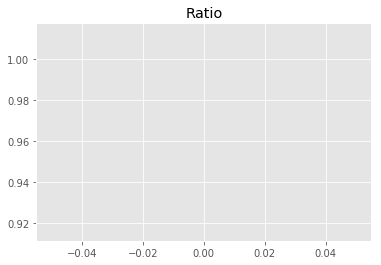

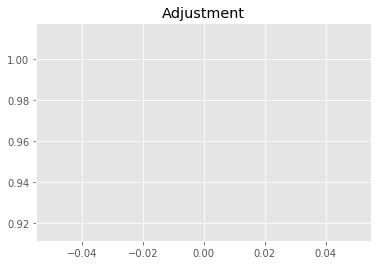

2774445110.8310466
1


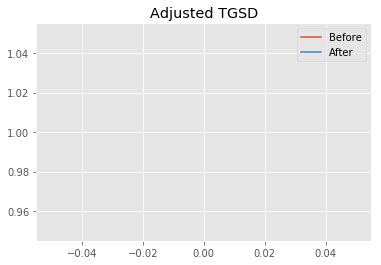

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.39718 	1.00012 	44913.1 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 2.8774e+09
After: 		|1.39718 	1 	44912 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 261.877
New Misfit: 261.875
Convergence:
9.481311908548119e-06

____________________
a = 1.39718	b = 1.00000	            h1 = 44911.96430	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 2877403722.51970
Success: True
Status: Successful convergence.
Iterations: 2
Misfit: 261.874597745488
Prior Misfit: 1015.64,	 Post Misfit: 261.875


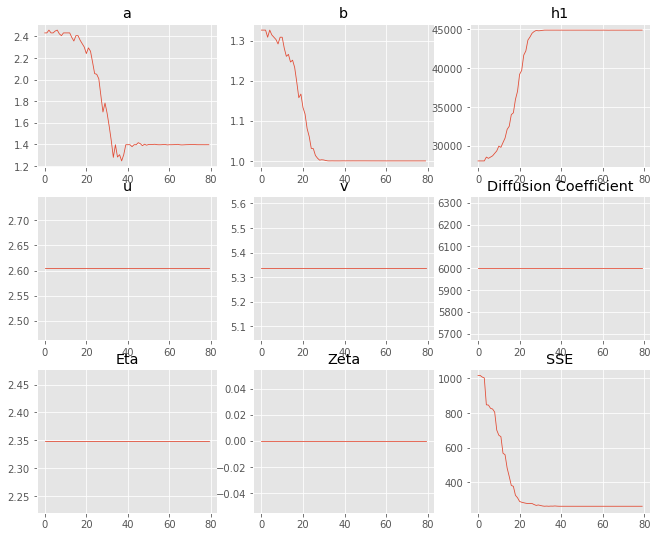

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,2.43206,1.39718
b,1.32659,1
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"28,043.6","44,912"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 15 Time: 0.052 minutes


Estimated remaining run time: 0.301 minutes


Run 15===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	5.13e+02 	4.77e+02 	0.9308 		1.0000


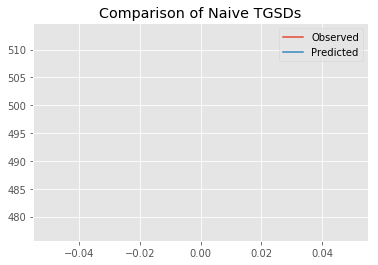

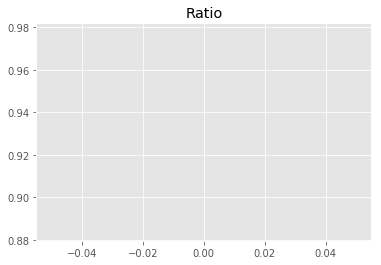

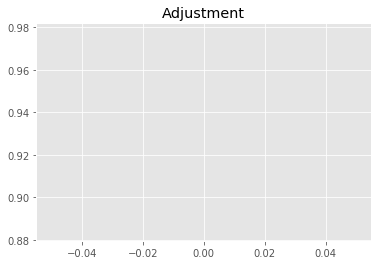

2678150180.126868
1


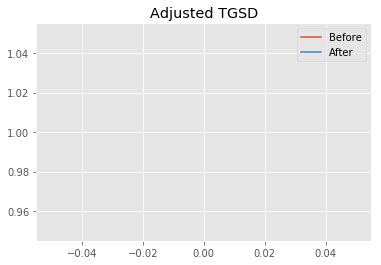

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.34799 	1.40795 	42599.9 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 2.8774e+09
After: 		|1.61279 	1.12354 	44914.6 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 280.349
New Misfit: 264.731
Convergence:
0.055711715487047384

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	5.01e+02 	4.77e+02 	0.9536 		1.0000


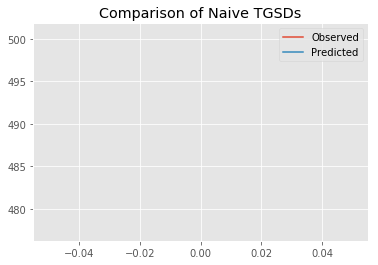

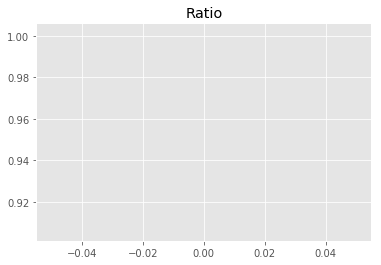

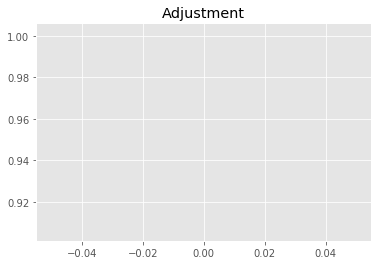

2743859094.283789
1


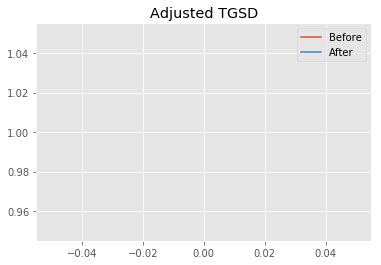

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.61279 	1.12354 	44914.6 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 2.8774e+09
After: 		|1.41327 	1.00807 	44754.2 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 264.731
New Misfit: 262.054
Convergence:
0.010111550642541546

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	4.96e+02 	4.77e+02 	0.9632 		1.0000


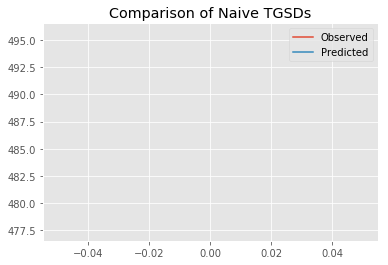

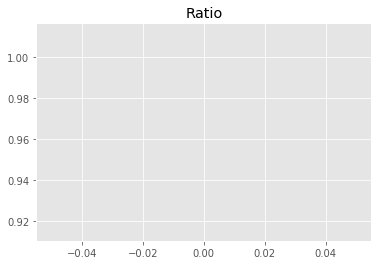

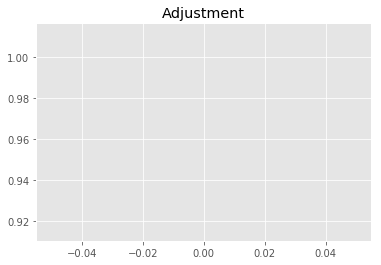

2771656513.3153415
1


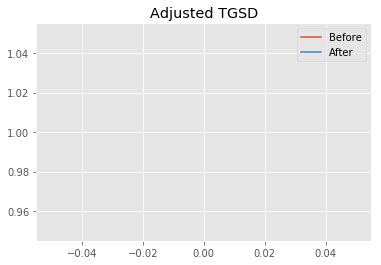

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.41327 	1.00807 	44754.2 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 2.8774e+09
After: 		|1.39482 	1.00028 	43980.2 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 262.054
New Misfit: 261.883
Convergence:
0.0006528259603197241

____________________
a = 1.39482	b = 1.00028	            h1 = 43980.24927	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 2877403722.51970
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 261.8826831885349
Prior Misfit: 280.349,	 Post Misfit: 261.883


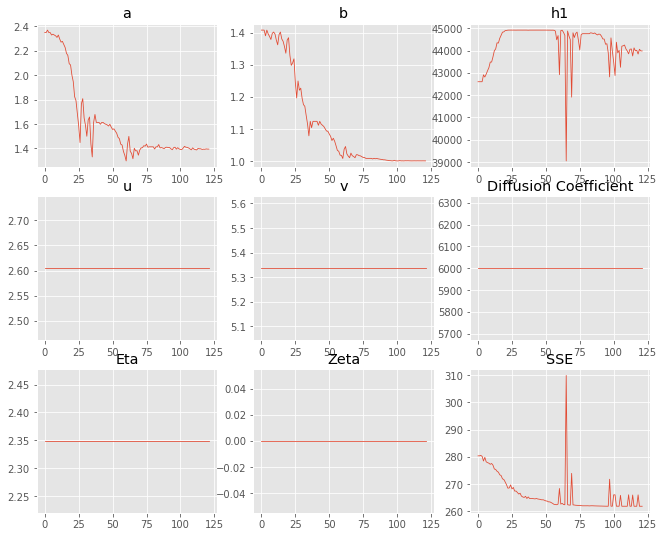

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,2.34799,1.39482
b,1.40795,1.00028
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"42,599.9","43,980.2"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 16 Time: 0.071 minutes


Estimated remaining run time: 0.225 minutes


Run 16===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	4.80e+02 	4.77e+02 	0.9945 		1.0000


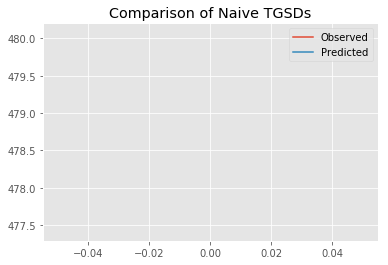

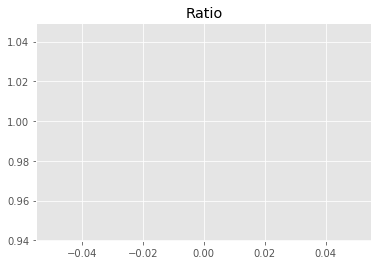

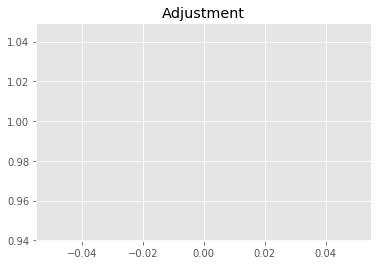

2861548851.1965895
1


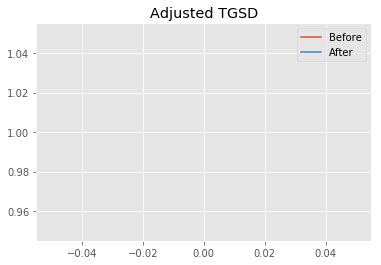

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.38873 	3.5176 	36943.9 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 2.8774e+09
After: 		|2.81101 	1.90685 	44506.5 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 698.442
New Misfit: 283.017
Convergence:
0.5947890100827969

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	5.15e+02 	4.77e+02 	0.9278 		1.0000


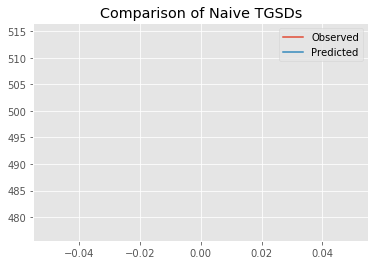

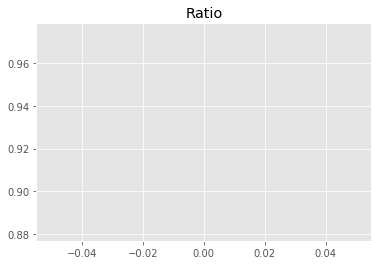

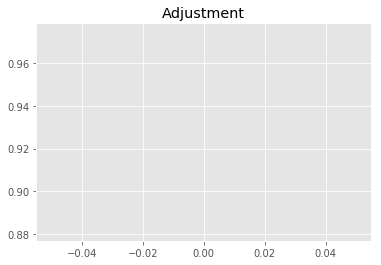

2669571478.2613883
1


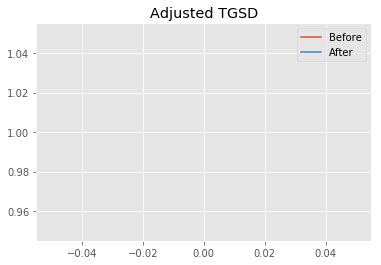

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.81101 	1.90685 	44506.5 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 2.8774e+09
After: 		|2.5614 	1.86372 	44913.2 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 283.017
New Misfit: 280.594
Convergence:
0.008558688417253608

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	5.11e+02 	4.77e+02 	0.9343 		1.0000


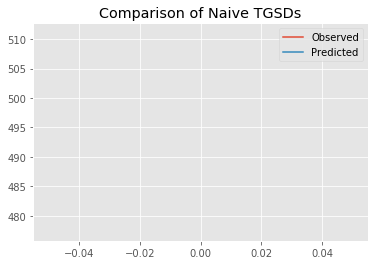

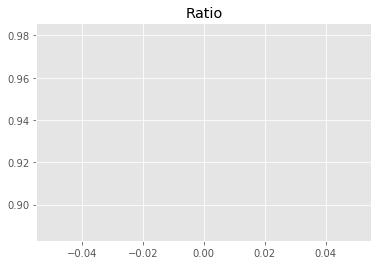

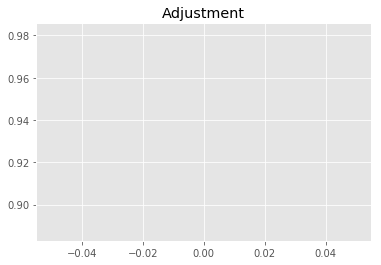

2688303597.434109
1


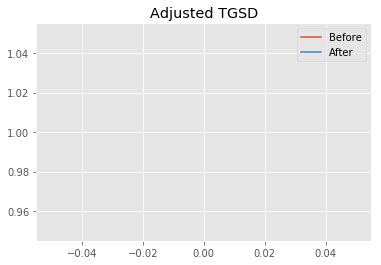

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.5614 	1.86372 	44913.2 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 2.8774e+09
After: 		|2.2234 	1.60298 	44686 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 280.594
New Misfit: 275.661
Convergence:
0.017582124633774194

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	5.08e+02 	4.77e+02 	0.9398 		1.0000


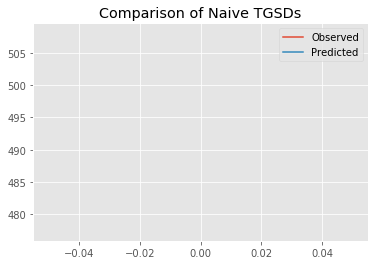

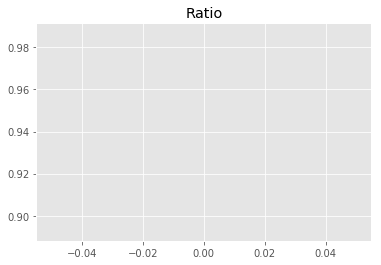

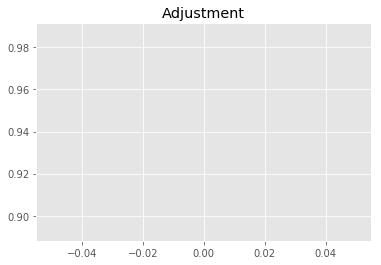

2704059967.0238123
1


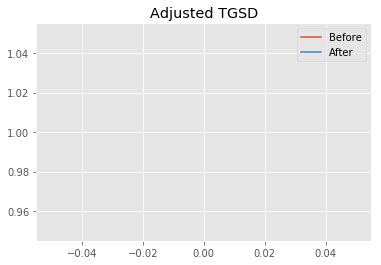

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.2234 	1.60298 	44686 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 2.8774e+09
After: 		|1.40586 	1.01485 	44915 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 275.661
New Misfit: 262.198
Convergence:
0.048837850039297255

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	4.95e+02 	4.77e+02 	0.9644 		1.0000


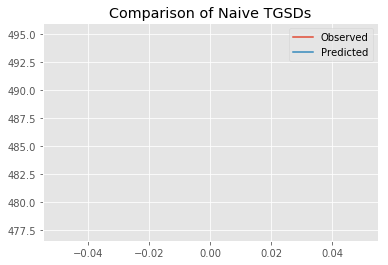

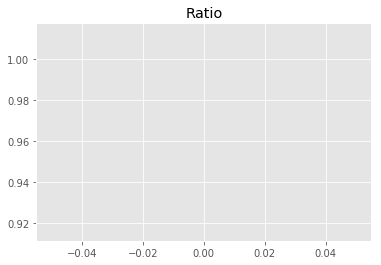

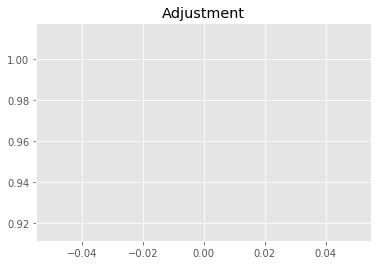

2774923240.6766047
1


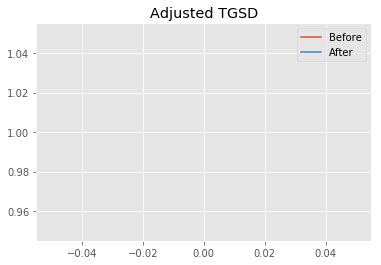

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.40586 	1.01485 	44915 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 2.8774e+09
After: 		|1.39665 	1.00001 	44915 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 262.198
New Misfit: 261.875
Convergence:
0.0012329139427783647

____________________
a = 1.39665	b = 1.00001	            h1 = 44914.99996	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 2877403722.51970
Success: True
Status: Successful convergence.
Iterations: 5
Misfit: 261.8749145019388
Prior Misfit: 698.442,	 Post Misfit: 261.875


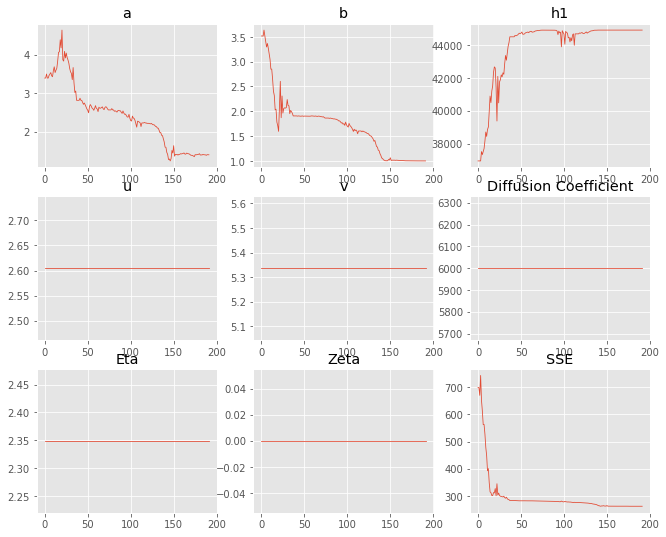

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,3.38873,1.39665
b,3.5176,1.00001
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"36,943.9","44,915"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 17 Time: 0.102 minutes


Estimated remaining run time: 0.153 minutes


Run 17===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	4.96e+02 	4.77e+02 	0.9624 		1.0000


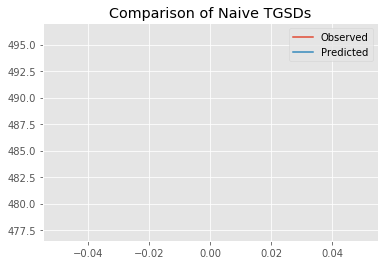

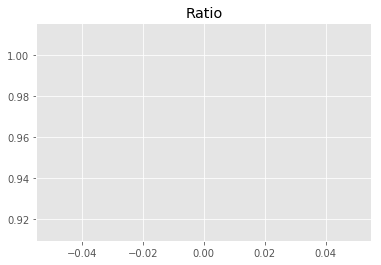

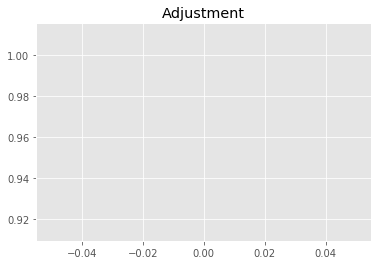

2769282143.393411
1


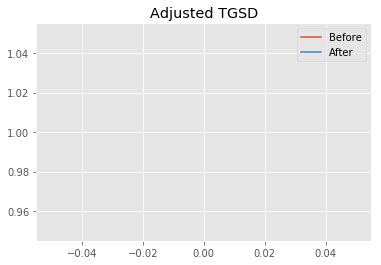

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.65815 	1.66679 	34552 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 2.8774e+09
After: 		|2.33448 	1.65376 	43951.4 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 423.629
New Misfit: 279
Convergence:
0.34140383457493706

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	5.09e+02 	4.77e+02 	0.9380 		1.0000


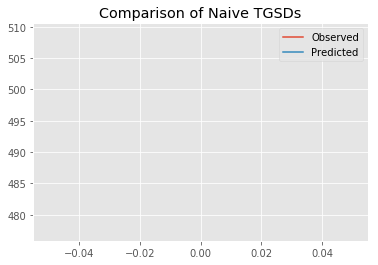

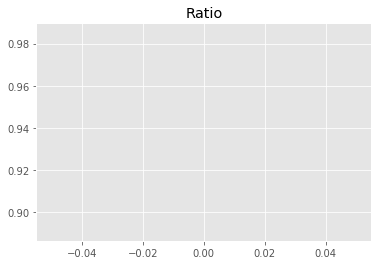

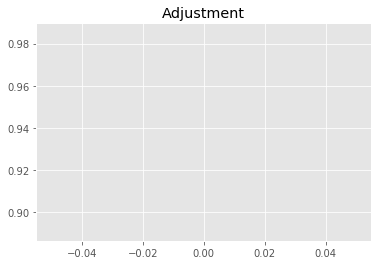

2699099276.504437
1


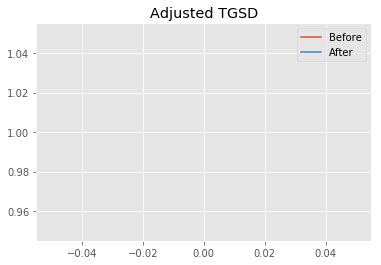

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.33448 	1.65376 	43951.4 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 2.8774e+09
After: 		|1.39392 	1.02383 	44915 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 279
New Misfit: 262.46
Convergence:
0.05928281122996402

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	4.94e+02 	4.77e+02 	0.9661 		1.0000


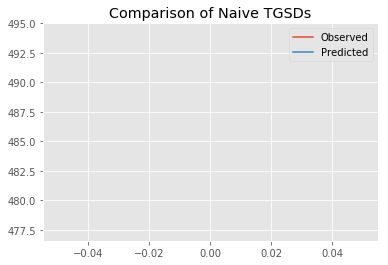

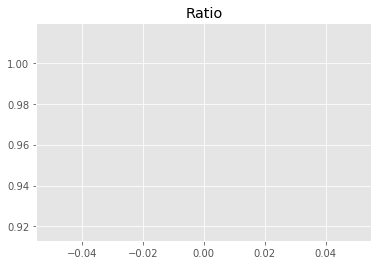

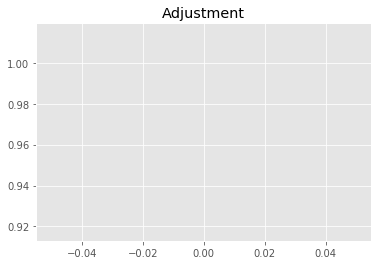

2779947993.8670397
1


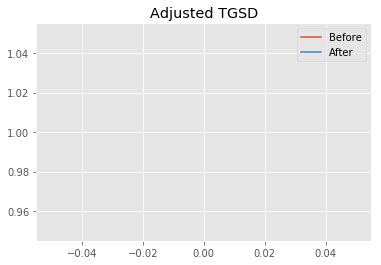

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.39392 	1.02383 	44915 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 2.8774e+09
After: 		|1.40426 	1.00008 	44915 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 262.46
New Misfit: 261.879
Convergence:
0.0022142881697280025

____________________
a = 1.40426	b = 1.00008	            h1 = 44915.00000	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 2877403722.51970
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 261.8793030167292
Prior Misfit: 423.629,	 Post Misfit: 261.879


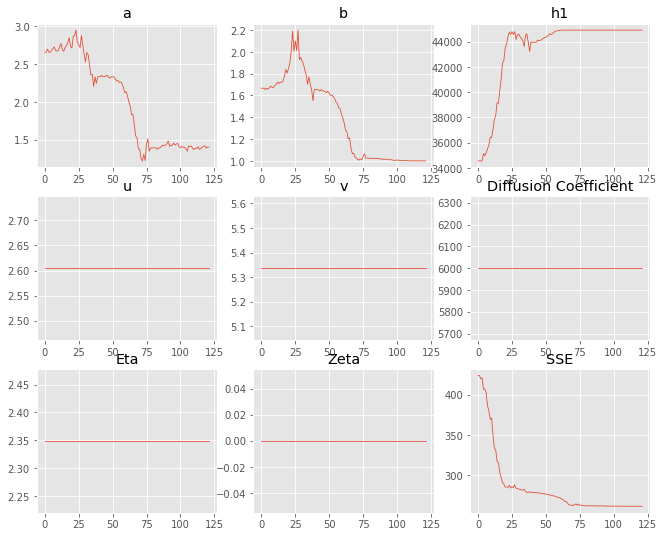

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,2.65815,1.40426
b,1.66679,1.00008
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"34,552","44,915"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 18 Time: 0.066 minutes


Estimated remaining run time: 0.076 minutes


Run 18===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	5.06e+02 	4.77e+02 	0.9438 		1.0000


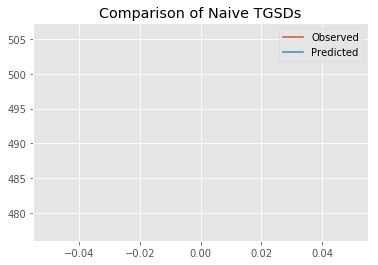

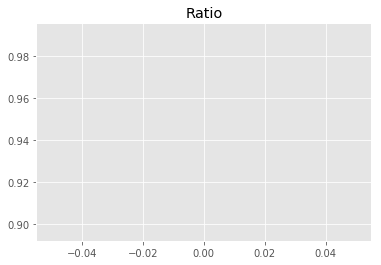

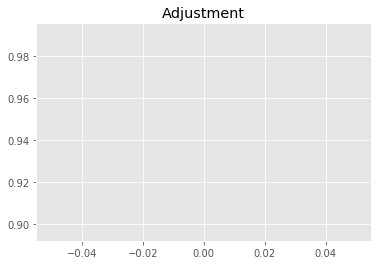

2715830330.359597
1


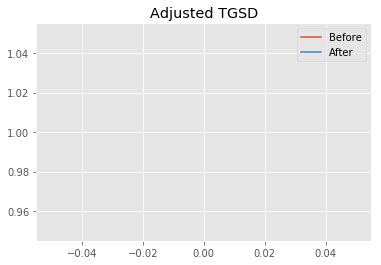

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|4.69274 	3.27375 	37805.3 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 2.8774e+09
After: 		|3.20904 	2.19379 	44688.3 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 405.585
New Misfit: 287.838
Convergence:
0.29031527289733283

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	5.17e+02 	4.77e+02 	0.9239 		1.0000


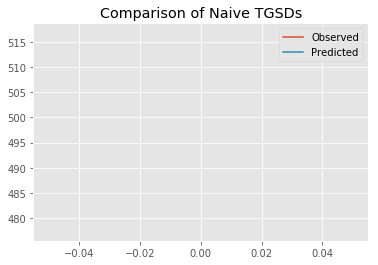

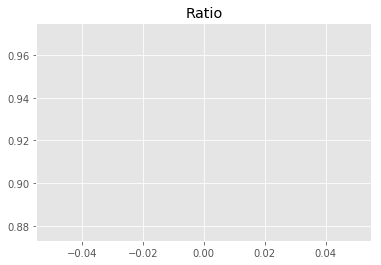

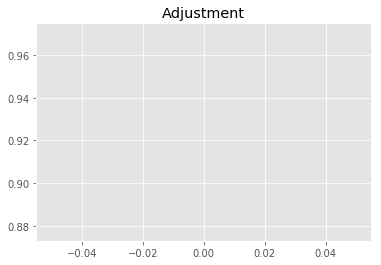

2658524214.2015104
1


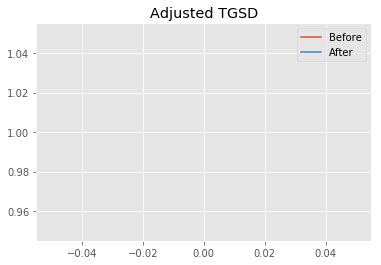

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.20904 	2.19379 	44688.3 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 2.8774e+09
After: 		|1.30802 	1.12811 	44915 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 287.838
New Misfit: 269.235
Convergence:
0.06462965820107722

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	4.86e+02 	4.77e+02 	0.9829 		1.0000


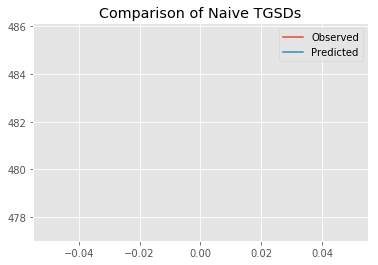

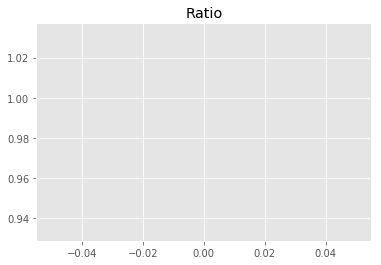

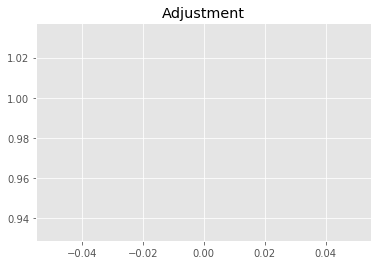

2828332785.7767024
1


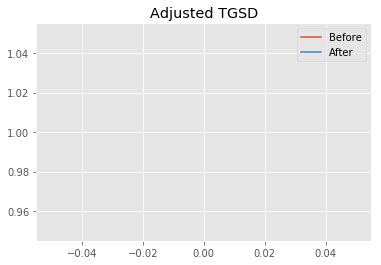

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.30802 	1.12811 	44915 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 2.8774e+09
After: 		|1.30802 	1.1156 	44915 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 269.235
New Misfit: 268.399
Convergence:
0.0031040384769955697

____________________
a = 1.30802	b = 1.11560	            h1 = 44915.00000	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 2877403722.51970
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 268.399224552025
Prior Misfit: 405.585,	 Post Misfit: 268.399


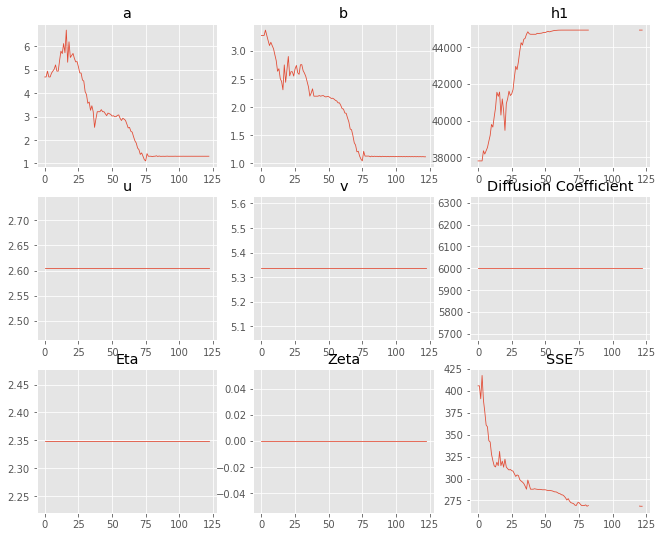

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,4.69274,1.30802
b,3.27375,1.1156
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"37,805.3","44,915"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 19 Time: 0.069 minutes


Estimated remaining run time: 0.000 minutes


Run 19===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	5.01e+02 	4.77e+02 	0.9533 		1.0000


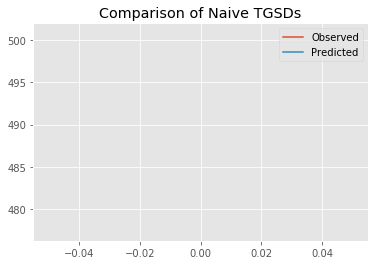

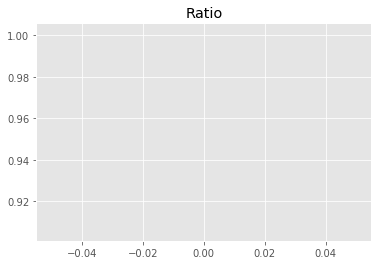

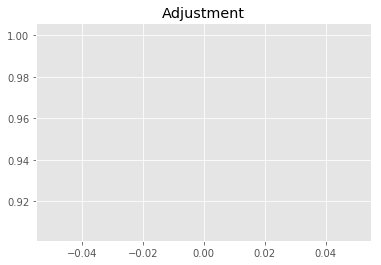

2743125251.2679133
1


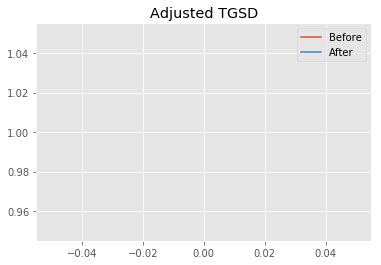

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|4.28942 	4.58276 	44393.3 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 2.8774e+09
After: 		|2.83983 	2.06586 	44914.2 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 397.623
New Misfit: 284.533
Convergence:
0.2844157126386534

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	5.13e+02 	4.77e+02 	0.9307 		1.0000


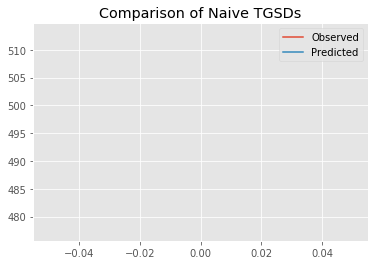

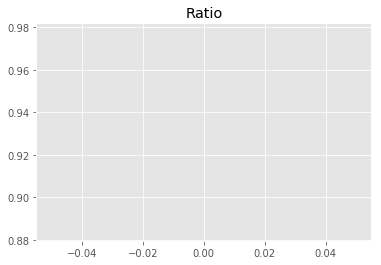

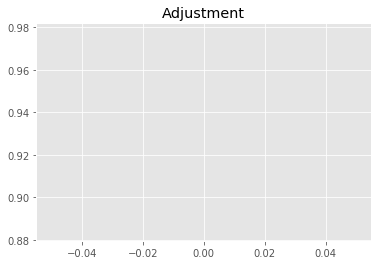

2678007206.6059
1


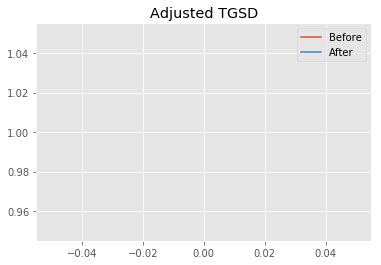

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.83983 	2.06586 	44914.2 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 2.8774e+09
After: 		|1.69364 	1.30145 	44915 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 284.533
New Misfit: 268.994
Convergence:
0.054611770388570936

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	2.88e+09 	4.99e+02 	4.77e+02 	0.9573 		1.0000


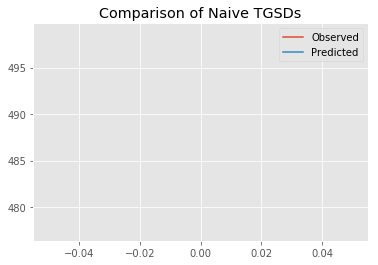

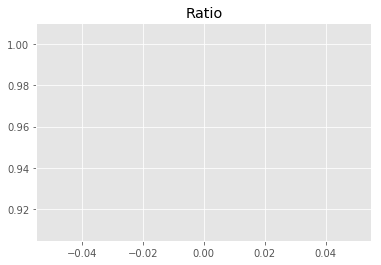

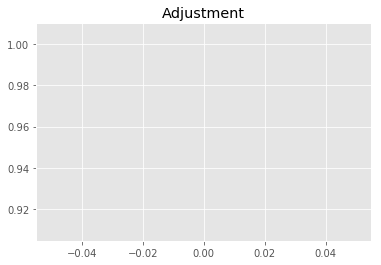

2754651527.9446564
1


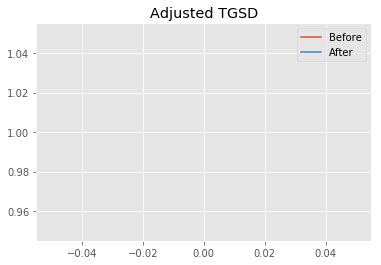

Old Total Mass: 2.8774e+09
New Total Mass: 2.8774e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.69364 	1.30145 	44915 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 2.8774e+09
After: 		|1.69364 	1.28391 	44915 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 268.994
New Misfit: 268.395
Convergence:
0.002226797753524544

____________________
a = 1.69364	b = 1.28391	            h1 = 44915.00000	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 2877403722.51970
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 268.39478204617166
Prior Misfit: 397.623,	 Post Misfit: 268.395


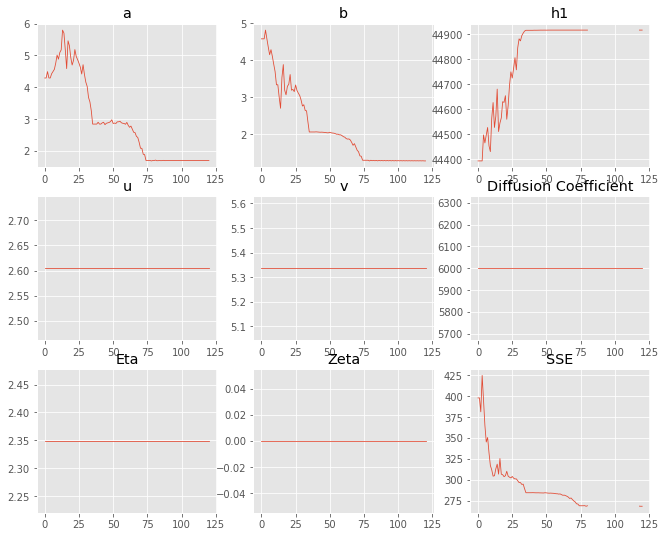

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,4.28942,1.69364
b,4.58276,1.28391
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"44,393.3","44,915"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 20 Time: 0.068 minutes


Estimated remaining run time: -0.075 minutes


Total Run Time: 1.58177 minutes


[{'a': 1.7513458091723808,
  'b': 1.3533789176514497,
  'h1': 44915.0,
  'u': 2.60482,
  'v': 5.33615,
  'D': 5999.899999999996,
  'ftt': 6457.999999999996,
  'eta': 2.34894,
  'zeta': 0.0},
 {'a': 1.3994415873882893,
  'b': 1.0000788737252873,
  'h1': 44876.336702851564,
  'u': 2.60482,
  'v': 5.33615,
  'D': 5999.899999999996,
  'ftt': 6457.999999999996,
  'eta': 2.34894,
  'zeta': 0.0},
 {'a': 1.4047207130341433,
  'b': 1.0005214138378278,
  'h1': 44714.94612488354,
  'u': 2.60482,
  'v': 5.33615,
  'D': 5999.899999999996,
  'ftt': 6457.999999999996,
  'eta': 2.34894,
  'zeta': 0.0},
 {'a': 1.370770408999705,
  'b': 1.070392841635117,
  'h1': 44915.0,
  'u': 2.60482,
  'v': 5.33615,
  'D': 5999.899999999996,
  'ftt': 6457.999999999996,
  'eta': 2.34894,
  'zeta': 0.0},
 {'a': 2.7675313058985536,
  'b': 1.999858411451068,
  'h1': 44914.99995490911,
  'u': 2.60482,
  'v': 5.33615,
  'D': 5999.899999999996,
  'ftt': 6457.999999999996,
  'eta': 2.34894,
  'zeta': 0.0},
 {'a': 1.40059774

,a,b,h1,u,v,D,ftt,eta,zeta,M,Misfit
14,1.39718,1,"44,912",2.60482,5.33615,"5,999.9","6,458",2.34894,0,2.8774e+09,261.875
10,1.39877,1,"44,911.3",2.60482,5.33615,"5,999.9","6,458",2.34894,0,2.8774e+09,261.875
16,1.39665,1.00001,"44,915",2.60482,5.33615,"5,999.9","6,458",2.34894,0,2.8774e+09,261.875
8,1.39908,1.00002,"44,796.6",2.60482,5.33615,"5,999.9","6,458",2.34894,0,2.8774e+09,261.875
5,1.4006,1.00001,"44,827.6",2.60482,5.33615,"5,999.9","6,458",2.34894,0,2.8774e+09,261.875
12,1.39856,1.00005,"44,325.8",2.60482,5.33615,"5,999.9","6,458",2.34894,0,2.8774e+09,261.876
1,1.39944,1.00008,"44,876.3",2.60482,5.33615,"5,999.9","6,458",2.34894,0,2.8774e+09,261.877
17,1.40426,1.00008,"44,915",2.60482,5.33615,"5,999.9","6,458",2.34894,0,2.8774e+09,261.879
15,1.39482,1.00028,"43,980.2",2.60482,5.33615,"5,999.9","6,458",2.34894,0,2.8774e+09,261.883
13,1.40747,1.00008,"44,745.3",2.60482,5.33615,"5,999.9","6,458",2.34894,0,2.8774e+09,261.883


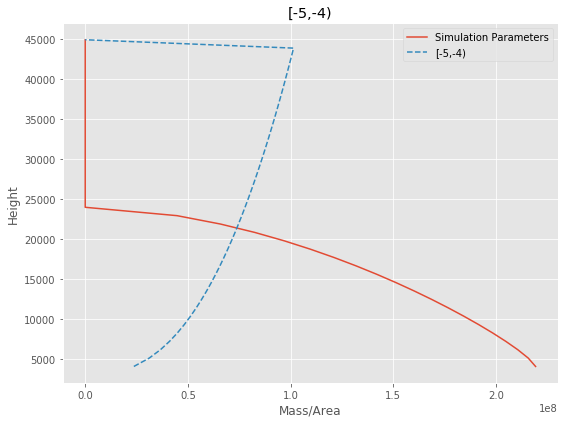

[-5,-4) Run Time: 1.58411 minutes


Mass Test: 2877403722.5197015
========[-4,-3)========
Run 0===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.90e+03 	1.55e+03 	0.8159 		1.0000


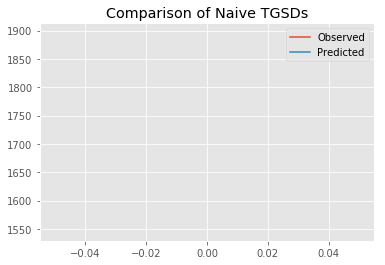

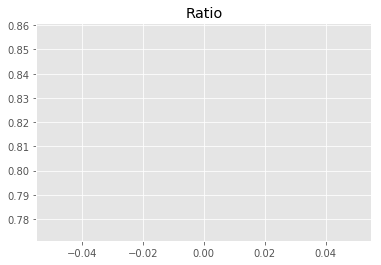

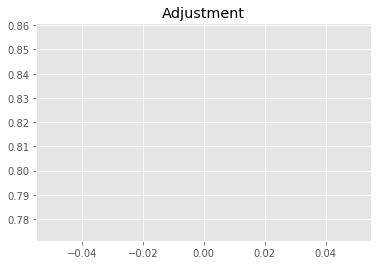

7604010644.268826
1


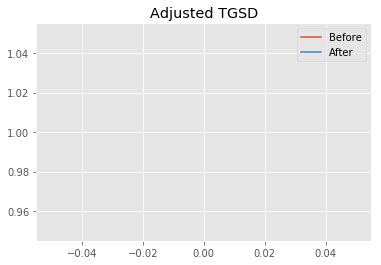

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.72683 	1.17603 	27345.1 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 9.31979e+09
After: 		|2.69723 	1.1383 	39352.1 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 995.01
New Misfit: 592.188
Convergence:
0.4048420290584401

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	2.01e+03 	1.55e+03 	0.7686 		1.0000


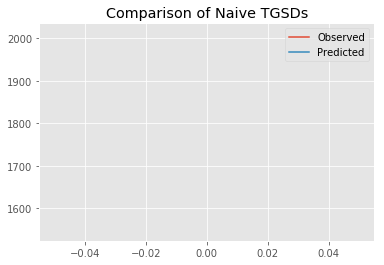

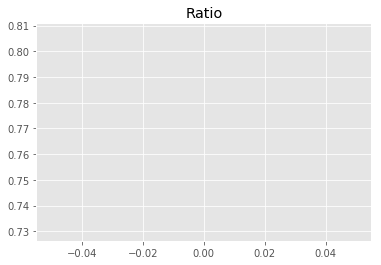

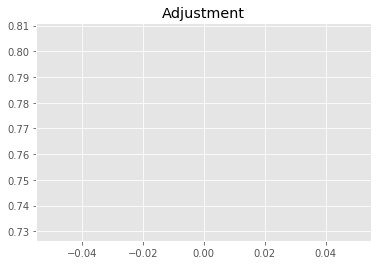

7162873464.484192
1


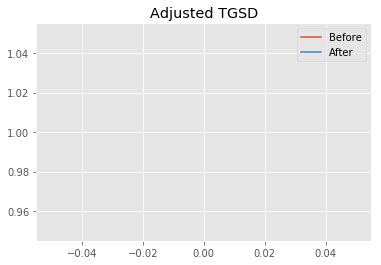

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.69723 	1.1383 	39352.1 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 9.31979e+09
After: 		|1.51316 	1.02788 	44637.3 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 592.188
New Misfit: 544.802
Convergence:
0.08001939213738293

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.91e+03 	1.55e+03 	0.8083 		1.0000


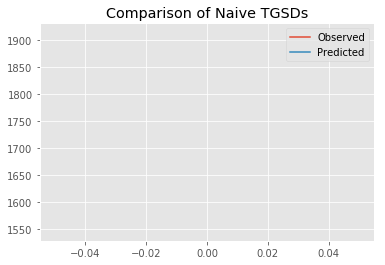

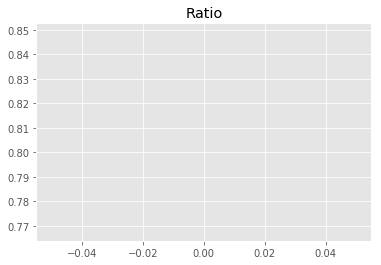

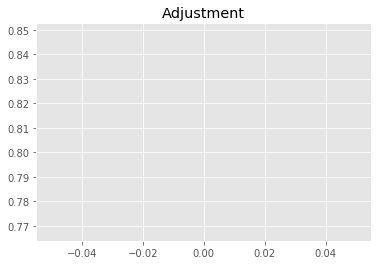

7532905973.640869
1


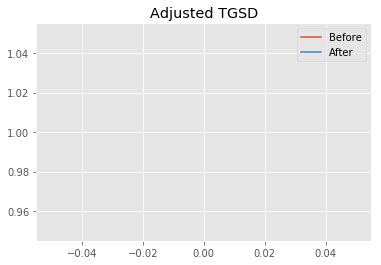

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.51316 	1.02788 	44637.3 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 9.31979e+09
After: 		|1.50554 	1.00007 	44696.5 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 544.802
New Misfit: 543.291
Convergence:
0.0027723041573307983

____________________
a = 1.50554	b = 1.00007	            h1 = 44696.54102	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 9319785815.10838
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 543.2912753420902
Prior Misfit: 995.01,	 Post Misfit: 543.291


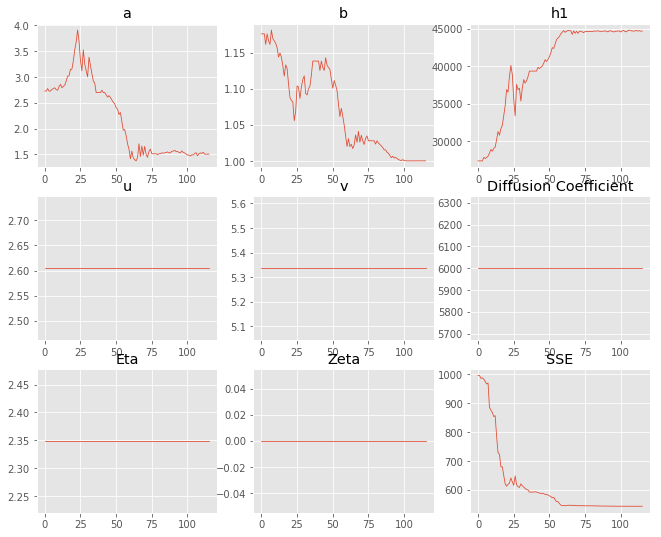

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,2.72683,1.50554
b,1.17603,1.00007
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"27,345.1","44,696.5"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 1 Time: 0.065 minutes


Estimated remaining run time: 0.584 minutes


Run 1===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	2.02e+03 	1.55e+03 	0.7653 		1.0000


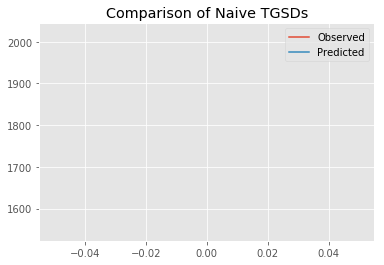

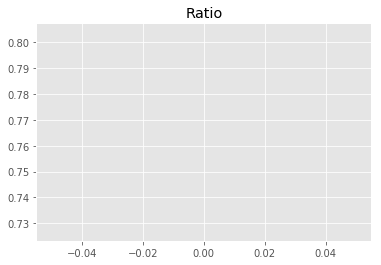

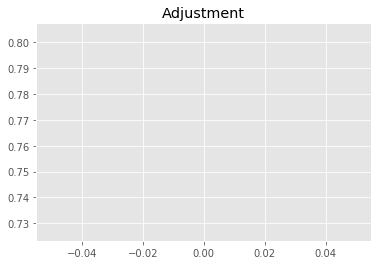

7132573743.427639
1


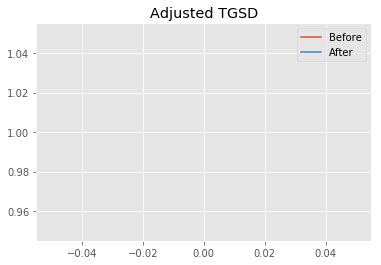

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|4.04122 	2.26851 	40342.1 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 9.31979e+09
After: 		|2.80238 	1.96154 	44733.8 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 613.747
New Misfit: 581.612
Convergence:
0.05235771665944581

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.98e+03 	1.55e+03 	0.7809 		1.0000


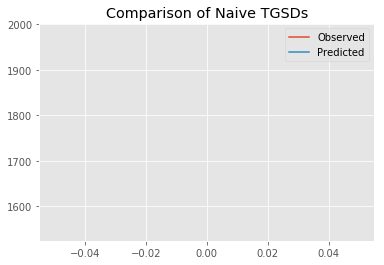

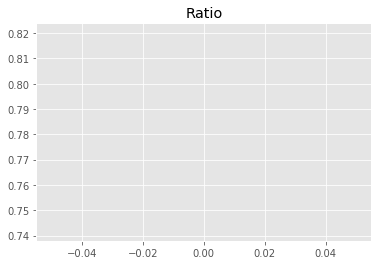

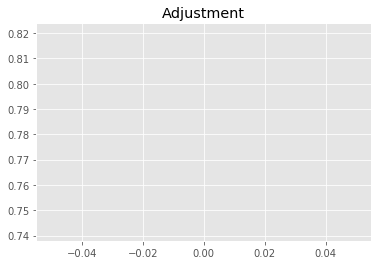

7277711726.087229
1


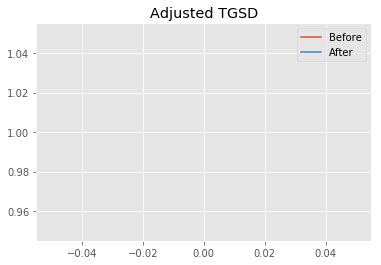

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.80238 	1.96154 	44733.8 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 9.31979e+09
After: 		|2.45206 	1.78733 	44915 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 581.612
New Misfit: 575.529
Convergence:
0.010459195723224556

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.96e+03 	1.55e+03 	0.7874 		1.0000


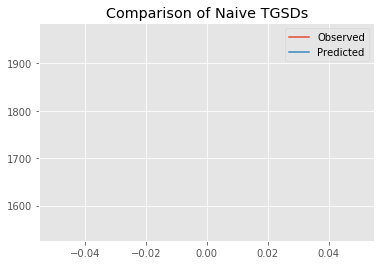

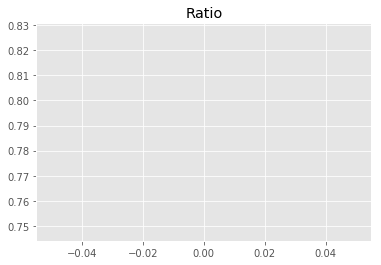

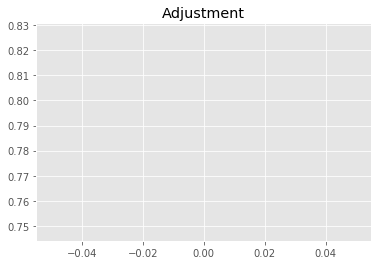

7338375009.43125
1


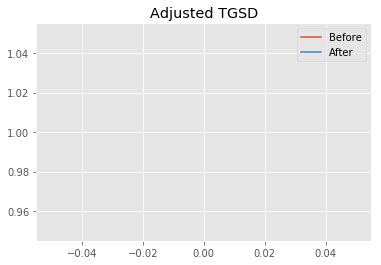

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.45206 	1.78733 	44915 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 9.31979e+09
After: 		|2.45206 	1.77797 	44915 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 575.529
New Misfit: 575.145
Convergence:
0.0006674130493702846

____________________
a = 2.45206	b = 1.77797	            h1 = 44915.00000	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 9319785815.10838
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 575.1449796561405
Prior Misfit: 613.747,	 Post Misfit: 575.145


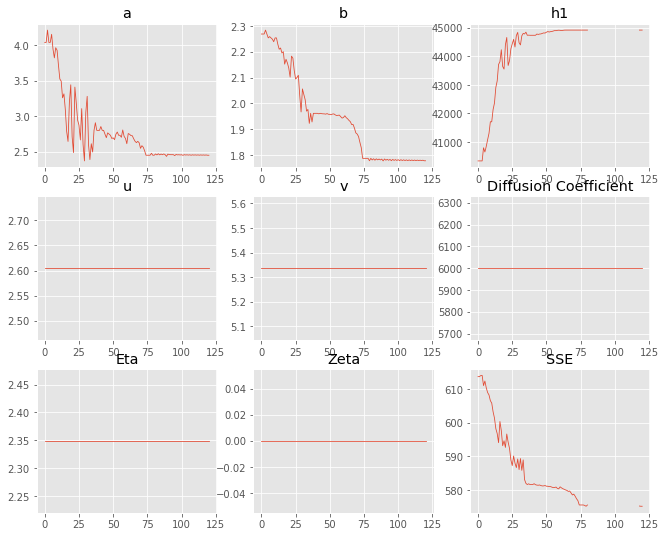

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,4.04122,2.45206
b,2.26851,1.77797
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"40,342.1","44,915"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 2 Time: 0.067 minutes


Estimated remaining run time: 0.750 minutes


Run 2===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.81e+03 	1.55e+03 	0.8542 		1.0000


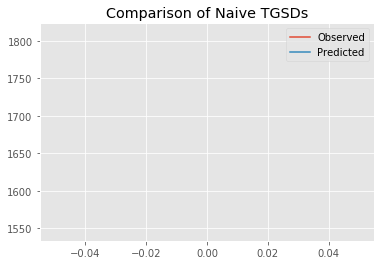

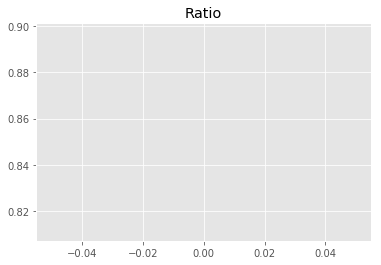

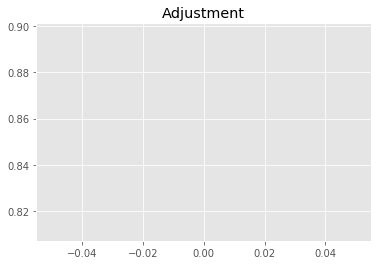

7960569502.594724
1


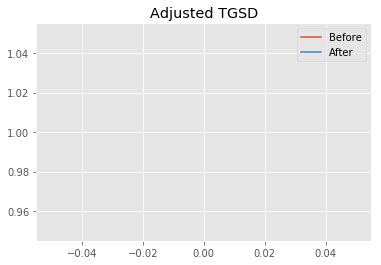

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|4.094 	1.89954 	24123 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 9.31979e+09
After: 		|5.911 	1.97621 	35167.1 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 1830.03
New Misfit: 641.488
Convergence:
0.6494661757780558

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	2.06e+03 	1.55e+03 	0.7502 		1.0000


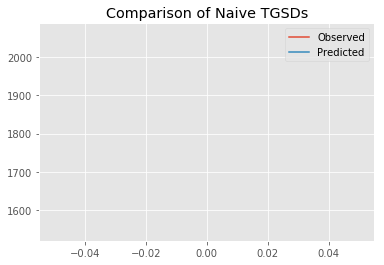

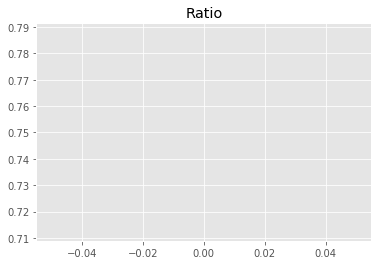

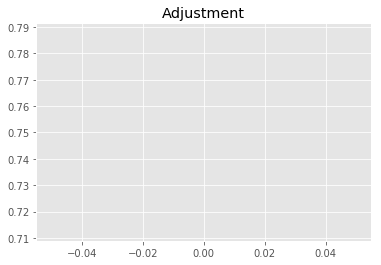

6991263319.267774
1


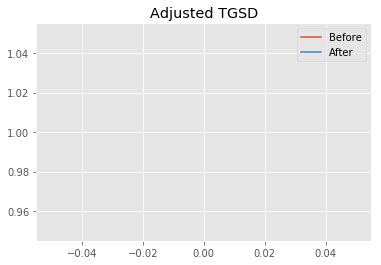

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|5.911 	1.97621 	35167.1 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 9.31979e+09
After: 		|2.6357 	1.97181 	44832.1 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 641.488
New Misfit: 582.258
Convergence:
0.09233165827843119

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.97e+03 	1.55e+03 	0.7854 		1.0000


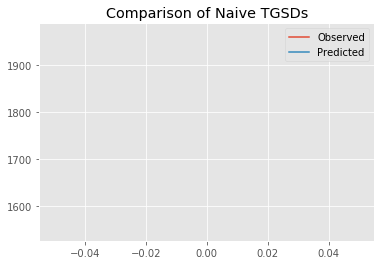

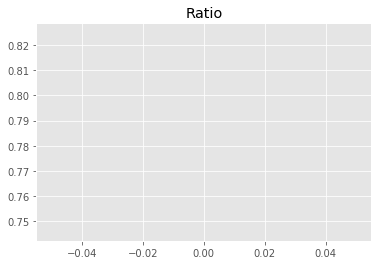

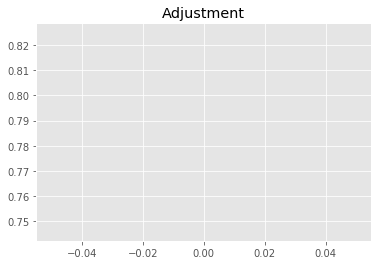

7320165047.9018545
1


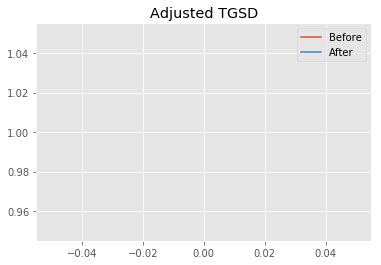

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.6357 	1.97181 	44832.1 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 9.31979e+09
After: 		|2.65821 	1.9039 	44914.5 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 582.258
New Misfit: 579.065
Convergence:
0.005484298005232891

____________________
a = 2.65821	b = 1.90390	            h1 = 44914.53067	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 9319785815.10838
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 579.0649672243937
Prior Misfit: 1830.03,	 Post Misfit: 579.065


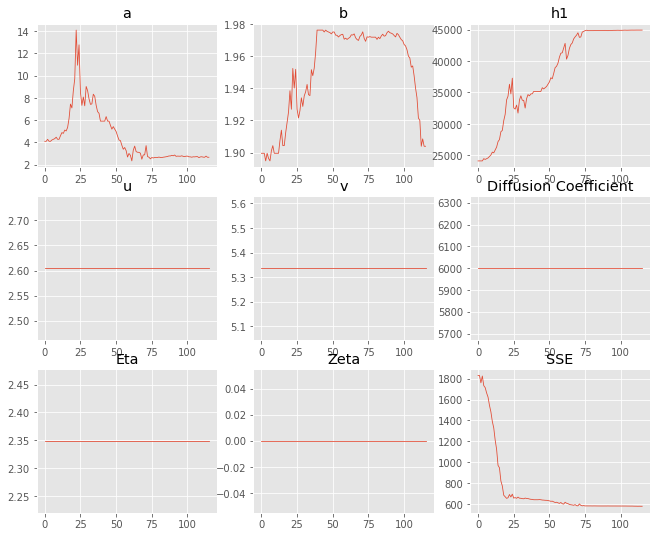

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,4.094,2.65821
b,1.89954,1.9039
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"24,123","44,914.5"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 3 Time: 0.064 minutes


Estimated remaining run time: 0.783 minutes


Run 3===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.94e+03 	1.55e+03 	0.7977 		1.0000


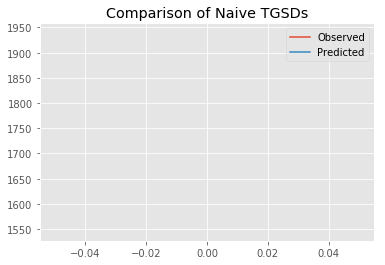

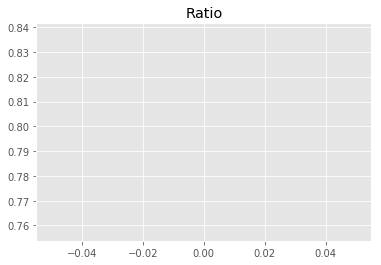

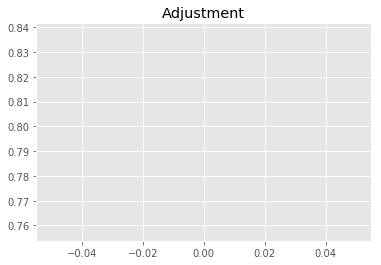

7434342726.77359
1


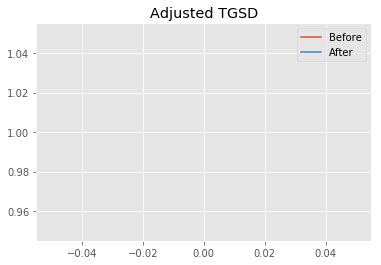

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.84092 	3.9198 	42260.7 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 9.31979e+09
After: 		|3.98201 	2.65886 	43860.6 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 733.875
New Misfit: 603.719
Convergence:
0.17735445100242808

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	2.01e+03 	1.55e+03 	0.7683 		1.0000


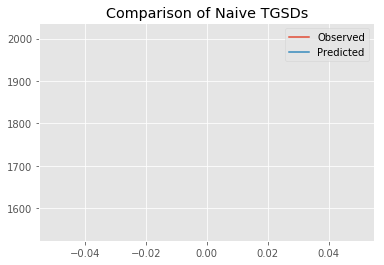

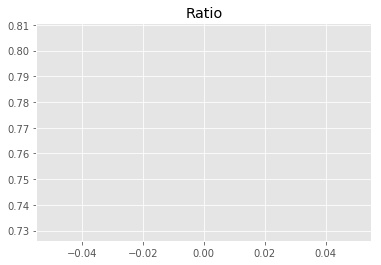

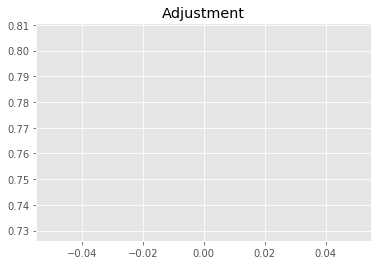

7160497948.80168
1


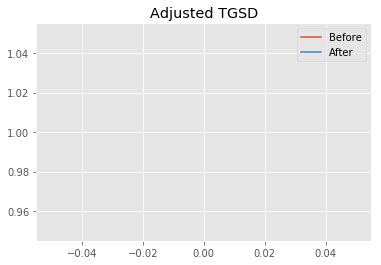

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.98201 	2.65886 	43860.6 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 9.31979e+09
After: 		|1.71794 	1.17652 	44915 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 603.719
New Misfit: 551.552
Convergence:
0.0864094402560698

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.93e+03 	1.55e+03 	0.8018 		1.0000


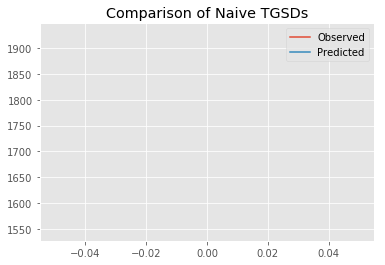

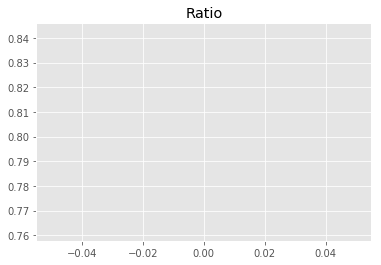

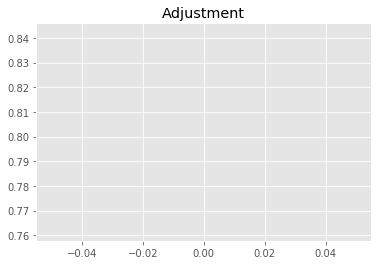

7472808857.3114195
1


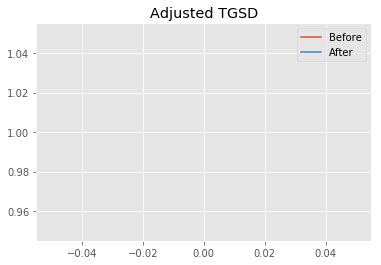

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.71794 	1.17652 	44915 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 9.31979e+09
After: 		|1.4962 	1.00112 	44862.5 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 551.552
New Misfit: 543.363
Convergence:
0.014848055899565603

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.91e+03 	1.55e+03 	0.8083 		1.0000


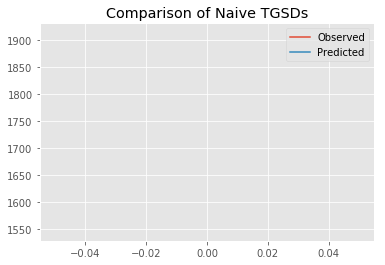

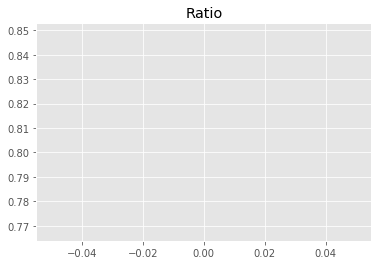

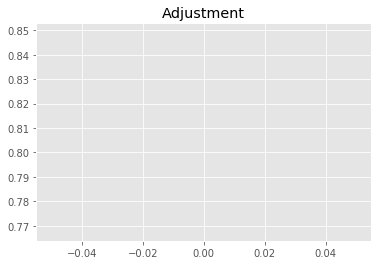

7533640835.798781
1


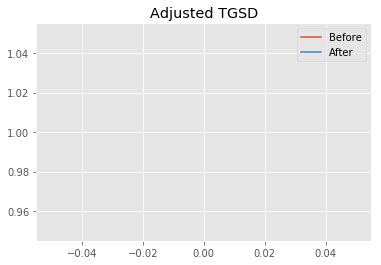

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.4962 	1.00112 	44862.5 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 9.31979e+09
After: 		|1.50982 	1.00001 	44913.4 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 543.363
New Misfit: 543.287
Convergence:
0.00013939725853736101

____________________
a = 1.50982	b = 1.00001	            h1 = 44913.42117	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 9319785815.10838
Success: True
Status: Successful convergence.
Iterations: 4
Misfit: 543.2870451374483
Prior Misfit: 733.875,	 Post Misfit: 543.287


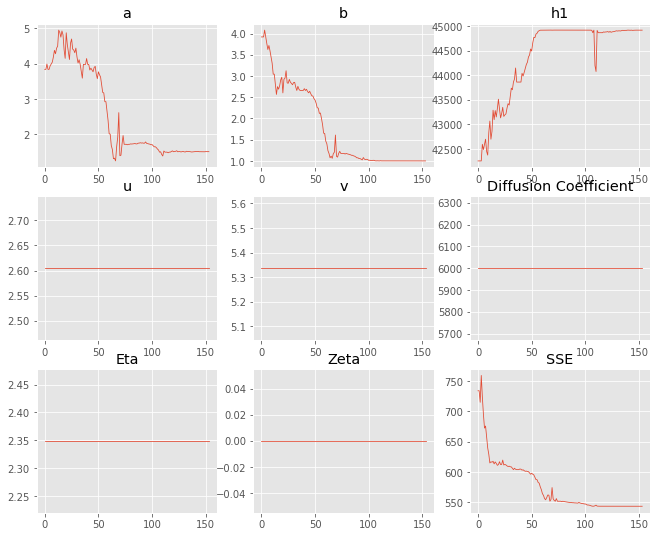

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,3.84092,1.50982
b,3.9198,1.00001
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"42,260.7","44,913.4"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 4 Time: 0.083 minutes


Estimated remaining run time: 0.837 minutes


Run 4===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.72e+03 	1.55e+03 	0.8966 		1.0000


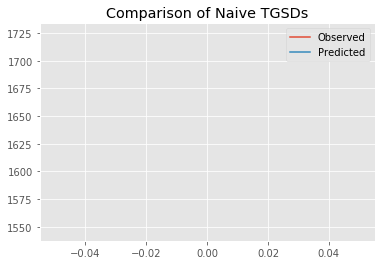

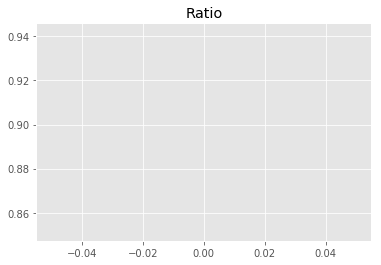

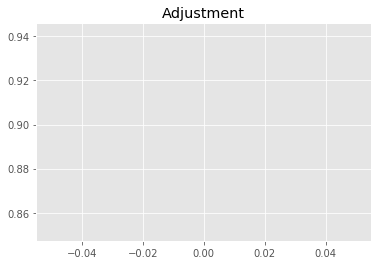

8355771620.165176
1


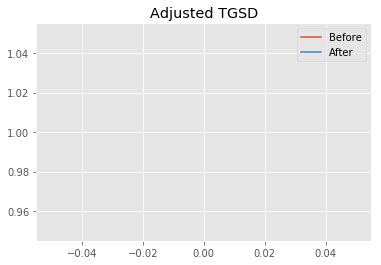

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.0177 	3.98995 	44375.7 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 9.31979e+09
After: 		|2.02464 	1.20843 	44913.8 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 1403.1
New Misfit: 557.534
Convergence:
0.6026421854192914

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.96e+03 	1.55e+03 	0.7902 		1.0000


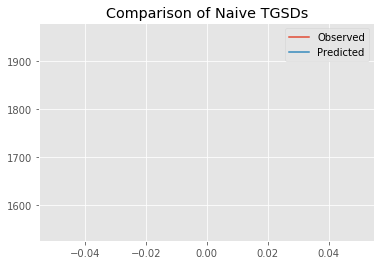

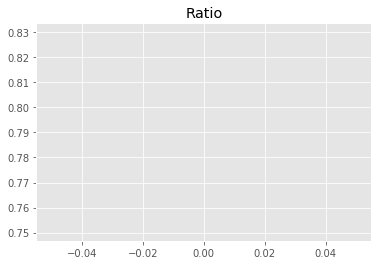

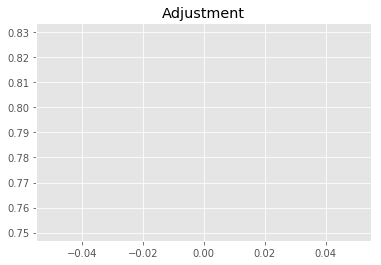

7364075561.265232
1


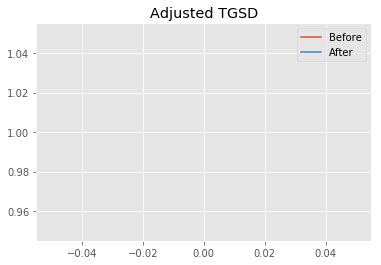

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.02464 	1.20843 	44913.8 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 9.31979e+09
After: 		|1.54793 	1.03913 	44915 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 557.534
New Misfit: 545.178
Convergence:
0.02216256629953111

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.92e+03 	1.55e+03 	0.8066 		1.0000


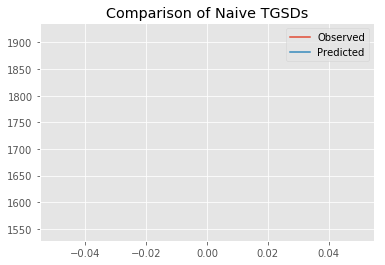

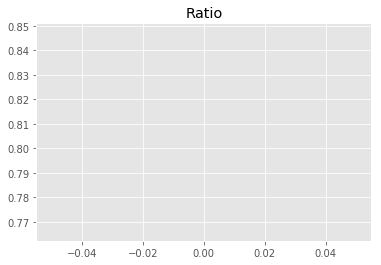

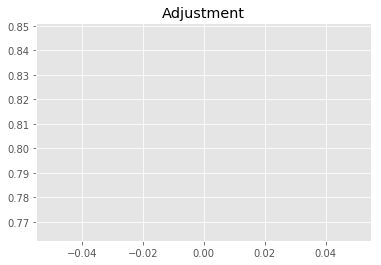

7517520228.129596
1


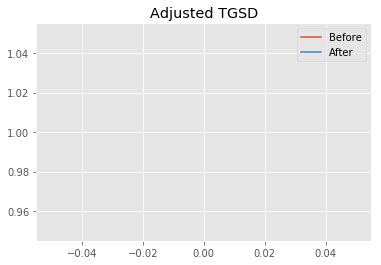

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.54793 	1.03913 	44915 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 9.31979e+09
After: 		|1.54793 	1.03328 	44915 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 545.178
New Misfit: 544.889
Convergence:
0.0005298831457870966

____________________
a = 1.54793	b = 1.03328	            h1 = 44915.00000	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 9319785815.10838
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 544.8889444227287
Prior Misfit: 1403.1,	 Post Misfit: 544.889


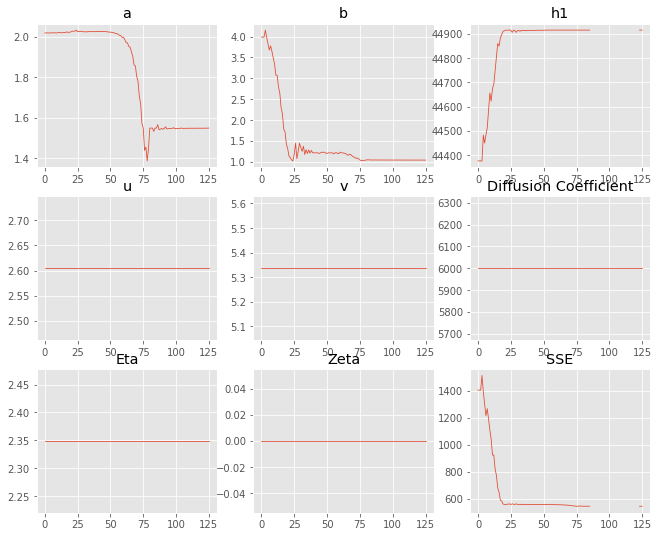

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,2.0177,1.54793
b,3.98995,1.03328
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"44,375.7","44,915"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 5 Time: 0.072 minutes


Estimated remaining run time: 0.818 minutes


Run 5===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.91e+03 	1.55e+03 	0.8088 		1.0000


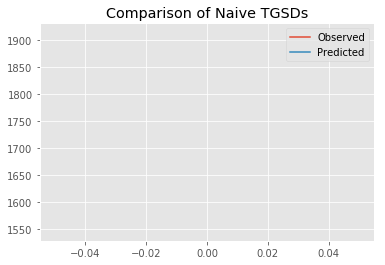

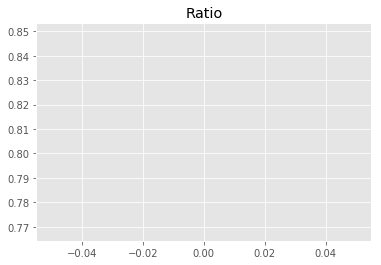

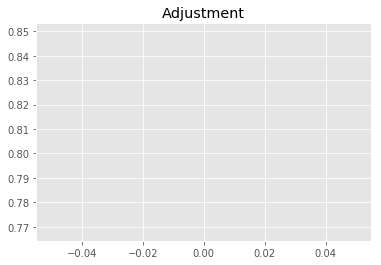

7537401937.837914
1


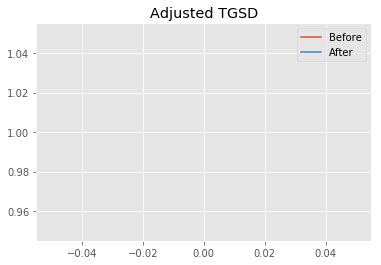

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|4.10643 	4.65723 	41740 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 9.31979e+09
After: 		|4.16987 	2.86917 	43802.4 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 835.757
New Misfit: 607.845
Convergence:
0.2727013284185441

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	2.01e+03 	1.55e+03 	0.7680 		1.0000


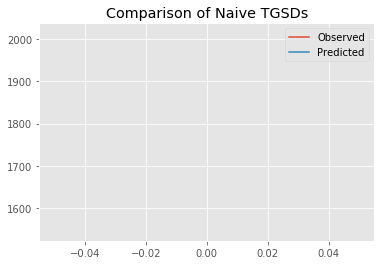

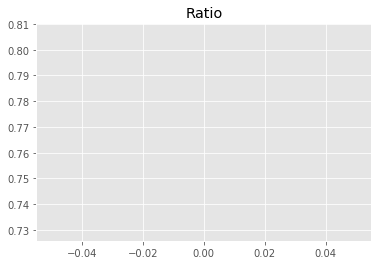

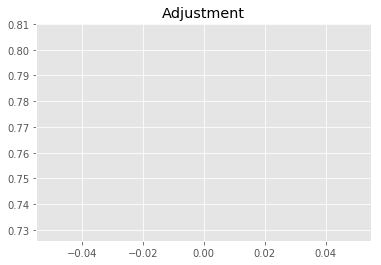

7157618611.986524
1


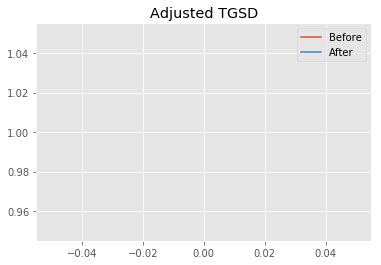

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|4.16987 	2.86917 	43802.4 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 9.31979e+09
After: 		|1.57398 	1.03743 	44915 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 607.845
New Misfit: 545.122
Convergence:
0.10318977677006516

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.92e+03 	1.55e+03 	0.8051 		1.0000


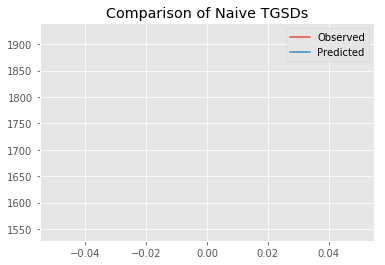

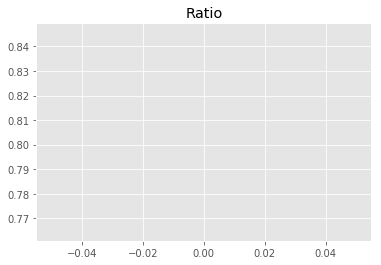

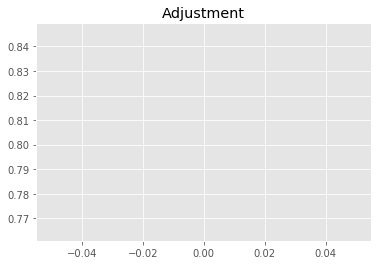

7503552091.407195
1


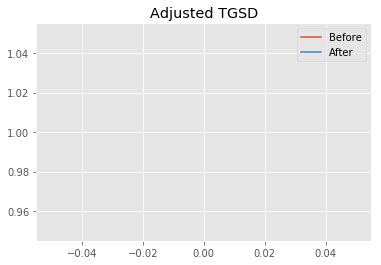

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.57398 	1.03743 	44915 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 9.31979e+09
After: 		|1.50491 	1.00095 	44912.5 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 545.122
New Misfit: 543.336
Convergence:
0.0032759941151148343

____________________
a = 1.50491	b = 1.00095	            h1 = 44912.53100	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 9319785815.10838
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 543.3356921177922
Prior Misfit: 835.757,	 Post Misfit: 543.336


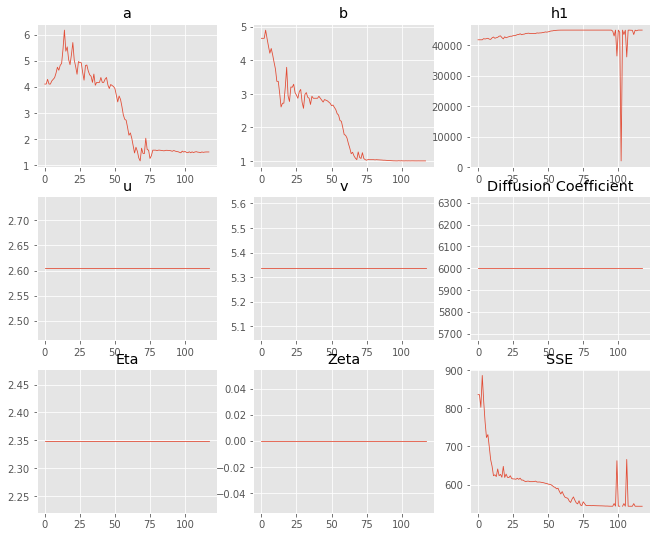

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,4.10643,1.50491
b,4.65723,1.00095
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"41,740","44,912.5"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 6 Time: 0.066 minutes


Estimated remaining run time: 0.775 minutes


Run 6===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	2.02e+03 	1.55e+03 	0.7642 		1.0000


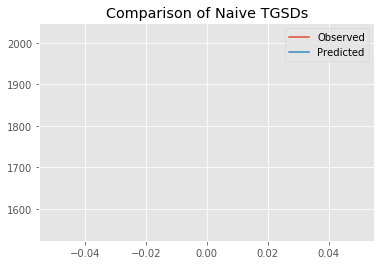

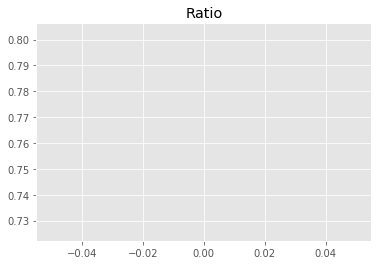

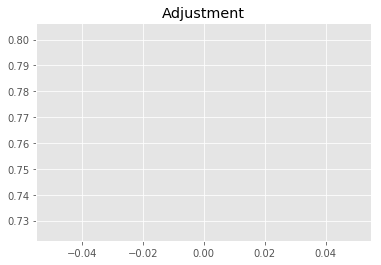

7122346663.10561
1


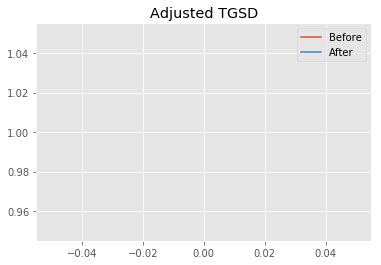

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.40727 	1.4462 	36798.8 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 9.31979e+09
After: 		|1.83568 	1.17394 	43173.9 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 615.037
New Misfit: 558.433
Convergence:
0.09203461636656596

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.94e+03 	1.55e+03 	0.7960 		1.0000


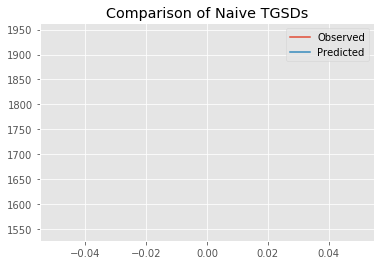

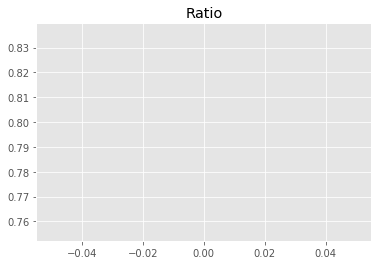

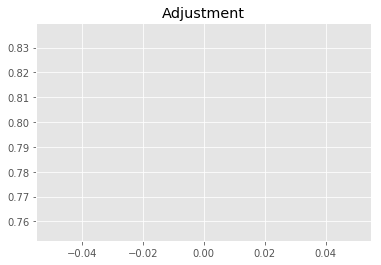

7418233313.758837
1


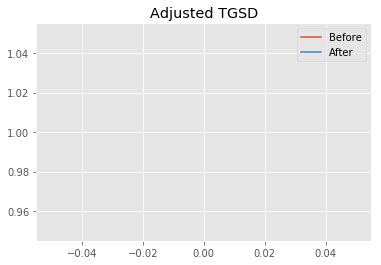

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.83568 	1.17394 	43173.9 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 9.31979e+09
After: 		|1.53519 	1.00002 	44912.9 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 558.433
New Misfit: 543.361
Convergence:
0.026989130364666207

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.92e+03 	1.55e+03 	0.8061 		1.0000


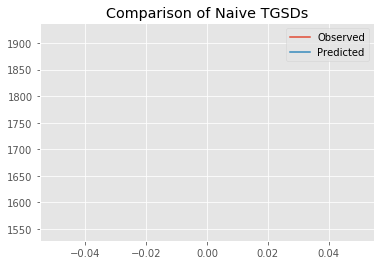

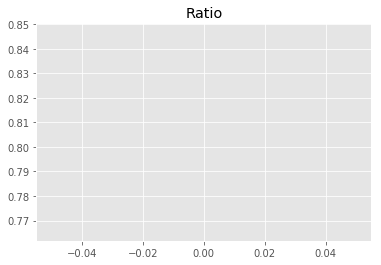

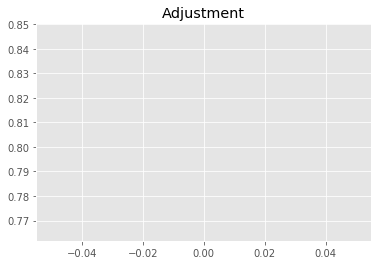

7512412937.807766
1


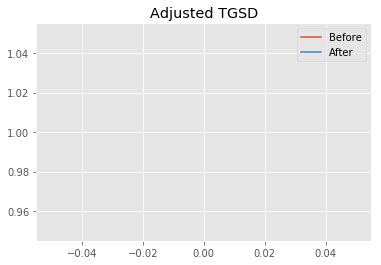

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.53519 	1.00002 	44912.9 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 9.31979e+09
After: 		|1.50953 	1 	44903.8 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 543.361
New Misfit: 543.287
Convergence:
0.0001366031974606354

____________________
a = 1.50953	b = 1.00000	            h1 = 44903.81520	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 9319785815.10838
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 543.2867845512999
Prior Misfit: 615.037,	 Post Misfit: 543.287


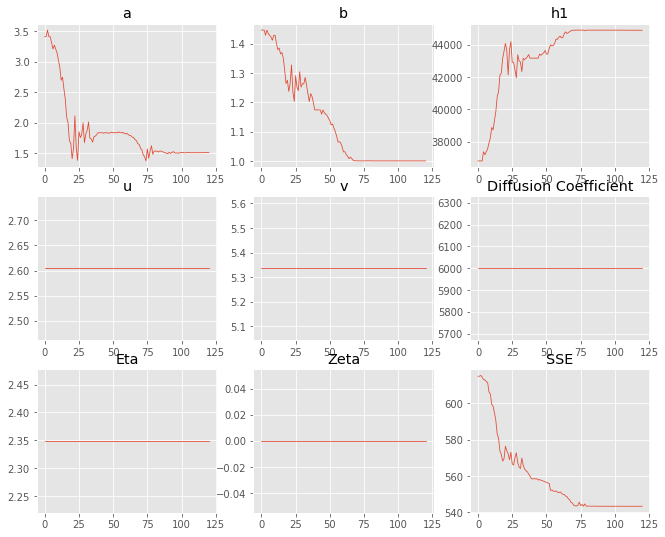

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,3.40727,1.50953
b,1.4462,1
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"36,798.8","44,903.8"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 7 Time: 0.068 minutes


Estimated remaining run time: 0.728 minutes


Run 7===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	2.02e+03 	1.55e+03 	0.7663 		1.0000


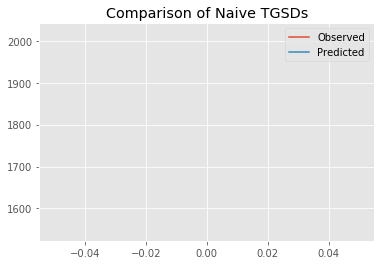

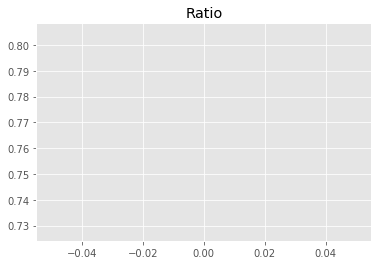

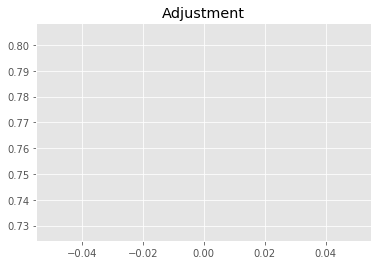

7141449894.352221
1


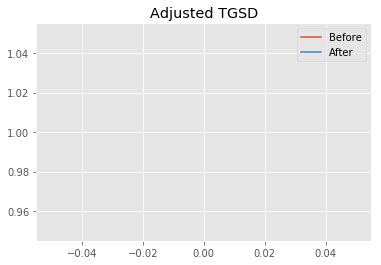

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|4.22338 	1.13596 	30074.7 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 9.31979e+09
After: 		|2.00008 	1.3398 	39714 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 702.433
New Misfit: 599.83
Convergence:
0.14606794664585016

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.94e+03 	1.55e+03 	0.7964 		1.0000


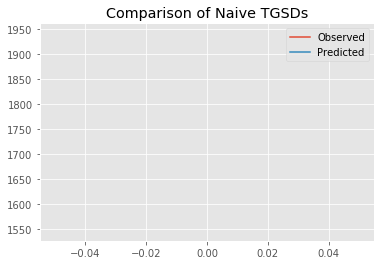

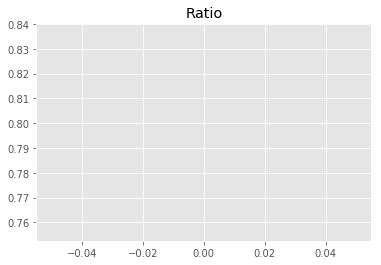

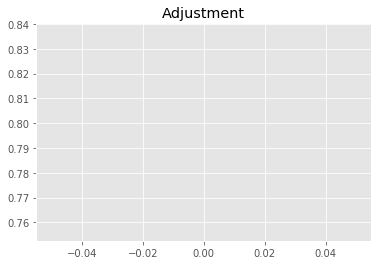

7422304583.454279
1


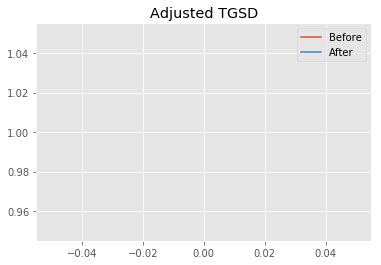

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.00008 	1.3398 	39714 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 9.31979e+09
After: 		|2.00005 	1.20035 	44839.2 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 599.83
New Misfit: 556.786
Convergence:
0.07176029731939619

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.96e+03 	1.55e+03 	0.7908 		1.0000


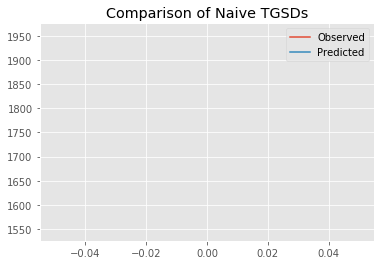

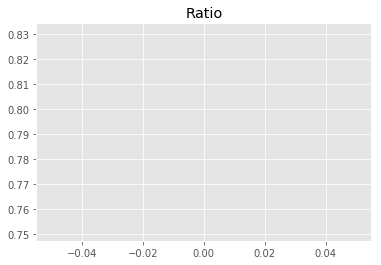

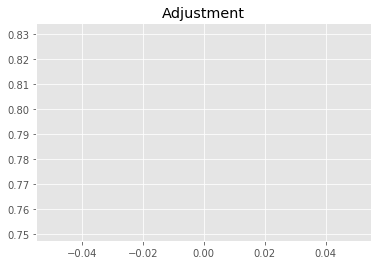

7370317556.5903
1


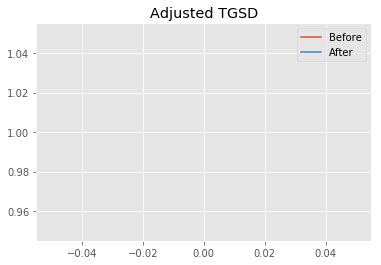

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.00005 	1.20035 	44839.2 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 9.31979e+09
After: 		|2.00003 	1.19867 	44915 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 556.786
New Misfit: 556.748
Convergence:
6.781568543001312e-05

____________________
a = 2.00003	b = 1.19867	            h1 = 44914.99950	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 9319785815.10838
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 556.7483558289523
Prior Misfit: 702.433,	 Post Misfit: 556.748


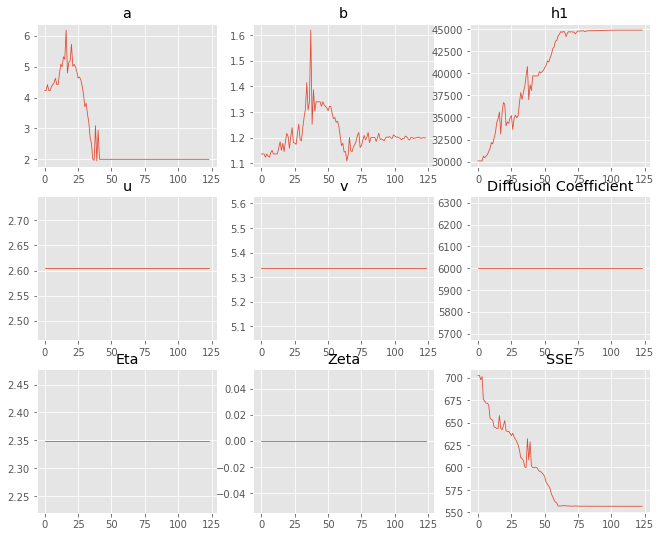

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,4.22338,2.00003
b,1.13596,1.19867
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"30,074.7","44,915"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 8 Time: 0.070 minutes


Estimated remaining run time: 0.678 minutes


Run 8===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	2.04e+03 	1.55e+03 	0.7564 		1.0000


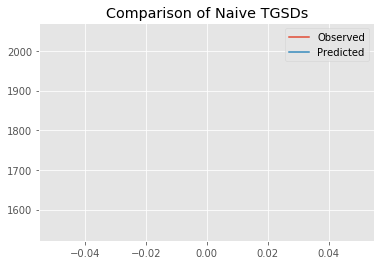

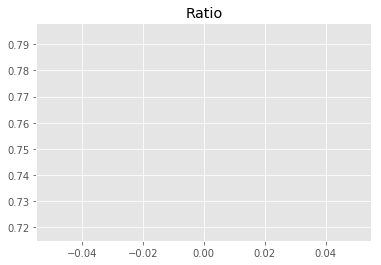

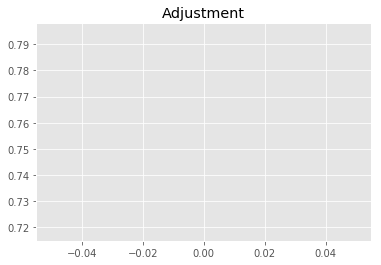

7049537679.340826
1


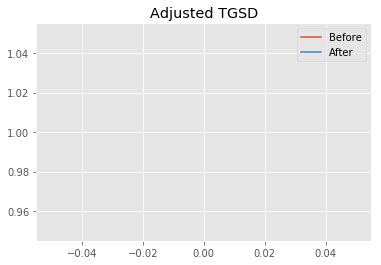

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|4.23348 	1.59532 	39859.7 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 9.31979e+09
After: 		|2.27684 	1.5531 	43101.3 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 621.364
New Misfit: 576.256
Convergence:
0.07259603839043752

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.96e+03 	1.55e+03 	0.7888 		1.0000


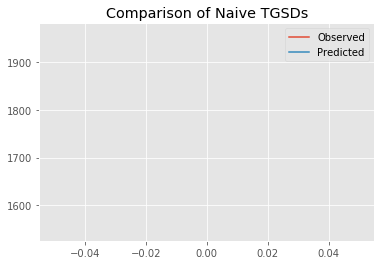

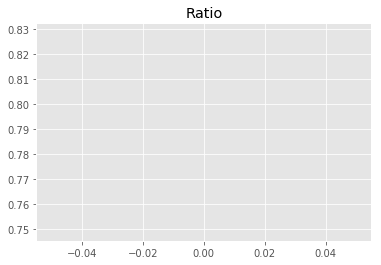

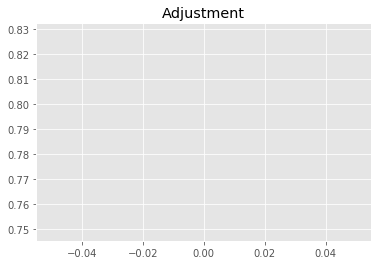

7351329194.616002
1


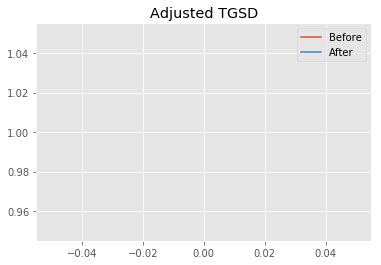

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.27684 	1.5531 	43101.3 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 9.31979e+09
After: 		|1.53586 	1.01583 	44915 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 576.256
New Misfit: 544.057
Convergence:
0.05587653143407999

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.92e+03 	1.55e+03 	0.8065 		1.0000


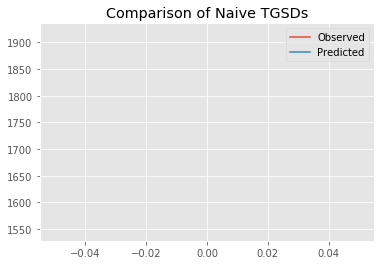

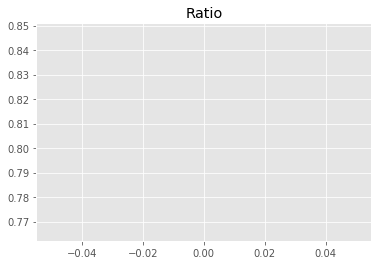

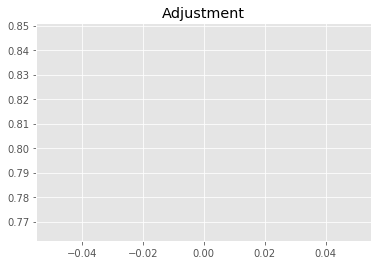

7516809745.126576
1


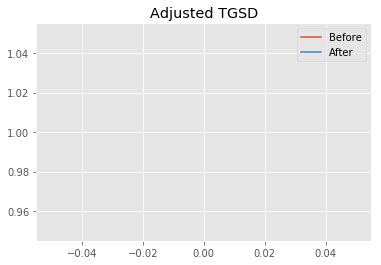

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.53586 	1.01583 	44915 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 9.31979e+09
After: 		|1.50559 	1.00004 	44914.9 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 544.057
New Misfit: 543.29
Convergence:
0.001409661575692245

____________________
a = 1.50559	b = 1.00004	            h1 = 44914.94633	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 9319785815.10838
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 543.2896215509469
Prior Misfit: 621.364,	 Post Misfit: 543.29


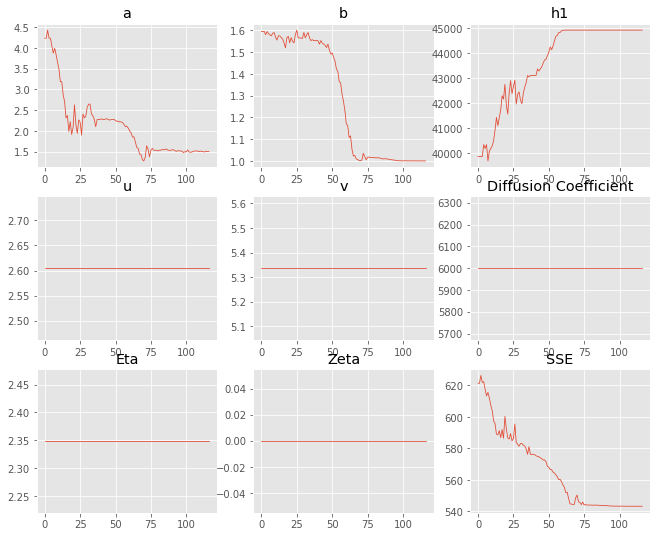

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,4.23348,1.50559
b,1.59532,1.00004
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"39,859.7","44,914.9"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 9 Time: 0.066 minutes


Estimated remaining run time: 0.620 minutes


Run 9===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.65e+03 	1.55e+03 	0.9374 		1.0000


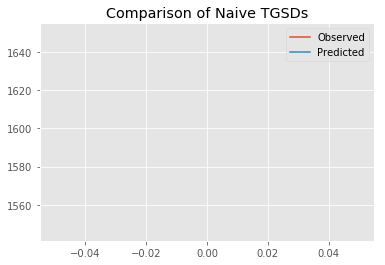

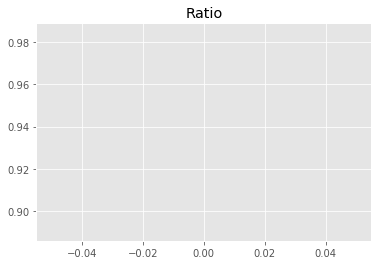

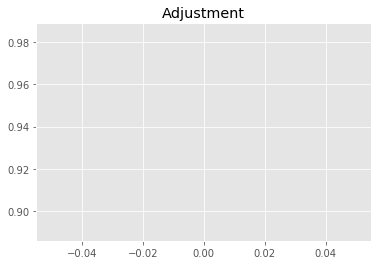

8736262066.634773
1


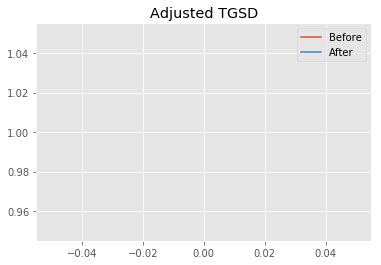

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.03611 	1.71437 	37099.7 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 9.31979e+09
After: 		|2.26875 	1.59529 	43997.6 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 1356.44
New Misfit: 572.436
Convergence:
0.577985889380337

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.96e+03 	1.55e+03 	0.7899 		1.0000


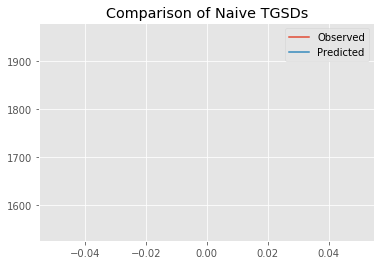

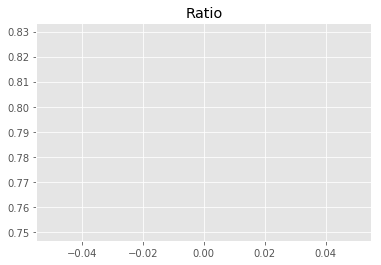

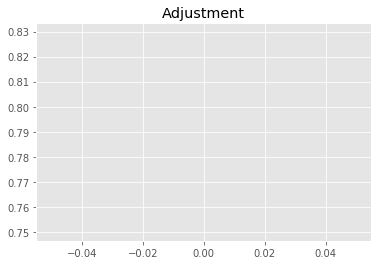

7361241990.79563
1


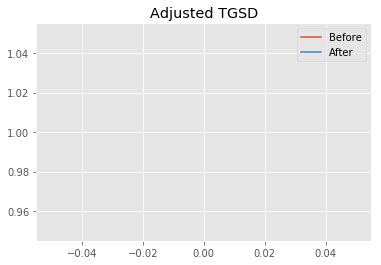

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.26875 	1.59529 	43997.6 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 9.31979e+09
After: 		|1.46712 	1.00922 	44915 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 572.436
New Misfit: 544.05
Convergence:
0.04958780539416871

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.91e+03 	1.55e+03 	0.8104 		1.0000


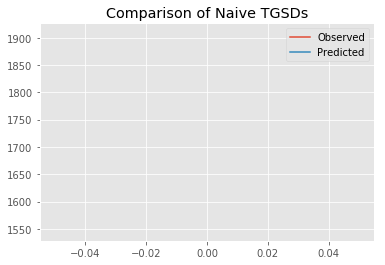

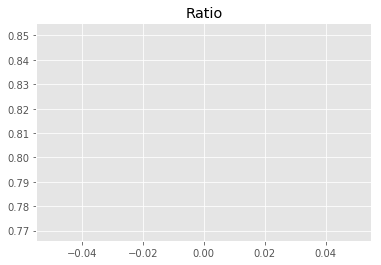

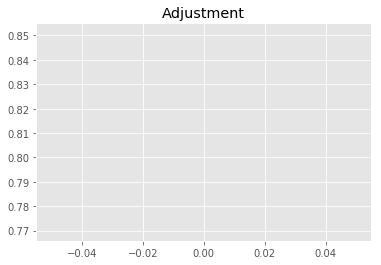

7552794075.645753
1


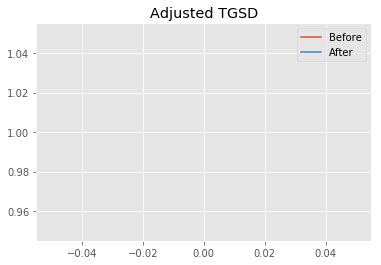

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.46712 	1.00922 	44915 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 9.31979e+09
After: 		|1.51267 	1.00008 	44914.1 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 544.05
New Misfit: 543.292
Convergence:
0.0013935982820972186

____________________
a = 1.51267	b = 1.00008	            h1 = 44914.14025	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 9319785815.10838
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 543.2919668355521
Prior Misfit: 1356.44,	 Post Misfit: 543.292


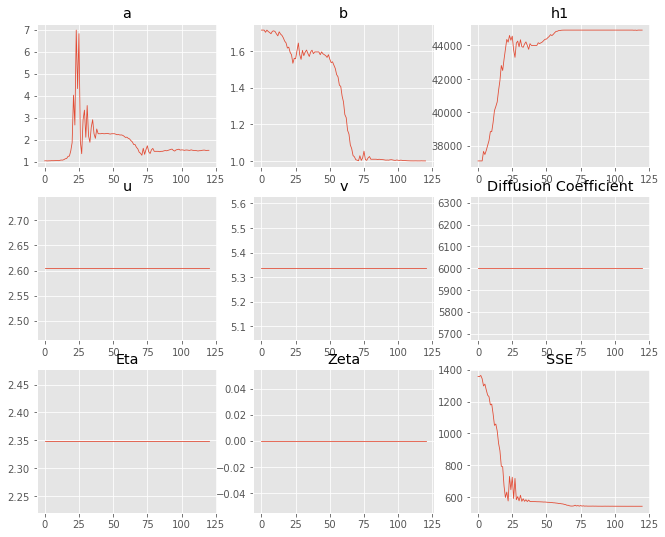

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,1.03611,1.51267
b,1.71437,1.00008
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"37,099.7","44,914.1"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 10 Time: 0.066 minutes


Estimated remaining run time: 0.562 minutes


Run 10===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.78e+03 	1.55e+03 	0.8688 		1.0000


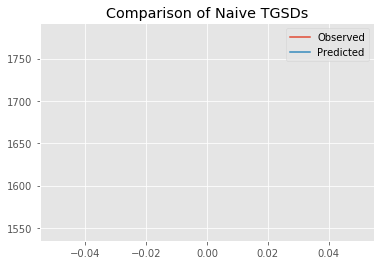

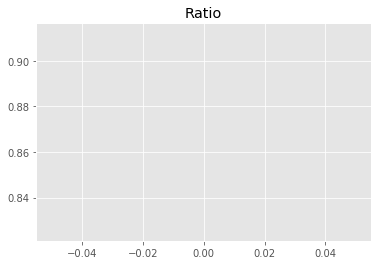

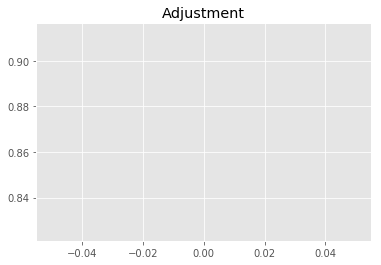

8096627714.16397
1


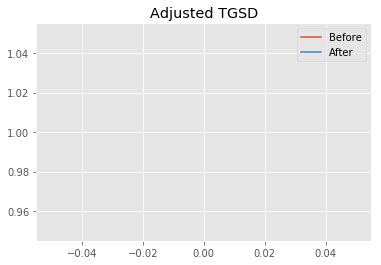

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.38235 	3.74231 	41395.3 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 9.31979e+09
After: 		|2.40491 	1.53873 	44760.8 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 1222.28
New Misfit: 569.105
Convergence:
0.5343922763400109

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.97e+03 	1.55e+03 	0.7844 		1.0000


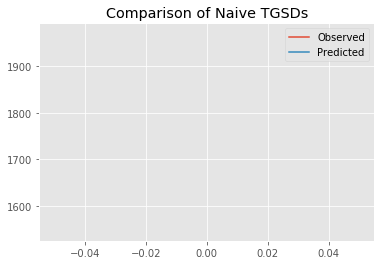

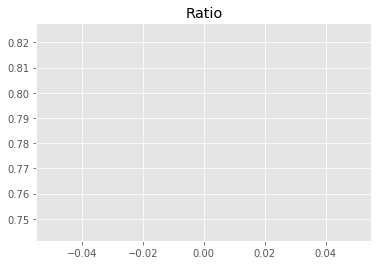

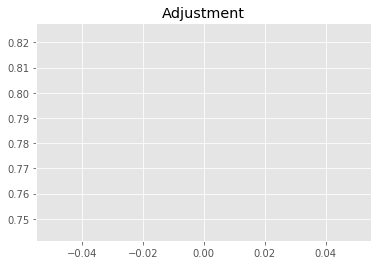

7310715566.107908
1


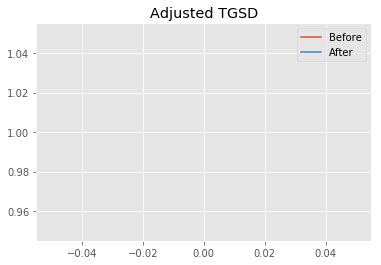

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.40491 	1.53873 	44760.8 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 9.31979e+09
After: 		|1.54366 	1.11243 	44108.1 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 569.105
New Misfit: 550.962
Convergence:
0.03188003305020589

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.91e+03 	1.55e+03 	0.8095 		1.0000


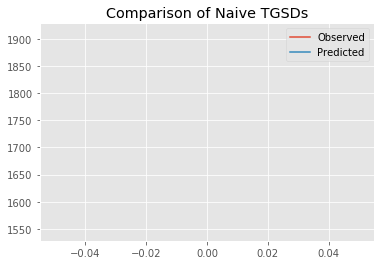

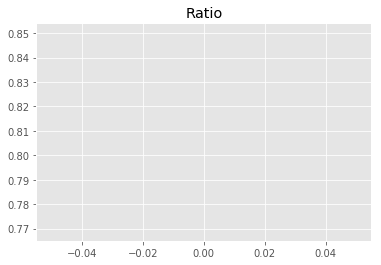

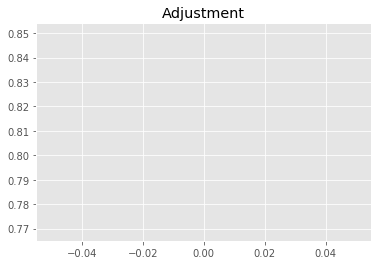

7544543941.374504
1


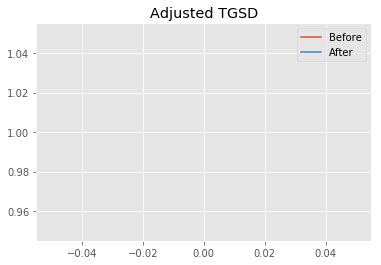

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.54366 	1.11243 	44108.1 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 9.31979e+09
After: 		|1.47539 	1.00991 	44211.9 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 550.962
New Misfit: 544.079
Convergence:
0.012492825283632896

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.91e+03 	1.55e+03 	0.8099 		1.0000


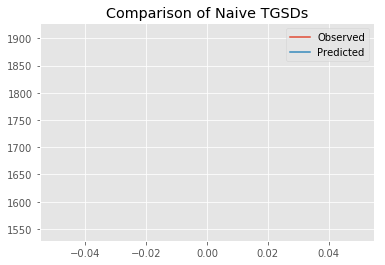

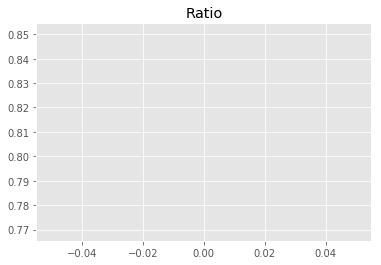

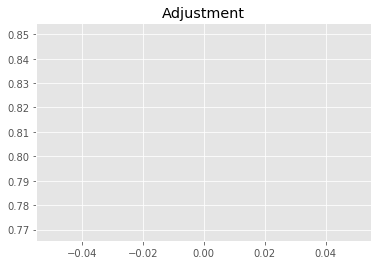

7548348612.240276
1


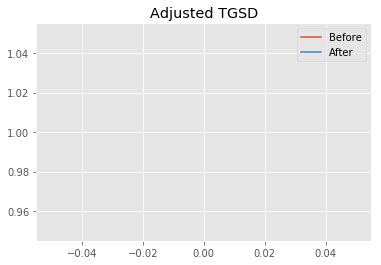

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.47539 	1.00991 	44211.9 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 9.31979e+09
After: 		|1.514 	1.00004 	44675.3 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 544.079
New Misfit: 543.291
Convergence:
0.0014470951978575234

____________________
a = 1.51400	b = 1.00004	            h1 = 44675.29719	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 9319785815.10838
Success: True
Status: Successful convergence.
Iterations: 4
Misfit: 543.2912742038097
Prior Misfit: 1222.28,	 Post Misfit: 543.291


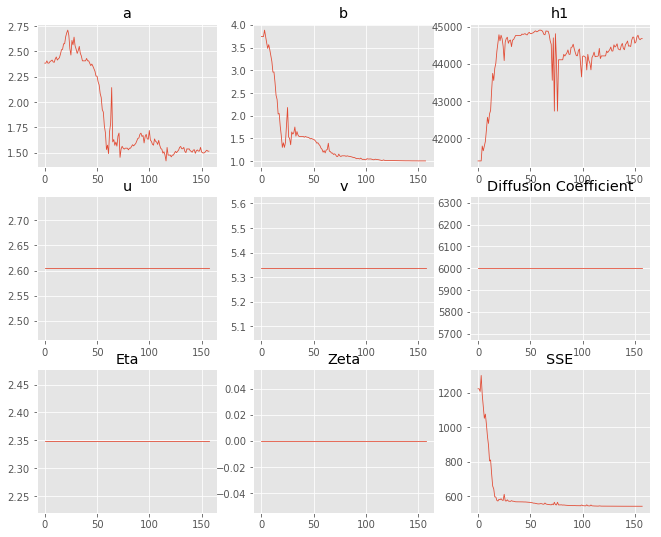

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,2.38235,1.514
b,3.74231,1.00004
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"41,395.3","44,675.3"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 11 Time: 0.090 minutes


Estimated remaining run time: 0.518 minutes


Run 11===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	2.01e+03 	1.55e+03 	0.7684 		1.0000


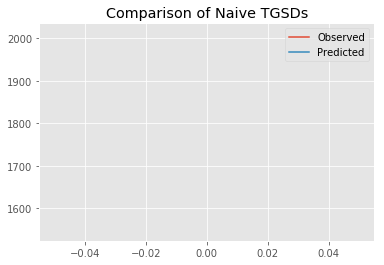

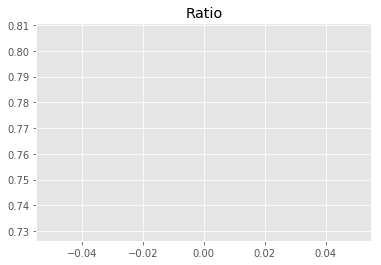

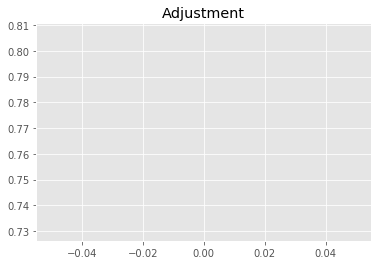

7161718972.140763
1


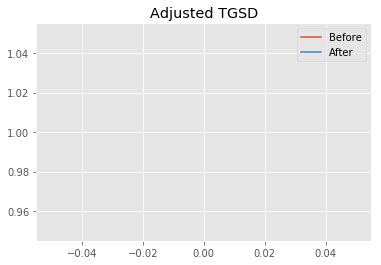

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|4.65791 	3.61144 	44713.2 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 9.31979e+09
After: 		|1.46006 	1.23624 	44914.6 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 617.478
New Misfit: 567.398
Convergence:
0.0811040105748692

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.89e+03 	1.55e+03 	0.8199 		1.0000


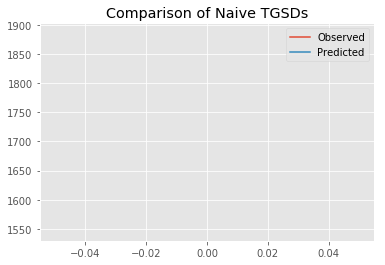

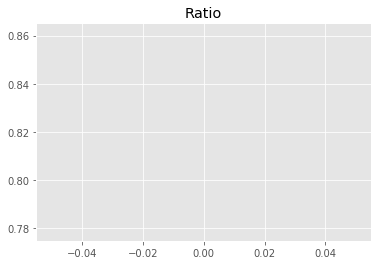

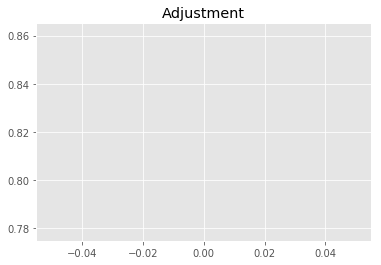

7641680913.978682
1


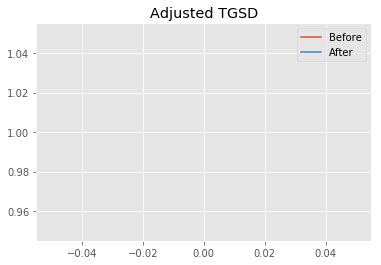

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.46006 	1.23624 	44914.6 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 9.31979e+09
After: 		|1.67041 	1.10976 	44914.7 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 567.398
New Misfit: 548.545
Convergence:
0.0332278433910242

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.93e+03 	1.55e+03 	0.8023 		1.0000


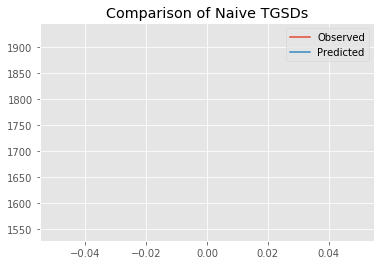

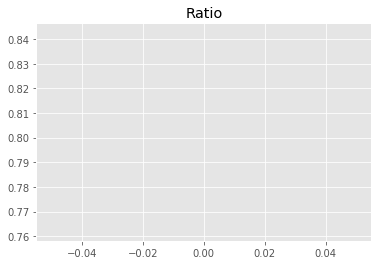

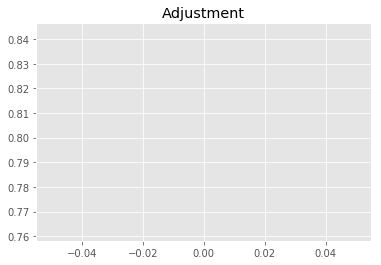

7476932914.825801
1


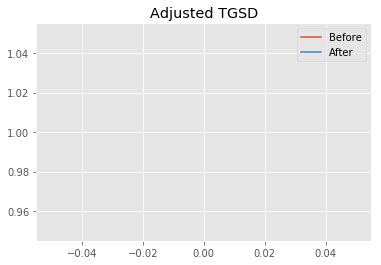

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.67041 	1.10976 	44914.7 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 9.31979e+09
After: 		|1.5829 	1.00859 	44604.4 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 548.545
New Misfit: 544.128
Convergence:
0.008052281550557885

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.92e+03 	1.55e+03 	0.8038 		1.0000


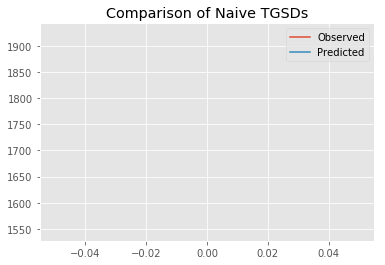

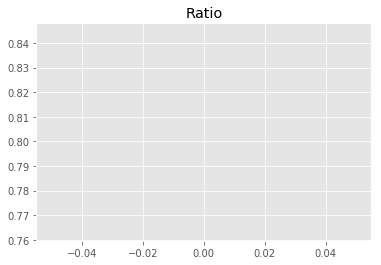

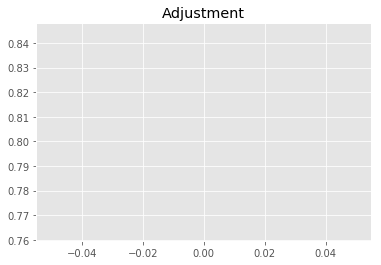

7490955687.055005
1


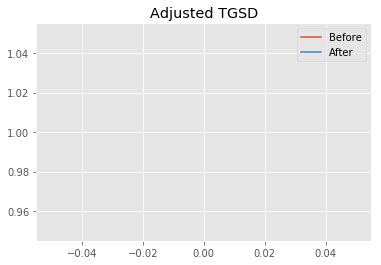

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.5829 	1.00859 	44604.4 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 9.31979e+09
After: 		|1.50585 	1.0001 	44438.3 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 544.128
New Misfit: 543.293
Convergence:
0.001534124540627439

____________________
a = 1.50585	b = 1.00010	            h1 = 44438.29172	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 9319785815.10838
Success: True
Status: Successful convergence.
Iterations: 4
Misfit: 543.2931097823846
Prior Misfit: 617.478,	 Post Misfit: 543.293


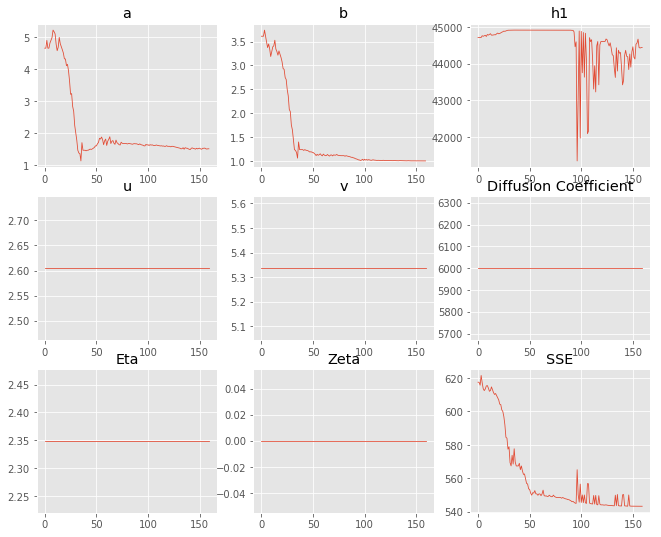

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,4.65791,1.50585
b,3.61144,1.0001
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"44,713.2","44,438.3"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 12 Time: 0.089 minutes


Estimated remaining run time: 0.466 minutes


Run 12===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	2.03e+03 	1.55e+03 	0.7609 		1.0000


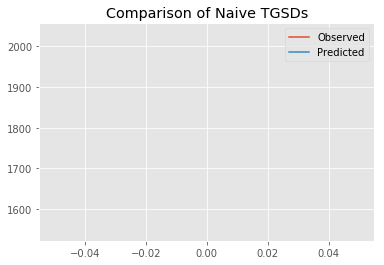

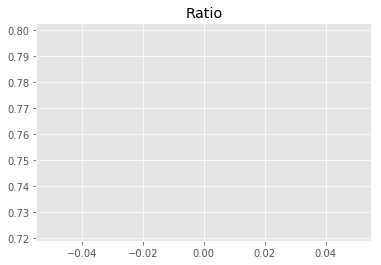

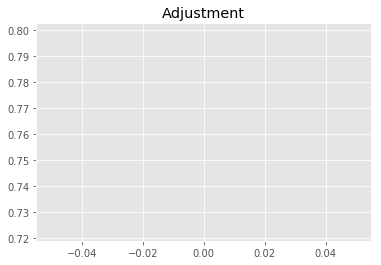

7091369838.449866
1


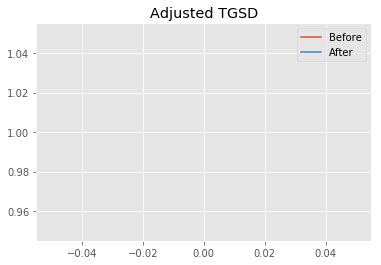

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|4.91269 	1.59168 	31986.7 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 9.31979e+09
After: 		|2.58108 	1.78202 	43141.8 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 671.939
New Misfit: 584.641
Convergence:
0.12991877097158885

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.97e+03 	1.55e+03 	0.7842 		1.0000


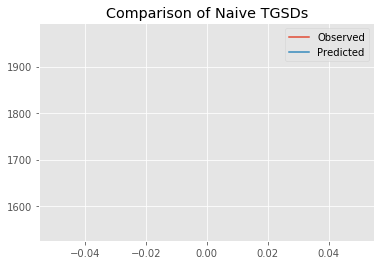

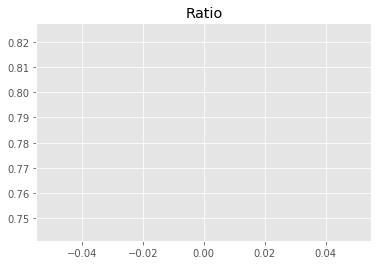

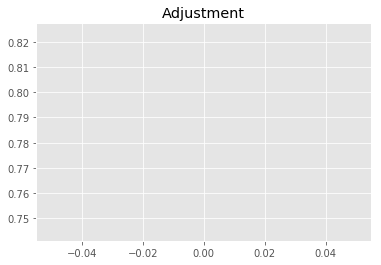

7308712259.31572
1


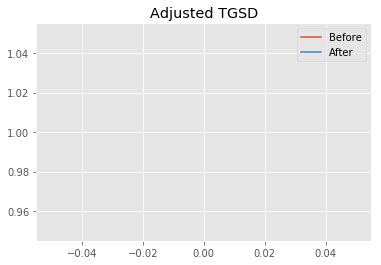

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.58108 	1.78202 	43141.8 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 9.31979e+09
After: 		|1.53036 	1.1837 	44915 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 584.641
New Misfit: 556.428
Convergence:
0.04825691076196341

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.90e+03 	1.55e+03 	0.8128 		1.0000


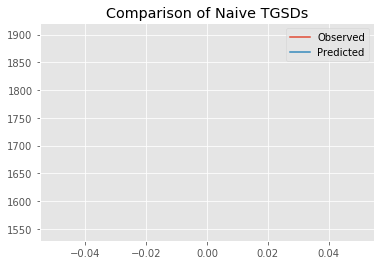

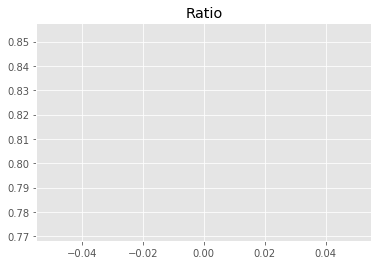

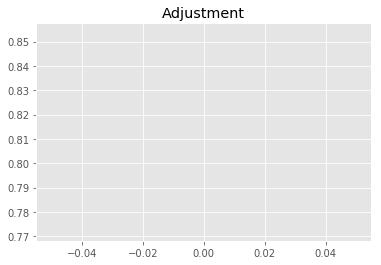

7575272706.655617
1


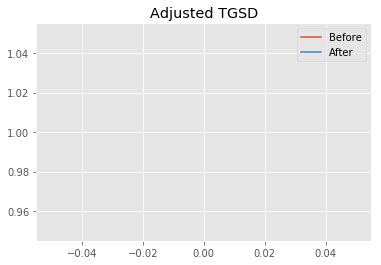

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.53036 	1.1837 	44915 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 9.31979e+09
After: 		|1.60904 	1.04098 	44698.5 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 556.428
New Misfit: 545.555
Convergence:
0.019540776016368576

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.92e+03 	1.55e+03 	0.8034 		1.0000


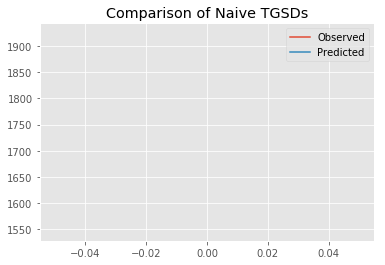

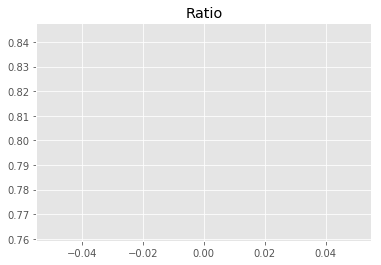

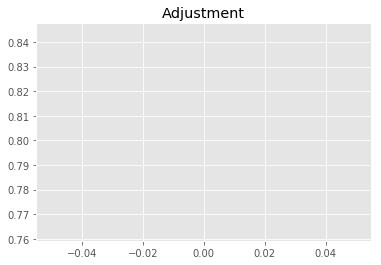

7487360017.054061
1


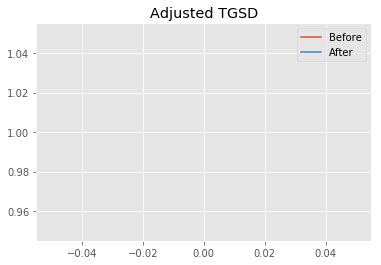

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.60904 	1.04098 	44698.5 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 9.31979e+09
After: 		|1.51615 	1.00006 	44051.4 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 545.555
New Misfit: 543.296
Convergence:
0.004141727620868256

____________________
a = 1.51615	b = 1.00006	            h1 = 44051.39562	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 9319785815.10838
Success: True
Status: Successful convergence.
Iterations: 4
Misfit: 543.2956189704652
Prior Misfit: 671.939,	 Post Misfit: 543.296


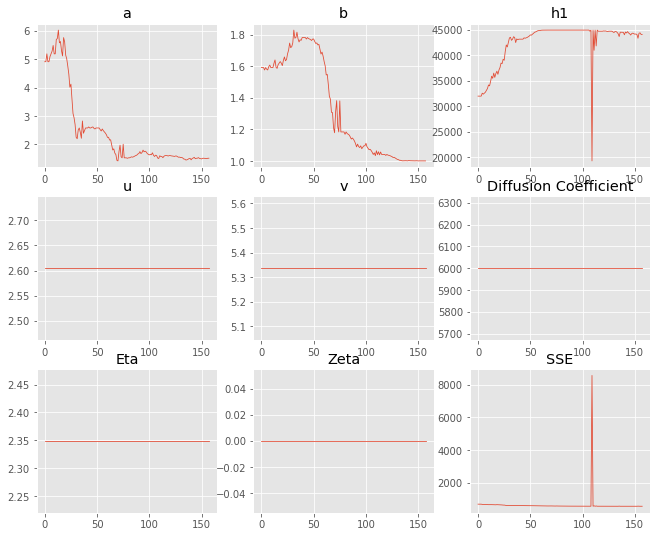

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,4.91269,1.51615
b,1.59168,1.00006
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"31,986.7","44,051.4"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 13 Time: 0.084 minutes


Estimated remaining run time: 0.407 minutes


Run 13===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.91e+03 	1.55e+03 	0.8091 		1.0000


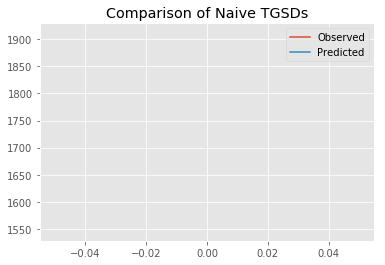

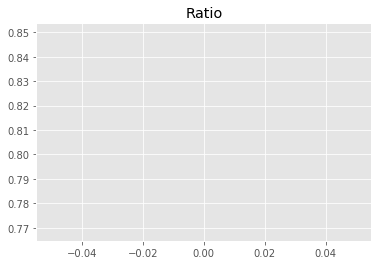

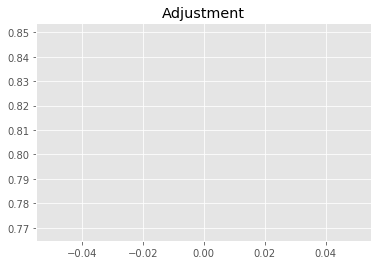

7540950975.05851
1


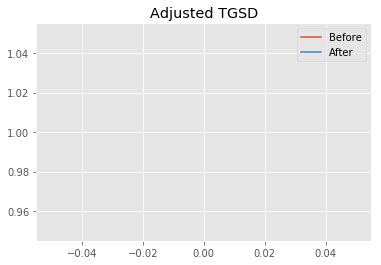

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.93632 	1.71973 	43480.6 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 9.31979e+09
After: 		|2.11409 	1.35116 	44911.4 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 608.575
New Misfit: 560.806
Convergence:
0.0784938733573921

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.96e+03 	1.55e+03 	0.7899 		1.0000


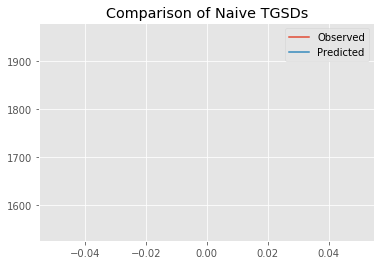

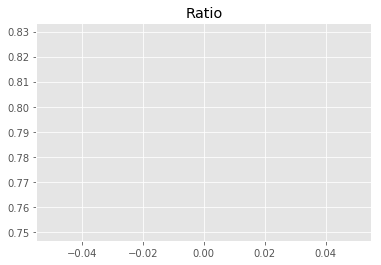

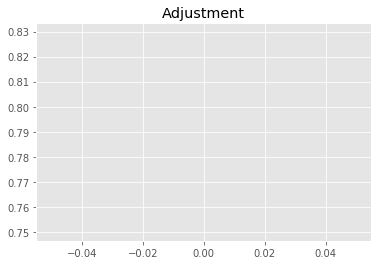

7361249831.547319
1


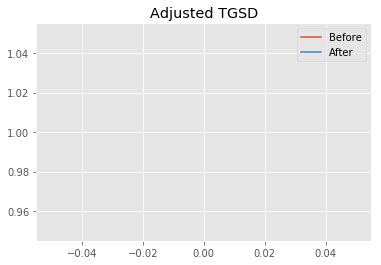

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.11409 	1.35116 	44911.4 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 9.31979e+09
After: 		|1.51294 	1.00503 	44915 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 560.806
New Misfit: 543.53
Convergence:
0.03080415058014891

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.91e+03 	1.55e+03 	0.8075 		1.0000


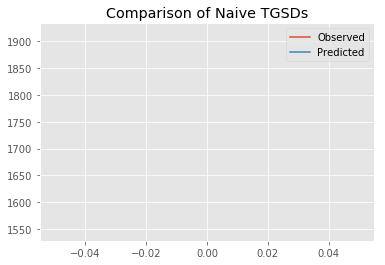

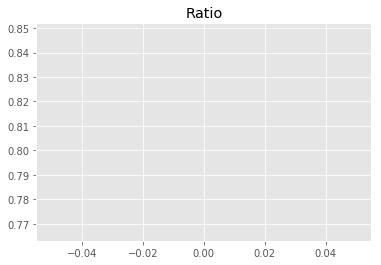

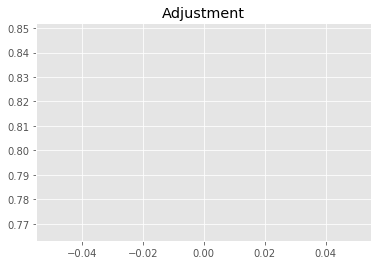

7525719751.079409
1


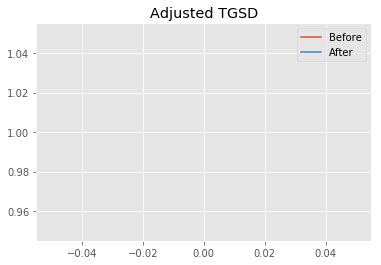

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.51294 	1.00503 	44915 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 9.31979e+09
After: 		|1.50897 	1.00002 	44914.7 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 543.53
New Misfit: 543.287
Convergence:
0.00044697640760054676

____________________
a = 1.50897	b = 1.00002	            h1 = 44914.65512	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 9319785815.10838
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 543.2874321079214
Prior Misfit: 608.575,	 Post Misfit: 543.287


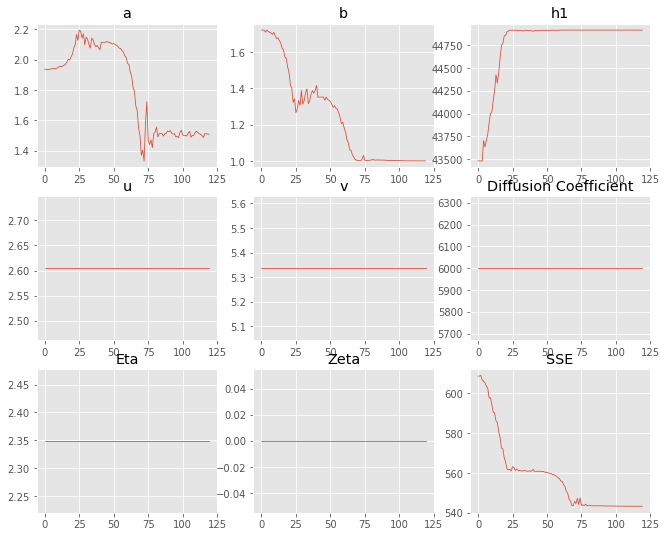

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,1.93632,1.50897
b,1.71973,1.00002
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"43,480.6","44,914.7"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 14 Time: 0.067 minutes


Estimated remaining run time: 0.339 minutes


Run 14===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	2.01e+03 	1.55e+03 	0.7699 		1.0000


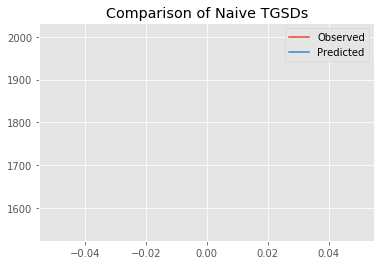

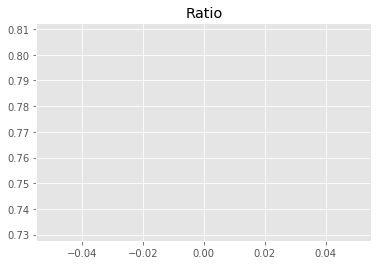

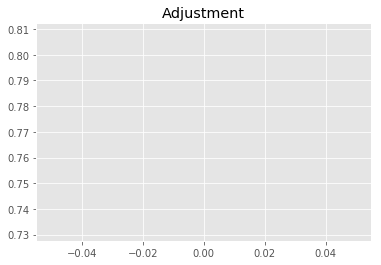

7175346216.8962965
1


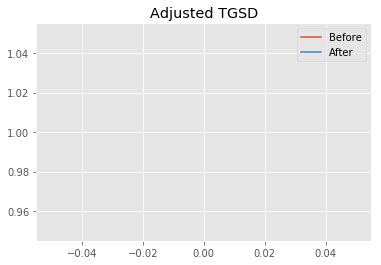

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.06203 	1.14983 	43173.9 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 9.31979e+09
After: 		|1.56809 	1.06452 	44659.9 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 612.219
New Misfit: 546.563
Convergence:
0.10724288658984465

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.92e+03 	1.55e+03 	0.8063 		1.0000


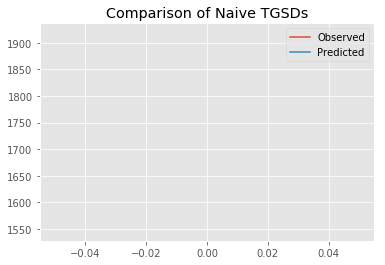

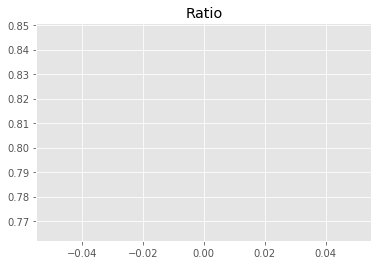

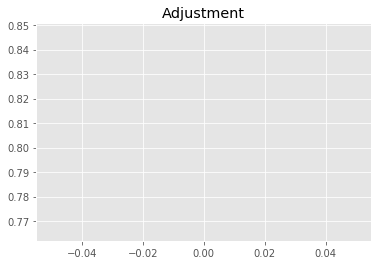

7514848011.305437
1


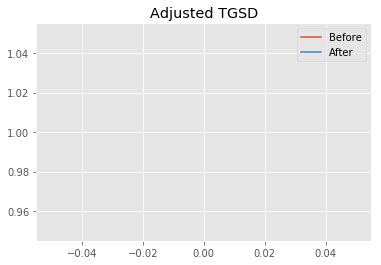

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.56809 	1.06452 	44659.9 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 9.31979e+09
After: 		|1.51674 	1.00034 	44774.7 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 546.563
New Misfit: 543.31
Convergence:
0.005952029515730201

____________________
a = 1.51674	b = 1.00034	            h1 = 44774.70644	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 9319785815.10838
Success: True
Status: Successful convergence.
Iterations: 2
Misfit: 543.3095335068018
Prior Misfit: 612.219,	 Post Misfit: 543.31


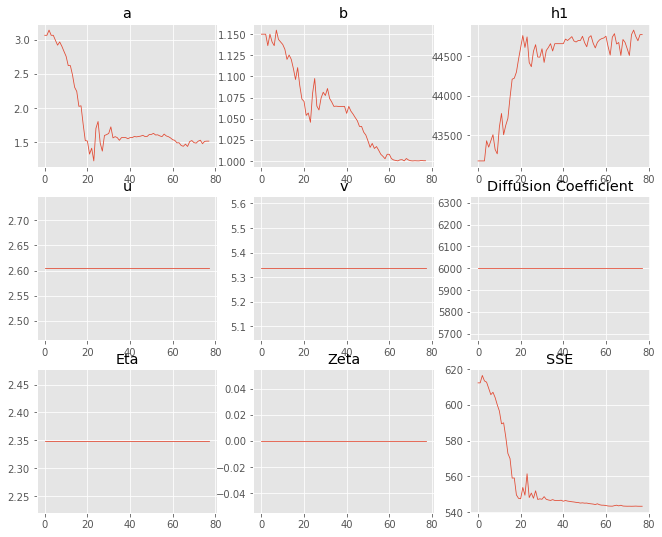

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,3.06203,1.51674
b,1.14983,1.00034
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"43,173.9","44,774.7"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 15 Time: 0.047 minutes


Estimated remaining run time: 0.266 minutes


Run 15===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.77e+03 	1.55e+03 	0.8726 		1.0000


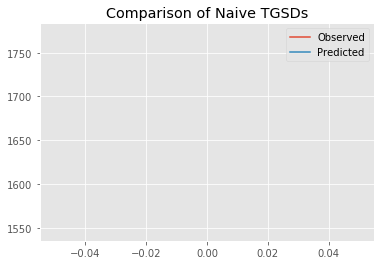

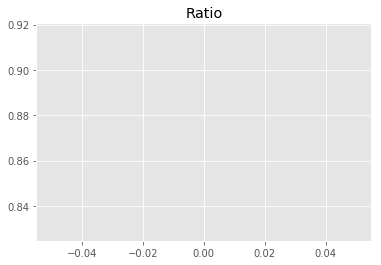

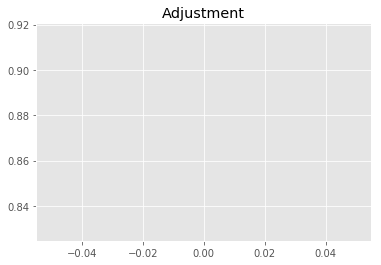

8132011599.547397
1


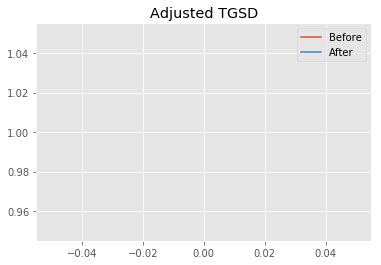

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.13482 	3.72532 	44567.9 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 9.31979e+09
After: 		|2.16677 	1.39154 	44914.6 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 1142.05
New Misfit: 562.409
Convergence:
0.5075451321938734

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.96e+03 	1.55e+03 	0.7889 		1.0000


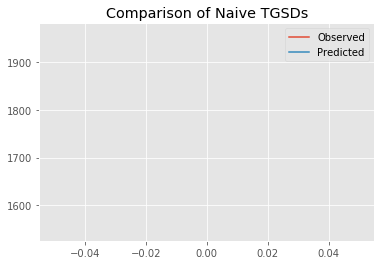

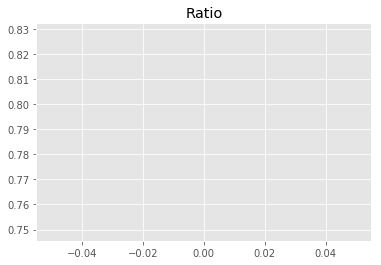

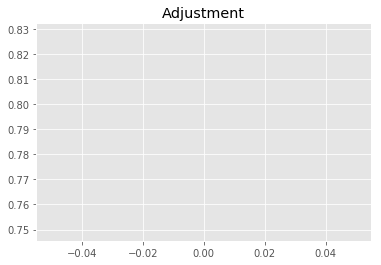

7352321783.448169
1


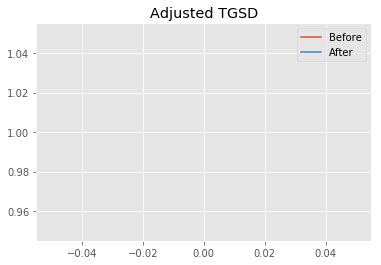

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.16677 	1.39154 	44914.6 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 9.31979e+09
After: 		|1.51374 	1.02371 	44915 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 562.409
New Misfit: 544.496
Convergence:
0.03185084396571462

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.91e+03 	1.55e+03 	0.8081 		1.0000


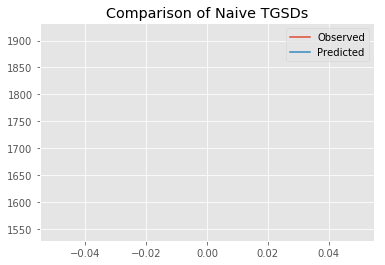

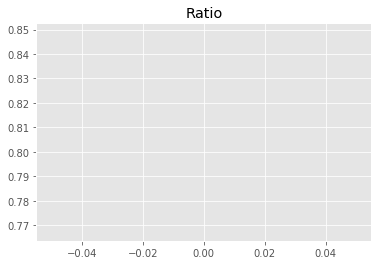

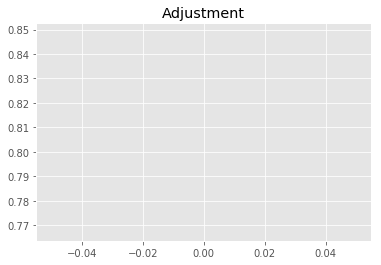

7531147388.430568
1


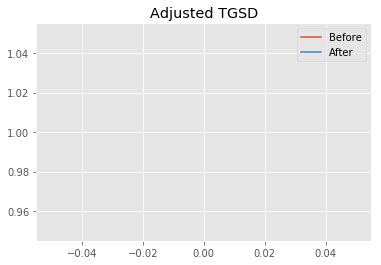

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.51374 	1.02371 	44915 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 9.31979e+09
After: 		|1.51201 	1.00001 	44915 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 544.496
New Misfit: 543.288
Convergence:
0.002218205140602408

____________________
a = 1.51201	b = 1.00001	            h1 = 44914.99999	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 9319785815.10838
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 543.2879644118646
Prior Misfit: 1142.05,	 Post Misfit: 543.288


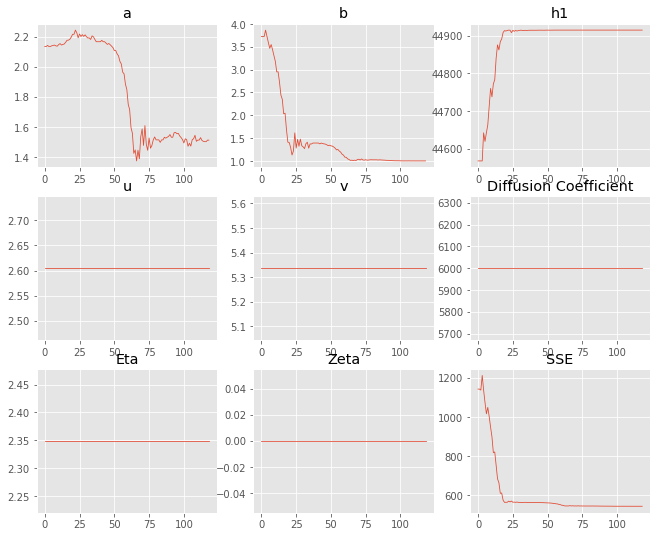

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,2.13482,1.51201
b,3.72532,1.00001
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"44,567.9","44,915"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 16 Time: 0.066 minutes


Estimated remaining run time: 0.199 minutes


Run 16===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	2.02e+03 	1.55e+03 	0.7647 		1.0000


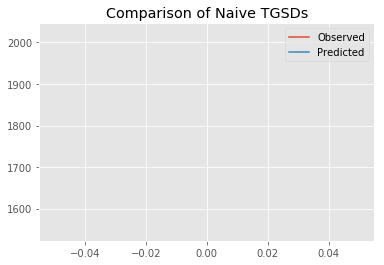

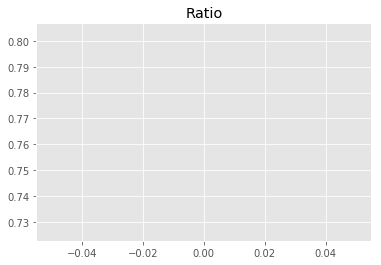

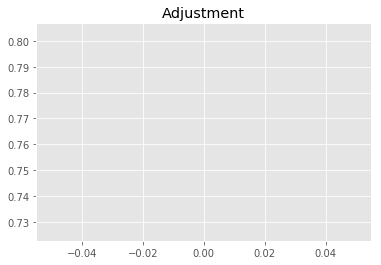

7126832095.111736
1


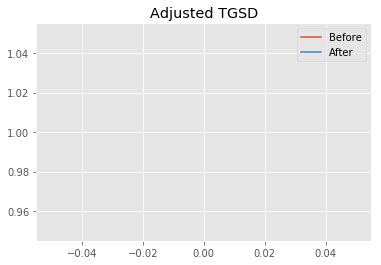

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|4.1438 	1.91025 	36071.7 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 9.31979e+09
After: 		|2.83033 	1.96932 	44624.9 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 637.364
New Misfit: 582.325
Convergence:
0.08635460027849416

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.98e+03 	1.55e+03 	0.7804 		1.0000


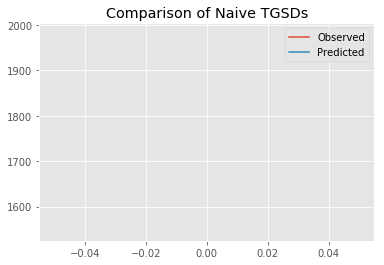

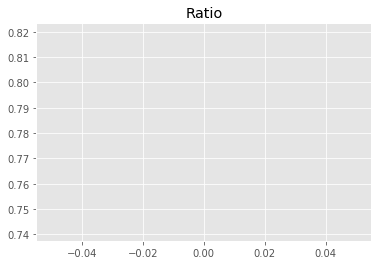

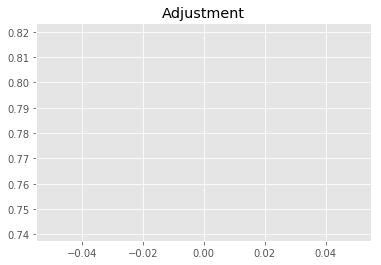

7272983146.887662
1


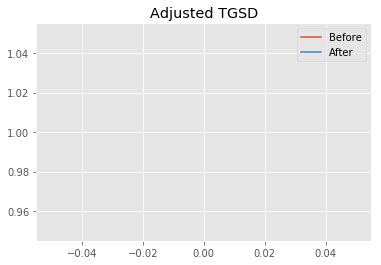

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.83033 	1.96932 	44624.9 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 9.31979e+09
After: 		|2.67912 	1.94164 	44914.9 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 582.325
New Misfit: 580.295
Convergence:
0.0034858282343463768

____________________
a = 2.67912	b = 1.94164	            h1 = 44914.88988	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 9319785815.10838
Success: True
Status: Successful convergence.
Iterations: 2
Misfit: 580.2951391383239
Prior Misfit: 637.364,	 Post Misfit: 580.295


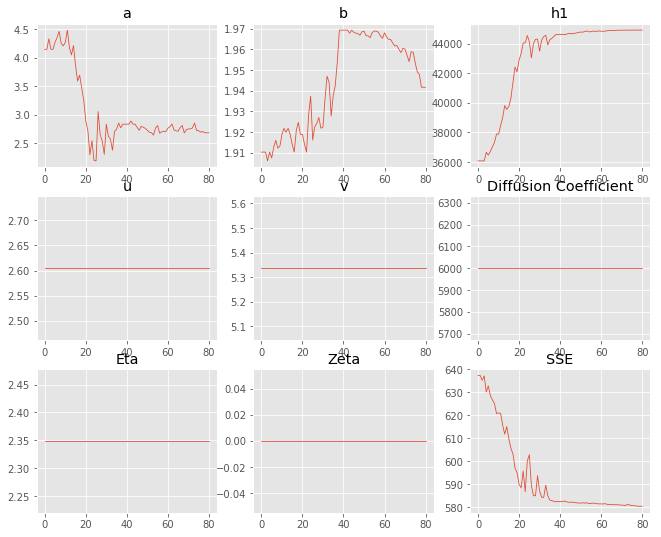

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,4.1438,2.67912
b,1.91025,1.94164
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"36,071.7","44,914.9"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 17 Time: 0.048 minutes


Estimated remaining run time: 0.131 minutes


Run 17===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	2.02e+03 	1.55e+03 	0.7642 		1.0000


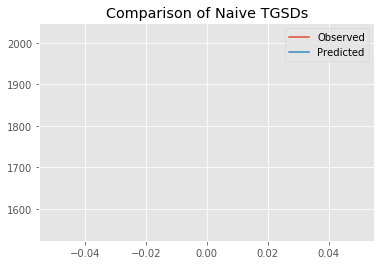

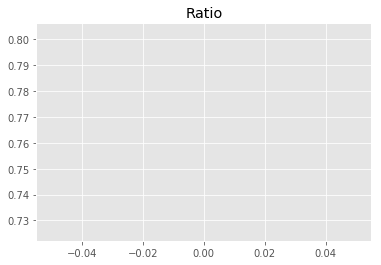

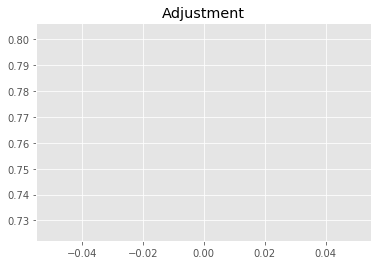

7121837308.64042
1


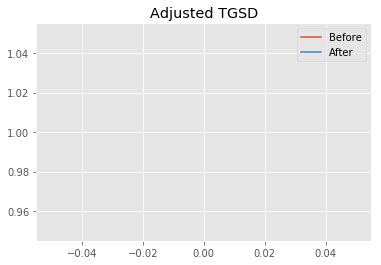

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|4.79313 	1.74641 	44893.4 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 9.31979e+09
After: 		|2.46166 	1.69008 	44910.5 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 655.785
New Misfit: 572.27
Convergence:
0.127351514553846

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.97e+03 	1.55e+03 	0.7853 		1.0000


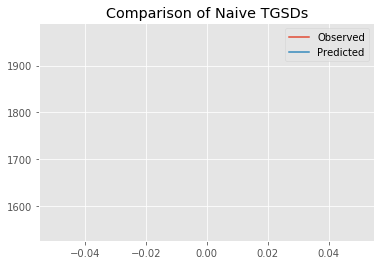

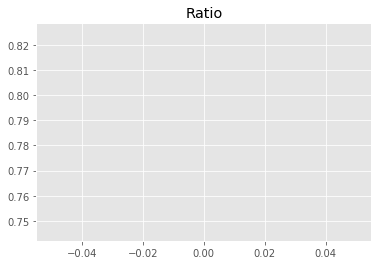

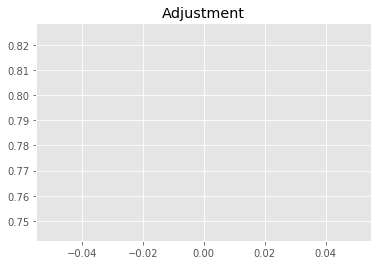

7319065289.03889
1


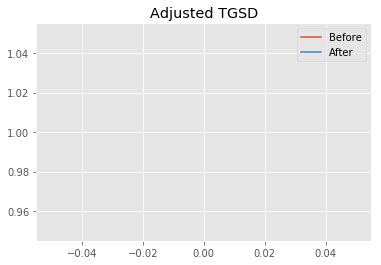

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.46166 	1.69008 	44910.5 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 9.31979e+09
After: 		|1.41477 	1.08143 	44915 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 572.27
New Misfit: 551.637
Convergence:
0.03605411314100623

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.89e+03 	1.55e+03 	0.8167 		1.0000


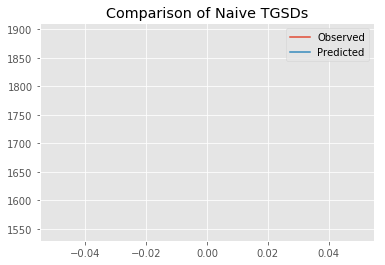

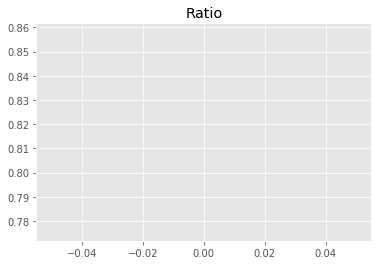

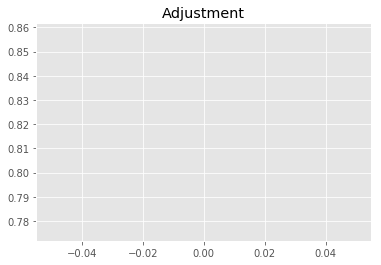

7611727720.021966
1


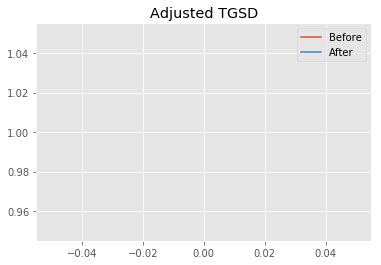

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.41477 	1.08143 	44915 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 9.31979e+09
After: 		|1.55987 	1.02305 	44915 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 551.637
New Misfit: 544.449
Convergence:
0.013029473646507278

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.92e+03 	1.55e+03 	0.8054 		1.0000


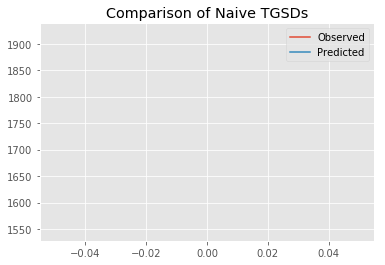

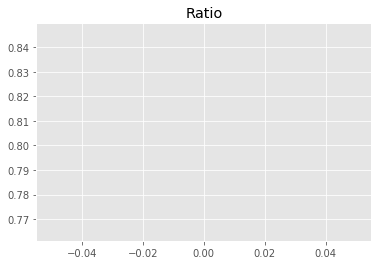

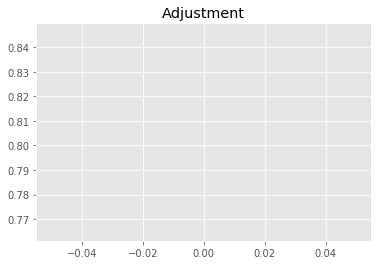

7506519470.035757
1


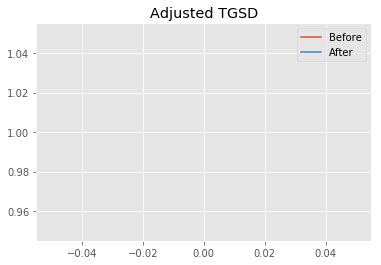

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.55987 	1.02305 	44915 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 9.31979e+09
After: 		|1.51011 	1.00026 	44828.3 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 544.449
New Misfit: 543.299
Convergence:
0.0021124006568295052

____________________
a = 1.51011	b = 1.00026	            h1 = 44828.28914	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 9319785815.10838
Success: True
Status: Successful convergence.
Iterations: 4
Misfit: 543.2993284100969
Prior Misfit: 655.785,	 Post Misfit: 543.299


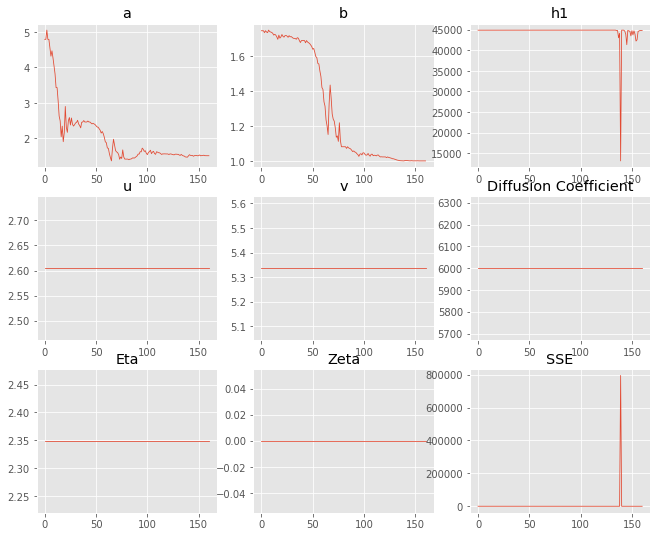

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,4.79313,1.51011
b,1.74641,1.00026
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"44,893.4","44,828.3"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 18 Time: 0.085 minutes


Estimated remaining run time: 0.066 minutes


Run 18===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.85e+03 	1.55e+03 	0.8339 		1.0000


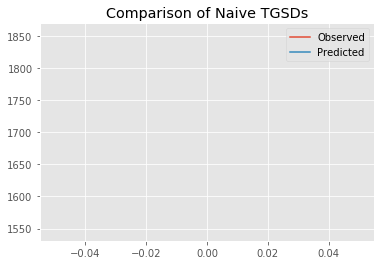

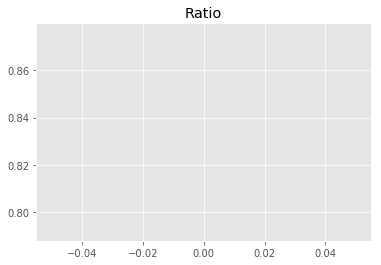

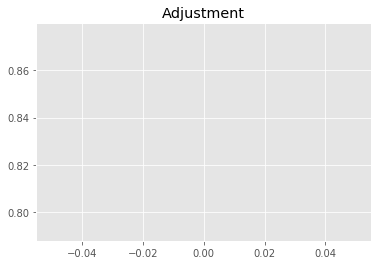

7771818212.921518
1


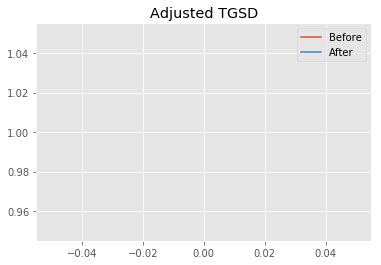

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.70509 	2.39095 	28930.2 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 9.31979e+09
After: 		|2.80605 	1.87992 	40840.1 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 1246.15
New Misfit: 606.466
Convergence:
0.5133268054495038

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.98e+03 	1.55e+03 	0.7823 		1.0000


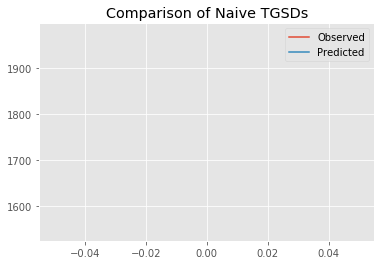

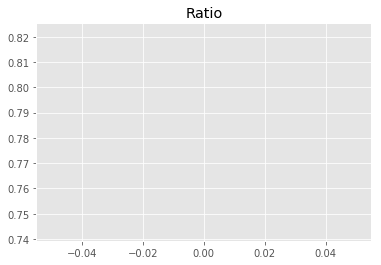

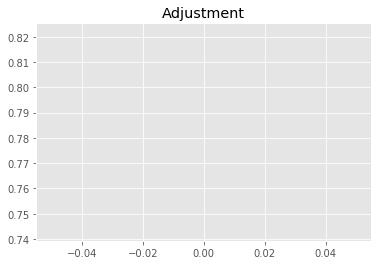

7290802809.854233
1


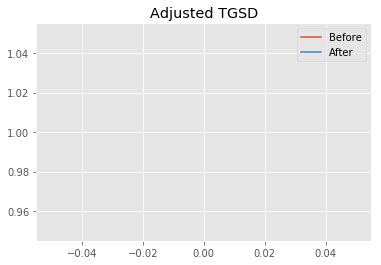

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.80605 	1.87992 	40840.1 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 9.31979e+09
After: 		|2.68508 	1.93463 	44844 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 606.466
New Misfit: 580.339
Convergence:
0.04308033703713615

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.97e+03 	1.55e+03 	0.7834 		1.0000


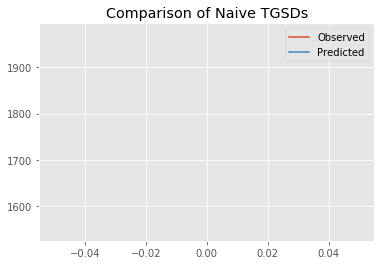

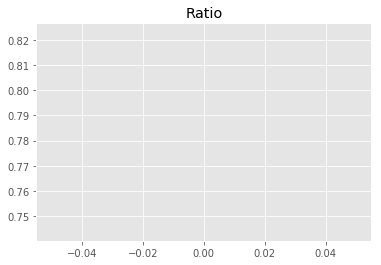

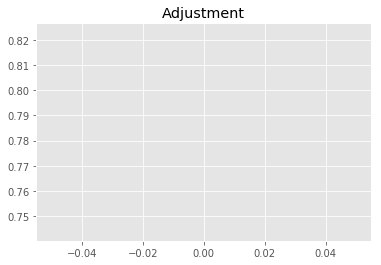

7301020287.216368
1


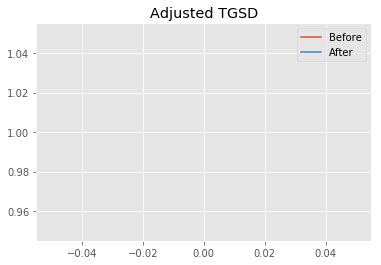

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.68508 	1.93463 	44844 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 9.31979e+09
After: 		|1.77259 	1.27816 	44915 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 580.339
New Misfit: 556.648
Convergence:
0.04082219459800323

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.93e+03 	1.55e+03 	0.8021 		1.0000


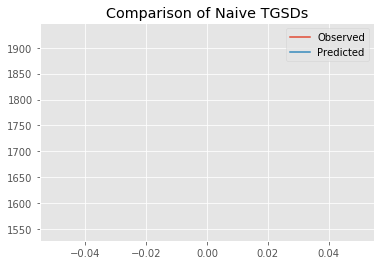

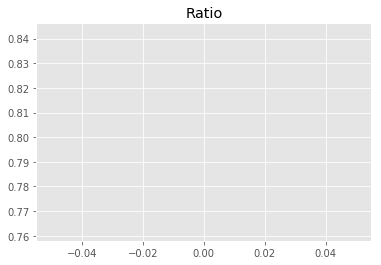

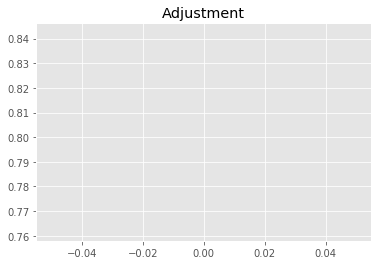

7475002648.168907
1


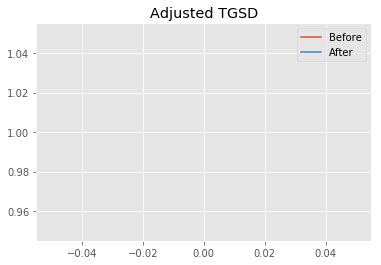

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.77259 	1.27816 	44915 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 9.31979e+09
After: 		|1.59257 	1.06819 	44865.9 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 556.648
New Misfit: 546.572
Convergence:
0.018101131672687985

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.92e+03 	1.55e+03 	0.8051 		1.0000


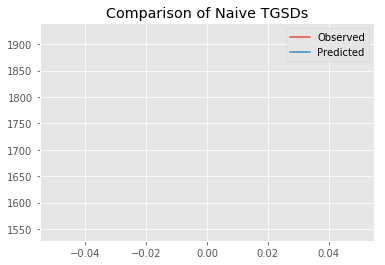

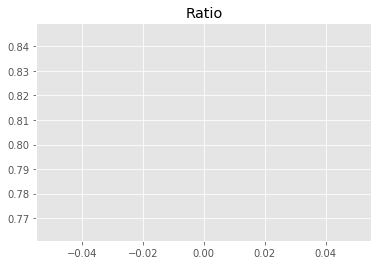

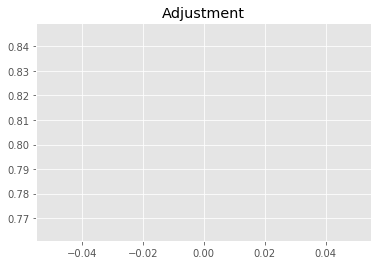

7503154417.09301
1


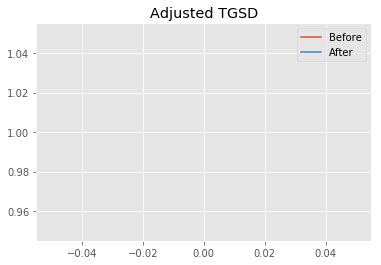

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.59257 	1.06819 	44865.9 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 9.31979e+09
After: 		|1.50981 	1.00056 	44895.1 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 546.572
New Misfit: 543.314
Convergence:
0.005961394590567561

____________________
a = 1.50981	b = 1.00056	            h1 = 44895.09573	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 9319785815.10838
Success: True
Status: Successful convergence.
Iterations: 5
Misfit: 543.3139708700871
Prior Misfit: 1246.15,	 Post Misfit: 543.314


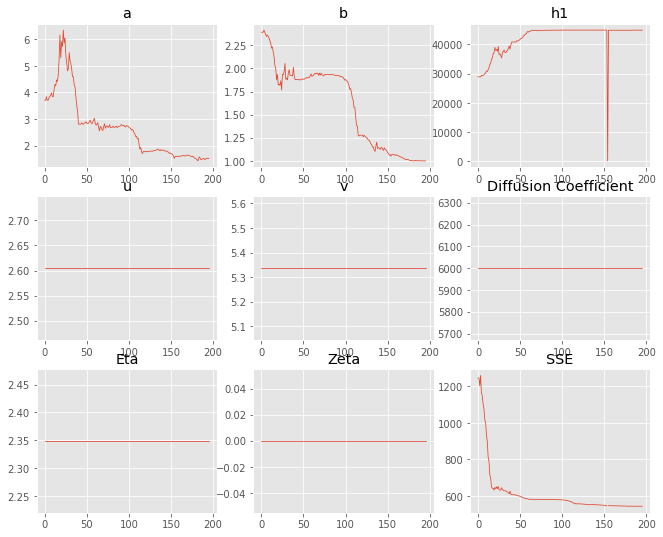

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,3.70509,1.50981
b,2.39095,1.00056
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"28,930.2","44,895.1"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 19 Time: 0.103 minutes


Estimated remaining run time: 0.000 minutes


Run 19===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.96e+03 	1.55e+03 	0.7909 		1.0000


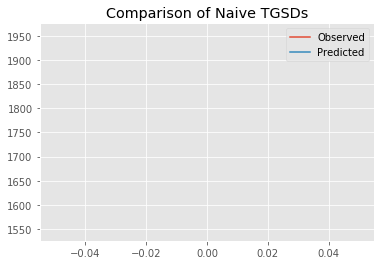

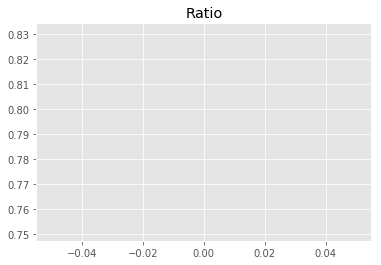

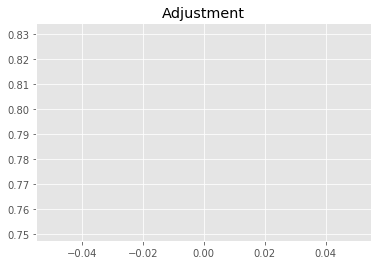

7371384242.816867
1


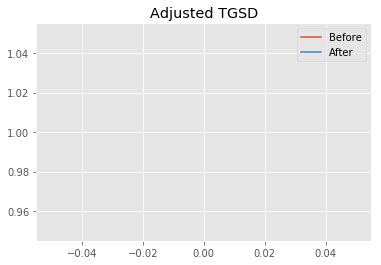

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|4.52719 	4.52956 	42530.1 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 9.31979e+09
After: 		|2.13856 	1.77478 	44914 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 724.554
New Misfit: 583.055
Convergence:
0.1952912366289456

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.94e+03 	1.55e+03 	0.7989 		1.0000


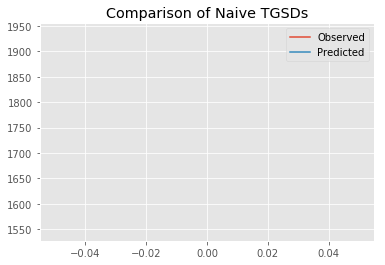

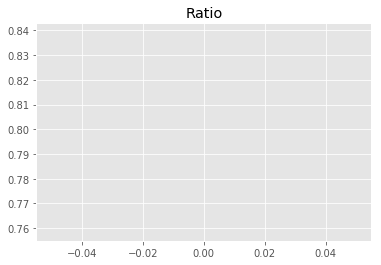

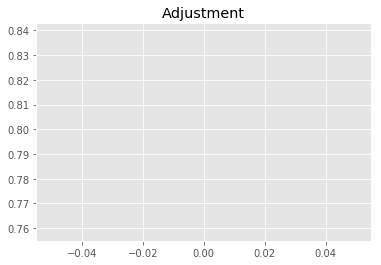

7445178136.955922
1


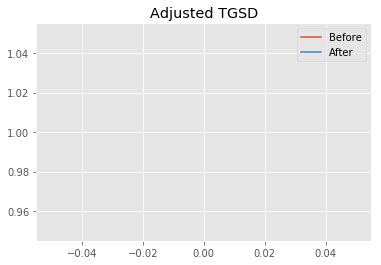

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.13856 	1.77478 	44914 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 9.31979e+09
After: 		|2.0334 	1.33876 	44632.4 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 583.055
New Misfit: 559.713
Convergence:
0.04003466661360241

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.95e+03 	1.55e+03 	0.7925 		1.0000


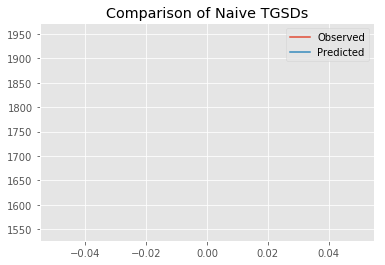

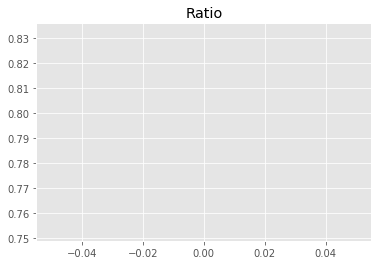

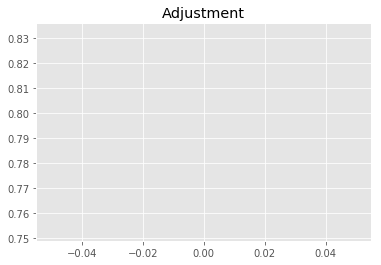

7385587219.161272
1


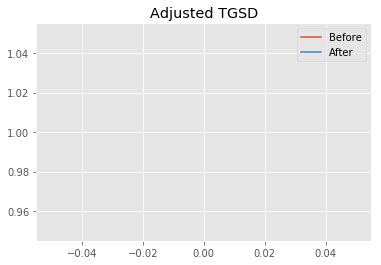

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.0334 	1.33876 	44632.4 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 9.31979e+09
After: 		|1.89406 	1.17147 	44915 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 559.713
New Misfit: 553.578
Convergence:
0.010960240122403356

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.95e+03 	1.55e+03 	0.7940 		1.0000


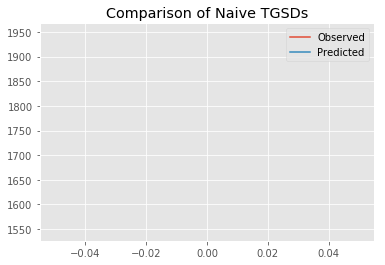

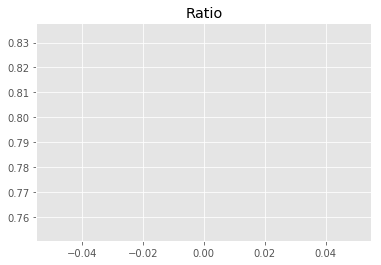

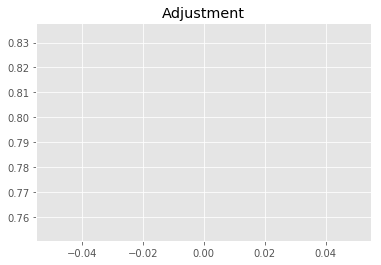

7400172995.037088
1


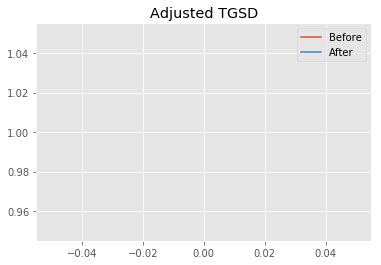

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.89406 	1.17147 	44915 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 9.31979e+09
After: 		|1.51693 	1.00134 	44741.7 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 553.578
New Misfit: 543.358
Convergence:
0.01846212014128996

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	9.32e+09 	1.92e+03 	1.55e+03 	0.8071 		1.0000


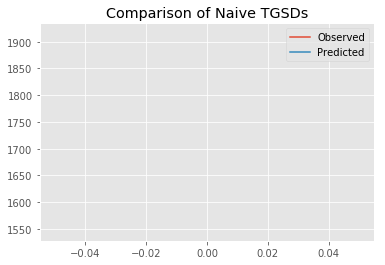

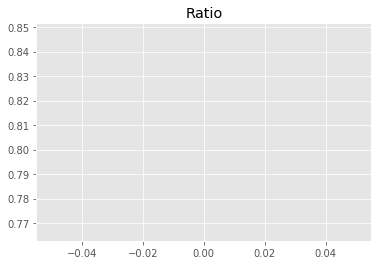

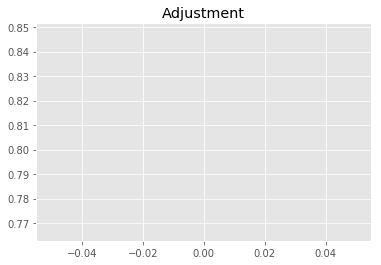

7522439955.524216
1


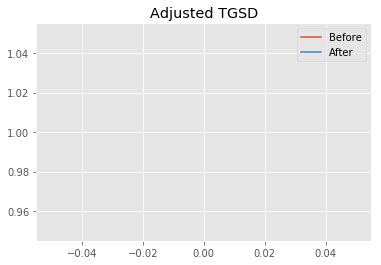

Old Total Mass: 9.31979e+09
New Total Mass: 9.31979e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.51693 	1.00134 	44741.7 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 9.31979e+09
After: 		|1.51057 	1.00001 	44378.6 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 543.358
New Misfit: 543.287
Convergence:
0.00013028387337332426

____________________
a = 1.51057	b = 1.00001	            h1 = 44378.63289	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 9319785815.10838
Success: True
Status: Successful convergence.
Iterations: 5
Misfit: 543.2872113148702
Prior Misfit: 724.554,	 Post Misfit: 543.287


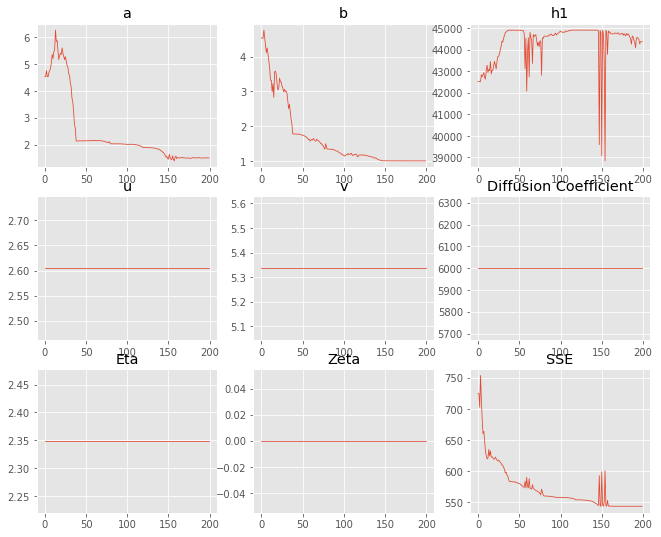

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,4.52719,1.51057
b,4.52956,1.00001
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"42,530.1","44,378.6"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 20 Time: 0.104 minutes


Estimated remaining run time: -0.070 minutes


Total Run Time: 1.46797 minutes


[{'a': 1.5055401154718746,
  'b': 1.000067487837466,
  'h1': 44696.54101817547,
  'u': 2.60482,
  'v': 5.33615,
  'D': 5999.899999999996,
  'ftt': 6457.999999999996,
  'eta': 2.34894,
  'zeta': 0.0},
 {'a': 2.45205656175293,
  'b': 1.7779714104716526,
  'h1': 44915.0,
  'u': 2.60482,
  'v': 5.33615,
  'D': 5999.899999999996,
  'ftt': 6457.999999999996,
  'eta': 2.34894,
  'zeta': 0.0},
 {'a': 2.6582095408760438,
  'b': 1.9039032395097122,
  'h1': 44914.53067008371,
  'u': 2.60482,
  'v': 5.33615,
  'D': 5999.899999999996,
  'ftt': 6457.999999999996,
  'eta': 2.34894,
  'zeta': 0.0},
 {'a': 1.5098202387564033,
  'b': 1.000006898307082,
  'h1': 44913.42116630976,
  'u': 2.60482,
  'v': 5.33615,
  'D': 5999.899999999996,
  'ftt': 6457.999999999996,
  'eta': 2.34894,
  'zeta': 0.0},
 {'a': 1.5479332915804607,
  'b': 1.033277246885883,
  'h1': 44915.0,
  'u': 2.60482,
  'v': 5.33615,
  'D': 5999.899999999996,
  'ftt': 6457.999999999996,
  'eta': 2.34894,
  'zeta': 0.0},
 {'a': 1.50490700820

,a,b,h1,u,v,D,ftt,eta,zeta,M,Misfit
6,1.50953,1,"44,903.8",2.60482,5.33615,"5,999.9","6,458",2.34894,0,9.31979e+09,543.287
3,1.50982,1.00001,"44,913.4",2.60482,5.33615,"5,999.9","6,458",2.34894,0,9.31979e+09,543.287
19,1.51057,1.00001,"44,378.6",2.60482,5.33615,"5,999.9","6,458",2.34894,0,9.31979e+09,543.287
13,1.50897,1.00002,"44,914.7",2.60482,5.33615,"5,999.9","6,458",2.34894,0,9.31979e+09,543.287
15,1.51201,1.00001,"44,915",2.60482,5.33615,"5,999.9","6,458",2.34894,0,9.31979e+09,543.288
8,1.50559,1.00004,"44,914.9",2.60482,5.33615,"5,999.9","6,458",2.34894,0,9.31979e+09,543.29
10,1.514,1.00004,"44,675.3",2.60482,5.33615,"5,999.9","6,458",2.34894,0,9.31979e+09,543.291
0,1.50554,1.00007,"44,696.5",2.60482,5.33615,"5,999.9","6,458",2.34894,0,9.31979e+09,543.291
9,1.51267,1.00008,"44,914.1",2.60482,5.33615,"5,999.9","6,458",2.34894,0,9.31979e+09,543.292
11,1.50585,1.0001,"44,438.3",2.60482,5.33615,"5,999.9","6,458",2.34894,0,9.31979e+09,543.293


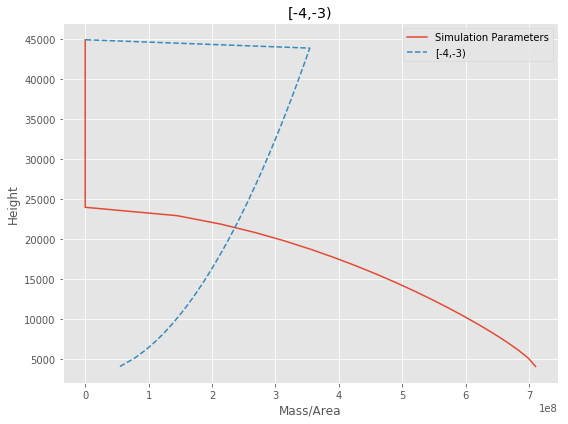

[-4,-3) Run Time: 1.47109 minutes


Mass Test: 12197189537.628078
========[-3,-2)========
Run 0===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	2.71e+03 	1.86e+03 	0.6876 		1.0000


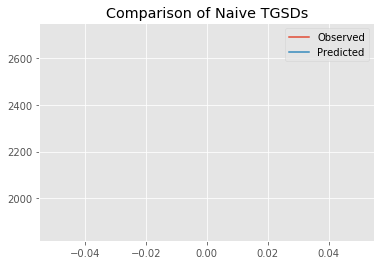

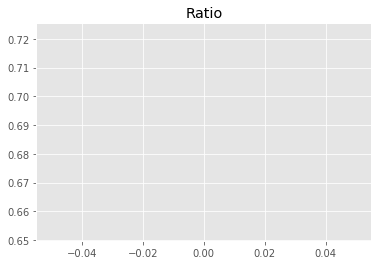

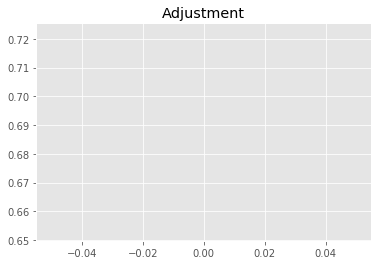

7711370386.725608
1


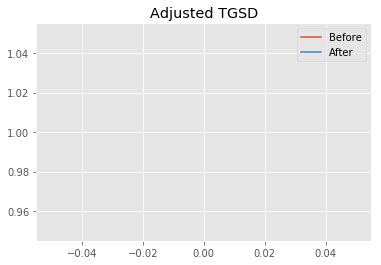

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.75178 	1.41054 	26991.8 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.1215e+10
After: 		|2.3246 	1.04511 	44517.1 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 1001.64
New Misfit: 675.992
Convergence:
0.3251116663966268

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	2.66e+03 	1.86e+03 	0.6984 		1.0000


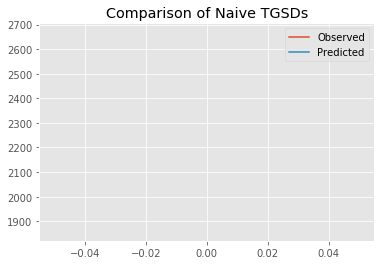

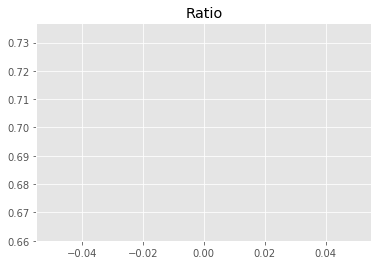

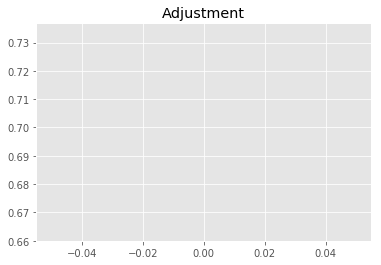

7832294262.999187
1


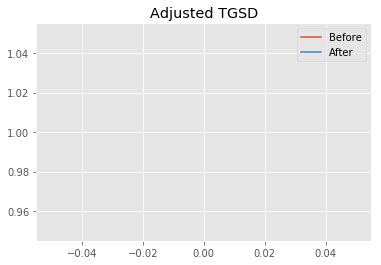

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.3246 	1.04511 	44517.1 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.1215e+10
After: 		|1.57437 	1.00024 	44872.3 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 675.992
New Misfit: 657.691
Convergence:
0.027073210654694393

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	2.63e+03 	1.86e+03 	0.7085 		1.0000


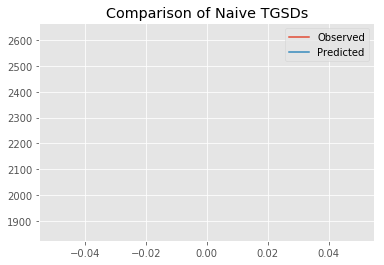

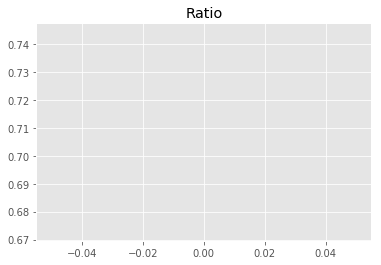

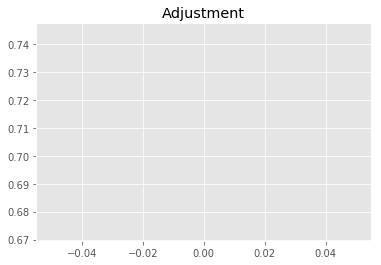

7945913953.568195
1


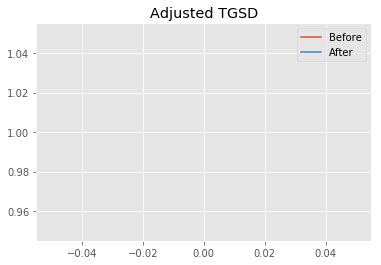

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.57437 	1.00024 	44872.3 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.1215e+10
After: 		|1.56605 	1 	44255.8 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 657.691
New Misfit: 657.671
Convergence:
2.9682560477726528e-05

____________________
a = 1.56605	b = 1.00000	            h1 = 44255.82665	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 11215047803.00476
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 657.6713645442553
Prior Misfit: 1001.64,	 Post Misfit: 657.671


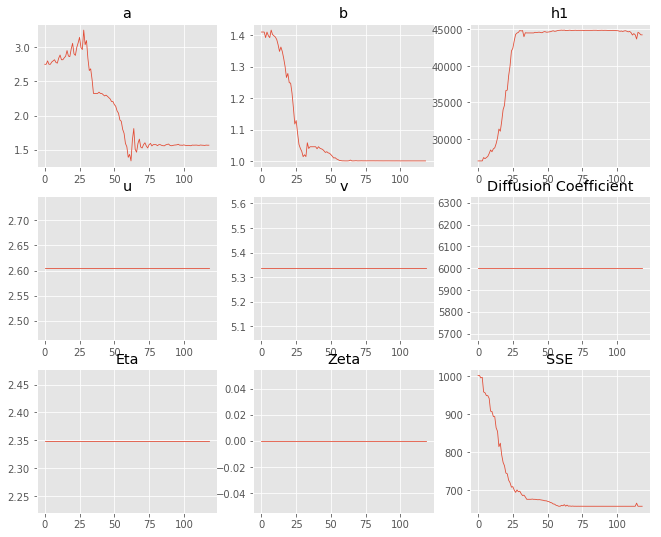

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,2.75178,1.56605
b,1.41054,1
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"26,991.8","44,255.8"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 1 Time: 0.065 minutes


Estimated remaining run time: 0.588 minutes


Run 1===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	2.75e+03 	1.86e+03 	0.6756 		1.0000


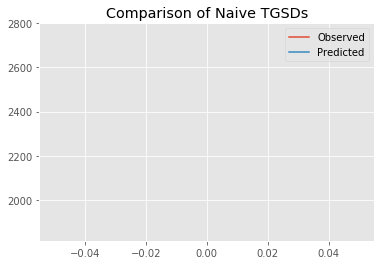

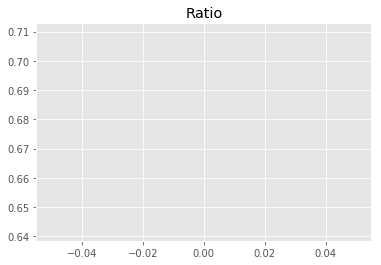

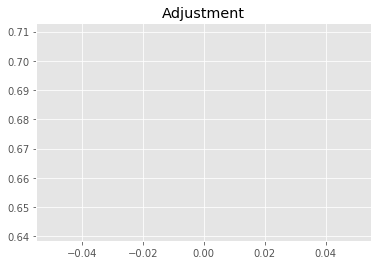

7577310972.19965
1


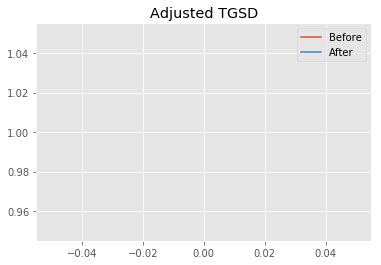

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.205 	1.39767 	41010.6 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.1215e+10
After: 		|1.61895 	1.17357 	44304.7 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 720.47
New Misfit: 671.322
Convergence:
0.06821605354704269

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	2.63e+03 	1.86e+03 	0.7066 		1.0000


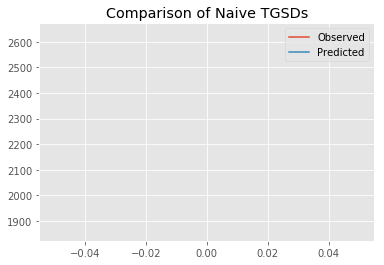

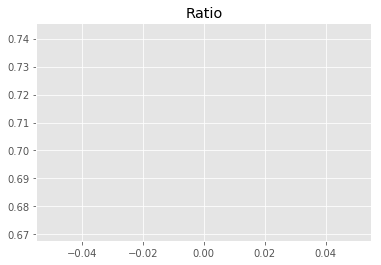

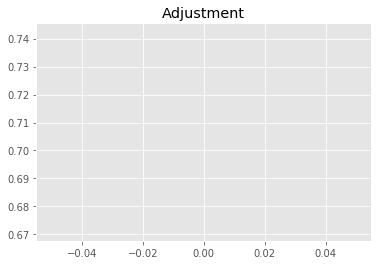

7924298535.5646105
1


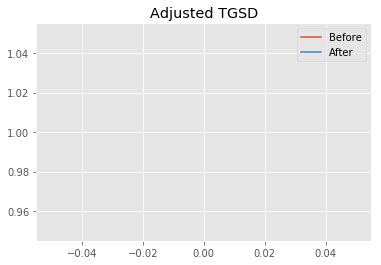

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.61895 	1.17357 	44304.7 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.1215e+10
After: 		|1.64963 	1.02401 	44172.3 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 671.322
New Misfit: 659.644
Convergence:
0.017395085561119596

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	2.63e+03 	1.86e+03 	0.7063 		1.0000


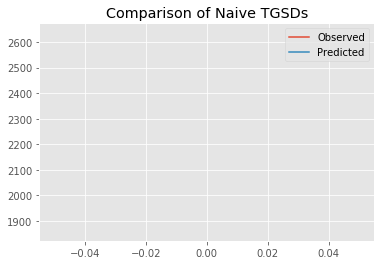

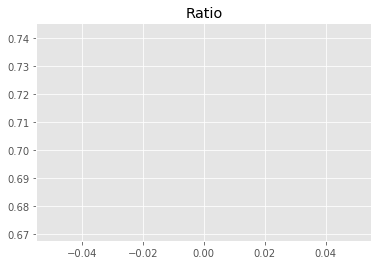

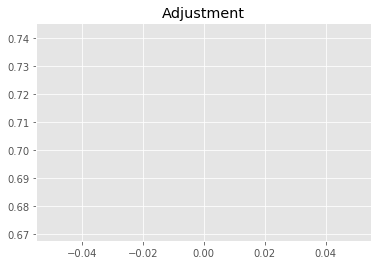

7921185392.090569
1


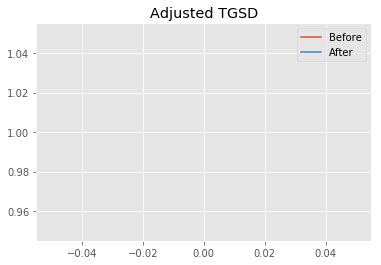

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.64963 	1.02401 	44172.3 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.1215e+10
After: 		|1.56103 	1.00001 	44463.9 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 659.644
New Misfit: 657.674
Convergence:
0.002987401089481625

____________________
a = 1.56103	b = 1.00001	            h1 = 44463.91407	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 11215047803.00476
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 657.6736270423197
Prior Misfit: 720.47,	 Post Misfit: 657.674


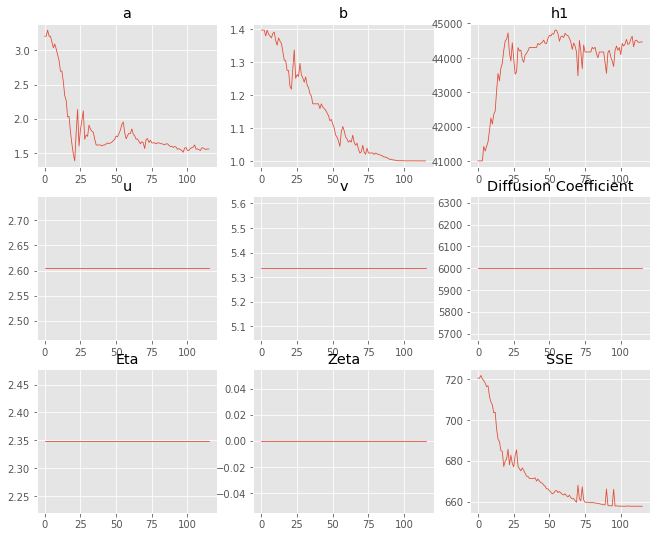

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,3.205,1.56103
b,1.39767,1.00001
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"41,010.6","44,463.9"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 2 Time: 0.065 minutes


Estimated remaining run time: 0.738 minutes


Run 2===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	2.77e+03 	1.86e+03 	0.6725 		1.0000


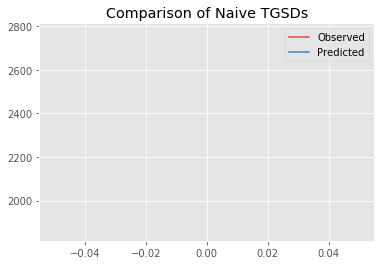

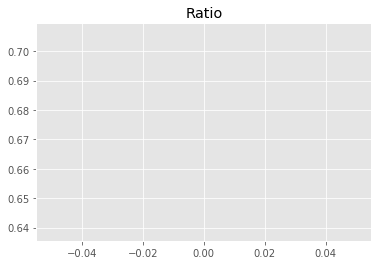

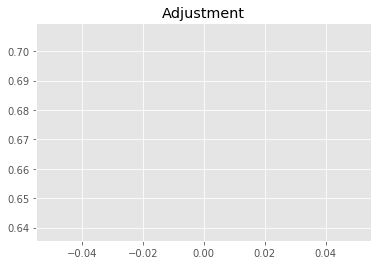

7541714115.412223
1


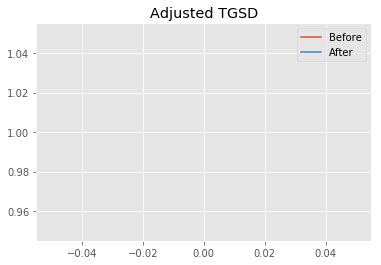

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.9219 	1.68447 	41603.5 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.1215e+10
After: 		|2.39626 	1.64189 	44184 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 732.272
New Misfit: 697.897
Convergence:
0.04694268006072255

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	2.71e+03 	1.86e+03 	0.6873 		1.0000


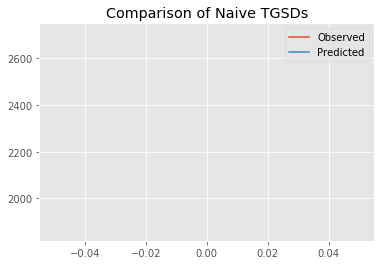

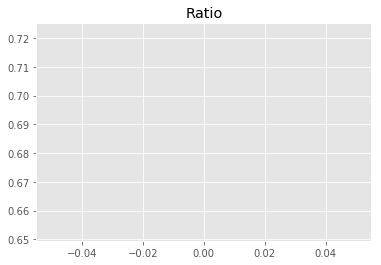

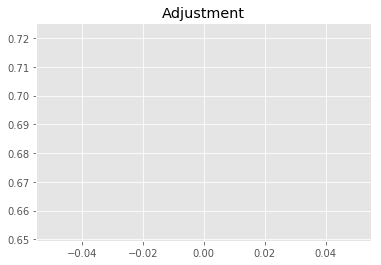

7708048472.841508
1


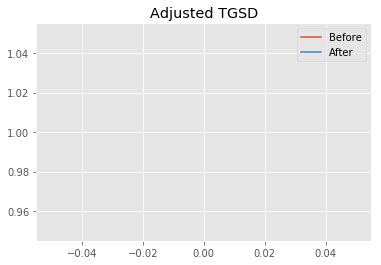

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.39626 	1.64189 	44184 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.1215e+10
After: 		|1.67308 	1.21416 	44914.5 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 697.897
New Misfit: 672.196
Convergence:
0.03682554896216355

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	2.64e+03 	1.86e+03 	0.7051 		1.0000


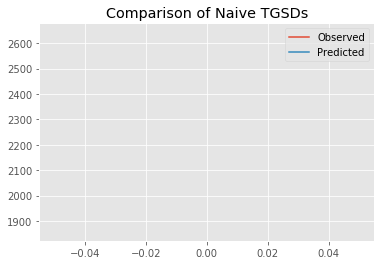

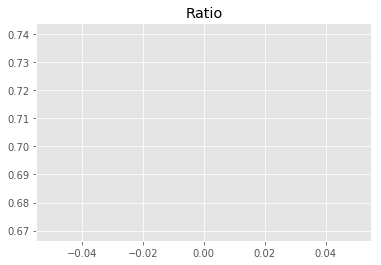

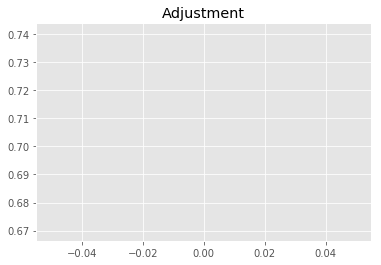

7908069704.016978
1


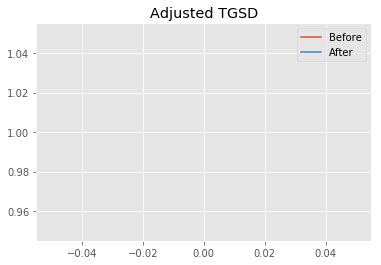

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.67308 	1.21416 	44914.5 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.1215e+10
After: 		|1.74998 	1.02305 	44582.5 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 672.196
New Misfit: 660.536
Convergence:
0.01734735439708352

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	2.64e+03 	1.86e+03 	0.7041 		1.0000


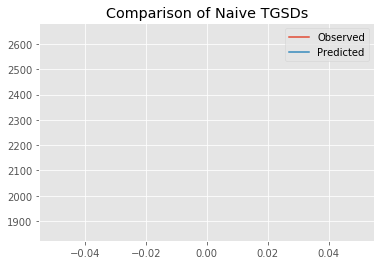

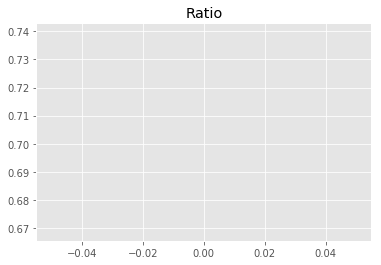

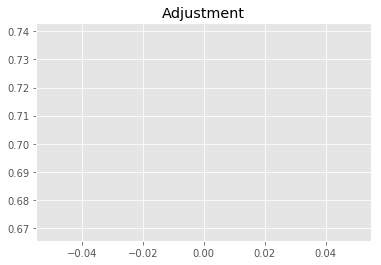

7896876014.023029
1


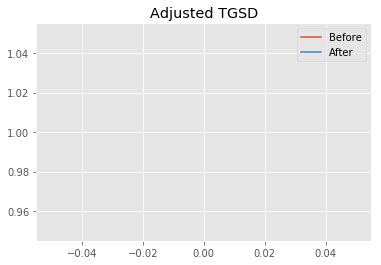

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.74998 	1.02305 	44582.5 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.1215e+10
After: 		|1.57307 	1.00157 	44280.4 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 660.536
New Misfit: 657.789
Convergence:
0.004158237428557955

____________________
a = 1.57307	b = 1.00157	            h1 = 44280.37640	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 11215047803.00476
Success: True
Status: Successful convergence.
Iterations: 4
Misfit: 657.7889778299078
Prior Misfit: 732.272,	 Post Misfit: 657.789


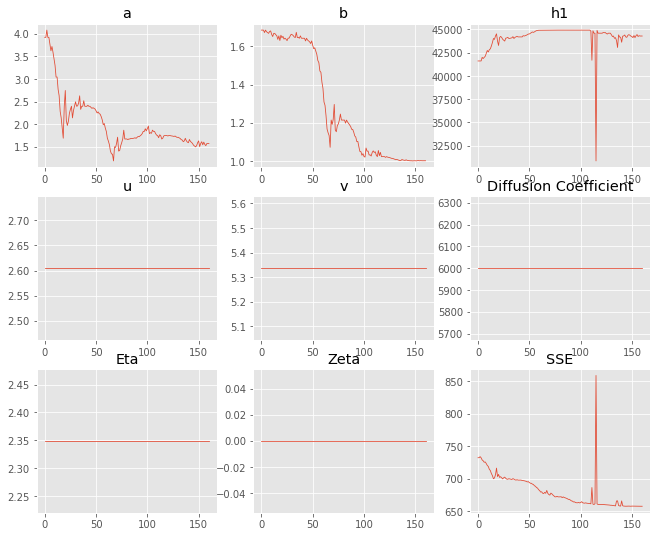

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,3.9219,1.57307
b,1.68447,1.00157
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"41,603.5","44,280.4"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 3 Time: 0.086 minutes


Estimated remaining run time: 0.864 minutes


Run 3===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	2.74e+03 	1.86e+03 	0.6800 		1.0000


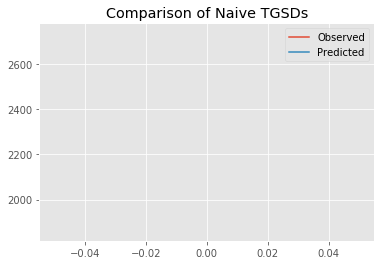

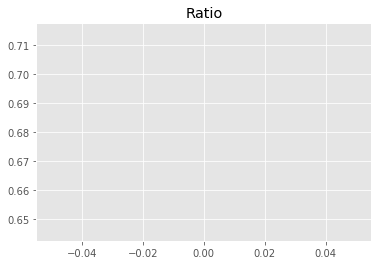

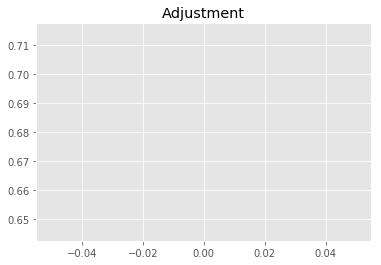

7625740128.747912
1


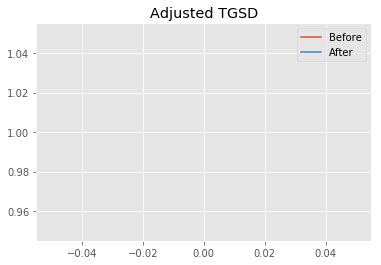

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.78427 	2.36908 	44148.2 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.1215e+10
After: 		|1.80622 	1.38478 	44915 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 733.404
New Misfit: 682.956
Convergence:
0.06878600597983672

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	2.65e+03 	1.86e+03 	0.7012 		1.0000


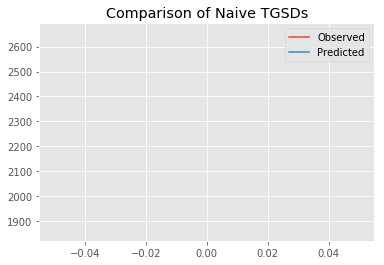

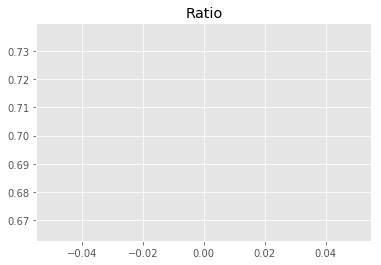

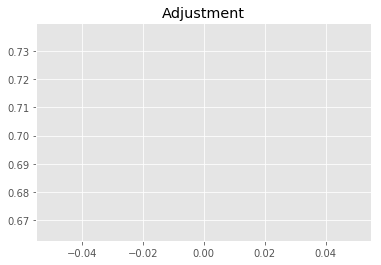

7864173610.454225
1


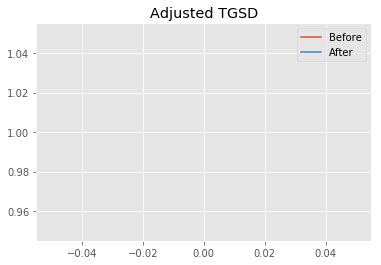

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.80622 	1.38478 	44915 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.1215e+10
After: 		|1.94484 	1.05138 	44915 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 682.956
New Misfit: 665.386
Convergence:
0.0257254350029971

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	2.66e+03 	1.86e+03 	0.7007 		1.0000


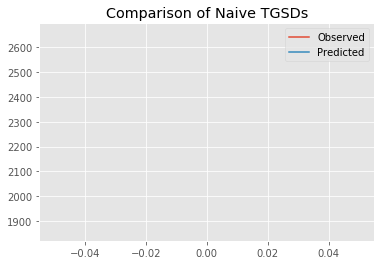

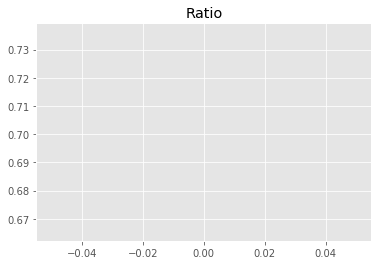

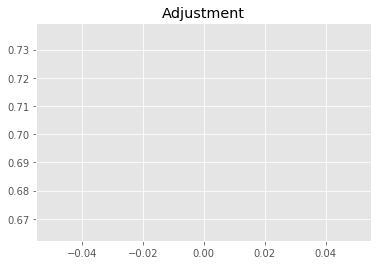

7858882277.440848
1


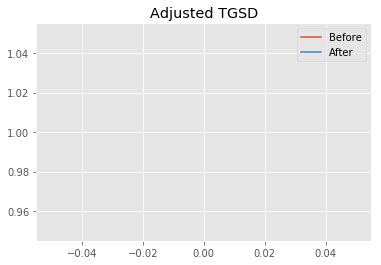

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.94484 	1.05138 	44915 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.1215e+10
After: 		|1.93007 	1.0021 	43954.4 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 665.386
New Misfit: 663.559
Convergence:
0.0027461014534722523

____________________
a = 1.93007	b = 1.00210	            h1 = 43954.36384	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 11215047803.00476
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 663.5592580732616
Prior Misfit: 733.404,	 Post Misfit: 663.559


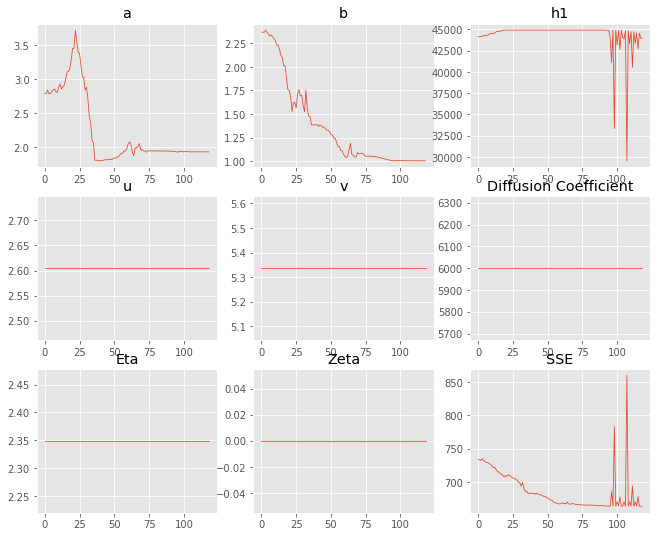

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,2.78427,1.93007
b,2.36908,1.0021
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"44,148.2","43,954.4"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 4 Time: 0.067 minutes


Estimated remaining run time: 0.848 minutes


Run 4===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	2.75e+03 	1.86e+03 	0.6764 		1.0000


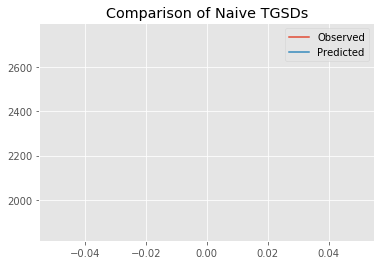

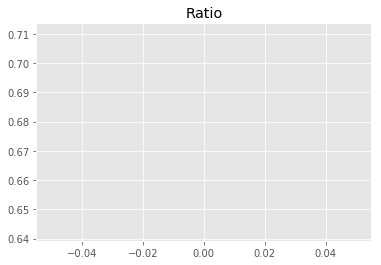

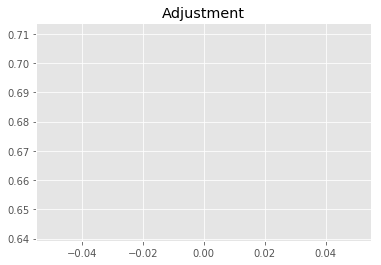

7586213174.384505
1


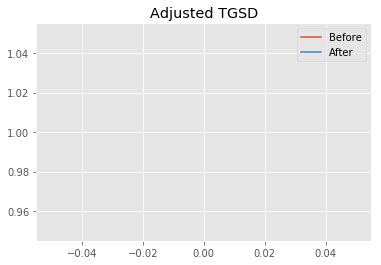

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.60653 	2.83114 	33999.3 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.1215e+10
After: 		|5.08799 	1.4536 	44097.8 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 887.576
New Misfit: 725.529
Convergence:
0.18257244570636977

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	2.65e+03 	1.86e+03 	0.7013 		1.0000


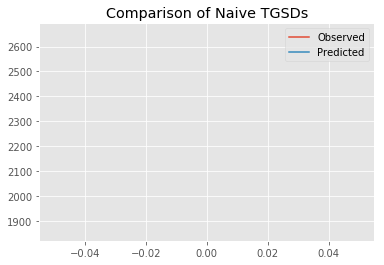

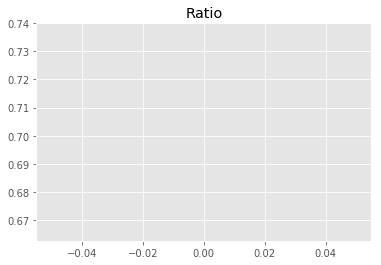

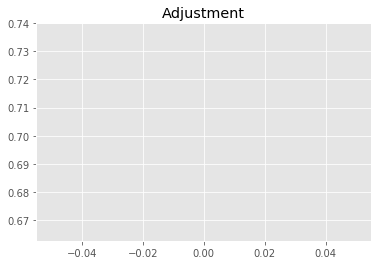

7865121390.000641
1


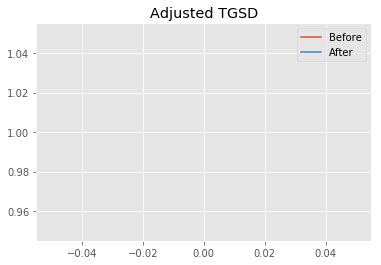

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|5.08799 	1.4536 	44097.8 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.1215e+10
After: 		|1.82008 	1.26528 	44787.3 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 725.529
New Misfit: 674.593
Convergence:
0.07020599603224555

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	2.65e+03 	1.86e+03 	0.7009 		1.0000


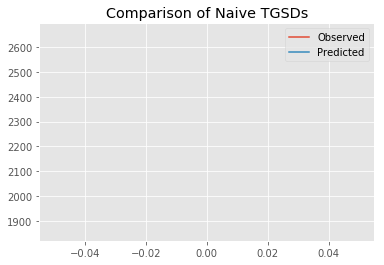

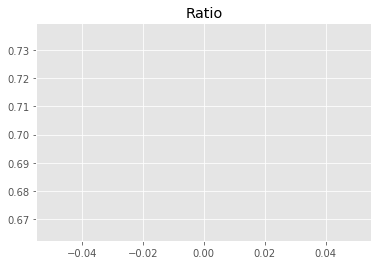

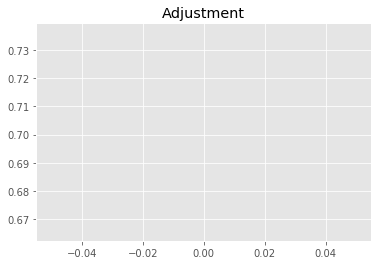

7860481018.76576
1


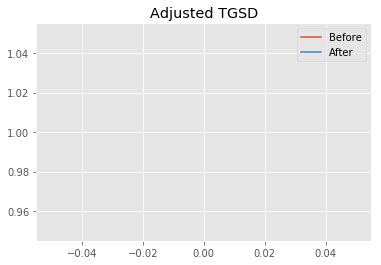

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.82008 	1.26528 	44787.3 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.1215e+10
After: 		|1.82089 	1.00111 	44070.5 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 674.593
New Misfit: 660.877
Convergence:
0.020332637605876214

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	2.65e+03 	1.86e+03 	0.7032 		1.0000


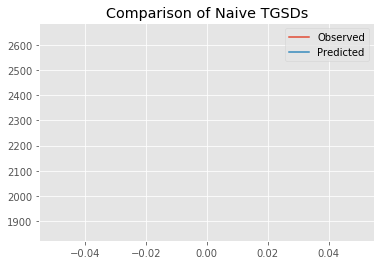

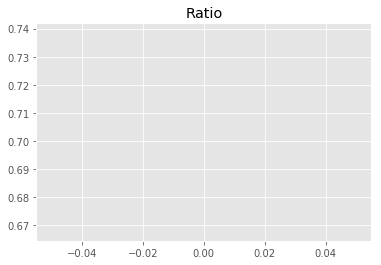

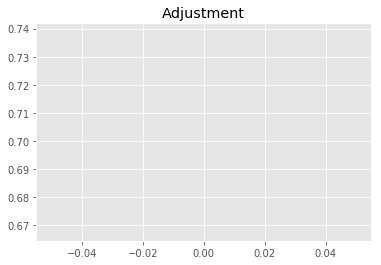

7886220180.713045
1


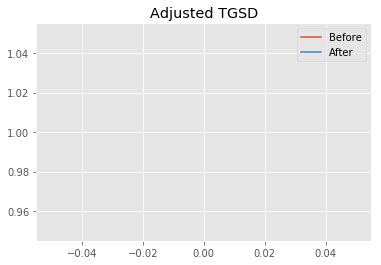

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.82089 	1.00111 	44070.5 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.1215e+10
After: 		|1.68405 	1.01043 	43932.4 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 660.877
New Misfit: 659.121
Convergence:
0.0026563122118388686

____________________
a = 1.68405	b = 1.01043	            h1 = 43932.36728	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 11215047803.00476
Success: True
Status: Successful convergence.
Iterations: 4
Misfit: 659.1210603173976
Prior Misfit: 887.576,	 Post Misfit: 659.121


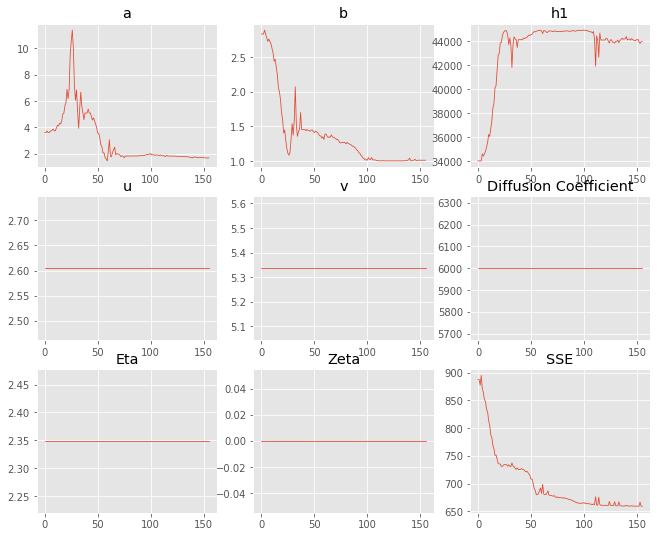

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,3.60653,1.68405
b,2.83114,1.01043
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"33,999.3","43,932.4"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 5 Time: 0.084 minutes


Estimated remaining run time: 0.854 minutes


Run 5===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	2.80e+03 	1.86e+03 	0.6649 		1.0000


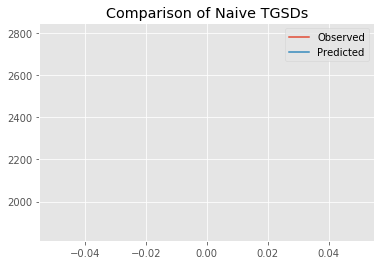

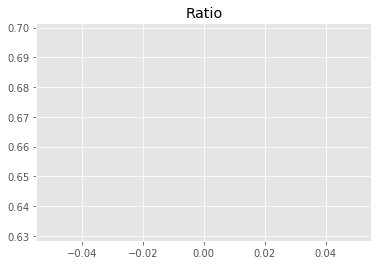

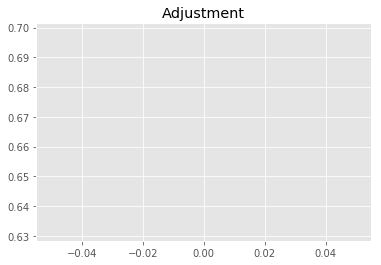

7456582974.741548
1


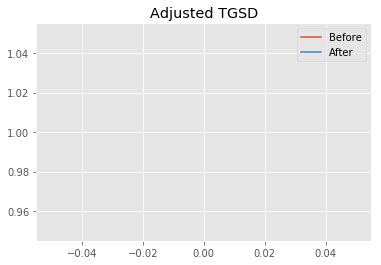

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|4.18804 	3.14999 	43953.6 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.1215e+10
After: 		|1.64001 	1.0158 	44915 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 750.991
New Misfit: 658.885
Convergence:
0.12264633740895574

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	2.63e+03 	1.86e+03 	0.7067 		1.0000


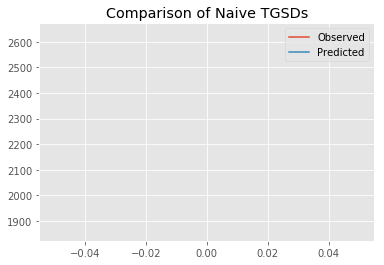

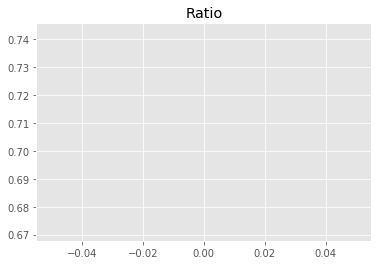

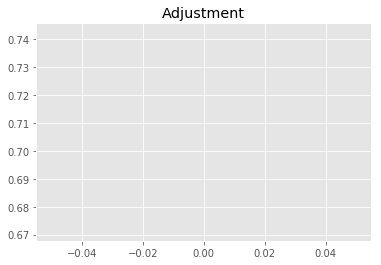

7925289596.731443
1


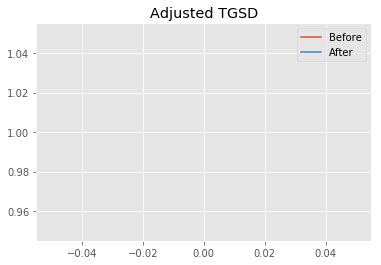

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.64001 	1.0158 	44915 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.1215e+10
After: 		|1.56898 	1.00001 	44915 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 658.885
New Misfit: 657.672
Convergence:
0.0018404477395629981

____________________
a = 1.56898	b = 1.00001	            h1 = 44914.99996	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 11215047803.00476
Success: True
Status: Successful convergence.
Iterations: 2
Misfit: 657.6723739305205
Prior Misfit: 750.991,	 Post Misfit: 657.672


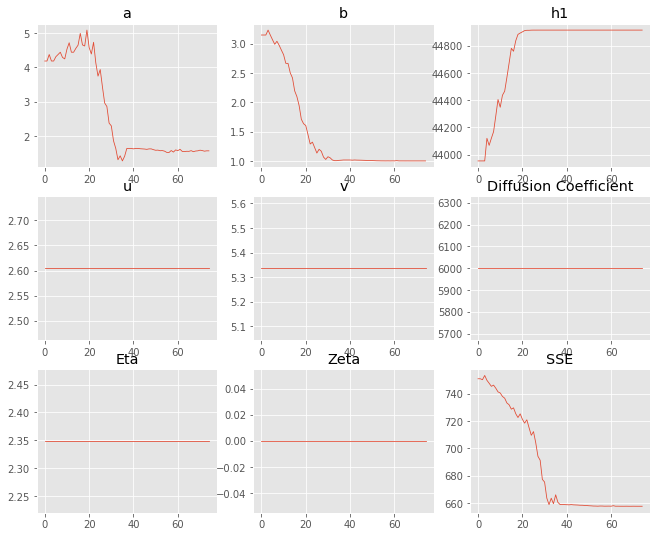

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,4.18804,1.56898
b,3.14999,1.00001
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"43,953.6","44,915"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 6 Time: 0.046 minutes


Estimated remaining run time: 0.766 minutes


Run 6===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	2.75e+03 	1.86e+03 	0.6775 		1.0000


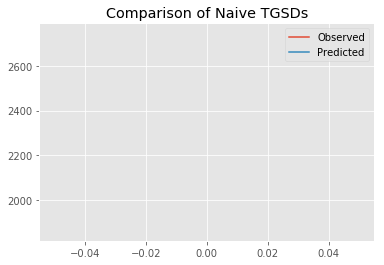

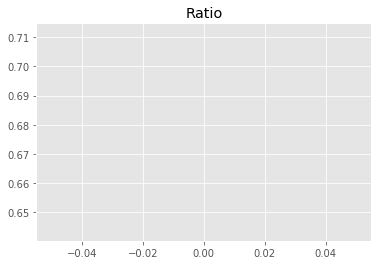

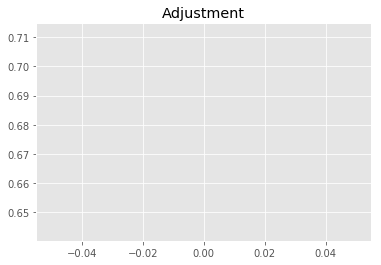

7597852489.530399
1


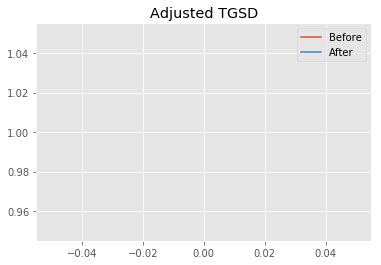

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|4.56041 	3.9695 	33996.5 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.1215e+10
After: 		|31.1424 	1.12403 	42854.1 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 944.315
New Misfit: 737.625
Convergence:
0.21887822412963104

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	2.43e+03 	1.86e+03 	0.7648 		1.0000


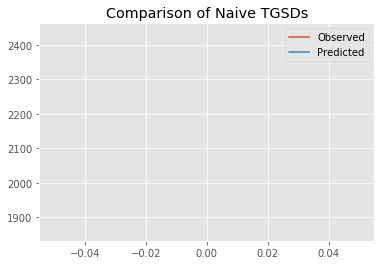

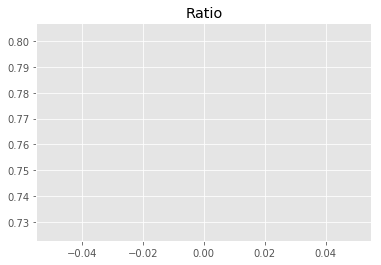

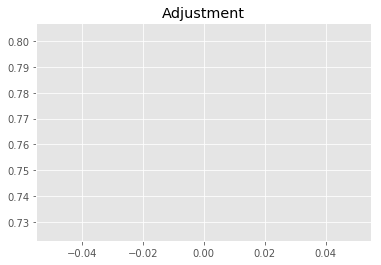

8576793904.244717
1


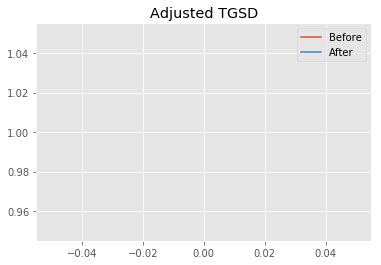

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|31.1424 	1.12403 	42854.1 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.1215e+10
After: 		|1.66781 	1.06374 	44592.2 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 737.625
New Misfit: 662.069
Convergence:
0.10243125829548934

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	2.64e+03 	1.86e+03 	0.7056 		1.0000


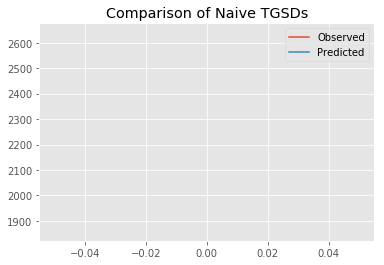

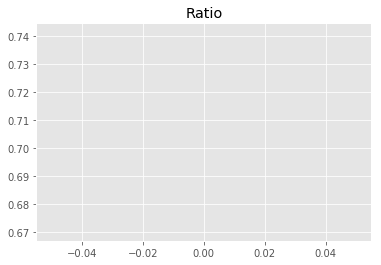

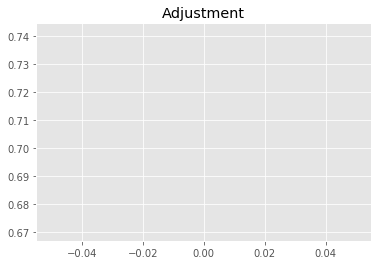

7913469016.039429
1


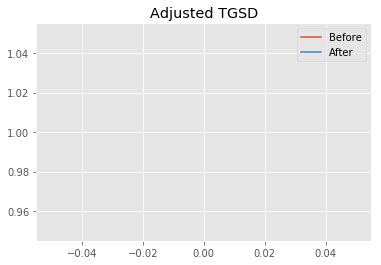

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.66781 	1.06374 	44592.2 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.1215e+10
After: 		|1.64187 	1.00522 	44027 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 662.069
New Misfit: 658.359
Convergence:
0.005604429908574646

____________________
a = 1.64187	b = 1.00522	            h1 = 44026.96989	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 11215047803.00476
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 658.3587033623838
Prior Misfit: 944.315,	 Post Misfit: 658.359


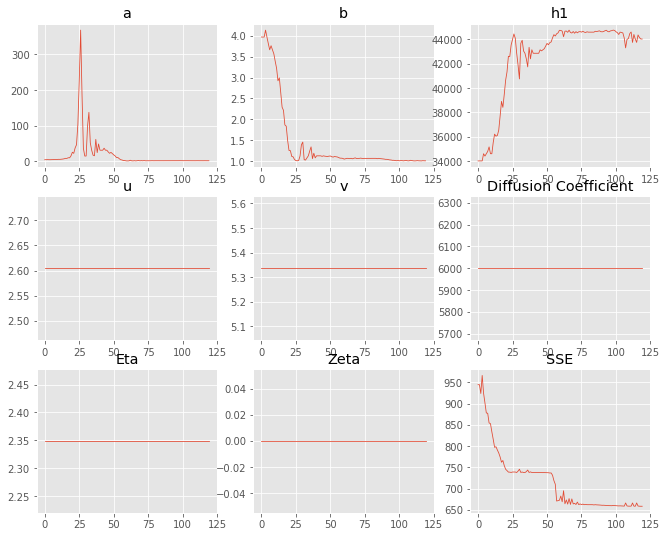

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,4.56041,1.64187
b,3.9695,1.00522
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"33,996.5","44,027"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 7 Time: 0.068 minutes


Estimated remaining run time: 0.720 minutes


Run 7===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	2.72e+03 	1.86e+03 	0.6847 		1.0000


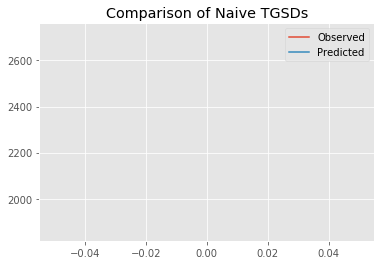

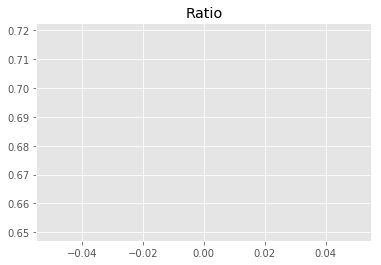

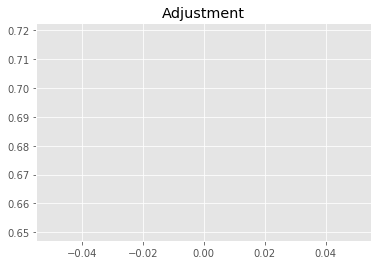

7679384956.491803
1


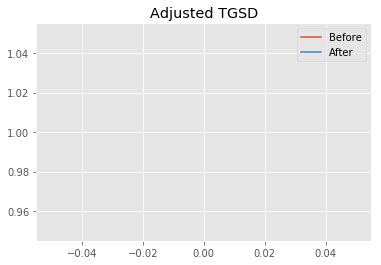

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.42197 	1.61251 	43154.8 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.1215e+10
After: 		|1.49356 	1.17245 	44912.4 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 704.044
New Misfit: 673.47
Convergence:
0.043426525164942116

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	2.62e+03 	1.86e+03 	0.7115 		1.0000


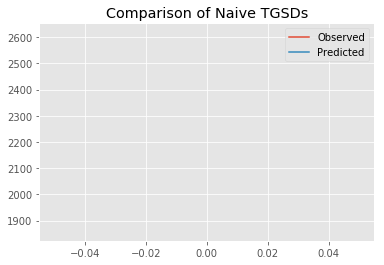

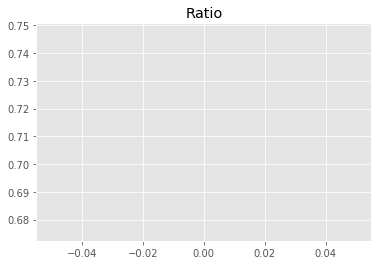

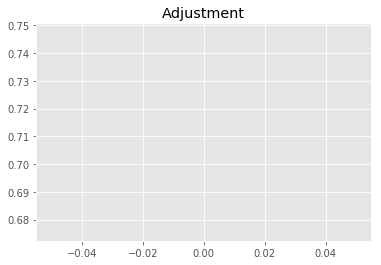

7979695208.904708
1


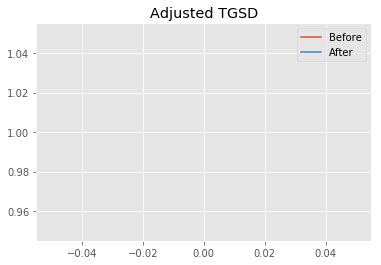

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.49356 	1.17245 	44912.4 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.1215e+10
After: 		|1.54278 	1.02435 	44607.2 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 673.47
New Misfit: 659.522
Convergence:
0.020710835528329526

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	2.62e+03 	1.86e+03 	0.7094 		1.0000


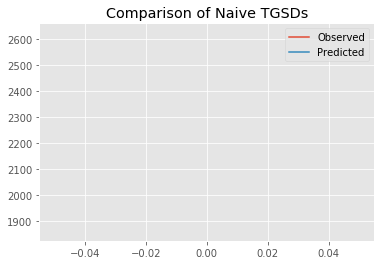

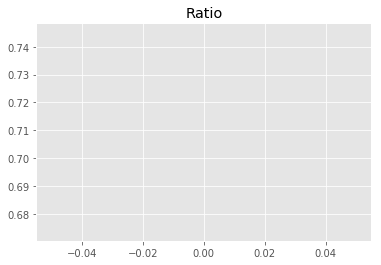

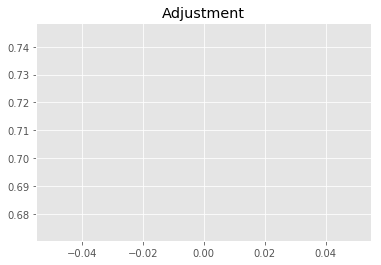

7955443651.923027
1


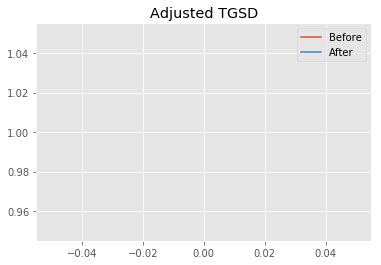

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.54278 	1.02435 	44607.2 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.1215e+10
After: 		|1.56305 	1.00003 	44019 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 659.522
New Misfit: 657.674
Convergence:
0.0028008521008073208

____________________
a = 1.56305	b = 1.00003	            h1 = 44019.04201	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 11215047803.00476
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 657.6742976228459
Prior Misfit: 704.044,	 Post Misfit: 657.674


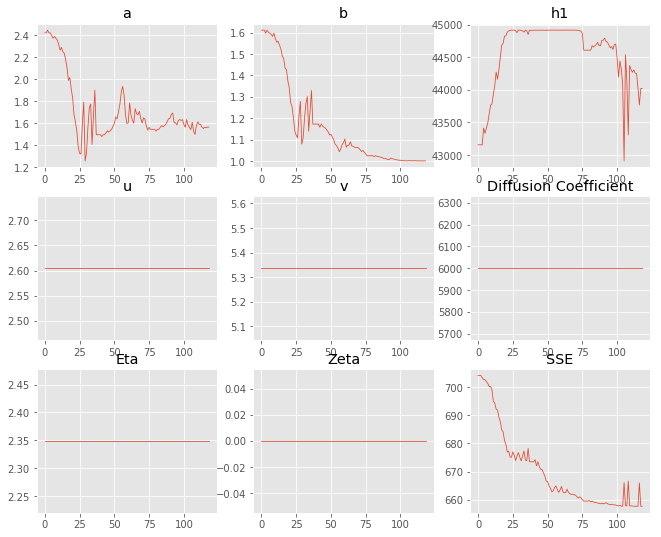

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,2.42197,1.56305
b,1.61251,1.00003
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"43,154.8","44,019"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 8 Time: 0.067 minutes


Estimated remaining run time: 0.668 minutes


Run 8===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	2.78e+03 	1.86e+03 	0.6683 		1.0000


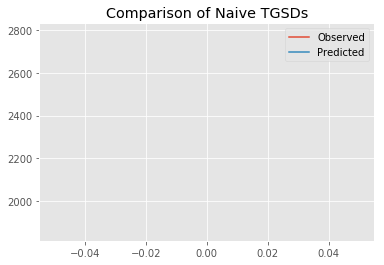

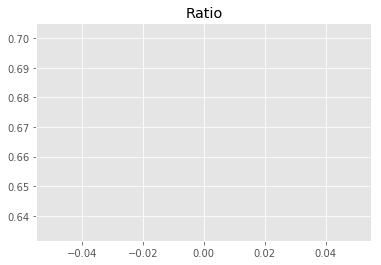

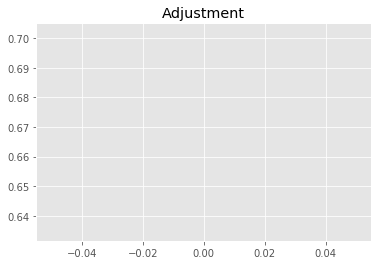

7494643913.277361
1


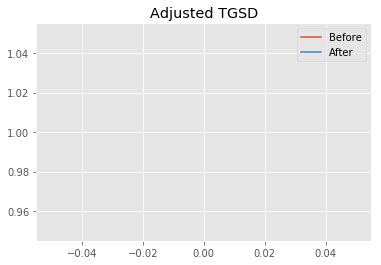

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.52846 	2.35629 	34019.6 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.1215e+10
After: 		|3.91797 	1.86208 	42998 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 838.699
New Misfit: 726.137
Convergence:
0.1342099960100579

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	2.75e+03 	1.86e+03 	0.6756 		1.0000


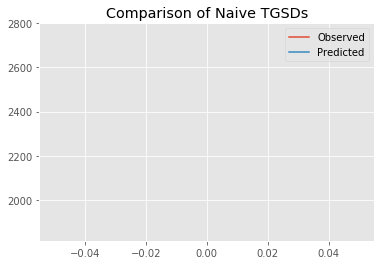

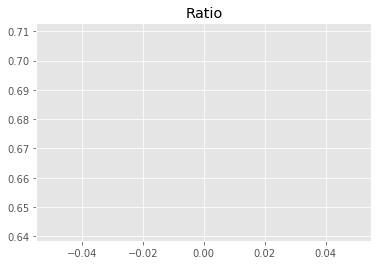

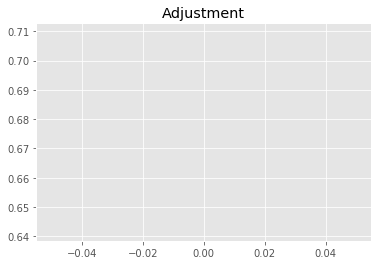

7576768140.84689
1


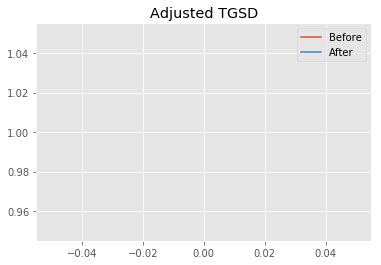

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.91797 	1.86208 	42998 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.1215e+10
After: 		|2.65294 	1.87201 	44771.6 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 726.137
New Misfit: 705.399
Convergence:
0.02855984186881596

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	2.72e+03 	1.86e+03 	0.6836 		1.0000


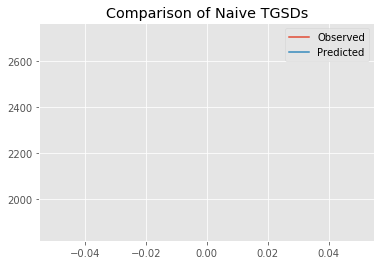

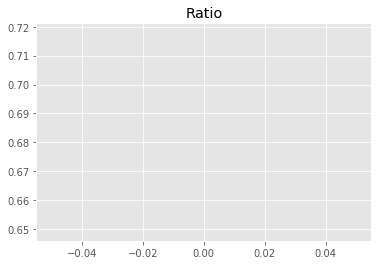

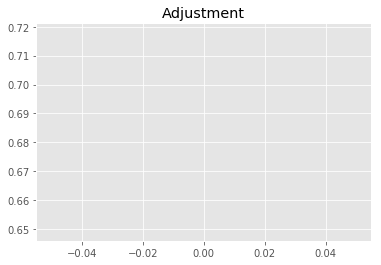

7666083584.574109
1


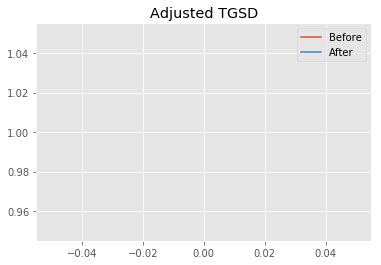

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.65294 	1.87201 	44771.6 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.1215e+10
After: 		|1.74892 	1.34793 	44915 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 705.399
New Misfit: 681.327
Convergence:
0.034124890537993

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	2.65e+03 	1.86e+03 	0.7029 		1.0000


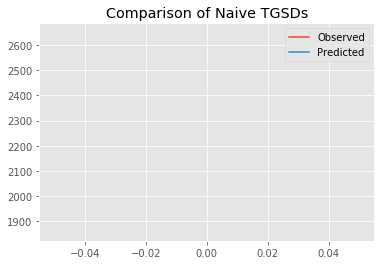

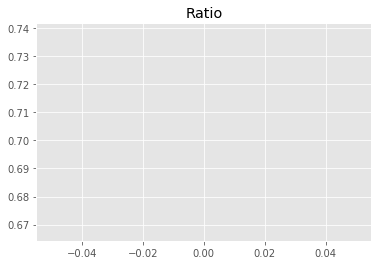

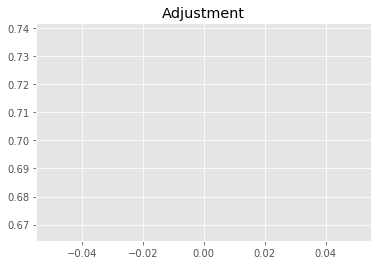

7883151846.229159
1


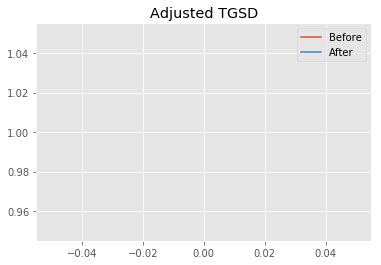

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.74892 	1.34793 	44915 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.1215e+10
After: 		|1.86401 	1.0409 	44914.8 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 681.327
New Misfit: 663.249
Convergence:
0.026534129508079065

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	2.65e+03 	1.86e+03 	0.7020 		1.0000


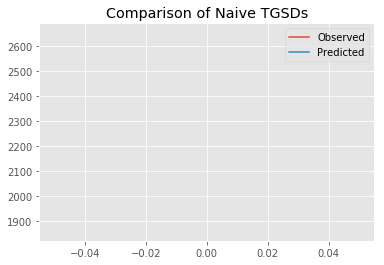

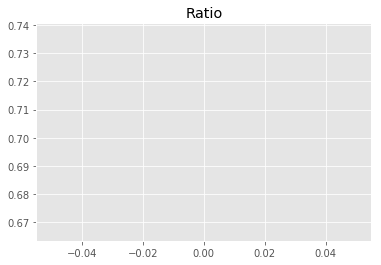

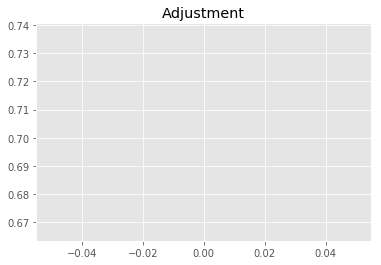

7872852970.449359
1


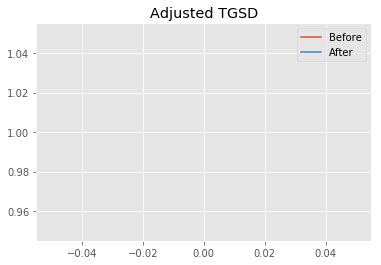

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.86401 	1.0409 	44914.8 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.1215e+10
After: 		|1.56944 	1.00015 	44824.5 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 663.249
New Misfit: 657.682
Convergence:
0.008393126714408922

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	2.63e+03 	1.86e+03 	0.7086 		1.0000


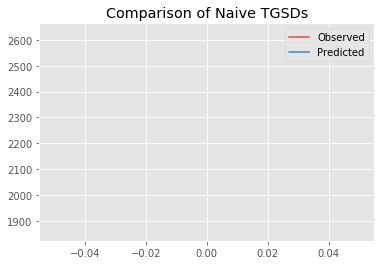

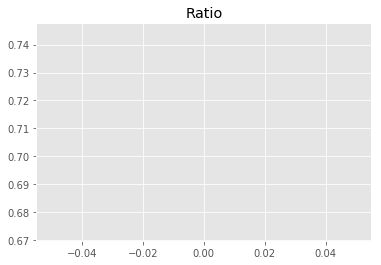

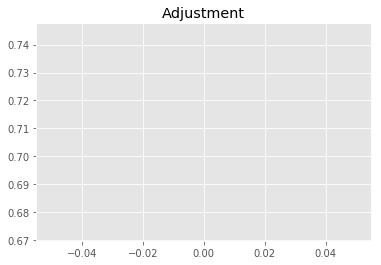

7947498871.719434
1


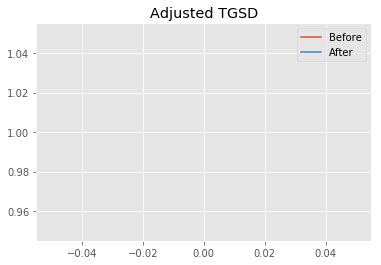

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.56944 	1.00015 	44824.5 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.1215e+10
After: 		|1.56636 	1 	44803.1 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 657.682
New Misfit: 657.671
Convergence:
1.6323601304237538e-05

____________________
a = 1.56636	b = 1.00000	            h1 = 44803.14877	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 11215047803.00476
Success: True
Status: Successful convergence.
Iterations: 6
Misfit: 657.6712089615357
Prior Misfit: 838.699,	 Post Misfit: 657.671


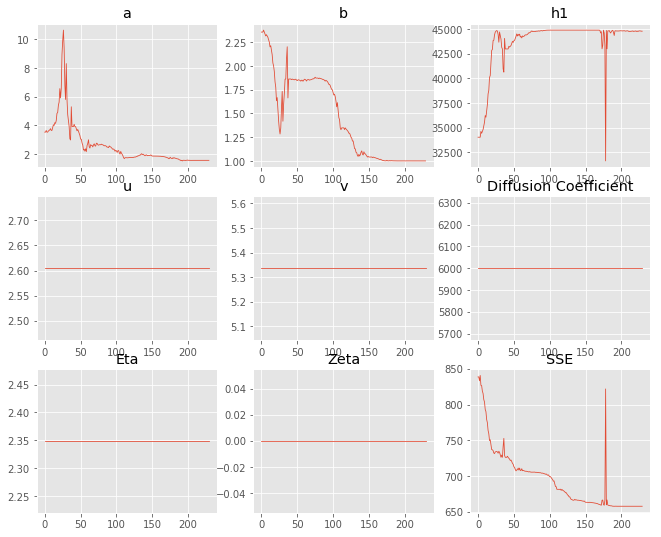

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,3.52846,1.56636
b,2.35629,1
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"34,019.6","44,803.1"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 9 Time: 0.121 minutes


Estimated remaining run time: 0.668 minutes


Run 9===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	2.71e+03 	1.86e+03 	0.6866 		1.0000


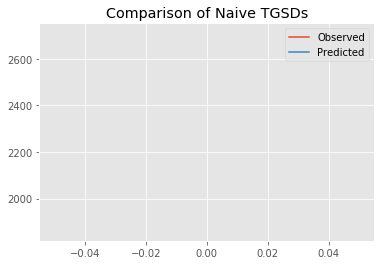

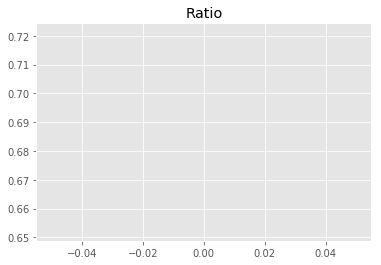

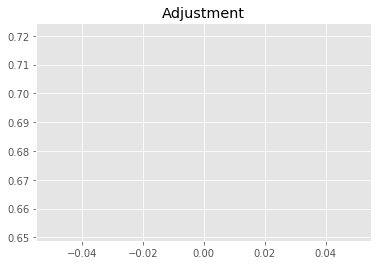

7700047192.850306
1


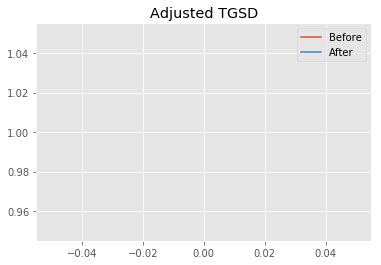

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.67763 	2.73816 	41377.7 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.1215e+10
After: 		|2.5318 	1.59092 	44892.9 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 801.707
New Misfit: 693.358
Convergence:
0.13514736228926663

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	2.71e+03 	1.86e+03 	0.6875 		1.0000


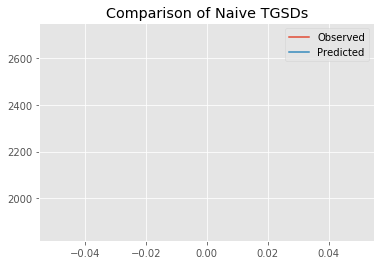

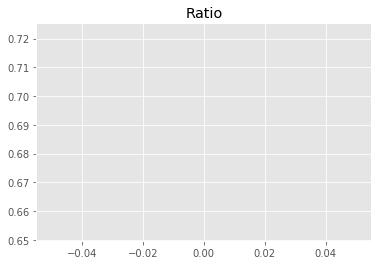

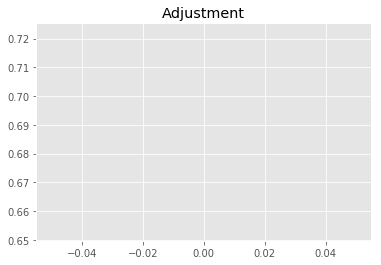

7710370363.235253
1


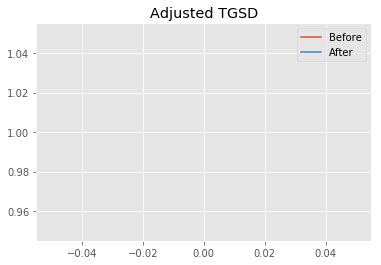

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.5318 	1.59092 	44892.9 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.1215e+10
After: 		|1.55205 	1.17863 	44344 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 693.358
New Misfit: 673.413
Convergence:
0.028766237598609117

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	2.62e+03 	1.86e+03 	0.7090 		1.0000


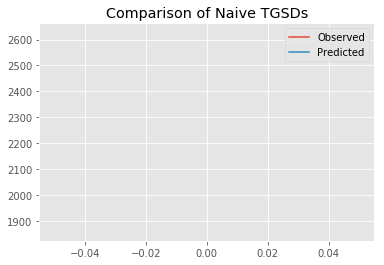

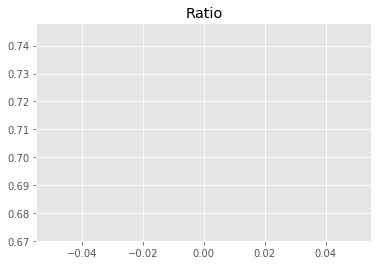

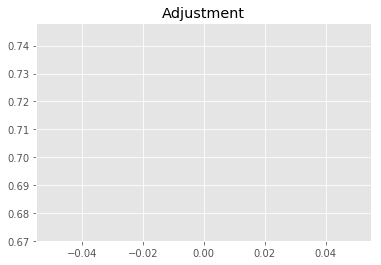

7951495213.77456
1


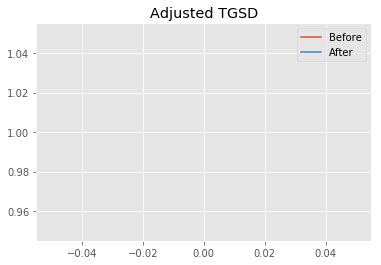

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.55205 	1.17863 	44344 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.1215e+10
After: 		|1.6058 	1.03061 	44706.2 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 673.413
New Misfit: 659.74
Convergence:
0.02030351400257828

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	2.63e+03 	1.86e+03 	0.7075 		1.0000


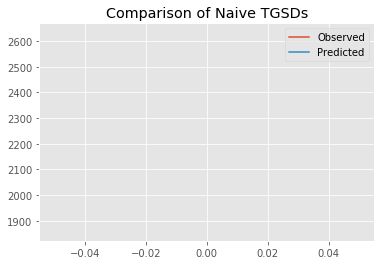

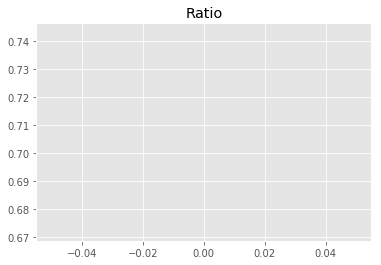

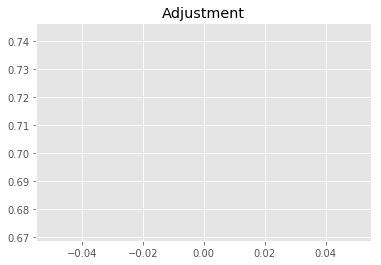

7934308061.975802
1


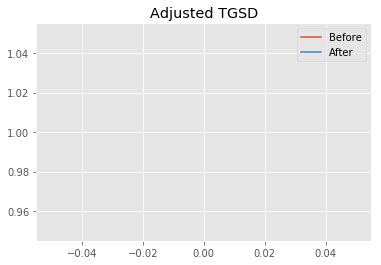

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.6058 	1.03061 	44706.2 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.1215e+10
After: 		|1.56358 	1.00004 	44423.6 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 659.74
New Misfit: 657.675
Convergence:
0.003131065870962884

____________________
a = 1.56358	b = 1.00004	            h1 = 44423.62043	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 11215047803.00476
Success: True
Status: Successful convergence.
Iterations: 4
Misfit: 657.6745069993143
Prior Misfit: 801.707,	 Post Misfit: 657.675


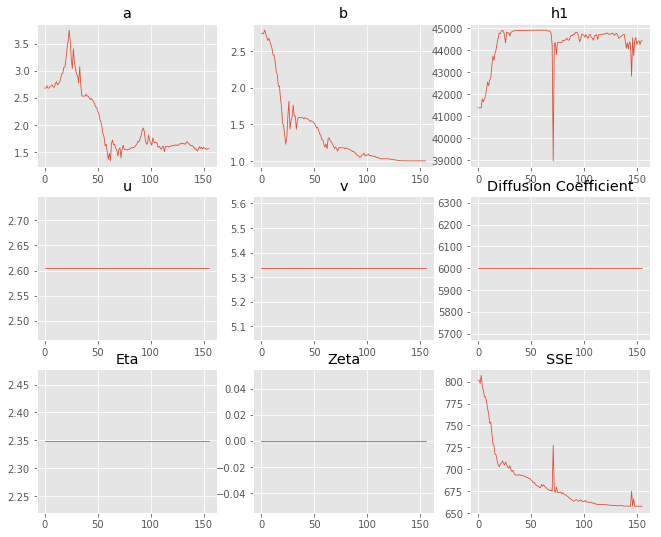

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,2.67763,1.56358
b,2.73816,1.00004
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"41,377.7","44,423.6"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 10 Time: 0.084 minutes


Estimated remaining run time: 0.616 minutes


Run 10===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	2.88e+03 	1.86e+03 	0.6461 		1.0000


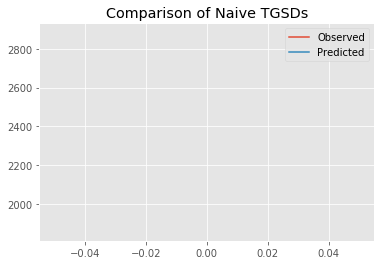

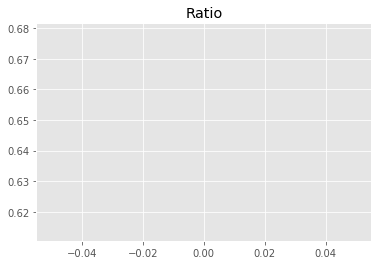

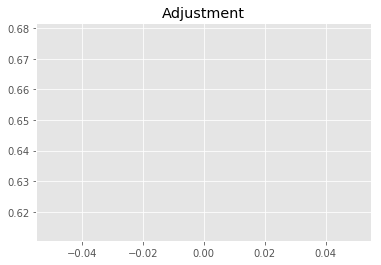

7245603779.800924
1


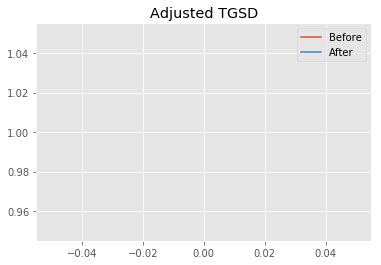

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|4.59951 	1.36844 	29141.2 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.1215e+10
After: 		|6.67226 	1.40687 	43627.1 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 841.466
New Misfit: 734.626
Convergence:
0.12696896786206752

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	2.62e+03 	1.86e+03 	0.7094 		1.0000


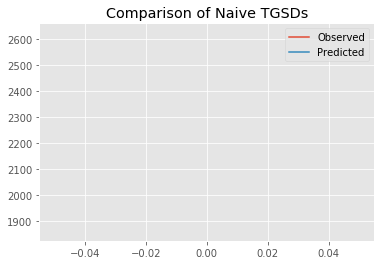

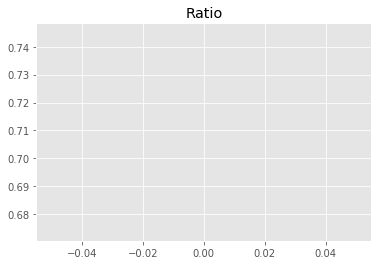

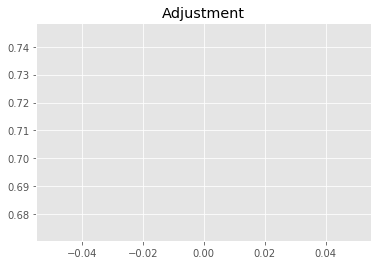

7955805253.982373
1


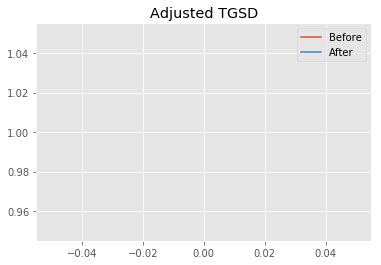

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|6.67226 	1.40687 	43627.1 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.1215e+10
After: 		|1.73242 	1.16044 	44737.2 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 734.626
New Misfit: 668.166
Convergence:
0.09046725913411868

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	2.65e+03 	1.86e+03 	0.7035 		1.0000


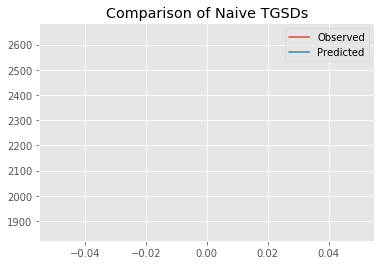

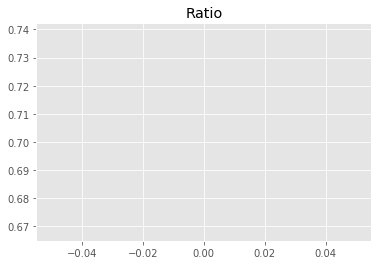

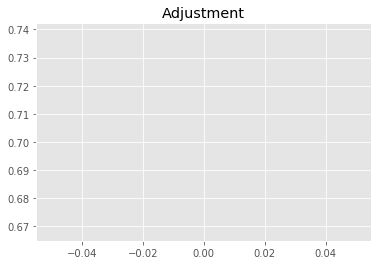

7889631721.352684
1


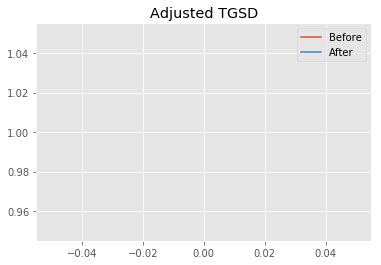

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.73242 	1.16044 	44737.2 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.1215e+10
After: 		|1.6279 	1.00973 	43979.4 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 668.166
New Misfit: 658.59
Convergence:
0.014332632179153395

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	2.63e+03 	1.86e+03 	0.7070 		1.0000


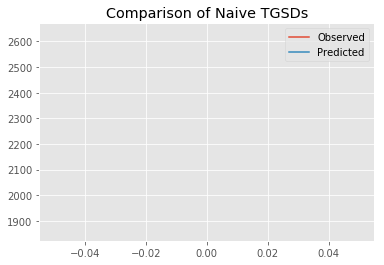

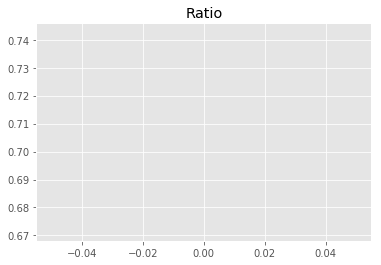

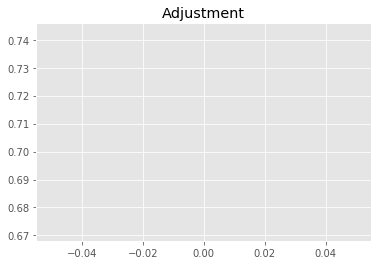

7928679114.014123
1


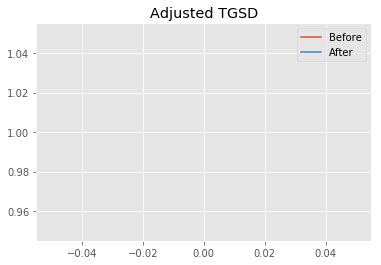

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.6279 	1.00973 	43979.4 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.1215e+10
After: 		|1.56778 	1 	44366.5 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 658.59
New Misfit: 657.671
Convergence:
0.001394539108492882

____________________
a = 1.56778	b = 1.00000	            h1 = 44366.50502	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 11215047803.00476
Success: True
Status: Successful convergence.
Iterations: 4
Misfit: 657.6714593762562
Prior Misfit: 841.466,	 Post Misfit: 657.671


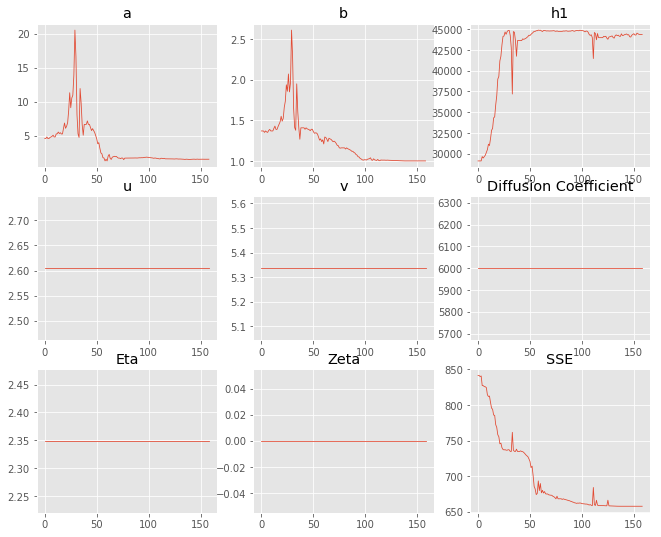

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,4.59951,1.56778
b,1.36844,1
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"29,141.2","44,366.5"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 11 Time: 0.085 minutes


Estimated remaining run time: 0.558 minutes


Run 11===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	2.53e+03 	1.86e+03 	0.7351 		1.0000


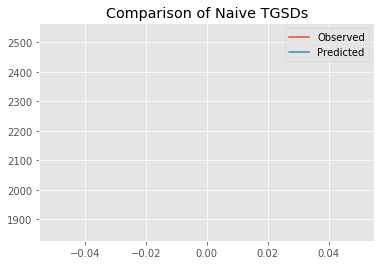

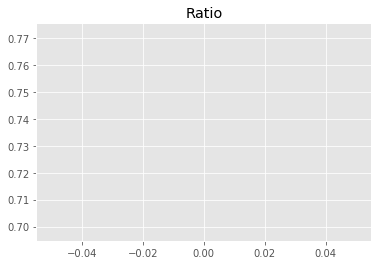

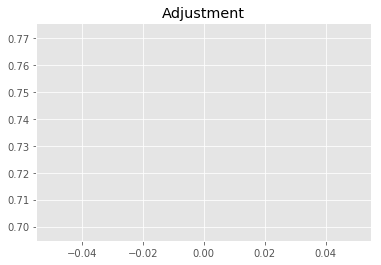

8244449794.296708
1


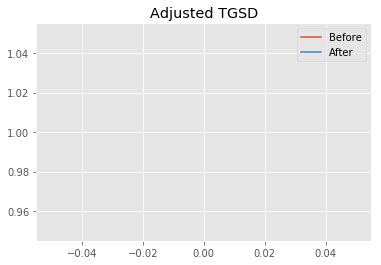

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.92667 	3.0541 	41450.3 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.1215e+10
After: 		|1.59173 	1 	44915 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 1025.69
New Misfit: 657.711
Convergence:
0.35875942616311196

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	2.63e+03 	1.86e+03 	0.7080 		1.0000


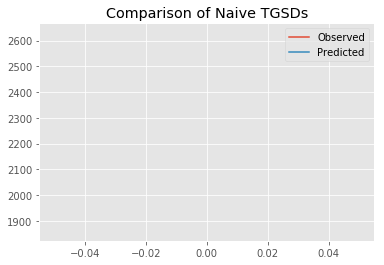

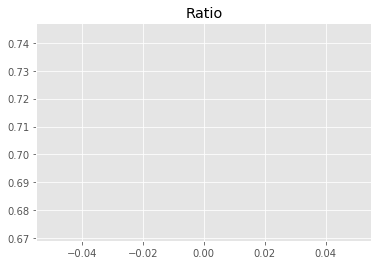

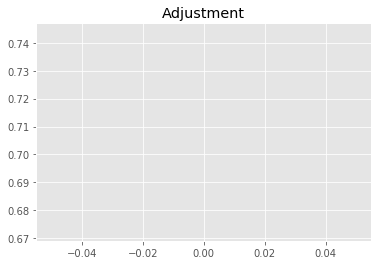

7940498053.846541
1


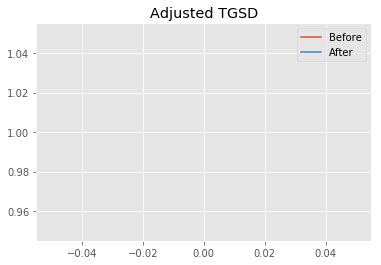

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.59173 	1 	44915 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.1215e+10
After: 		|1.56572 	1 	44915 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 657.711
New Misfit: 657.671
Convergence:
6.090464169932318e-05

____________________
a = 1.56572	b = 1.00000	            h1 = 44915.00000	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 11215047803.00476
Success: True
Status: Successful convergence.
Iterations: 2
Misfit: 657.6712231261752
Prior Misfit: 1025.69,	 Post Misfit: 657.671


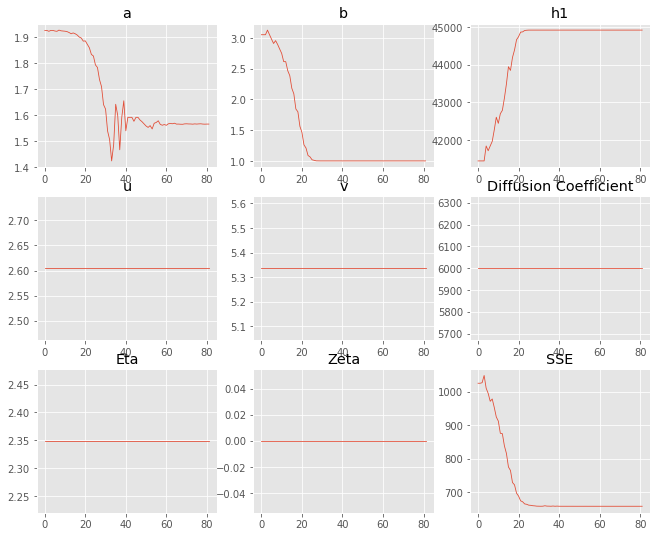

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,1.92667,1.56572
b,3.0541,1
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"41,450.3","44,915"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 12 Time: 0.048 minutes


Estimated remaining run time: 0.477 minutes


Run 12===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	2.71e+03 	1.86e+03 	0.6878 		1.0000


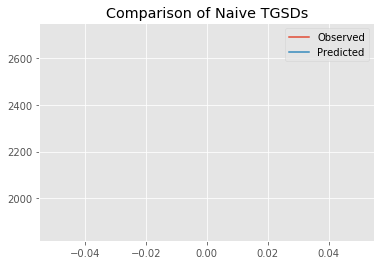

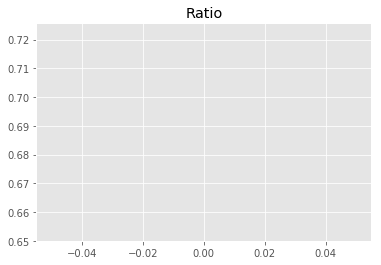

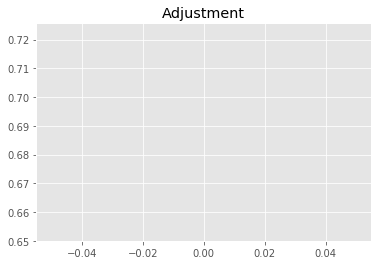

7714016113.806792
1


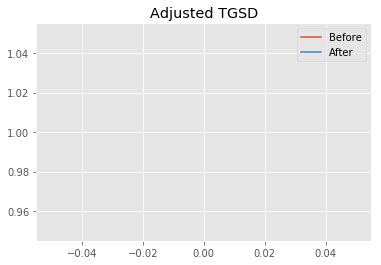

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.18733 	3.96441 	42886.5 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.1215e+10
After: 		|2.09636 	1.39026 	44891.2 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 855.789
New Misfit: 681.451
Convergence:
0.20371656841693428

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	2.68e+03 	1.86e+03 	0.6946 		1.0000


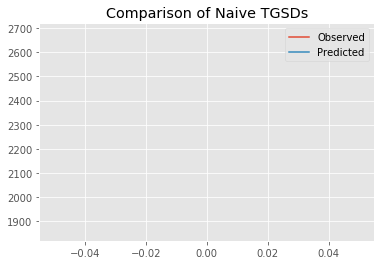

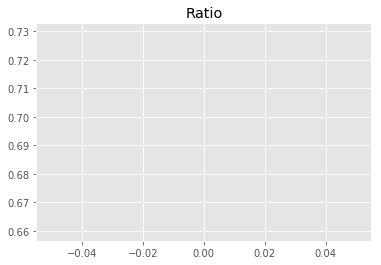

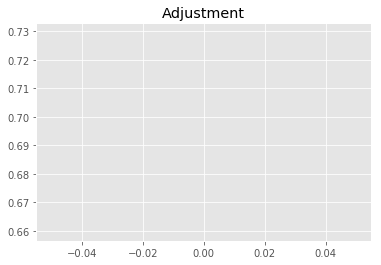

7790498423.565486
1


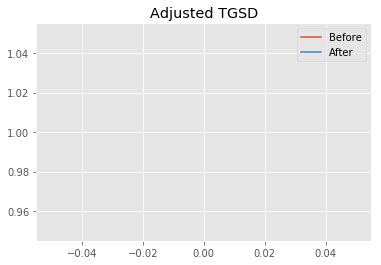

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.09636 	1.39026 	44891.2 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.1215e+10
After: 		|1.55061 	1.00001 	44915 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 681.451
New Misfit: 657.687
Convergence:
0.03487208406377998

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	2.62e+03 	1.86e+03 	0.7092 		1.0000


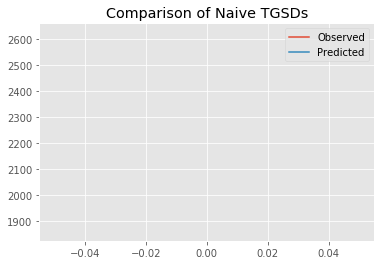

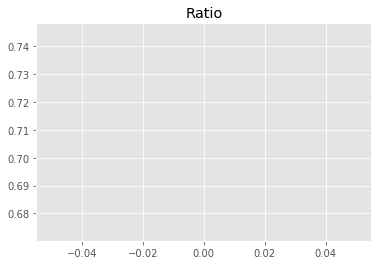

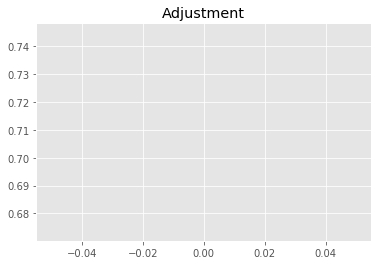

7953701861.422167
1


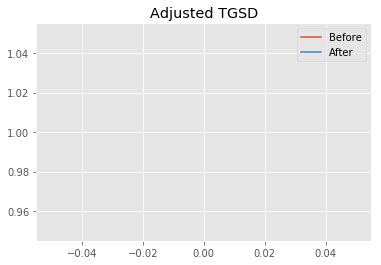

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.55061 	1.00001 	44915 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.1215e+10
After: 		|1.56564 	1 	44915 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 657.687
New Misfit: 657.671
Convergence:
2.4371962614792602e-05

____________________
a = 1.56564	b = 1.00000	            h1 = 44914.99494	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 11215047803.00476
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 657.6712951309769
Prior Misfit: 855.789,	 Post Misfit: 657.671


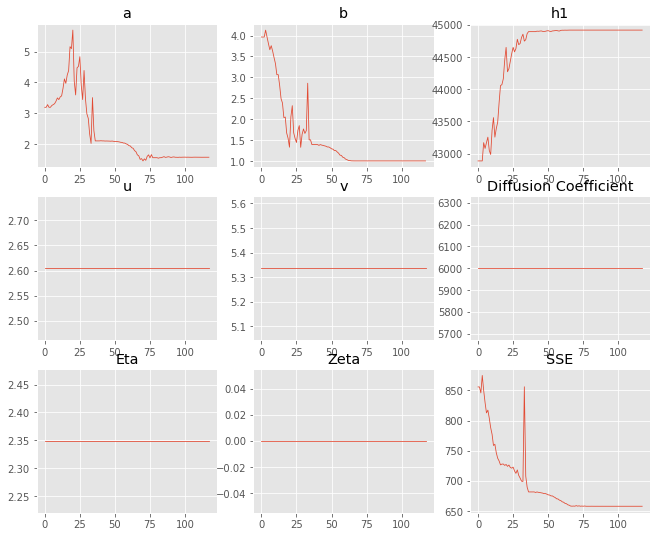

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,3.18733,1.56564
b,3.96441,1
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"42,886.5","44,915"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 13 Time: 0.067 minutes


Estimated remaining run time: 0.408 minutes


Run 13===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	2.75e+03 	1.86e+03 	0.6772 		1.0000


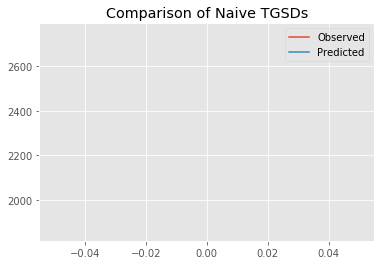

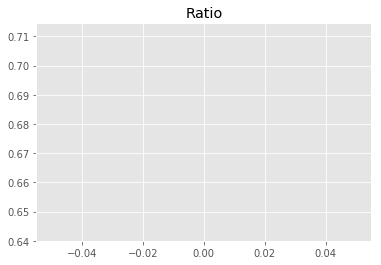

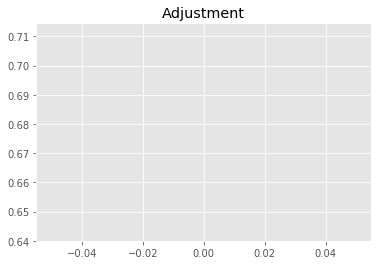

7595093314.030748
1


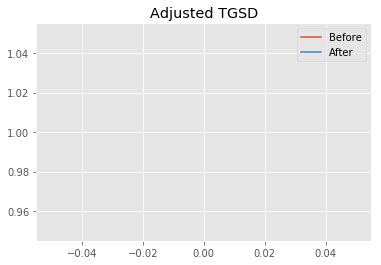

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.28589 	2.89984 	37483.1 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.1215e+10
After: 		|2.61398 	1.68818 	44714.1 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 839.068
New Misfit: 698.29
Convergence:
0.1677793368264117

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	2.71e+03 	1.86e+03 	0.6854 		1.0000


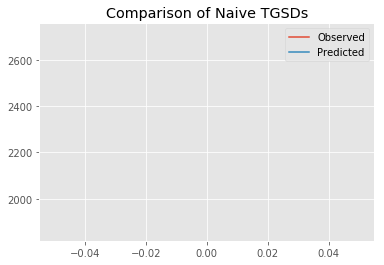

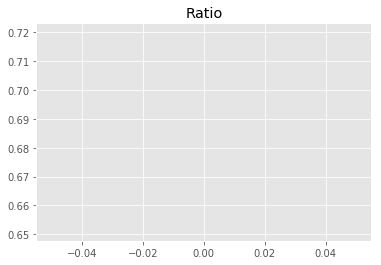

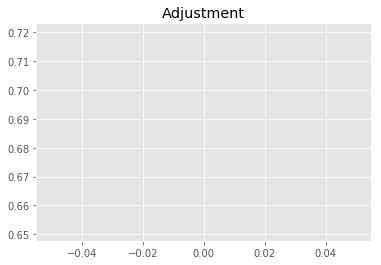

7687170465.395258
1


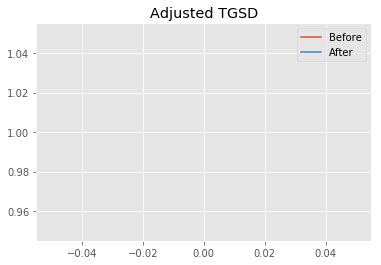

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.61398 	1.68818 	44714.1 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.1215e+10
After: 		|1.61303 	1.14952 	44871.5 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 698.29
New Misfit: 668.183
Convergence:
0.04311454271315854

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	2.63e+03 	1.86e+03 	0.7070 		1.0000


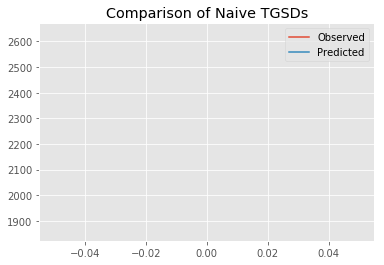

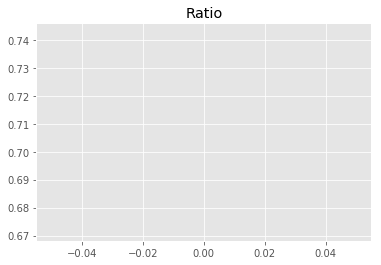

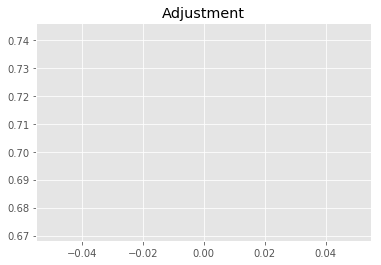

7929132350.452624
1


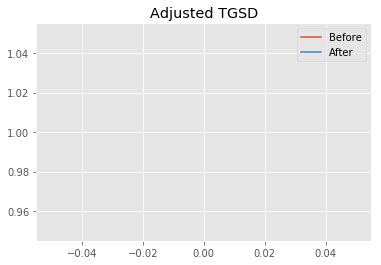

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.61303 	1.14952 	44871.5 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.1215e+10
After: 		|1.68891 	1.0156 	44820.6 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 668.183
New Misfit: 659.312
Convergence:
0.01327683206301593

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	2.64e+03 	1.86e+03 	0.7055 		1.0000


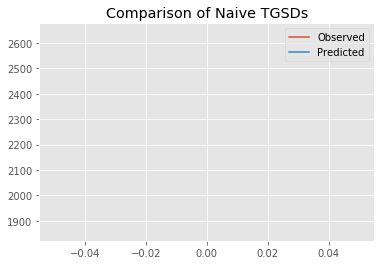

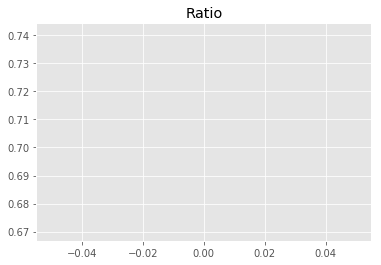

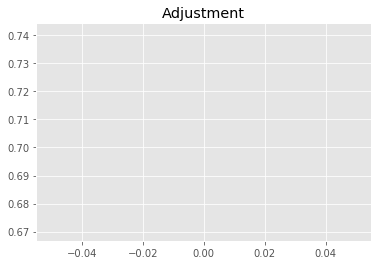

7912251559.73545
1


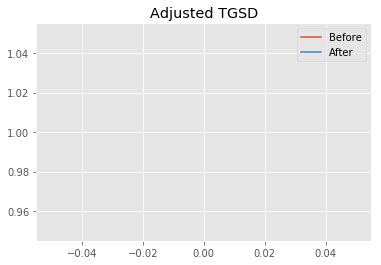

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.68891 	1.0156 	44820.6 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.1215e+10
After: 		|1.55897 	1.00012 	44532 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 659.312
New Misfit: 657.683
Convergence:
0.002471344575899609

____________________
a = 1.55897	b = 1.00012	            h1 = 44531.99411	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 11215047803.00476
Success: True
Status: Successful convergence.
Iterations: 4
Misfit: 657.6826700090025
Prior Misfit: 839.068,	 Post Misfit: 657.683


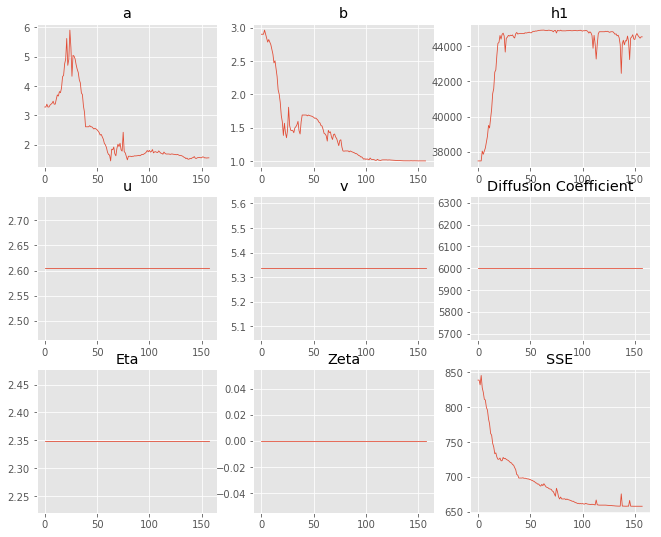

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,3.28589,1.55897
b,2.89984,1.00012
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"37,483.1","44,532"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 14 Time: 0.085 minutes


Estimated remaining run time: 0.346 minutes


Run 14===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	2.74e+03 	1.86e+03 	0.6785 		1.0000


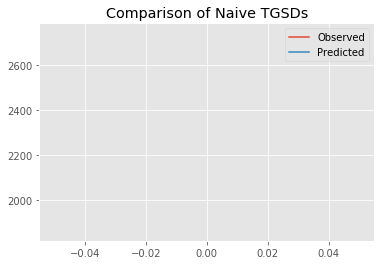

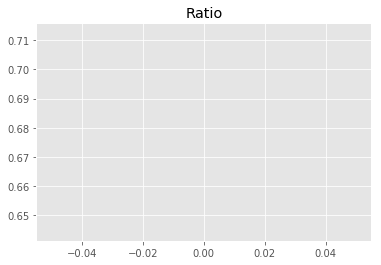

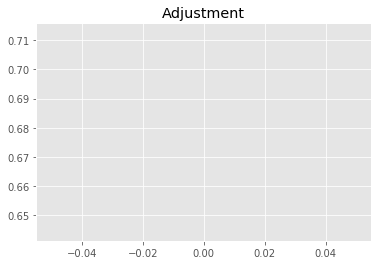

7609515349.49018
1


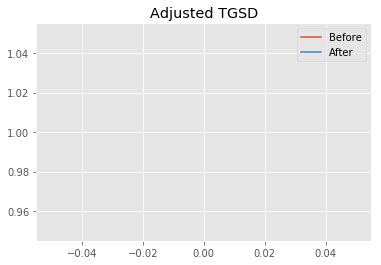

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.27081 	3.61016 	44629.4 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.1215e+10
After: 		|2.25491 	1.2595 	44914.9 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 788.881
New Misfit: 678.446
Convergence:
0.13998956496629553

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	2.68e+03 	1.86e+03 	0.6944 		1.0000


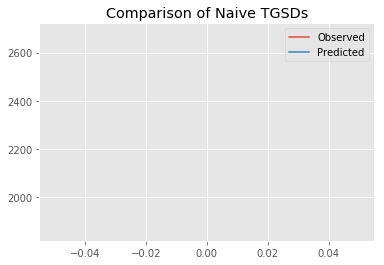

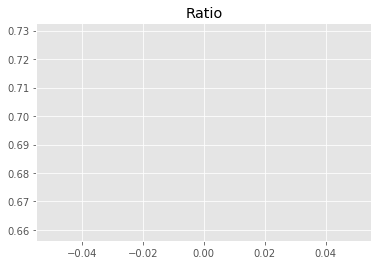

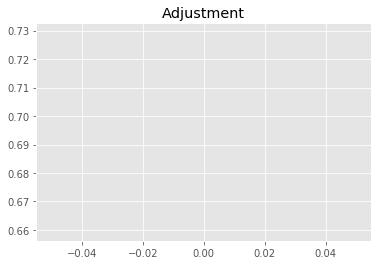

7787405872.66767
1


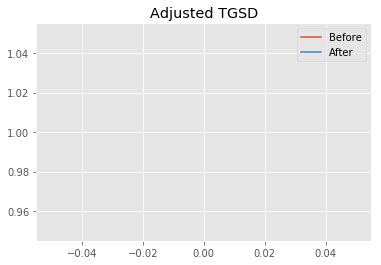

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.25491 	1.2595 	44914.9 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.1215e+10
After: 		|1.50887 	1.01169 	44915 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 678.446
New Misfit: 658.767
Convergence:
0.029005927855699557

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	2.62e+03 	1.86e+03 	0.7105 		1.0000


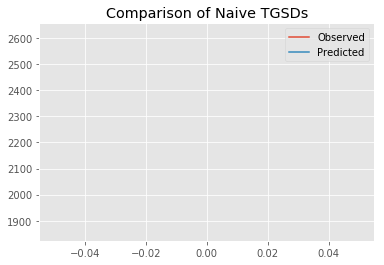

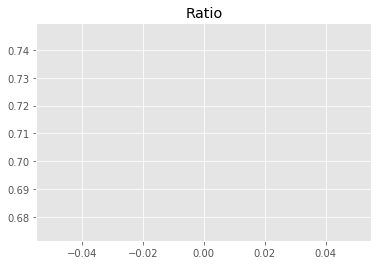

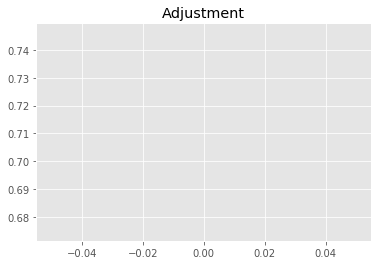

7968226018.396805
1


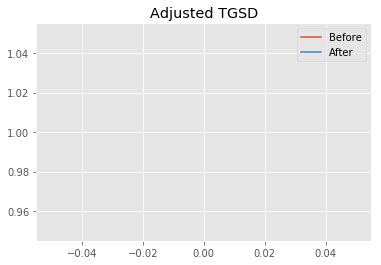

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.50887 	1.01169 	44915 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.1215e+10
After: 		|1.5791 	1.00014 	44132.8 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 658.767
New Misfit: 657.692
Convergence:
0.001632640208938608

____________________
a = 1.57910	b = 1.00014	            h1 = 44132.80572	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 11215047803.00476
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 657.6916750268122
Prior Misfit: 788.881,	 Post Misfit: 657.692


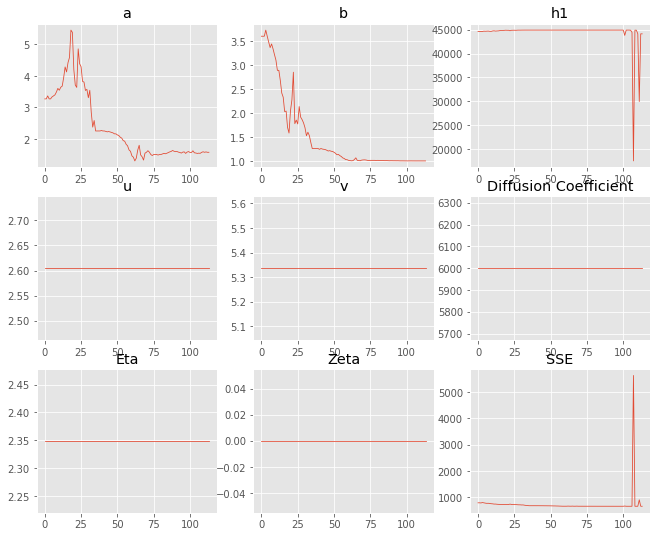

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,3.27081,1.5791
b,3.61016,1.00014
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"44,629.4","44,132.8"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 15 Time: 0.067 minutes


Estimated remaining run time: 0.276 minutes


Run 15===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	2.62e+03 	1.86e+03 	0.7101 		1.0000


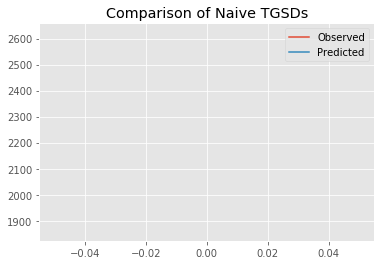

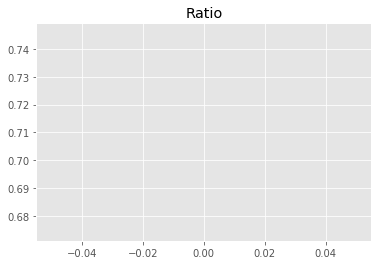

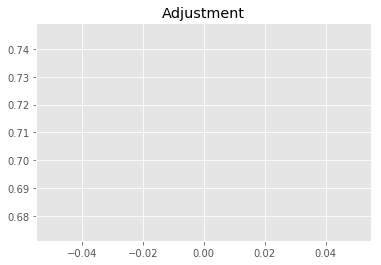

7964267597.936721
1


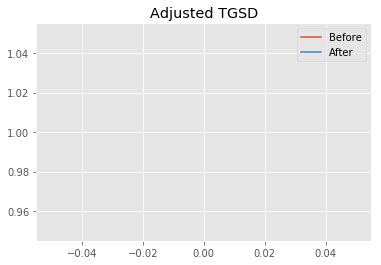

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.68252 	4.20787 	44231.6 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.1215e+10
After: 		|2.69628 	1.07031 	44914.9 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 947.9
New Misfit: 686.951
Convergence:
0.27529160844367284

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	2.66e+03 	1.86e+03 	0.6983 		1.0000


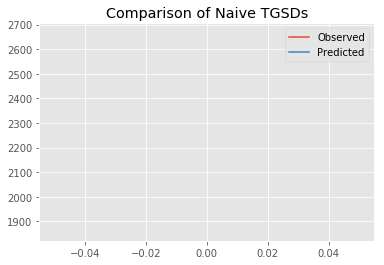

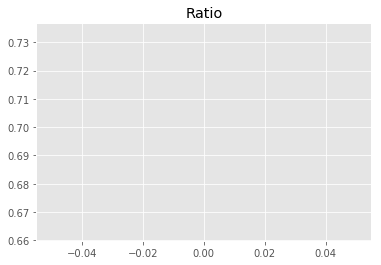

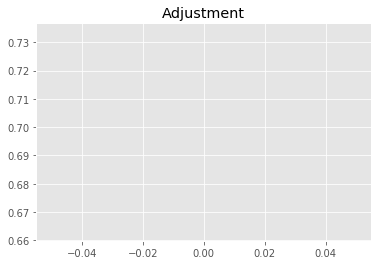

7831116252.079077
1


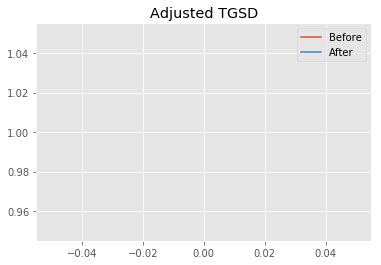

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.69628 	1.07031 	44914.9 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.1215e+10
After: 		|1.54937 	1.00237 	44915 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 686.951
New Misfit: 657.851
Convergence:
0.04236089489281202

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	2.62e+03 	1.86e+03 	0.7092 		1.0000


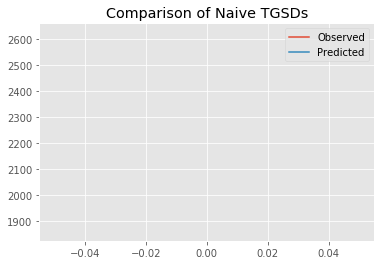

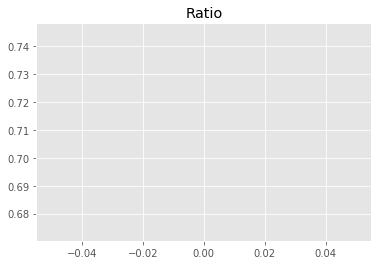

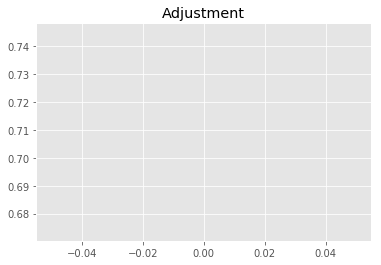

7954031215.974938
1


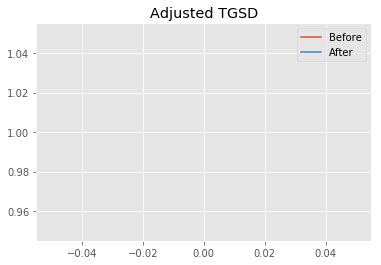

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.54937 	1.00237 	44915 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.1215e+10
After: 		|1.56444 	1 	44915 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 657.851
New Misfit: 657.671
Convergence:
0.0002728295522002925

____________________
a = 1.56444	b = 1.00000	            h1 = 44914.98809	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 11215047803.00476
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 657.6714474792534
Prior Misfit: 947.9,	 Post Misfit: 657.671


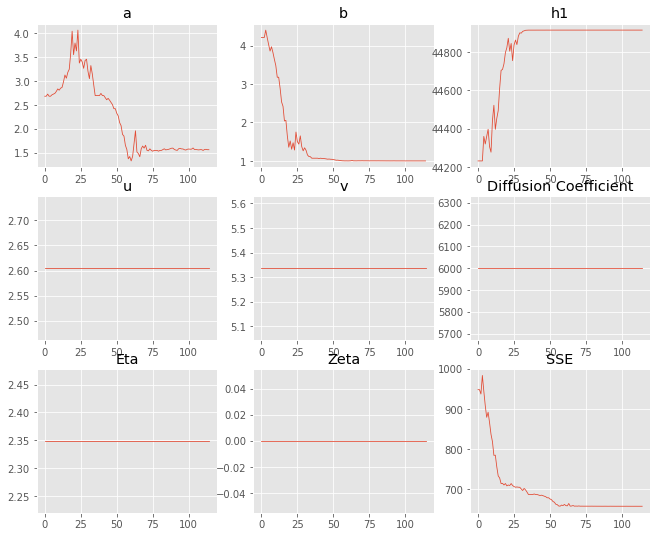

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,2.68252,1.56444
b,4.20787,1
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"44,231.6","44,915"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 16 Time: 0.066 minutes


Estimated remaining run time: 0.207 minutes


Run 16===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	2.81e+03 	1.86e+03 	0.6615 		1.0000


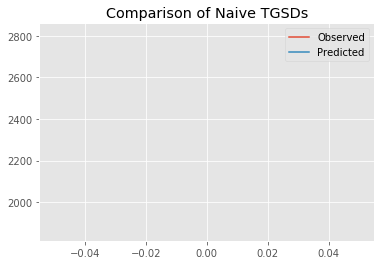

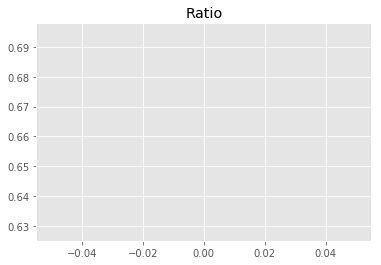

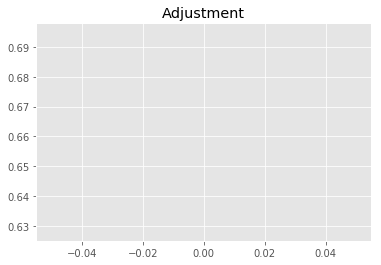

7418325176.804164
1


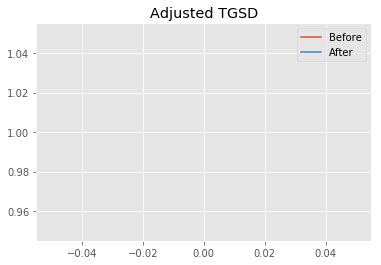

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|4.89446 	4.83675 	44492 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.1215e+10
After: 		|4.02946 	1.99867 	44908.6 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 790.756
New Misfit: 720.384
Convergence:
0.08899365787773734

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	2.73e+03 	1.86e+03 	0.6805 		1.0000


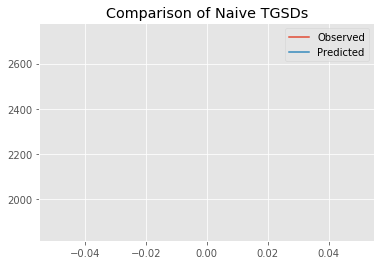

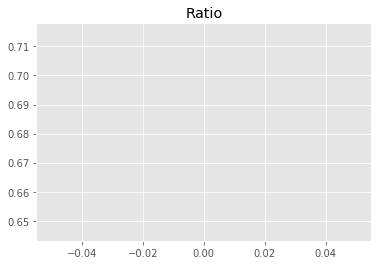

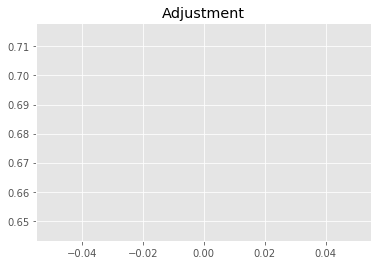

7632008735.762445
1


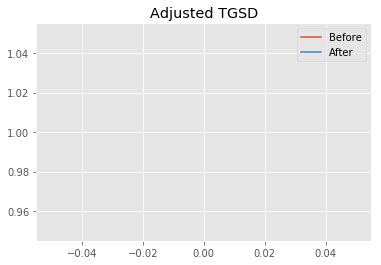

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|4.02946 	1.99867 	44908.6 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.1215e+10
After: 		|2.7883 	1.9985 	44914.5 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 720.384
New Misfit: 709.872
Convergence:
0.014591968161808532

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	2.73e+03 	1.86e+03 	0.6816 		1.0000


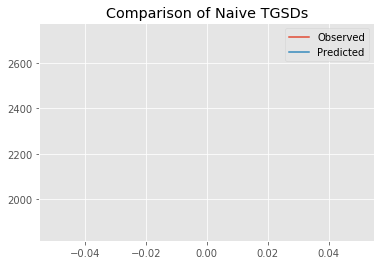

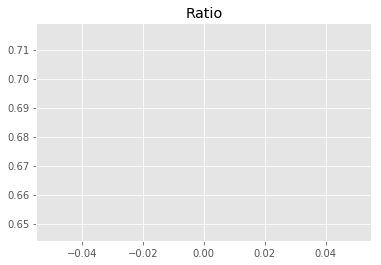

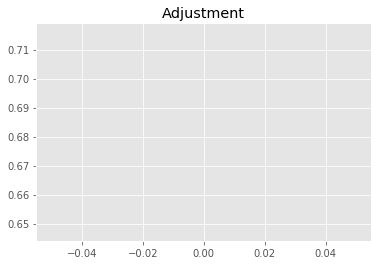

7643682386.625205
1


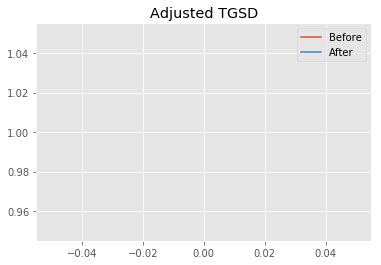

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.7883 	1.9985 	44914.5 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.1215e+10
After: 		|2.80328 	1.98458 	44915 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 709.872
New Misfit: 709.336
Convergence:
0.000755688042064246

____________________
a = 2.80328	b = 1.98458	            h1 = 44915.00000	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 11215047803.00476
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 709.3355525514995
Prior Misfit: 790.756,	 Post Misfit: 709.336


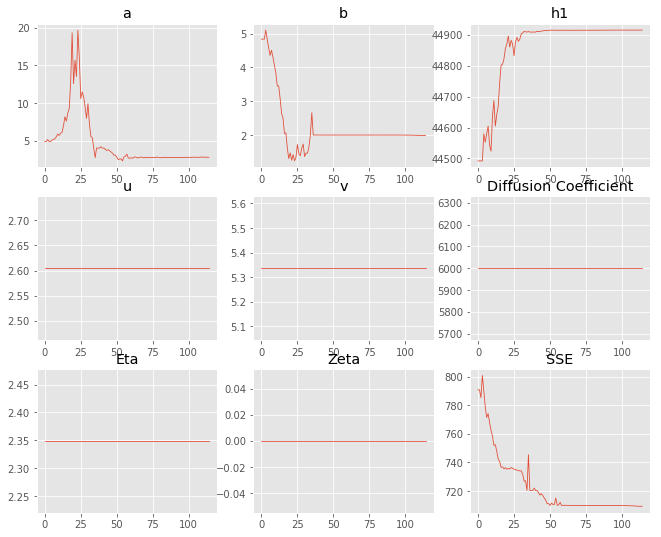

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,4.89446,2.80328
b,4.83675,1.98458
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"44,492","44,915"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 17 Time: 0.065 minutes


Estimated remaining run time: 0.137 minutes


Run 17===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	2.79e+03 	1.86e+03 	0.6679 		1.0000


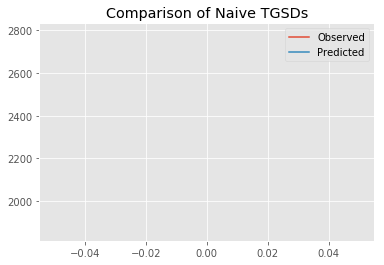

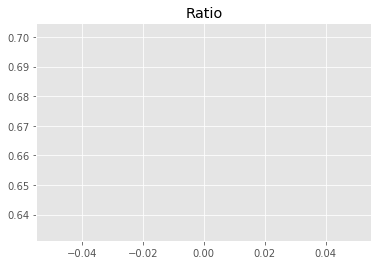

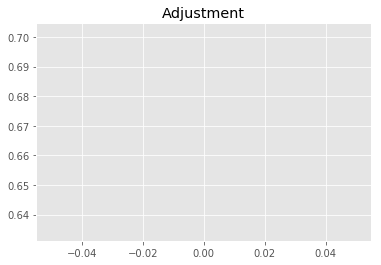

7490043877.853631
1


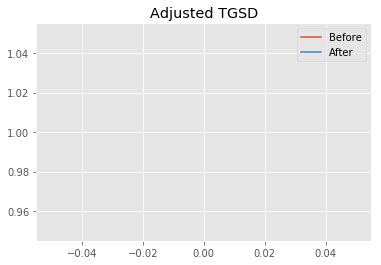

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|4.23569 	4.34025 	42837.1 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.1215e+10
After: 		|3.85402 	1.96979 	44727.1 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 808.083
New Misfit: 718.829
Convergence:
0.11045070545568796

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	2.74e+03 	1.86e+03 	0.6798 		1.0000


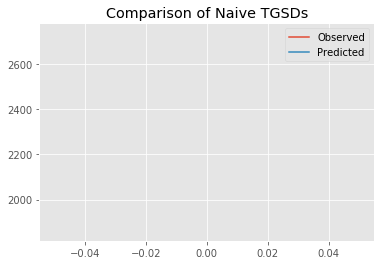

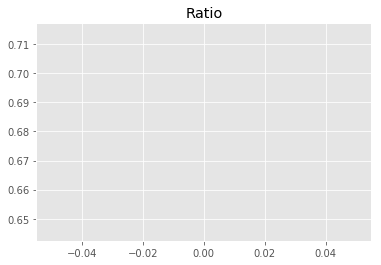

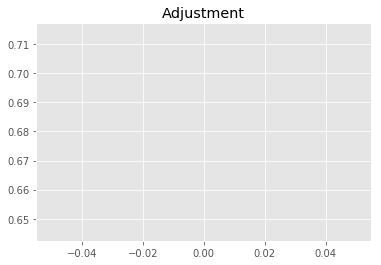

7623844374.39305
1


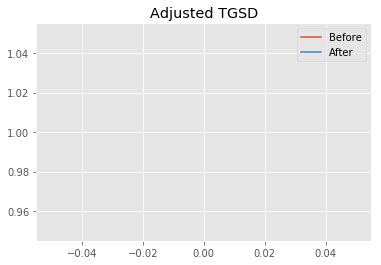

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.85402 	1.96979 	44727.1 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.1215e+10
After: 		|2.6933 	1.96433 	44881.5 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 718.829
New Misfit: 708.712
Convergence:
0.014075266803800595

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	2.73e+03 	1.86e+03 	0.6827 		1.0000


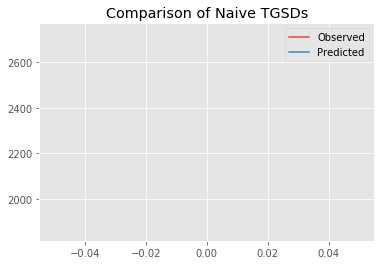

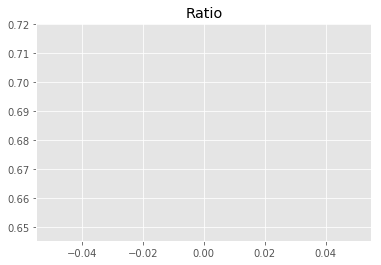

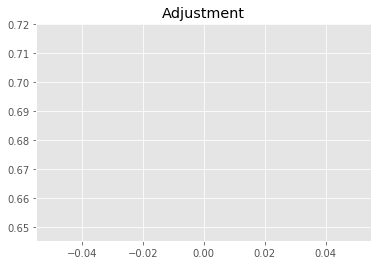

7656652301.356738
1


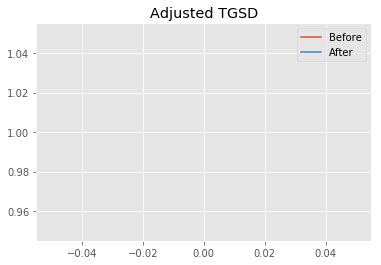

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.6933 	1.96433 	44881.5 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.1215e+10
After: 		|1.99417 	1.5856 	44915 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 708.712
New Misfit: 694.058
Convergence:
0.020677256754363535

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	2.67e+03 	1.86e+03 	0.6962 		1.0000


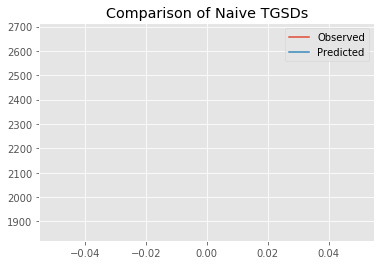

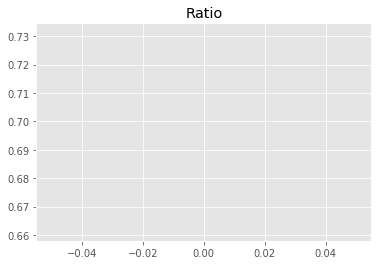

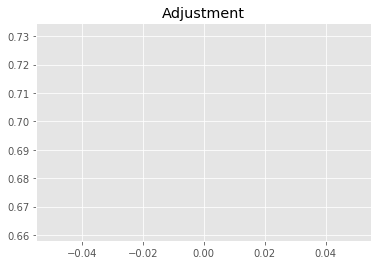

7808178228.530074
1


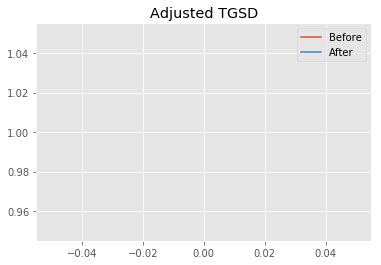

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.99417 	1.5856 	44915 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.1215e+10
After: 		|2.02186 	1.00536 	44915 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 694.058
New Misfit: 666.158
Convergence:
0.04019759775660099

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	2.66e+03 	1.86e+03 	0.7008 		1.0000


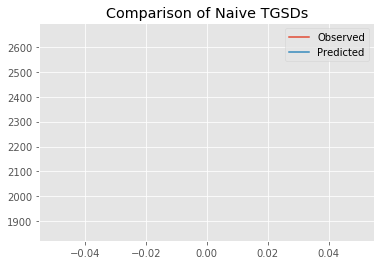

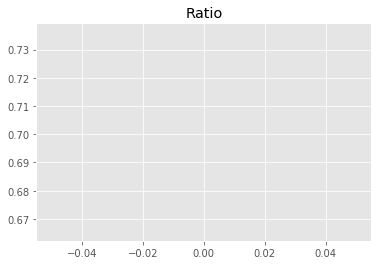

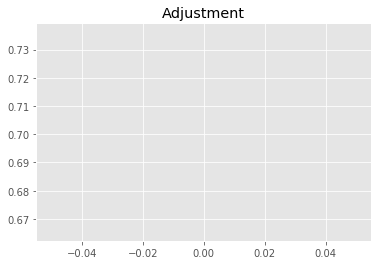

7859176024.727194
1


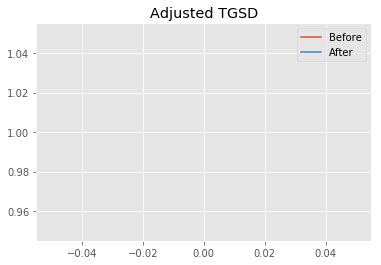

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.02186 	1.00536 	44915 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.1215e+10
After: 		|2.02186 	1.00412 	44915 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 666.158
New Misfit: 666.13
Convergence:
4.1593442310041945e-05

____________________
a = 2.02186	b = 1.00412	            h1 = 44915.00000	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 11215047803.00476
Success: True
Status: Successful convergence.
Iterations: 5
Misfit: 666.1303789858142
Prior Misfit: 808.083,	 Post Misfit: 666.13


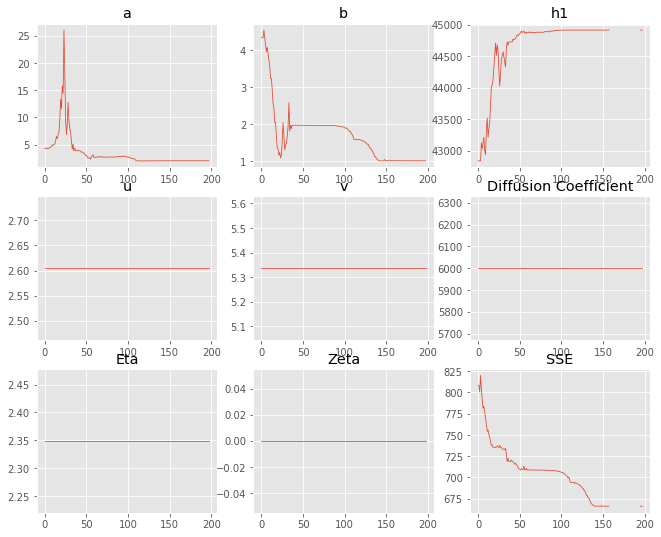

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,4.23569,2.02186
b,4.34025,1.00412
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"42,837.1","44,915"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 18 Time: 0.104 minutes


Estimated remaining run time: 0.071 minutes


Run 18===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	2.53e+03 	1.86e+03 	0.7349 		1.0000


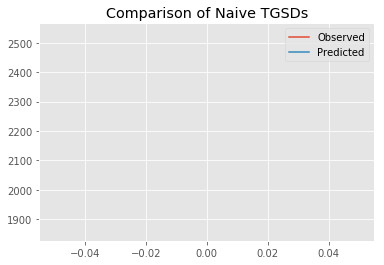

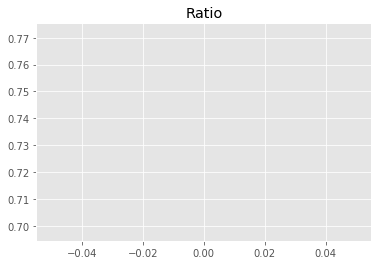

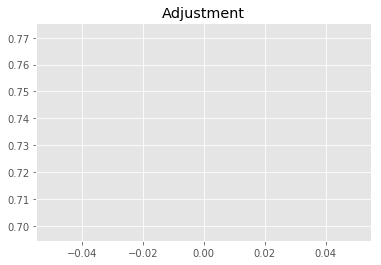

8241983905.589309
1


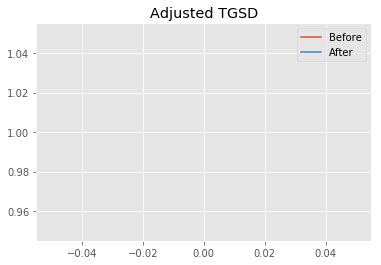

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.6432 	2.02737 	36134.7 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.1215e+10
After: 		|2.89627 	1.98127 	44883.8 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 1007.93
New Misfit: 709.625
Convergence:
0.29595952884043486

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	2.73e+03 	1.86e+03 	0.6807 		1.0000


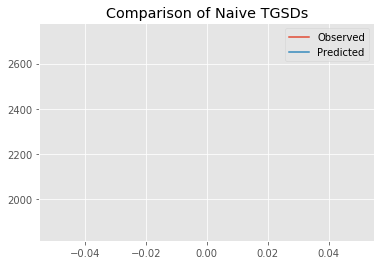

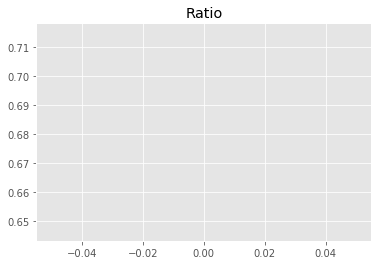

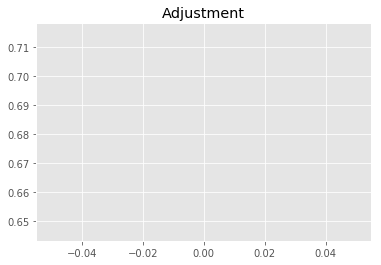

7634258451.068445
1


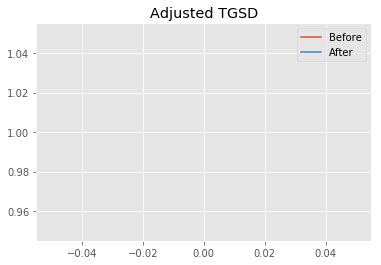

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.89627 	1.98127 	44883.8 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.1215e+10
After: 		|2.6774 	1.96688 	44914.9 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 709.625
New Misfit: 708.67
Convergence:
0.001345089847396102

____________________
a = 2.67740	b = 1.96688	            h1 = 44914.86532	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 11215047803.00476
Success: True
Status: Successful convergence.
Iterations: 2
Misfit: 708.6703777387804
Prior Misfit: 1007.93,	 Post Misfit: 708.67


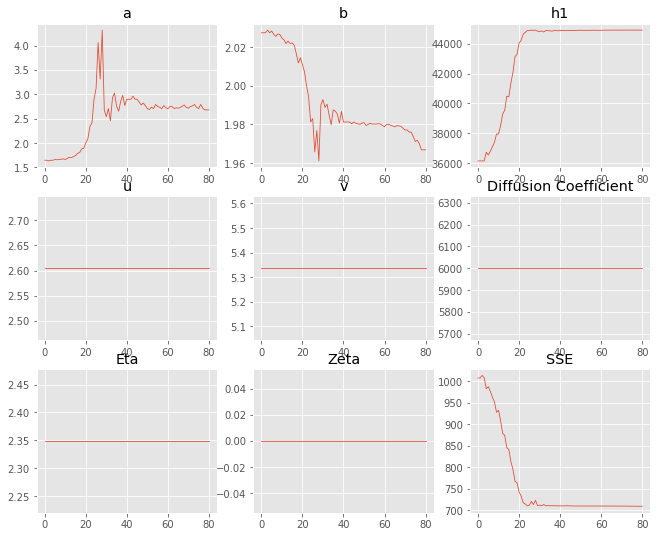

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,1.6432,2.6774
b,2.02737,1.96688
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"36,134.7","44,914.9"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 19 Time: 0.048 minutes


Estimated remaining run time: 0.000 minutes


Run 19===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	2.83e+03 	1.86e+03 	0.6581 		1.0000


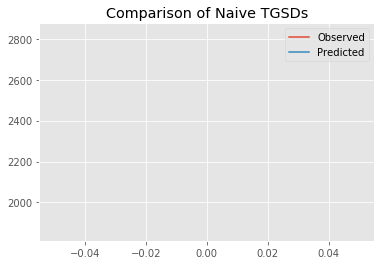

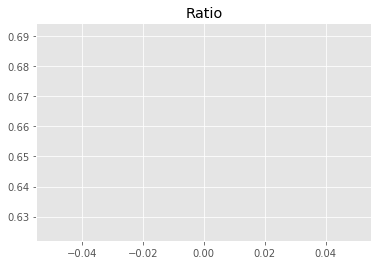

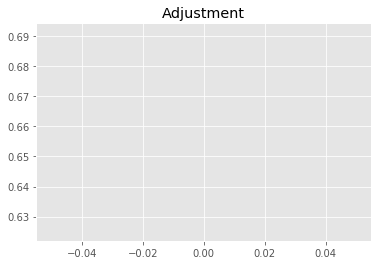

7380918419.734247
1


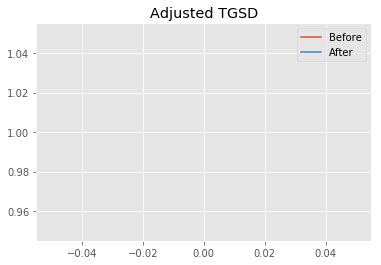

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|4.39397 	2.90912 	37394.3 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.1215e+10
After: 		|4.46206 	1.71114 	44212.1 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 797.533
New Misfit: 723.101
Convergence:
0.09332782814741943

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	2.70e+03 	1.86e+03 	0.6879 		1.0000


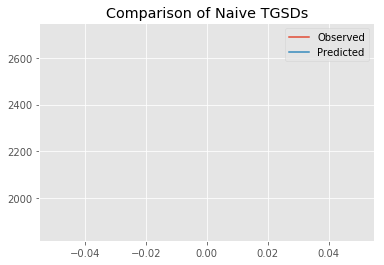

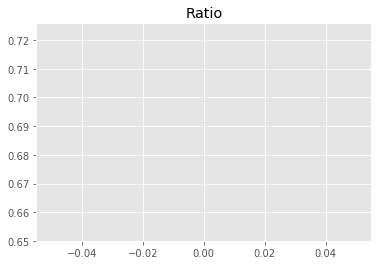

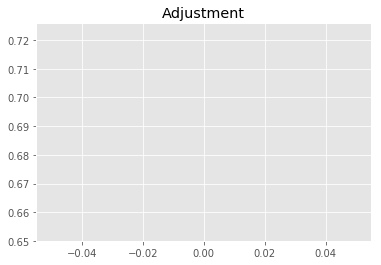

7715275417.978947
1


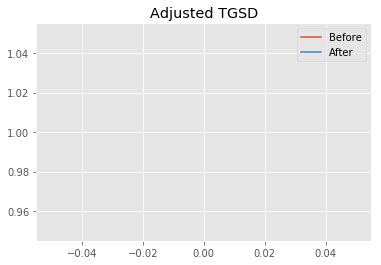

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|4.46206 	1.71114 	44212.1 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.1215e+10
After: 		|2.18765 	1.5586 	44503 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 723.101
New Misfit: 692.003
Convergence:
0.043005988386682695

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	2.69e+03 	1.86e+03 	0.6916 		1.0000


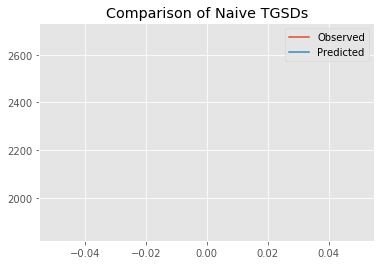

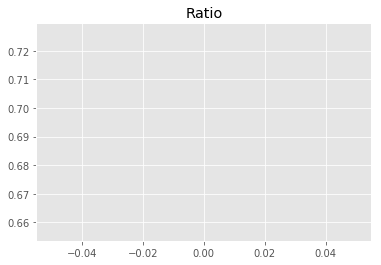

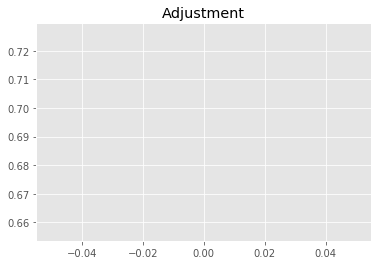

7756052624.136133
1


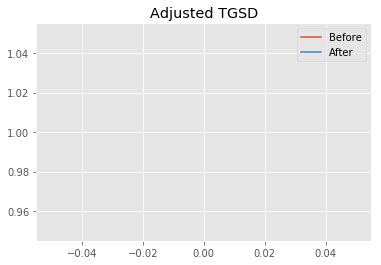

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.18765 	1.5586 	44503 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.1215e+10
After: 		|1.54462 	1 	44915 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 692.003
New Misfit: 657.701
Convergence:
0.04956963558191899

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.12e+10 	2.62e+03 	1.86e+03 	0.7094 		1.0000


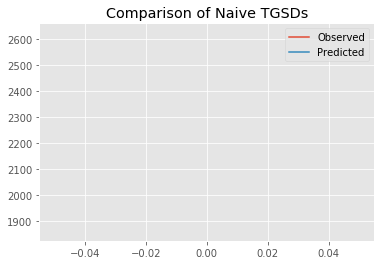

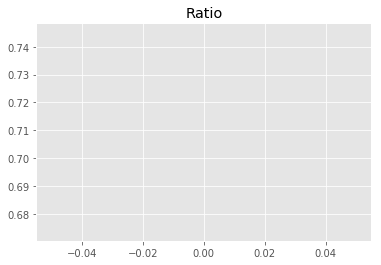

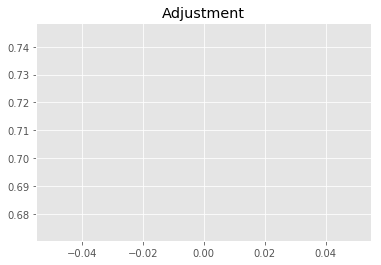

7955725986.885445
1


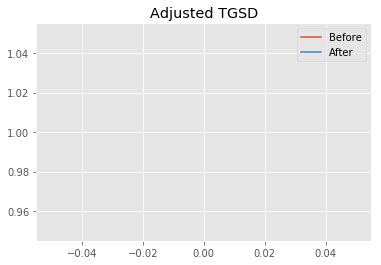

Old Total Mass: 1.1215e+10
New Total Mass: 1.1215e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.54462 	1 	44915 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.1215e+10
After: 		|1.54462 	1 	44915 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 657.701
New Misfit: 657.701
Convergence:
6.479734625957078e-08

____________________
a = 1.54462	b = 1.00000	            h1 = 44915.00000	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 11215047803.00476
Success: True
Status: Successful convergence.
Iterations: 4
Misfit: 657.70076396746
Prior Misfit: 797.533,	 Post Misfit: 657.701


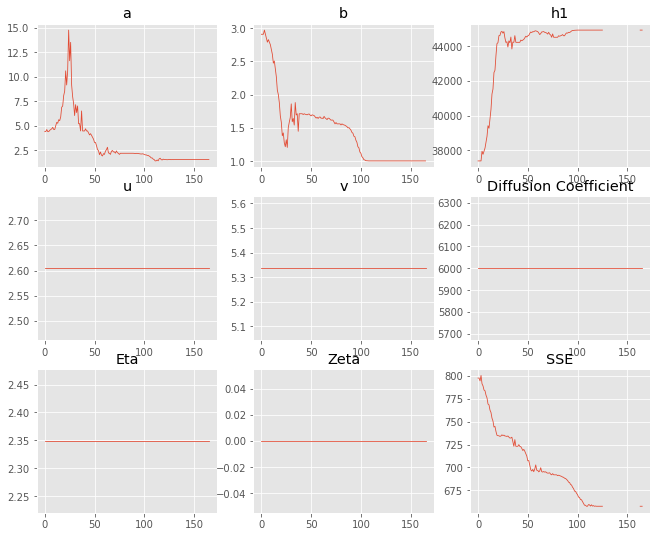

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,4.39397,1.54462
b,2.90912,1
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"37,394.3","44,915"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 20 Time: 0.086 minutes


Estimated remaining run time: -0.070 minutes


Total Run Time: 1.47474 minutes


[{'a': 1.5660467070904074,
  'b': 1.000002170750187,
  'h1': 44255.82665487718,
  'u': 2.60482,
  'v': 5.33615,
  'D': 5999.899999999996,
  'ftt': 6457.999999999996,
  'eta': 2.34894,
  'zeta': 0.0},
 {'a': 1.561026320205904,
  'b': 1.0000110504615574,
  'h1': 44463.91407116385,
  'u': 2.60482,
  'v': 5.33615,
  'D': 5999.899999999996,
  'ftt': 6457.999999999996,
  'eta': 2.34894,
  'zeta': 0.0},
 {'a': 1.5730656252970077,
  'b': 1.0015722380216405,
  'h1': 44280.37639681502,
  'u': 2.60482,
  'v': 5.33615,
  'D': 5999.899999999996,
  'ftt': 6457.999999999996,
  'eta': 2.34894,
  'zeta': 0.0},
 {'a': 1.930066553780717,
  'b': 1.0020958566239038,
  'h1': 43954.36384413679,
  'u': 2.60482,
  'v': 5.33615,
  'D': 5999.899999999996,
  'ftt': 6457.999999999996,
  'eta': 2.34894,
  'zeta': 0.0},
 {'a': 1.684049330338215,
  'b': 1.0104302029478398,
  'h1': 43932.367276940946,
  'u': 2.60482,
  'v': 5.33615,
  'D': 5999.899999999996,
  'ftt': 6457.999999999996,
  'eta': 2.34894,
  'zeta': 0.0}

,a,b,h1,u,v,D,ftt,eta,zeta,M,Misfit
8,1.56636,1,"44,803.1",2.60482,5.33615,"5,999.9","6,458",2.34894,0,1.1215e+10,657.671
11,1.56572,1,"44,915",2.60482,5.33615,"5,999.9","6,458",2.34894,0,1.1215e+10,657.671
12,1.56564,1,"44,915",2.60482,5.33615,"5,999.9","6,458",2.34894,0,1.1215e+10,657.671
0,1.56605,1,"44,255.8",2.60482,5.33615,"5,999.9","6,458",2.34894,0,1.1215e+10,657.671
15,1.56444,1,"44,915",2.60482,5.33615,"5,999.9","6,458",2.34894,0,1.1215e+10,657.671
10,1.56778,1,"44,366.5",2.60482,5.33615,"5,999.9","6,458",2.34894,0,1.1215e+10,657.671
5,1.56898,1.00001,"44,915",2.60482,5.33615,"5,999.9","6,458",2.34894,0,1.1215e+10,657.672
1,1.56103,1.00001,"44,463.9",2.60482,5.33615,"5,999.9","6,458",2.34894,0,1.1215e+10,657.674
7,1.56305,1.00003,"44,019",2.60482,5.33615,"5,999.9","6,458",2.34894,0,1.1215e+10,657.674
9,1.56358,1.00004,"44,423.6",2.60482,5.33615,"5,999.9","6,458",2.34894,0,1.1215e+10,657.675


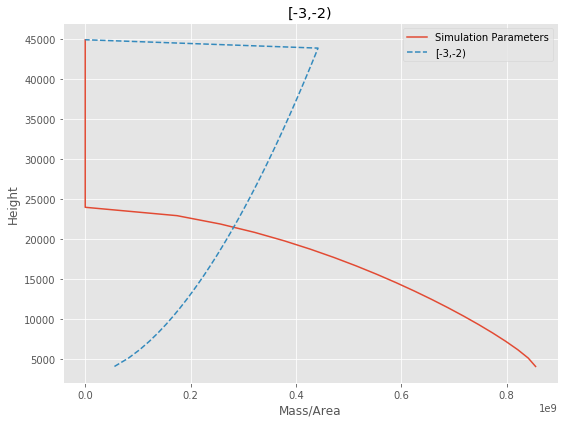

[-3,-2) Run Time: 1.47708 minutes


Mass Test: 23412237340.63284
========[-2,-1)========
Run 0===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.14e+10 	2.89e+03 	1.90e+03 	0.6570 		1.0000


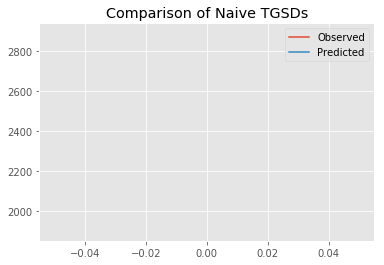

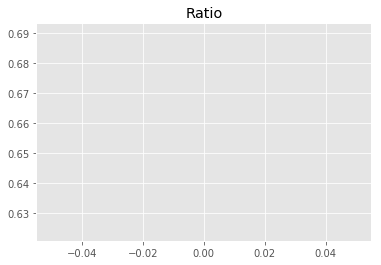

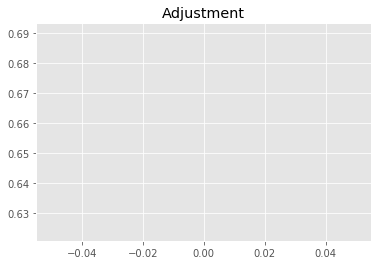

7519922943.555634
1


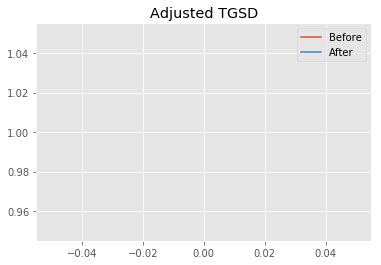

Old Total Mass: 1.14451e+10
New Total Mass: 1.14451e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.61056 	2.21787 	41686.4 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.14451e+10
After: 		|10.6352 	1.62451 	44907.8 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 649.511
New Misfit: 561.1
Convergence:
0.13611886332118292

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.14e+10 	2.33e+03 	1.90e+03 	0.8153 		1.0000


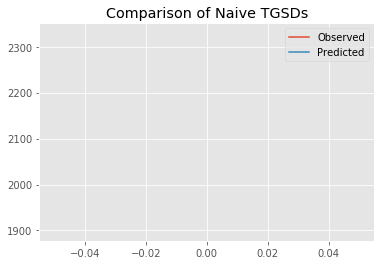

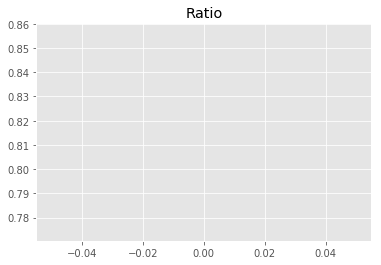

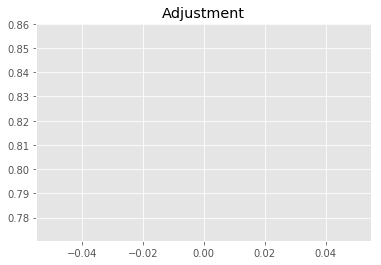

9331123874.889822
1


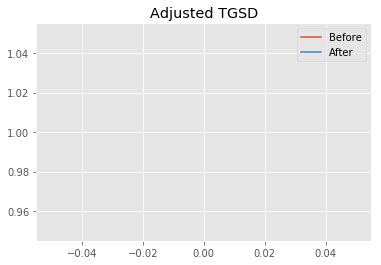

Old Total Mass: 1.14451e+10
New Total Mass: 1.14451e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|10.6352 	1.62451 	44907.8 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.14451e+10
After: 		|6.64723 	1.20286 	44661.8 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 561.1
New Misfit: 559.507
Convergence:
0.0028394396853681043

____________________
a = 6.64723	b = 1.20286	            h1 = 44661.81580	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 11445119407.50561
Success: True
Status: Successful convergence.
Iterations: 2
Misfit: 559.5068324706713
Prior Misfit: 649.511,	 Post Misfit: 559.507


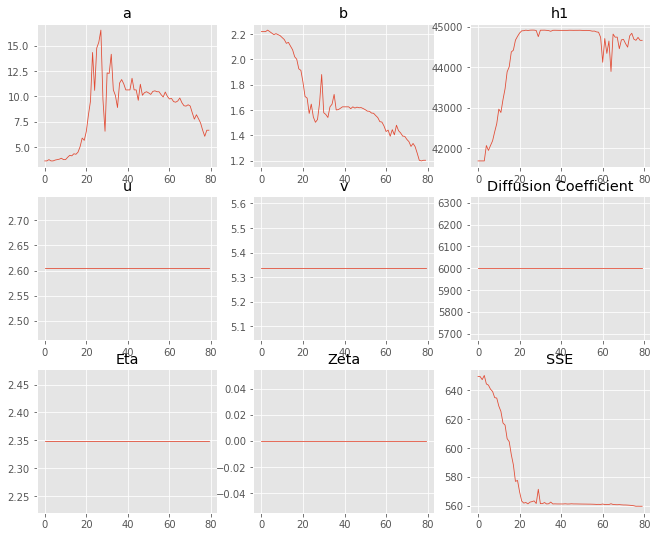

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,3.61056,6.64723
b,2.21787,1.20286
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"41,686.4","44,661.8"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 1 Time: 0.049 minutes


Estimated remaining run time: 0.443 minutes


Run 1===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.14e+10 	2.79e+03 	1.90e+03 	0.6809 		1.0000


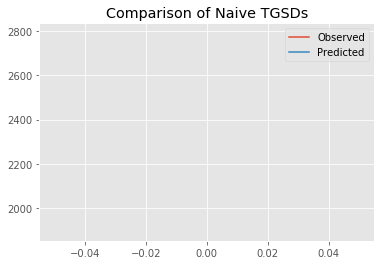

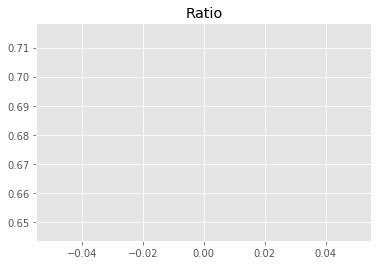

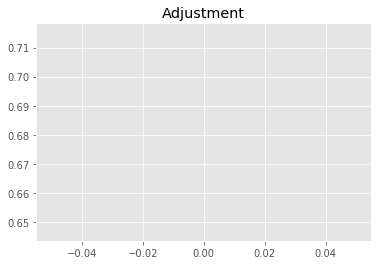

7793067373.091742
1


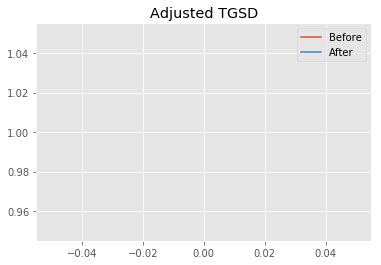

Old Total Mass: 1.14451e+10
New Total Mass: 1.14451e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.75953 	1.53247 	40661.5 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.14451e+10
After: 		|9.81745 	1.52435 	44855 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 618.201
New Misfit: 560.855
Convergence:
0.09276294358596353

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.14e+10 	2.34e+03 	1.90e+03 	0.8127 		1.0000


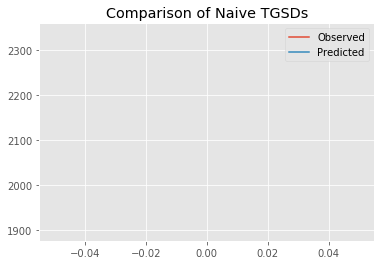

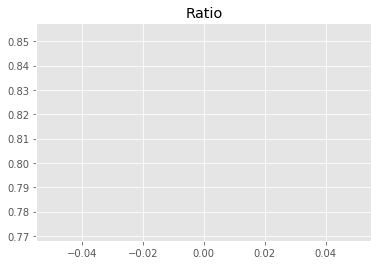

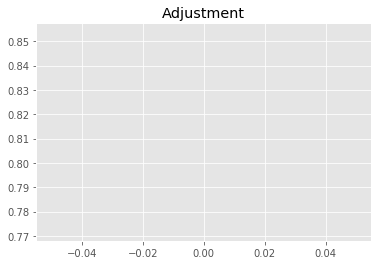

9300901839.508604
1


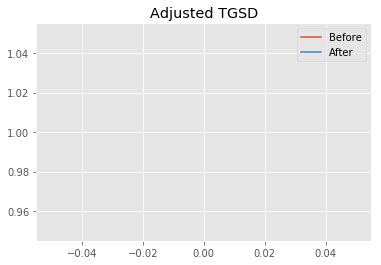

Old Total Mass: 1.14451e+10
New Total Mass: 1.14451e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|9.81745 	1.52435 	44855 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.14451e+10
After: 		|5.23725 	1.09434 	44645.2 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 560.855
New Misfit: 558.296
Convergence:
0.004562514182894178

____________________
a = 5.23725	b = 1.09434	            h1 = 44645.17299	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 11445119407.50561
Success: True
Status: Successful convergence.
Iterations: 2
Misfit: 558.296285633208
Prior Misfit: 618.201,	 Post Misfit: 558.296


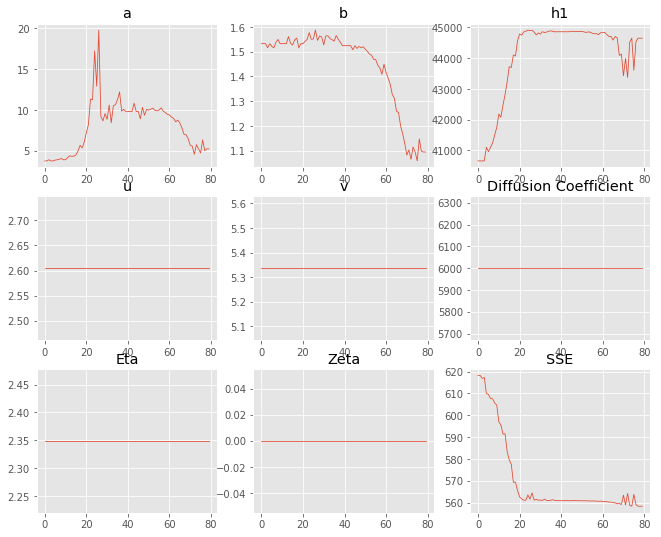

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,3.75953,5.23725
b,1.53247,1.09434
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"40,661.5","44,645.2"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 2 Time: 0.049 minutes


Estimated remaining run time: 0.556 minutes


Run 2===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.14e+10 	2.78e+03 	1.90e+03 	0.6827 		1.0000


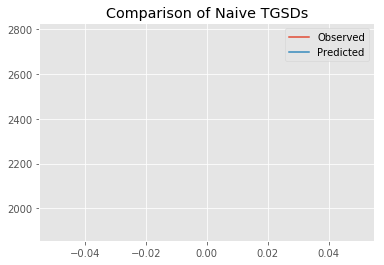

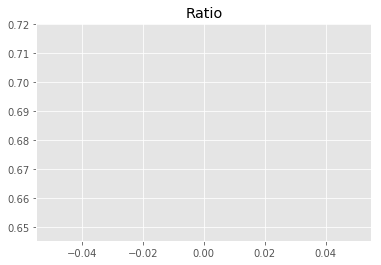

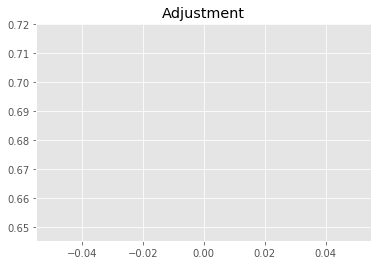

7813263880.02032
1


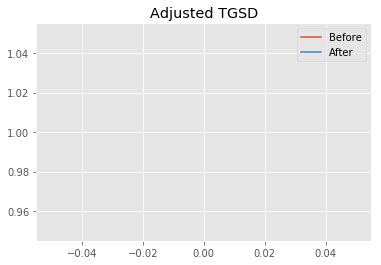

Old Total Mass: 1.14451e+10
New Total Mass: 1.14451e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.34744 	2.55993 	43325.9 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.14451e+10
After: 		|2.34089 	1.01448 	44915 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 812.897
New Misfit: 548.963
Convergence:
0.32468296485992826

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.14e+10 	2.65e+03 	1.90e+03 	0.7170 		1.0000


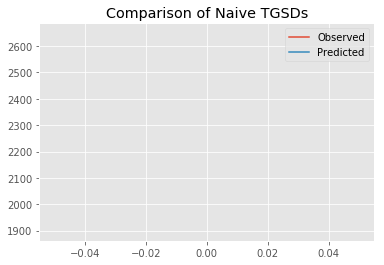

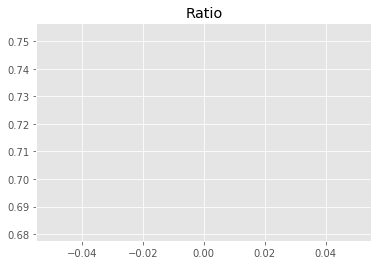

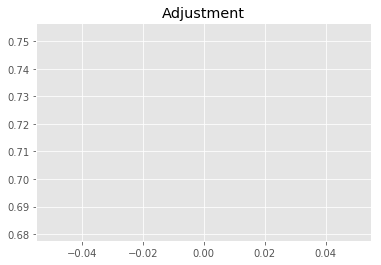

8206124563.240883
1


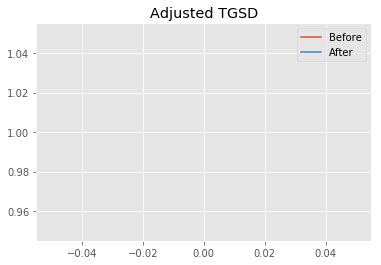

Old Total Mass: 1.14451e+10
New Total Mass: 1.14451e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.34089 	1.01448 	44915 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.14451e+10
After: 		|1.95256 	1.00016 	44915 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 548.963
New Misfit: 546.842
Convergence:
0.0038625655417203887

____________________
a = 1.95256	b = 1.00016	            h1 = 44915.00000	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 11445119407.50561
Success: True
Status: Successful convergence.
Iterations: 2
Misfit: 546.8424992412298
Prior Misfit: 812.897,	 Post Misfit: 546.842


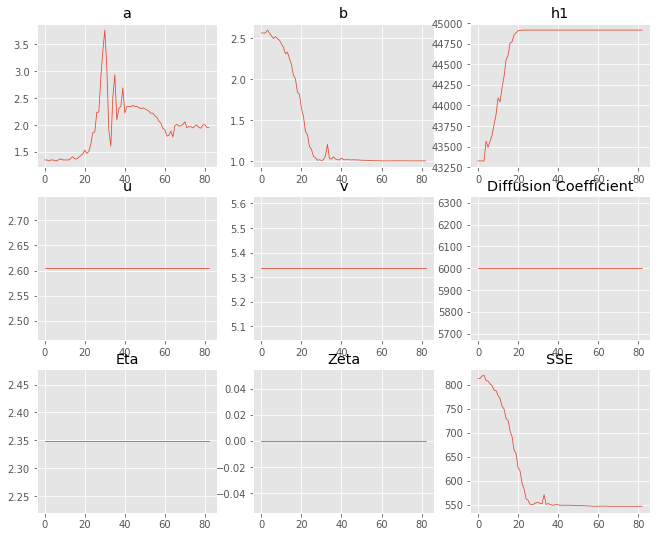

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,1.34744,1.95256
b,2.55993,1.00016
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"43,325.9","44,915"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 3 Time: 0.049 minutes


Estimated remaining run time: 0.591 minutes


Run 3===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.14e+10 	2.97e+03 	1.90e+03 	0.6388 		1.0000


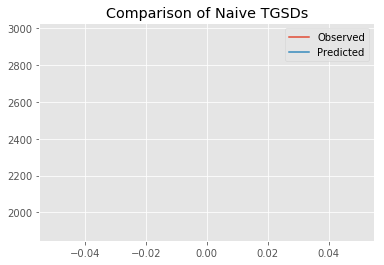

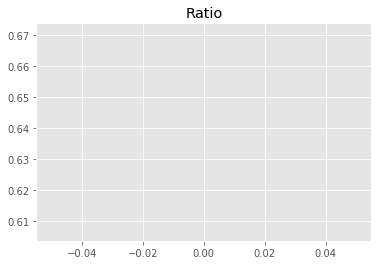

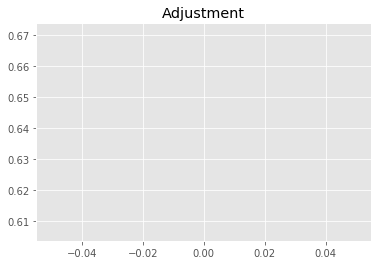

7310966329.578951
1


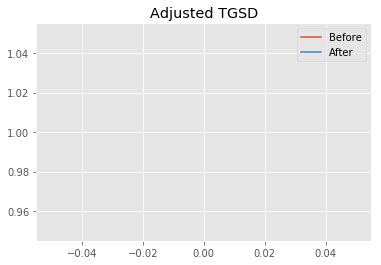

Old Total Mass: 1.14451e+10
New Total Mass: 1.14451e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.77686 	1.76918 	37201.4 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.14451e+10
After: 		|2.06545 	1.60324 	44608.3 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 687.665
New Misfit: 599.724
Convergence:
0.12788314109986262

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.14e+10 	2.81e+03 	1.90e+03 	0.6763 		1.0000


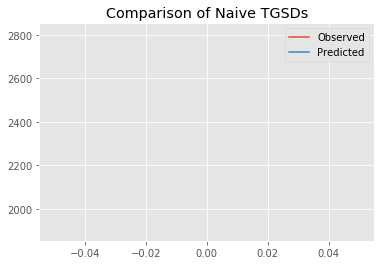

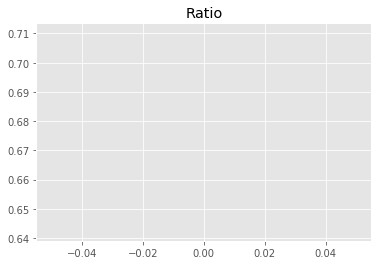

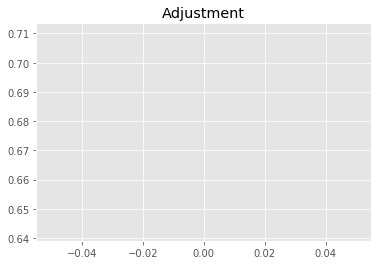

7739956189.673415
1


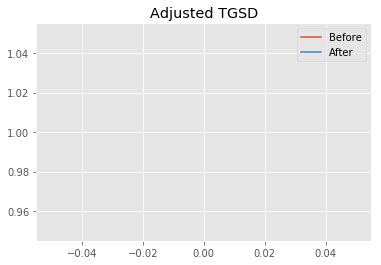

Old Total Mass: 1.14451e+10
New Total Mass: 1.14451e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.06545 	1.60324 	44608.3 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.14451e+10
After: 		|1.70111 	1.00533 	44911.9 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 599.724
New Misfit: 548.687
Convergence:
0.08510115816682176

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.14e+10 	2.70e+03 	1.90e+03 	0.7032 		1.0000


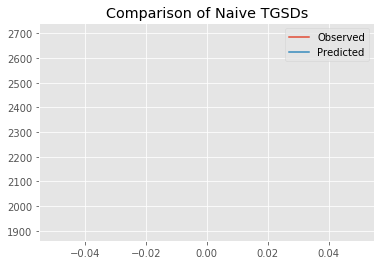

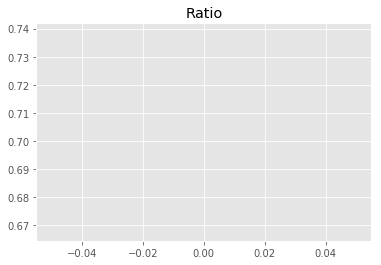

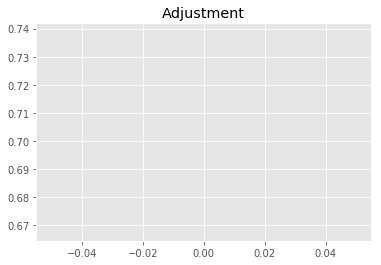

8047993278.85851
1


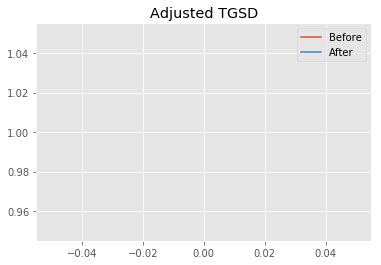

Old Total Mass: 1.14451e+10
New Total Mass: 1.14451e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.70111 	1.00533 	44911.9 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.14451e+10
After: 		|1.96567 	1.00023 	44913.9 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 548.687
New Misfit: 546.843
Convergence:
0.003359900299787191

____________________
a = 1.96567	b = 1.00023	            h1 = 44913.94219	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 11445119407.50561
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 546.8434078052941
Prior Misfit: 687.665,	 Post Misfit: 546.843


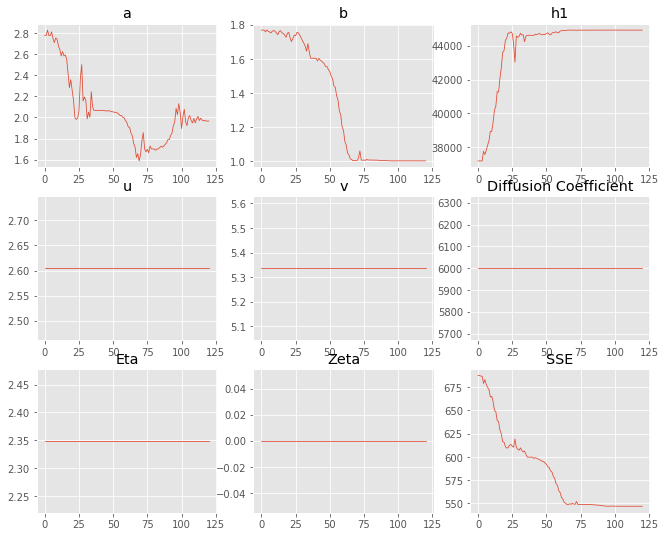

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,2.77686,1.96567
b,1.76918,1.00023
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"37,201.4","44,913.9"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 4 Time: 0.068 minutes


Estimated remaining run time: 0.648 minutes


Run 4===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.14e+10 	2.96e+03 	1.90e+03 	0.6418 		1.0000


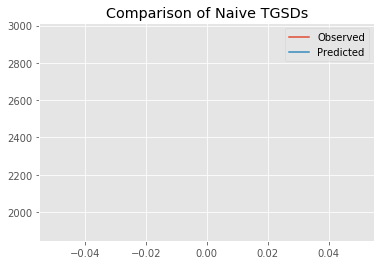

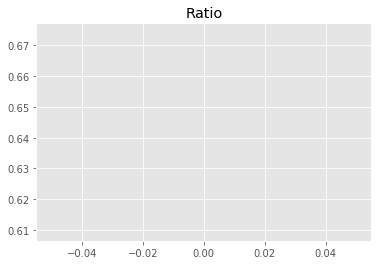

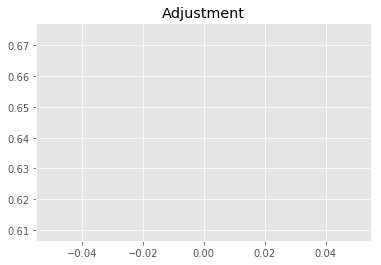

7345620781.011846
1


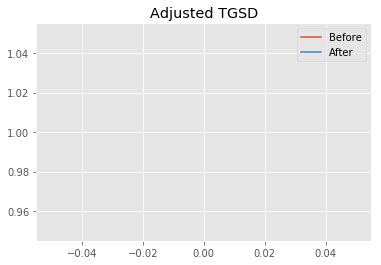

Old Total Mass: 1.14451e+10
New Total Mass: 1.14451e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.60008 	1.86462 	38475.1 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.14451e+10
After: 		|3.6075 	1.94959 	44231.4 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 681.826
New Misfit: 603.723
Convergence:
0.11454943019320046

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.14e+10 	2.77e+03 	1.90e+03 	0.6864 		1.0000


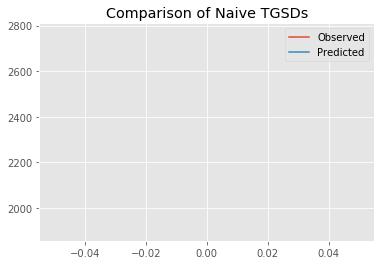

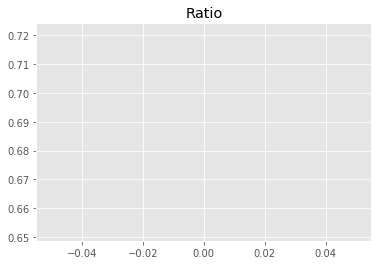

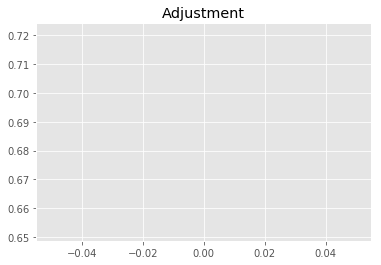

7856037343.790398
1


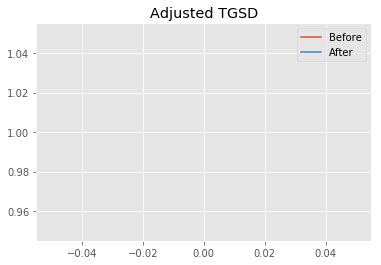

Old Total Mass: 1.14451e+10
New Total Mass: 1.14451e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.6075 	1.94959 	44231.4 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.14451e+10
After: 		|13.4577 	1.9676 	44892.1 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 603.723
New Misfit: 561.79
Convergence:
0.06945772416563792

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.14e+10 	2.31e+03 	1.90e+03 	0.8213 		1.0000


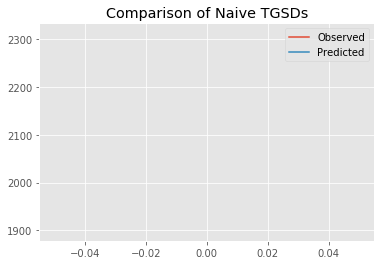

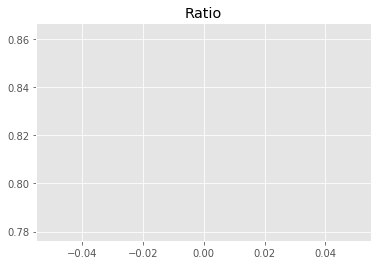

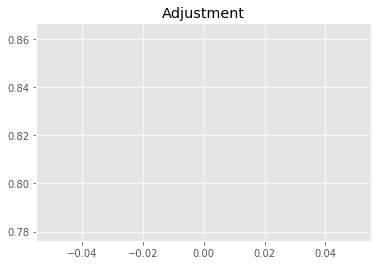

9400343625.143494
1


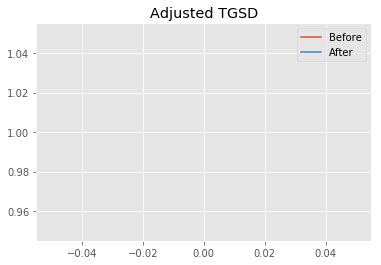

Old Total Mass: 1.14451e+10
New Total Mass: 1.14451e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|13.4577 	1.9676 	44892.1 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.14451e+10
After: 		|12.5844 	1.90501 	44915 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 561.79
New Misfit: 561.683
Convergence:
0.00019043127388344838

____________________
a = 12.58441	b = 1.90501	            h1 = 44914.99997	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 11445119407.50561
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 561.6829408052776
Prior Misfit: 681.826,	 Post Misfit: 561.683


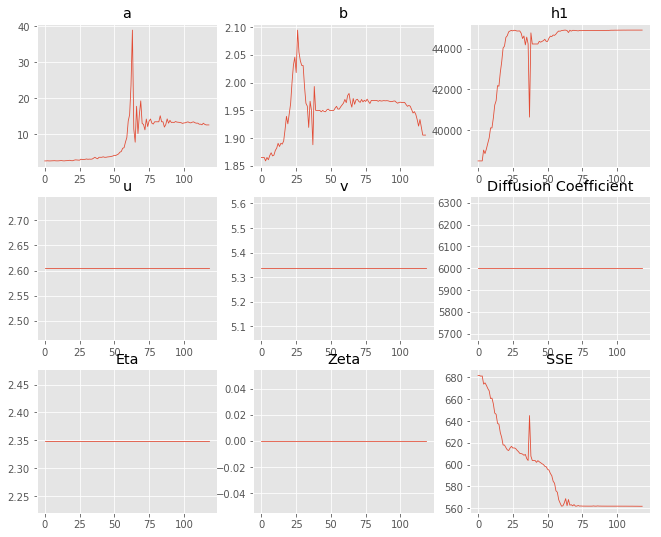

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,2.60008,12.5844
b,1.86462,1.90501
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"38,475.1","44,915"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 5 Time: 0.066 minutes


Estimated remaining run time: 0.657 minutes


Run 5===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.14e+10 	3.10e+03 	1.90e+03 	0.6124 		1.0000


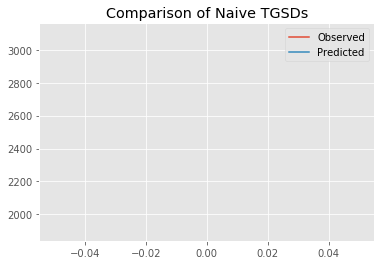

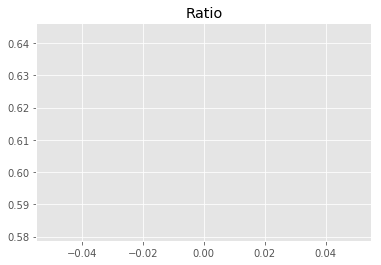

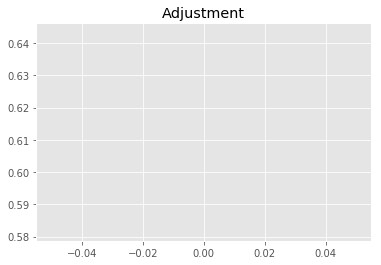

7008920306.97083
1


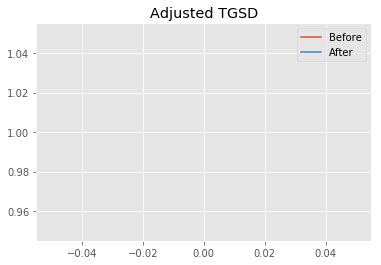

Old Total Mass: 1.14451e+10
New Total Mass: 1.14451e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|4.11594 	2.41551 	33033.1 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.14451e+10
After: 		|10.8558 	1.50433 	44017.1 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 768.858
New Misfit: 561.411
Convergence:
0.26981185823985687

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.14e+10 	2.33e+03 	1.90e+03 	0.8158 		1.0000


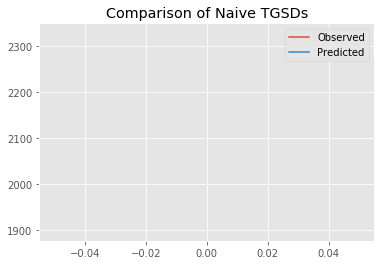

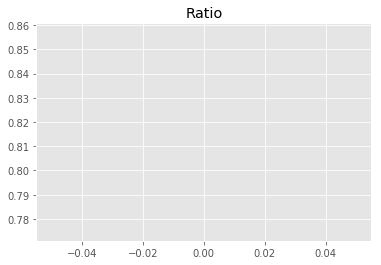

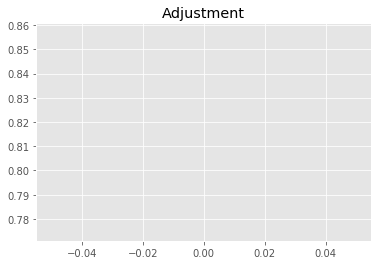

9337298256.979582
1


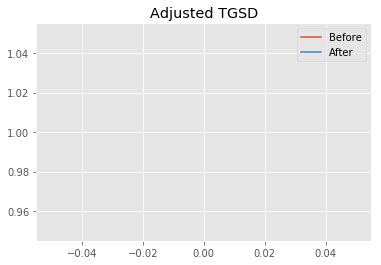

Old Total Mass: 1.14451e+10
New Total Mass: 1.14451e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|10.8558 	1.50433 	44017.1 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.14451e+10
After: 		|3.13195 	1.01485 	44915 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 561.411
New Misfit: 553.15
Convergence:
0.014713688236788088

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.14e+10 	2.57e+03 	1.90e+03 	0.7388 		1.0000


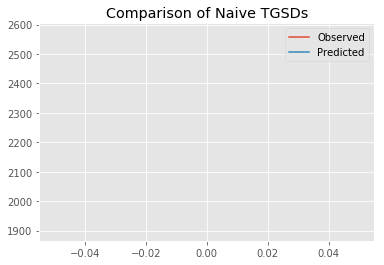

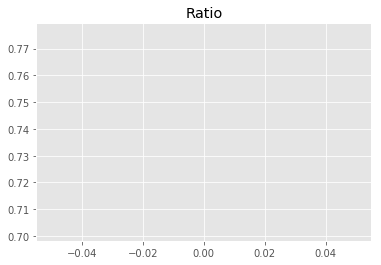

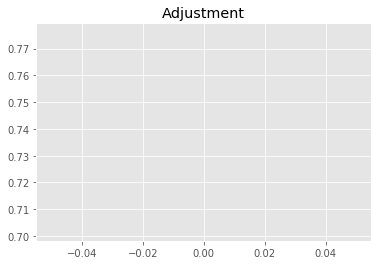

8455867518.331892
1


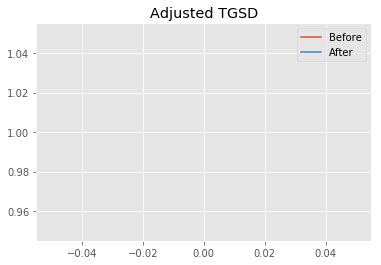

Old Total Mass: 1.14451e+10
New Total Mass: 1.14451e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.13195 	1.01485 	44915 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.14451e+10
After: 		|1.95125 	1.00053 	44915 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 553.15
New Misfit: 546.871
Convergence:
0.011351775912944218

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.14e+10 	2.68e+03 	1.90e+03 	0.7083 		1.0000


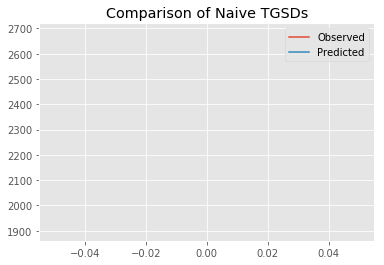

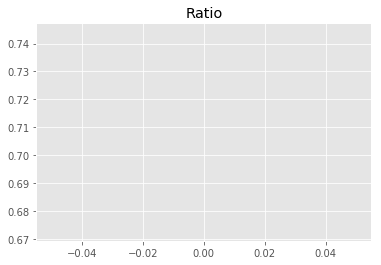

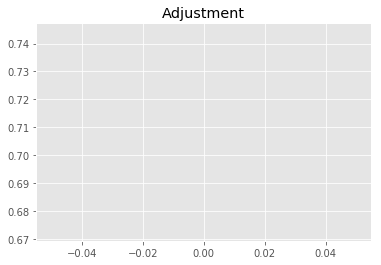

8106440478.816246
1


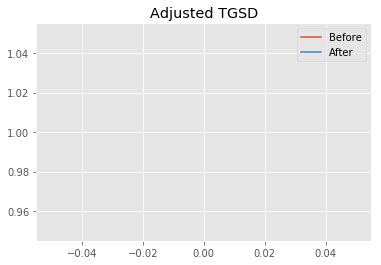

Old Total Mass: 1.14451e+10
New Total Mass: 1.14451e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.95125 	1.00053 	44915 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.14451e+10
After: 		|1.95125 	1.00036 	44915 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 546.871
New Misfit: 546.858
Convergence:
2.3256212731105435e-05

____________________
a = 1.95125	b = 1.00036	            h1 = 44915.00000	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 11445119407.50561
Success: True
Status: Successful convergence.
Iterations: 4
Misfit: 546.8584772544115
Prior Misfit: 768.858,	 Post Misfit: 546.858


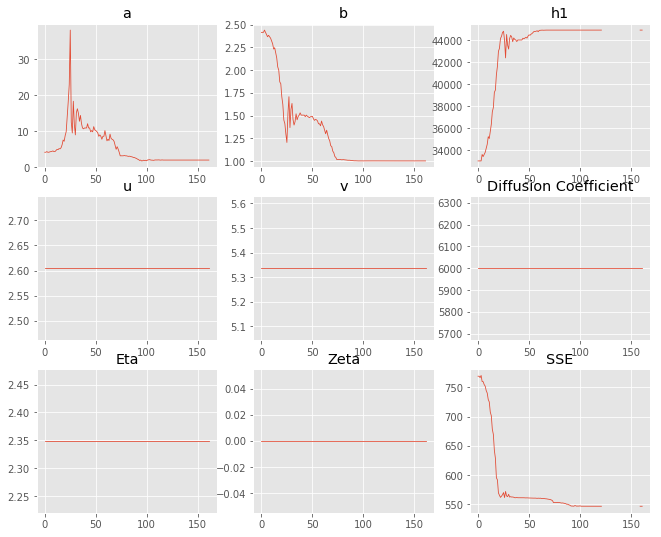

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,4.11594,1.95125
b,2.41551,1.00036
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"33,033.1","44,915"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 6 Time: 0.089 minutes


Estimated remaining run time: 0.688 minutes


Run 6===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.14e+10 	2.74e+03 	1.90e+03 	0.6925 		1.0000


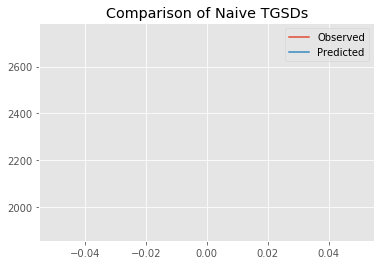

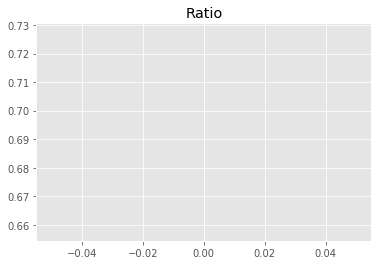

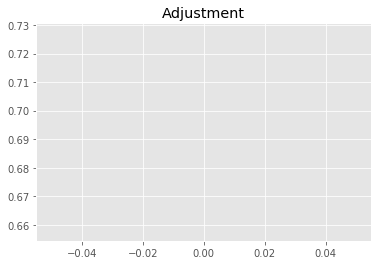

7925684964.501223
1


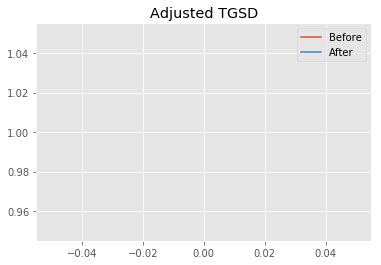

Old Total Mass: 1.14451e+10
New Total Mass: 1.14451e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.1867 	1.17475 	42915 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.14451e+10
After: 		|1.96634 	1 	44914.9 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 573.117
New Misfit: 546.826
Convergence:
0.04587272334602506

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.14e+10 	2.68e+03 	1.90e+03 	0.7087 		1.0000


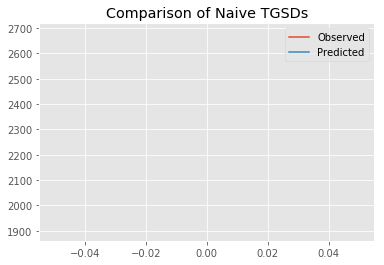

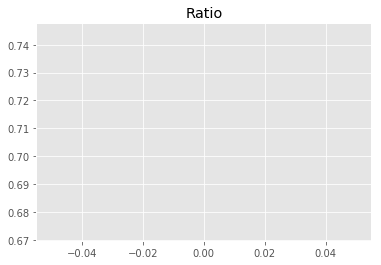

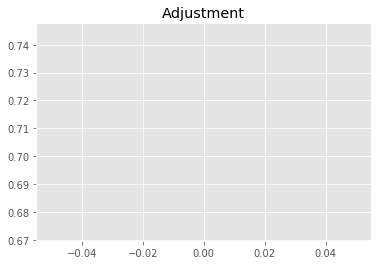

8110717344.732796
1


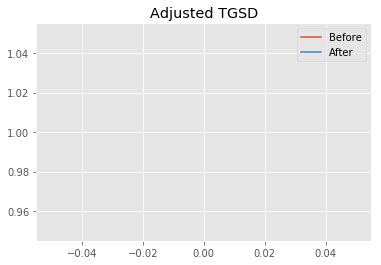

Old Total Mass: 1.14451e+10
New Total Mass: 1.14451e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.96634 	1 	44914.9 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.14451e+10
After: 		|1.96971 	1 	44915 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 546.826
New Misfit: 546.826
Convergence:
6.96935552027128e-07

____________________
a = 1.96971	b = 1.00000	            h1 = 44914.98454	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 11445119407.50561
Success: True
Status: Successful convergence.
Iterations: 2
Misfit: 546.8258496207652
Prior Misfit: 573.117,	 Post Misfit: 546.826


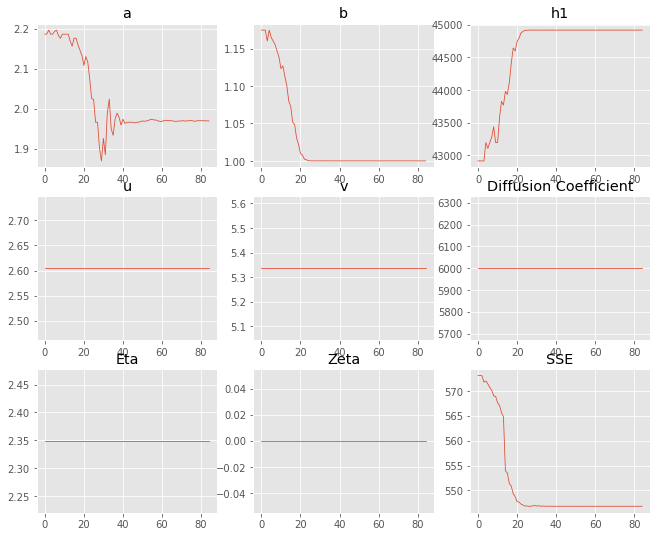

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,2.1867,1.96971
b,1.17475,1
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"42,915","44,915"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 7 Time: 0.050 minutes


Estimated remaining run time: 0.630 minutes


Run 7===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.14e+10 	2.95e+03 	1.90e+03 	0.6428 		1.0000


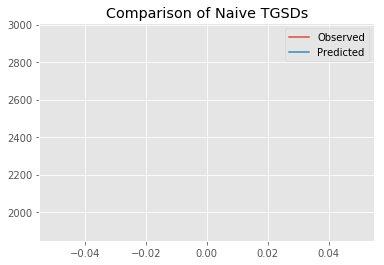

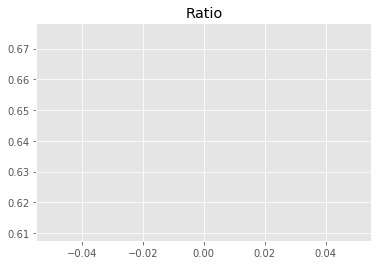

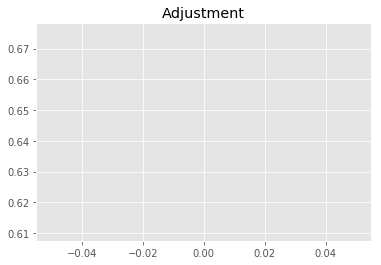

7357322220.377015
1


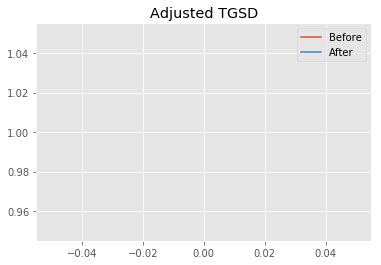

Old Total Mass: 1.14451e+10
New Total Mass: 1.14451e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.23341 	2.11914 	39229.7 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.14451e+10
After: 		|6.47604 	1.10255 	44915 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 702.946
New Misfit: 558.61
Convergence:
0.20532917957031857

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.14e+10 	2.38e+03 	1.90e+03 	0.7987 		1.0000


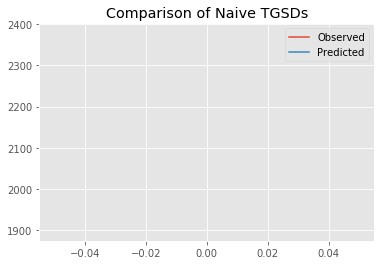

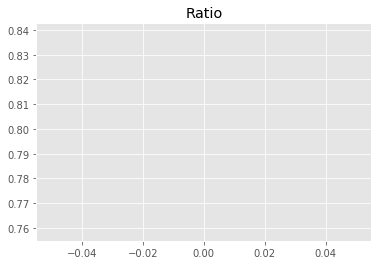

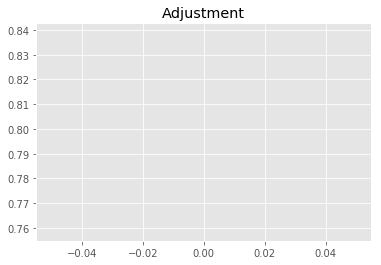

9141605753.1791
1


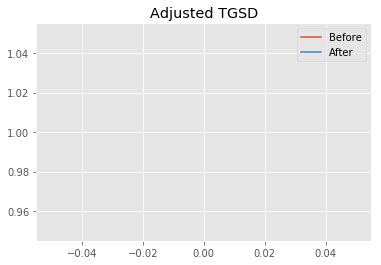

Old Total Mass: 1.14451e+10
New Total Mass: 1.14451e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|6.47604 	1.10255 	44915 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.14451e+10
After: 		|6.47604 	1.09151 	44915 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 558.61
New Misfit: 558.539
Convergence:
0.00012753247051525162

____________________
a = 6.47604	b = 1.09151	            h1 = 44915.00000	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 11445119407.50561
Success: True
Status: Successful convergence.
Iterations: 2
Misfit: 558.5391601083824
Prior Misfit: 702.946,	 Post Misfit: 558.539


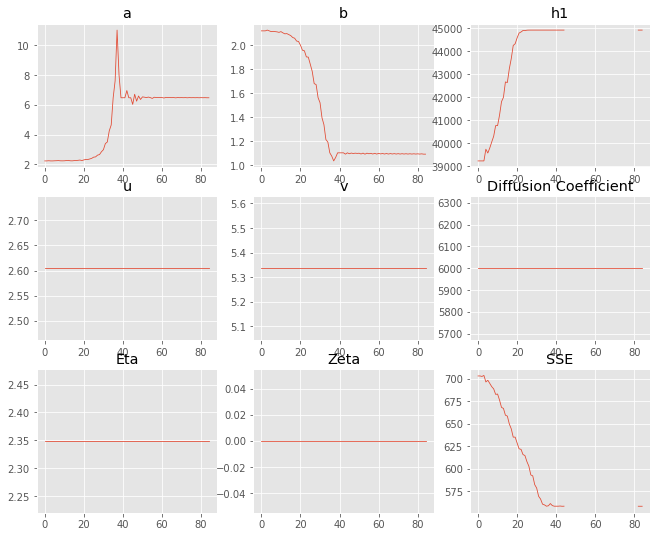

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,2.23341,6.47604
b,2.11914,1.09151
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"39,229.7","44,915"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 8 Time: 0.051 minutes


Estimated remaining run time: 0.576 minutes


Run 8===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.14e+10 	2.86e+03 	1.90e+03 	0.6641 		1.0000


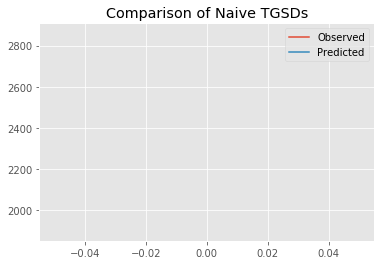

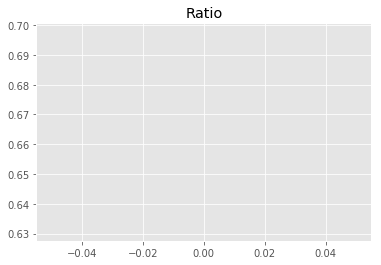

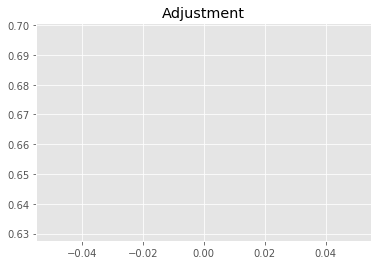

7600416573.86505
1


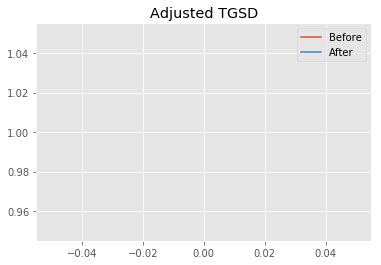

Old Total Mass: 1.14451e+10
New Total Mass: 1.14451e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.93285 	1.37898 	38896.9 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.14451e+10
After: 		|1.81165 	1.06158 	44914.5 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 632.864
New Misfit: 552.629
Convergence:
0.12678051008851288

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.14e+10 	2.71e+03 	1.90e+03 	0.7015 		1.0000


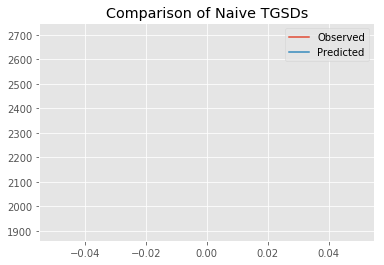

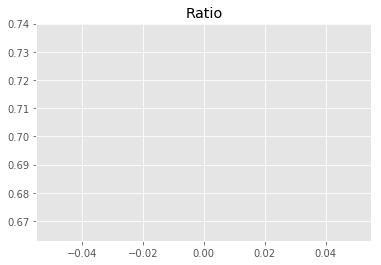

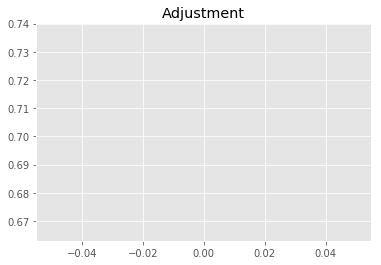

8028940693.685784
1


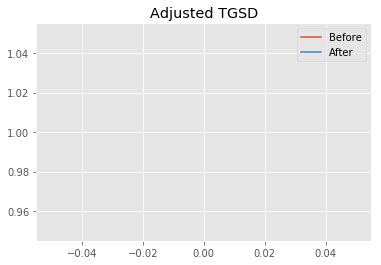

Old Total Mass: 1.14451e+10
New Total Mass: 1.14451e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.81165 	1.06158 	44914.5 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.14451e+10
After: 		|2.00534 	1.00045 	44912.9 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 552.629
New Misfit: 546.876
Convergence:
0.010410258916822925

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.14e+10 	2.68e+03 	1.90e+03 	0.7095 		1.0000


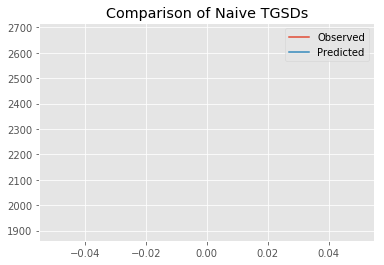

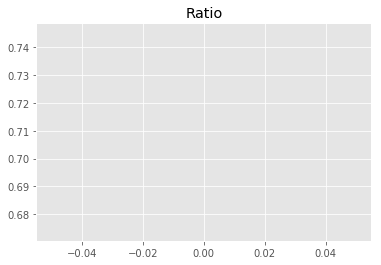

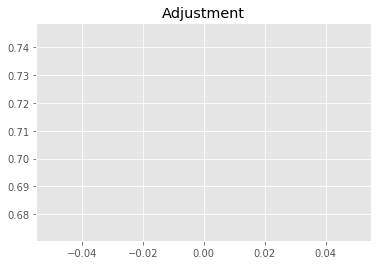

8120565175.497004
1


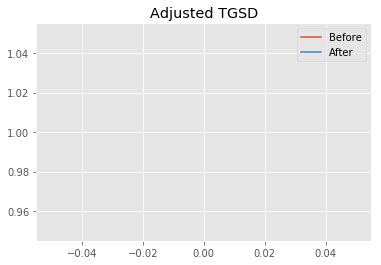

Old Total Mass: 1.14451e+10
New Total Mass: 1.14451e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.00534 	1.00045 	44912.9 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.14451e+10
After: 		|1.97155 	1 	44915 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 546.876
New Misfit: 546.826
Convergence:
9.18579606256022e-05

____________________
a = 1.97155	b = 1.00000	            h1 = 44914.99995	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 11445119407.50561
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 546.8258939008836
Prior Misfit: 632.864,	 Post Misfit: 546.826


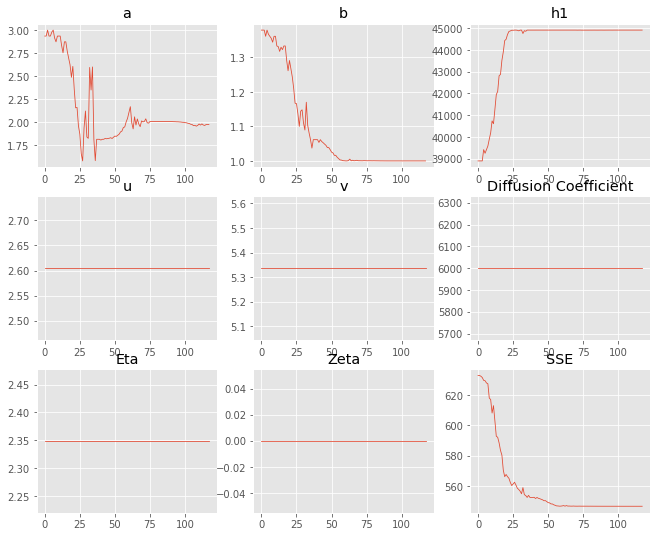

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,2.93285,1.97155
b,1.37898,1
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"38,896.9","44,915"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 9 Time: 0.067 minutes


Estimated remaining run time: 0.538 minutes


Run 9===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.14e+10 	3.03e+03 	1.90e+03 	0.6277 		1.0000


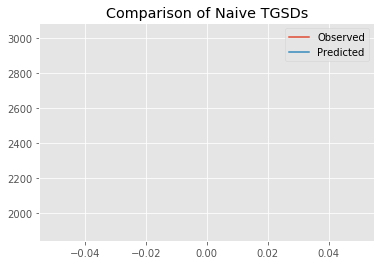

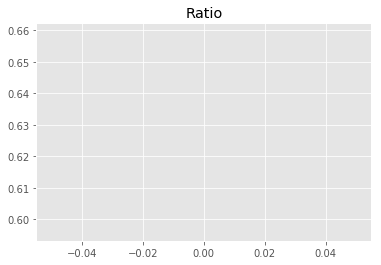

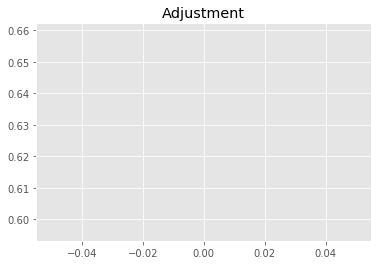

7184408055.942075
1


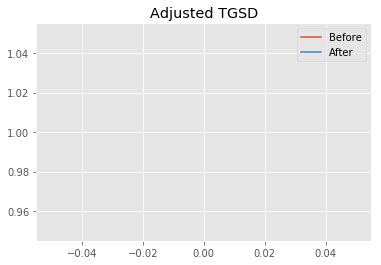

Old Total Mass: 1.14451e+10
New Total Mass: 1.14451e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.02078 	4.10694 	39041.4 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.14451e+10
After: 		|5.27135 	1.02495 	44865 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 817.317
New Misfit: 557.355
Convergence:
0.3180683781119147

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.14e+10 	2.42e+03 	1.90e+03 	0.7853 		1.0000


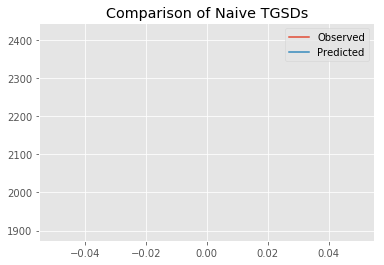

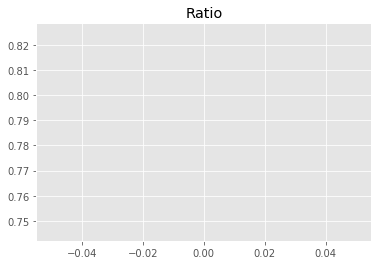

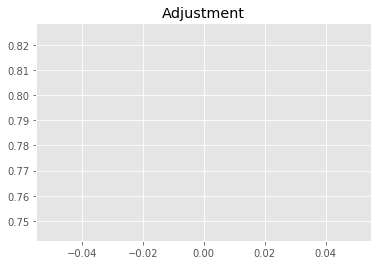

8987974007.889036
1


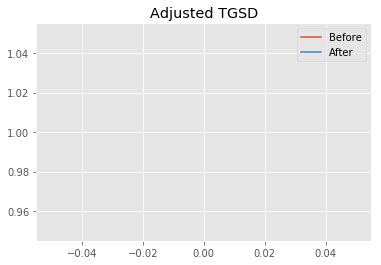

Old Total Mass: 1.14451e+10
New Total Mass: 1.14451e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|5.27135 	1.02495 	44865 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.14451e+10
After: 		|1.95048 	1.00244 	44896.3 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 557.355
New Misfit: 547.019
Convergence:
0.018543666057955405

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.14e+10 	2.68e+03 	1.90e+03 	0.7081 		1.0000


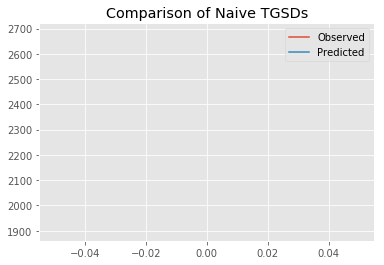

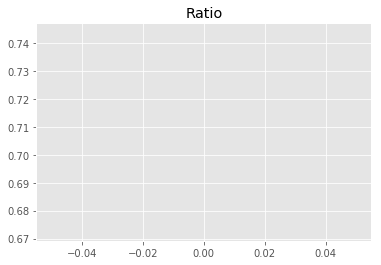

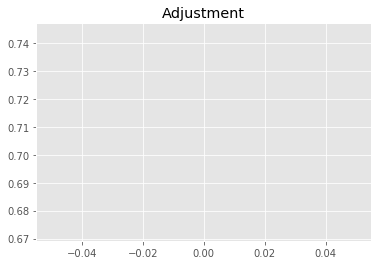

8104738668.212182
1


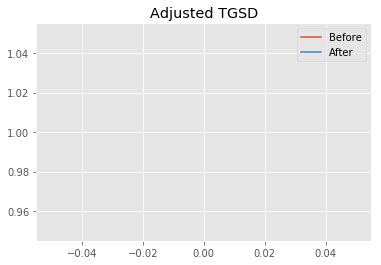

Old Total Mass: 1.14451e+10
New Total Mass: 1.14451e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.95048 	1.00244 	44896.3 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.14451e+10
After: 		|1.97063 	1 	43955.7 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 547.019
New Misfit: 546.826
Convergence:
0.00035317491561313153

____________________
a = 1.97063	b = 1.00000	            h1 = 43955.65994	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 11445119407.50561
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 546.825947023298
Prior Misfit: 817.317,	 Post Misfit: 546.826


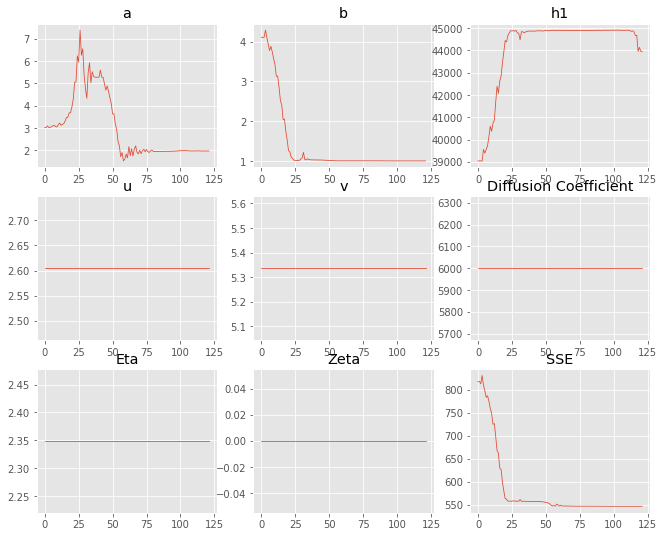

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,3.02078,1.97063
b,4.10694,1
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"39,041.4","43,955.7"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 10 Time: 0.069 minutes


Estimated remaining run time: 0.497 minutes


Run 10===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.14e+10 	3.05e+03 	1.90e+03 	0.6233 		1.0000


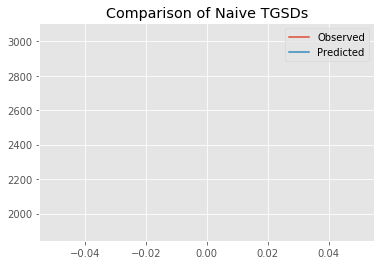

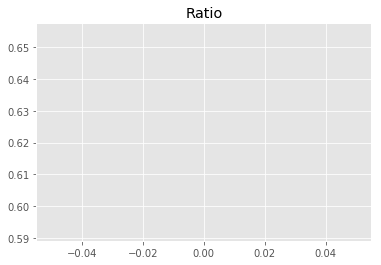

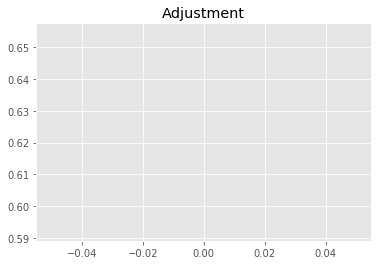

7133901429.767071
1


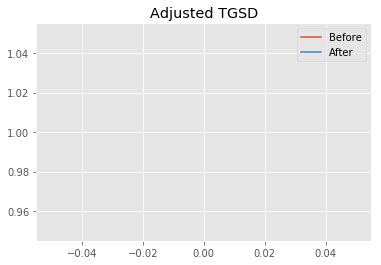

Old Total Mass: 1.14451e+10
New Total Mass: 1.14451e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.27803 	4.08207 	35583.7 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.14451e+10
After: 		|6.22158 	1.04293 	44559.4 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 855.668
New Misfit: 558.143
Convergence:
0.34771037503150515

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.14e+10 	2.38e+03 	1.90e+03 	0.7985 		1.0000


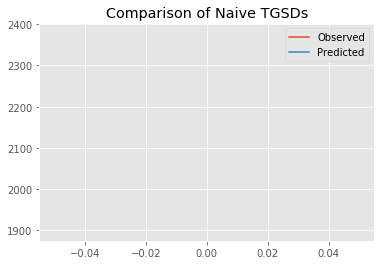

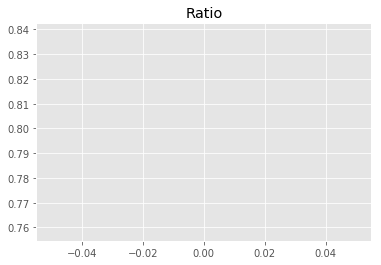

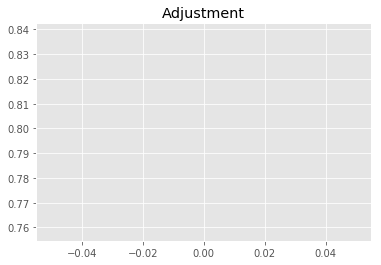

9139444228.103352
1


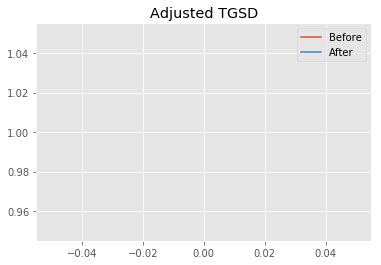

Old Total Mass: 1.14451e+10
New Total Mass: 1.14451e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|6.22158 	1.04293 	44559.4 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.14451e+10
After: 		|1.9743 	1.00605 	44752.8 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 558.143
New Misfit: 547.297
Convergence:
0.01943316084909903

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.14e+10 	2.68e+03 	1.90e+03 	0.7084 		1.0000


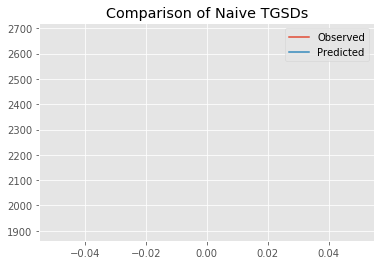

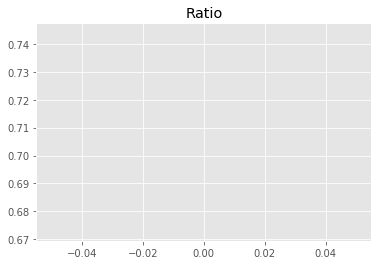

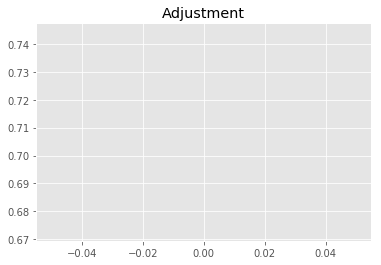

8107871329.614936
1


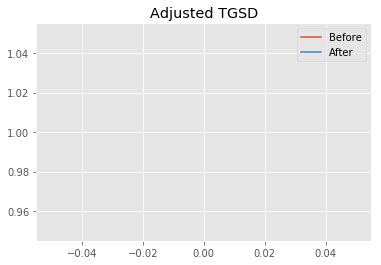

Old Total Mass: 1.14451e+10
New Total Mass: 1.14451e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.9743 	1.00605 	44752.8 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.14451e+10
After: 		|1.97857 	1 	44245.4 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 547.297
New Misfit: 546.827
Convergence:
0.0008582024736615368

____________________
a = 1.97857	b = 1.00000	            h1 = 44245.41653	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 11445119407.50561
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 546.8270771174293
Prior Misfit: 855.668,	 Post Misfit: 546.827


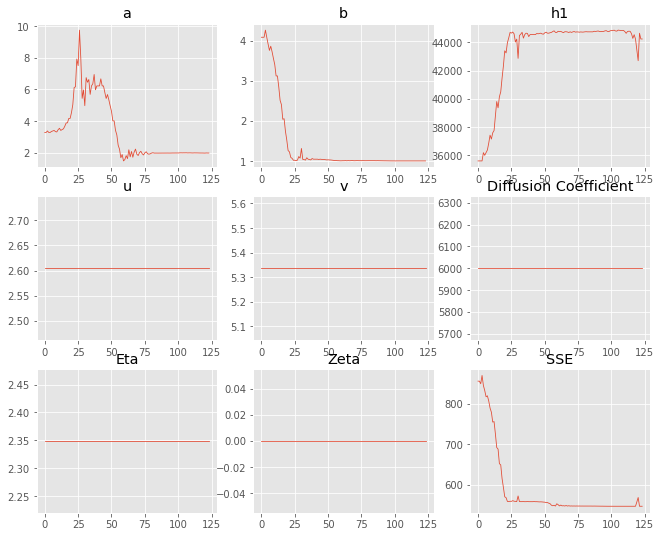

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,3.27803,1.97857
b,4.08207,1
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"35,583.7","44,245.4"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 11 Time: 0.068 minutes


Estimated remaining run time: 0.450 minutes


Run 11===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.14e+10 	2.83e+03 	1.90e+03 	0.6703 		1.0000


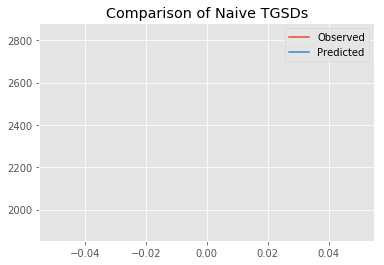

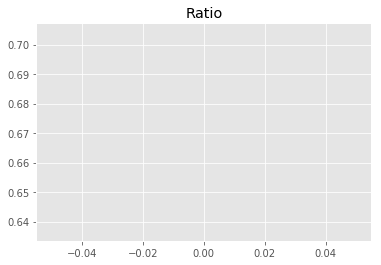

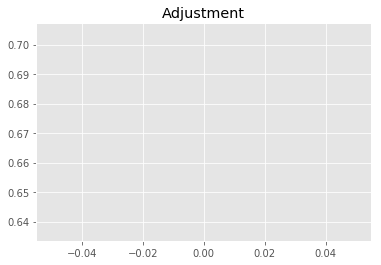

7672186952.685143
1


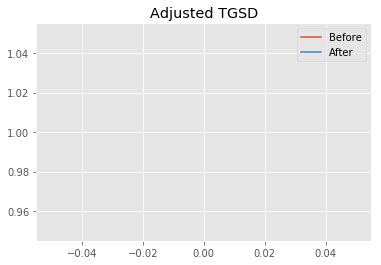

Old Total Mass: 1.14451e+10
New Total Mass: 1.14451e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.31557 	1.10984 	38538 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.14451e+10
After: 		|2.55417 	1.04189 	43987.1 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 647.752
New Misfit: 552.137
Convergence:
0.14760981867210826

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.14e+10 	2.64e+03 	1.90e+03 	0.7201 		1.0000


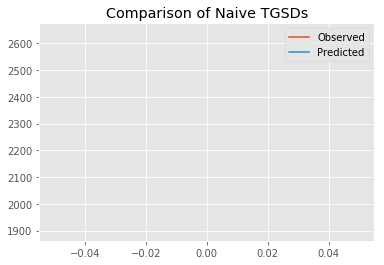

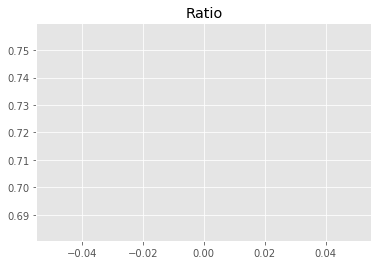

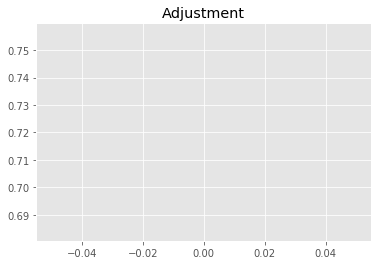

8241948499.790092
1


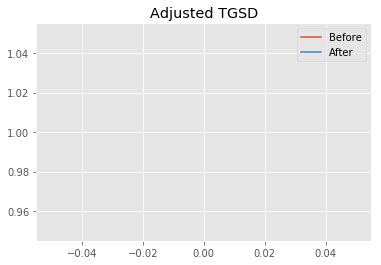

Old Total Mass: 1.14451e+10
New Total Mass: 1.14451e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.55417 	1.04189 	43987.1 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.14451e+10
After: 		|1.95875 	1.00116 	44747.1 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 552.137
New Misfit: 546.919
Convergence:
0.0094519430544692

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.14e+10 	2.68e+03 	1.90e+03 	0.7084 		1.0000


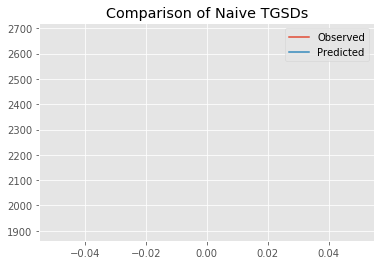

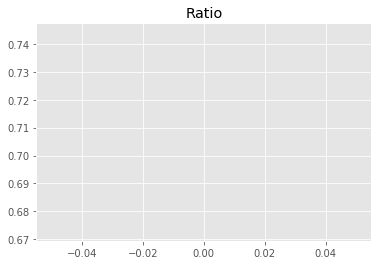

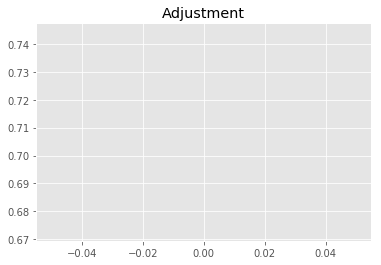

8107830750.031423
1


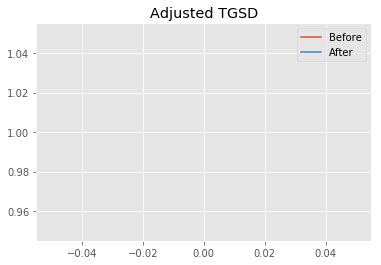

Old Total Mass: 1.14451e+10
New Total Mass: 1.14451e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.95875 	1.00116 	44747.1 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.14451e+10
After: 		|1.96862 	1 	44199.5 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 546.919
New Misfit: 546.826
Convergence:
0.0001695590743428092

____________________
a = 1.96862	b = 1.00000	            h1 = 44199.47445	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 11445119407.50561
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 546.8259156472602
Prior Misfit: 647.752,	 Post Misfit: 546.826


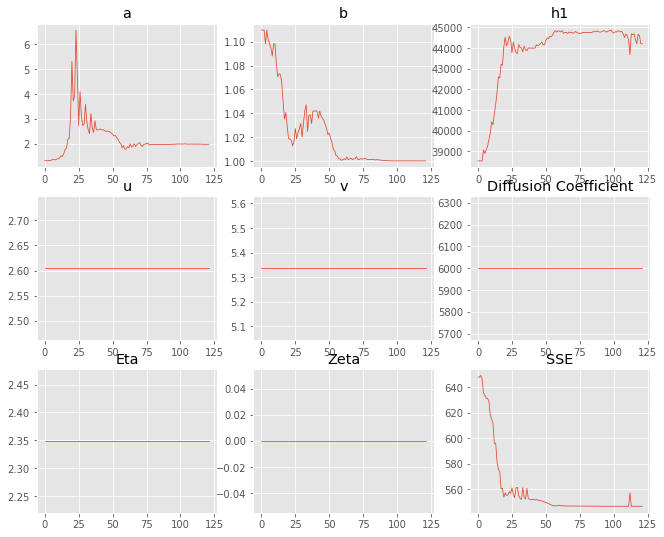

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,1.31557,1.96862
b,1.10984,1
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"38,538","44,199.5"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 12 Time: 0.067 minutes


Estimated remaining run time: 0.400 minutes


Run 12===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.14e+10 	2.72e+03 	1.90e+03 	0.6988 		1.0000


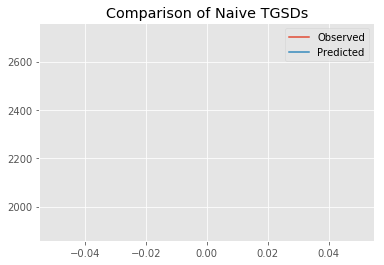

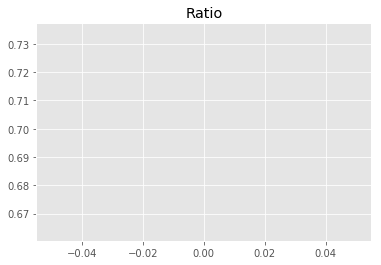

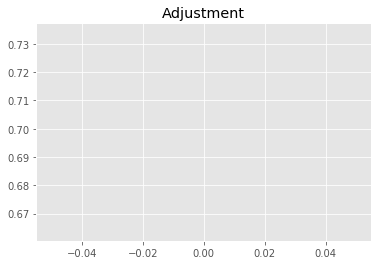

7998169793.520094
1


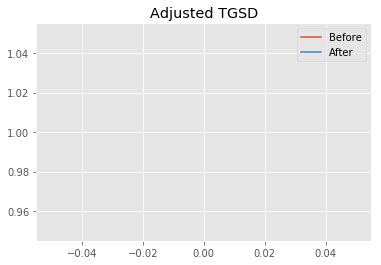

Old Total Mass: 1.14451e+10
New Total Mass: 1.14451e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|4.34041 	2.05463 	44446.3 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.14451e+10
After: 		|14.5884 	2.03028 	44678.3 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 598.23
New Misfit: 562.017
Convergence:
0.060533671831103024

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.14e+10 	2.31e+03 	1.90e+03 	0.8238 		1.0000


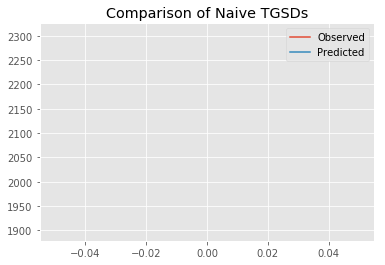

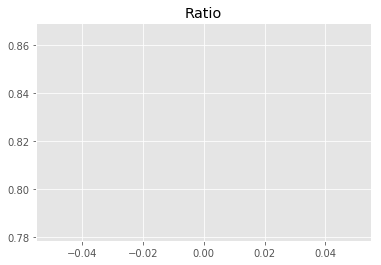

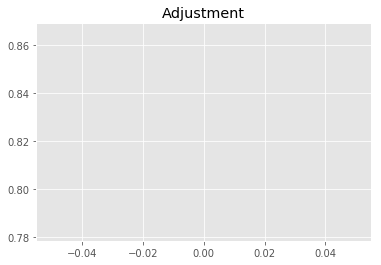

9428020695.948769
1


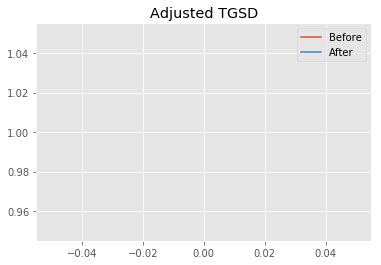

Old Total Mass: 1.14451e+10
New Total Mass: 1.14451e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|14.5884 	2.03028 	44678.3 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.14451e+10
After: 		|12.6761 	1.87604 	44915 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 562.017
New Misfit: 561.624
Convergence:
0.0006986148867553706

____________________
a = 12.67613	b = 1.87604	            h1 = 44915.00000	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 11445119407.50561
Success: True
Status: Successful convergence.
Iterations: 2
Misfit: 561.6241712699518
Prior Misfit: 598.23,	 Post Misfit: 561.624


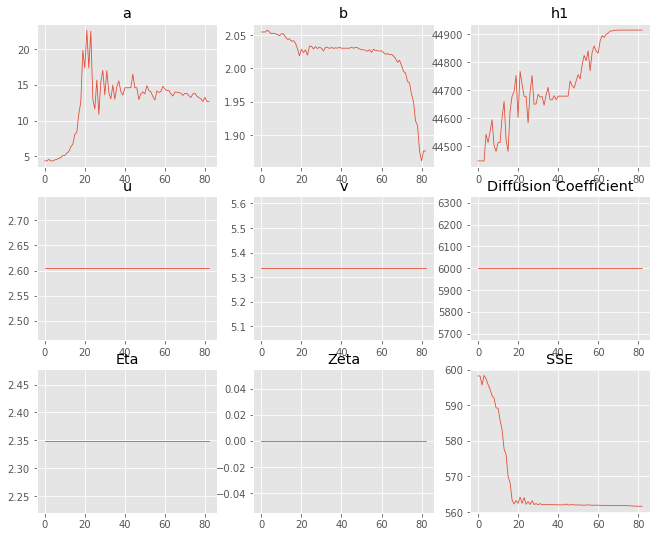

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,4.34041,12.6761
b,2.05463,1.87604
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"44,446.3","44,915"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 13 Time: 0.047 minutes


Estimated remaining run time: 0.338 minutes


Run 13===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.14e+10 	2.98e+03 	1.90e+03 	0.6378 		1.0000


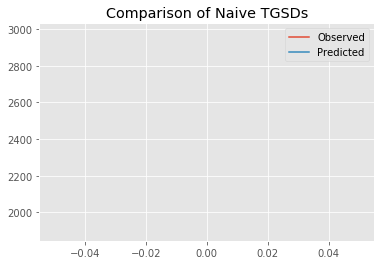

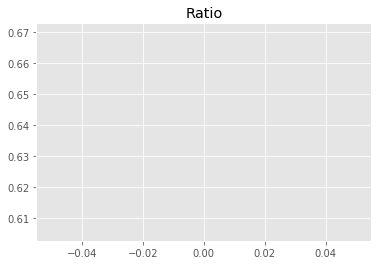

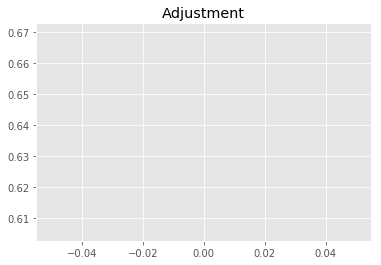

7299236979.820584
1


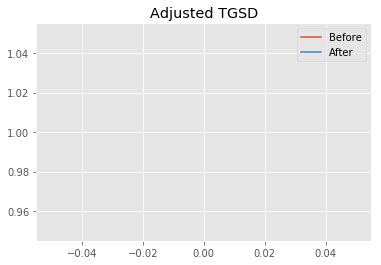

Old Total Mass: 1.14451e+10
New Total Mass: 1.14451e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.35413 	1.26893 	34319.5 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.14451e+10
After: 		|1.89827 	1.00191 	44914 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 692.623
New Misfit: 547.056
Convergence:
0.210167696128626

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.14e+10 	2.69e+03 	1.90e+03 	0.7070 		1.0000


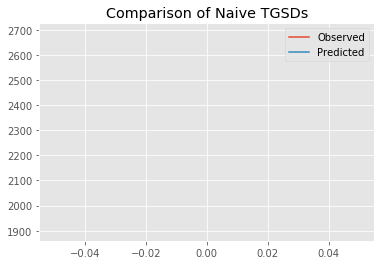

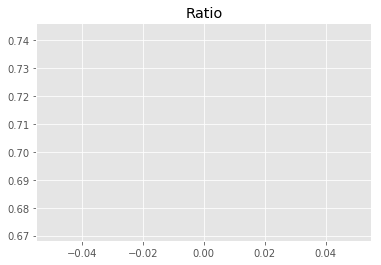

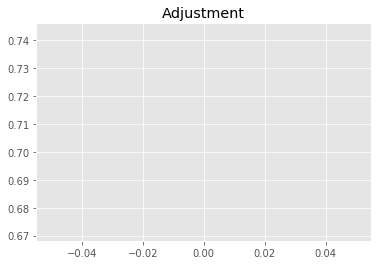

8092230437.066325
1


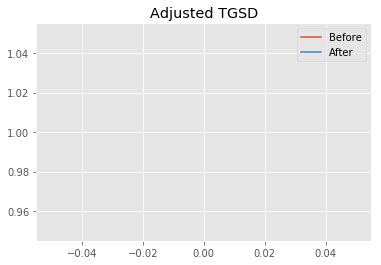

Old Total Mass: 1.14451e+10
New Total Mass: 1.14451e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.89827 	1.00191 	44914 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.14451e+10
After: 		|1.96994 	1 	44914.8 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 547.056
New Misfit: 546.826
Convergence:
0.00042094093276027865

____________________
a = 1.96994	b = 1.00000	            h1 = 44914.84418	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 11445119407.50561
Success: True
Status: Successful convergence.
Iterations: 2
Misfit: 546.8259757538648
Prior Misfit: 692.623,	 Post Misfit: 546.826


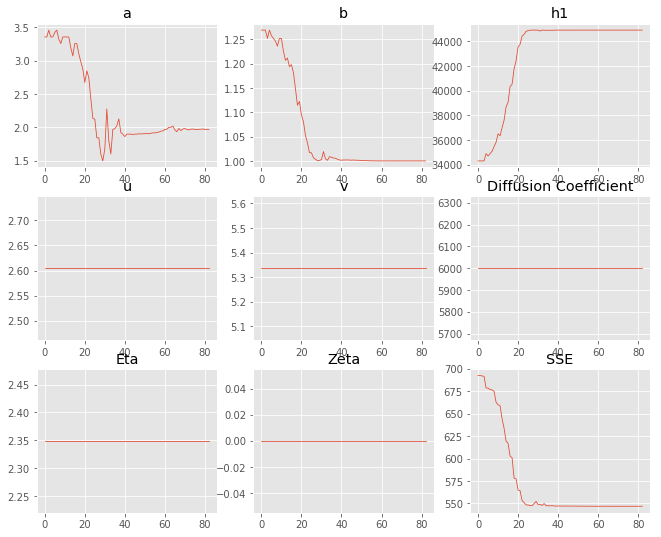

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,3.35413,1.96994
b,1.26893,1
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"34,319.5","44,914.8"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 14 Time: 0.049 minutes


Estimated remaining run time: 0.279 minutes


Run 14===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.14e+10 	3.03e+03 	1.90e+03 	0.6259 		1.0000


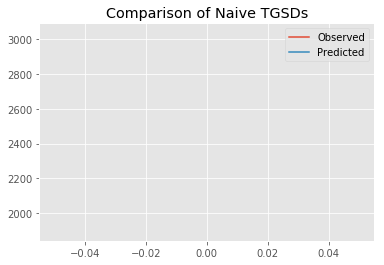

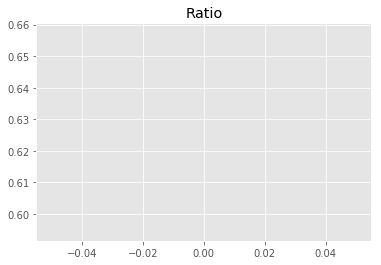

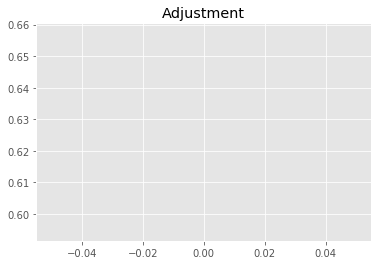

7163909363.836985
1


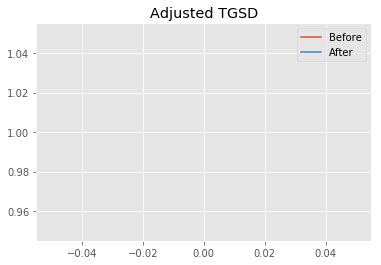

Old Total Mass: 1.14451e+10
New Total Mass: 1.14451e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|4.88488 	1.17522 	31191.7 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.14451e+10
After: 		|17.684 	1.3523 	42886.5 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 730.946
New Misfit: 563.175
Convergence:
0.2295259840278641

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.14e+10 	2.27e+03 	1.90e+03 	0.8351 		1.0000


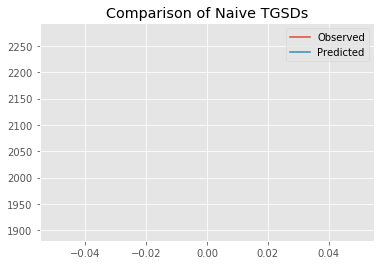

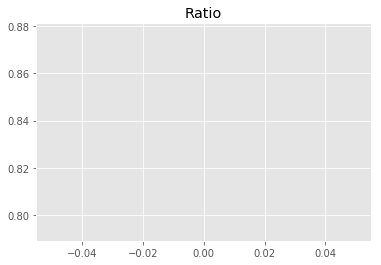

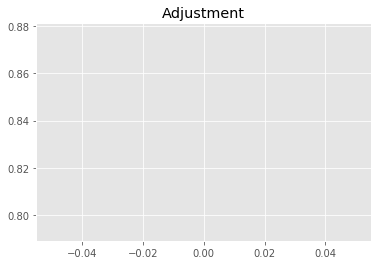

9558136039.278057
1


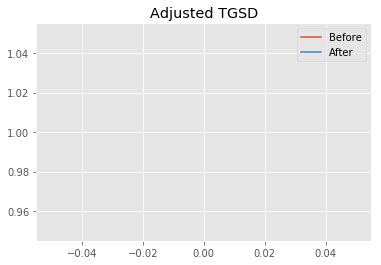

Old Total Mass: 1.14451e+10
New Total Mass: 1.14451e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|17.684 	1.3523 	42886.5 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.14451e+10
After: 		|11.5584 	1.28931 	43900.2 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 563.175
New Misfit: 561.3
Convergence:
0.003330076513050946

____________________
a = 11.55844	b = 1.28931	            h1 = 43900.15000	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 11445119407.50561
Success: True
Status: Successful convergence.
Iterations: 2
Misfit: 561.2997279657899
Prior Misfit: 730.946,	 Post Misfit: 561.3


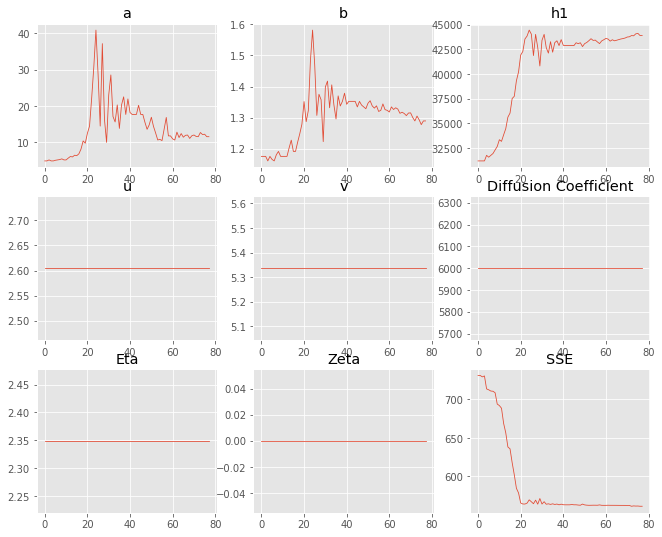

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,4.88488,11.5584
b,1.17522,1.28931
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"31,191.7","43,900.2"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 15 Time: 0.047 minutes


Estimated remaining run time: 0.221 minutes


Run 15===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.14e+10 	2.82e+03 	1.90e+03 	0.6738 		1.0000


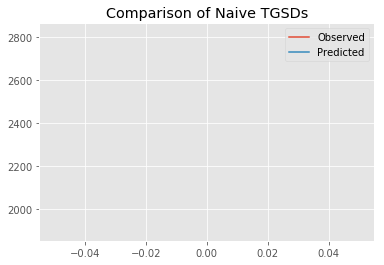

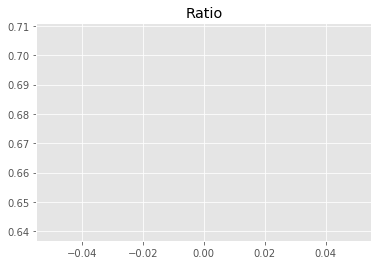

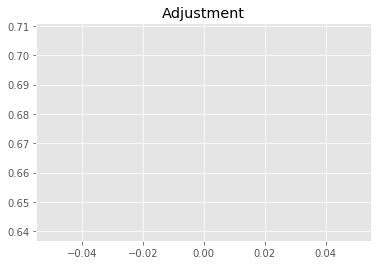

7711888350.013432
1


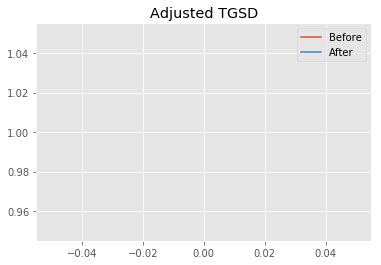

Old Total Mass: 1.14451e+10
New Total Mass: 1.14451e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|4.75849 	1.33592 	36896.6 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.14451e+10
After: 		|10.338 	1.38251 	44559.5 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 641.524
New Misfit: 560.737
Convergence:
0.1259291523731742

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.14e+10 	2.31e+03 	1.90e+03 	0.8215 		1.0000


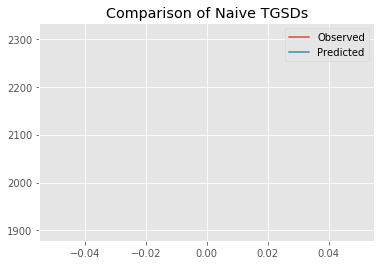

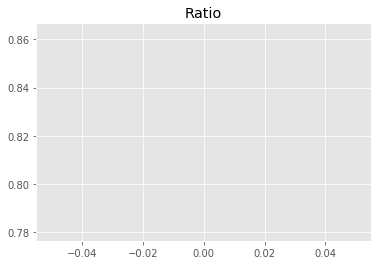

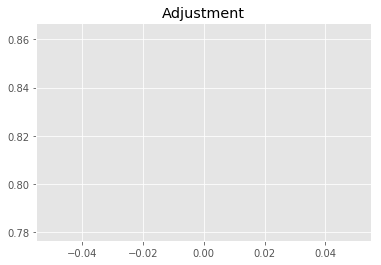

9402401687.393158
1


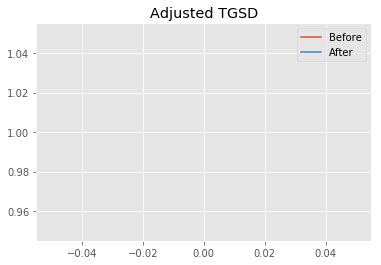

Old Total Mass: 1.14451e+10
New Total Mass: 1.14451e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|10.338 	1.38251 	44559.5 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.14451e+10
After: 		|2.01879 	1.00208 	44915 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 560.737
New Misfit: 547.01
Convergence:
0.024481241976361992

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.14e+10 	2.68e+03 	1.90e+03 	0.7097 		1.0000


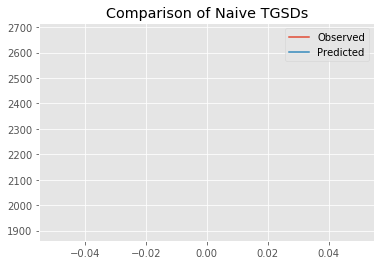

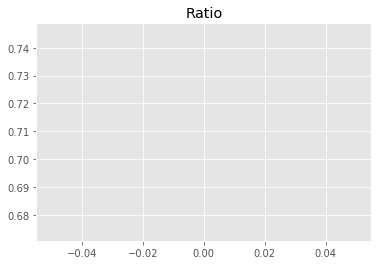

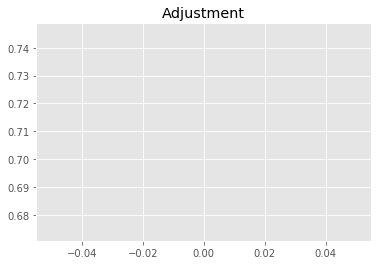

8122848901.107747
1


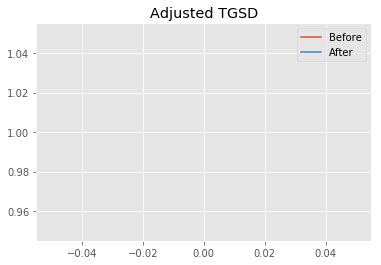

Old Total Mass: 1.14451e+10
New Total Mass: 1.14451e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.01879 	1.00208 	44915 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.14451e+10
After: 		|1.96885 	1 	44915 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 547.01
New Misfit: 546.826
Convergence:
0.0003359562953667709

____________________
a = 1.96885	b = 1.00000	            h1 = 44915.00000	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 11445119407.50561
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 546.8258612156602
Prior Misfit: 641.524,	 Post Misfit: 546.826


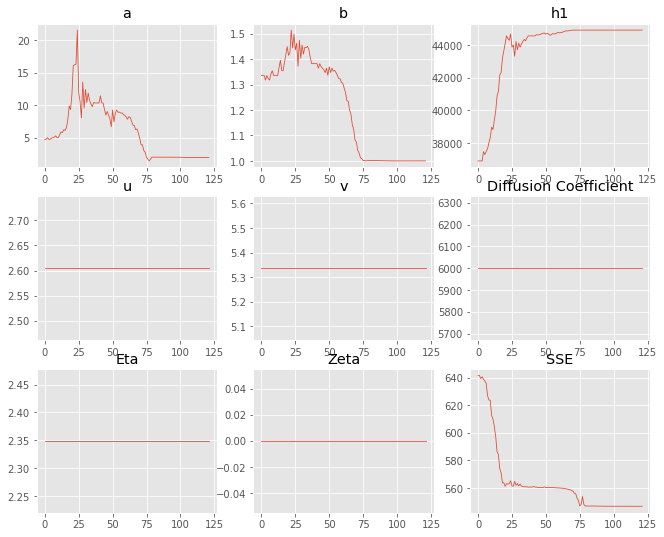

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,4.75849,1.96885
b,1.33592,1
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"36,896.6","44,915"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 16 Time: 0.068 minutes


Estimated remaining run time: 0.168 minutes


Run 16===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.14e+10 	2.98e+03 	1.90e+03 	0.6377 		1.0000


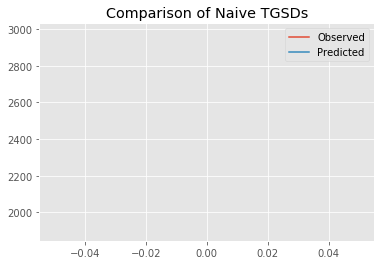

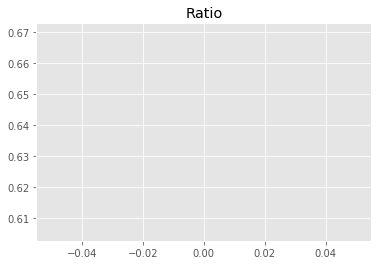

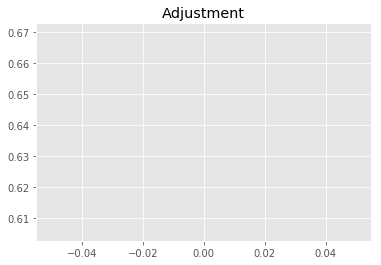

7298966035.866333
1


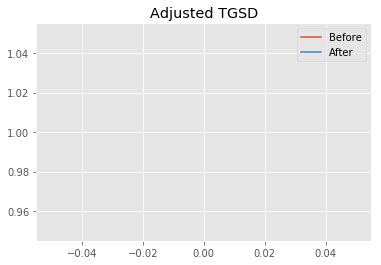

Old Total Mass: 1.14451e+10
New Total Mass: 1.14451e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.99932 	3.0781 	41667.5 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.14451e+10
After: 		|8.34765 	1.19345 	44889.5 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 692.25
New Misfit: 559.685
Convergence:
0.19149797534253044

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.14e+10 	2.33e+03 	1.90e+03 	0.8149 		1.0000


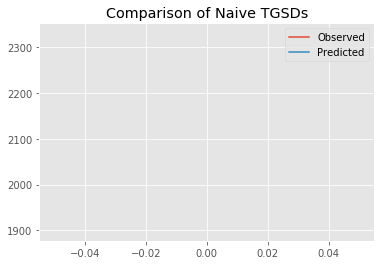

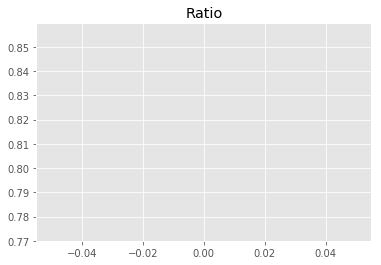

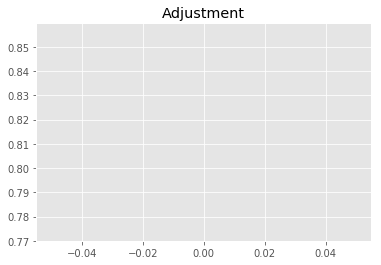

9326228086.660131
1


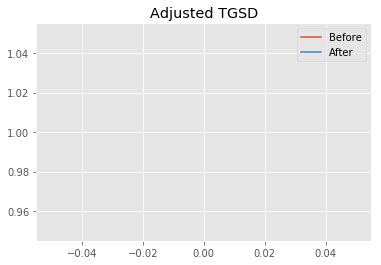

Old Total Mass: 1.14451e+10
New Total Mass: 1.14451e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|8.34765 	1.19345 	44889.5 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.14451e+10
After: 		|1.98366 	1.03684 	44872.8 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 559.685
New Misfit: 549.651
Convergence:
0.01792821581586057

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.14e+10 	2.69e+03 	1.90e+03 	0.7065 		1.0000


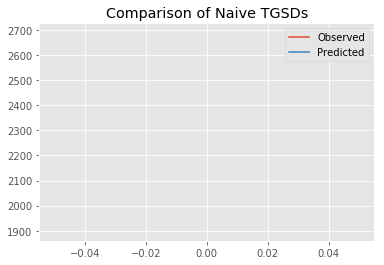

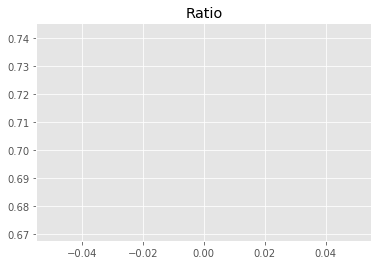

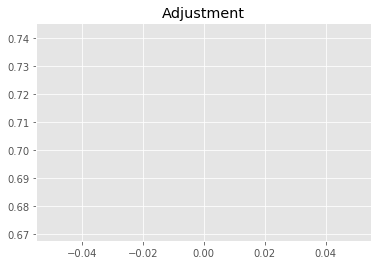

8086176333.987016
1


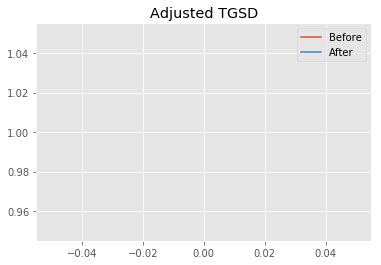

Old Total Mass: 1.14451e+10
New Total Mass: 1.14451e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.98366 	1.03684 	44872.8 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.14451e+10
After: 		|1.99295 	1.00003 	44901.5 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 549.651
New Misfit: 546.836
Convergence:
0.005122520143715595

____________________
a = 1.99295	b = 1.00003	            h1 = 44901.46578	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 11445119407.50561
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 546.8356088518614
Prior Misfit: 692.25,	 Post Misfit: 546.836


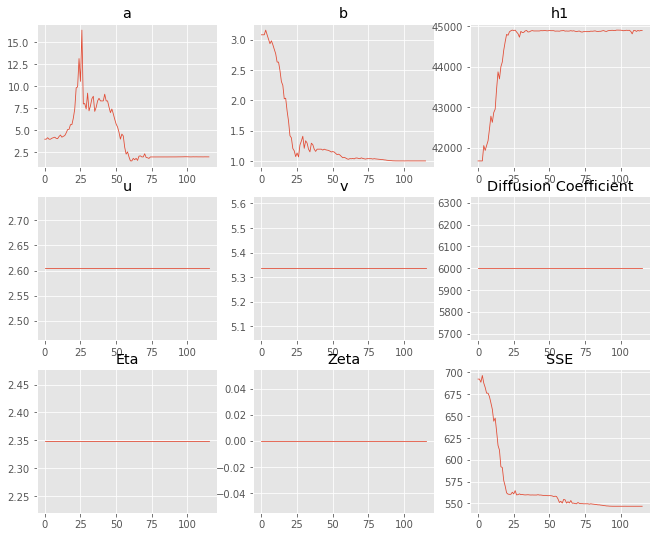

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,3.99932,1.99295
b,3.0781,1.00003
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"41,667.5","44,901.5"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 17 Time: 0.065 minutes


Estimated remaining run time: 0.113 minutes


Run 17===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.14e+10 	3.13e+03 	1.90e+03 	0.6065 		1.0000


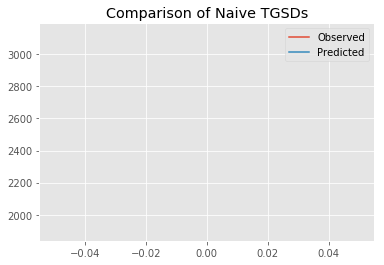

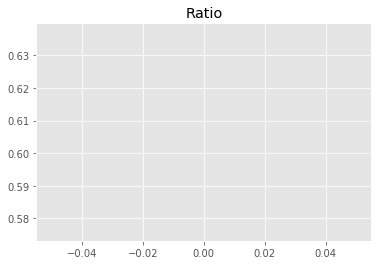

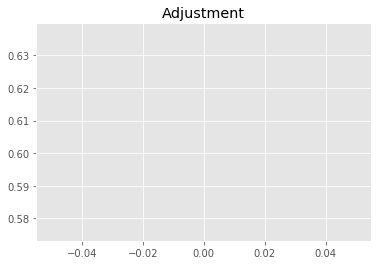

6941157479.534732
1


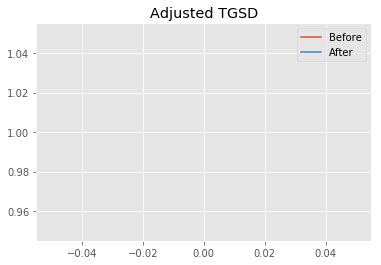

Old Total Mass: 1.14451e+10
New Total Mass: 1.14451e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|4.82872 	3.85191 	34846.4 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.14451e+10
After: 		|12.4446 	1.28228 	43891.2 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 799.875
New Misfit: 561.682
Convergence:
0.297787439419361

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.14e+10 	2.27e+03 	1.90e+03 	0.8349 		1.0000


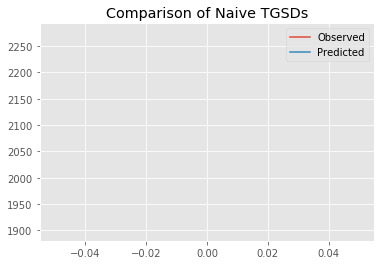

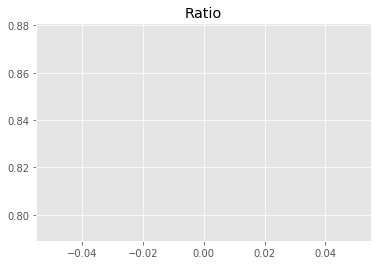

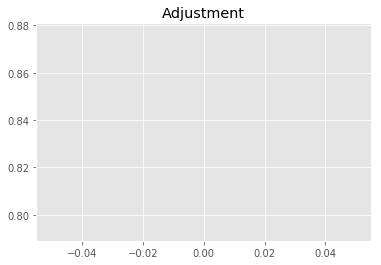

9555939698.611694
1


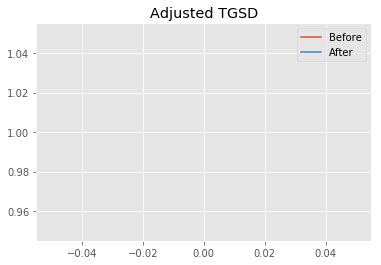

Old Total Mass: 1.14451e+10
New Total Mass: 1.14451e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|12.4446 	1.28228 	43891.2 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.14451e+10
After: 		|5.75575 	1.12475 	44867.1 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 561.682
New Misfit: 558.661
Convergence:
0.005379820933574537

____________________
a = 5.75575	b = 1.12475	            h1 = 44867.07032	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 11445119407.50561
Success: True
Status: Successful convergence.
Iterations: 2
Misfit: 558.6606100169641
Prior Misfit: 799.875,	 Post Misfit: 558.661


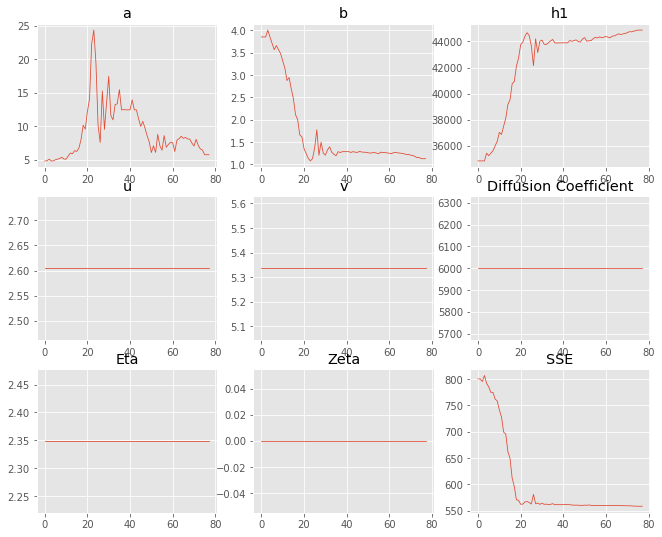

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,4.82872,5.75575
b,3.85191,1.12475
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"34,846.4","44,867.1"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 18 Time: 0.048 minutes


Estimated remaining run time: 0.056 minutes


Run 18===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.14e+10 	3.08e+03 	1.90e+03 	0.6158 		1.0000


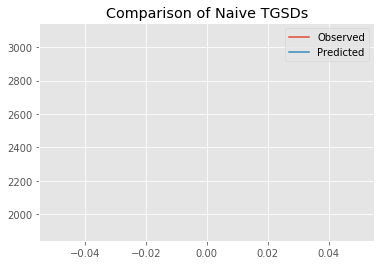

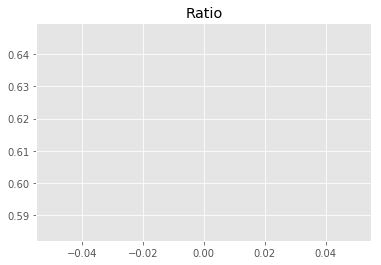

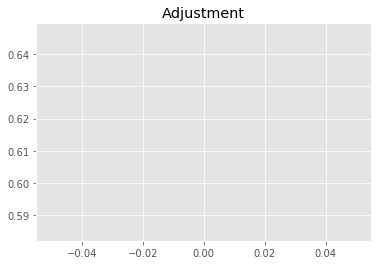

7047824772.831022
1


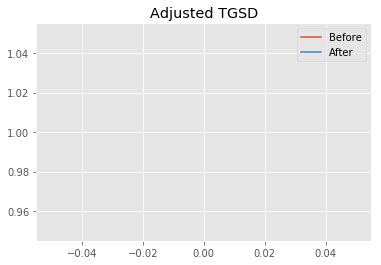

Old Total Mass: 1.14451e+10
New Total Mass: 1.14451e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|4.06354 	4.92036 	40901.5 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.14451e+10
After: 		|10.0165 	1.29745 	44012.7 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 788.44
New Misfit: 560.732
Convergence:
0.2888089653452381

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.14e+10 	2.32e+03 	1.90e+03 	0.8202 		1.0000


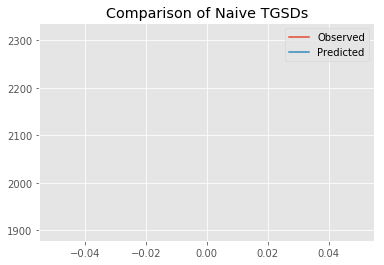

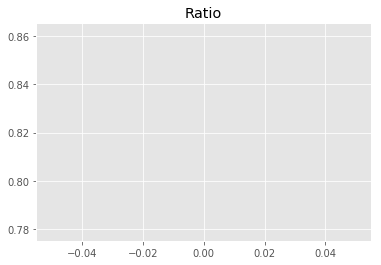

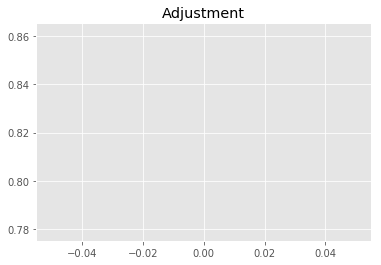

9387338918.892595
1


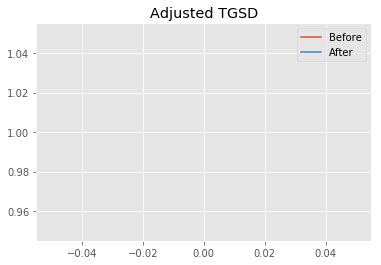

Old Total Mass: 1.14451e+10
New Total Mass: 1.14451e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|10.0165 	1.29745 	44012.7 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.14451e+10
After: 		|2.97393 	1.00859 	44912.6 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 560.732
New Misfit: 552.175
Convergence:
0.015260628256209942

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.14e+10 	2.58e+03 	1.90e+03 	0.7350 		1.0000


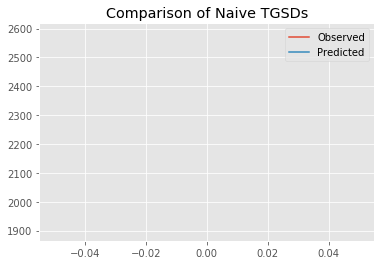

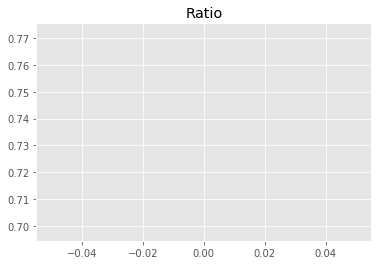

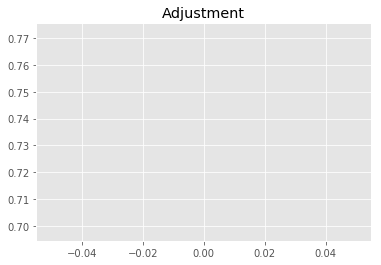

8411923245.324422
1


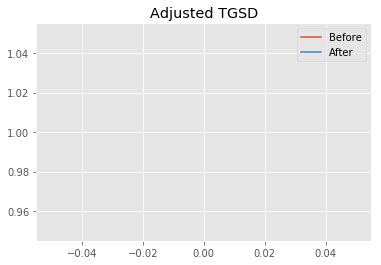

Old Total Mass: 1.14451e+10
New Total Mass: 1.14451e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.97393 	1.00859 	44912.6 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.14451e+10
After: 		|1.97204 	1.00034 	44914.4 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 552.175
New Misfit: 546.852
Convergence:
0.009640090119647369

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.14e+10 	2.68e+03 	1.90e+03 	0.7088 		1.0000


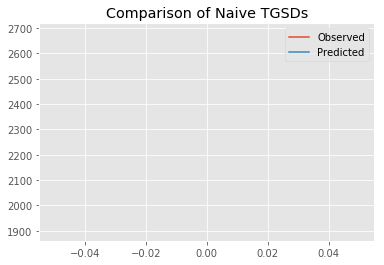

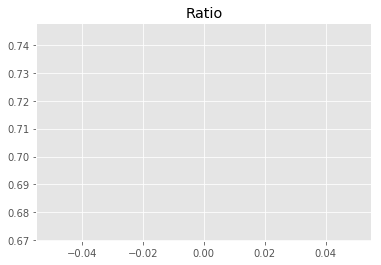

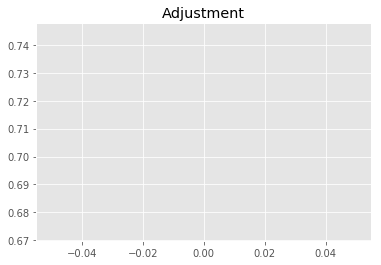

8111921256.894622
1


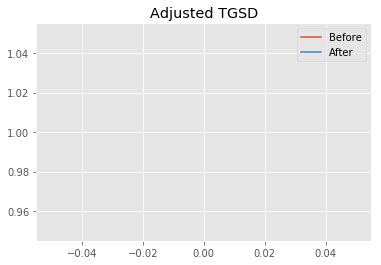

Old Total Mass: 1.14451e+10
New Total Mass: 1.14451e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.97204 	1.00034 	44914.4 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.14451e+10
After: 		|1.97014 	1 	44533 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 546.852
New Misfit: 546.826
Convergence:
4.7066201982155664e-05

____________________
a = 1.97014	b = 1.00000	            h1 = 44533.01086	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 11445119407.50561
Success: True
Status: Successful convergence.
Iterations: 4
Misfit: 546.825854397686
Prior Misfit: 788.44,	 Post Misfit: 546.826


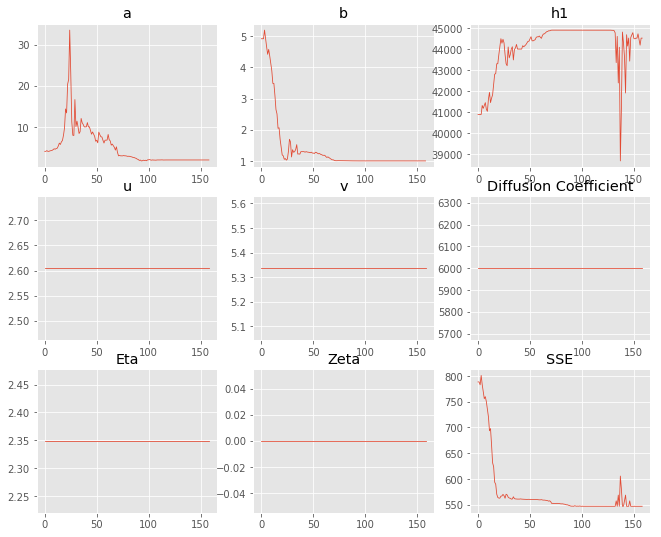

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,4.06354,1.97014
b,4.92036,1
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"40,901.5","44,533"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 19 Time: 0.085 minutes


Estimated remaining run time: 0.000 minutes


Run 19===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.14e+10 	3.04e+03 	1.90e+03 	0.6252 		1.0000


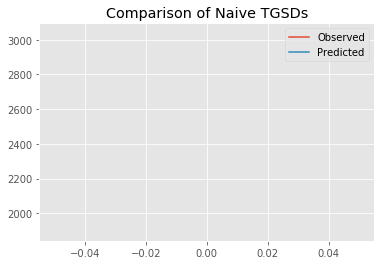

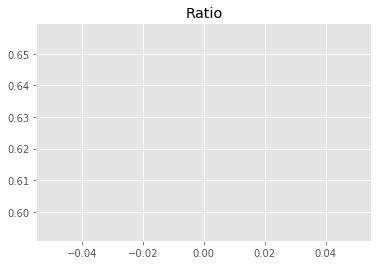

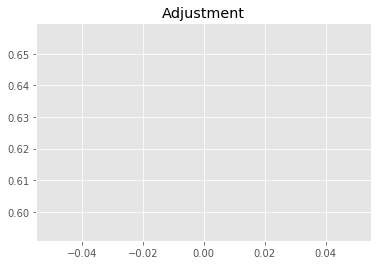

7155761714.552247
1


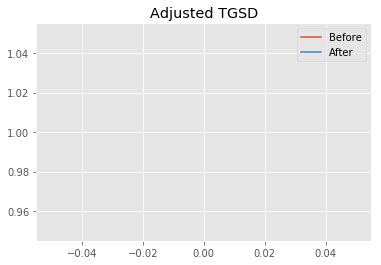

Old Total Mass: 1.14451e+10
New Total Mass: 1.14451e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.725 	3.22655 	39623.8 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.14451e+10
After: 		|7.70715 	1.11022 	44871.8 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 730.713
New Misfit: 559.201
Convergence:
0.23471858077506164

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.14e+10 	2.34e+03 	1.90e+03 	0.8127 		1.0000


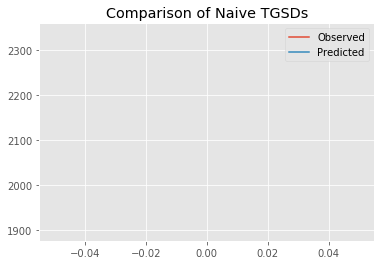

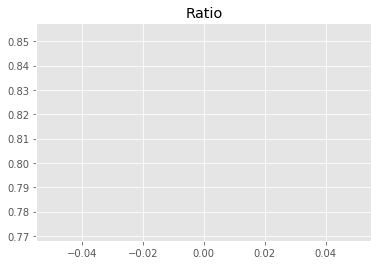

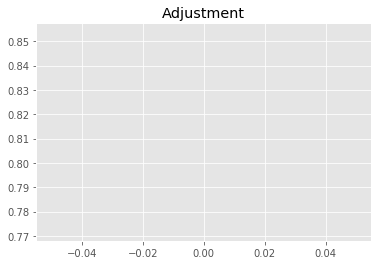

9300897728.577278
1


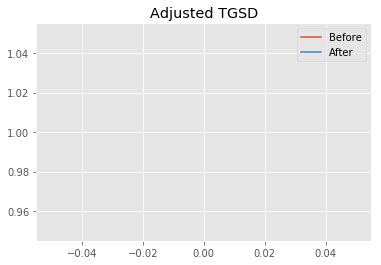

Old Total Mass: 1.14451e+10
New Total Mass: 1.14451e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|7.70715 	1.11022 	44871.8 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.14451e+10
After: 		|2.0173 	1.02418 	44873.5 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 559.201
New Misfit: 548.653
Convergence:
0.01886217434634304

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.14e+10 	2.68e+03 	1.90e+03 	0.7081 		1.0000


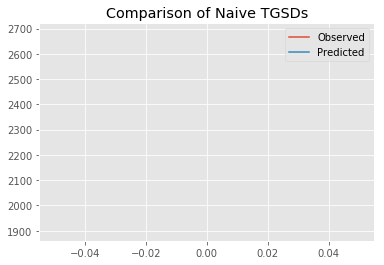

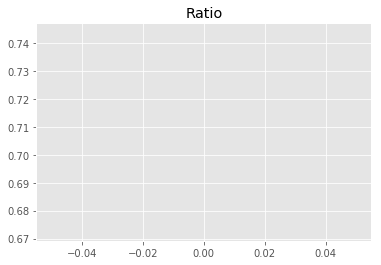

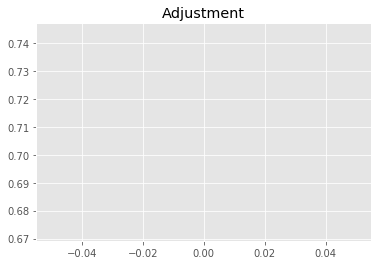

8104777664.153746
1


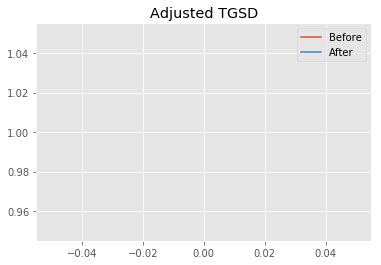

Old Total Mass: 1.14451e+10
New Total Mass: 1.14451e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.0173 	1.02418 	44873.5 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.14451e+10
After: 		|1.97064 	1 	44912 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 548.653
New Misfit: 546.826
Convergence:
0.0033302622846973075

____________________
a = 1.97064	b = 1.00000	            h1 = 44912.02888	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 11445119407.50561
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 546.825861133899
Prior Misfit: 730.713,	 Post Misfit: 546.826


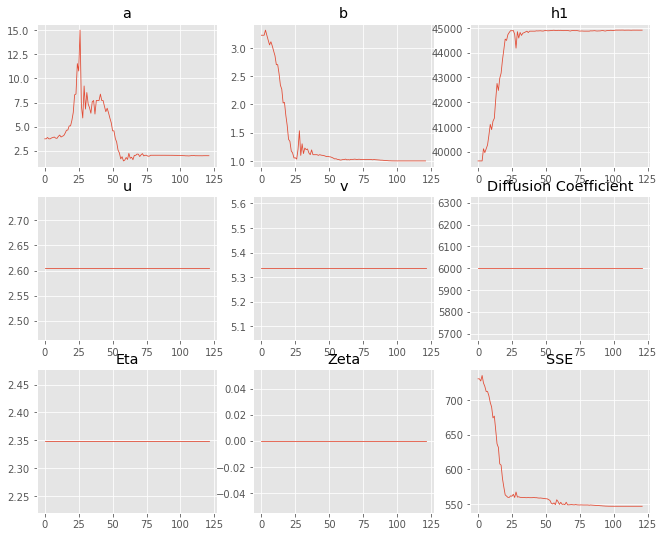

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,3.725,1.97064
b,3.22655,1
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"39,623.8","44,912"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 20 Time: 0.068 minutes


Estimated remaining run time: -0.058 minutes


Total Run Time: 1.22109 minutes


[{'a': 6.647225301721042,
  'b': 1.2028579643235213,
  'h1': 44661.81579608326,
  'u': 2.60482,
  'v': 5.33615,
  'D': 5999.899999999996,
  'ftt': 6457.999999999996,
  'eta': 2.34894,
  'zeta': 0.0},
 {'a': 5.2372504446919175,
  'b': 1.0943399439361454,
  'h1': 44645.17299497459,
  'u': 2.60482,
  'v': 5.33615,
  'D': 5999.899999999996,
  'ftt': 6457.999999999996,
  'eta': 2.34894,
  'zeta': 0.0},
 {'a': 1.9525556384527318,
  'b': 1.0001621523638928,
  'h1': 44914.99999808942,
  'u': 2.60482,
  'v': 5.33615,
  'D': 5999.899999999996,
  'ftt': 6457.999999999996,
  'eta': 2.34894,
  'zeta': 0.0},
 {'a': 1.965671078075645,
  'b': 1.0002282531346314,
  'h1': 44913.942193984905,
  'u': 2.60482,
  'v': 5.33615,
  'D': 5999.899999999996,
  'ftt': 6457.999999999996,
  'eta': 2.34894,
  'zeta': 0.0},
 {'a': 12.584413454979938,
  'b': 1.9050084736561945,
  'h1': 44914.999968270444,
  'u': 2.60482,
  'v': 5.33615,
  'D': 5999.899999999996,
  'ftt': 6457.999999999996,
  'eta': 2.34894,
  'zeta': 0

,a,b,h1,u,v,D,ftt,eta,zeta,M,Misfit
6,1.96971,1,"44,915",2.60482,5.33615,"5,999.9","6,458",2.34894,0,1.14451e+10,546.826
18,1.97014,1,"44,533",2.60482,5.33615,"5,999.9","6,458",2.34894,0,1.14451e+10,546.826
19,1.97064,1,"44,912",2.60482,5.33615,"5,999.9","6,458",2.34894,0,1.14451e+10,546.826
15,1.96885,1,"44,915",2.60482,5.33615,"5,999.9","6,458",2.34894,0,1.14451e+10,546.826
8,1.97155,1,"44,915",2.60482,5.33615,"5,999.9","6,458",2.34894,0,1.14451e+10,546.826
11,1.96862,1,"44,199.5",2.60482,5.33615,"5,999.9","6,458",2.34894,0,1.14451e+10,546.826
9,1.97063,1,"43,955.7",2.60482,5.33615,"5,999.9","6,458",2.34894,0,1.14451e+10,546.826
13,1.96994,1,"44,914.8",2.60482,5.33615,"5,999.9","6,458",2.34894,0,1.14451e+10,546.826
10,1.97857,1,"44,245.4",2.60482,5.33615,"5,999.9","6,458",2.34894,0,1.14451e+10,546.827
16,1.99295,1.00003,"44,901.5",2.60482,5.33615,"5,999.9","6,458",2.34894,0,1.14451e+10,546.836


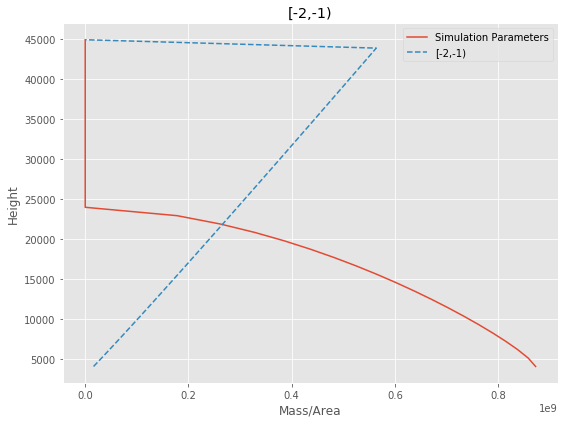

[-2,-1) Run Time: 1.22318 minutes


Mass Test: 34857356748.13845
========[-1,0)========
Run 0===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	2.67e+03 	1.82e+03 	0.6802 		1.0000


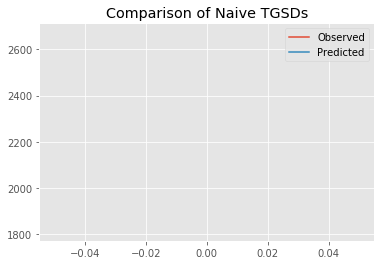

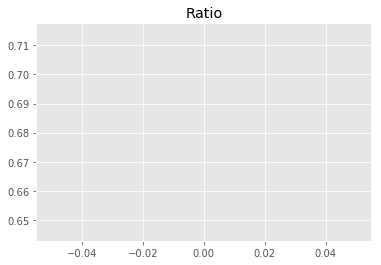

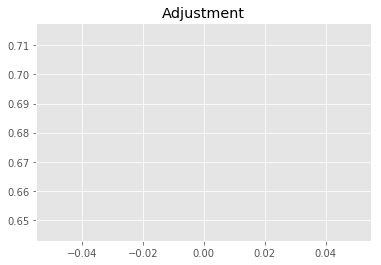

7442255974.54051
1


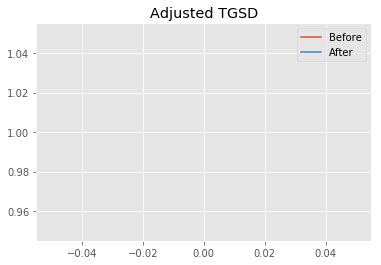

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.21918 	3.87541 	37644.6 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.09416e+10
After: 		|3.09041 	2.10963 	42882.7 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 523.48
New Misfit: 313.645
Convergence:
0.40084564136036455

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	2.05e+03 	1.82e+03 	0.8874 		1.0000


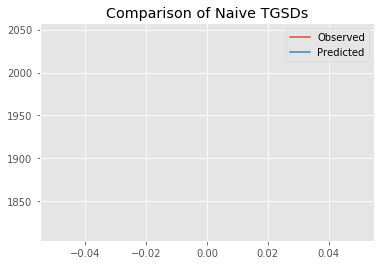

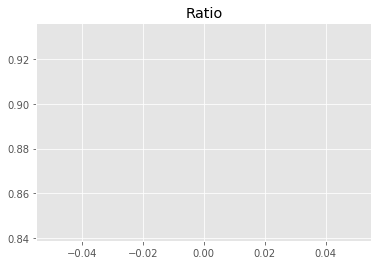

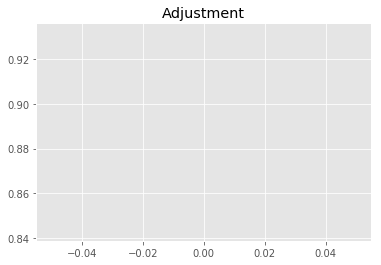

9709681648.33512
1


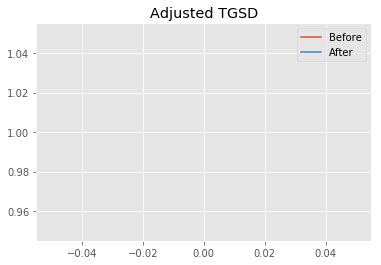

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.09041 	2.10963 	42882.7 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.09416e+10
After: 		|2.60071 	2.00578 	44851.8 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 313.645
New Misfit: 307.607
Convergence:
0.019251606931074895

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	2.06e+03 	1.82e+03 	0.8834 		1.0000


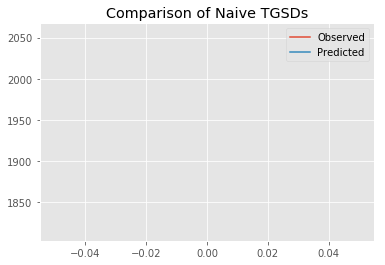

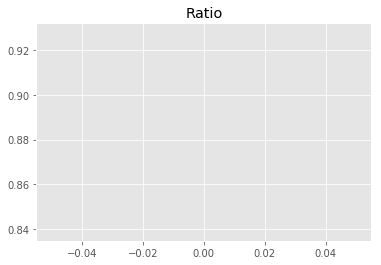

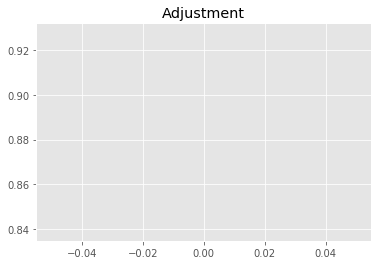

9665294917.27138
1


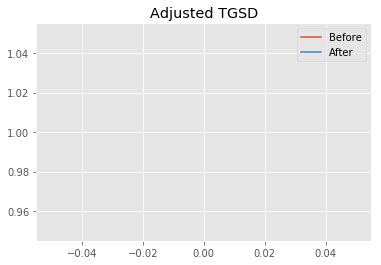

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.60071 	2.00578 	44851.8 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.09416e+10
After: 		|2.65197 	2.00364 	44914.9 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 307.607
New Misfit: 307.253
Convergence:
0.001151705466856154

____________________
a = 2.65197	b = 2.00364	            h1 = 44914.92795	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 10941602043.55702
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 307.2528527232349
Prior Misfit: 523.48,	 Post Misfit: 307.253


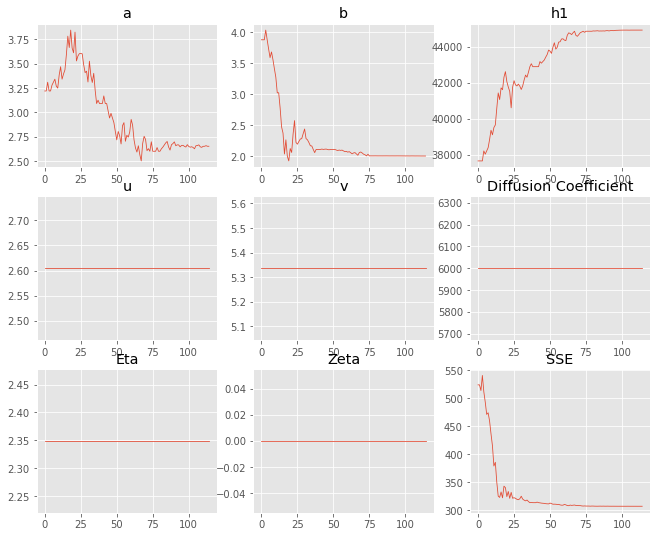

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,3.21918,2.65197
b,3.87541,2.00364
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"37,644.6","44,914.9"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 1 Time: 0.066 minutes


Estimated remaining run time: 0.598 minutes


Run 1===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	2.78e+03 	1.82e+03 	0.6527 		1.0000


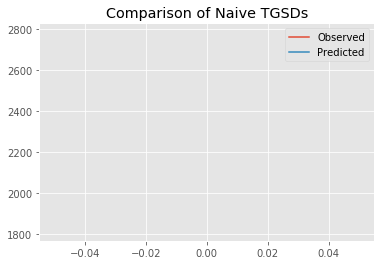

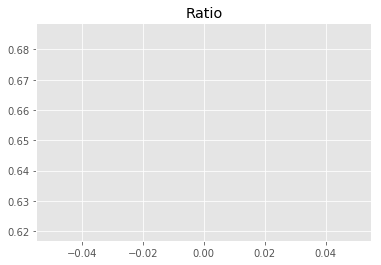

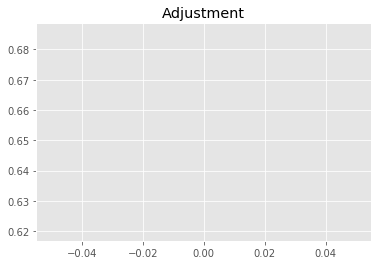

7141678797.744566
1


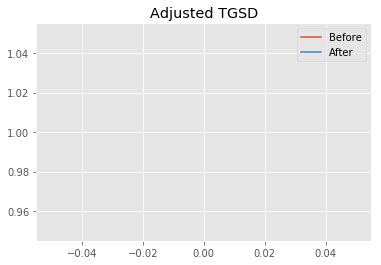

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|4.38023 	4.24393 	32701.3 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.09416e+10
After: 		|3.4109 	2.16344 	39208.3 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 573.274
New Misfit: 327.664
Convergence:
0.4284338386421634

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	2.16e+03 	1.82e+03 	0.8404 		1.0000


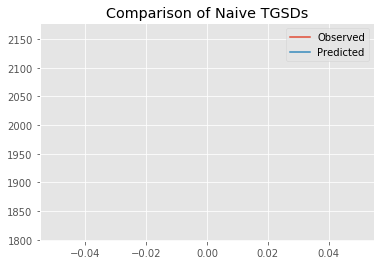

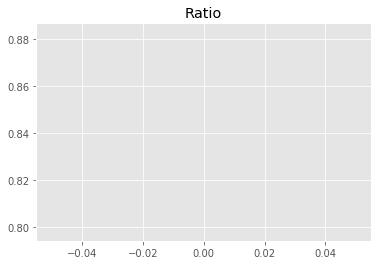

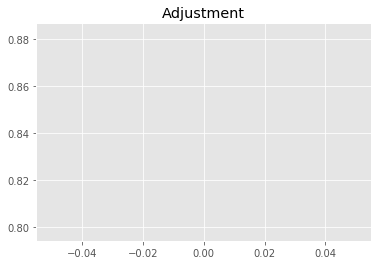

9195435234.107523
1


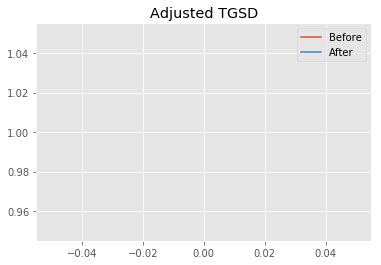

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.4109 	2.16344 	39208.3 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.09416e+10
After: 		|2.50637 	1.92786 	44883.2 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 327.664
New Misfit: 306.588
Convergence:
0.06432295316141738

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	2.05e+03 	1.82e+03 	0.8850 		1.0000


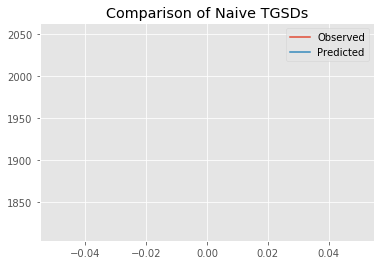

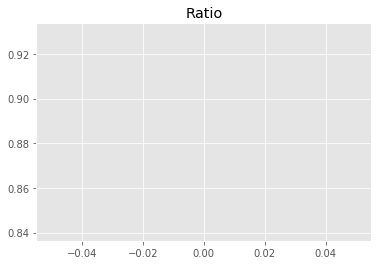

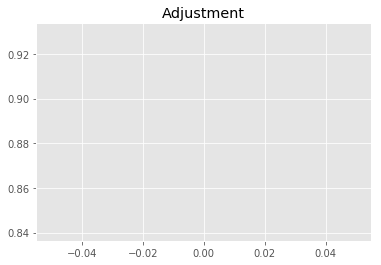

9683079772.99758
1


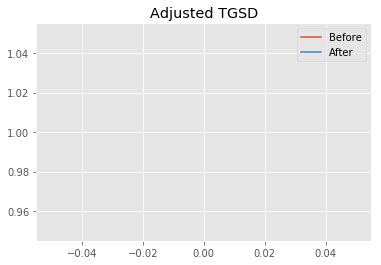

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.50637 	1.92786 	44883.2 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.09416e+10
After: 		|2.4759 	1.8349 	44779.6 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 306.588
New Misfit: 305.168
Convergence:
0.004630065220019449

____________________
a = 2.47590	b = 1.83490	            h1 = 44779.57245	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 10941602043.55702
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 305.1683631464888
Prior Misfit: 573.274,	 Post Misfit: 305.168


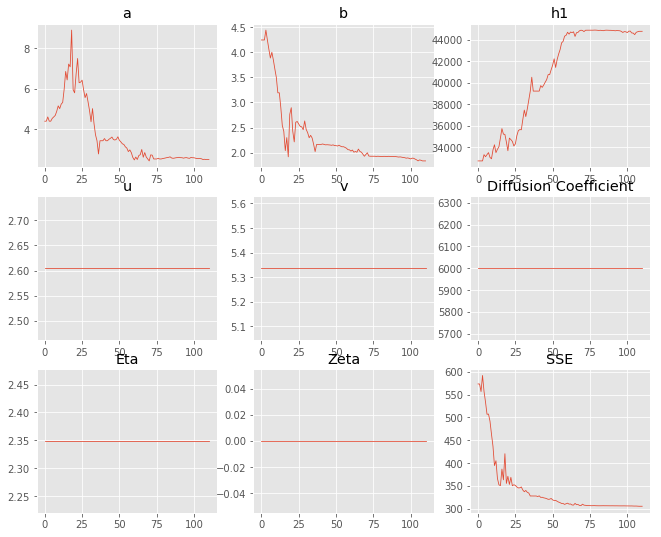

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,4.38023,2.4759
b,4.24393,1.8349
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"32,701.3","44,779.6"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 2 Time: 0.064 minutes


Estimated remaining run time: 0.741 minutes


Run 2===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	1.85e+03 	1.82e+03 	0.9817 		1.0000


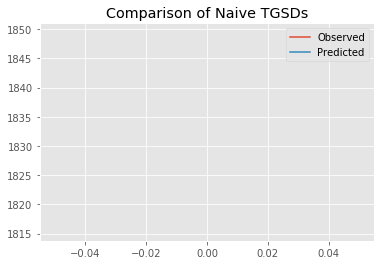

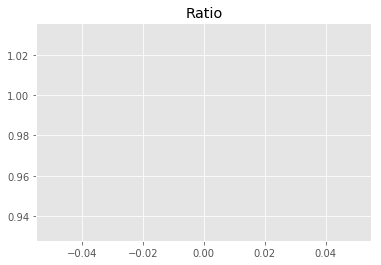

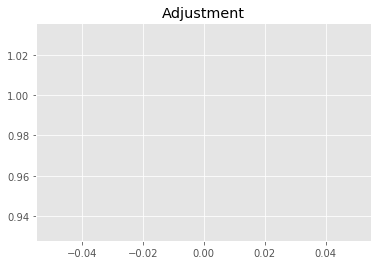

10741154640.360577
1


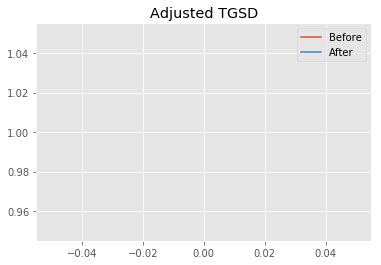

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|4.47985 	2.5282 	44076.3 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.09416e+10
After: 		|3.28731 	2.4743 	44607.9 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 357.085
New Misfit: 315.031
Convergence:
0.11776899299387349

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	2.05e+03 	1.82e+03 	0.8863 		1.0000


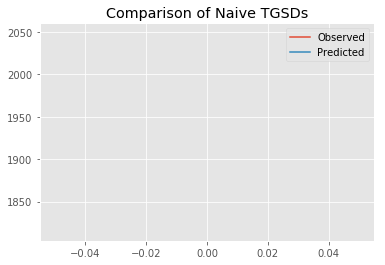

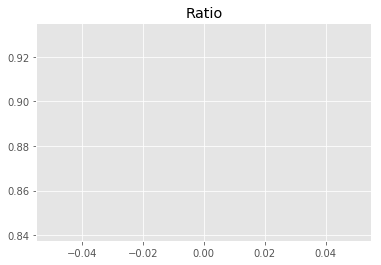

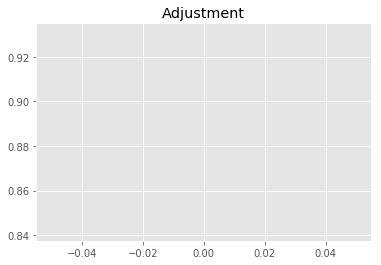

9697137953.64009
1


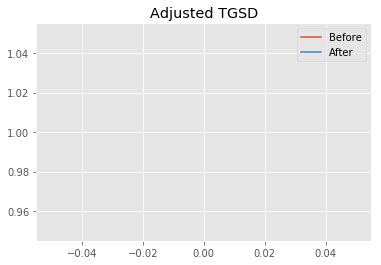

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.28731 	2.4743 	44607.9 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.09416e+10
After: 		|1.84575 	1.22404 	44915 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 315.031
New Misfit: 300.501
Convergence:
0.046123139589767014

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	1.95e+03 	1.82e+03 	0.9304 		1.0000


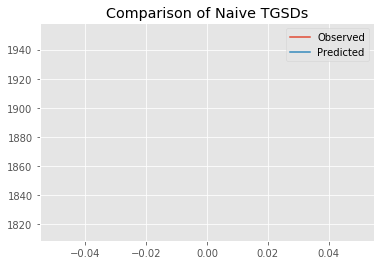

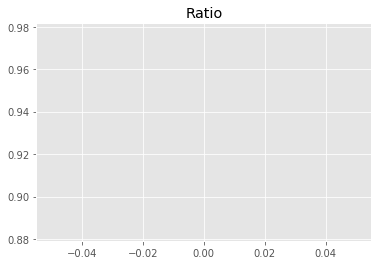

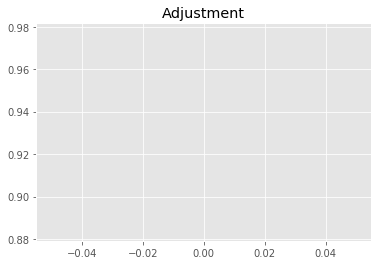

10179935504.945532
1


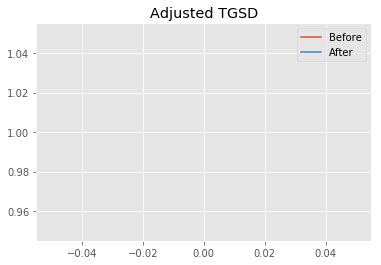

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.84575 	1.22404 	44915 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.09416e+10
After: 		|1.87942 	1.25728 	44915 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 300.501
New Misfit: 300.475
Convergence:
8.642023651303363e-05

____________________
a = 1.87942	b = 1.25728	            h1 = 44915.00000	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 10941602043.55702
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 300.47493163685544
Prior Misfit: 357.085,	 Post Misfit: 300.475


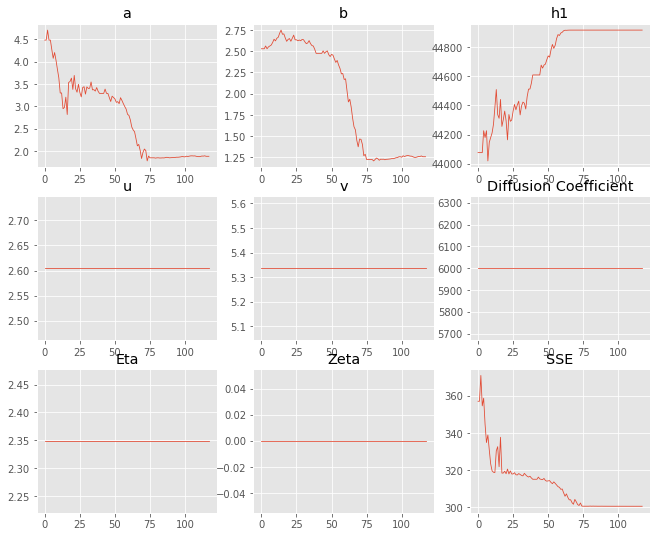

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,4.47985,1.87942
b,2.5282,1.25728
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"44,076.3","44,915"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 3 Time: 0.065 minutes


Estimated remaining run time: 0.784 minutes


Run 3===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	2.69e+03 	1.82e+03 	0.6759 		1.0000


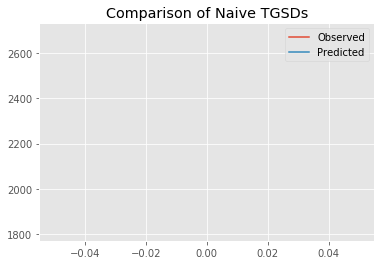

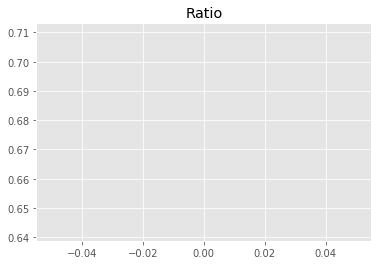

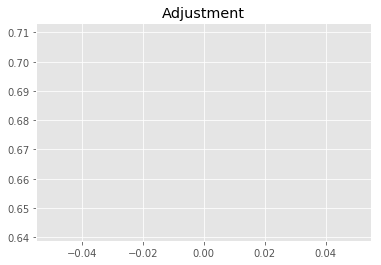

7395925945.499489
1


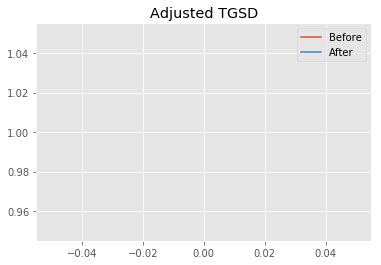

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|4.35282 	4.06624 	34326.7 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.09416e+10
After: 		|3.63138 	2.35343 	40792.3 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 514.506
New Misfit: 323.491
Convergence:
0.37125902734945837

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	2.10e+03 	1.82e+03 	0.8640 		1.0000


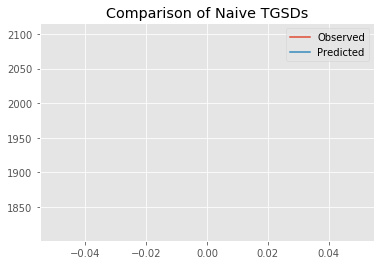

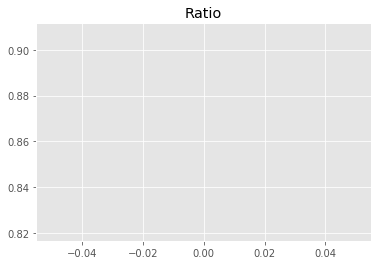

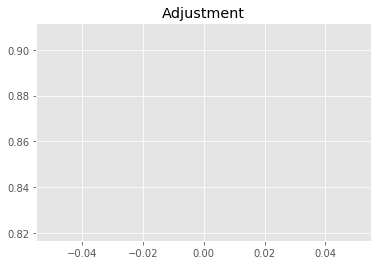

9453762065.81868
1


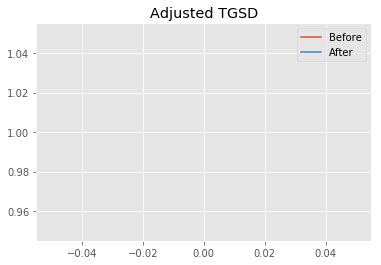

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.63138 	2.35343 	40792.3 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.09416e+10
After: 		|2.14029 	1.64223 	44913.3 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 323.491
New Misfit: 304.41
Convergence:
0.05898605045681643

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	2.04e+03 	1.82e+03 	0.8882 		1.0000


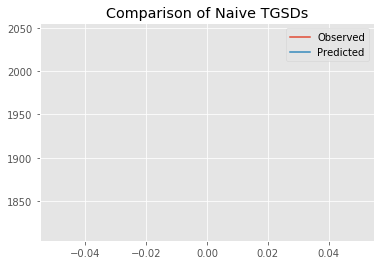

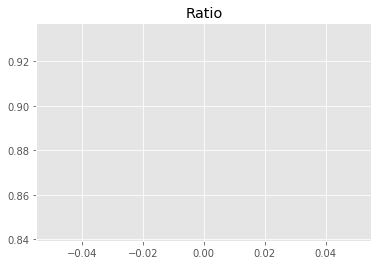

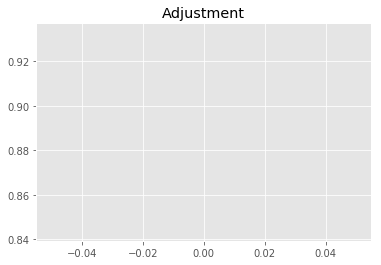

9718773090.62544
1


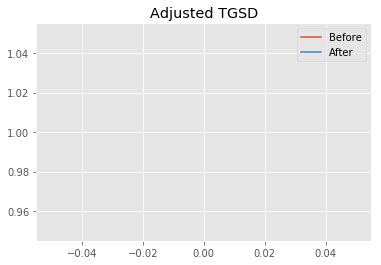

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.14029 	1.64223 	44913.3 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.09416e+10
After: 		|1.96967 	1.3632 	44906.7 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 304.41
New Misfit: 300.713
Convergence:
0.012141927834796723

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	1.98e+03 	1.82e+03 	0.9183 		1.0000


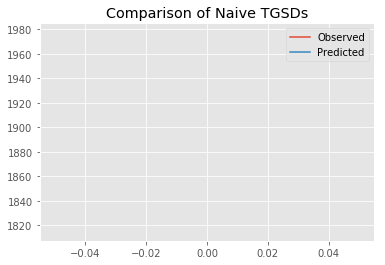

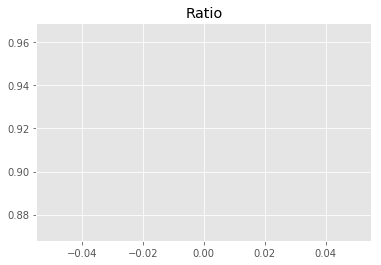

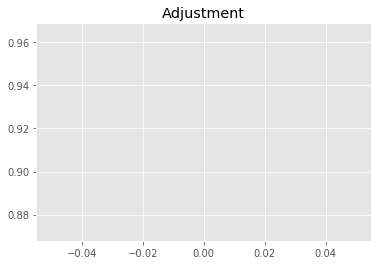

10048066242.76997
1


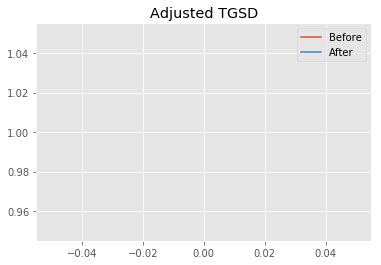

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.96967 	1.3632 	44906.7 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.09416e+10
After: 		|1.96467 	1.32653 	44856.2 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 300.713
New Misfit: 300.586
Convergence:
0.00042419320918073297

____________________
a = 1.96467	b = 1.32653	            h1 = 44856.19312	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 10941602043.55702
Success: True
Status: Successful convergence.
Iterations: 4
Misfit: 300.58583621925135
Prior Misfit: 514.506,	 Post Misfit: 300.586


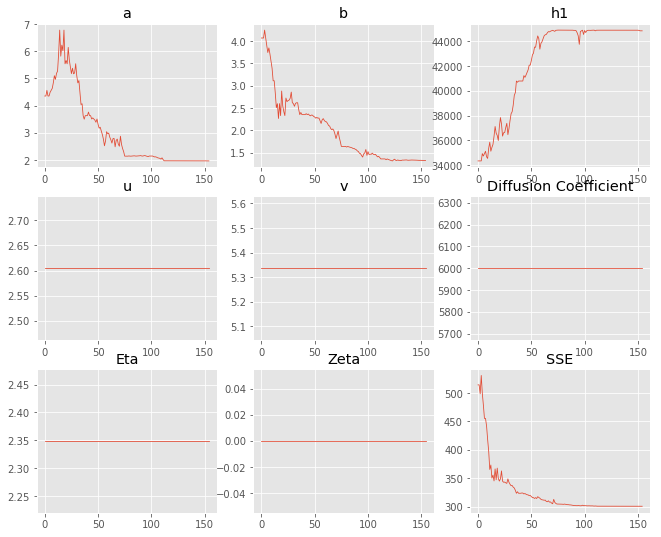

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,4.35282,1.96467
b,4.06624,1.32653
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"34,326.7","44,856.2"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 4 Time: 0.084 minutes


Estimated remaining run time: 0.839 minutes


Run 4===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	2.21e+03 	1.82e+03 	0.8204 		1.0000


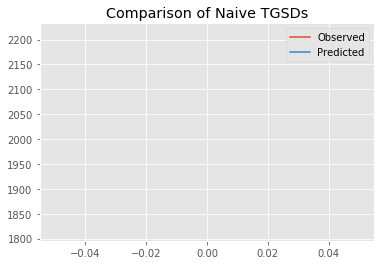

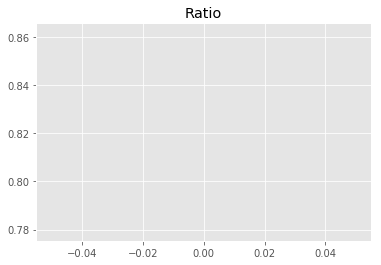

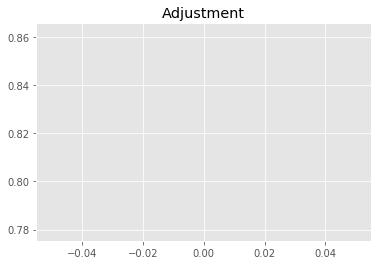

8977016435.034348
1


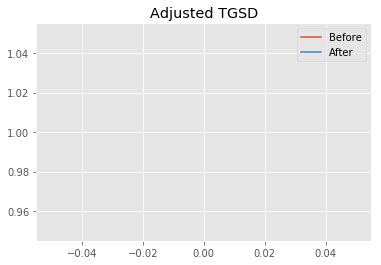

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|4.32693 	1.82129 	33446.7 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.09416e+10
After: 		|2.59137 	1.86125 	43287.5 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 347.607
New Misfit: 308.389
Convergence:
0.11282380492627331

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	2.06e+03 	1.82e+03 	0.8802 		1.0000


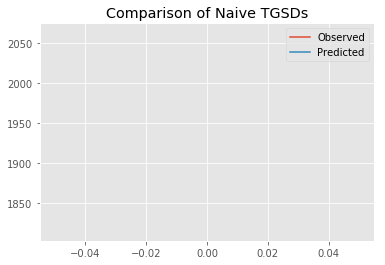

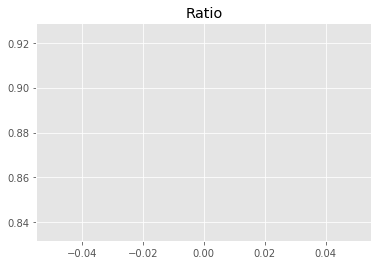

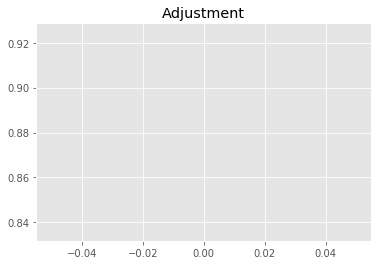

9630808005.777351
1


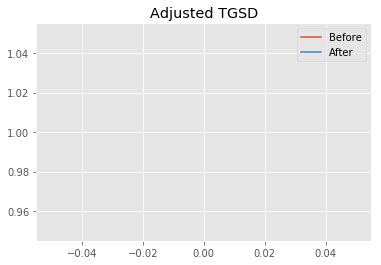

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.59137 	1.86125 	43287.5 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.09416e+10
After: 		|2.283 	1.63757 	44905.8 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 308.389
New Misfit: 302.731
Convergence:
0.018345726132283323

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	2.00e+03 	1.82e+03 	0.9071 		1.0000


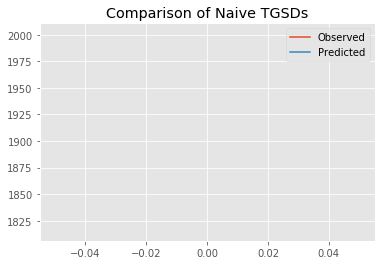

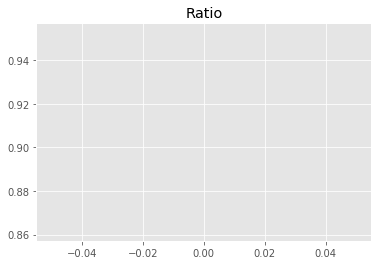

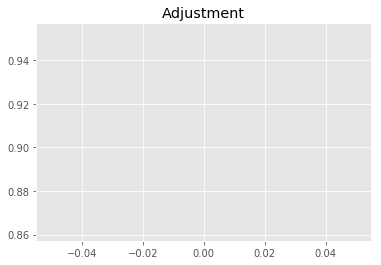

9924755881.583208
1


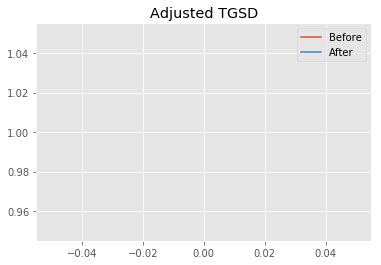

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.283 	1.63757 	44905.8 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.09416e+10
After: 		|1.90407 	1.27366 	44914.9 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 302.731
New Misfit: 300.487
Convergence:
0.007413754721098515

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	1.96e+03 	1.82e+03 	0.9280 		1.0000


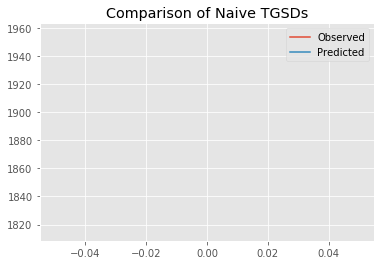

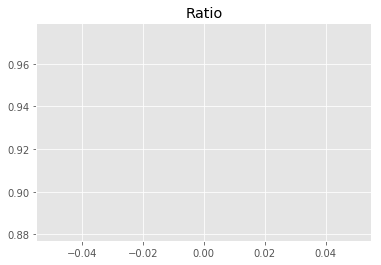

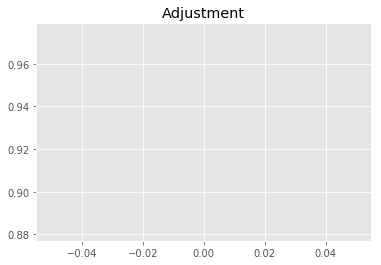

10153515018.97394
1


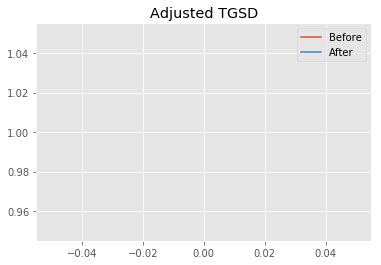

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.90407 	1.27366 	44914.9 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.09416e+10
After: 		|1.87745 	1.25577 	44897.7 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 300.487
New Misfit: 300.474
Convergence:
4.270268233324186e-05

____________________
a = 1.87745	b = 1.25577	            h1 = 44897.66645	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 10941602043.55702
Success: True
Status: Successful convergence.
Iterations: 4
Misfit: 300.4741512669659
Prior Misfit: 347.607,	 Post Misfit: 300.474


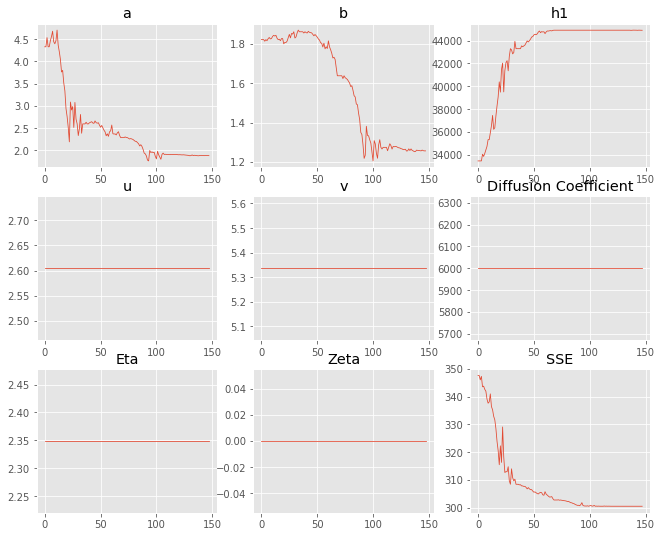

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,4.32693,1.87745
b,1.82129,1.25577
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"33,446.7","44,897.7"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 5 Time: 0.083 minutes


Estimated remaining run time: 0.845 minutes


Run 5===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	2.39e+03 	1.82e+03 	0.7591 		1.0000


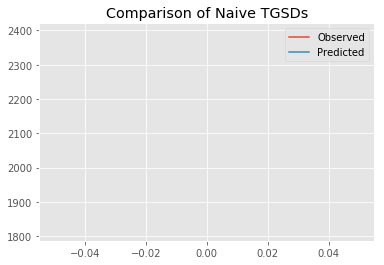

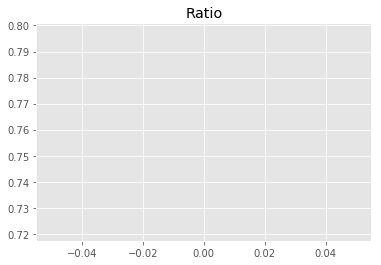

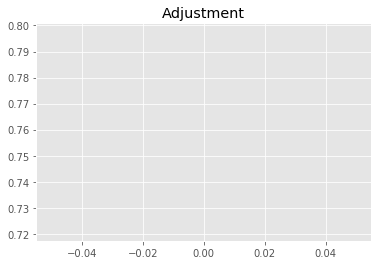

8305407878.438696
1


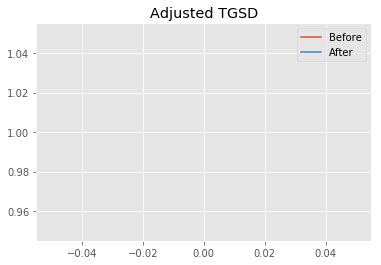

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|4.29835 	3.82466 	39876.2 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.09416e+10
After: 		|2.38606 	1.8463 	44473.7 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 384.531
New Misfit: 307.081
Convergence:
0.20141505188531644

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	2.07e+03 	1.82e+03 	0.8784 		1.0000


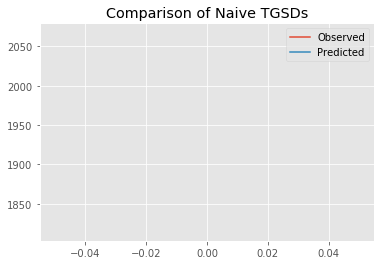

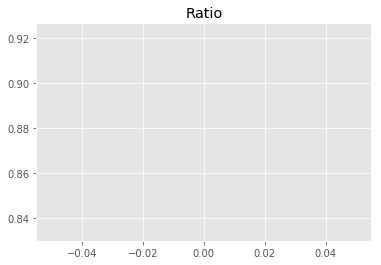

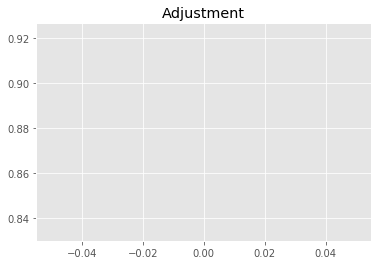

9610715790.735813
1


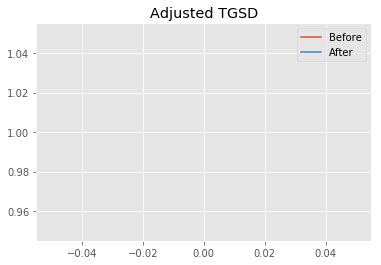

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.38606 	1.8463 	44473.7 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.09416e+10
After: 		|2.41995 	1.75193 	44648.2 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 307.081
New Misfit: 304.277
Convergence:
0.009130085974137824

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	2.02e+03 	1.82e+03 	0.9006 		1.0000


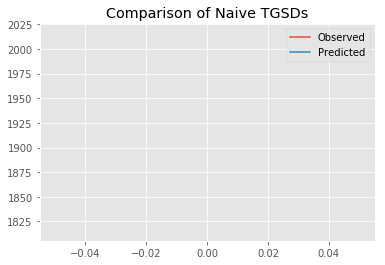

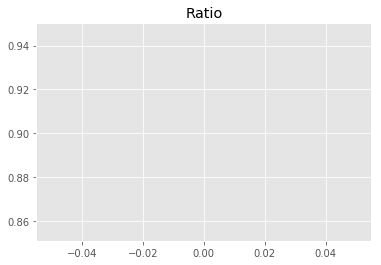

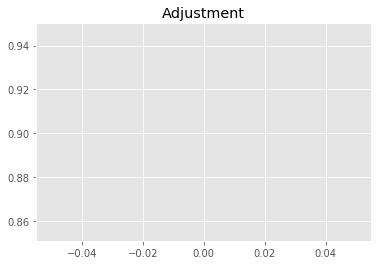

9853971006.523638
1


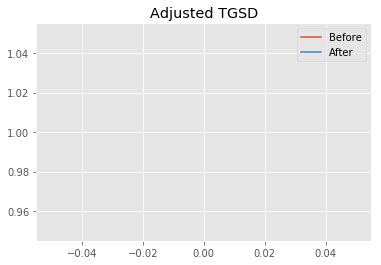

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.41995 	1.75193 	44648.2 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.09416e+10
After: 		|1.91074 	1.28522 	44708.3 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 304.277
New Misfit: 300.485
Convergence:
0.012461990893247248

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	1.96e+03 	1.82e+03 	0.9250 		1.0000


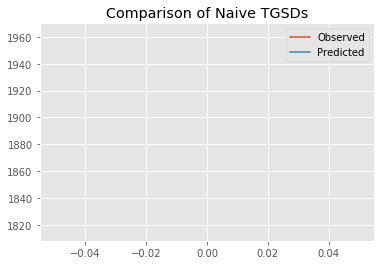

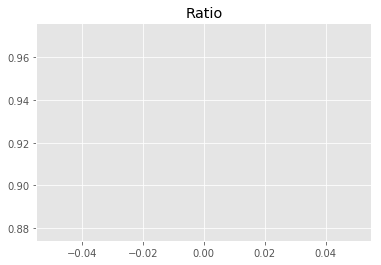

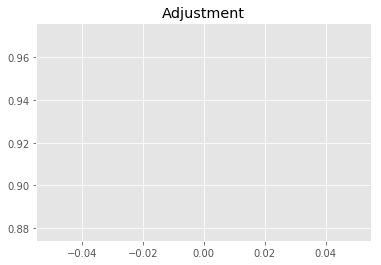

10120940183.0578
1


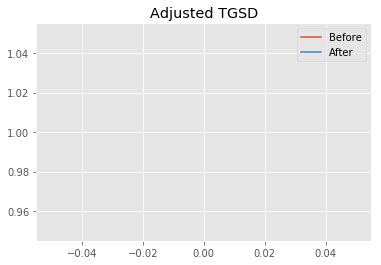

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.91074 	1.28522 	44708.3 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.09416e+10
After: 		|1.87764 	1.23267 	43922.9 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 300.485
New Misfit: 300.404
Convergence:
0.00027034070098280364

____________________
a = 1.87764	b = 1.23267	            h1 = 43922.86125	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 10941602043.55702
Success: True
Status: Successful convergence.
Iterations: 4
Misfit: 300.40421526194336
Prior Misfit: 384.531,	 Post Misfit: 300.404


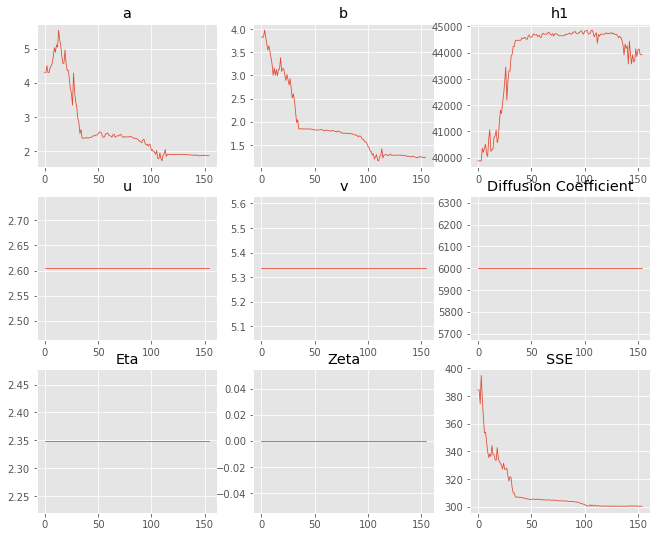

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,4.29835,1.87764
b,3.82466,1.23267
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"39,876.2","43,922.9"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 6 Time: 0.083 minutes


Estimated remaining run time: 0.826 minutes


Run 6===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	2.47e+03 	1.82e+03 	0.7348 		1.0000


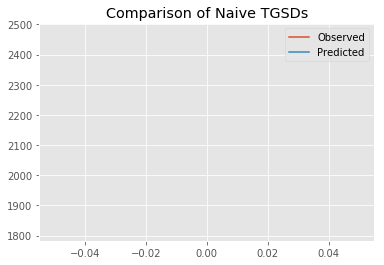

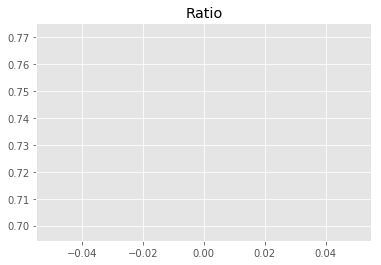

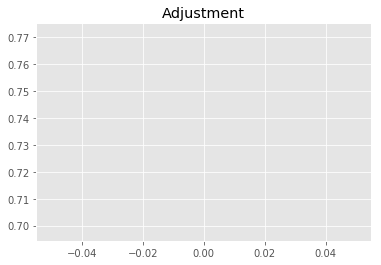

8039705080.3441725
1


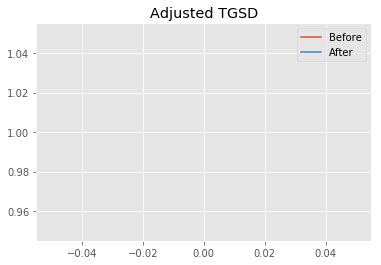

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.58265 	3.06017 	37195.8 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.09416e+10
After: 		|3.04631 	2.05793 	42964.4 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 412.825
New Misfit: 312.904
Convergence:
0.24204111853015203

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	2.03e+03 	1.82e+03 	0.8922 		1.0000


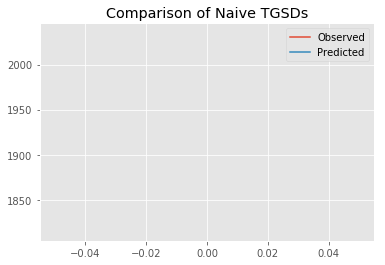

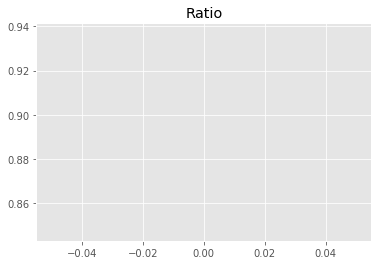

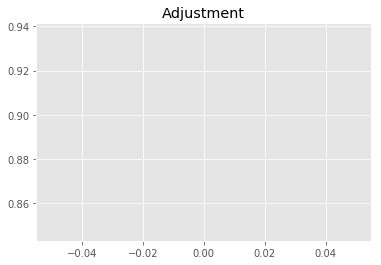

9762193629.986214
1


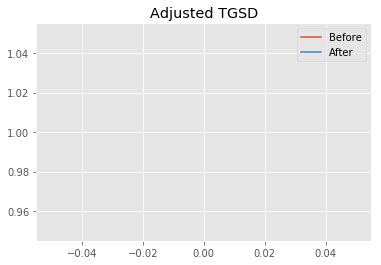

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.04631 	2.05793 	42964.4 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.09416e+10
After: 		|2.64554 	2.0127 	44911.1 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 312.904
New Misfit: 307.4
Convergence:
0.017590186386006842

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	2.04e+03 	1.82e+03 	0.8882 		1.0000


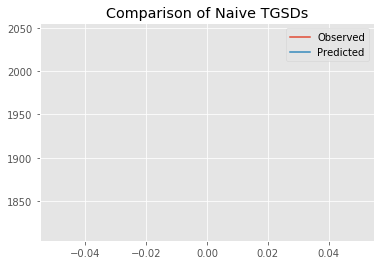

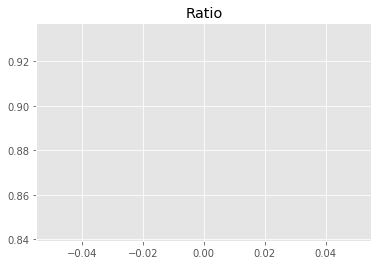

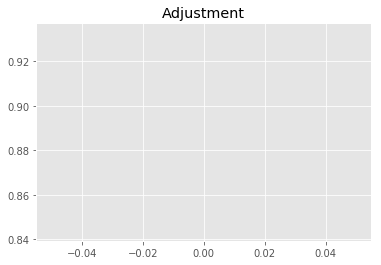

9718864593.855091
1


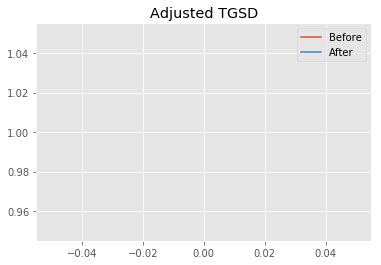

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.64554 	2.0127 	44911.1 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.09416e+10
After: 		|2.37066 	1.75975 	44915 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 307.4
New Misfit: 304.118
Convergence:
0.010678788971552281

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	2.02e+03 	1.82e+03 	0.8967 		1.0000


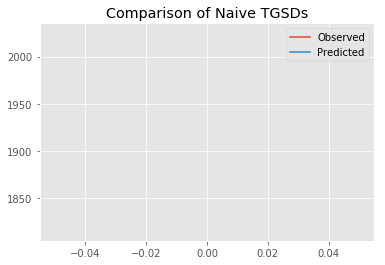

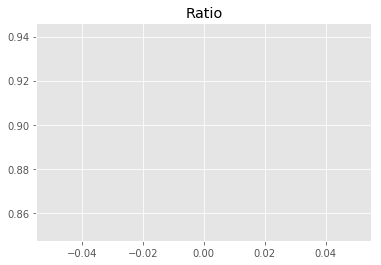

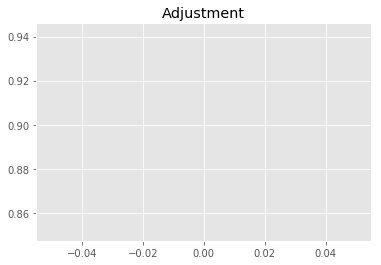

9810909658.820345
1


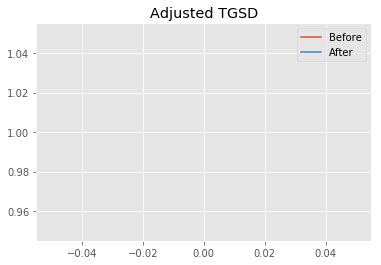

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.37066 	1.75975 	44915 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.09416e+10
After: 		|2.37066 	1.74938 	44915 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 304.118
New Misfit: 303.961
Convergence:
0.000514245739872568

____________________
a = 2.37066	b = 1.74938	            h1 = 44915.00000	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 10941602043.55702
Success: True
Status: Successful convergence.
Iterations: 4
Misfit: 303.9611736878516
Prior Misfit: 412.825,	 Post Misfit: 303.961


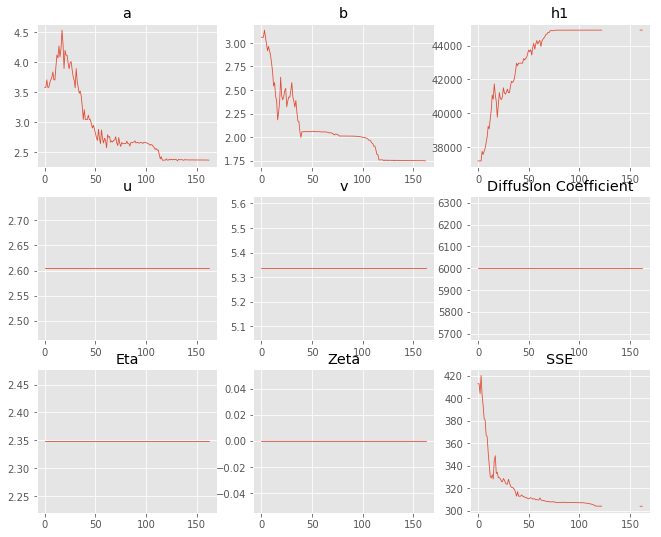

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,3.58265,2.37066
b,3.06017,1.74938
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"37,195.8","44,915"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 7 Time: 0.086 minutes


Estimated remaining run time: 0.797 minutes


Run 7===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	2.47e+03 	1.82e+03 	0.7344 		1.0000


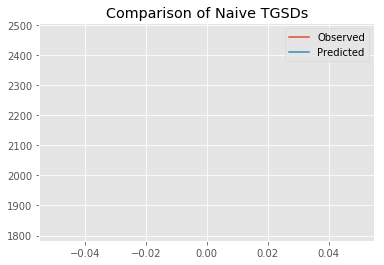

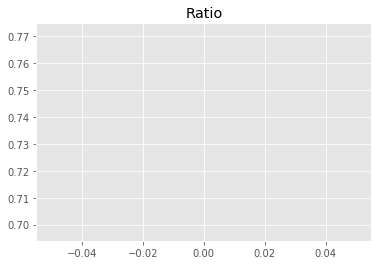

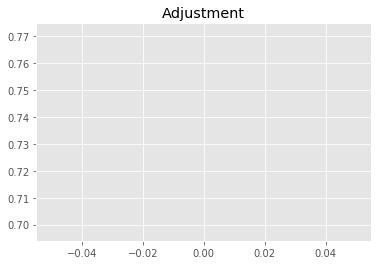

8035203645.710839
1


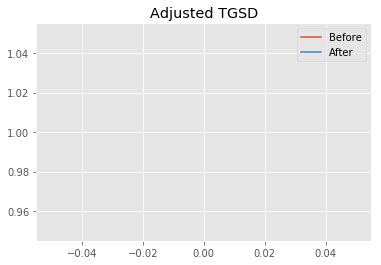

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.43701 	1.55058 	30110.6 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.09416e+10
After: 		|2.23351 	1.42582 	40380.3 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 411.514
New Misfit: 309.956
Convergence:
0.24678979033031917

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	2.10e+03 	1.82e+03 	0.8645 		1.0000


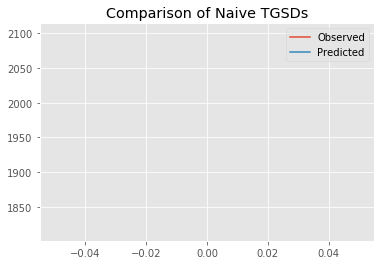

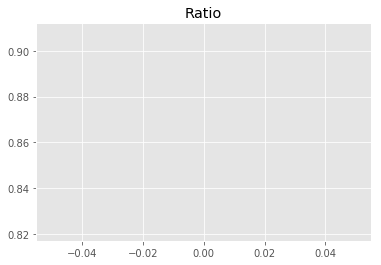

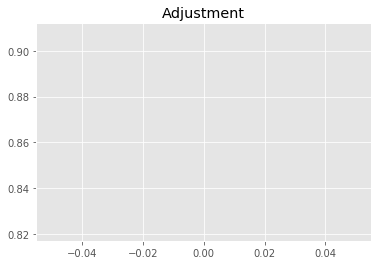

9458998034.54209
1


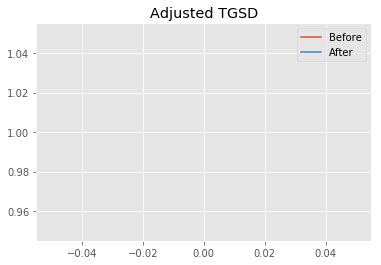

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.23351 	1.42582 	40380.3 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.09416e+10
After: 		|1.88478 	1.26341 	44724.7 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 309.956
New Misfit: 300.47
Convergence:
0.03060466509625559

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	1.96e+03 	1.82e+03 	0.9262 		1.0000


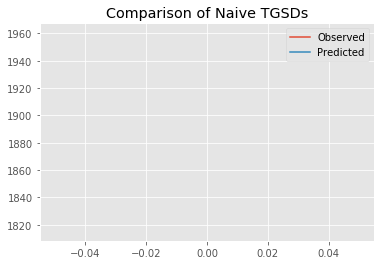

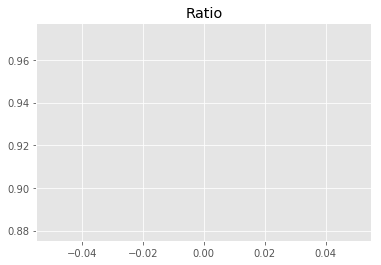

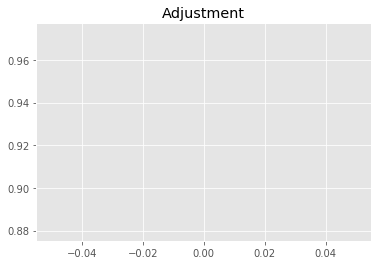

10133845777.002647
1


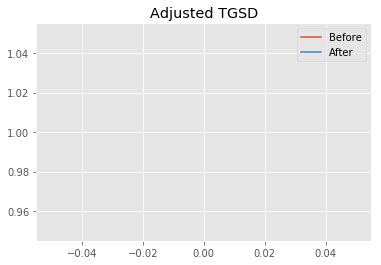

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.88478 	1.26341 	44724.7 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.09416e+10
After: 		|1.87217 	1.22298 	43869.3 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 300.47
New Misfit: 300.39
Convergence:
0.0002653066700438906

____________________
a = 1.87217	b = 1.22298	            h1 = 43869.28952	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 10941602043.55702
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 300.3903772951985
Prior Misfit: 411.514,	 Post Misfit: 300.39


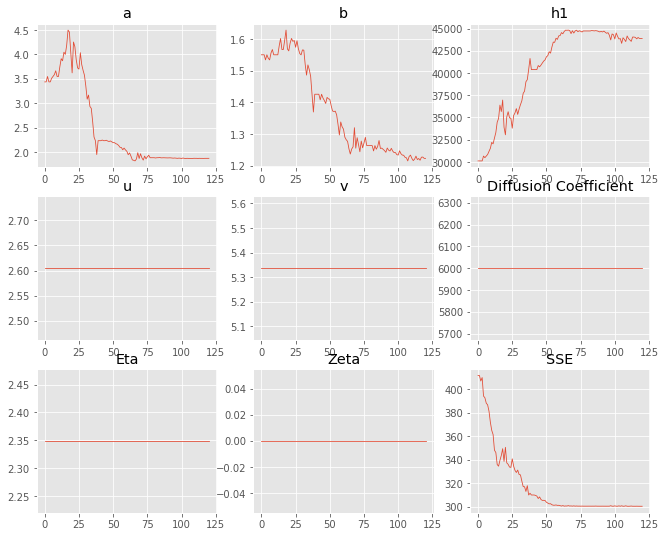

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,3.43701,1.87217
b,1.55058,1.22298
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"30,110.6","43,869.3"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 8 Time: 0.067 minutes


Estimated remaining run time: 0.731 minutes


Run 8===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	2.52e+03 	1.82e+03 	0.7207 		1.0000


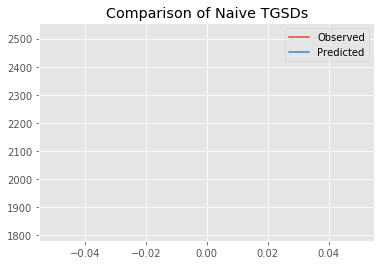

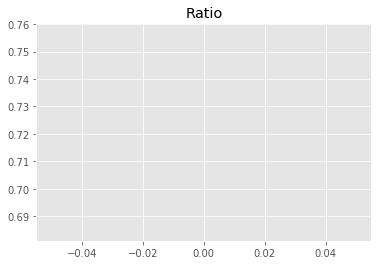

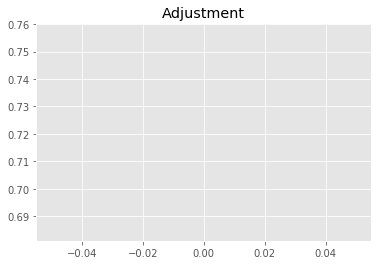

7885234227.641134
1


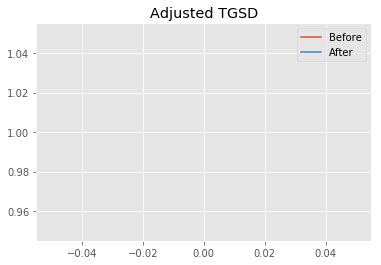

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.64943 	2.18692 	39151.3 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.09416e+10
After: 		|2.57155 	1.95363 	44900 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 511.008
New Misfit: 306.642
Convergence:
0.39992779621764357

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	2.04e+03 	1.82e+03 	0.8887 		1.0000


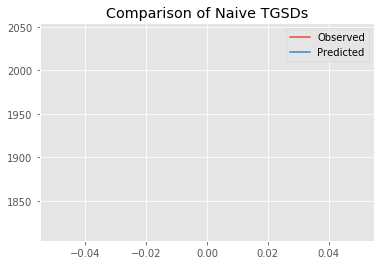

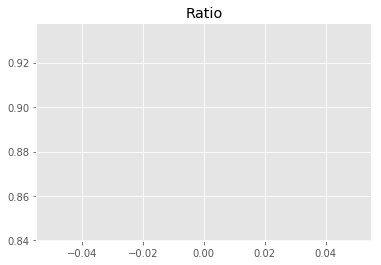

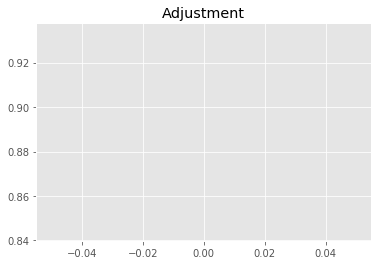

9724301763.895195
1


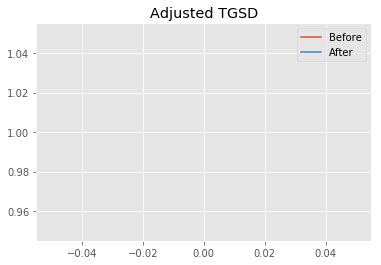

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.57155 	1.95363 	44900 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.09416e+10
After: 		|1.91687 	1.35258 	44915 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 306.642
New Misfit: 301.056
Convergence:
0.01821598005884986

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	1.99e+03 	1.82e+03 	0.9133 		1.0000


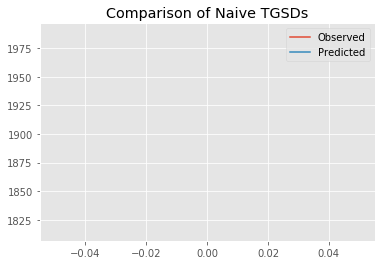

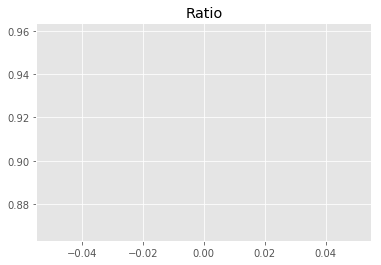

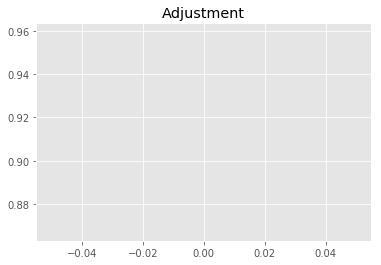

9992526225.655634
1


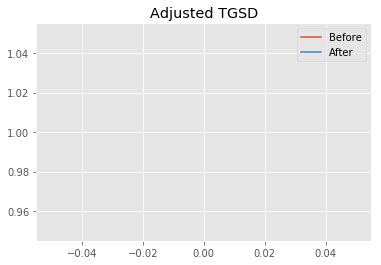

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.91687 	1.35258 	44915 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.09416e+10
After: 		|1.91687 	1.33468 	44915 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 301.056
New Misfit: 300.785
Convergence:
0.0008996379082552617

____________________
a = 1.91687	b = 1.33468	            h1 = 44915.00000	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 10941602043.55702
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 300.78535083710557
Prior Misfit: 511.008,	 Post Misfit: 300.785


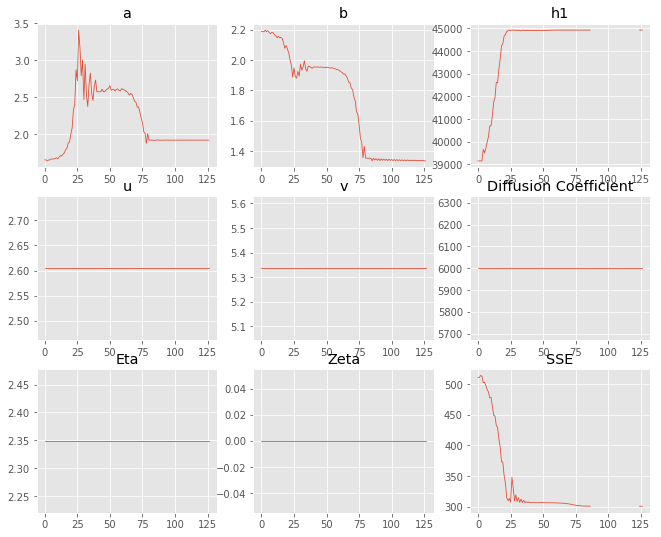

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,1.64943,1.91687
b,2.18692,1.33468
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"39,151.3","44,915"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 9 Time: 0.068 minutes


Estimated remaining run time: 0.666 minutes


Run 9===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	2.10e+03 	1.82e+03 	0.8653 		1.0000


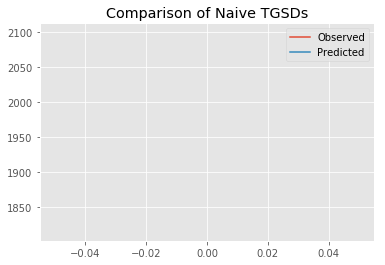

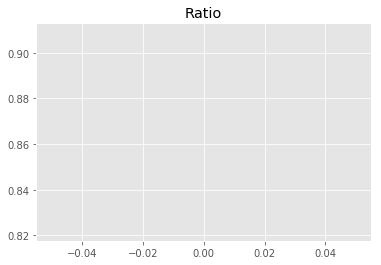

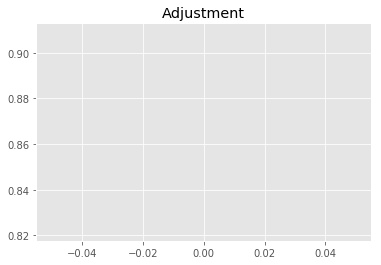

9467415270.427513
1


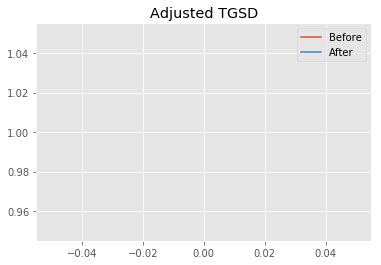

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|4.06809 	2.59391 	40620.6 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.09416e+10
After: 		|2.18312 	1.58958 	44859.8 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 327.951
New Misfit: 302.404
Convergence:
0.07789981601021266

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	2.01e+03 	1.82e+03 	0.9025 		1.0000


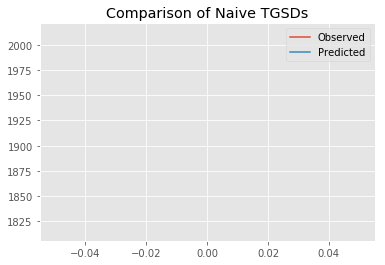

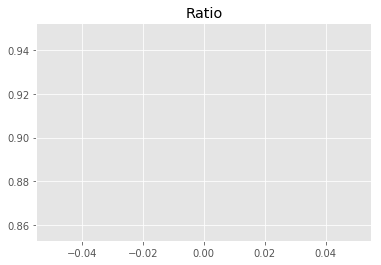

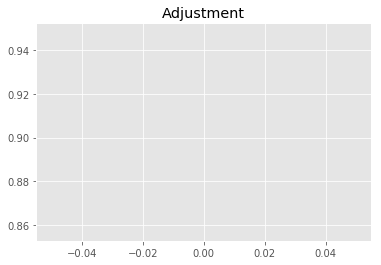

9874875469.02164
1


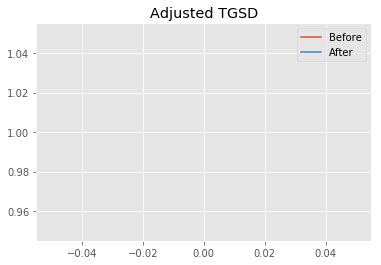

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.18312 	1.58958 	44859.8 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.09416e+10
After: 		|1.84877 	1.23261 	44914.9 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 302.404
New Misfit: 300.494
Convergence:
0.006315150187574911

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	1.95e+03 	1.82e+03 	0.9289 		1.0000


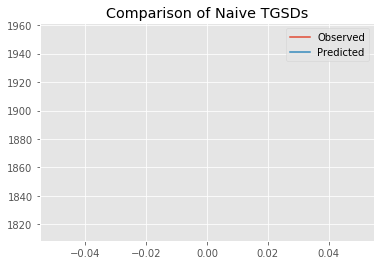

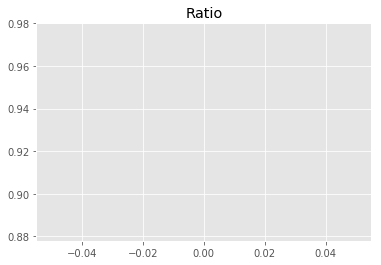

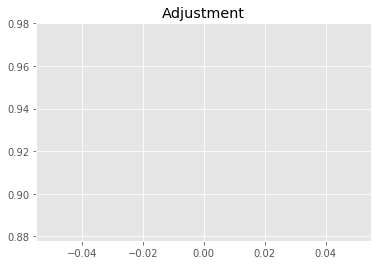

10164116038.131575
1


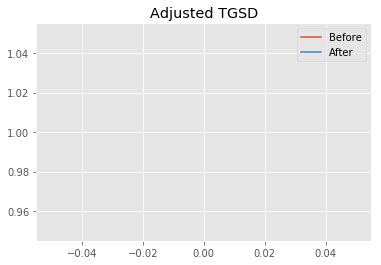

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.84877 	1.23261 	44914.9 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.09416e+10
After: 		|1.88179 	1.26026 	44915 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 300.494
New Misfit: 300.475
Convergence:
6.454272927638862e-05

____________________
a = 1.88179	b = 1.26026	            h1 = 44914.96661	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 10941602043.55702
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 300.4749160075288
Prior Misfit: 327.951,	 Post Misfit: 300.475


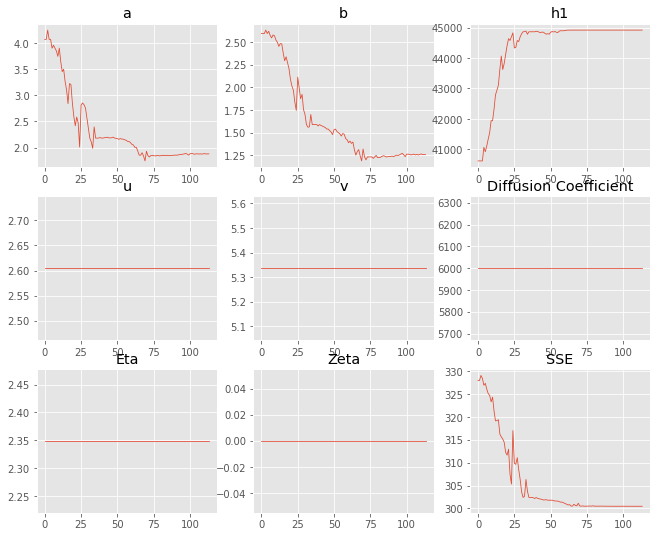

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,4.06809,1.88179
b,2.59391,1.26026
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"40,620.6","44,915"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 10 Time: 0.065 minutes


Estimated remaining run time: 0.599 minutes


Run 10===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	2.13e+03 	1.82e+03 	0.8523 		1.0000


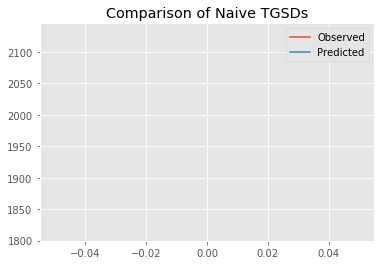

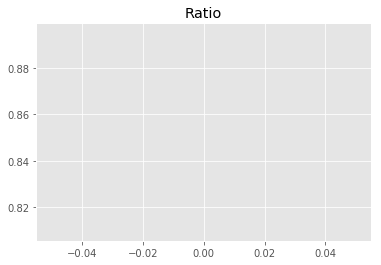

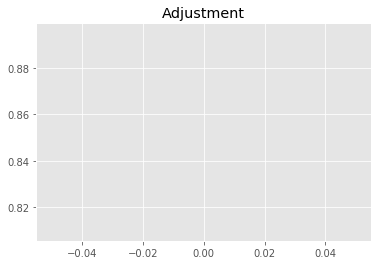

9325999120.085577
1


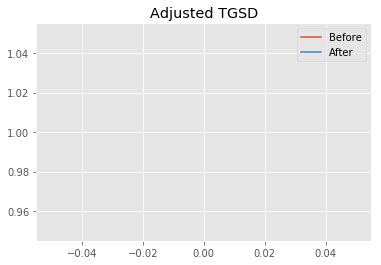

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|4.37577 	2.59843 	38897.1 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.09416e+10
After: 		|2.09123 	1.44111 	44899.7 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 333.843
New Misfit: 301.133
Convergence:
0.09797916010932688

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	1.98e+03 	1.82e+03 	0.9192 		1.0000


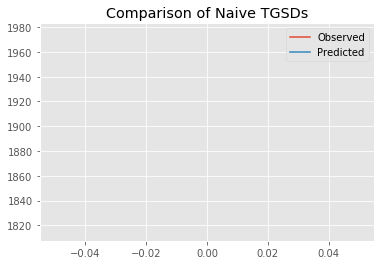

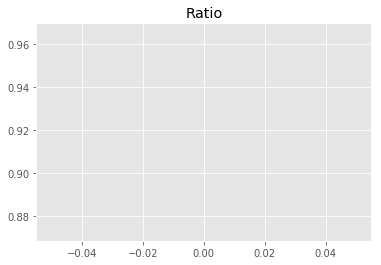

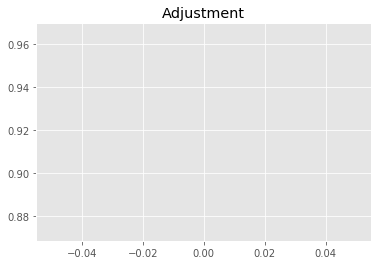

10057291843.395834
1


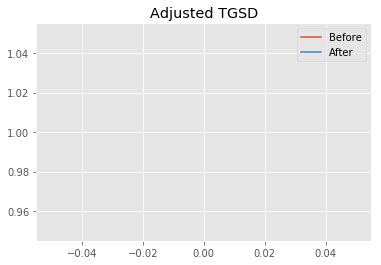

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.09123 	1.44111 	44899.7 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.09416e+10
After: 		|1.87148 	1.25077 	44915 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 301.133
New Misfit: 300.477
Convergence:
0.0021810173702387038

____________________
a = 1.87148	b = 1.25077	            h1 = 44914.99978	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 10941602043.55702
Success: True
Status: Successful convergence.
Iterations: 2
Misfit: 300.4766558118762
Prior Misfit: 333.843,	 Post Misfit: 300.477


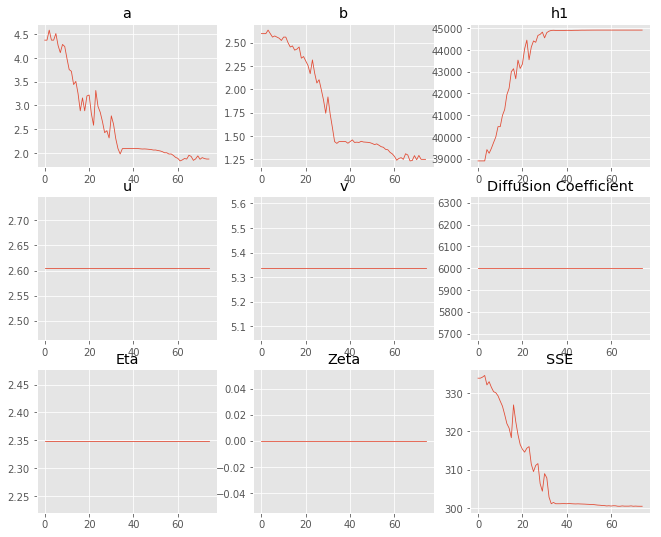

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,4.37577,1.87148
b,2.59843,1.25077
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"38,897.1","44,915"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 11 Time: 0.046 minutes


Estimated remaining run time: 0.518 minutes


Run 11===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	2.53e+03 	1.82e+03 	0.7175 		1.0000


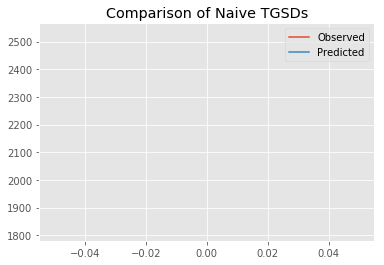

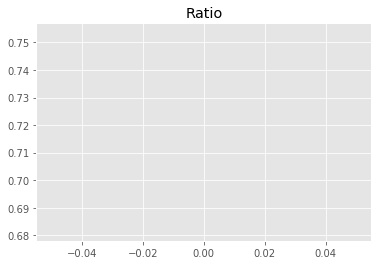

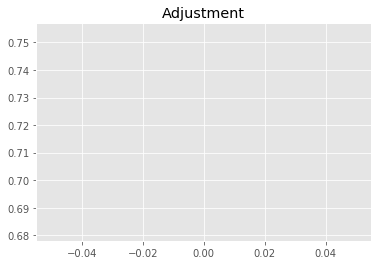

7850175579.384316
1


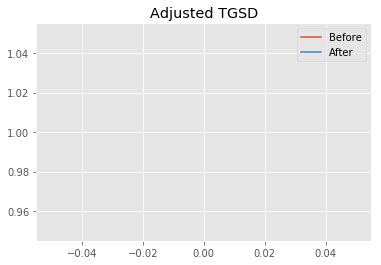

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.35486 	1.74323 	36189.6 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.09416e+10
After: 		|2.4351 	1.62825 	43027.2 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 551.319
New Misfit: 304.992
Convergence:
0.44679621169532313

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	2.02e+03 	1.82e+03 	0.8985 		1.0000


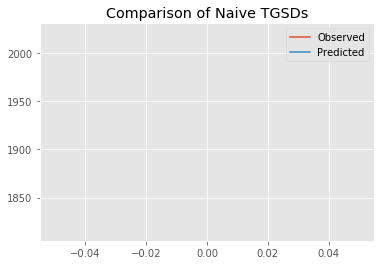

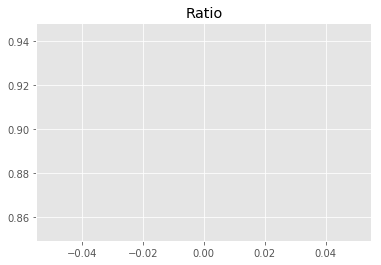

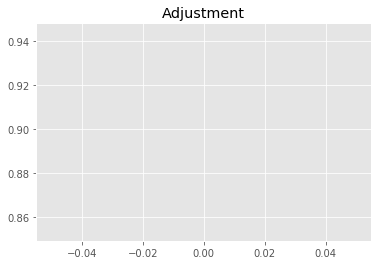

9831501362.20062
1


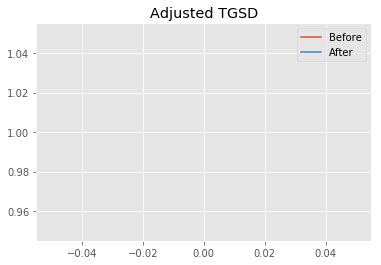

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.4351 	1.62825 	43027.2 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.09416e+10
After: 		|1.84688 	1.23465 	44913.9 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 304.992
New Misfit: 300.5
Convergence:
0.014726388996010944

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	1.96e+03 	1.82e+03 	0.9282 		1.0000


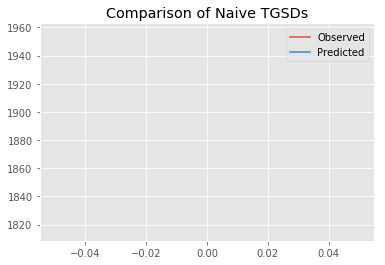

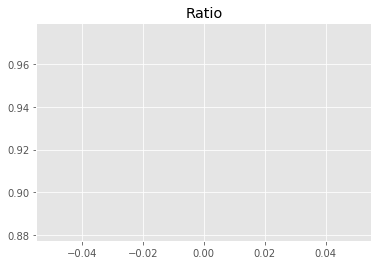

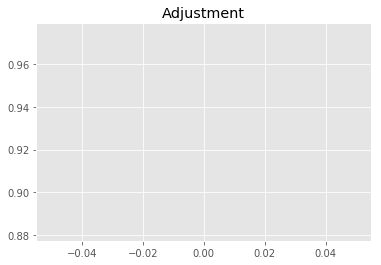

10156187813.850859
1


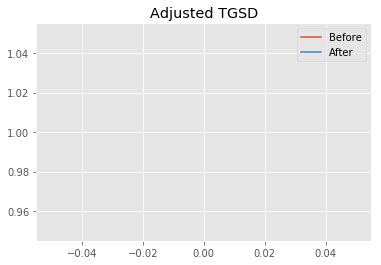

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.84688 	1.23465 	44913.9 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.09416e+10
After: 		|1.88142 	1.25824 	44913.8 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 300.5
New Misfit: 300.475
Convergence:
8.434242984159236e-05

____________________
a = 1.88142	b = 1.25824	            h1 = 44913.83946	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 10941602043.55702
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 300.474900447042
Prior Misfit: 551.319,	 Post Misfit: 300.475


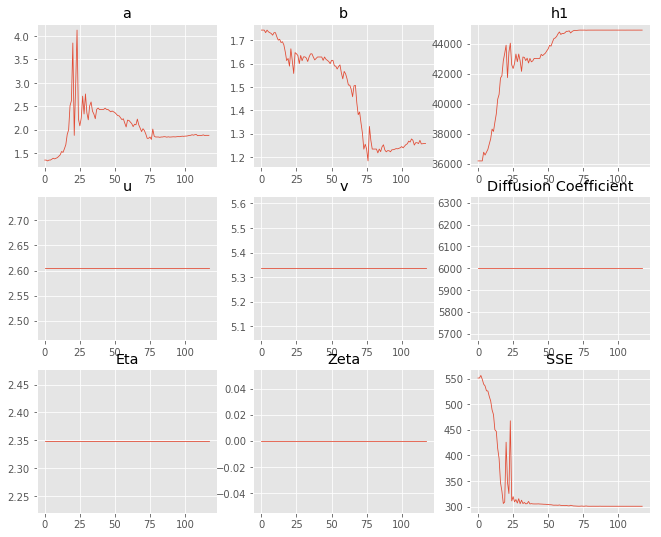

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,1.35486,1.88142
b,1.74323,1.25824
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"36,189.6","44,913.8"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 12 Time: 0.067 minutes


Estimated remaining run time: 0.454 minutes


Run 12===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	2.35e+03 	1.82e+03 	0.7715 		1.0000


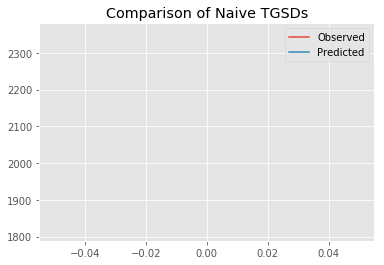

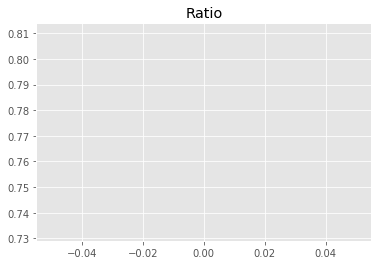

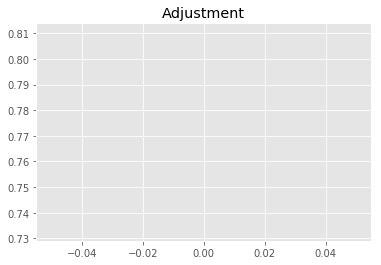

8441215585.5800905
1


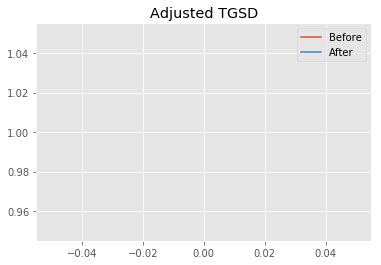

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|4.23897 	2.73243 	35753.3 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.09416e+10
After: 		|2.70499 	2.05934 	44237.1 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 373.748
New Misfit: 309.544
Convergence:
0.17178263048336898

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	2.07e+03 	1.82e+03 	0.8778 		1.0000


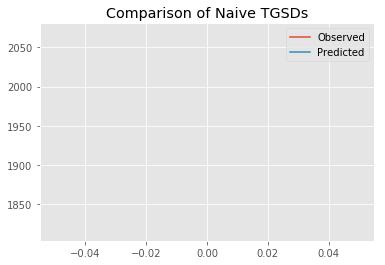

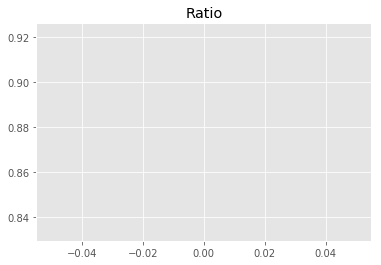

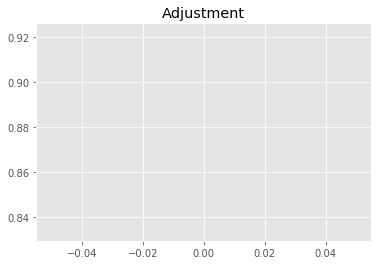

9604394735.061132
1


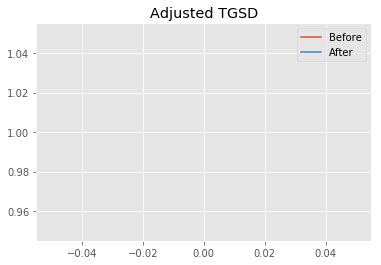

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.70499 	2.05934 	44237.1 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.09416e+10
After: 		|2.21631 	1.58941 	44915 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 309.544
New Misfit: 302.23
Convergence:
0.02362936999632266

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	2.00e+03 	1.82e+03 	0.9074 		1.0000


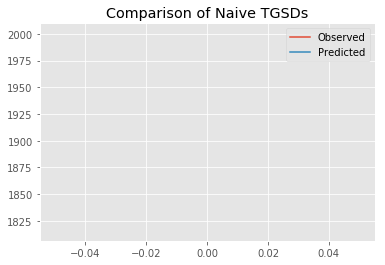

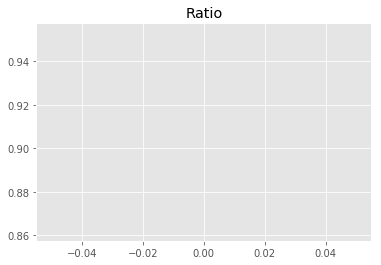

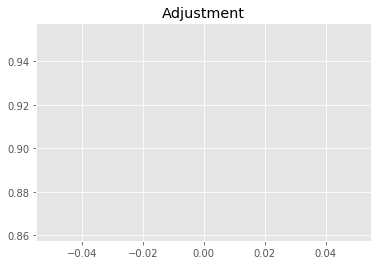

9928717080.470728
1


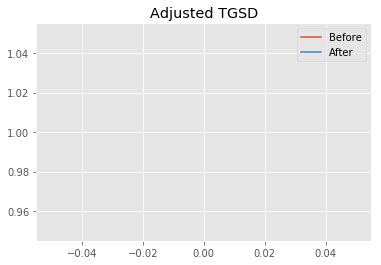

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.21631 	1.58941 	44915 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.09416e+10
After: 		|2.21631 	1.57403 	44915 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 302.23
New Misfit: 302.106
Convergence:
0.0004100689089445486

____________________
a = 2.21631	b = 1.57403	            h1 = 44915.00000	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 10941602043.55702
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 302.1059664296945
Prior Misfit: 373.748,	 Post Misfit: 302.106


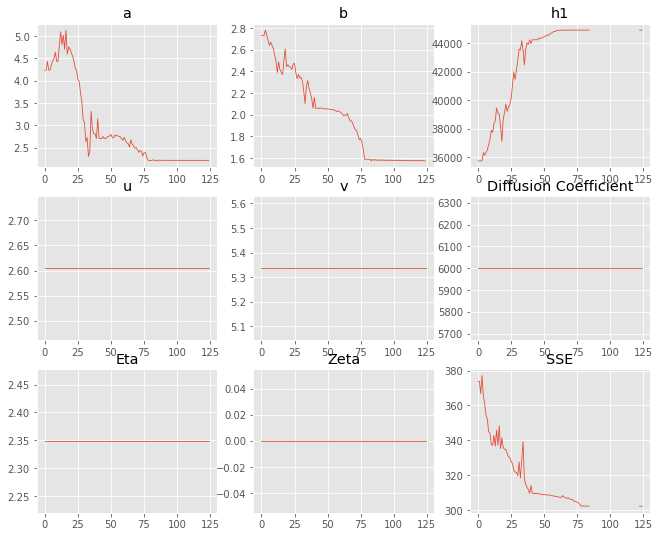

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,4.23897,2.21631
b,2.73243,1.57403
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"35,753.3","44,915"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 13 Time: 0.069 minutes


Estimated remaining run time: 0.391 minutes


Run 13===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	2.26e+03 	1.82e+03 	0.8042 		1.0000


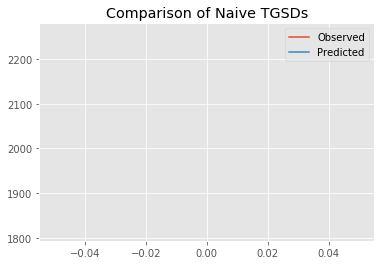

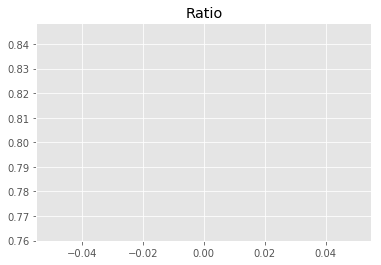

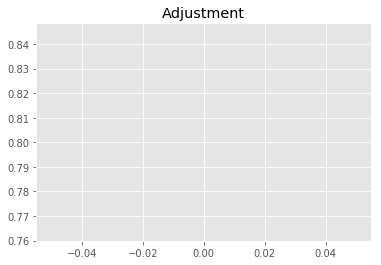

8798814560.60844
1


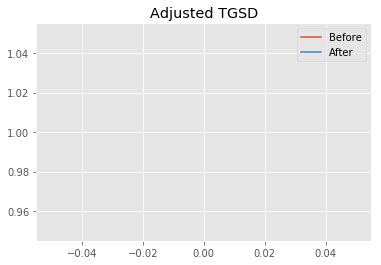

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.49055 	2.5769 	39471.4 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.09416e+10
After: 		|2.77757 	2.24385 	44815.9 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 344.837
New Misfit: 311.978
Convergence:
0.0952889918895904

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	2.09e+03 	1.82e+03 	0.8679 		1.0000


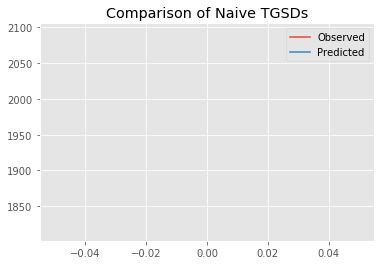

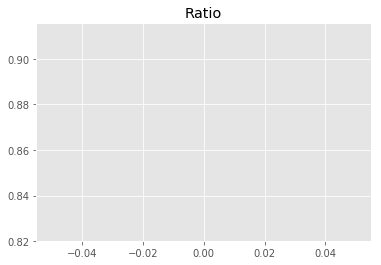

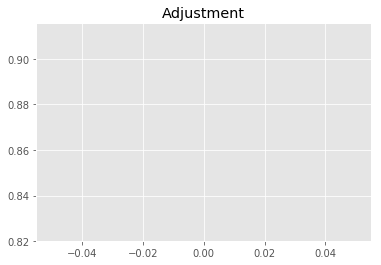

9496012003.108526
1


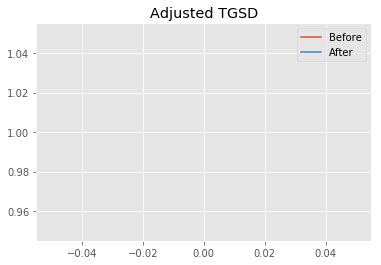

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.77757 	2.24385 	44815.9 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.09416e+10
After: 		|1.96772 	1.33532 	44915 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 311.978
New Misfit: 300.596
Convergence:
0.036482968112939884

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	1.96e+03 	1.82e+03 	0.9239 		1.0000


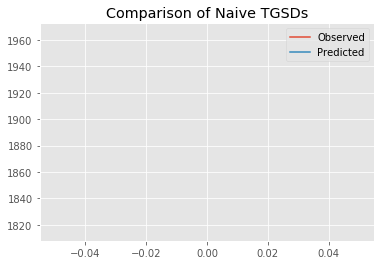

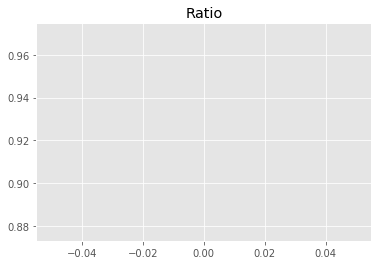

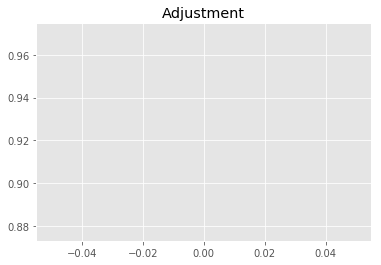

10108916846.41851
1


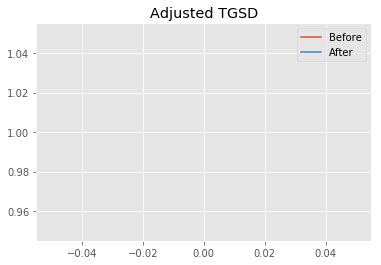

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.96772 	1.33532 	44915 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.09416e+10
After: 		|1.96613 	1.33532 	44915 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 300.596
New Misfit: 300.593
Convergence:
1.072381341737012e-05

____________________
a = 1.96613	b = 1.33532	            h1 = 44915.00000	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 10941602043.55702
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 300.59264781145447
Prior Misfit: 344.837,	 Post Misfit: 300.593


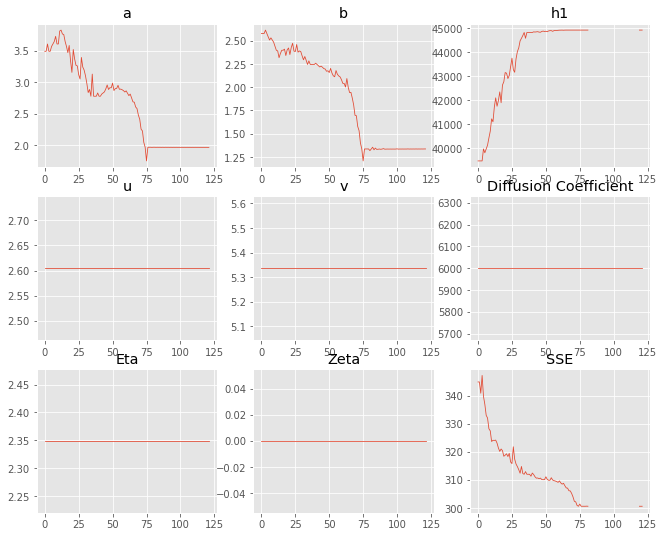

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,3.49055,1.96613
b,2.5769,1.33532
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"39,471.4","44,915"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 14 Time: 0.067 minutes


Estimated remaining run time: 0.326 minutes


Run 14===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	2.06e+03 	1.82e+03 	0.8829 		1.0000


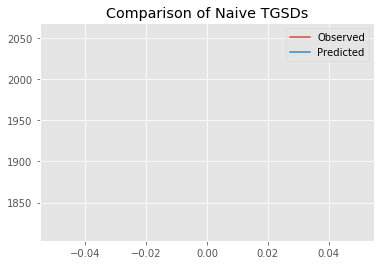

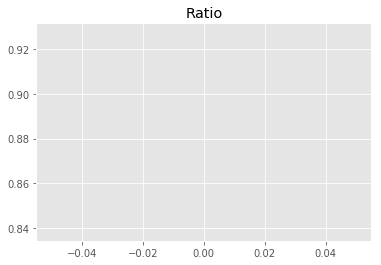

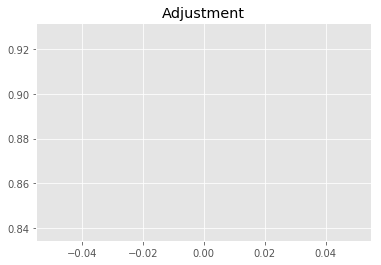

9660570760.782715
1


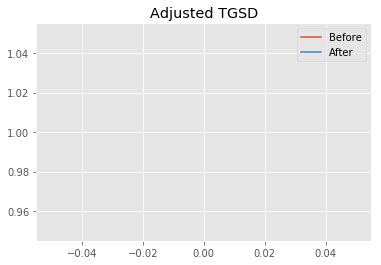

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|4.27715 	3.20095 	44232.4 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.09416e+10
After: 		|1.86551 	1.23322 	44915 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 326.241
New Misfit: 300.503
Convergence:
0.07889488506128396

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	1.95e+03 	1.82e+03 	0.9312 		1.0000


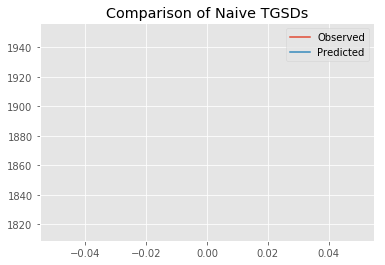

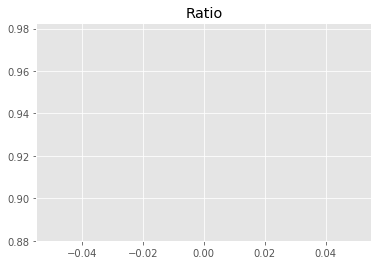

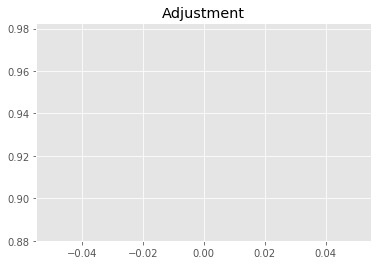

10189156939.239477
1


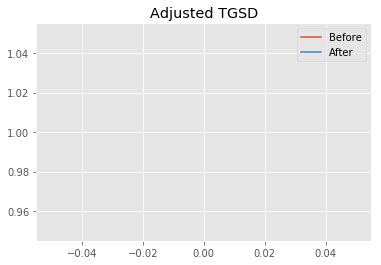

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.86551 	1.23322 	44915 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.09416e+10
After: 		|1.87543 	1.25493 	44915 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 300.503
New Misfit: 300.476
Convergence:
8.979145684616369e-05

____________________
a = 1.87543	b = 1.25493	            h1 = 44914.99747	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 10941602043.55702
Success: True
Status: Successful convergence.
Iterations: 2
Misfit: 300.4756331335697
Prior Misfit: 326.241,	 Post Misfit: 300.476


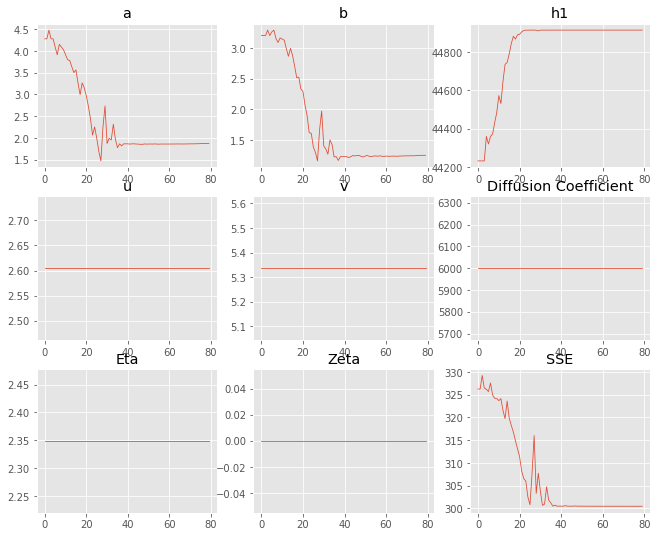

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,4.27715,1.87543
b,3.20095,1.25493
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"44,232.4","44,915"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 15 Time: 0.048 minutes


Estimated remaining run time: 0.257 minutes


Run 15===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	2.60e+03 	1.82e+03 	0.6972 		1.0000


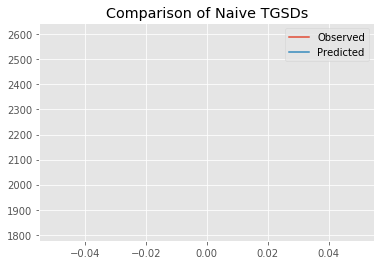

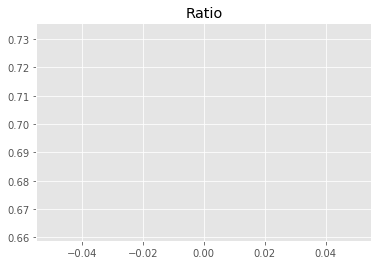

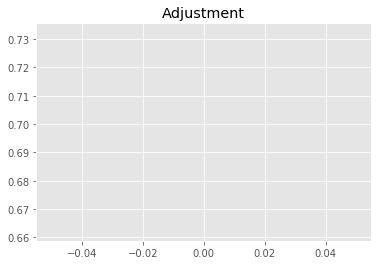

7628165995.785673
1


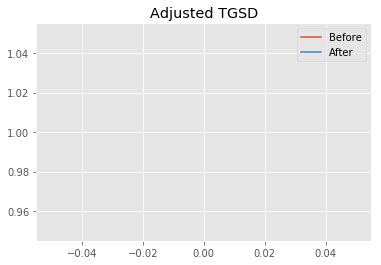

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.68823 	4.51486 	40381.4 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.09416e+10
After: 		|2.78205 	2.1484 	44390.5 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 478.783
New Misfit: 310.619
Convergence:
0.3512331879199824

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	2.07e+03 	1.82e+03 	0.8754 		1.0000


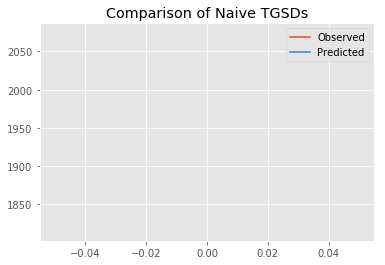

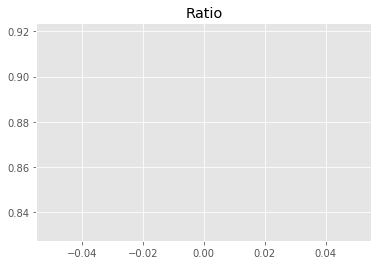

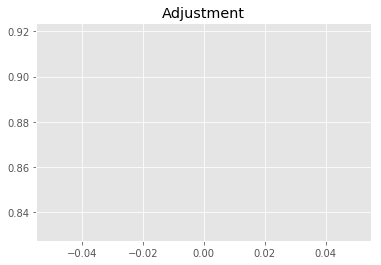

9578441124.842794
1


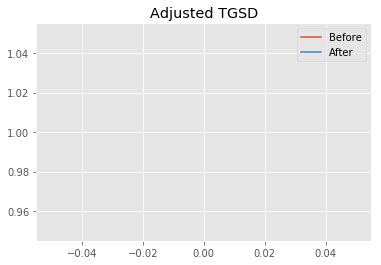

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.78205 	2.1484 	44390.5 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.09416e+10
After: 		|2.24189 	1.53556 	44915 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 310.619
New Misfit: 302.358
Convergence:
0.026595538590408654

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	1.97e+03 	1.82e+03 	0.9209 		1.0000


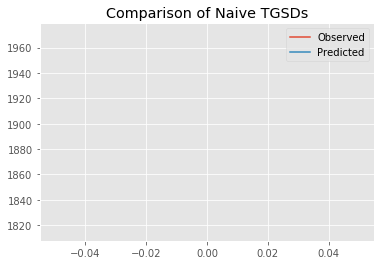

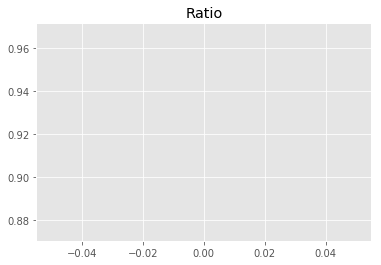

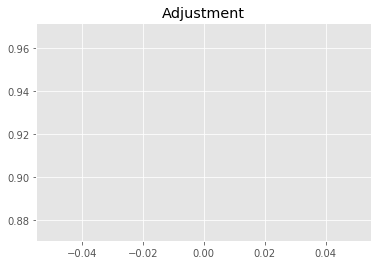

10076567645.30008
1


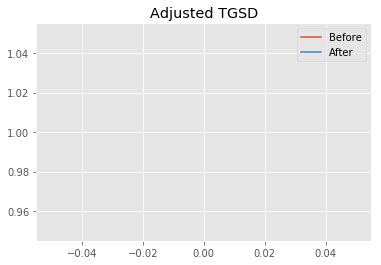

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.24189 	1.53556 	44915 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.09416e+10
After: 		|1.8636 	1.24157 	44915 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 302.358
New Misfit: 300.481
Convergence:
0.006205073027714767

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	1.95e+03 	1.82e+03 	0.9291 		1.0000


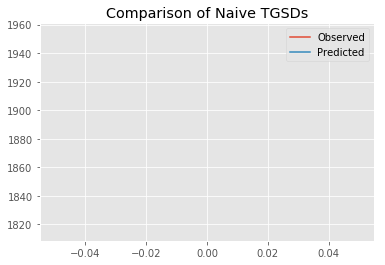

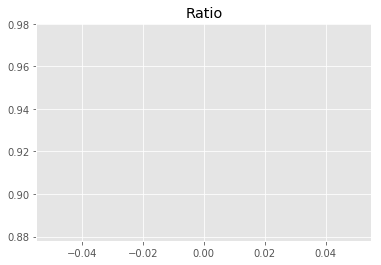

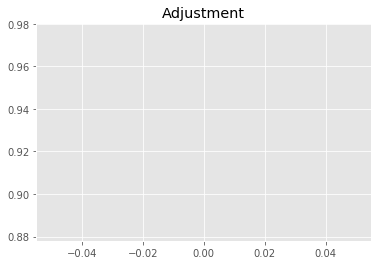

10166103886.751356
1


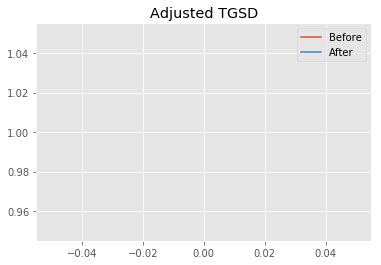

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.8636 	1.24157 	44915 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.09416e+10
After: 		|1.88133 	1.25938 	44915 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 300.481
New Misfit: 300.475
Convergence:
2.1772049654887506e-05

____________________
a = 1.88133	b = 1.25938	            h1 = 44914.99102	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 10941602043.55702
Success: True
Status: Successful convergence.
Iterations: 4
Misfit: 300.4748473660489
Prior Misfit: 478.783,	 Post Misfit: 300.475


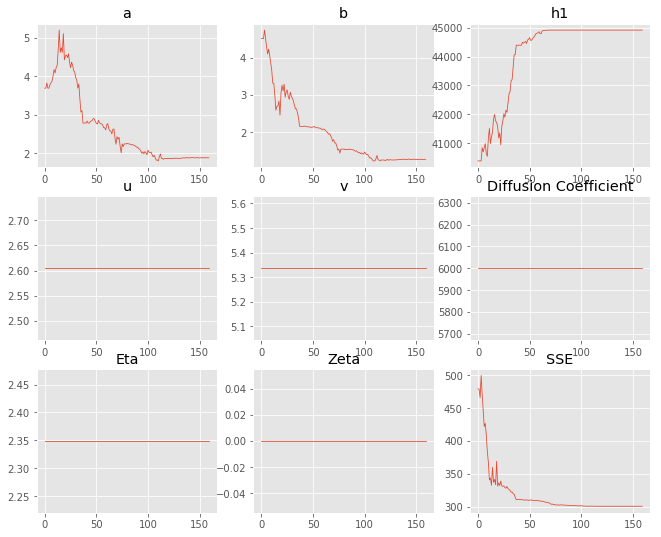

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,3.68823,1.88133
b,4.51486,1.25938
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"40,381.4","44,915"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 16 Time: 0.085 minutes


Estimated remaining run time: 0.196 minutes


Run 16===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	2.03e+03 	1.82e+03 	0.8939 		1.0000


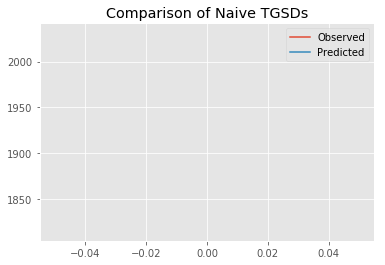

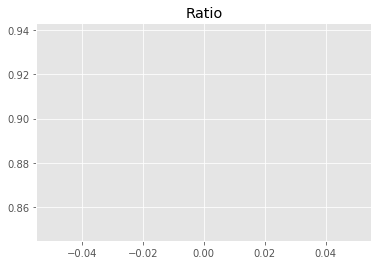

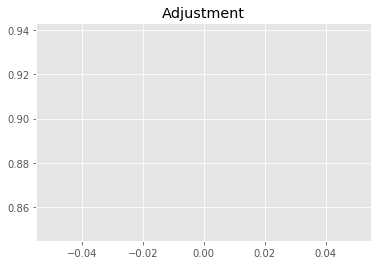

9780942331.181473
1


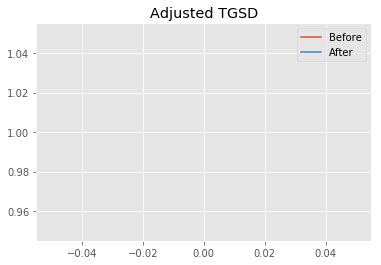

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|4.39977 	1.53966 	34827.3 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.09416e+10
After: 		|2.39989 	1.58354 	41451.8 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 340.135
New Misfit: 308.558
Convergence:
0.09283839201465642

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	2.08e+03 	1.82e+03 	0.8732 		1.0000


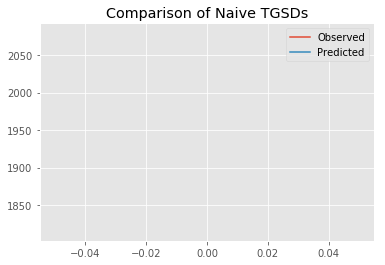

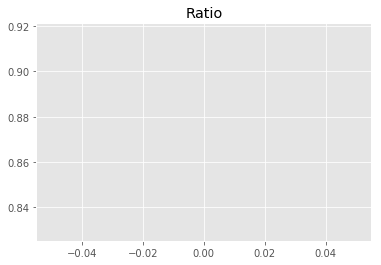

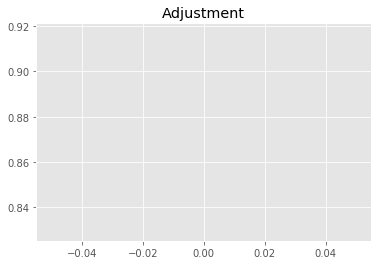

9554390029.077875
1


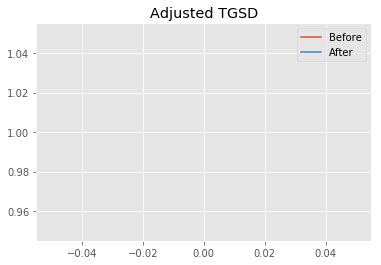

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.39989 	1.58354 	41451.8 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.09416e+10
After: 		|1.97664 	1.38055 	44785.5 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 308.558
New Misfit: 300.888
Convergence:
0.02485510056704232

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	1.98e+03 	1.82e+03 	0.9147 		1.0000


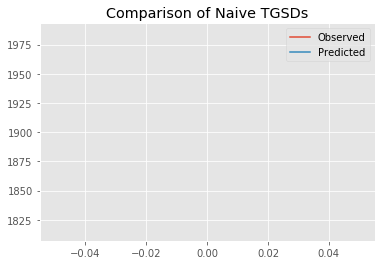

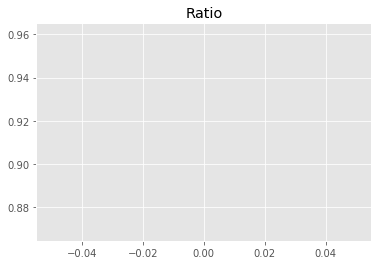

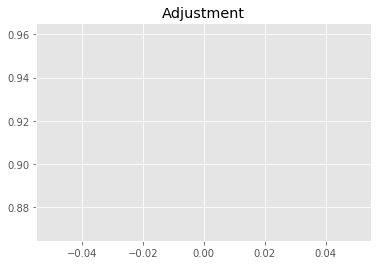

10008764907.08337
1


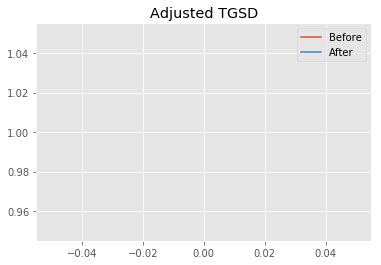

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.97664 	1.38055 	44785.5 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.09416e+10
After: 		|1.96662 	1.31237 	44038.7 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 300.888
New Misfit: 300.584
Convergence:
0.0010121221341917884

____________________
a = 1.96662	b = 1.31237	            h1 = 44038.69466	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 10941602043.55702
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 300.58391067520506
Prior Misfit: 340.135,	 Post Misfit: 300.584


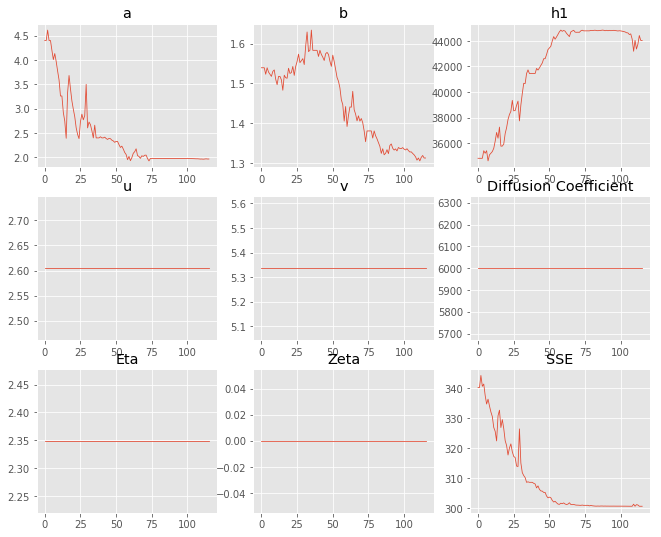

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,4.39977,1.96662
b,1.53966,1.31237
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"34,827.3","44,038.7"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 17 Time: 0.066 minutes


Estimated remaining run time: 0.131 minutes


Run 17===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	2.32e+03 	1.82e+03 	0.7830 		1.0000


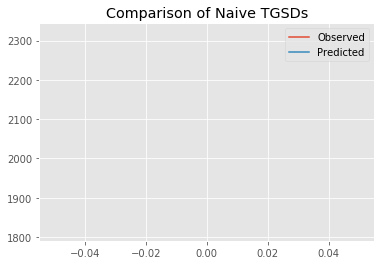

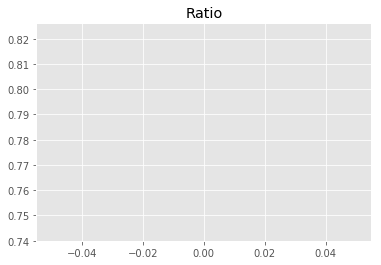

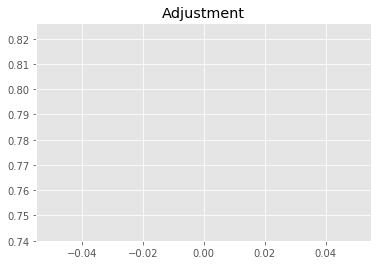

8567391535.478196
1


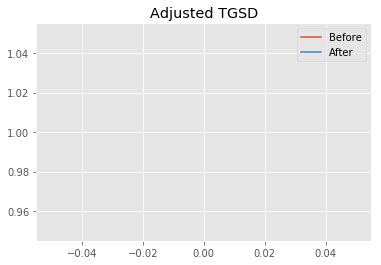

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|4.31722 	3.00562 	37489 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.09416e+10
After: 		|2.64706 	2.14415 	43989.2 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 364.286
New Misfit: 314.71
Convergence:
0.13609050150869142

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	2.12e+03 	1.82e+03 	0.8555 		1.0000


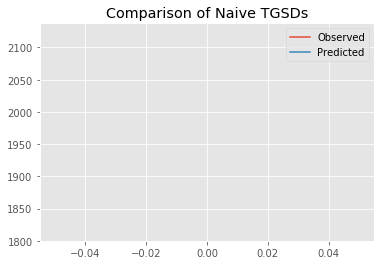

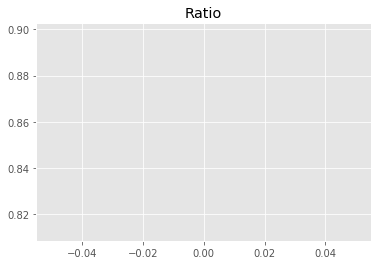

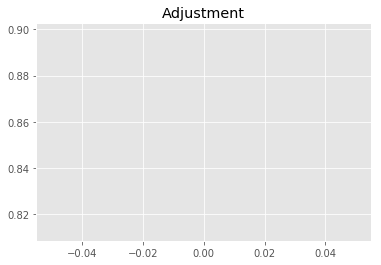

9361016992.739624
1


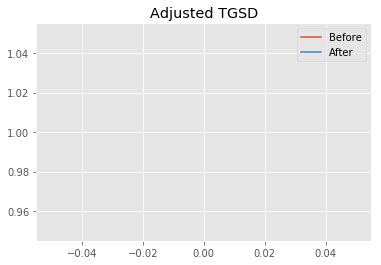

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.64706 	2.14415 	43989.2 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.09416e+10
After: 		|2.24017 	1.71874 	44915 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 314.71
New Misfit: 304.686
Convergence:
0.03185350079915023

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	2.05e+03 	1.82e+03 	0.8876 		1.0000


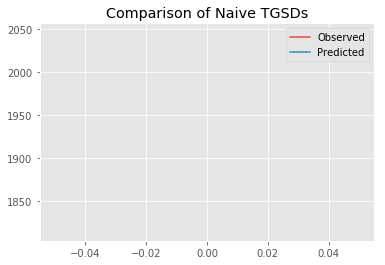

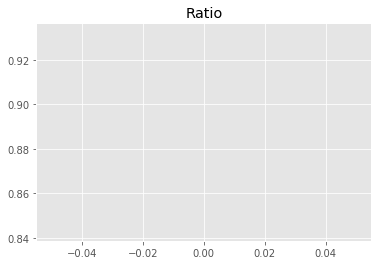

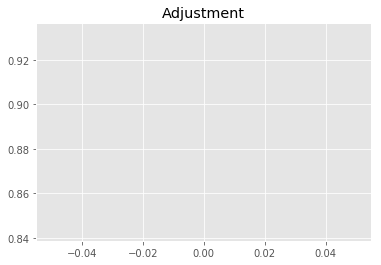

9711395871.060326
1


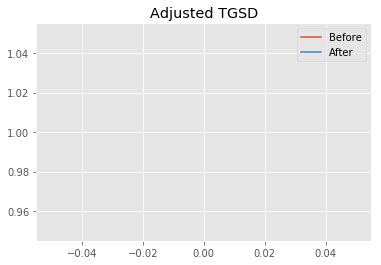

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.24017 	1.71874 	44915 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.09416e+10
After: 		|1.94146 	1.3294 	44546.3 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 304.686
New Misfit: 300.659
Convergence:
0.01321699509300958

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	1.98e+03 	1.82e+03 	0.9185 		1.0000


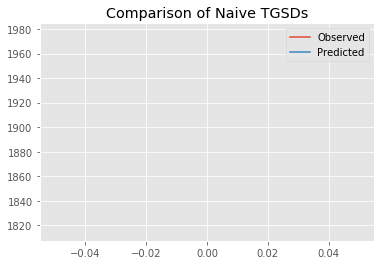

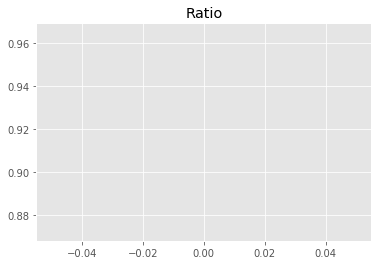

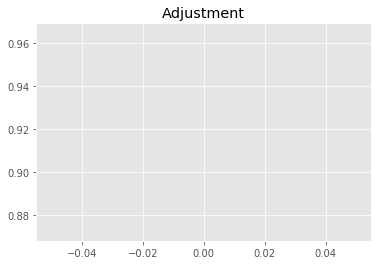

10049968493.109037
1


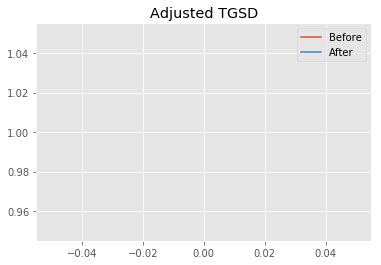

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.94146 	1.3294 	44546.3 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.09416e+10
After: 		|1.92641 	1.26703 	43879.4 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 300.659
New Misfit: 300.45
Convergence:
0.0006947142262790161

____________________
a = 1.92641	b = 1.26703	            h1 = 43879.35409	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 10941602043.55702
Success: True
Status: Successful convergence.
Iterations: 4
Misfit: 300.4497649641003
Prior Misfit: 364.286,	 Post Misfit: 300.45


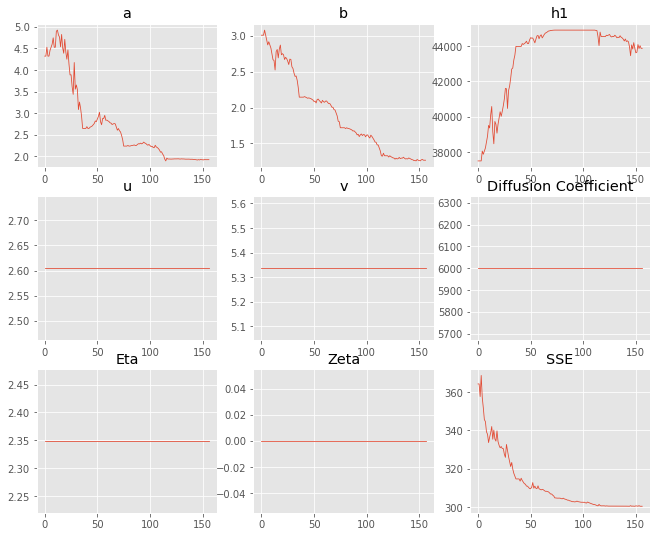

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,4.31722,1.92641
b,3.00562,1.26703
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"37,489","43,879.4"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 18 Time: 0.085 minutes


Estimated remaining run time: 0.067 minutes


Run 18===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	2.47e+03 	1.82e+03 	0.7346 		1.0000


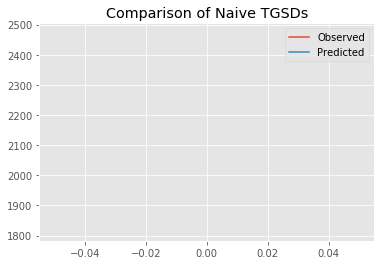

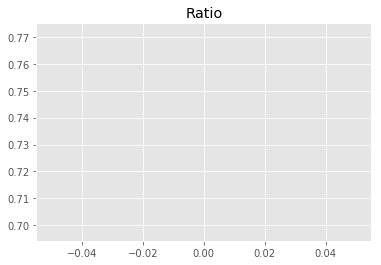

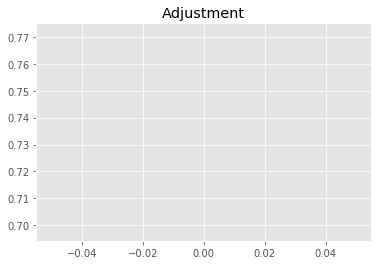

8037991762.793789
1


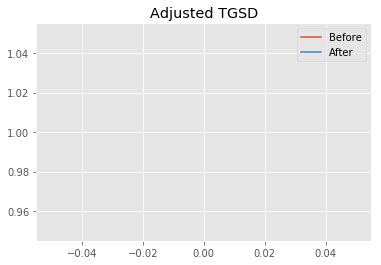

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.461 	1.91717 	31709.1 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.09416e+10
After: 		|2.61911 	1.80255 	41124.8 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 411.335
New Misfit: 314.813
Convergence:
0.23465386096915375

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	2.12e+03 	1.82e+03 	0.8559 		1.0000


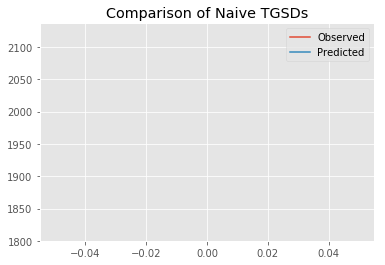

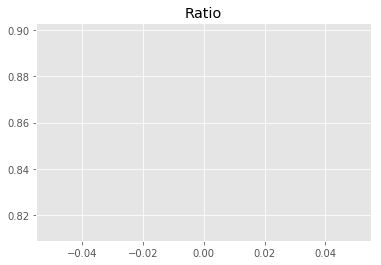

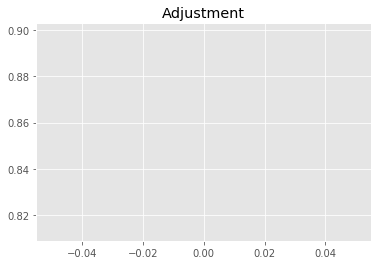

9364627747.564814
1


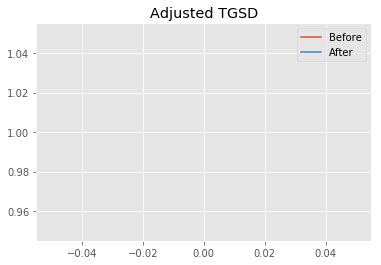

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.61911 	1.80255 	41124.8 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.09416e+10
After: 		|2.45621 	1.78926 	44356.6 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 314.813
New Misfit: 305.116
Convergence:
0.030804812175227538

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	2.03e+03 	1.82e+03 	0.8945 		1.0000


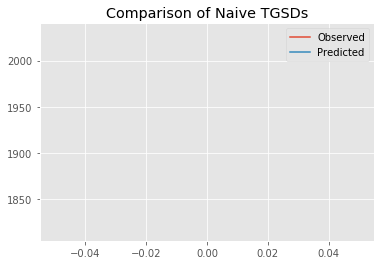

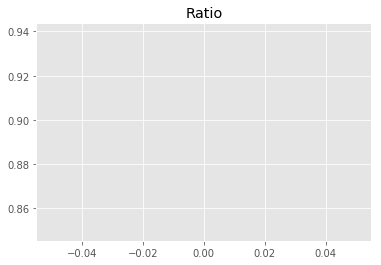

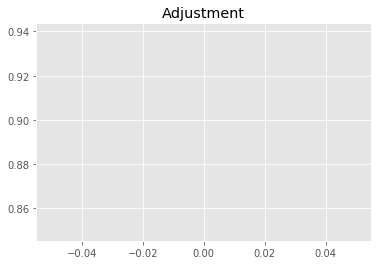

9786948536.530888
1


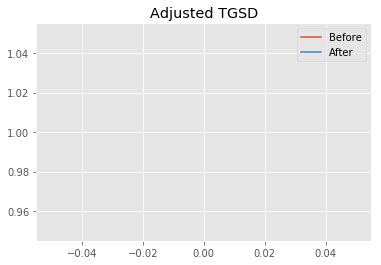

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.45621 	1.78926 	44356.6 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.09416e+10
After: 		|1.95 	1.31221 	44915 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 305.116
New Misfit: 300.557
Convergence:
0.014941993240451585

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	1.96e+03 	1.82e+03 	0.9263 		1.0000


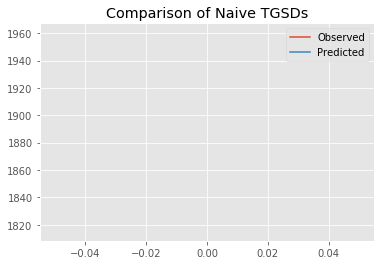

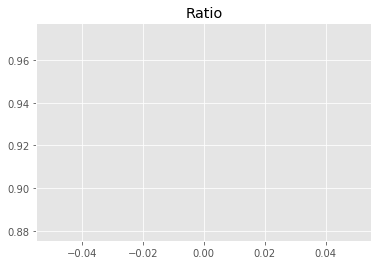

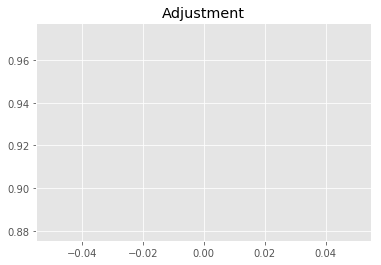

10134825591.822586
1


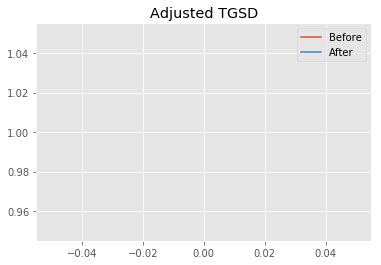

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.95 	1.31221 	44915 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.09416e+10
After: 		|1.92476 	1.30084 	44851.1 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 300.557
New Misfit: 300.509
Convergence:
0.0001586607433872129

____________________
a = 1.92476	b = 1.30084	            h1 = 44851.07686	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 10941602043.55702
Success: True
Status: Successful convergence.
Iterations: 4
Misfit: 300.5088505437173
Prior Misfit: 411.335,	 Post Misfit: 300.509


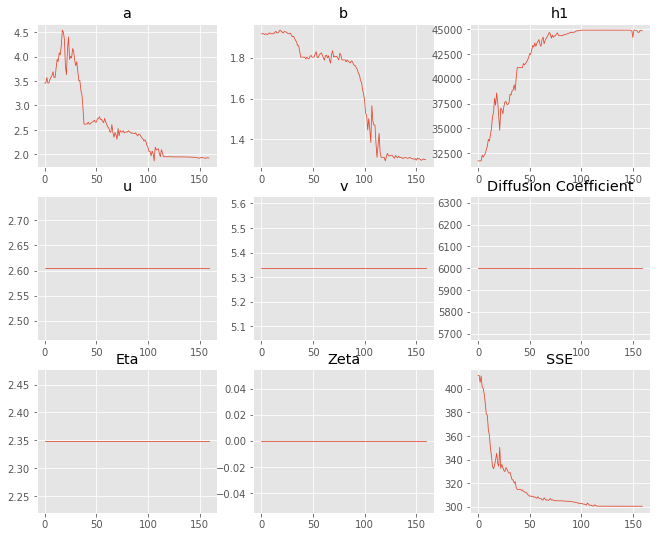

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,3.461,1.92476
b,1.91717,1.30084
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"31,709.1","44,851.1"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 19 Time: 0.085 minutes


Estimated remaining run time: 0.000 minutes


Run 19===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	1.85e+03 	1.82e+03 	0.9808 		1.0000


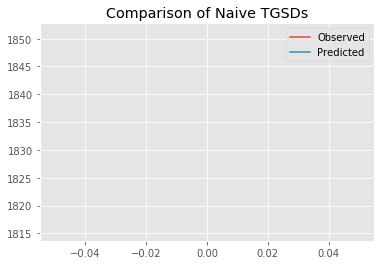

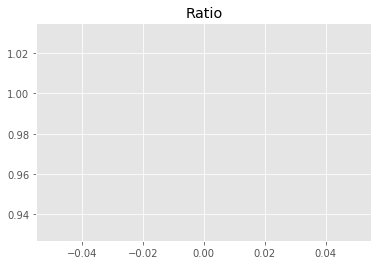

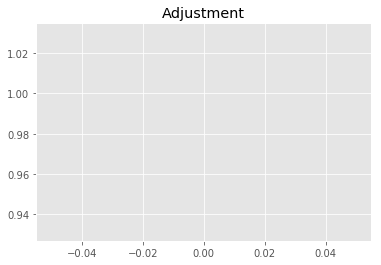

10731574356.330145
1


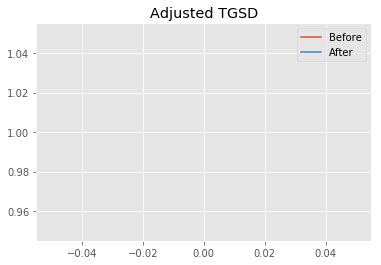

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.91457 	1.02924 	35799.7 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.09416e+10
After: 		|1.89822 	1.00435 	39967.3 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 366.692
New Misfit: 300.347
Convergence:
0.18092908134293292

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.09e+10 	1.99e+03 	1.82e+03 	0.9104 		1.0000


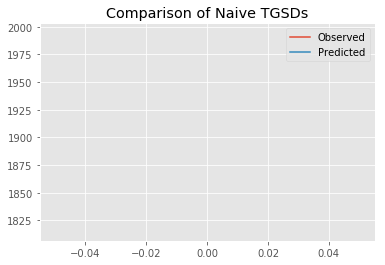

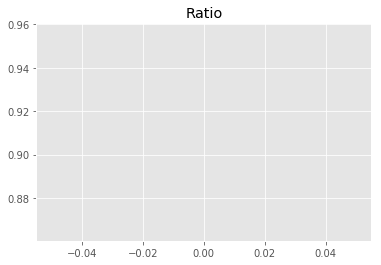

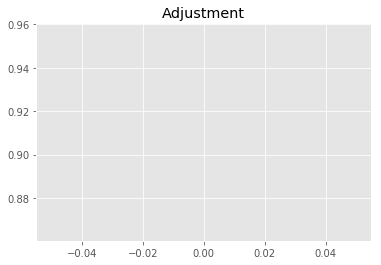

9961189049.481884
1


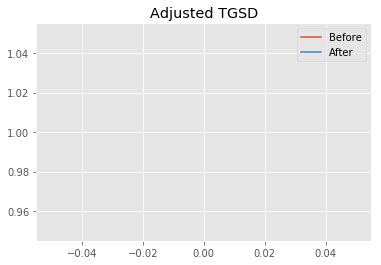

Old Total Mass: 1.09416e+10
New Total Mass: 1.09416e+10
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.89822 	1.00435 	39967.3 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.09416e+10
After: 		|1.88879 	1.00007 	40568.3 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 300.347
New Misfit: 300.295
Convergence:
0.00017228051325023737

____________________
a = 1.88879	b = 1.00007	            h1 = 40568.25901	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 10941602043.55702
Success: True
Status: Successful convergence.
Iterations: 2
Misfit: 300.29509401725585
Prior Misfit: 366.692,	 Post Misfit: 300.295


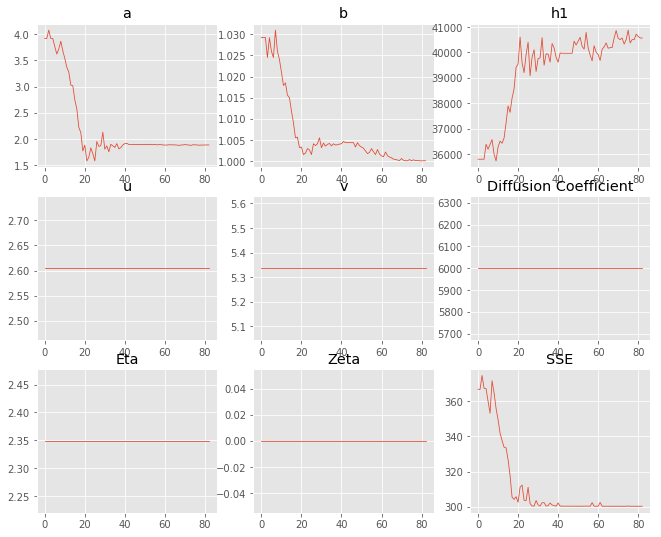

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,3.91457,1.88879
b,1.02924,1.00007
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"35,799.7","40,568.3"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 20 Time: 0.051 minutes


Estimated remaining run time: -0.067 minutes


Total Run Time: 1.40052 minutes


[{'a': 2.651967287283621,
  'b': 2.0036396909939924,
  'h1': 44914.92795136564,
  'u': 2.60482,
  'v': 5.33615,
  'D': 5999.899999999996,
  'ftt': 6457.999999999996,
  'eta': 2.34894,
  'zeta': 0.0},
 {'a': 2.475897767730287,
  'b': 1.8348960722420333,
  'h1': 44779.57244563327,
  'u': 2.60482,
  'v': 5.33615,
  'D': 5999.899999999996,
  'ftt': 6457.999999999996,
  'eta': 2.34894,
  'zeta': 0.0},
 {'a': 1.879417018945589,
  'b': 1.2572774450979702,
  'h1': 44914.99999983474,
  'u': 2.60482,
  'v': 5.33615,
  'D': 5999.899999999996,
  'ftt': 6457.999999999996,
  'eta': 2.34894,
  'zeta': 0.0},
 {'a': 1.9646688215301102,
  'b': 1.3265287044150569,
  'h1': 44856.193122062396,
  'u': 2.60482,
  'v': 5.33615,
  'D': 5999.899999999996,
  'ftt': 6457.999999999996,
  'eta': 2.34894,
  'zeta': 0.0},
 {'a': 1.8774539780615433,
  'b': 1.2557738424166476,
  'h1': 44897.66644501371,
  'u': 2.60482,
  'v': 5.33615,
  'D': 5999.899999999996,
  'ftt': 6457.999999999996,
  'eta': 2.34894,
  'zeta': 0.0

,a,b,h1,u,v,D,ftt,eta,zeta,M,Misfit
19,1.88879,1.00007,"40,568.3",2.60482,5.33615,"5,999.9","6,458",2.34894,0,1.09416e+10,300.295
7,1.87217,1.22298,"43,869.3",2.60482,5.33615,"5,999.9","6,458",2.34894,0,1.09416e+10,300.39
5,1.87764,1.23267,"43,922.9",2.60482,5.33615,"5,999.9","6,458",2.34894,0,1.09416e+10,300.404
17,1.92641,1.26703,"43,879.4",2.60482,5.33615,"5,999.9","6,458",2.34894,0,1.09416e+10,300.45
4,1.87745,1.25577,"44,897.7",2.60482,5.33615,"5,999.9","6,458",2.34894,0,1.09416e+10,300.474
15,1.88133,1.25938,"44,915",2.60482,5.33615,"5,999.9","6,458",2.34894,0,1.09416e+10,300.475
11,1.88142,1.25824,"44,913.8",2.60482,5.33615,"5,999.9","6,458",2.34894,0,1.09416e+10,300.475
9,1.88179,1.26026,"44,915",2.60482,5.33615,"5,999.9","6,458",2.34894,0,1.09416e+10,300.475
2,1.87942,1.25728,"44,915",2.60482,5.33615,"5,999.9","6,458",2.34894,0,1.09416e+10,300.475
14,1.87543,1.25493,"44,915",2.60482,5.33615,"5,999.9","6,458",2.34894,0,1.09416e+10,300.476


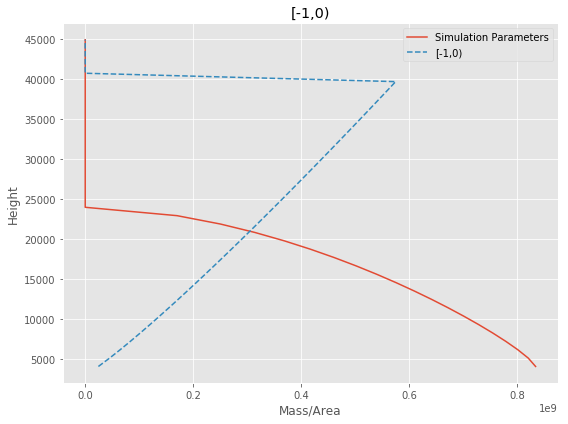

[-1,0) Run Time: 1.40260 minutes


Mass Test: 45798958791.69547
========[0,1)========
Run 0===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	1.28e+03 	1.13e+03 	0.8879 		1.0000


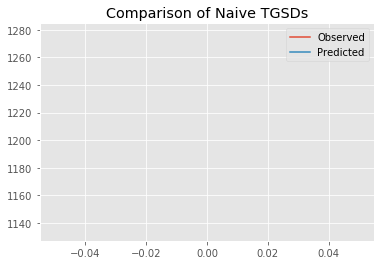

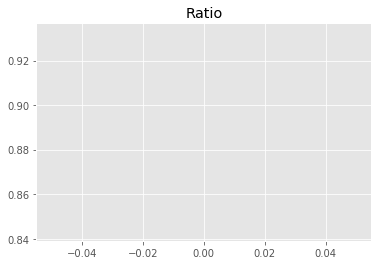

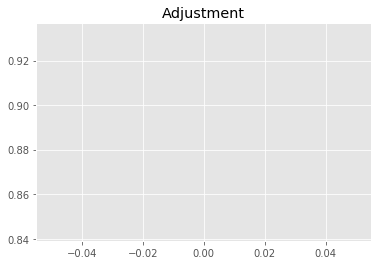

6069779234.340187
1


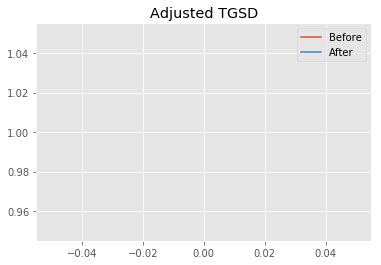

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.90551 	4.13614 	31023.5 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 6.83614e+09
After: 		|4.37429 	2.81227 	22512.8 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 202.381
New Misfit: 157.837
Convergence:
0.2200973432002112

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	1.24e+03 	1.13e+03 	0.9150 		1.0000


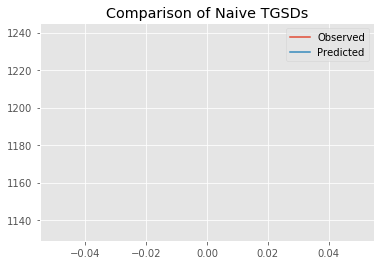

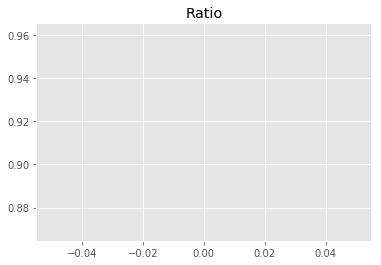

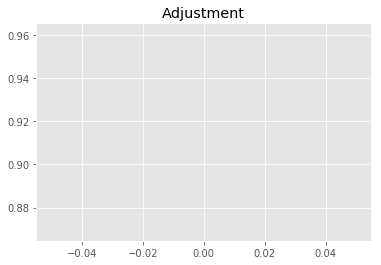

6254955779.291724
1


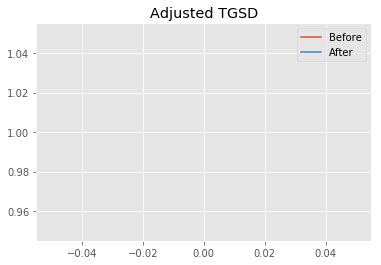

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|4.37429 	2.81227 	22512.8 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 6.83614e+09
After: 		|8.03617 	3.64215 	20600 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 157.837
New Misfit: 148.464
Convergence:
0.059385178751357535

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	1.20e+03 	1.13e+03 	0.9469 		1.0000


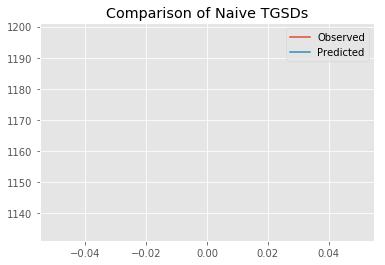

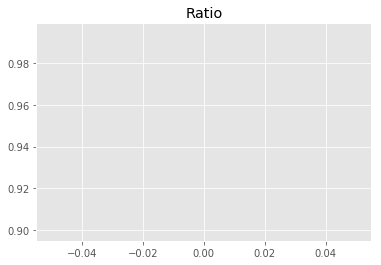

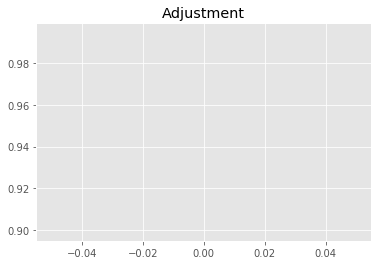

6473209128.974251
1


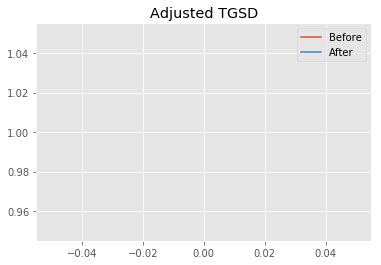

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|8.03617 	3.64215 	20600 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 6.83614e+09
After: 		|9.39986 	3.59666 	19643 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 148.464
New Misfit: 148.331
Convergence:
0.0008954455504916898

____________________
a = 9.39986	b = 3.59666	            h1 = 19643.01005	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 6836143986.19342
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 148.33101733731377
Prior Misfit: 202.381,	 Post Misfit: 148.331


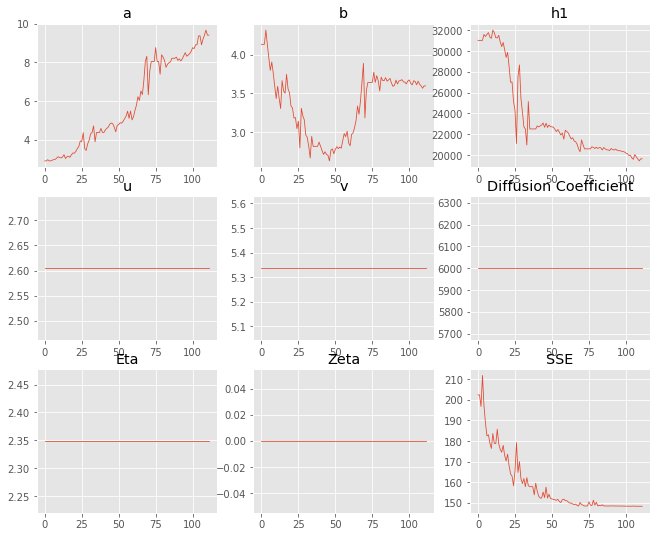

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,2.90551,9.39986
b,4.13614,3.59666
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"31,023.5","19,643"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 1 Time: 0.064 minutes


Estimated remaining run time: 0.574 minutes


Run 1===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	9.20e+02 	1.13e+03 	1.2326 		1.0000


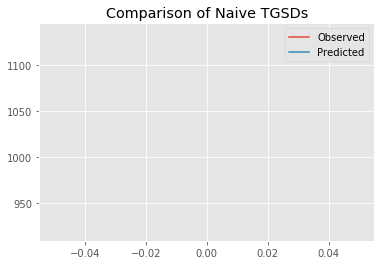

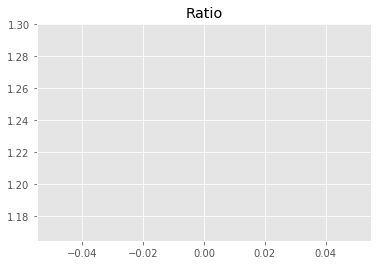

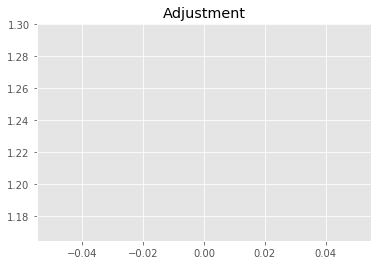

8426268372.918929
1


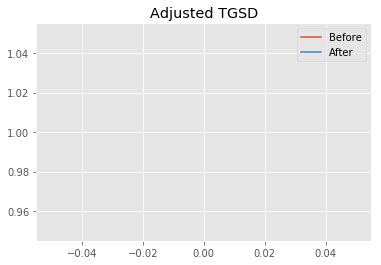

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.7085 	1.35133 	25763.3 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 6.83614e+09
After: 		|3.11837 	1.33311 	21282.7 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 237.213
New Misfit: 157.206
Convergence:
0.3372790679930408

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	1.13e+03 	1.13e+03 	1.0011 		1.0000


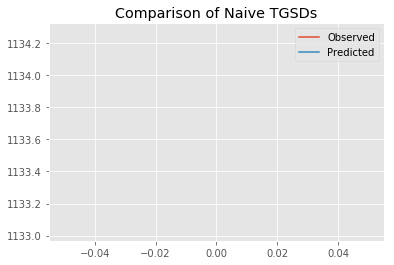

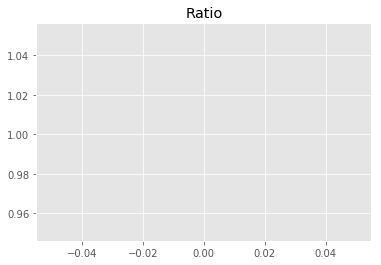

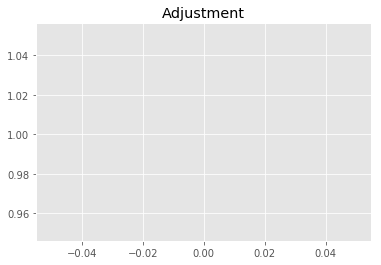

6843585680.551713
1


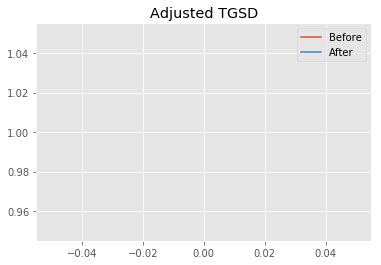

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.11837 	1.33311 	21282.7 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 6.83614e+09
After: 		|3.88637 	1.42383 	19914.2 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 157.206
New Misfit: 150.845
Convergence:
0.04046436391910725

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	1.17e+03 	1.13e+03 	0.9722 		1.0000


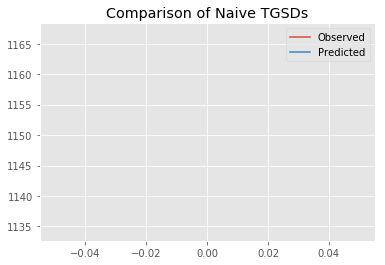

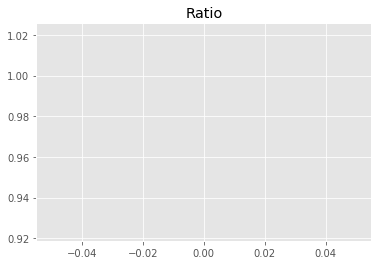

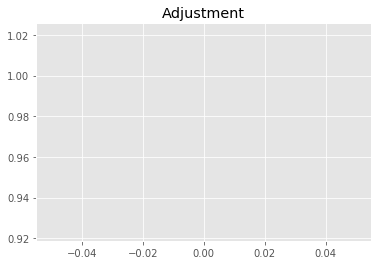

6645992261.118141
1


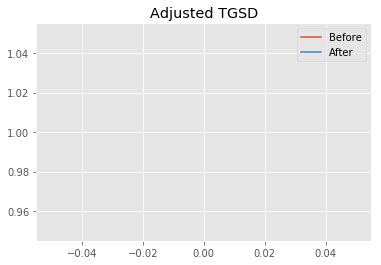

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.88637 	1.42383 	19914.2 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 6.83614e+09
After: 		|3.98386 	1.43067 	19817.9 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 150.845
New Misfit: 150.594
Convergence:
0.0016641485387334876

____________________
a = 3.98386	b = 1.43067	            h1 = 19817.91841	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 6836143986.19342
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 150.59396782976404
Prior Misfit: 237.213,	 Post Misfit: 150.594


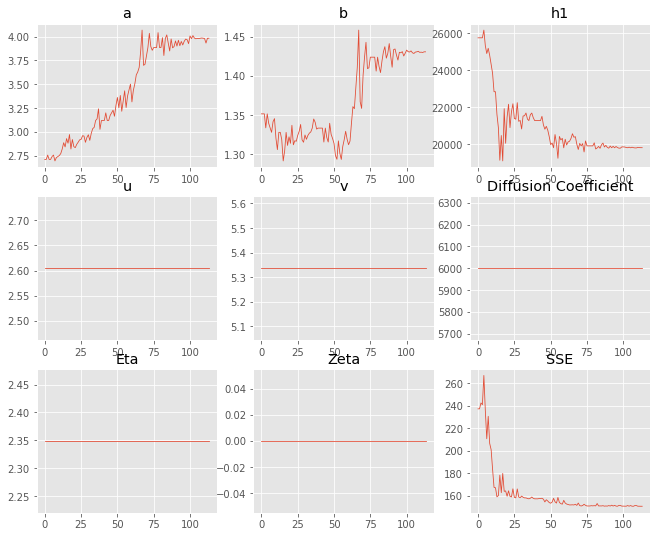

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,2.7085,3.98386
b,1.35133,1.43067
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"25,763.3","19,817.9"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 2 Time: 0.063 minutes


Estimated remaining run time: 0.717 minutes


Run 2===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	9.56e+02 	1.13e+03 	1.1869 		1.0000


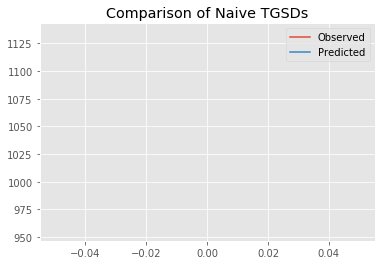

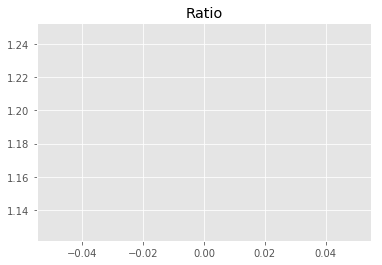

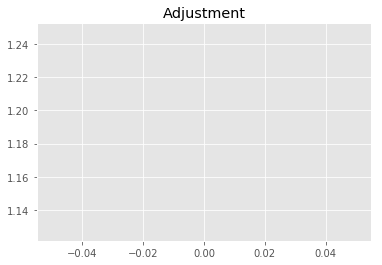

8114127861.504292
1


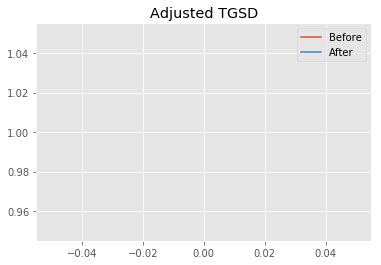

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.51229 	1.92064 	25521 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 6.83614e+09
After: 		|8.11467 	1.9132 	17736.4 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 211.956
New Misfit: 148.287
Convergence:
0.3003866314118668

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	1.21e+03 	1.13e+03 	0.9357 		1.0000


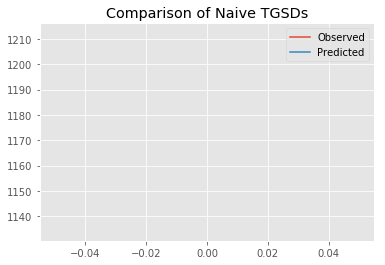

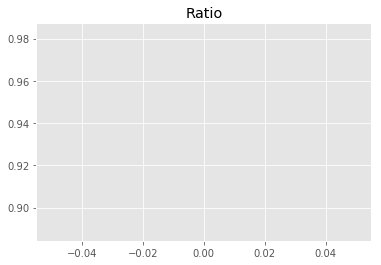

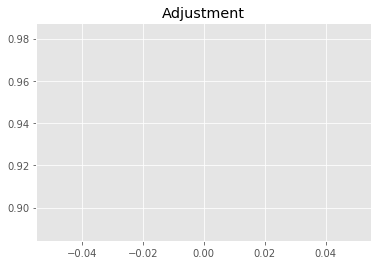

6396761547.098948
1


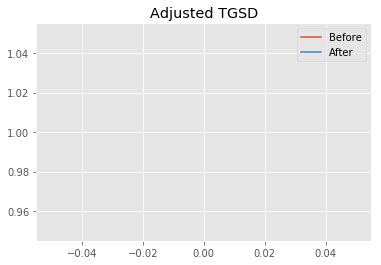

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|8.11467 	1.9132 	17736.4 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 6.83614e+09
After: 		|7.89436 	1.92387 	17962.4 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 148.287
New Misfit: 148.172
Convergence:
0.0007763267719111881

____________________
a = 7.89436	b = 1.92387	            h1 = 17962.42233	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 6836143986.19342
Success: True
Status: Successful convergence.
Iterations: 2
Misfit: 148.17180186021858
Prior Misfit: 211.956,	 Post Misfit: 148.172


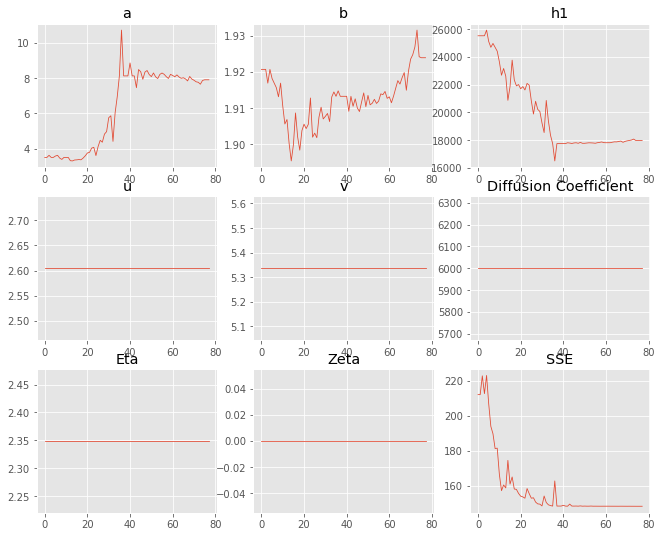

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,3.51229,7.89436
b,1.92064,1.92387
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"25,521","17,962.4"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 3 Time: 0.048 minutes


Estimated remaining run time: 0.699 minutes


Run 3===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	1.16e+03 	1.13e+03 	0.9762 		1.0000


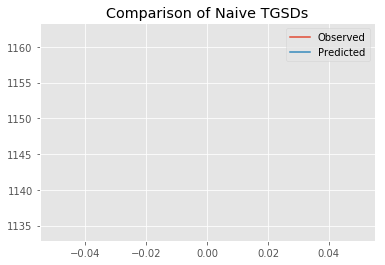

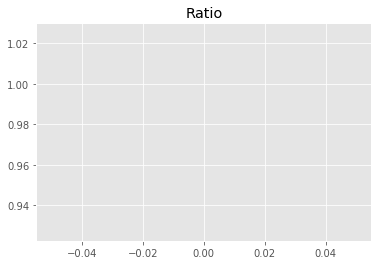

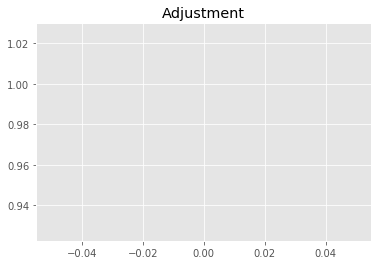

6673584867.692892
1


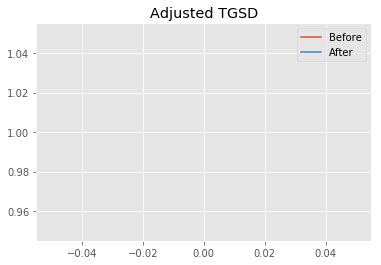

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.91762 	1.53124 	25289.5 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 6.83614e+09
After: 		|2.57941 	1.02606 	20007.6 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 203.037
New Misfit: 160.477
Convergence:
0.20961366187707903

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	1.20e+03 	1.13e+03 	0.9475 		1.0000


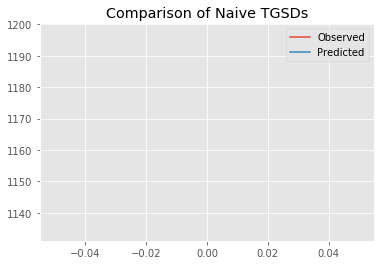

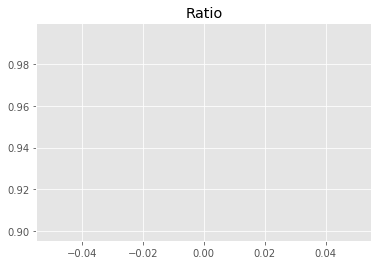

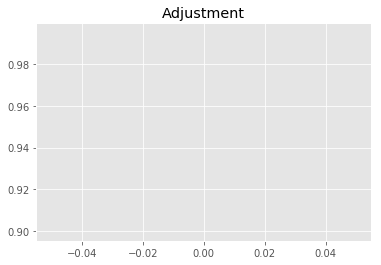

6476949252.872485
1


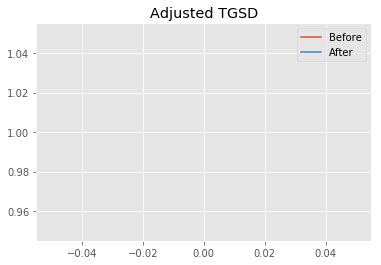

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.57941 	1.02606 	20007.6 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 6.83614e+09
After: 		|4.0023 	1.62492 	20476.2 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 160.477
New Misfit: 150.939
Convergence:
0.05943571354532987

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	1.18e+03 	1.13e+03 	0.9614 		1.0000


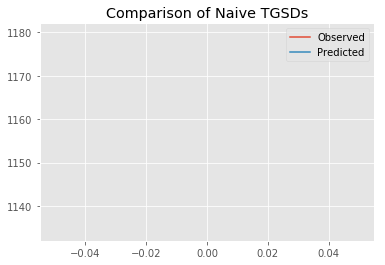

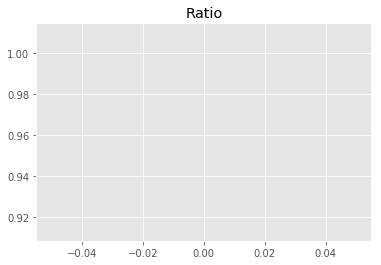

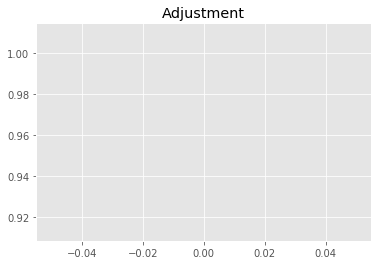

6572465679.220983
1


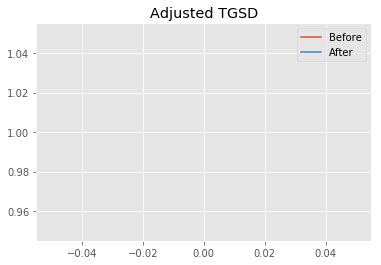

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|4.0023 	1.62492 	20476.2 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 6.83614e+09
After: 		|5.36959 	1.61719 	18782.5 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 150.939
New Misfit: 148.317
Convergence:
0.017376025830792497

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	1.19e+03 	1.13e+03 	0.9519 		1.0000


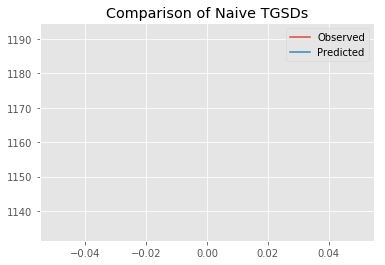

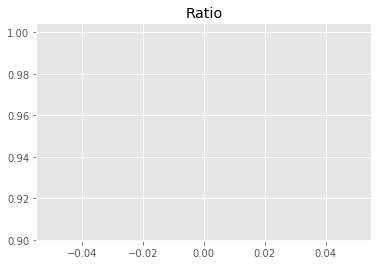

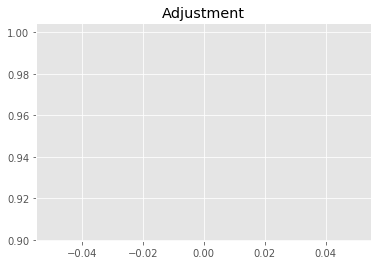

6507324164.9846735
1


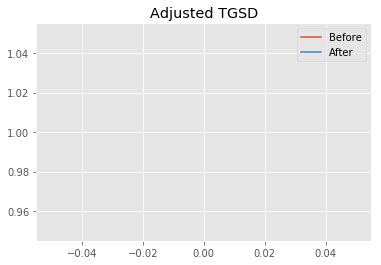

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|5.36959 	1.61719 	18782.5 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 6.83614e+09
After: 		|6.22343 	1.89511 	18797.7 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 148.317
New Misfit: 148.216
Convergence:
0.0006755023284382761

____________________
a = 6.22343	b = 1.89511	            h1 = 18797.69652	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 6836143986.19342
Success: True
Status: Successful convergence.
Iterations: 4
Misfit: 148.21645292527506
Prior Misfit: 203.037,	 Post Misfit: 148.216


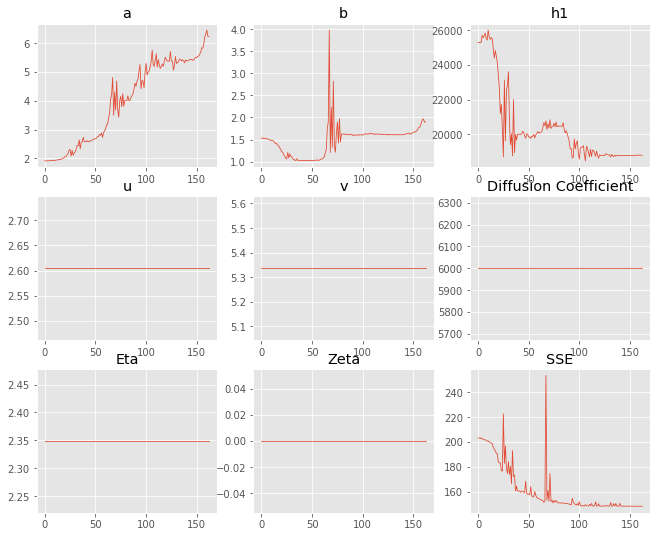

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,1.91762,6.22343
b,1.53124,1.89511
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"25,289.5","18,797.7"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 4 Time: 0.085 minutes


Estimated remaining run time: 0.780 minutes


Run 4===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	1.06e+03 	1.13e+03 	1.0698 		1.0000


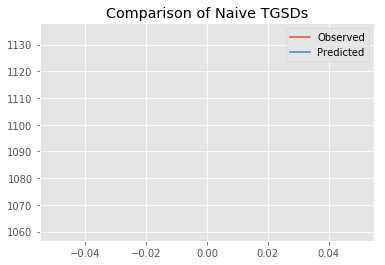

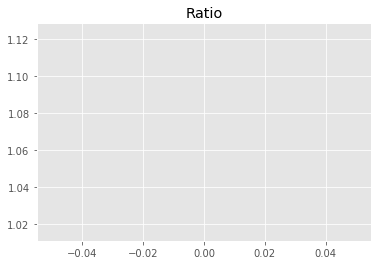

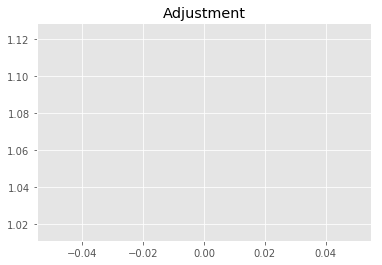

7313473544.662434
1


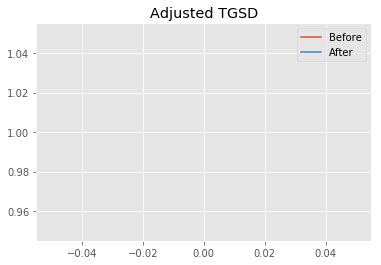

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.07176 	4.00383 	35005.9 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 6.83614e+09
After: 		|5.53898 	3.14647 	22057.9 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 188.372
New Misfit: 150.545
Convergence:
0.20081159296604956

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	1.20e+03 	1.13e+03 	0.9442 		1.0000


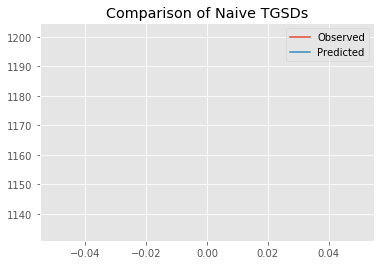

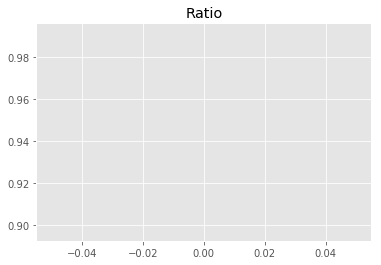

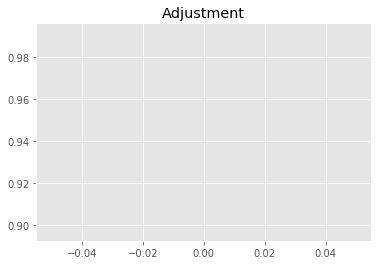

6454897884.973134
1


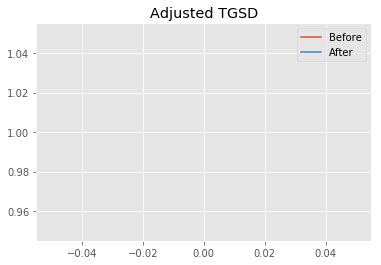

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|5.53898 	3.14647 	22057.9 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 6.83614e+09
After: 		|8.49527 	3.17704 	19613.8 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 150.545
New Misfit: 148.291
Convergence:
0.014968575338996303

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	1.20e+03 	1.13e+03 	0.9452 		1.0000


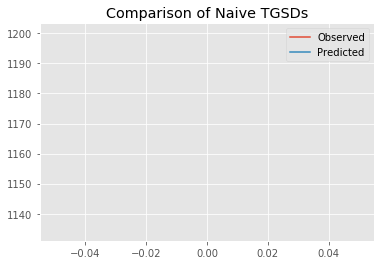

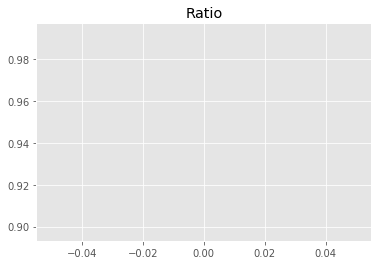

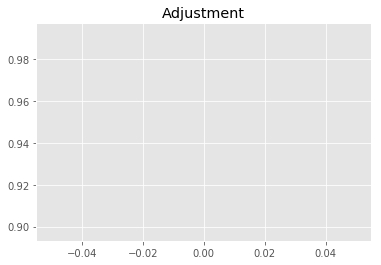

6461494064.66515
1


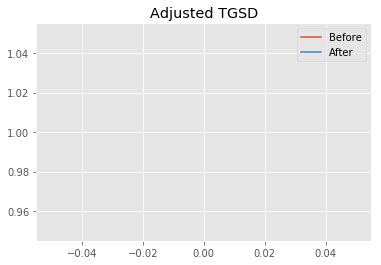

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|8.49527 	3.17704 	19613.8 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 6.83614e+09
After: 		|8.89695 	3.05008 	19169.1 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 148.291
New Misfit: 148.281
Convergence:
6.536423458215221e-05

____________________
a = 8.89695	b = 3.05008	            h1 = 19169.12686	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 6836143986.19342
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 148.2814210614534
Prior Misfit: 188.372,	 Post Misfit: 148.281


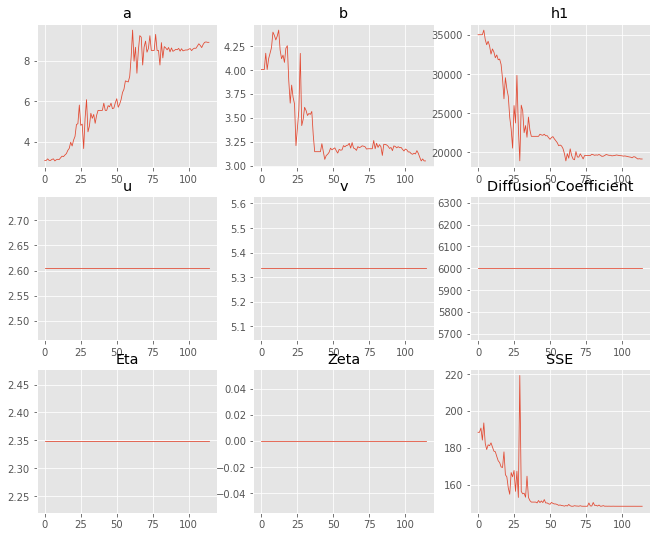

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,3.07176,8.89695
b,4.00383,3.05008
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"35,005.9","19,169.1"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 5 Time: 0.063 minutes


Estimated remaining run time: 0.755 minutes


Run 5===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	7.44e+02 	1.13e+03 	1.5254 		1.0000


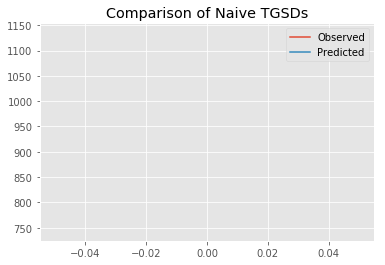

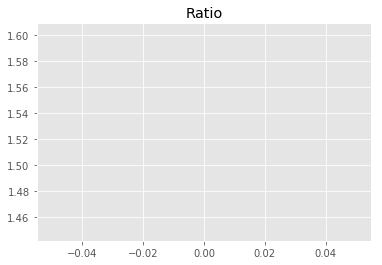

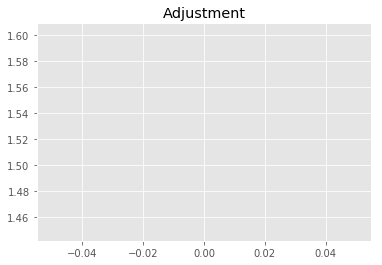

10427675176.786345
1


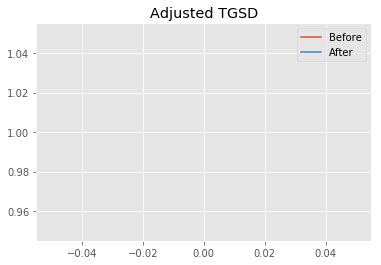

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|4.99441 	4.83756 	37108 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 6.83614e+09
After: 		|7.54891 	7.95527 	28998.6 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 439.569
New Misfit: 151.897
Convergence:
0.6544418604373445

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	1.15e+03 	1.13e+03 	0.9887 		1.0000


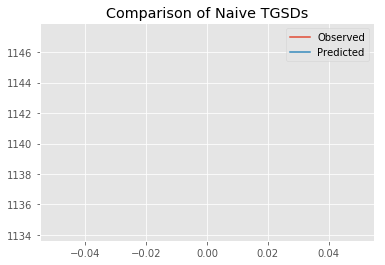

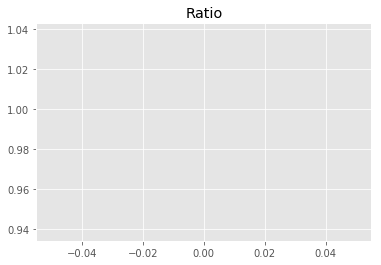

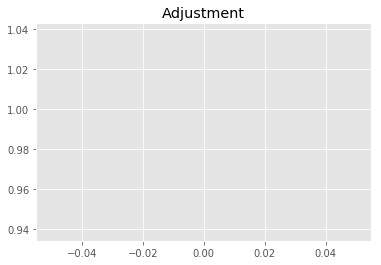

6758807530.5819645
1


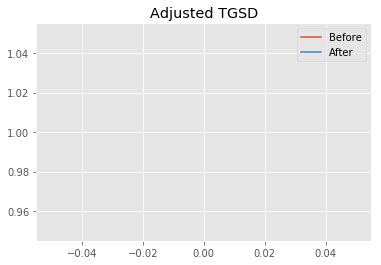

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|7.54891 	7.95527 	28998.6 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 6.83614e+09
After: 		|10.4692 	9.58767 	26045.7 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 151.897
New Misfit: 149.239
Convergence:
0.017498921723795312

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	1.21e+03 	1.13e+03 	0.9344 		1.0000


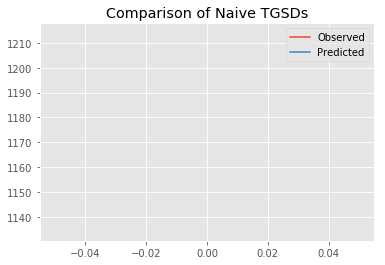

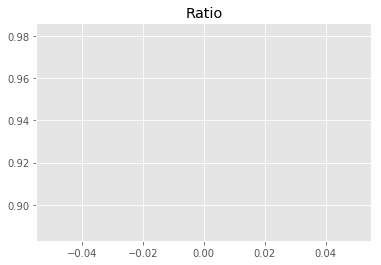

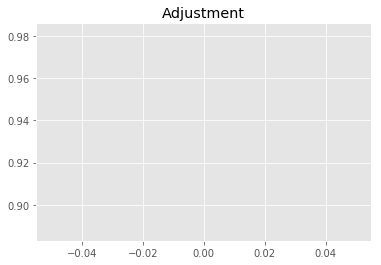

6387844803.86839
1


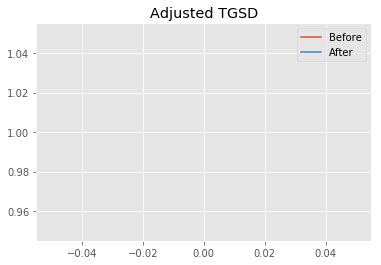

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|10.4692 	9.58767 	26045.7 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 6.83614e+09
After: 		|13.8157 	10.4522 	24215.9 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 149.239
New Misfit: 148.512
Convergence:
0.004870098462338688

____________________
a = 13.81571	b = 10.45217	            h1 = 24215.87009	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 6836143986.19342
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 148.5118179317127
Prior Misfit: 439.569,	 Post Misfit: 148.512


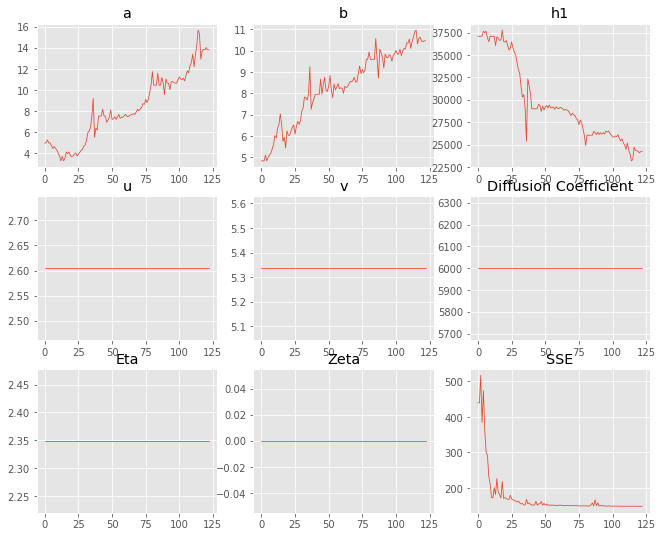

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,4.99441,13.8157
b,4.83756,10.4522
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"37,108","24,215.9"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 6 Time: 0.068 minutes


Estimated remaining run time: 0.726 minutes


Run 6===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	1.56e+03 	1.13e+03 	0.7291 		1.0000


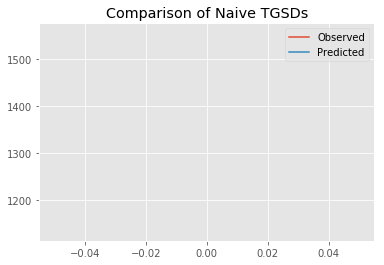

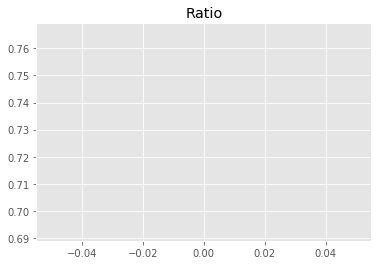

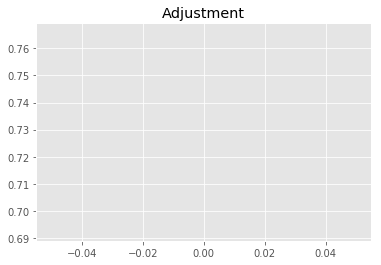

4984188642.36623
1


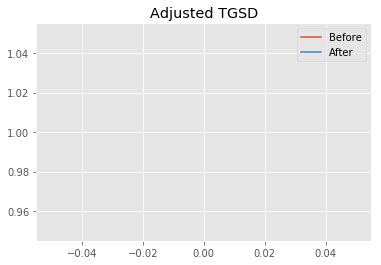

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.73546 	4.10254 	25011 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 6.83614e+09
After: 		|3.27683 	2.73889 	25587 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 341.724
New Misfit: 167.27
Convergence:
0.5105120328002785

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	1.19e+03 	1.13e+03 	0.9500 		1.0000


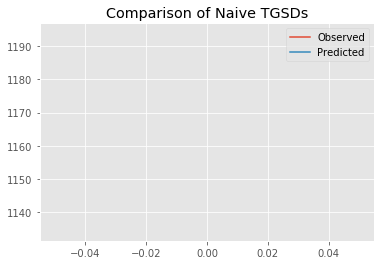

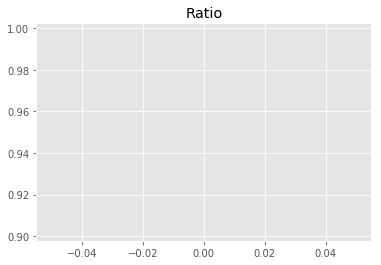

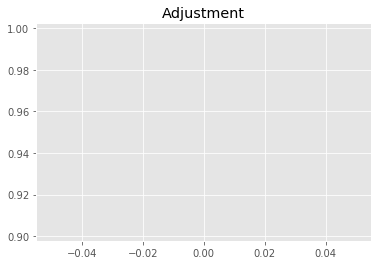

6494452116.193709
1


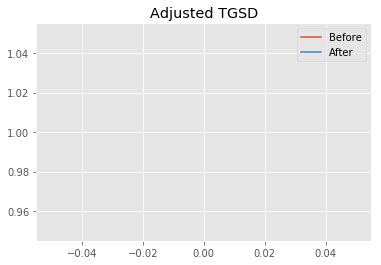

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.27683 	2.73889 	25587 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 6.83614e+09
After: 		|6.56284 	2.58348 	19856.7 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 167.27
New Misfit: 148.546
Convergence:
0.11193646368977121

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	1.20e+03 	1.13e+03 	0.9460 		1.0000


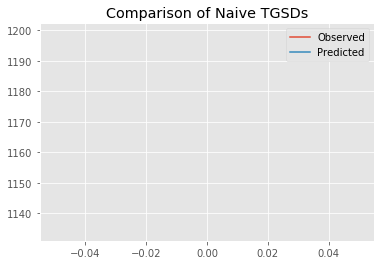

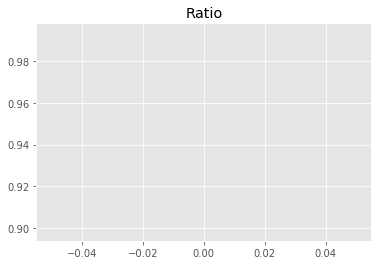

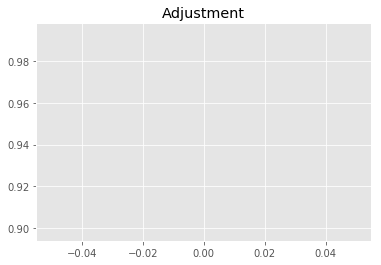

6466983780.603194
1


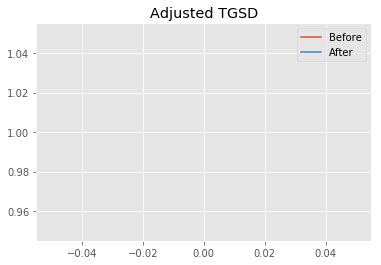

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|6.56284 	2.58348 	19856.7 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 6.83614e+09
After: 		|7.23099 	2.60728 	19546.9 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 148.546
New Misfit: 148.282
Convergence:
0.001778203244733934

____________________
a = 7.23099	b = 2.60728	            h1 = 19546.85617	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 6836143986.19342
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 148.28201203500578
Prior Misfit: 341.724,	 Post Misfit: 148.282


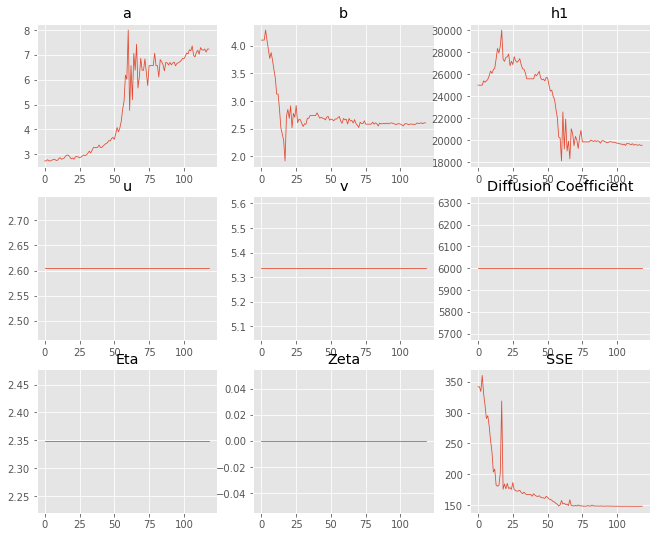

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,2.73546,7.23099
b,4.10254,2.60728
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"25,011","19,546.9"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 7 Time: 0.067 minutes


Estimated remaining run time: 0.687 minutes


Run 7===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	1.33e+03 	1.13e+03 	0.8550 		1.0000


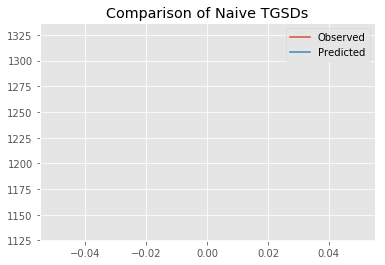

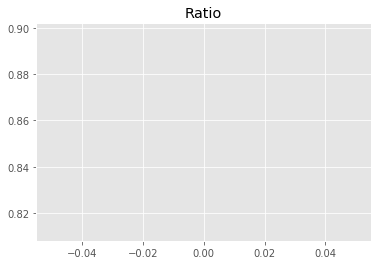

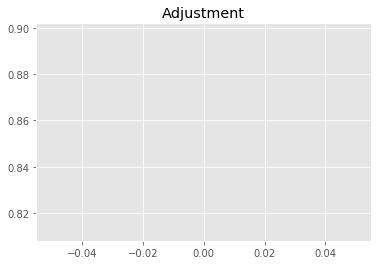

5844757767.142584
1


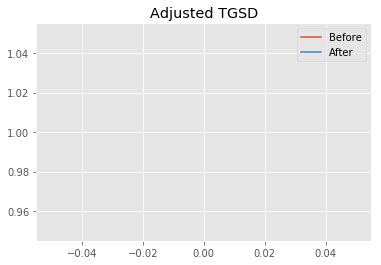

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.93461 	1.73146 	19069.1 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 6.83614e+09
After: 		|5.17434 	1.74711 	19567.9 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 171.574
New Misfit: 148.533
Convergence:
0.13429340957879154

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	1.19e+03 	1.13e+03 	0.9551 		1.0000


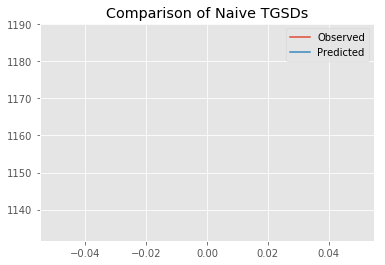

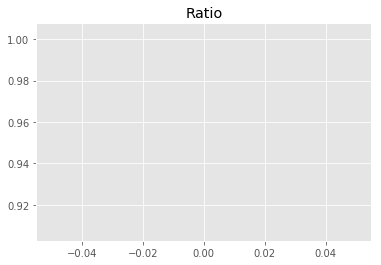

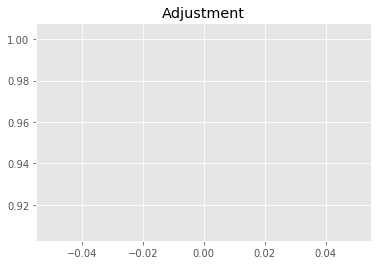

6529401419.746319
1


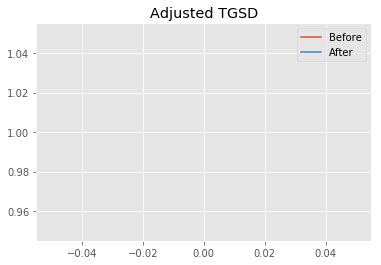

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|5.17434 	1.74711 	19567.9 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 6.83614e+09
After: 		|5.70286 	1.72781 	18785.8 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 148.533
New Misfit: 148.261
Convergence:
0.001832683360958479

____________________
a = 5.70286	b = 1.72781	            h1 = 18785.76882	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 6836143986.19342
Success: True
Status: Successful convergence.
Iterations: 2
Misfit: 148.26070247477364
Prior Misfit: 171.574,	 Post Misfit: 148.261


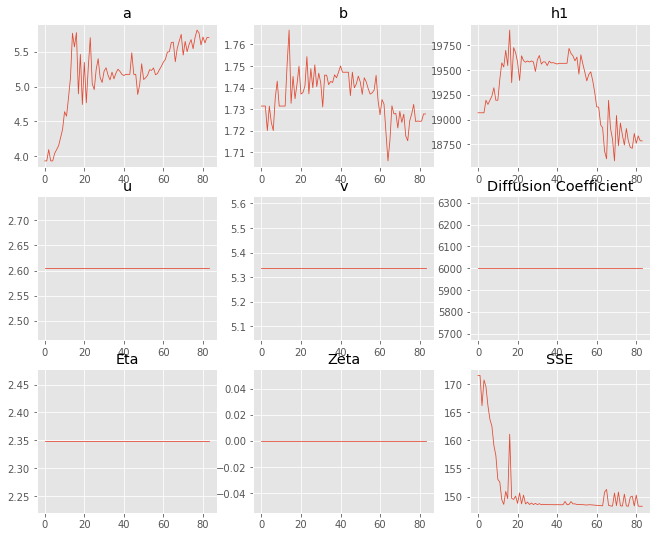

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,3.93461,5.70286
b,1.73146,1.72781
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"19,069.1","18,785.8"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 8 Time: 0.049 minutes


Estimated remaining run time: 0.619 minutes


Run 8===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	1.21e+03 	1.13e+03 	0.9376 		1.0000


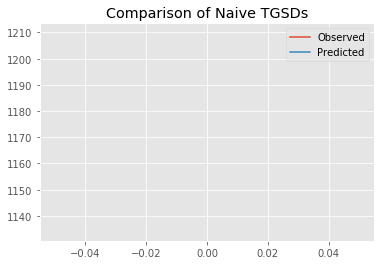

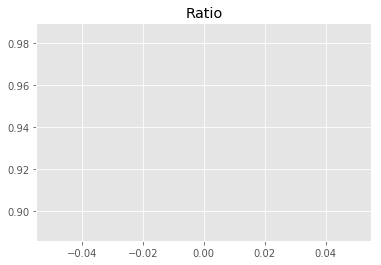

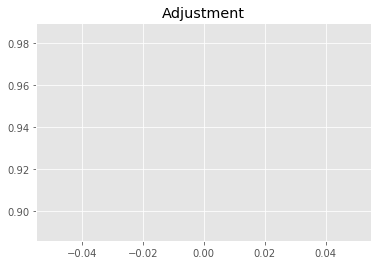

6409808783.292903
1


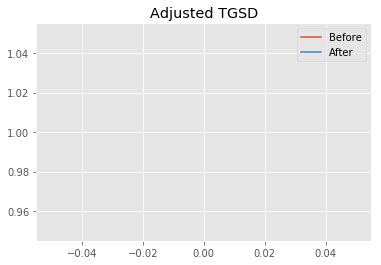

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.73732 	2.31494 	22653.5 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 6.83614e+09
After: 		|7.16001 	2.28686 	18870 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 158.113
New Misfit: 148.254
Convergence:
0.062358806889877744

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	1.20e+03 	1.13e+03 	0.9424 		1.0000


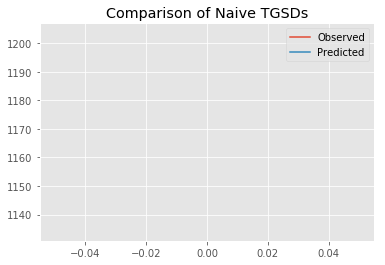

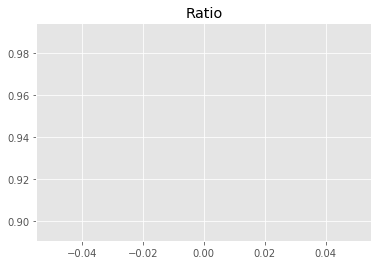

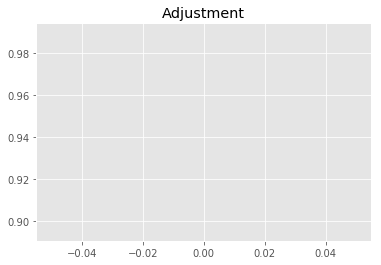

6442643060.222152
1


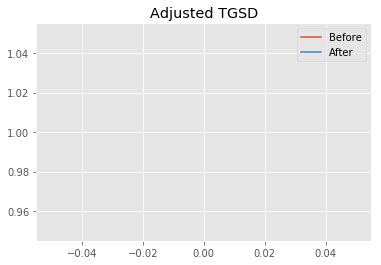

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|7.16001 	2.28686 	18870 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 6.83614e+09
After: 		|7.39069 	2.29629 	18801.7 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 148.254
New Misfit: 148.207
Convergence:
0.00031217978294142886

____________________
a = 7.39069	b = 2.29629	            h1 = 18801.74074	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 6836143986.19342
Success: True
Status: Successful convergence.
Iterations: 2
Misfit: 148.20732846488613
Prior Misfit: 158.113,	 Post Misfit: 148.207


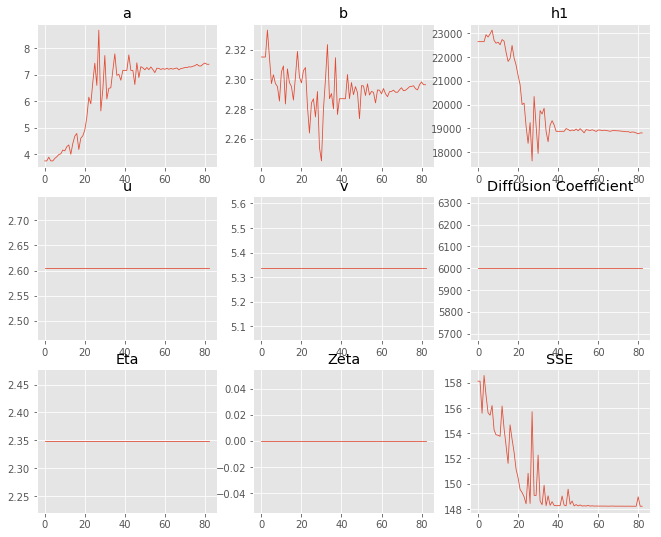

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,3.73732,7.39069
b,2.31494,2.29629
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"22,653.5","18,801.7"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 9 Time: 0.048 minutes


Estimated remaining run time: 0.555 minutes


Run 9===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	1.14e+03 	1.13e+03 	0.9929 		1.0000


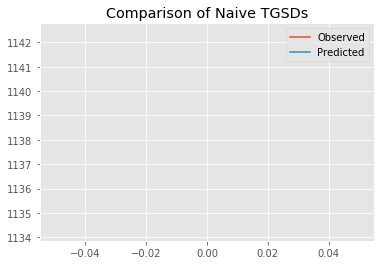

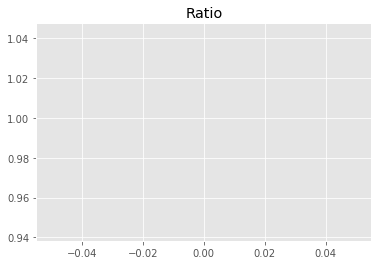

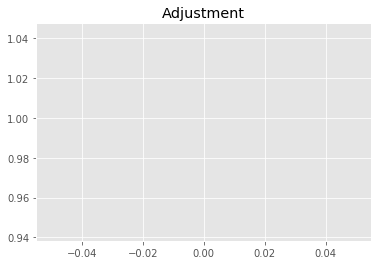

6787599643.840926
1


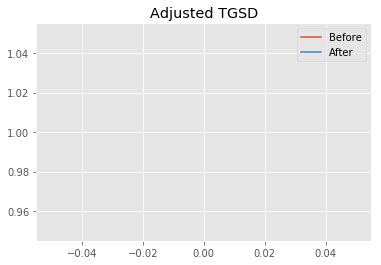

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.44004 	4.22935 	31847.6 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 6.83614e+09
After: 		|6.26957 	3.48081 	22331.3 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 171.302
New Misfit: 150.007
Convergence:
0.12431619497293171

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	1.16e+03 	1.13e+03 	0.9741 		1.0000


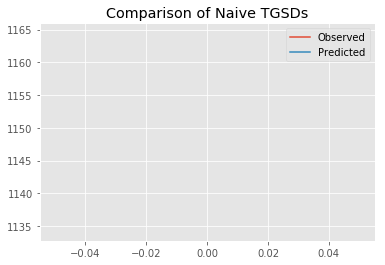

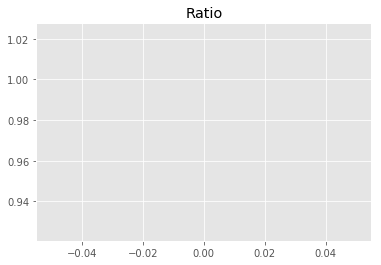

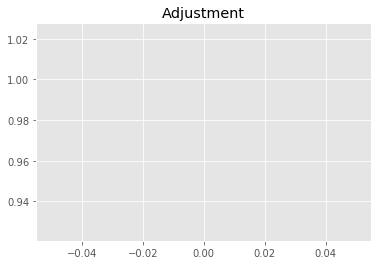

6658993633.4557705
1


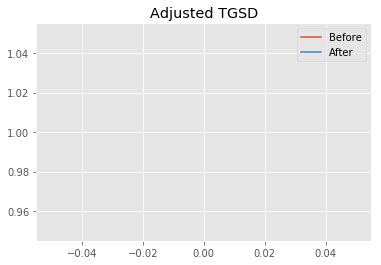

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|6.26957 	3.48081 	22331.3 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 6.83614e+09
After: 		|10.273 	3.91933 	19606.8 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 150.007
New Misfit: 148.347
Convergence:
0.011061948399264688

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	1.20e+03 	1.13e+03 	0.9420 		1.0000


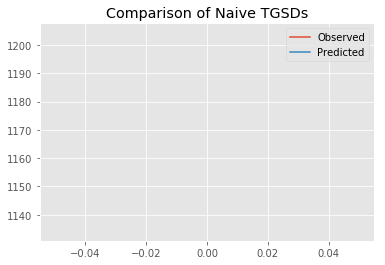

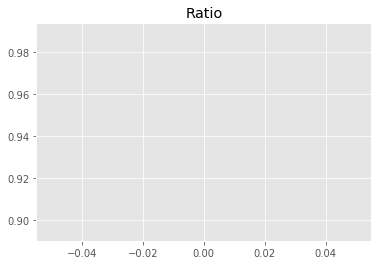

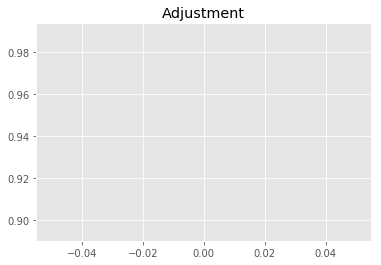

6439325290.398761
1


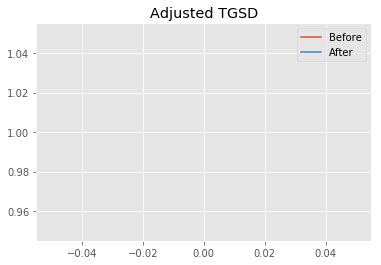

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|10.273 	3.91933 	19606.8 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 6.83614e+09
After: 		|10.2394 	3.88318 	19604 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 148.347
New Misfit: 148.34
Convergence:
4.962699990926909e-05

____________________
a = 10.23944	b = 3.88318	            h1 = 19604.00833	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 6836143986.19342
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 148.33998970446055
Prior Misfit: 171.302,	 Post Misfit: 148.34


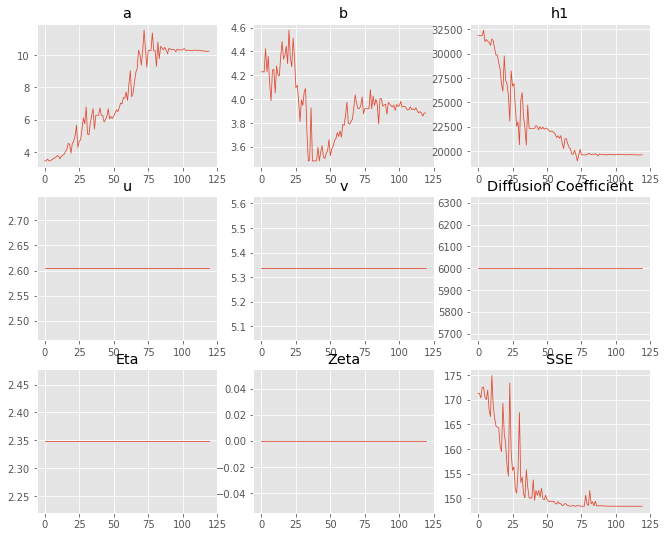

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,3.44004,10.2394
b,4.22935,3.88318
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"31,847.6","19,604"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 10 Time: 0.066 minutes


Estimated remaining run time: 0.508 minutes


Run 10===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	1.48e+03 	1.13e+03 	0.7654 		1.0000


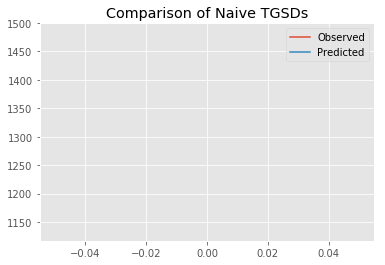

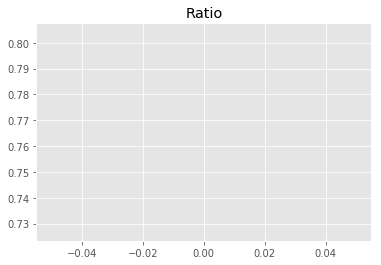

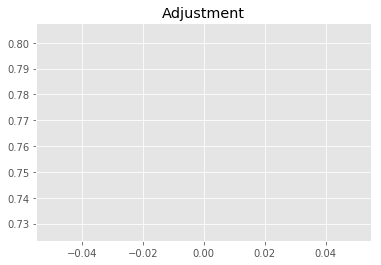

5232396783.975574
1


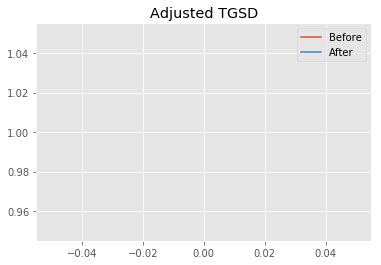

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.22082 	1.29709 	17227.5 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 6.83614e+09
After: 		|6.65228 	1.23123 	16737.9 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 231.209
New Misfit: 151.55
Convergence:
0.34453316624530006

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	1.26e+03 	1.13e+03 	0.8971 		1.0000


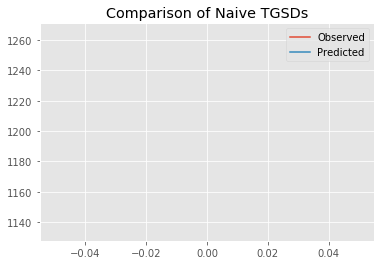

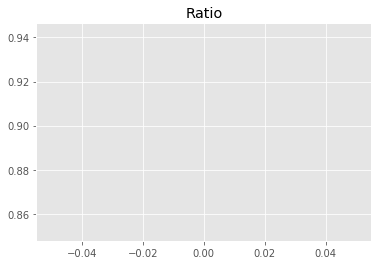

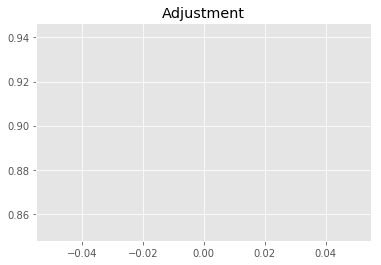

6132517404.117799
1


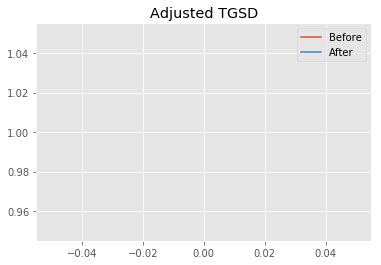

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|6.65228 	1.23123 	16737.9 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 6.83614e+09
After: 		|8.17034 	1.20469 	16719.2 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 151.55
New Misfit: 148.337
Convergence:
0.02119975244253022

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	1.21e+03 	1.13e+03 	0.9383 		1.0000


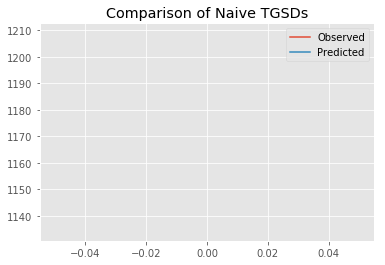

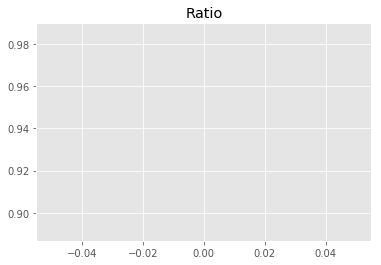

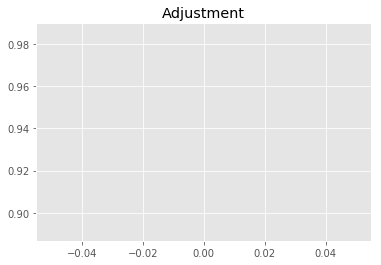

6414166177.701071
1


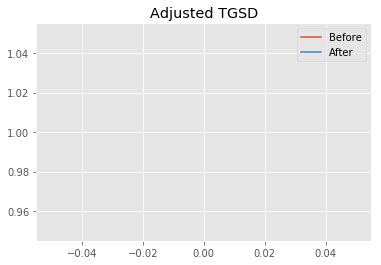

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|8.17034 	1.20469 	16719.2 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 6.83614e+09
After: 		|7.02679 	1.01486 	16692.7 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 148.337
New Misfit: 148.175
Convergence:
0.0010935053372856717

____________________
a = 7.02679	b = 1.01486	            h1 = 16692.69060	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 6836143986.19342
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 148.17471192773763
Prior Misfit: 231.209,	 Post Misfit: 148.175


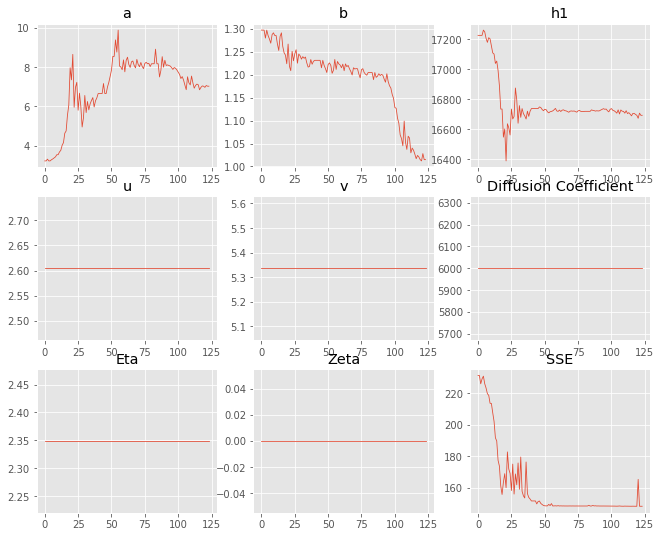

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,3.22082,7.02679
b,1.29709,1.01486
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"17,227.5","16,692.7"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 11 Time: 0.067 minutes


Estimated remaining run time: 0.459 minutes


Run 11===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	1.09e+03 	1.13e+03 	1.0393 		1.0000


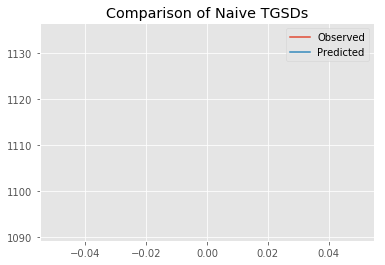

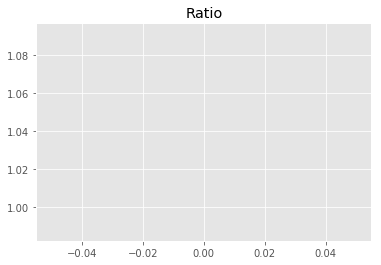

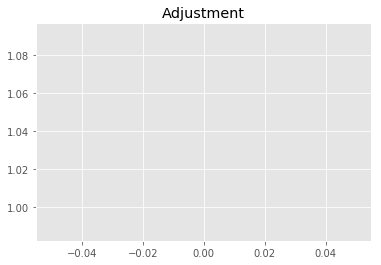

7105028146.172894
1


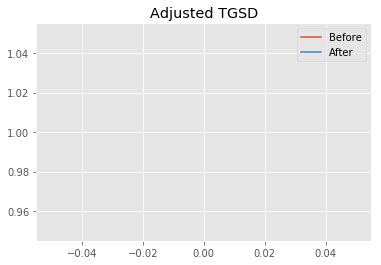

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.16987 	4.0147 	33630.8 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 6.83614e+09
After: 		|4.70694 	3.32561 	23457.4 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 180.547
New Misfit: 156.074
Convergence:
0.13555223826302598

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	1.23e+03 	1.13e+03 	0.9238 		1.0000


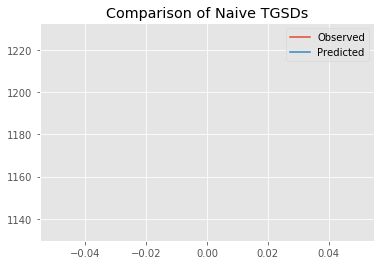

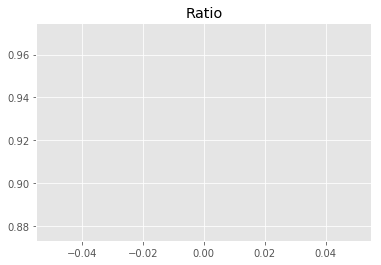

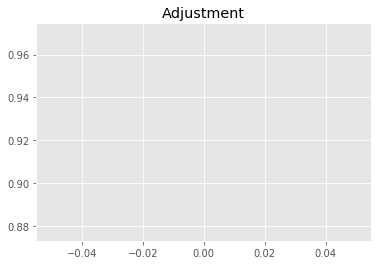

6315290747.782732
1


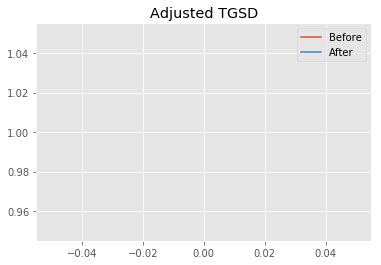

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|4.70694 	3.32561 	23457.4 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 6.83614e+09
After: 		|9.90287 	4.53179 	20522.4 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 156.074
New Misfit: 148.42
Convergence:
0.049037689638533215

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	1.21e+03 	1.13e+03 	0.9409 		1.0000


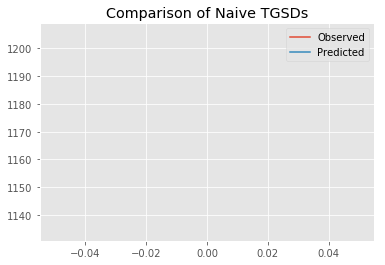

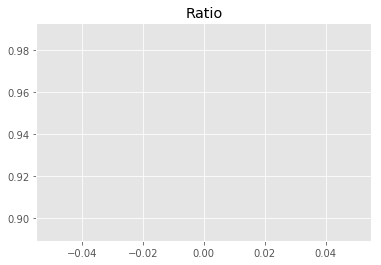

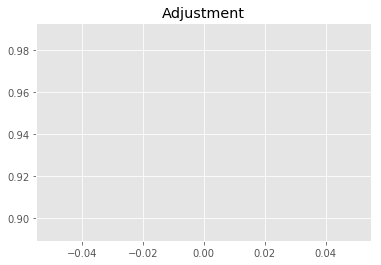

6432221784.887477
1


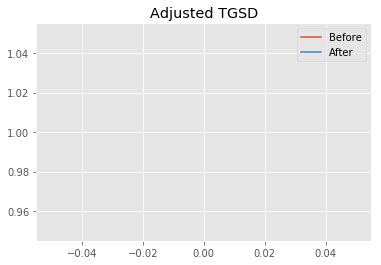

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|9.90287 	4.53179 	20522.4 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 6.83614e+09
After: 		|9.99654 	4.5564 	20566.9 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 148.42
New Misfit: 148.385
Convergence:
0.00023555282860879156

____________________
a = 9.99654	b = 4.55640	            h1 = 20566.89766	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 6836143986.19342
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 148.3852475519194
Prior Misfit: 180.547,	 Post Misfit: 148.385


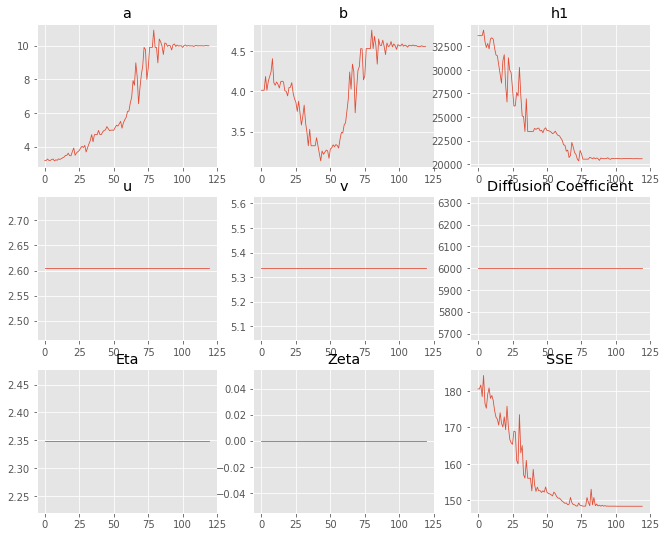

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,3.16987,9.99654
b,4.0147,4.5564
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"33,630.8","20,566.9"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 12 Time: 0.066 minutes


Estimated remaining run time: 0.406 minutes


Run 12===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	1.23e+03 	1.13e+03 	0.9191 		1.0000


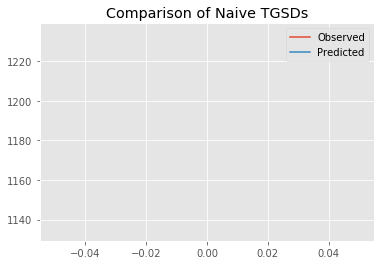

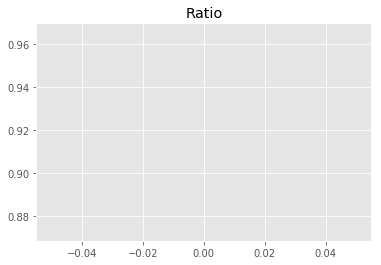

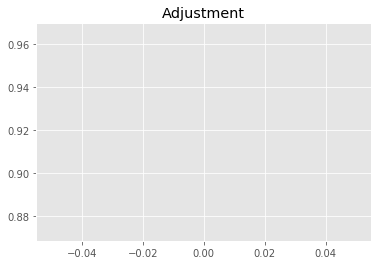

6283384097.6112
1


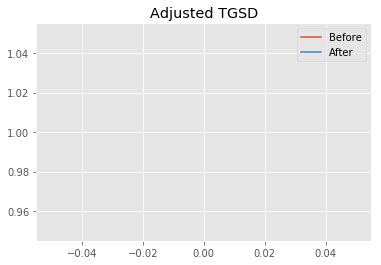

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.32192 	4.82576 	32562.9 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 6.83614e+09
After: 		|5.77582 	3.80711 	23696.8 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 183.364
New Misfit: 150.947
Convergence:
0.17679059153316304

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	1.17e+03 	1.13e+03 	0.9735 		1.0000


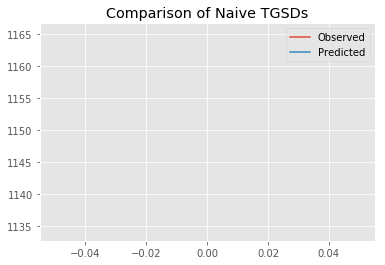

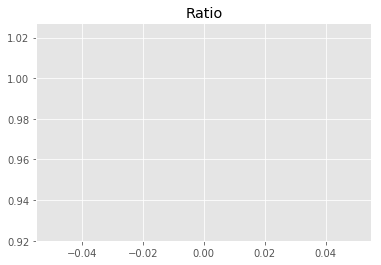

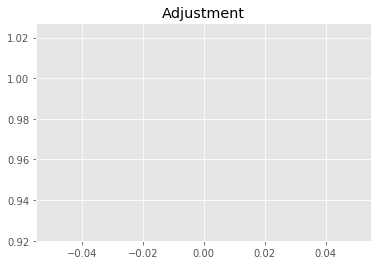

6654941015.222925
1


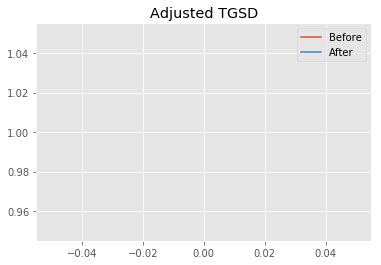

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|5.77582 	3.80711 	23696.8 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 6.83614e+09
After: 		|8.12245 	3.74197 	20746.4 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 150.947
New Misfit: 148.472
Convergence:
0.016398759805760648

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	1.19e+03 	1.13e+03 	0.9504 		1.0000


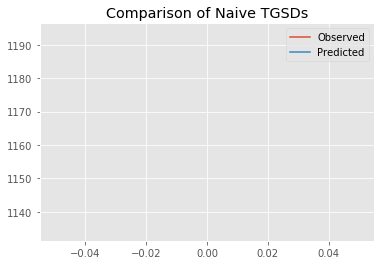

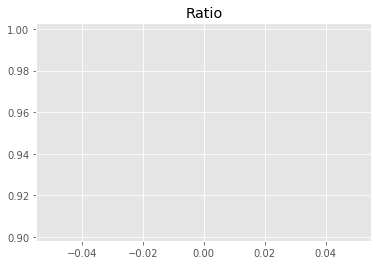

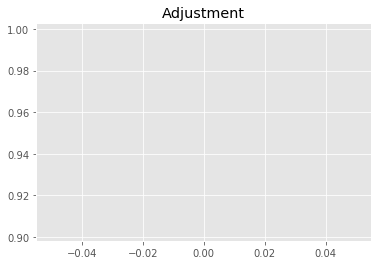

6497053881.994471
1


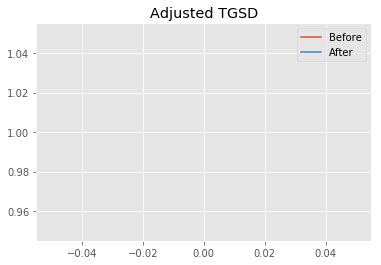

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|8.12245 	3.74197 	20746.4 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 6.83614e+09
After: 		|8.89674 	3.6471 	20017.3 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 148.472
New Misfit: 148.35
Convergence:
0.000819755066528881

____________________
a = 8.89674	b = 3.64710	            h1 = 20017.25277	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 6836143986.19342
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 148.3502931400805
Prior Misfit: 183.364,	 Post Misfit: 148.35


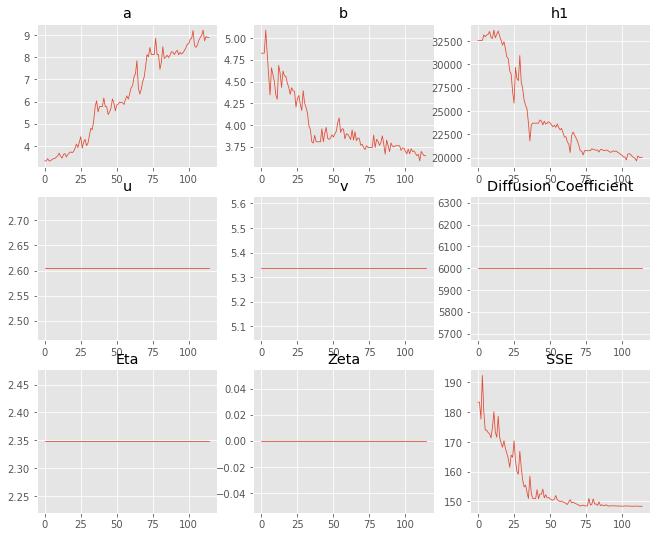

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,3.32192,8.89674
b,4.82576,3.6471
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"32,562.9","20,017.3"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 13 Time: 0.064 minutes


Estimated remaining run time: 0.351 minutes


Run 13===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	1.42e+03 	1.13e+03 	0.8004 		1.0000


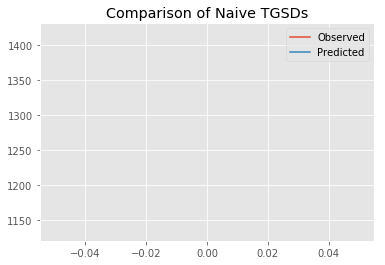

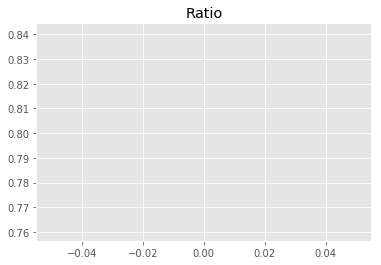

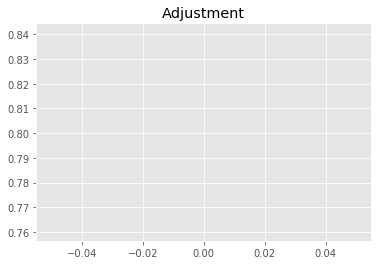

5471985236.7651205
1


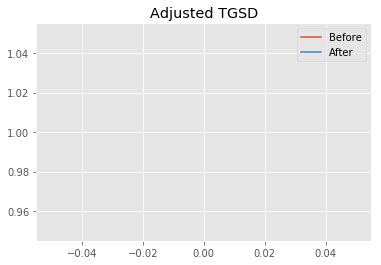

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|4.64031 	4.69346 	24114.2 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 6.83614e+09
After: 		|7.73779 	4.379 	22090.9 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 210.208
New Misfit: 148.825
Convergence:
0.2920117284379185

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	1.19e+03 	1.13e+03 	0.9525 		1.0000


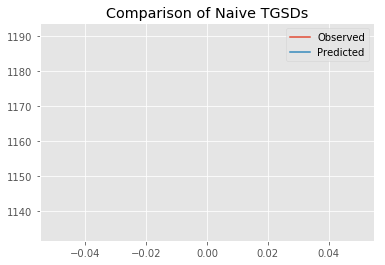

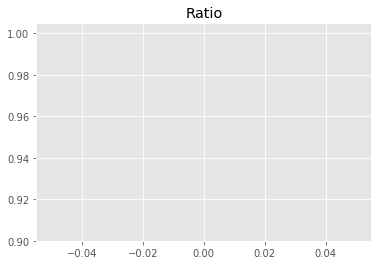

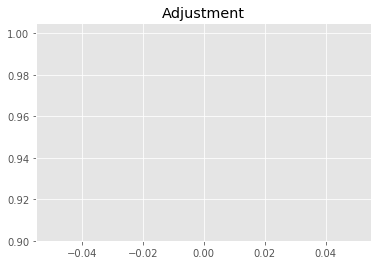

6511279386.782778
1


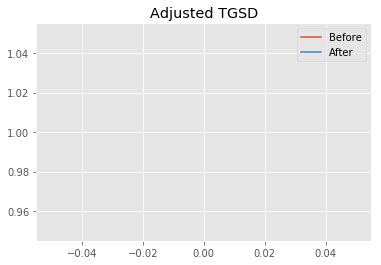

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|7.73779 	4.379 	22090.9 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 6.83614e+09
After: 		|10.5883 	4.87328 	20555.4 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 148.825
New Misfit: 148.401
Convergence:
0.0028468843148016605

____________________
a = 10.58834	b = 4.87328	            h1 = 20555.35197	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 6836143986.19342
Success: True
Status: Successful convergence.
Iterations: 2
Misfit: 148.40126291541776
Prior Misfit: 210.208,	 Post Misfit: 148.401


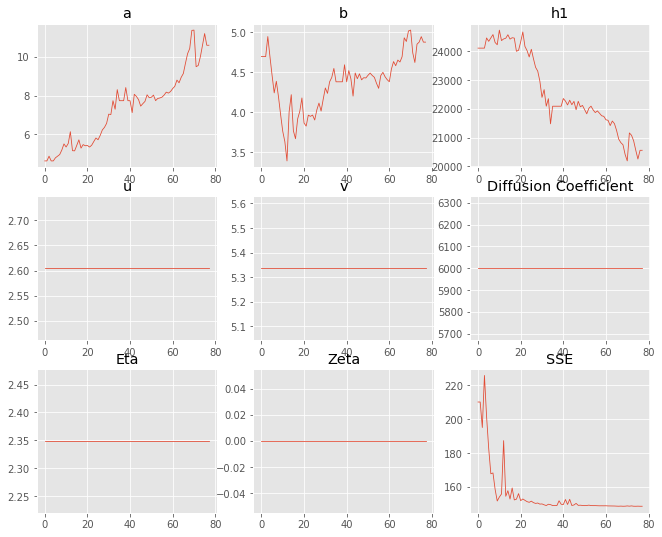

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,4.64031,10.5883
b,4.69346,4.87328
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"24,114.2","20,555.4"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 14 Time: 0.047 minutes


Estimated remaining run time: 0.289 minutes


Run 14===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	1.38e+03 	1.13e+03 	0.8221 		1.0000


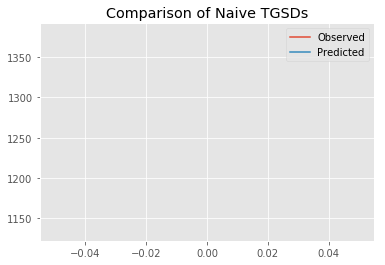

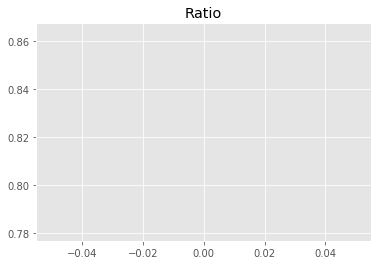

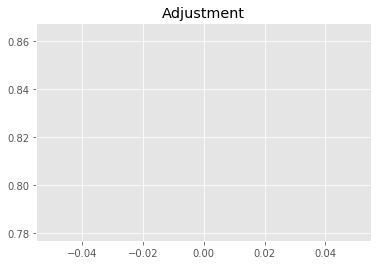

5619754609.149553
1


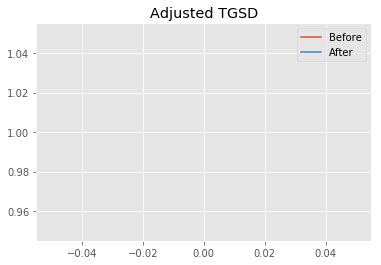

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.21335 	4.7302 	35159.7 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 6.83614e+09
After: 		|2.42696 	3.28127 	34418.9 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 285.803
New Misfit: 202.037
Convergence:
0.2930881649159802

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	1.11e+03 	1.13e+03 	1.0234 		1.0000


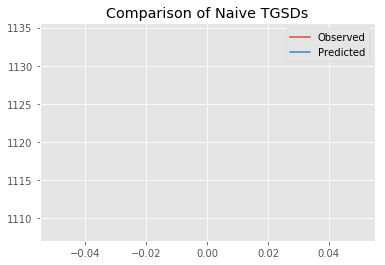

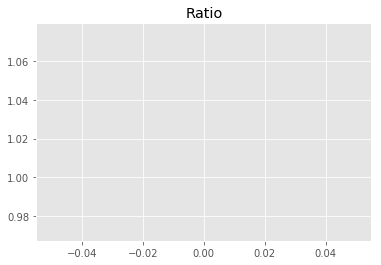

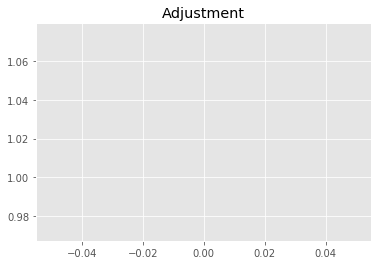

6996054335.272276
1


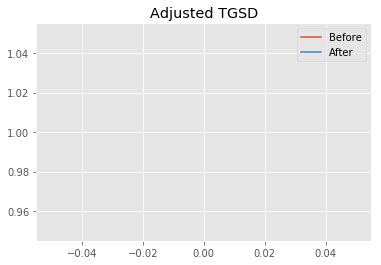

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.42696 	3.28127 	34418.9 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 6.83614e+09
After: 		|3.68624 	2.05277 	21506.1 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 202.037
New Misfit: 159.726
Convergence:
0.2094223242114927

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	1.24e+03 	1.13e+03 	0.9160 		1.0000


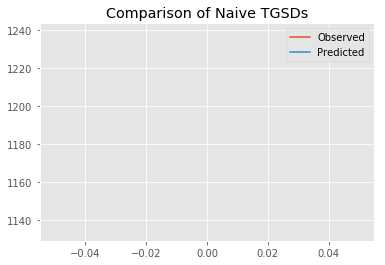

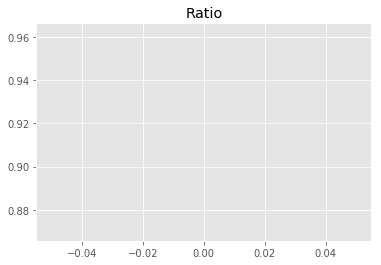

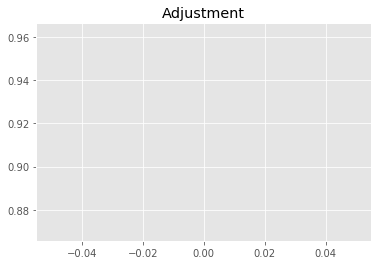

6261753538.501306
1


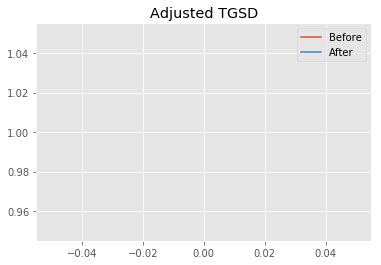

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.68624 	2.05277 	21506.1 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 6.83614e+09
After: 		|6.39681 	2.04158 	19054.1 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 159.726
New Misfit: 148.284
Convergence:
0.07163651406918731

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	1.19e+03 	1.13e+03 	0.9542 		1.0000


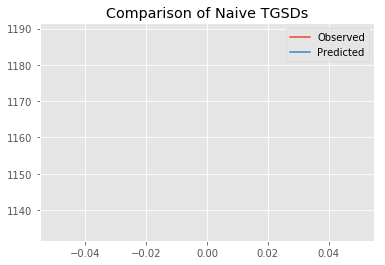

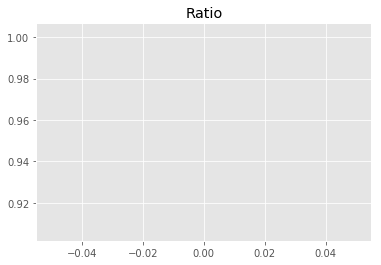

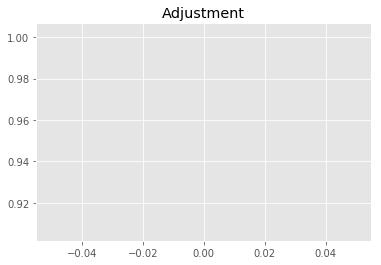

6523047535.803975
1


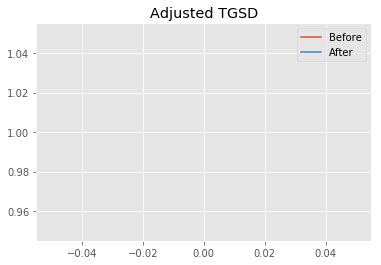

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|6.39681 	2.04158 	19054.1 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 6.83614e+09
After: 		|6.67614 	2.05299 	18786.6 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 148.284
New Misfit: 148.201
Convergence:
0.0005605141291401888

____________________
a = 6.67614	b = 2.05299	            h1 = 18786.57752	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 6836143986.19342
Success: True
Status: Successful convergence.
Iterations: 4
Misfit: 148.20076929345237
Prior Misfit: 285.803,	 Post Misfit: 148.201


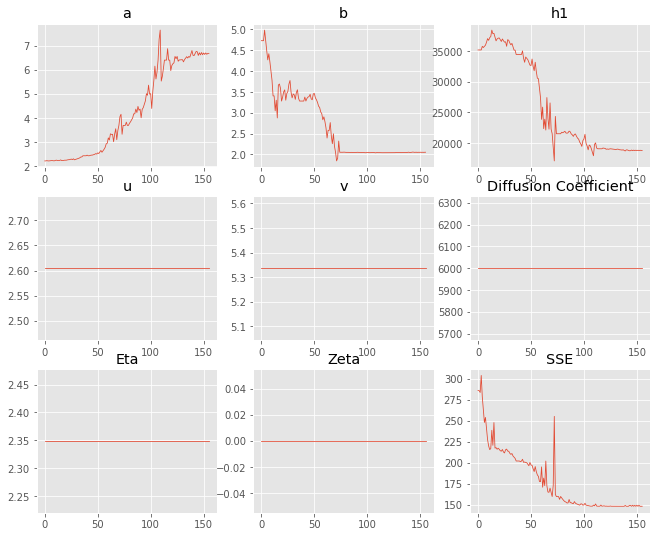

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,2.21335,6.67614
b,4.7302,2.05299
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"35,159.7","18,786.6"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 15 Time: 0.083 minutes


Estimated remaining run time: 0.237 minutes


Run 15===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	1.30e+03 	1.13e+03 	0.8709 		1.0000


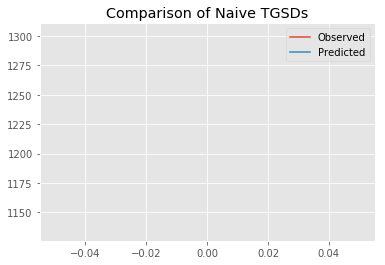

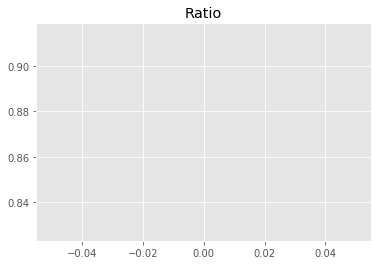

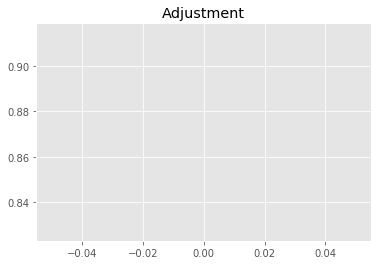

5953514396.549119
1


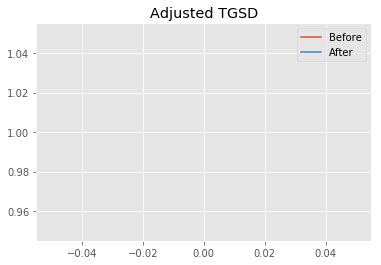

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.33526 	4.76769 	37023.3 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 6.83614e+09
After: 		|2.6832 	2.90758 	29422.2 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 246.177
New Misfit: 184.833
Convergence:
0.24918678192962934

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	1.16e+03 	1.13e+03 	0.9775 		1.0000


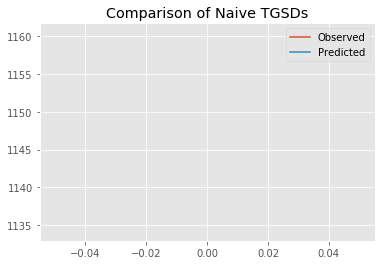

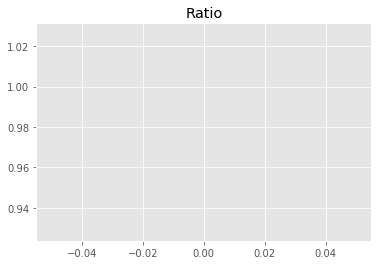

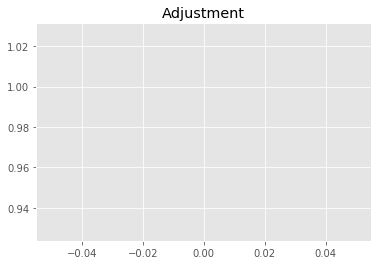

6682358824.883749
1


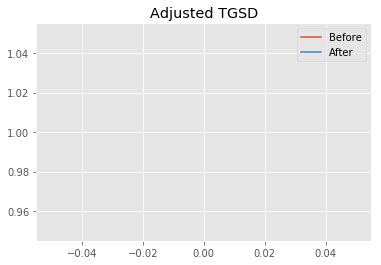

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.6832 	2.90758 	29422.2 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 6.83614e+09
After: 		|4.93276 	2.15486 	20355.2 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 184.833
New Misfit: 150.402
Convergence:
0.18628318014476206

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	1.21e+03 	1.13e+03 	0.9367 		1.0000


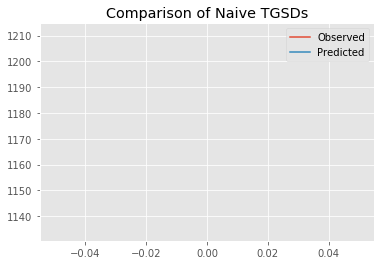

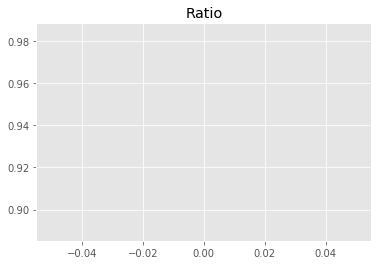

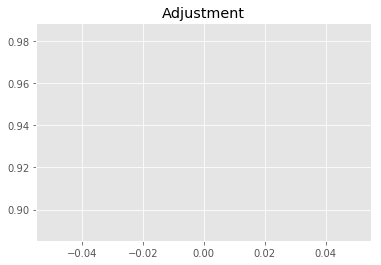

6403451853.282951
1


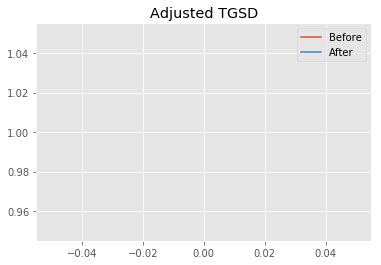

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|4.93276 	2.15486 	20355.2 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 6.83614e+09
After: 		|5.98339 	2.19406 	19746.8 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 150.402
New Misfit: 148.457
Convergence:
0.012931591943878855

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	1.20e+03 	1.13e+03 	0.9461 		1.0000


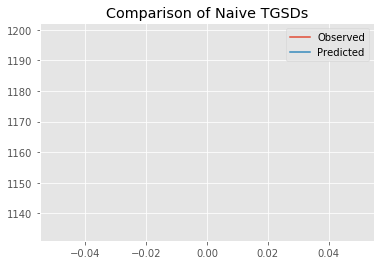

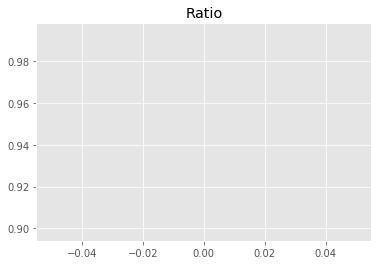

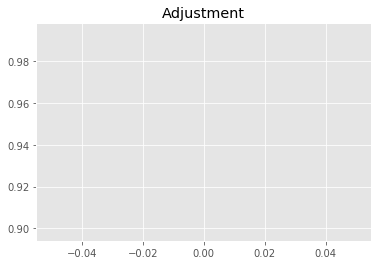

6467807205.746841
1


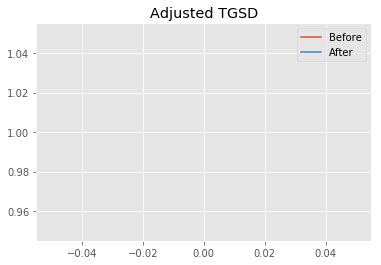

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|5.98339 	2.19406 	19746.8 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 6.83614e+09
After: 		|7.21065 	2.22009 	18788.3 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 148.457
New Misfit: 148.202
Convergence:
0.0017193766549055344

____________________
a = 7.21065	b = 2.22009	            h1 = 18788.28429	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 6836143986.19342
Success: True
Status: Successful convergence.
Iterations: 4
Misfit: 148.2017152464696
Prior Misfit: 246.177,	 Post Misfit: 148.202


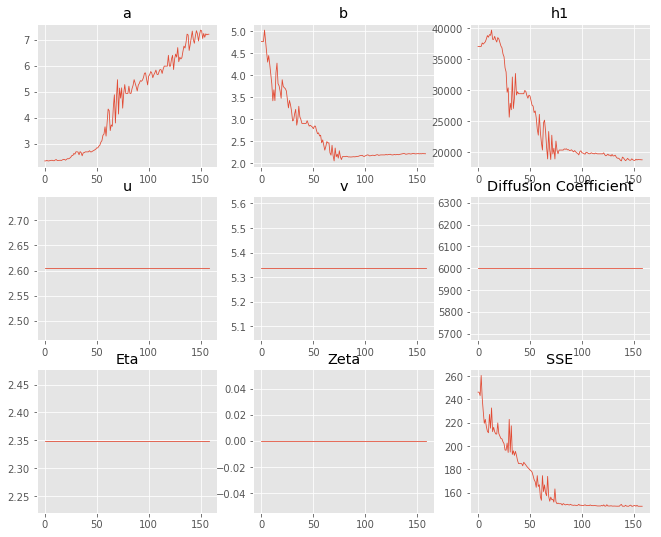

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,2.33526,7.21065
b,4.76769,2.22009
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"37,023.3","18,788.3"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 16 Time: 0.084 minutes


Estimated remaining run time: 0.182 minutes


Run 16===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	1.32e+03 	1.13e+03 	0.8603 		1.0000


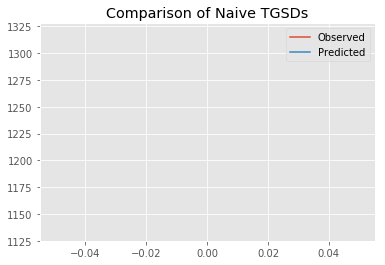

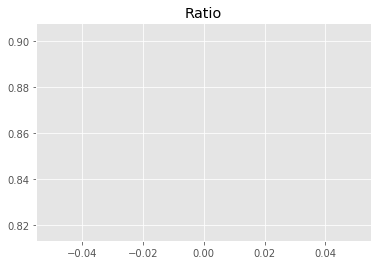

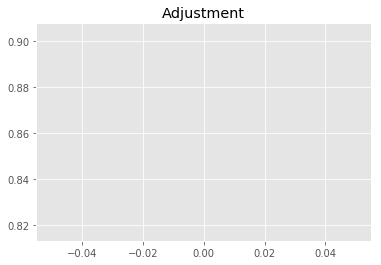

5881267273.792449
1


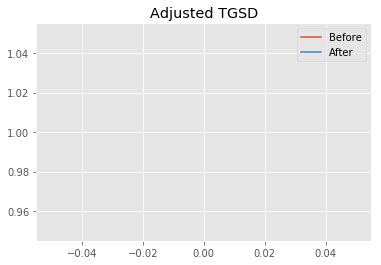

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|4.94156 	2.13188 	19083.3 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 6.83614e+09
After: 		|6.82264 	2.12631 	18874.9 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 165.576
New Misfit: 148.217
Convergence:
0.10484132633122009

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	1.19e+03 	1.13e+03 	0.9501 		1.0000


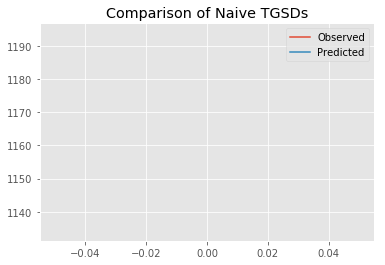

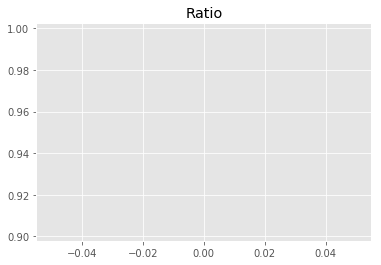

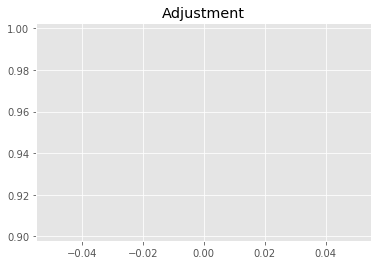

6495352530.523207
1


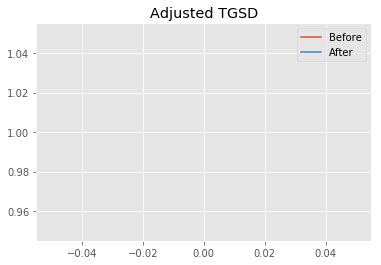

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|6.82264 	2.12631 	18874.9 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 6.83614e+09
After: 		|6.96781 	2.13679 	18773.2 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 148.217
New Misfit: 148.196
Convergence:
0.00014341587152672016

____________________
a = 6.96781	b = 2.13679	            h1 = 18773.16145	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 6836143986.19342
Success: True
Status: Successful convergence.
Iterations: 2
Misfit: 148.19587180812064
Prior Misfit: 165.576,	 Post Misfit: 148.196


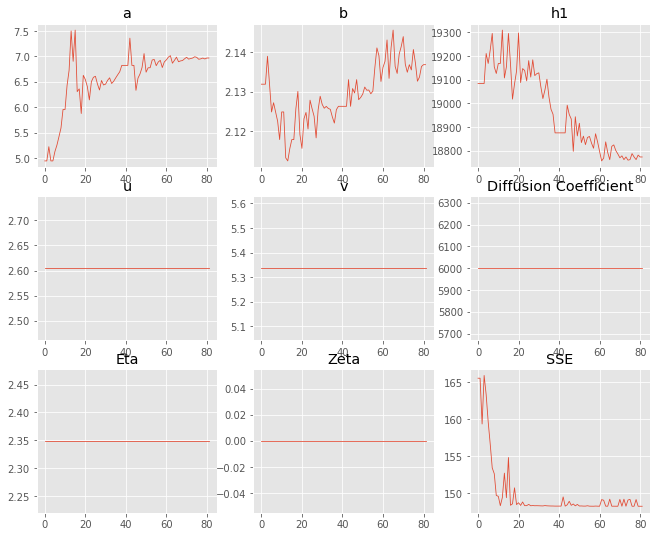

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,4.94156,6.96781
b,2.13188,2.13679
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"19,083.3","18,773.2"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 17 Time: 0.048 minutes


Estimated remaining run time: 0.120 minutes


Run 17===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	1.44e+03 	1.13e+03 	0.7902 		1.0000


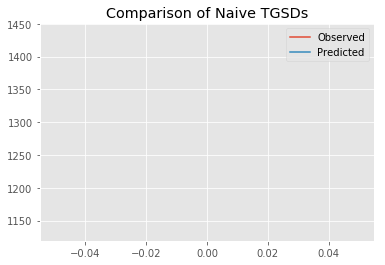

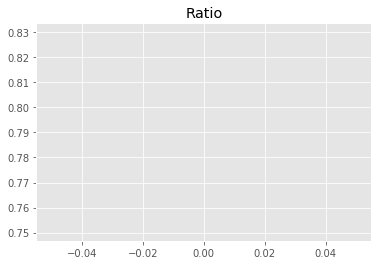

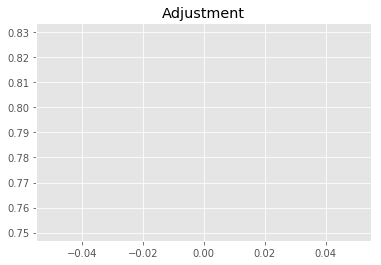

5401630218.357716
1


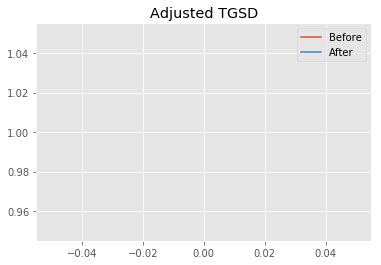

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|4.31573 	3.84413 	22523.7 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 6.83614e+09
After: 		|5.64446 	3.33145 	22596.3 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 218.492
New Misfit: 150.292
Convergence:
0.31213918761063203

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	1.18e+03 	1.13e+03 	0.9600 		1.0000


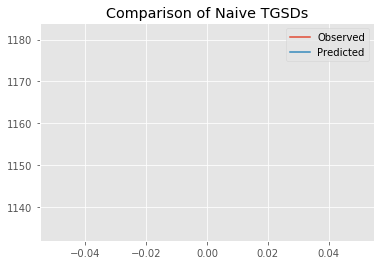

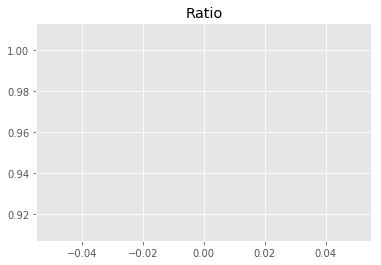

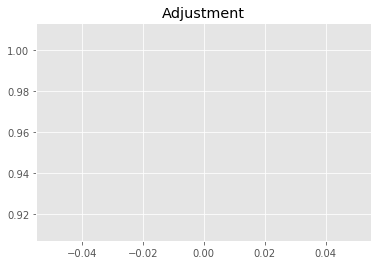

6562804641.035017
1


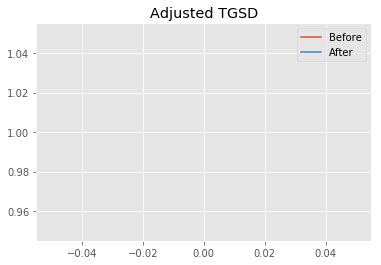

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|5.64446 	3.33145 	22596.3 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 6.83614e+09
After: 		|8.69942 	3.61548 	20084.8 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 150.292
New Misfit: 148.362
Convergence:
0.01284193111650646

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	1.20e+03 	1.13e+03 	0.9457 		1.0000


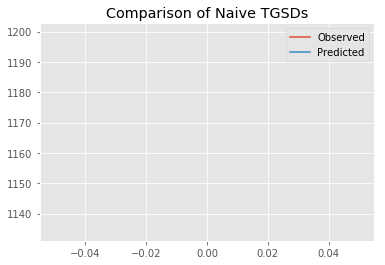

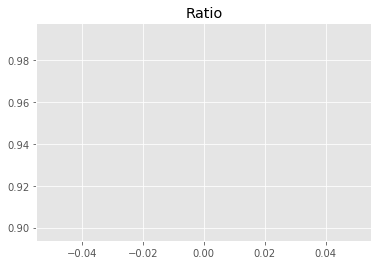

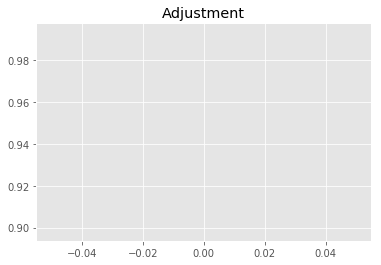

6464615165.838497
1


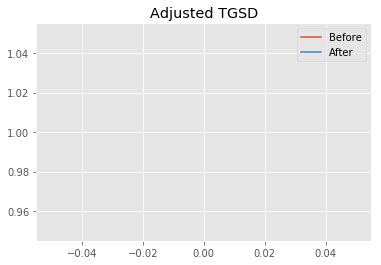

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|8.69942 	3.61548 	20084.8 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 6.83614e+09
After: 		|9.38454 	3.60152 	19707.2 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 148.362
New Misfit: 148.314
Convergence:
0.00032511198812296545

____________________
a = 9.38454	b = 3.60152	            h1 = 19707.19116	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 6836143986.19342
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 148.31409802618577
Prior Misfit: 218.492,	 Post Misfit: 148.314


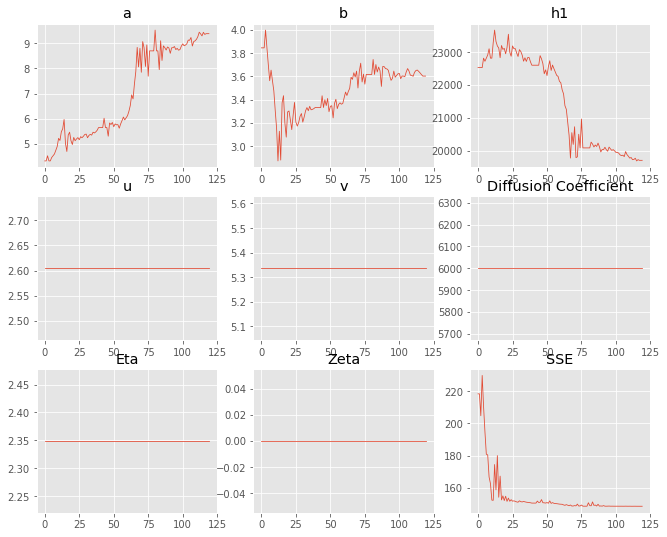

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,4.31573,9.38454
b,3.84413,3.60152
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"22,523.7","19,707.2"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 18 Time: 0.065 minutes


Estimated remaining run time: 0.060 minutes


Run 18===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	1.25e+03 	1.13e+03 	0.9063 		1.0000


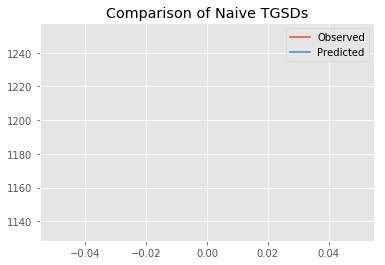

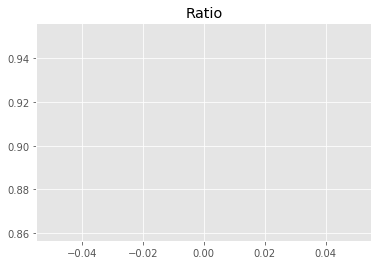

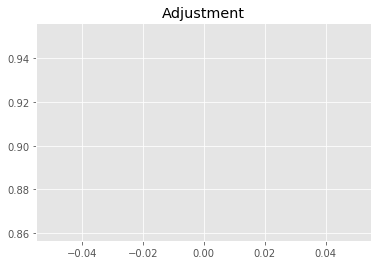

6195290476.146682
1


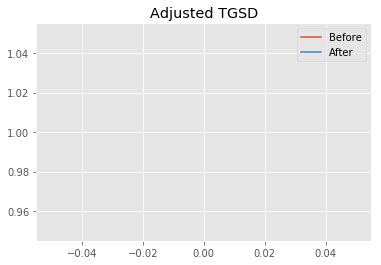

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|4.79995 	3.58313 	23611.4 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 6.83614e+09
After: 		|6.63171 	2.96554 	20512.9 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 159.093
New Misfit: 148.815
Convergence:
0.06460122916671436

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	1.20e+03 	1.13e+03 	0.9428 		1.0000


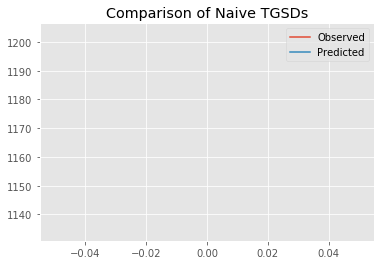

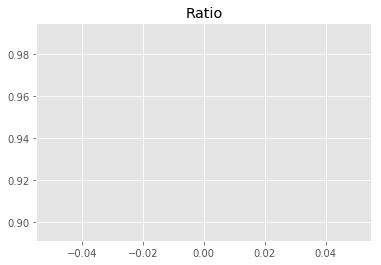

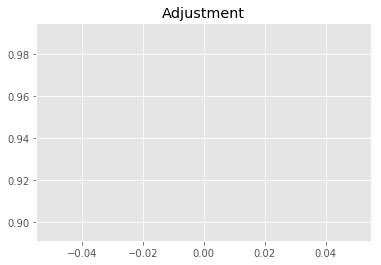

6445289212.501245
1


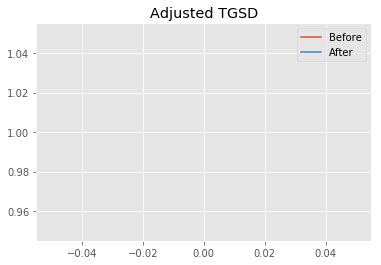

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|6.63171 	2.96554 	20512.9 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 6.83614e+09
After: 		|7.73036 	3.02875 	19854.1 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 148.815
New Misfit: 148.365
Convergence:
0.0030251776053821637

____________________
a = 7.73036	b = 3.02875	            h1 = 19854.10377	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 6836143986.19342
Success: True
Status: Successful convergence.
Iterations: 2
Misfit: 148.3650348824192
Prior Misfit: 159.093,	 Post Misfit: 148.365


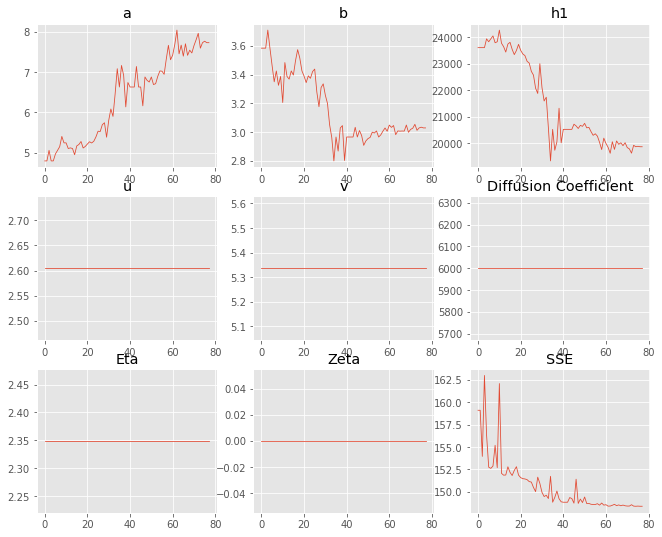

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,4.79995,7.73036
b,3.58313,3.02875
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"23,611.4","19,854.1"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 19 Time: 0.046 minutes


Estimated remaining run time: 0.000 minutes


Run 19===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	9.29e+02 	1.13e+03 	1.2215 		1.0000


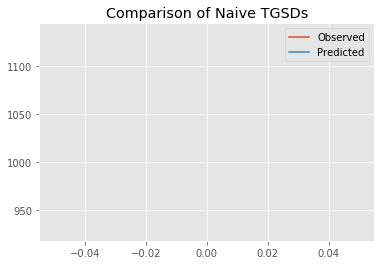

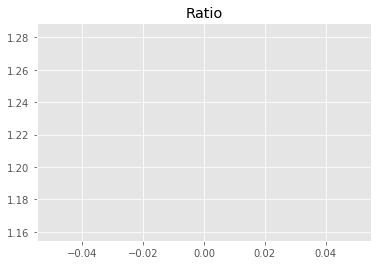

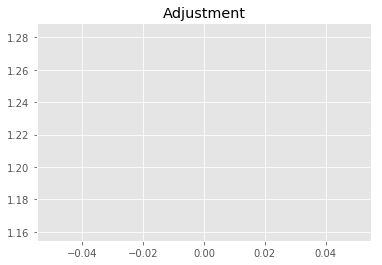

8350628234.975589
1


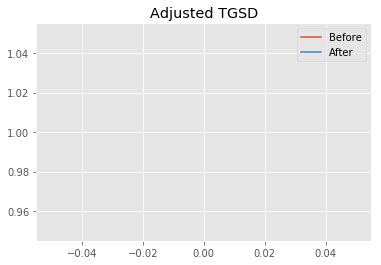

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.42799 	2.60807 	35328 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 6.83614e+09
After: 		|2.70777 	2.64562 	29203.3 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 253.369
New Misfit: 183.231
Convergence:
0.2768227690576652

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	1.11e+03 	1.13e+03 	1.0262 		1.0000


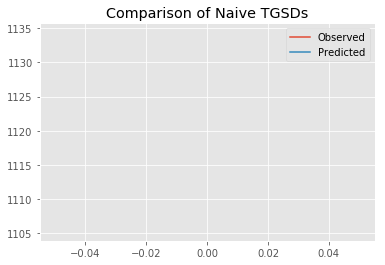

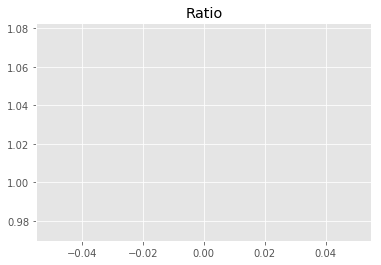

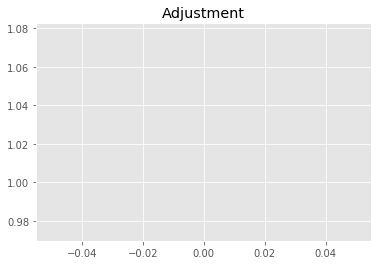

7014956658.860781
1


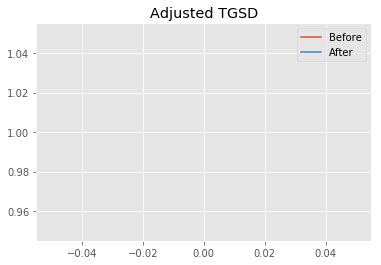

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.70777 	2.64562 	29203.3 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 6.83614e+09
After: 		|6.34909 	3.41761 	21703.3 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 183.231
New Misfit: 149.391
Convergence:
0.18468422295391268

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	1.20e+03 	1.13e+03 	0.9461 		1.0000


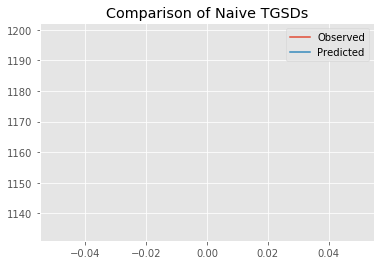

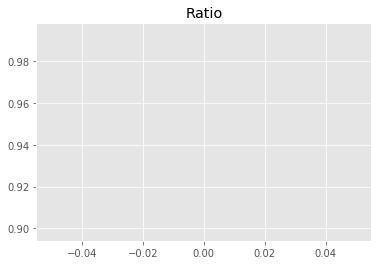

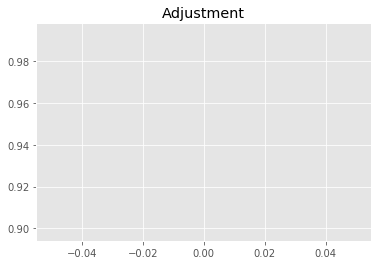

6467531462.113668
1


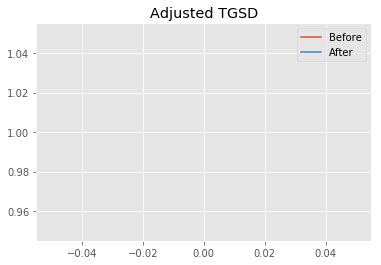

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|6.34909 	3.41761 	21703.3 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 6.83614e+09
After: 		|8.53426 	3.45623 	19955 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 149.391
New Misfit: 148.352
Convergence:
0.006956751762294188

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	6.84e+09 	1.20e+03 	1.13e+03 	0.9457 		1.0000


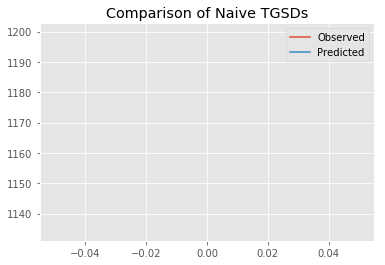

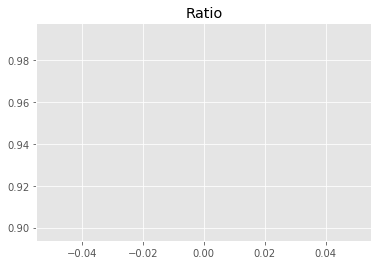

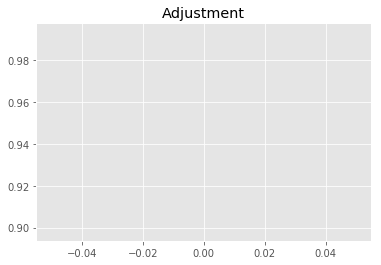

6464635557.991829
1


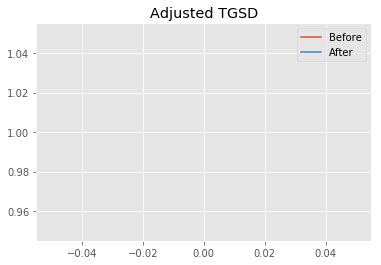

Old Total Mass: 6.83614e+09
New Total Mass: 6.83614e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|8.53426 	3.45623 	19955 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 6.83614e+09
After: 		|8.76883 	3.37302 	19747.8 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 148.352
New Misfit: 148.302
Convergence:
0.00033539810245560497

____________________
a = 8.76883	b = 3.37302	            h1 = 19747.76470	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 6836143986.19342
Success: True
Status: Successful convergence.
Iterations: 4
Misfit: 148.3019792484094
Prior Misfit: 253.369,	 Post Misfit: 148.302


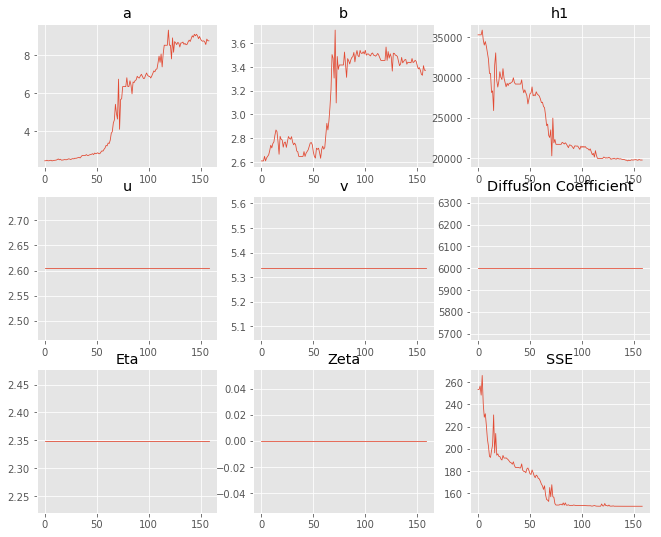

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,2.42799,8.76883
b,2.60807,3.37302
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"35,328","19,747.8"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 20 Time: 0.082 minutes


Estimated remaining run time: -0.061 minutes


Total Run Time: 1.27396 minutes


[{'a': 9.399864883958458,
  'b': 3.596656490901084,
  'h1': 19643.0100508164,
  'u': 2.60482,
  'v': 5.33615,
  'D': 5999.899999999996,
  'ftt': 6457.999999999996,
  'eta': 2.34894,
  'zeta': 0.0},
 {'a': 3.9838587352529222,
  'b': 1.4306654775391874,
  'h1': 19817.918411690905,
  'u': 2.60482,
  'v': 5.33615,
  'D': 5999.899999999996,
  'ftt': 6457.999999999996,
  'eta': 2.34894,
  'zeta': 0.0},
 {'a': 7.89436079983523,
  'b': 1.923865529678092,
  'h1': 17962.422327874767,
  'u': 2.60482,
  'v': 5.33615,
  'D': 5999.899999999996,
  'ftt': 6457.999999999996,
  'eta': 2.34894,
  'zeta': 0.0},
 {'a': 6.223426225025972,
  'b': 1.895114367311598,
  'h1': 18797.696517049048,
  'u': 2.60482,
  'v': 5.33615,
  'D': 5999.899999999996,
  'ftt': 6457.999999999996,
  'eta': 2.34894,
  'zeta': 0.0},
 {'a': 8.896948466701456,
  'b': 3.050079581246785,
  'h1': 19169.126859772656,
  'u': 2.60482,
  'v': 5.33615,
  'D': 5999.899999999996,
  'ftt': 6457.999999999996,
  'eta': 2.34894,
  'zeta': 0.0},
 

,a,b,h1,u,v,D,ftt,eta,zeta,M,Misfit
2,7.89436,1.92387,"17,962.4",2.60482,5.33615,"5,999.9","6,458",2.34894,0,6.83614e+09,148.172
10,7.02679,1.01486,"16,692.7",2.60482,5.33615,"5,999.9","6,458",2.34894,0,6.83614e+09,148.175
16,6.96781,2.13679,"18,773.2",2.60482,5.33615,"5,999.9","6,458",2.34894,0,6.83614e+09,148.196
14,6.67614,2.05299,"18,786.6",2.60482,5.33615,"5,999.9","6,458",2.34894,0,6.83614e+09,148.201
15,7.21065,2.22009,"18,788.3",2.60482,5.33615,"5,999.9","6,458",2.34894,0,6.83614e+09,148.202
8,7.39069,2.29629,"18,801.7",2.60482,5.33615,"5,999.9","6,458",2.34894,0,6.83614e+09,148.207
3,6.22343,1.89511,"18,797.7",2.60482,5.33615,"5,999.9","6,458",2.34894,0,6.83614e+09,148.216
7,5.70286,1.72781,"18,785.8",2.60482,5.33615,"5,999.9","6,458",2.34894,0,6.83614e+09,148.261
4,8.89695,3.05008,"19,169.1",2.60482,5.33615,"5,999.9","6,458",2.34894,0,6.83614e+09,148.281
6,7.23099,2.60728,"19,546.9",2.60482,5.33615,"5,999.9","6,458",2.34894,0,6.83614e+09,148.282


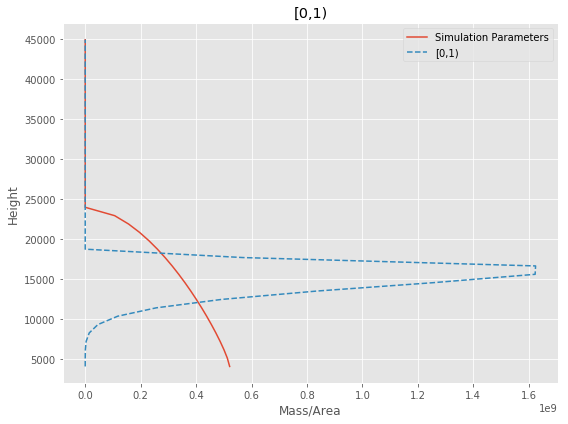

[0,1) Run Time: 1.27682 minutes


Mass Test: 52635102777.88889
========[1,2)========
Run 0===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.70e+02 	2.64e+02 	0.9765 		1.0000


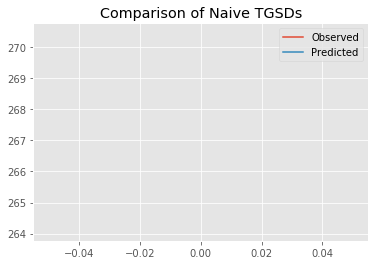

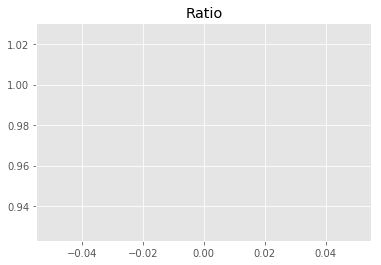

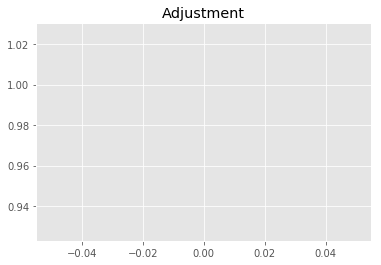

1554276708.50508
1


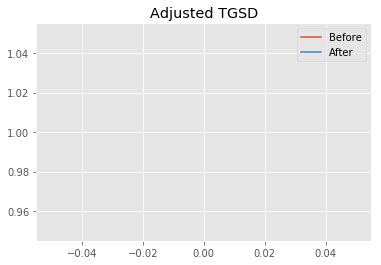

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.5039 	1.26365 	14468.3 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.59164e+09
After: 		|3.16075 	1.66883 	12328 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 65.4901
New Misfit: 54.7946
Convergence:
0.16331424846670464

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.90e+02 	2.64e+02 	0.9092 		1.0000


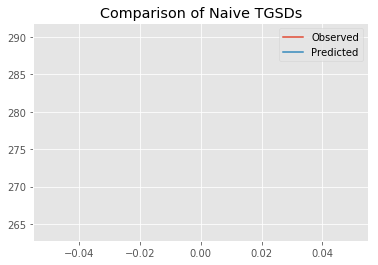

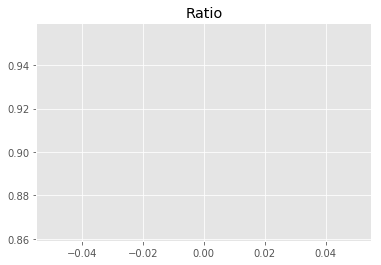

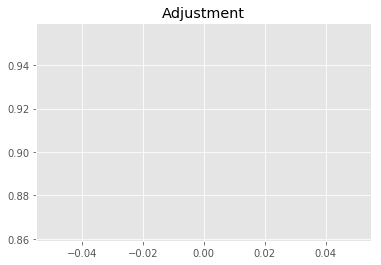

1447051233.0827084
1


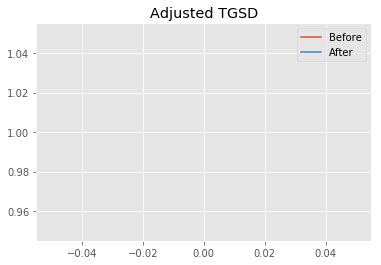

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.16075 	1.66883 	12328 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.59164e+09
After: 		|3.55741 	1.6887 	12446.3 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 54.7946
New Misfit: 53.4277
Convergence:
0.02494547965898917

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.77e+02 	2.64e+02 	0.9518 		1.0000


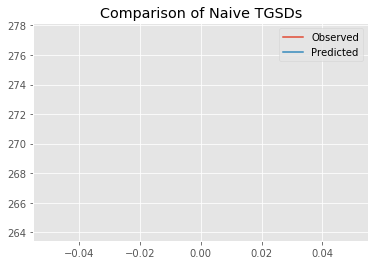

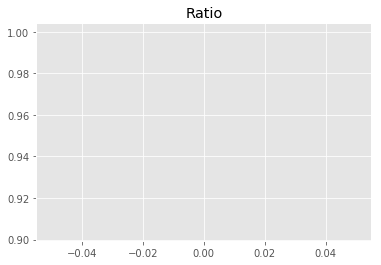

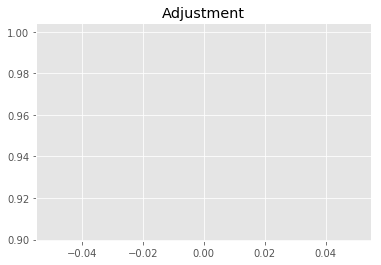

1514851360.3095524
1


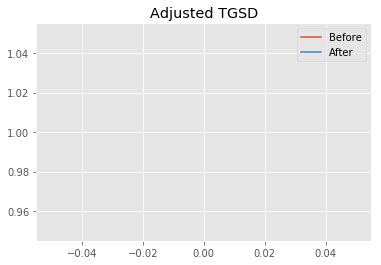

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.55741 	1.6887 	12446.3 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.59164e+09
After: 		|3.51607 	1.61529 	12402.3 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 53.4277
New Misfit: 53.3907
Convergence:
0.000693697365900307

____________________
a = 3.51607	b = 1.61529	            h1 = 12402.26633	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 1591642903.26821
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 53.3906538326101
Prior Misfit: 65.4901,	 Post Misfit: 53.3907


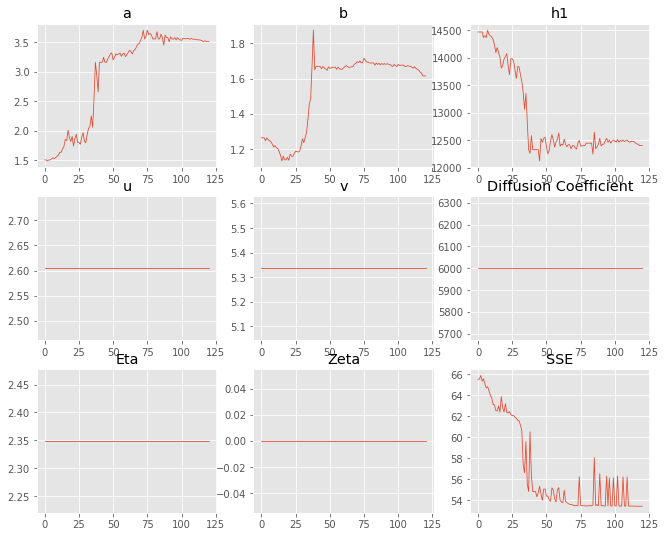

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,1.5039,3.51607
b,1.26365,1.61529
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"14,468.3","12,402.3"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 1 Time: 0.066 minutes


Estimated remaining run time: 0.595 minutes


Run 1===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	3.99e+02 	2.64e+02 	0.6623 		1.0000


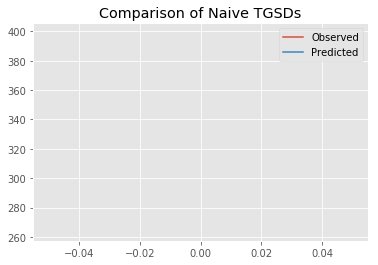

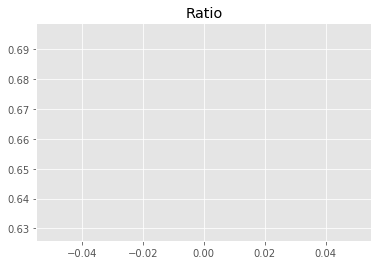

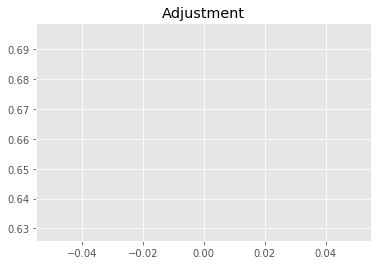

1054097802.9041135
1


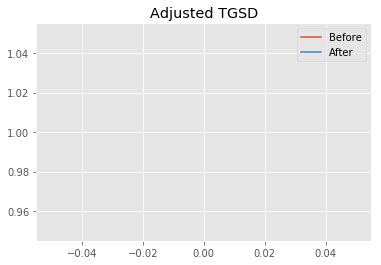

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.1134 	3.97438 	13305.1 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.59164e+09
After: 		|1.00858 	1.03907 	11492.7 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 211.574
New Misfit: 92.3288
Convergence:
0.5636098347734079

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	3.38e+02 	2.64e+02 	0.7816 		1.0000


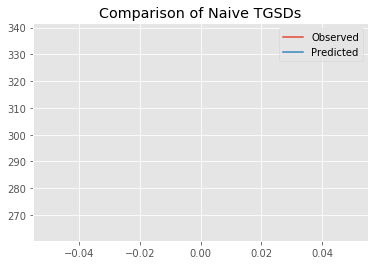

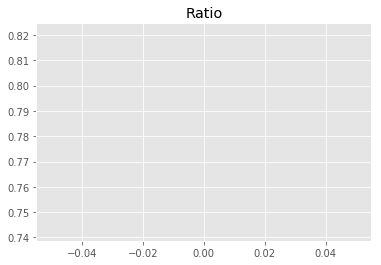

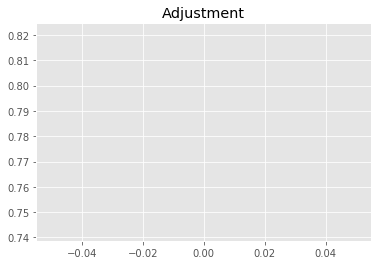

1244086545.7785177
1


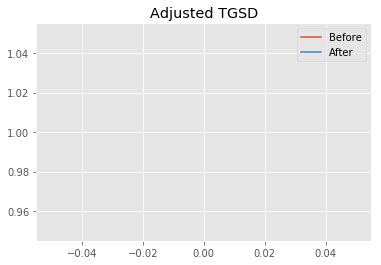

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.00858 	1.03907 	11492.7 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.59164e+09
After: 		|1.51639 	1.00501 	14237.4 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 92.3288
New Misfit: 64.2076
Convergence:
0.30457614753114726

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.50e+02 	2.64e+02 	1.0557 		1.0000


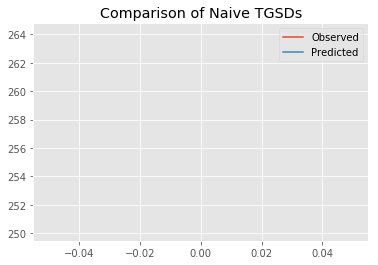

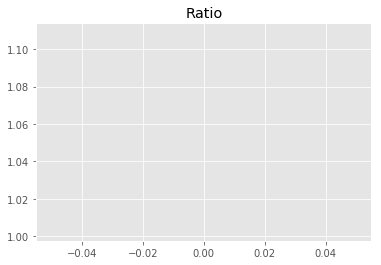

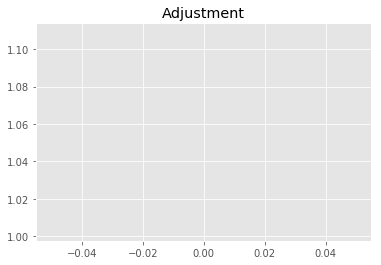

1680246527.7018309
1


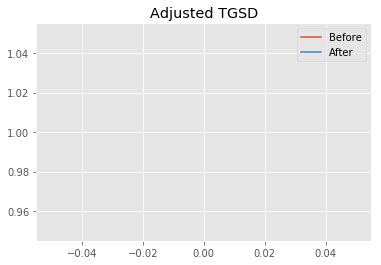

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.51639 	1.00501 	14237.4 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.59164e+09
After: 		|1.67576 	1.00576 	13287.9 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 64.2076
New Misfit: 59.4239
Convergence:
0.07450401845195993

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.72e+02 	2.64e+02 	0.9709 		1.0000


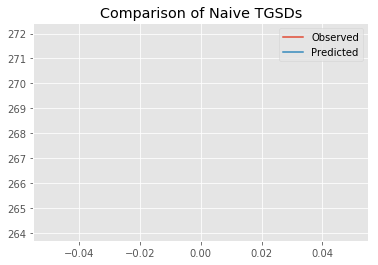

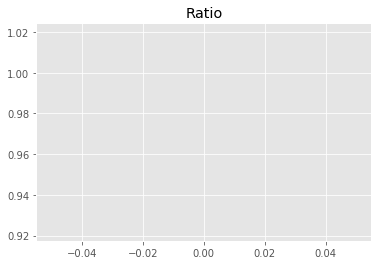

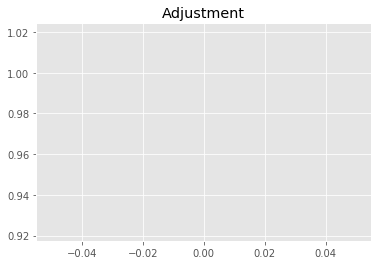

1545276159.136399
1


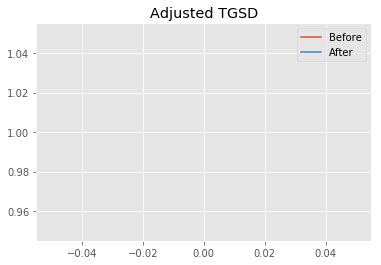

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.67576 	1.00576 	13287.9 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.59164e+09
After: 		|1.99853 	1.00019 	12570.5 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 59.4239
New Misfit: 57.1598
Convergence:
0.03810119232278462

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.56e+02 	2.64e+02 	1.0319 		1.0000


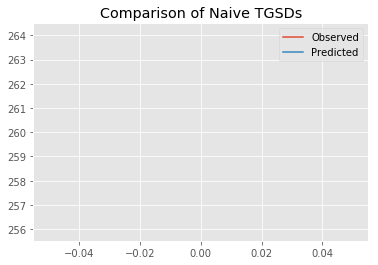

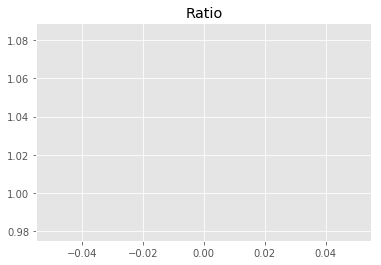

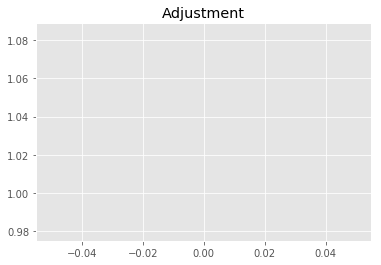

1642393964.4422863
1


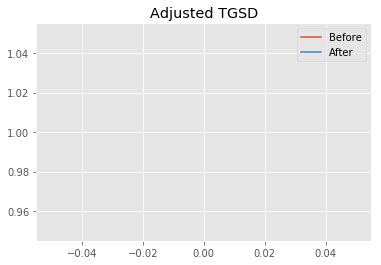

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.99853 	1.00019 	12570.5 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.59164e+09
After: 		|1.99814 	1.06456 	12836.7 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 57.1598
New Misfit: 56.9739
Convergence:
0.003252260011262927

____________________
a = 1.99814	b = 1.06456	            h1 = 12836.66079	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 1591642903.26821
Success: True
Status: Successful convergence.
Iterations: 5
Misfit: 56.97388828809318
Prior Misfit: 211.574,	 Post Misfit: 56.9739


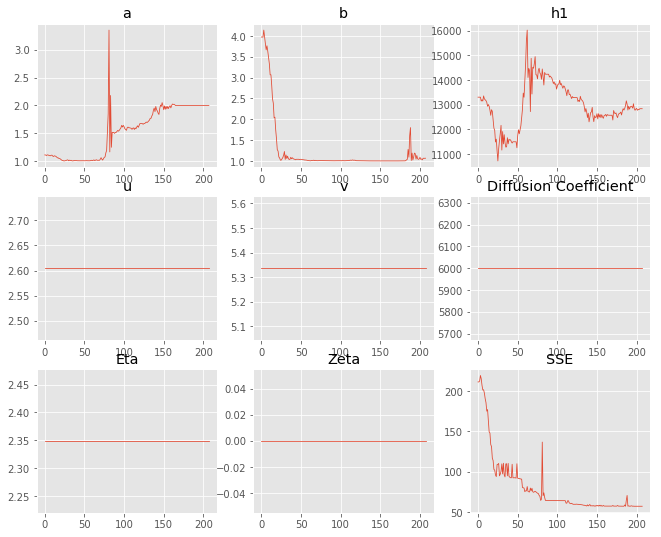

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,1.1134,1.99814
b,3.97438,1.06456
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"13,305.1","12,836.7"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 2 Time: 0.105 minutes


Estimated remaining run time: 0.968 minutes


Run 2===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	1.75e+02 	2.64e+02 	1.5122 		1.0000


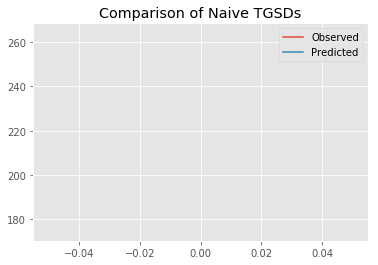

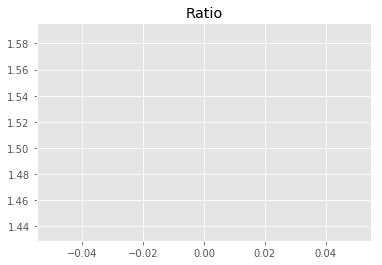

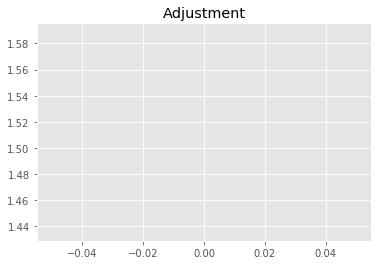

2406804714.4530334
1


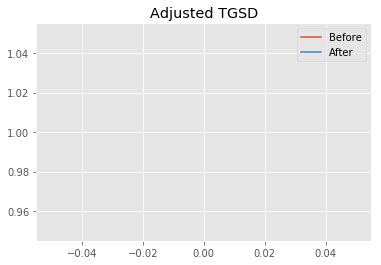

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|4.36577 	3.78948 	18456.6 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.59164e+09
After: 		|3.14476 	4.4941 	18644.3 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 125.015
New Misfit: 59.8382
Convergence:
0.5213501228996233

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.62e+02 	2.64e+02 	1.0065 		1.0000


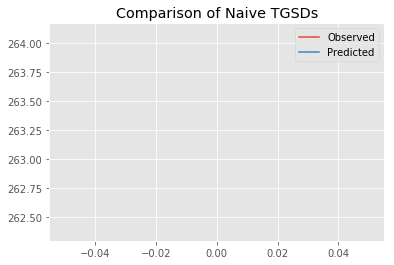

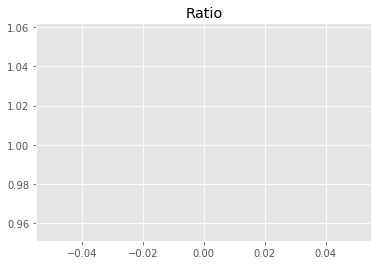

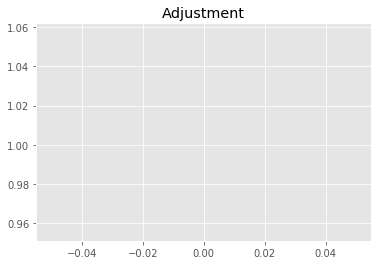

1602011317.2438443
1


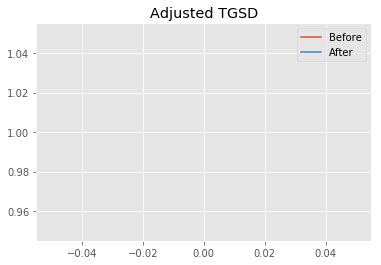

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.14476 	4.4941 	18644.3 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.59164e+09
After: 		|5.96317 	6.31125 	15539 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 59.8382
New Misfit: 54.919
Convergence:
0.08220959481846916

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.81e+02 	2.64e+02 	0.9414 		1.0000


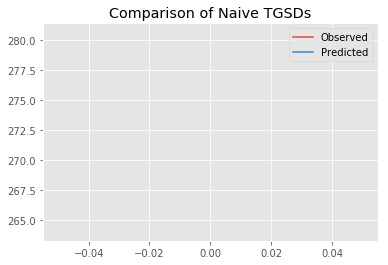

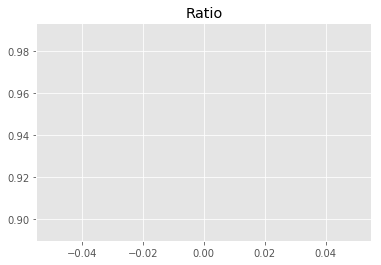

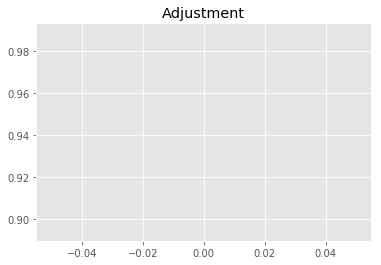

1498304419.9015803
1


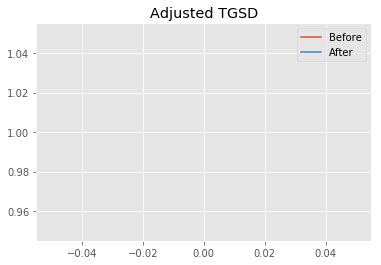

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|5.96317 	6.31125 	15539 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.59164e+09
After: 		|6.00295 	6.24999 	15498.3 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 54.919
New Misfit: 54.8881
Convergence:
0.0005611952998545504

____________________
a = 6.00295	b = 6.24999	            h1 = 15498.32456	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 1591642903.26821
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 54.8881493071463
Prior Misfit: 125.015,	 Post Misfit: 54.8881


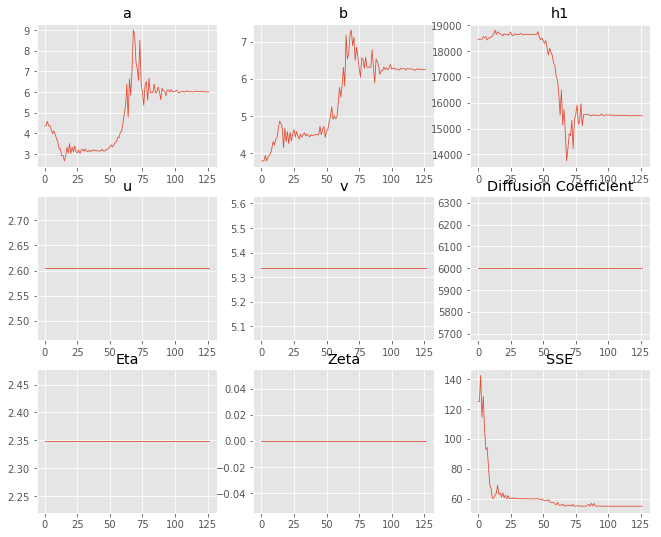

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,4.36577,6.00295
b,3.78948,6.24999
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"18,456.6","15,498.3"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 3 Time: 0.068 minutes


Estimated remaining run time: 0.956 minutes


Run 3===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.78e+02 	2.64e+02 	0.9487 		1.0000


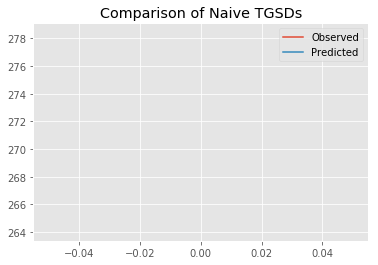

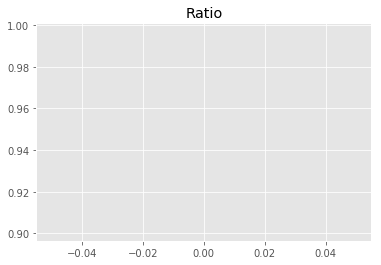

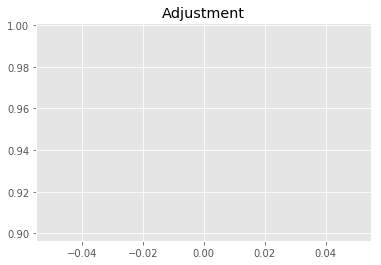

1509935593.5667372
1


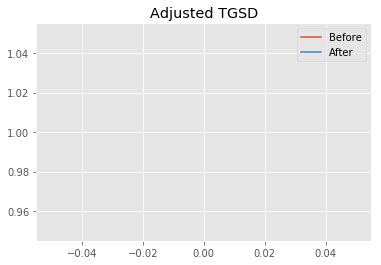

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.24851 	3.27285 	17746.4 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.59164e+09
After: 		|3.22952 	2.9716 	14769.1 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 66.3223
New Misfit: 56.7574
Convergence:
0.14421919544576528

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.76e+02 	2.64e+02 	0.9586 		1.0000


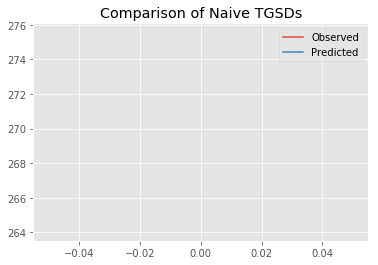

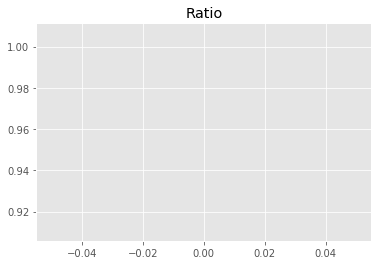

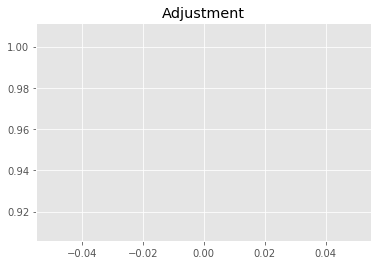

1525682407.6326172
1


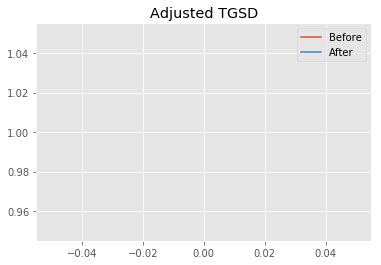

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.22952 	2.9716 	14769.1 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.59164e+09
After: 		|4.42122 	2.74415 	12950.3 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 56.7574
New Misfit: 54.2018
Convergence:
0.04502604438082706

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.76e+02 	2.64e+02 	0.9569 		1.0000


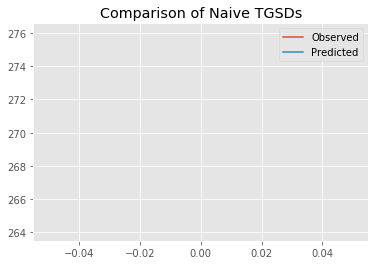

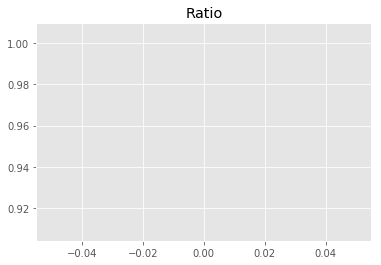

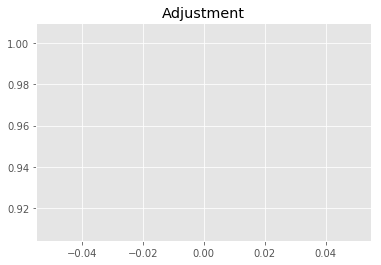

1523018017.6705642
1


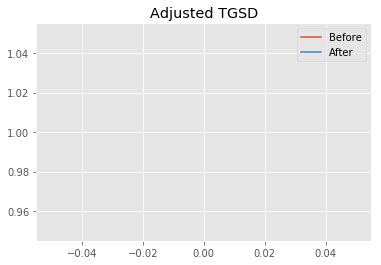

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|4.42122 	2.74415 	12950.3 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.59164e+09
After: 		|4.12708 	2.3099 	12500.2 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 54.2018
New Misfit: 54.0456
Convergence:
0.002882873570735782

____________________
a = 4.12708	b = 2.30990	            h1 = 12500.15156	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 1591642903.26821
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 54.045563191694114
Prior Misfit: 66.3223,	 Post Misfit: 54.0456


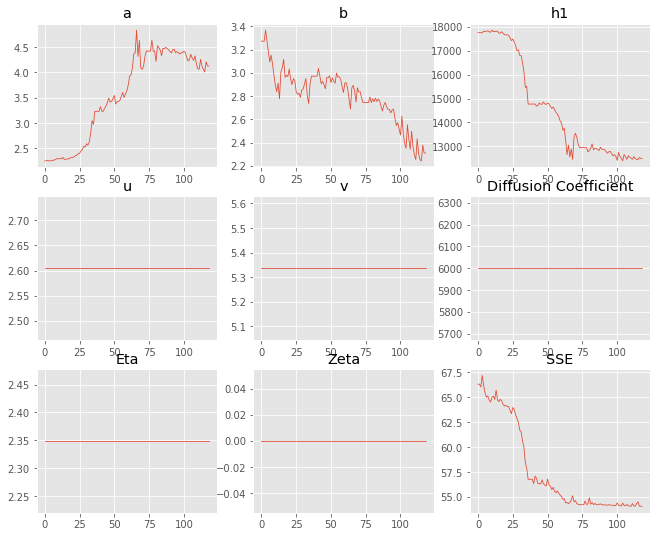

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,2.24851,4.12708
b,3.27285,2.3099
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"17,746.4","12,500.2"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 4 Time: 0.065 minutes


Estimated remaining run time: 0.913 minutes


Run 4===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	3.17e+02 	2.64e+02 	0.8334 		1.0000


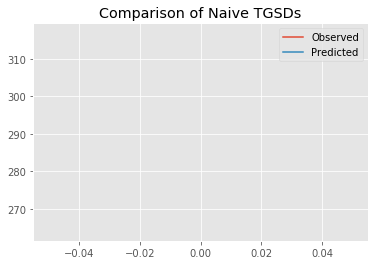

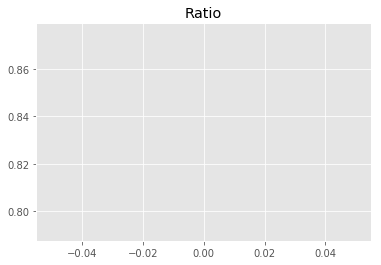

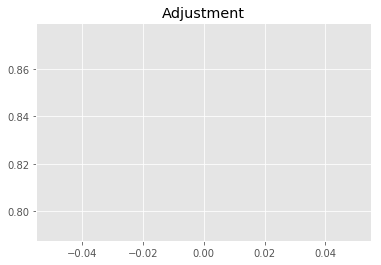

1326519278.7600327
1


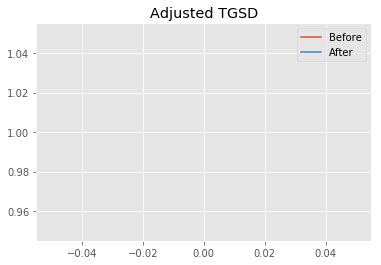

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.8163 	4.85627 	15343 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.59164e+09
After: 		|4.50698 	4.53487 	15384.6 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 65.4188
New Misfit: 55.1807
Convergence:
0.1565011206047399

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.75e+02 	2.64e+02 	0.9589 		1.0000


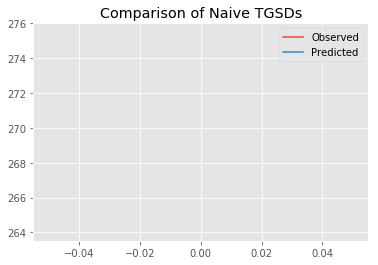

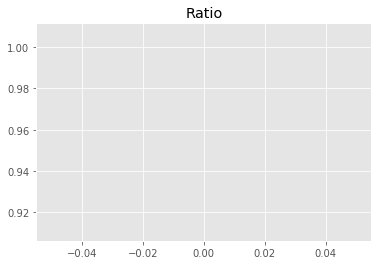

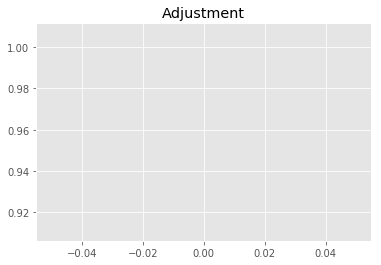

1526158858.7493658
1


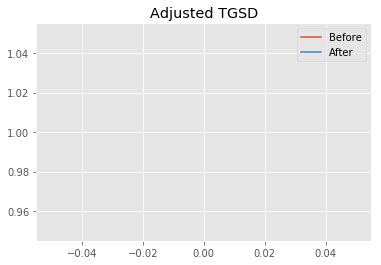

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|4.50698 	4.53487 	15384.6 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.59164e+09
After: 		|5.7655 	5.73581 	15292.8 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 55.1807
New Misfit: 54.8664
Convergence:
0.00569522705627825

____________________
a = 5.76550	b = 5.73581	            h1 = 15292.77045	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 1591642903.26821
Success: True
Status: Successful convergence.
Iterations: 2
Misfit: 54.866414194891554
Prior Misfit: 65.4188,	 Post Misfit: 54.8664


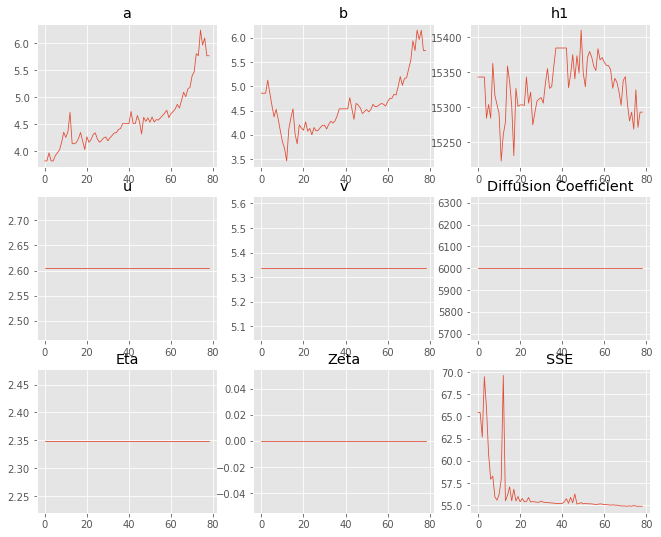

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,3.8163,5.7655
b,4.85627,5.73581
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"15,343","15,292.8"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 5 Time: 0.046 minutes


Estimated remaining run time: 0.818 minutes


Run 5===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	3.85e+02 	2.64e+02 	0.6857 		1.0000


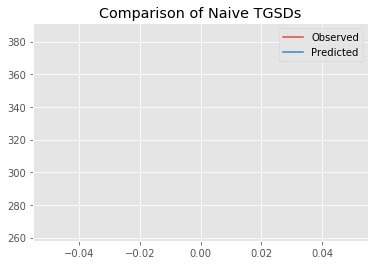

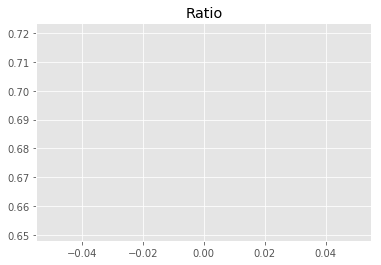

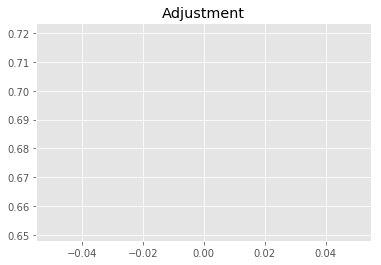

1091339501.151729
1


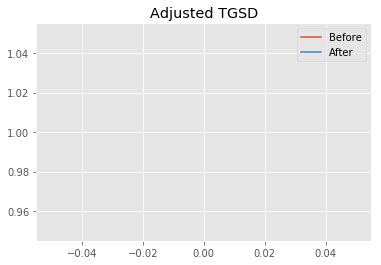

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.50494 	4.77892 	15880.8 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.59164e+09
After: 		|1.41049 	1.31491 	15535.3 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 159.745
New Misfit: 69.5618
Convergence:
0.5645452955439577

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.56e+02 	2.64e+02 	1.0323 		1.0000


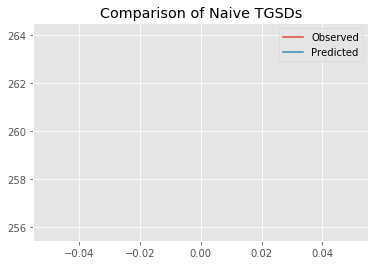

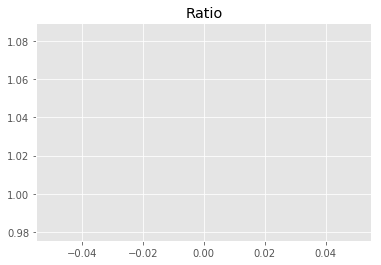

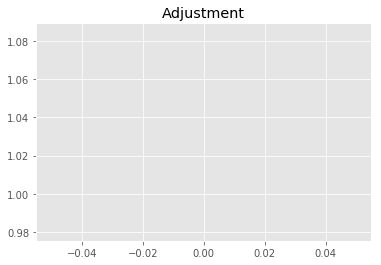

1643000388.19041
1


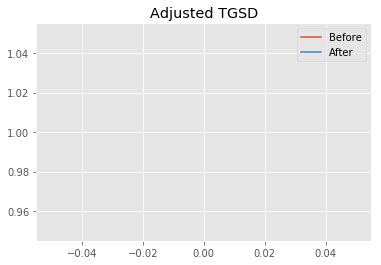

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.41049 	1.31491 	15535.3 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.59164e+09
After: 		|4.32633 	2.77101 	13157.2 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 69.5618
New Misfit: 54.2555
Convergence:
0.2200386368767656

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.74e+02 	2.64e+02 	0.9642 		1.0000


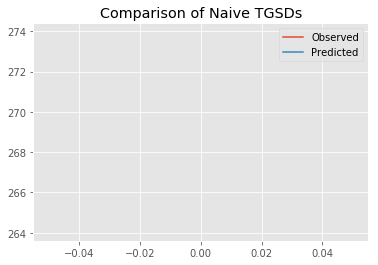

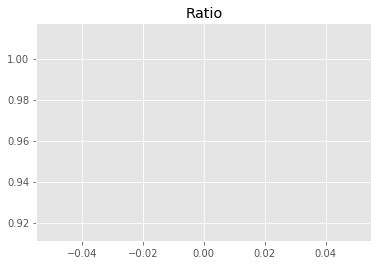

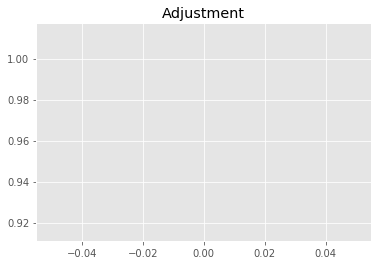

1534594912.9247727
1


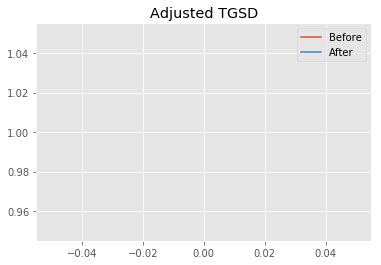

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|4.32633 	2.77101 	13157.2 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.59164e+09
After: 		|4.49133 	2.51349 	12520.7 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 54.2555
New Misfit: 54.1094
Convergence:
0.002692571569163532

____________________
a = 4.49133	b = 2.51349	            h1 = 12520.65025	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 1591642903.26821
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 54.10943994902142
Prior Misfit: 159.745,	 Post Misfit: 54.1094


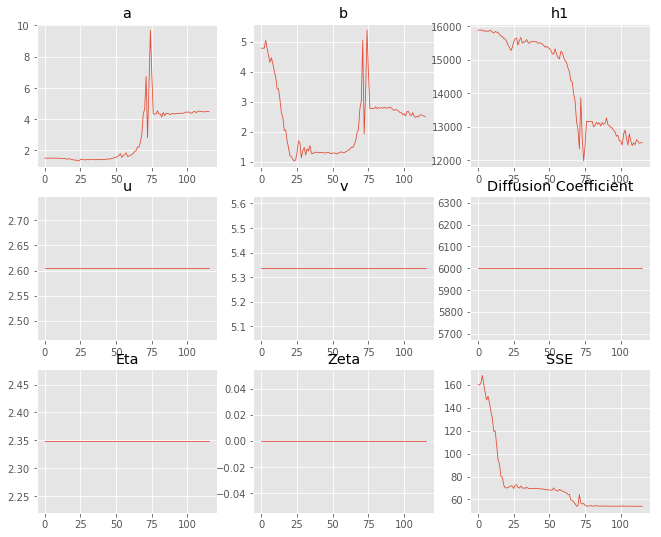

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,1.50494,4.49133
b,4.77892,2.51349
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"15,880.8","12,520.7"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 6 Time: 0.064 minutes


Estimated remaining run time: 0.770 minutes


Run 6===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.89e+02 	2.64e+02 	0.9146 		1.0000


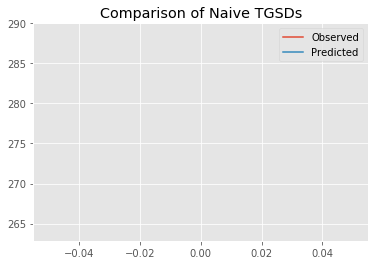

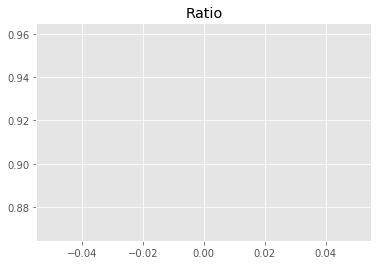

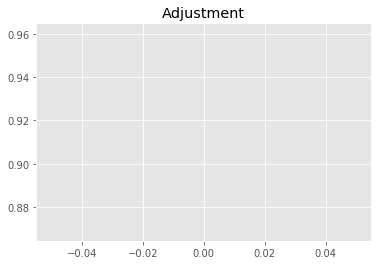

1455745487.348397
1


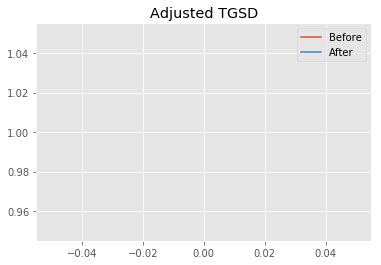

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.07621 	3.82149 	16199.3 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.59164e+09
After: 		|5.6704 	6.79873 	16378.8 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 60.6523
New Misfit: 55.1451
Convergence:
0.090800819492471

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.81e+02 	2.64e+02 	0.9383 		1.0000


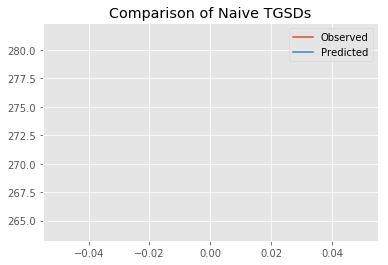

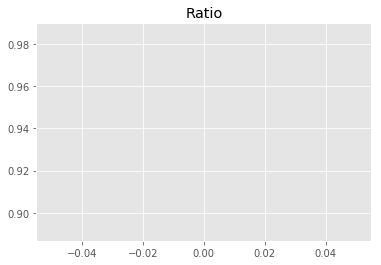

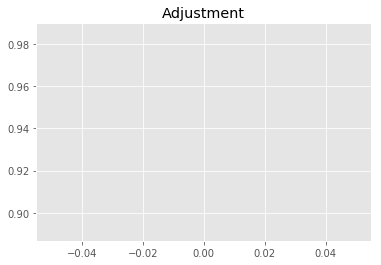

1493368387.7774403
1


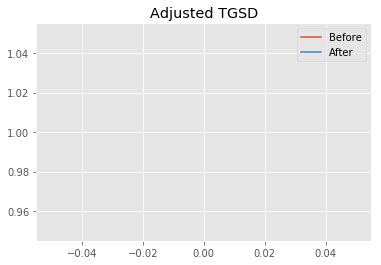

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|5.6704 	6.79873 	16378.8 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.59164e+09
After: 		|6.18155 	7.29849 	16380.4 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 55.1451
New Misfit: 55.0053
Convergence:
0.0025343585082841795

____________________
a = 6.18155	b = 7.29849	            h1 = 16380.36446	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 1591642903.26821
Success: True
Status: Successful convergence.
Iterations: 2
Misfit: 55.005302818397794
Prior Misfit: 60.6523,	 Post Misfit: 55.0053


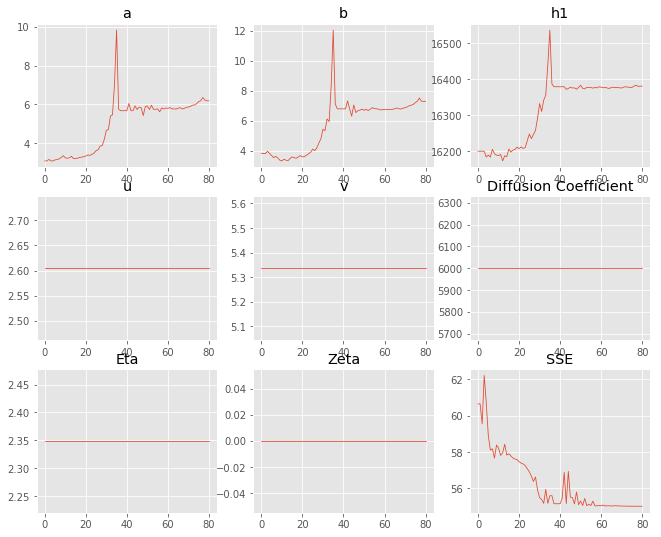

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,3.07621,6.18155
b,3.82149,7.29849
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"16,199.3","16,380.4"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 7 Time: 0.047 minutes


Estimated remaining run time: 0.693 minutes


Run 7===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	3.51e+02 	2.64e+02 	0.7520 		1.0000


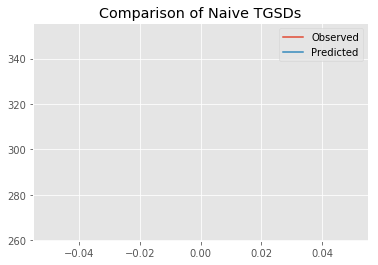

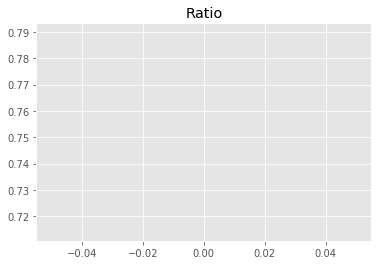

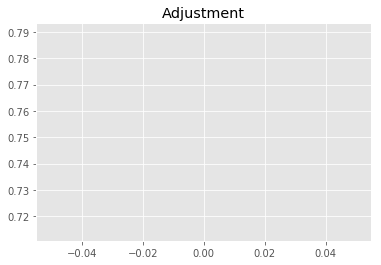

1196846876.9024367
1


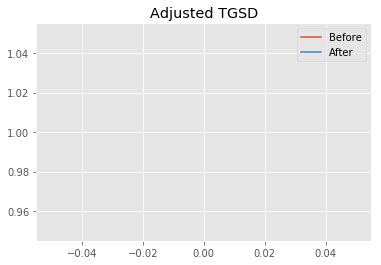

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|4.28734 	1.08371 	9633.2 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.59164e+09
After: 		|4.12741 	1.07244 	11434.9 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 70.8818
New Misfit: 53.9748
Convergence:
0.23852479286248054

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.89e+02 	2.64e+02 	0.9124 		1.0000


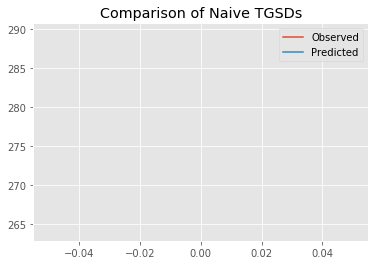

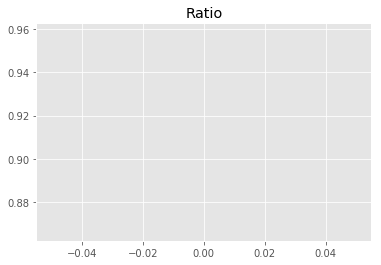

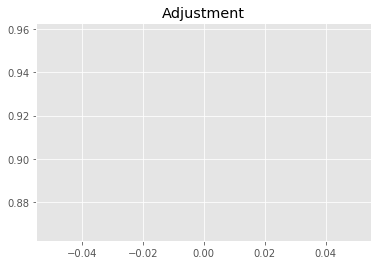

1452210004.1807332
1


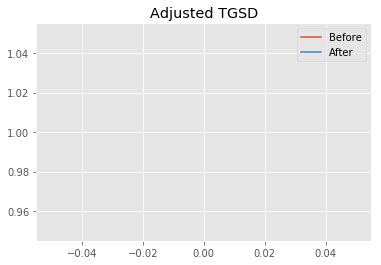

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|4.12741 	1.07244 	11434.9 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.59164e+09
After: 		|4.04825 	1.01107 	11074.8 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 53.9748
New Misfit: 53.8971
Convergence:
0.0014386876771012556

____________________
a = 4.04825	b = 1.01107	            h1 = 11074.76346	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 1591642903.26821
Success: True
Status: Successful convergence.
Iterations: 2
Misfit: 53.89710425059817
Prior Misfit: 70.8818,	 Post Misfit: 53.8971


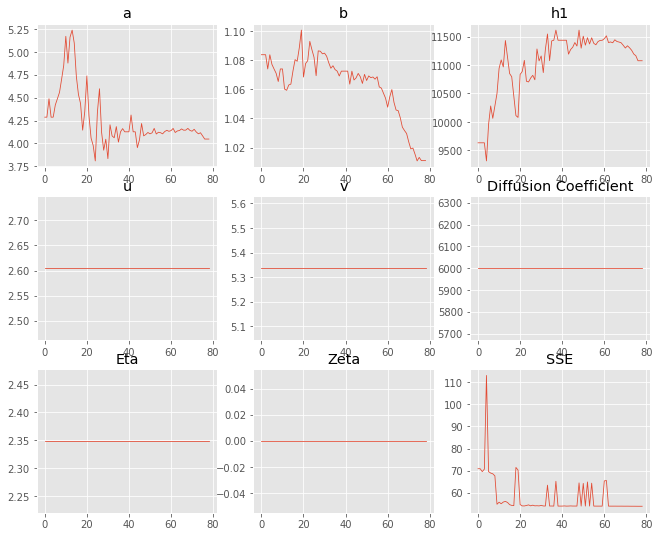

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,4.28734,4.04825
b,1.08371,1.01107
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"9,633.2","11,074.8"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 8 Time: 0.049 minutes


Estimated remaining run time: 0.624 minutes


Run 8===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	1.94e+02 	2.64e+02 	1.3645 		1.0000


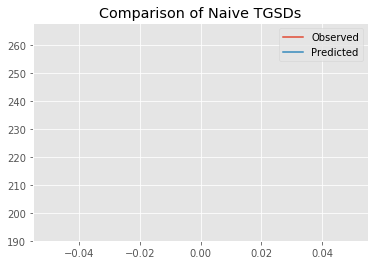

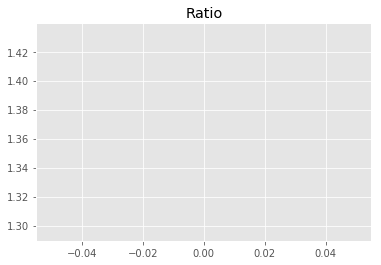

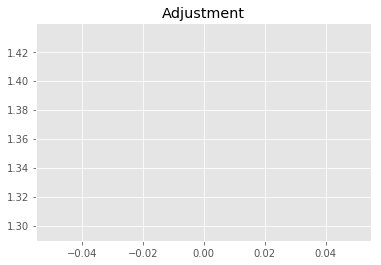

2171786942.732633
1


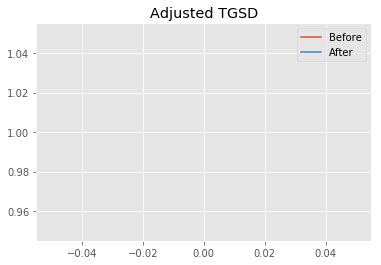

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|4.16351 	4.32317 	19057 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.59164e+09
After: 		|5.33458 	8.1156 	18550 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 96.0765
New Misfit: 55.5976
Convergence:
0.42131927432439625

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.78e+02 	2.64e+02 	0.9515 		1.0000


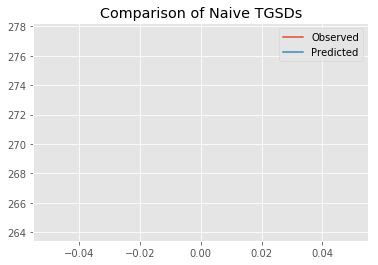

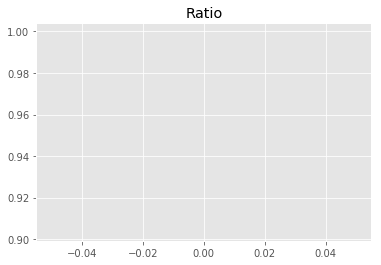

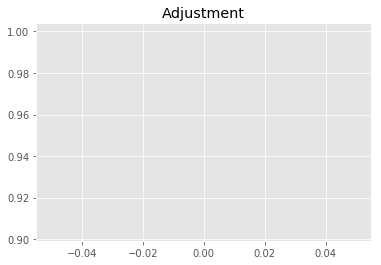

1514510052.865207
1


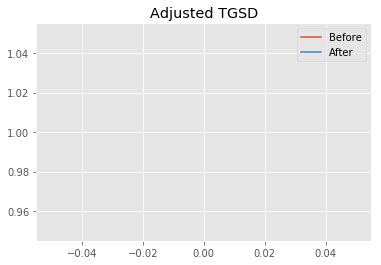

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|5.33458 	8.1156 	18550 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.59164e+09
After: 		|6.83371 	9.56738 	17756.3 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 55.5976
New Misfit: 55.1509
Convergence:
0.008035434442627639

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.78e+02 	2.64e+02 	0.9508 		1.0000


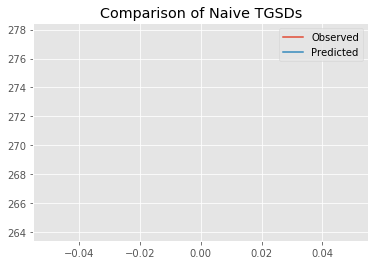

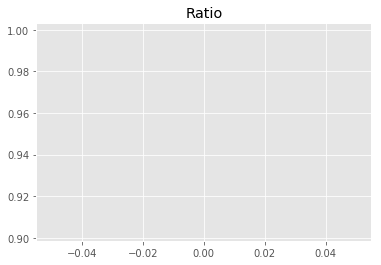

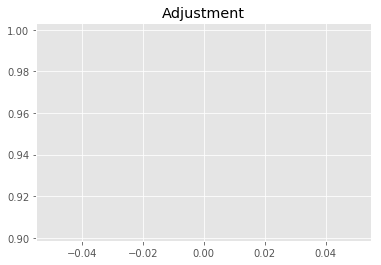

1513351704.3000774
1


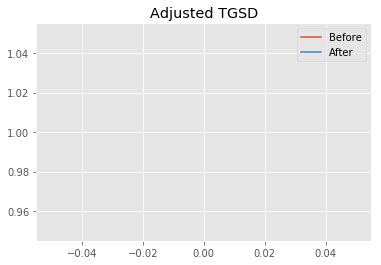

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|6.83371 	9.56738 	17756.3 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.59164e+09
After: 		|6.82772 	9.51527 	17684.7 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 55.1509
New Misfit: 55.1405
Convergence:
0.00018738240210356438

____________________
a = 6.82772	b = 9.51527	            h1 = 17684.70482	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 1591642903.26821
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 55.14053340739328
Prior Misfit: 96.0765,	 Post Misfit: 55.1405


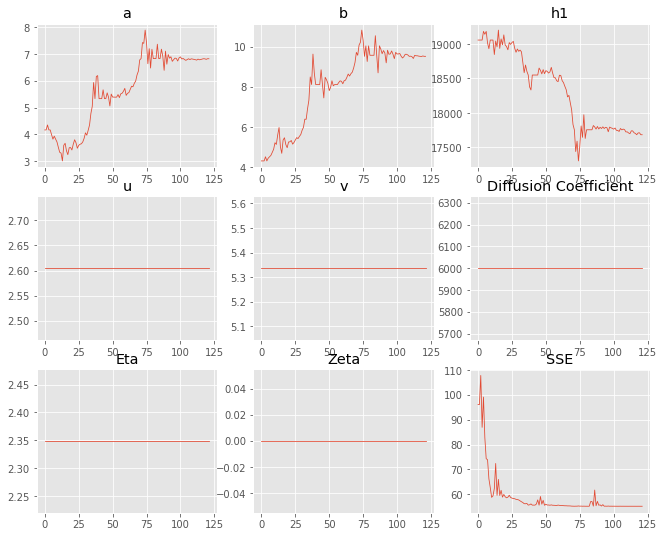

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,4.16351,6.82772
b,4.32317,9.51527
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"19,057","17,684.7"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 9 Time: 0.067 minutes


Estimated remaining run time: 0.578 minutes


Run 9===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	3.21e+02 	2.64e+02 	0.8217 		1.0000


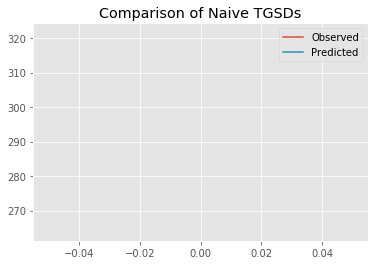

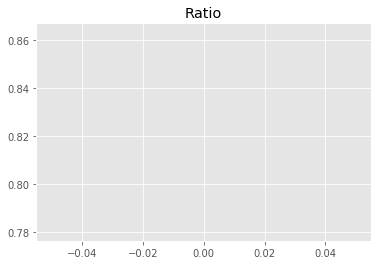

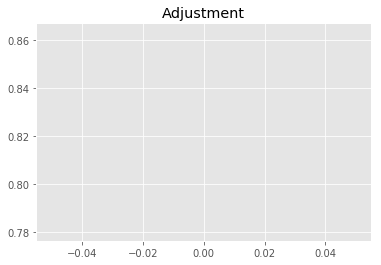

1307812531.6845882
1


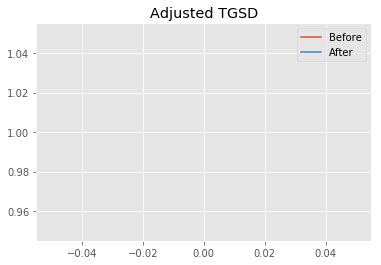

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.8236 	2.29959 	12552.2 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.59164e+09
After: 		|3.73623 	2.47511 	13436.1 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 67.4818
New Misfit: 54.3829
Convergence:
0.19411093785346253

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.72e+02 	2.64e+02 	0.9715 		1.0000


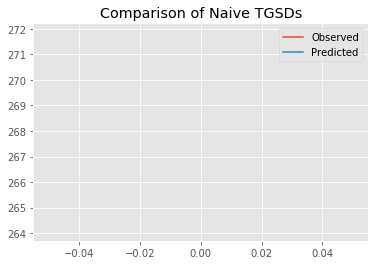

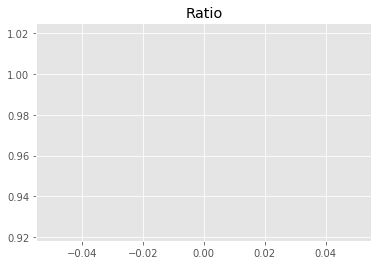

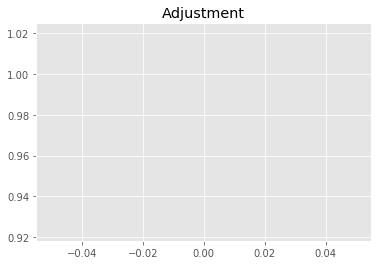

1546342659.5743742
1


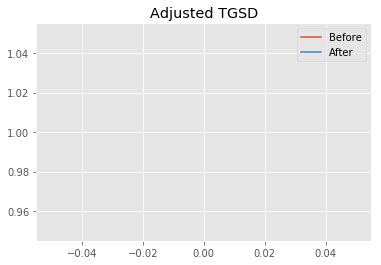

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.73623 	2.47511 	13436.1 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.59164e+09
After: 		|4.26978 	2.47564 	12644.7 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 54.3829
New Misfit: 54.1051
Convergence:
0.005108196916532523

____________________
a = 4.26978	b = 2.47564	            h1 = 12644.73186	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 1591642903.26821
Success: True
Status: Successful convergence.
Iterations: 2
Misfit: 54.105075414502565
Prior Misfit: 67.4818,	 Post Misfit: 54.1051


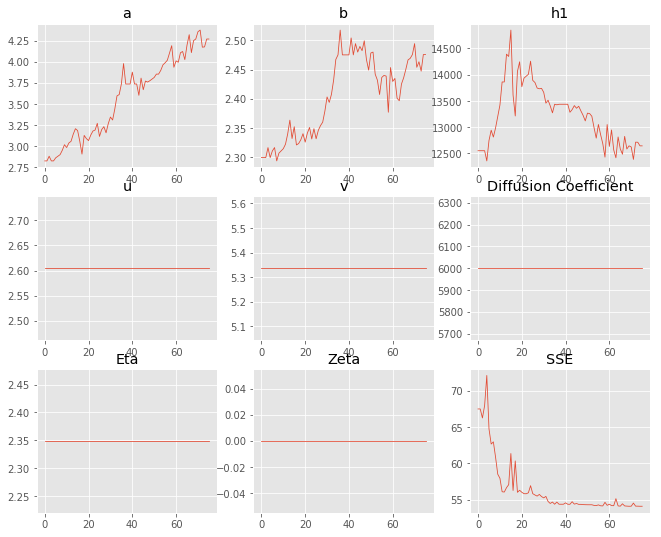

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,2.8236,4.26978
b,2.29959,2.47564
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"12,552.2","12,644.7"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 10 Time: 0.047 minutes


Estimated remaining run time: 0.511 minutes


Run 10===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	3.74e+02 	2.64e+02 	0.7059 		1.0000


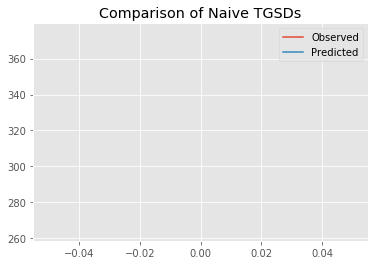

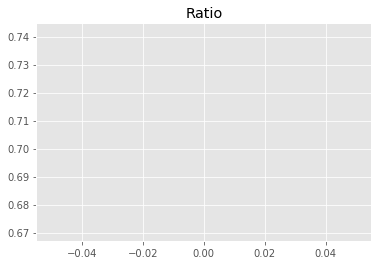

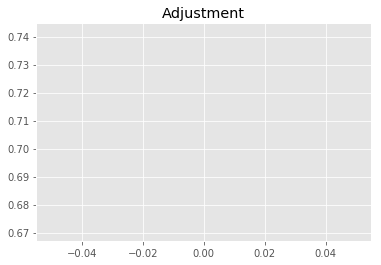

1123561929.6742673
1


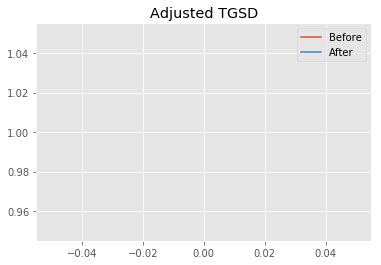

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.15819 	4.32973 	17270 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.59164e+09
After: 		|1.12658 	1.738 	17814.4 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 155.504
New Misfit: 83.4916
Convergence:
0.46309046618650423

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.66e+02 	2.64e+02 	0.9934 		1.0000


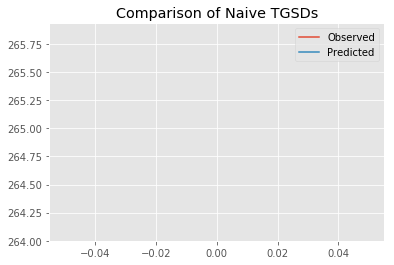

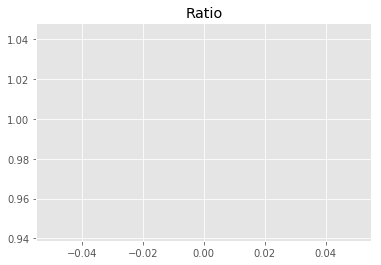

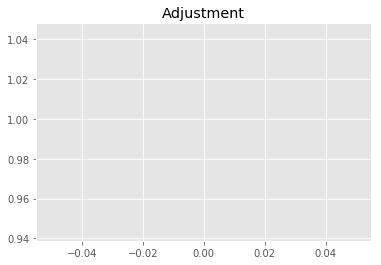

1581119376.709743
1


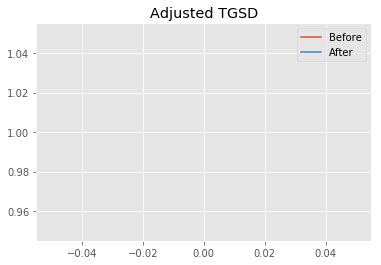

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.12658 	1.738 	17814.4 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.59164e+09
After: 		|1.47509 	1.7002 	17404.1 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 83.4916
New Misfit: 75.4875
Convergence:
0.09586676181662185

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.43e+02 	2.64e+02 	1.0865 		1.0000


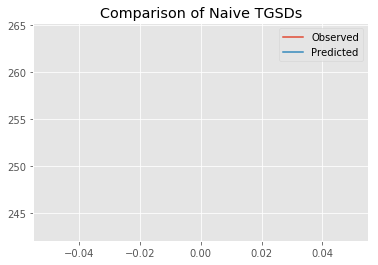

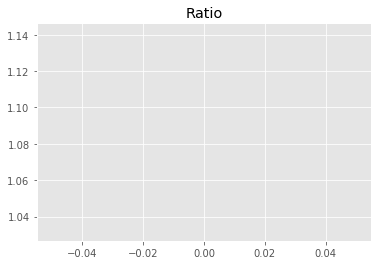

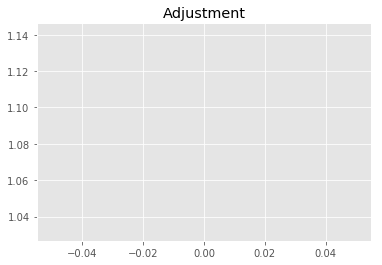

1729286710.0579197
1


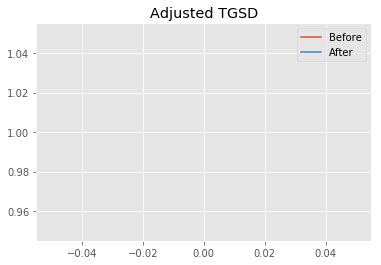

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.47509 	1.7002 	17404.1 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.59164e+09
After: 		|2.32271 	2.35663 	16366.5 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 75.4875
New Misfit: 63.2417
Convergence:
0.1622232781970266

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.50e+02 	2.64e+02 	1.0576 		1.0000


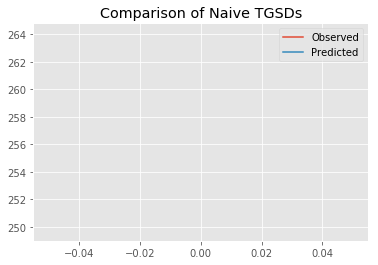

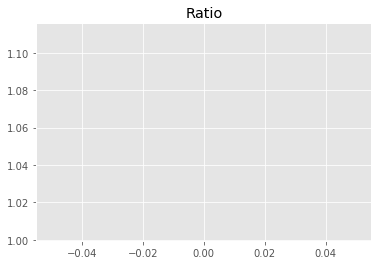

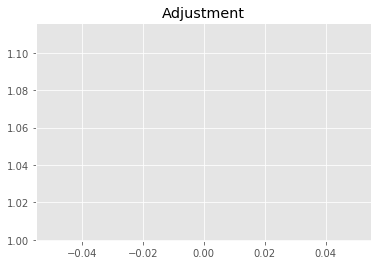

1683363320.6131833
1


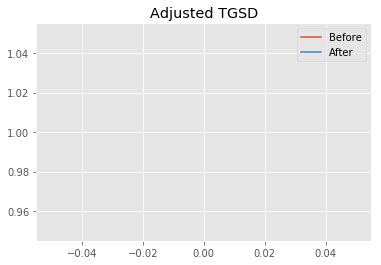

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.32271 	2.35663 	16366.5 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.59164e+09
After: 		|3.77373 	4.59606 	16531.4 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 63.2417
New Misfit: 57.0508
Convergence:
0.09789170955189808

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.79e+02 	2.64e+02 	0.9449 		1.0000


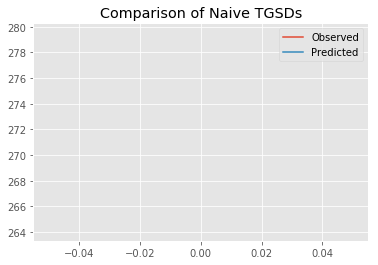

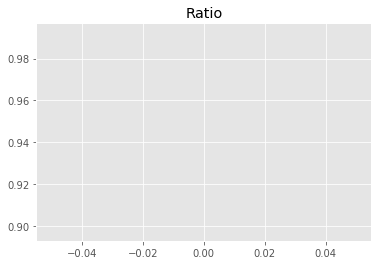

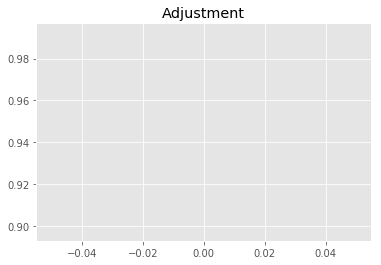

1503902897.6420722
1


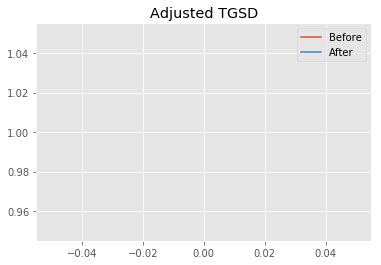

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.77373 	4.59606 	16531.4 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.59164e+09
After: 		|6.77509 	8.23533 	16529.8 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 57.0508
New Misfit: 55.0467
Convergence:
0.03512984178633078

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.80e+02 	2.64e+02 	0.9437 		1.0000


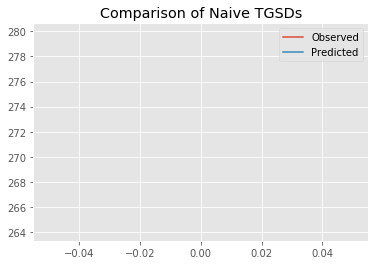

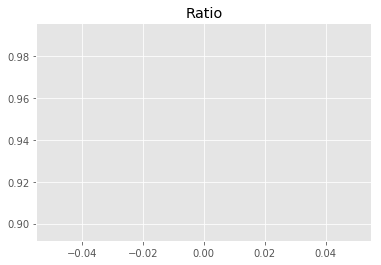

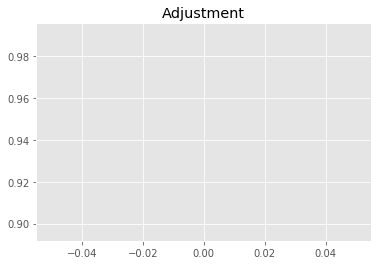

1501994991.3733935
1


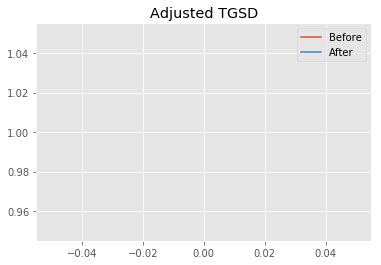

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|6.77509 	8.23533 	16529.8 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.59164e+09
After: 		|6.24385 	7.5156 	16530.8 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 55.0467
New Misfit: 55.0232
Convergence:
0.0004258551007494139

____________________
a = 6.24385	b = 7.51560	            h1 = 16530.81293	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 1591642903.26821
Success: True
Status: Successful convergence.
Iterations: 6
Misfit: 55.02321449368504
Prior Misfit: 155.504,	 Post Misfit: 55.0232


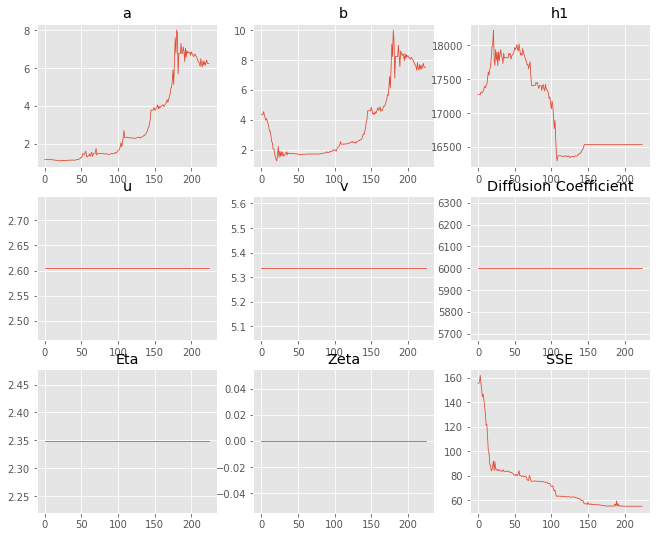

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,1.15819,6.24385
b,4.32973,7.5156
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"17,270","16,530.8"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 11 Time: 0.118 minutes


Estimated remaining run time: 0.495 minutes


Run 11===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	1.76e+02 	2.64e+02 	1.5027 		1.0000


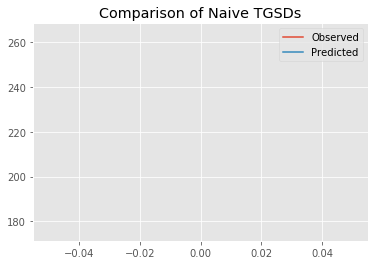

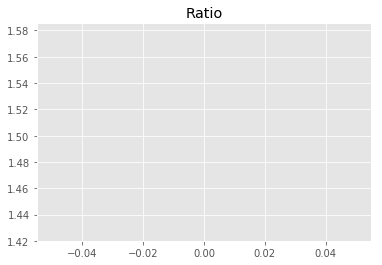

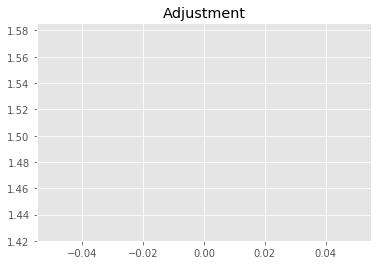

2391818915.159929
1


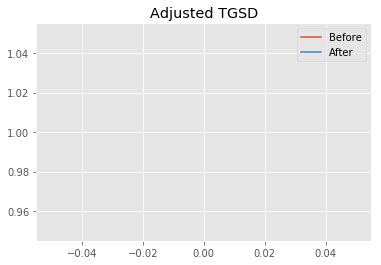

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.32782 	2.31666 	20303.9 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.59164e+09
After: 		|2.49779 	2.56474 	15548.4 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 120.39
New Misfit: 60.3103
Convergence:
0.49904215353725023

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.71e+02 	2.64e+02 	0.9727 		1.0000


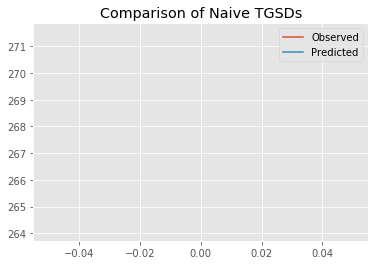

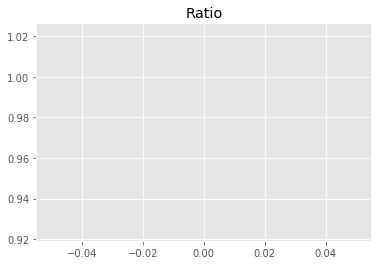

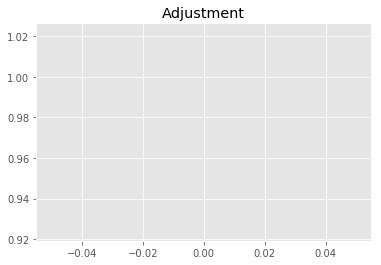

1548253971.319645
1


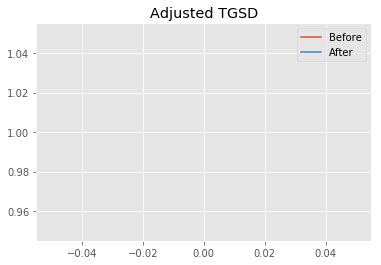

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.49779 	2.56474 	15548.4 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.59164e+09
After: 		|4.65835 	3.38234 	13755.8 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 60.3103
New Misfit: 54.6756
Convergence:
0.0934294937694861

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.71e+02 	2.64e+02 	0.9762 		1.0000


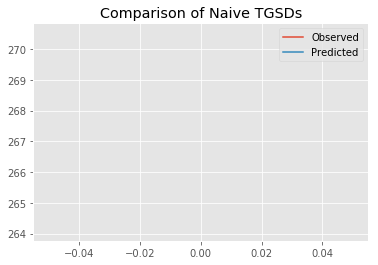

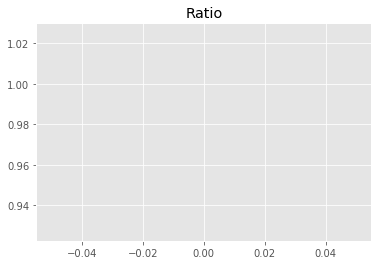

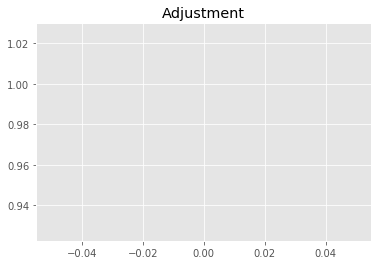

1553809570.5326862
1


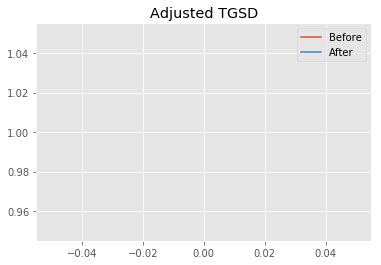

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|4.65835 	3.38234 	13755.8 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.59164e+09
After: 		|4.38325 	2.63035 	12709.2 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 54.6756
New Misfit: 54.175
Convergence:
0.009154968754537274

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.80e+02 	2.64e+02 	0.9446 		1.0000


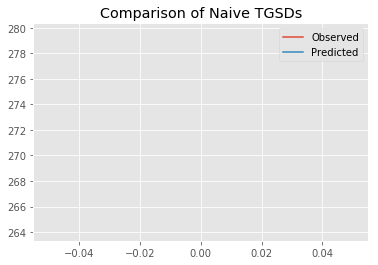

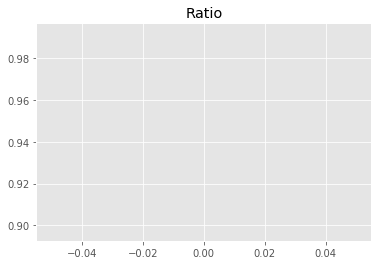

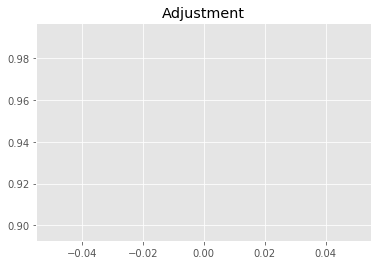

1503484222.503169
1


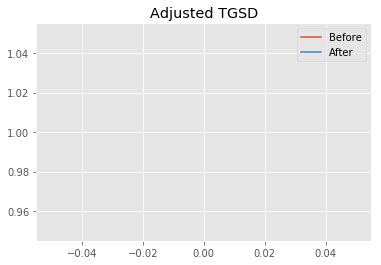

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|4.38325 	2.63035 	12709.2 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.59164e+09
After: 		|4.37501 	2.50201 	12573.1 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 54.175
New Misfit: 54.1011
Convergence:
0.00136425804549295

____________________
a = 4.37501	b = 2.50201	            h1 = 12573.12634	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 1591642903.26821
Success: True
Status: Successful convergence.
Iterations: 4
Misfit: 54.101113066007876
Prior Misfit: 120.39,	 Post Misfit: 54.1011


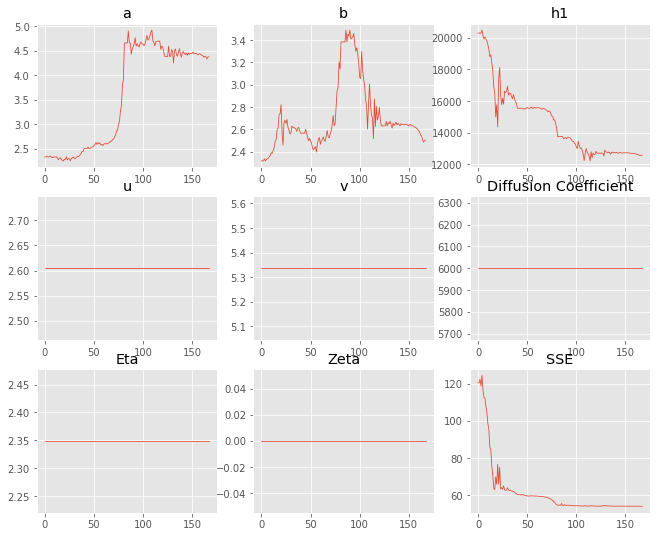

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,2.32782,4.37501
b,2.31666,2.50201
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"20,303.9","12,573.1"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 12 Time: 0.085 minutes


Estimated remaining run time: 0.446 minutes


Run 12===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.24e+02 	2.64e+02 	1.1795 		1.0000


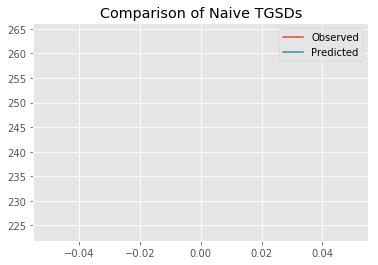

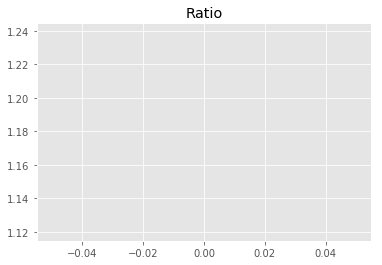

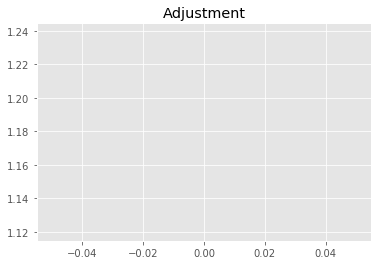

1877352538.8375719
1


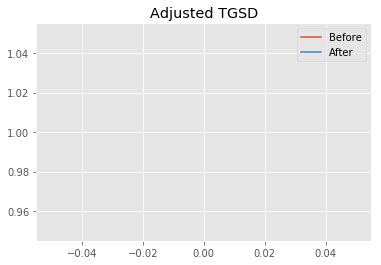

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.75788 	2.49405 	14800.7 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.59164e+09
After: 		|3.30985 	2.42371 	13768.6 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 68.7832
New Misfit: 55.3927
Convergence:
0.19467727700445878

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.70e+02 	2.64e+02 	0.9778 		1.0000


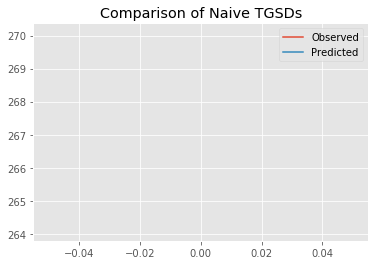

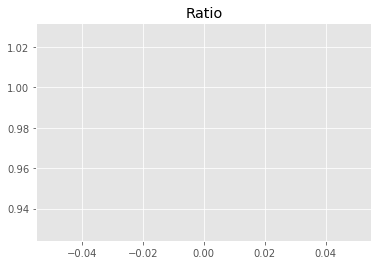

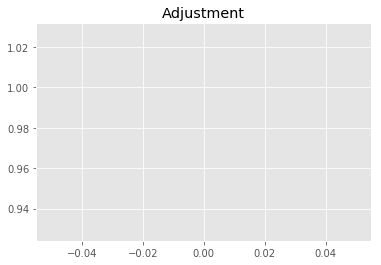

1556381752.74873
1


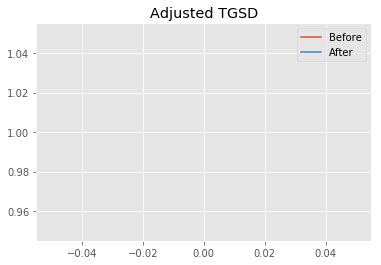

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.30985 	2.42371 	13768.6 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.59164e+09
After: 		|4.34163 	2.19261 	12280.3 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 55.3927
New Misfit: 53.8349
Convergence:
0.0281222340427412

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.82e+02 	2.64e+02 	0.9362 		1.0000


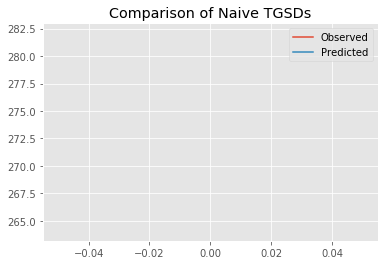

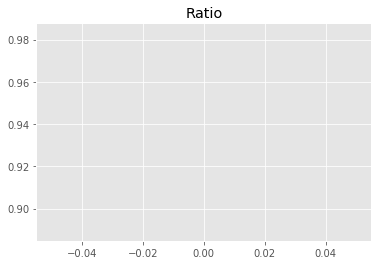

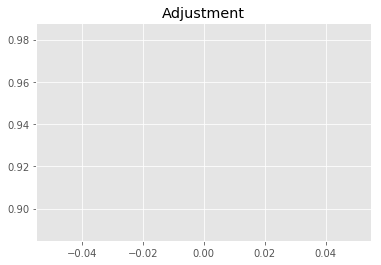

1490120929.5261753
1


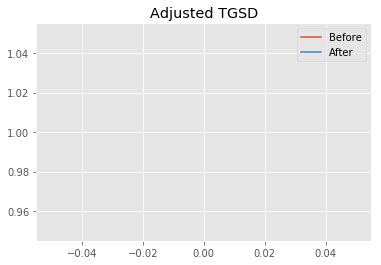

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|4.34163 	2.19261 	12280.3 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.59164e+09
After: 		|4.28767 	2.19606 	12492.3 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 53.8349
New Misfit: 53.7466
Convergence:
0.0016396017471088365

____________________
a = 4.28767	b = 2.19606	            h1 = 12492.27615	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 1591642903.26821
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 53.7466347778753
Prior Misfit: 68.7832,	 Post Misfit: 53.7466


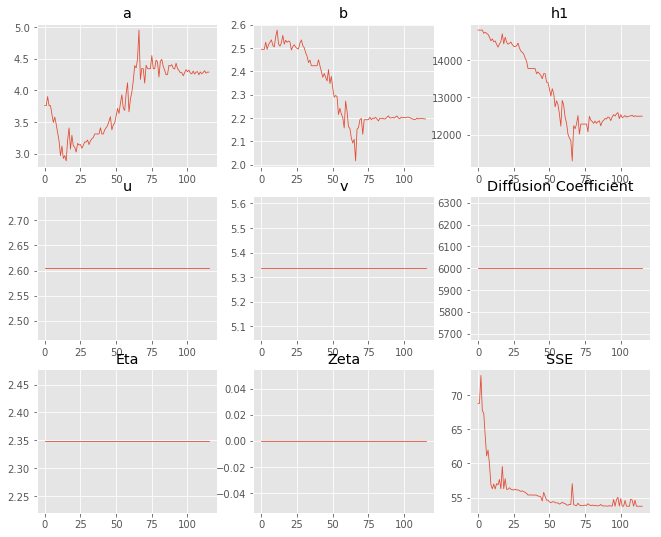

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,3.75788,4.28767
b,2.49405,2.19606
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"14,800.7","12,492.3"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 13 Time: 0.064 minutes


Estimated remaining run time: 0.382 minutes


Run 13===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.02e+02 	2.64e+02 	1.3042 		1.0000


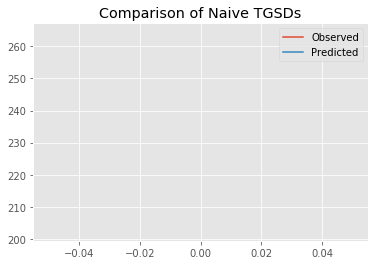

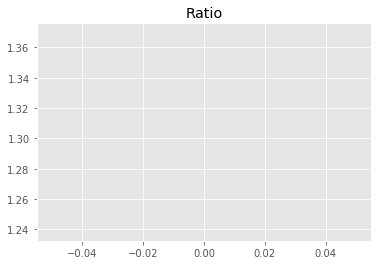

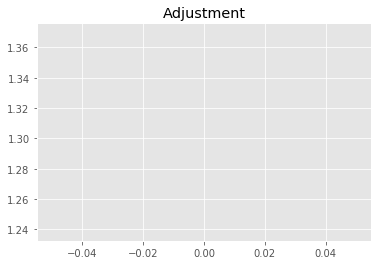

2075760967.4633663
1


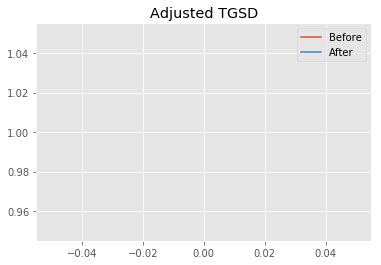

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.14949 	1.59106 	21950.6 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.59164e+09
After: 		|1.10009 	1.49668 	16363.9 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 110.93
New Misfit: 80.7105
Convergence:
0.27242132532080465

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.74e+02 	2.64e+02 	0.9632 		1.0000


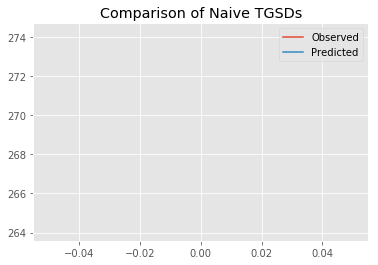

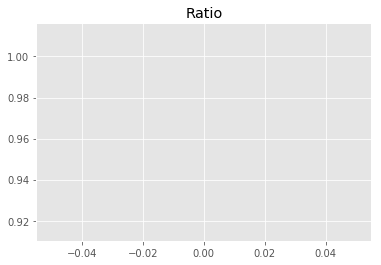

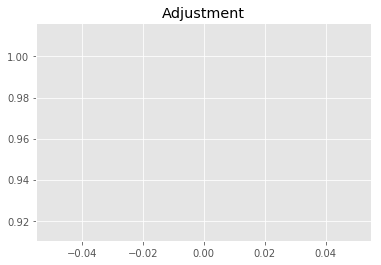

1533011066.6057913
1


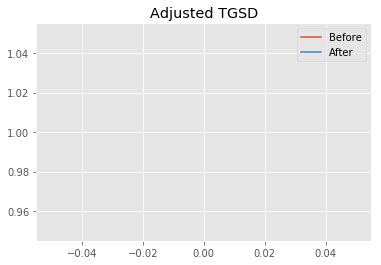

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.10009 	1.49668 	16363.9 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.59164e+09
After: 		|1.48096 	1.39815 	16326.3 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 80.7105
New Misfit: 73.6673
Convergence:
0.08726509135729228

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.38e+02 	2.64e+02 	1.1100 		1.0000


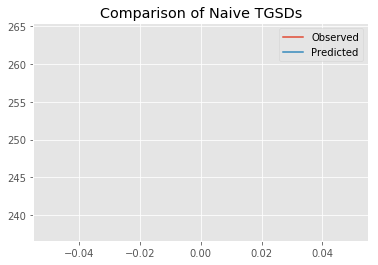

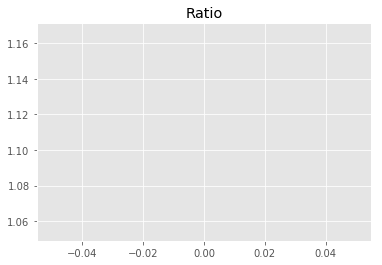

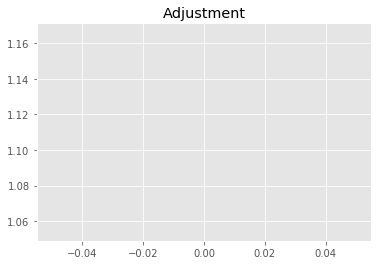

1766742808.9578977
1


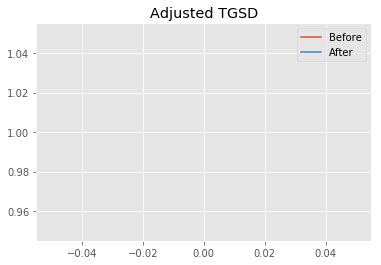

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.48096 	1.39815 	16326.3 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.59164e+09
After: 		|3.99158 	4.68999 	15771.3 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 73.6673
New Misfit: 57.9336
Convergence:
0.21357785759117445

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.92e+02 	2.64e+02 	0.9034 		1.0000


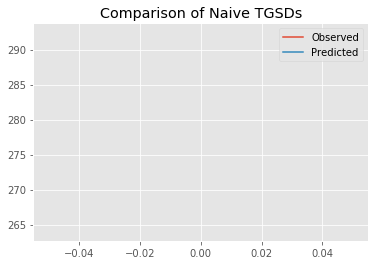

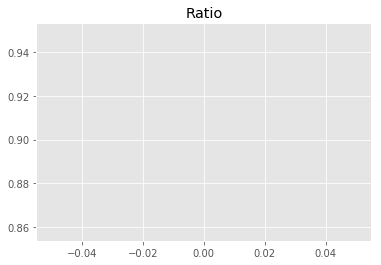

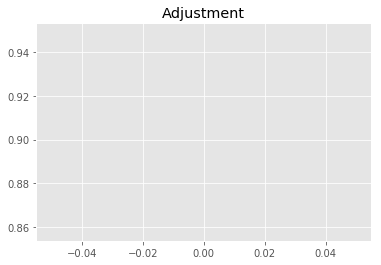

1437877379.4442158
1


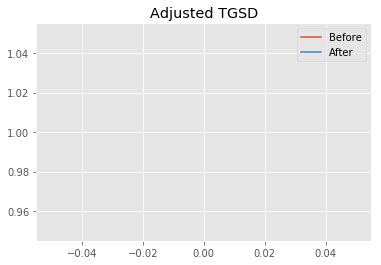

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.99158 	4.68999 	15771.3 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.59164e+09
After: 		|5.18177 	5.94252 	16194.8 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 57.9336
New Misfit: 55.1345
Convergence:
0.0483151372307432

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.78e+02 	2.64e+02 	0.9512 		1.0000


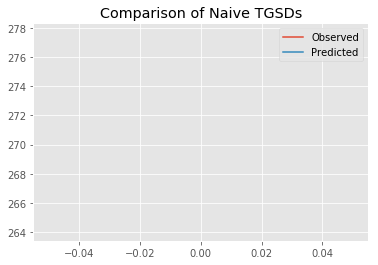

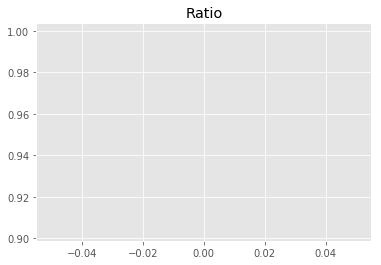

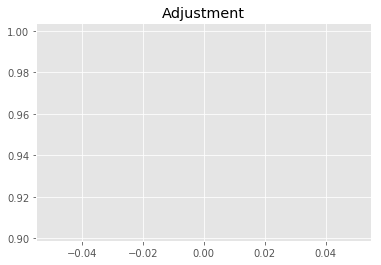

1513975855.8189263
1


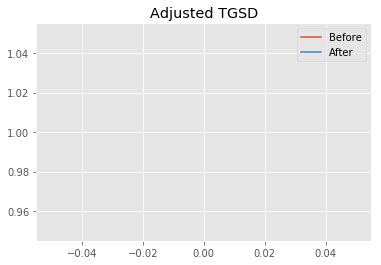

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|5.18177 	5.94252 	16194.8 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.59164e+09
After: 		|6.16557 	7.14055 	16243.3 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 55.1345
New Misfit: 54.9884
Convergence:
0.0026513307159735486

____________________
a = 6.16557	b = 7.14055	            h1 = 16243.27427	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 1591642903.26821
Success: True
Status: Successful convergence.
Iterations: 5
Misfit: 54.98835327581784
Prior Misfit: 110.93,	 Post Misfit: 54.9884


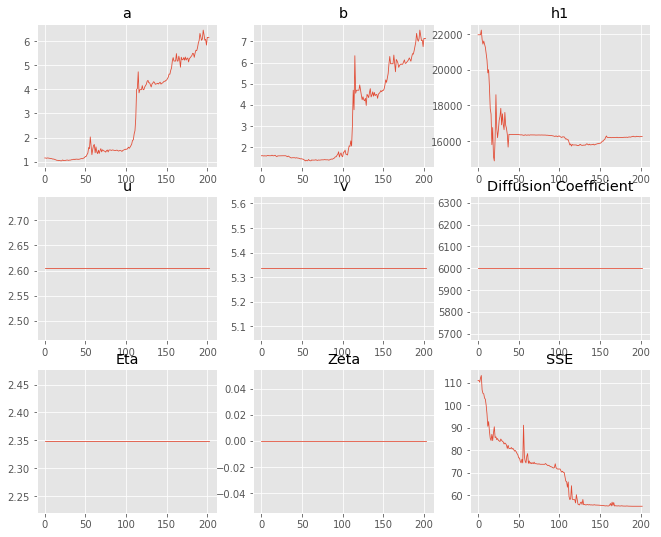

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,1.14949,6.16557
b,1.59106,7.14055
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"21,950.6","16,243.3"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 14 Time: 0.104 minutes


Estimated remaining run time: 0.332 minutes


Run 14===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	3.19e+02 	2.64e+02 	0.8269 		1.0000


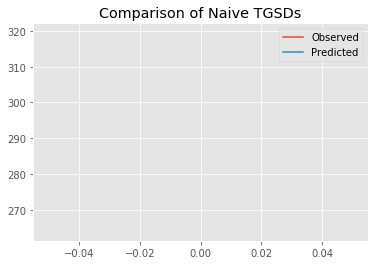

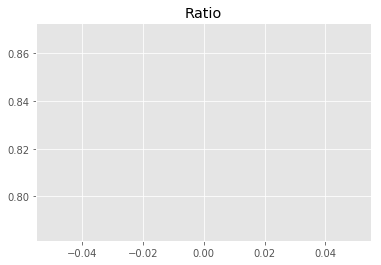

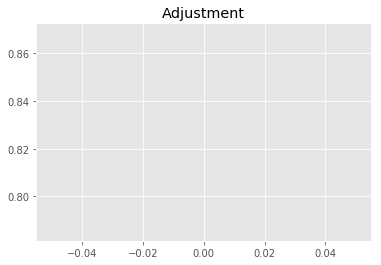

1316194215.3616052
1


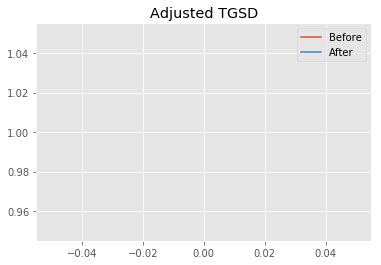

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.41697 	1.68328 	12186.4 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.59164e+09
After: 		|2.6281 	1.70562 	13530 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 66.2851
New Misfit: 55.627
Convergence:
0.16079135796312596

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.72e+02 	2.64e+02 	0.9722 		1.0000


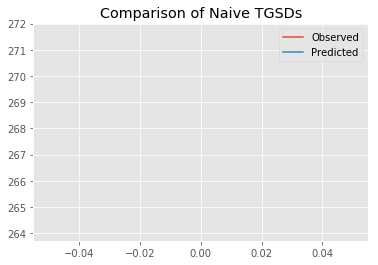

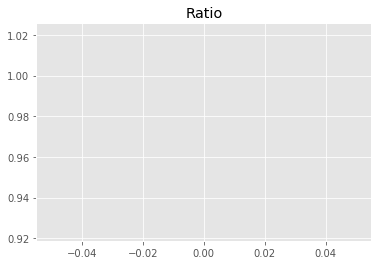

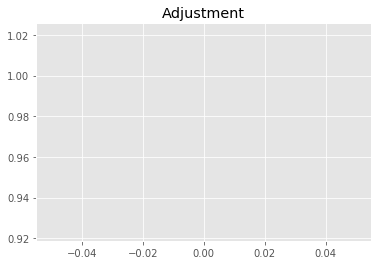

1547451288.879295
1


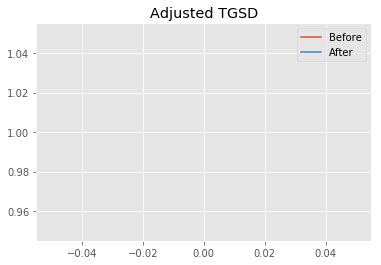

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.6281 	1.70562 	13530 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.59164e+09
After: 		|3.25577 	1.79326 	12583.9 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 55.627
New Misfit: 54.299
Convergence:
0.023873523088285213

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.71e+02 	2.64e+02 	0.9753 		1.0000


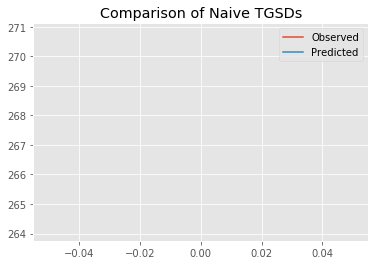

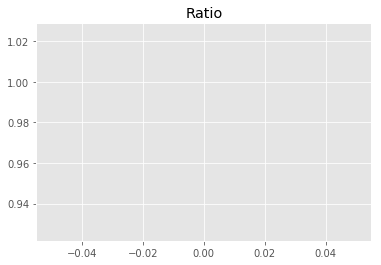

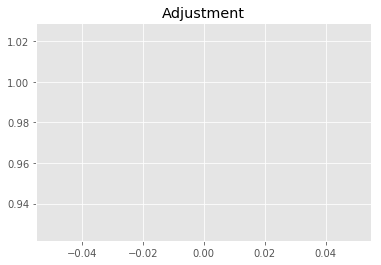

1552266559.5771105
1


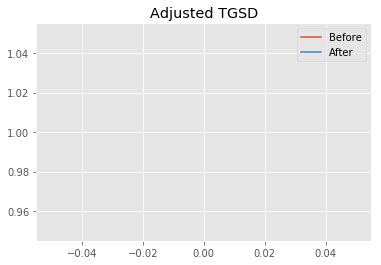

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.25577 	1.79326 	12583.9 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.59164e+09
After: 		|3.39011 	1.81871 	12497.1 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 54.299
New Misfit: 54.1745
Convergence:
0.0022921609634990077

____________________
a = 3.39011	b = 1.81871	            h1 = 12497.07947	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 1591642903.26821
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 54.174516053037934
Prior Misfit: 66.2851,	 Post Misfit: 54.1745


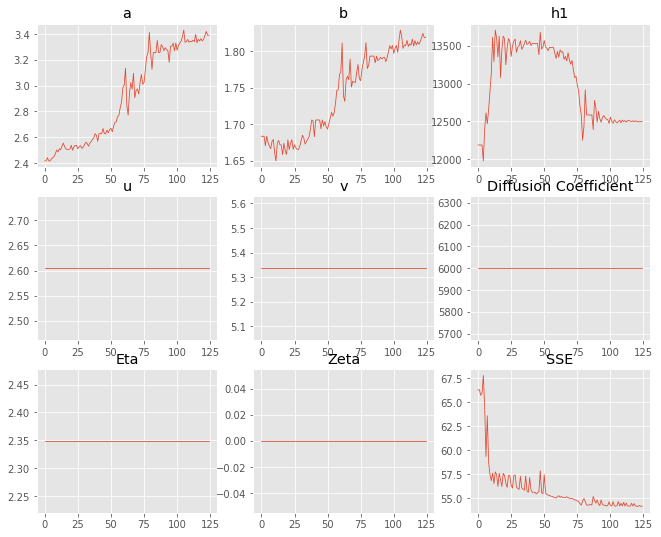

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,2.41697,3.39011
b,1.68328,1.81871
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"12,186.4","12,497.1"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 15 Time: 0.068 minutes


Estimated remaining run time: 0.266 minutes


Run 15===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.00e+02 	2.64e+02 	1.3226 		1.0000


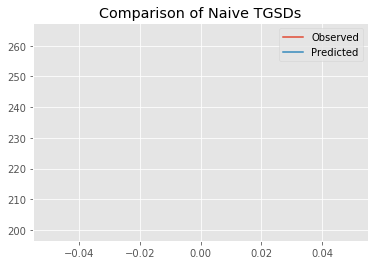

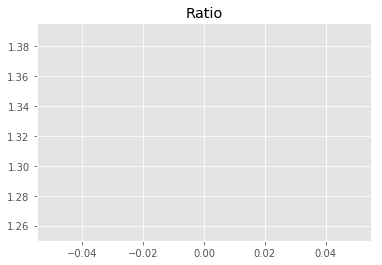

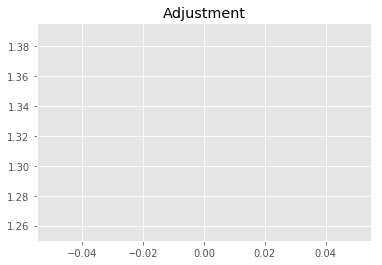

2105119303.2424924
1


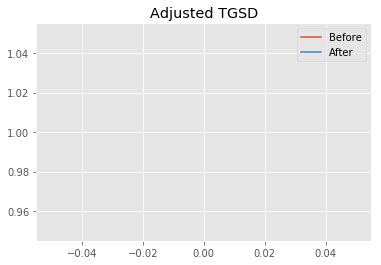

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|4.24604 	4.85271 	19606.9 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.59164e+09
After: 		|6.49395 	7.82328 	16577.9 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 89.2179
New Misfit: 55.0503
Convergence:
0.38296850172035235

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.77e+02 	2.64e+02 	0.9542 		1.0000


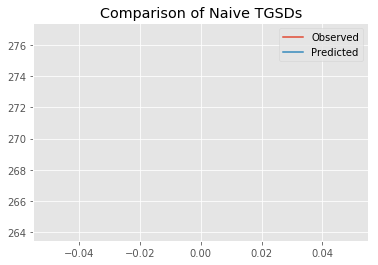

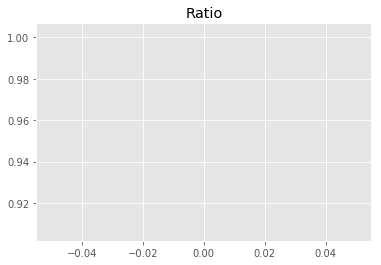

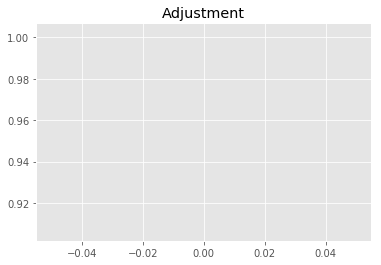

1518807570.3978934
1


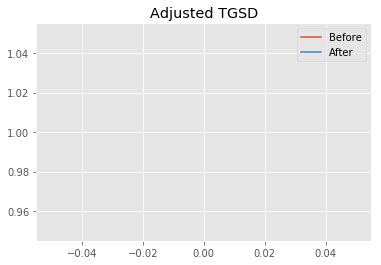

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|6.49395 	7.82328 	16577.9 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.59164e+09
After: 		|6.29905 	7.63689 	16578.9 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 55.0503
New Misfit: 55.0287
Convergence:
0.0003917813072610791

____________________
a = 6.29905	b = 7.63689	            h1 = 16578.94125	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 1591642903.26821
Success: True
Status: Successful convergence.
Iterations: 2
Misfit: 55.02870650452371
Prior Misfit: 89.2179,	 Post Misfit: 55.0287


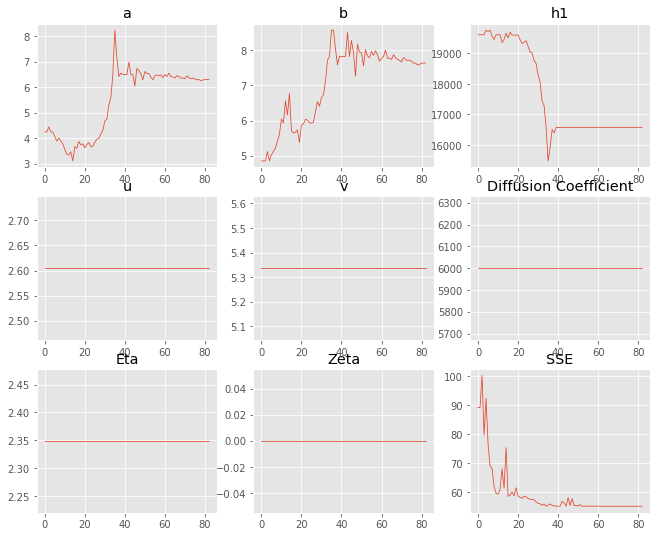

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,4.24604,6.29905
b,4.85271,7.63689
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"19,606.9","16,578.9"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 16 Time: 0.049 minutes


Estimated remaining run time: 0.196 minutes


Run 16===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.18e+02 	2.64e+02 	1.2122 		1.0000


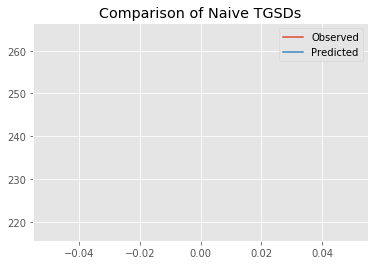

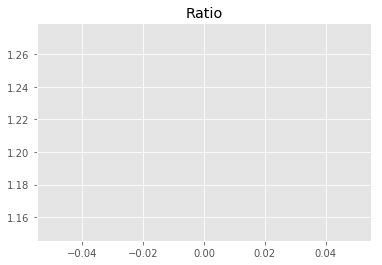

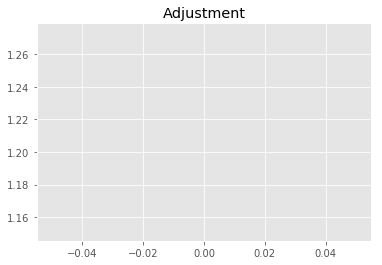

1929410834.1422968
1


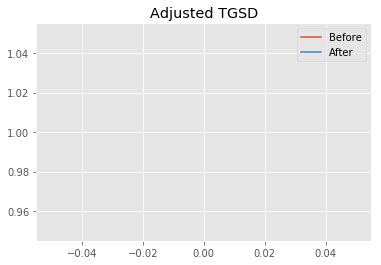

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.29723 	3.57529 	18380.1 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.59164e+09
After: 		|4.14523 	5.17918 	17675.8 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 73.2596
New Misfit: 57.3597
Convergence:
0.21703451594205586

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.58e+02 	2.64e+02 	1.0251 		1.0000


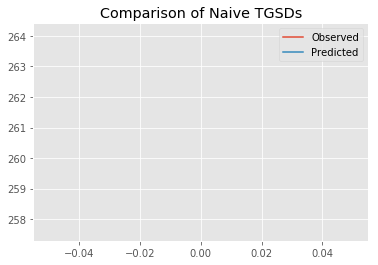

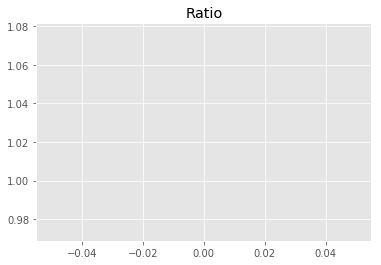

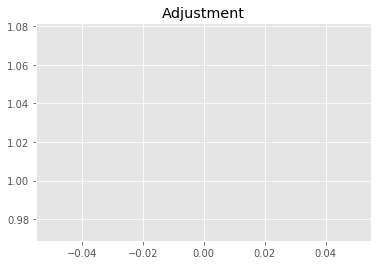

1631624712.2790713
1


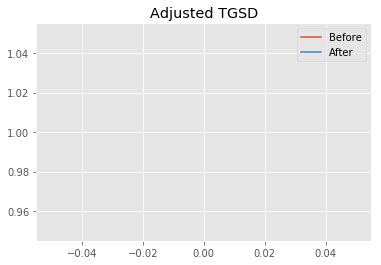

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|4.14523 	5.17918 	17675.8 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.59164e+09
After: 		|6.70401 	8.75757 	17086.8 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 57.3597
New Misfit: 55.0944
Convergence:
0.03949277574570655

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.80e+02 	2.64e+02 	0.9430 		1.0000


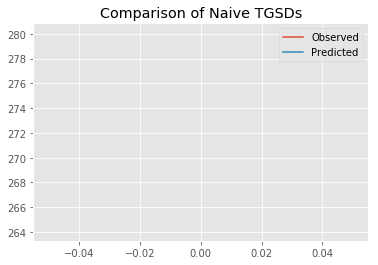

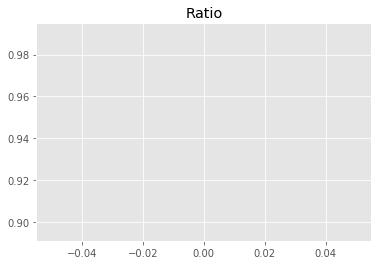

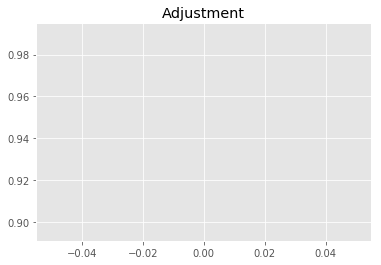

1500913156.205511
1


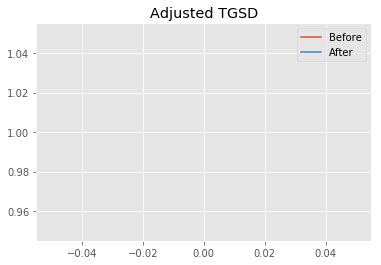

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|6.70401 	8.75757 	17086.8 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.59164e+09
After: 		|6.11996 	7.7159 	16900.2 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 55.0944
New Misfit: 55.0729
Convergence:
0.0003914522647580707

____________________
a = 6.11996	b = 7.71590	            h1 = 16900.24181	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 1591642903.26821
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 55.07285354255938
Prior Misfit: 73.2596,	 Post Misfit: 55.0729


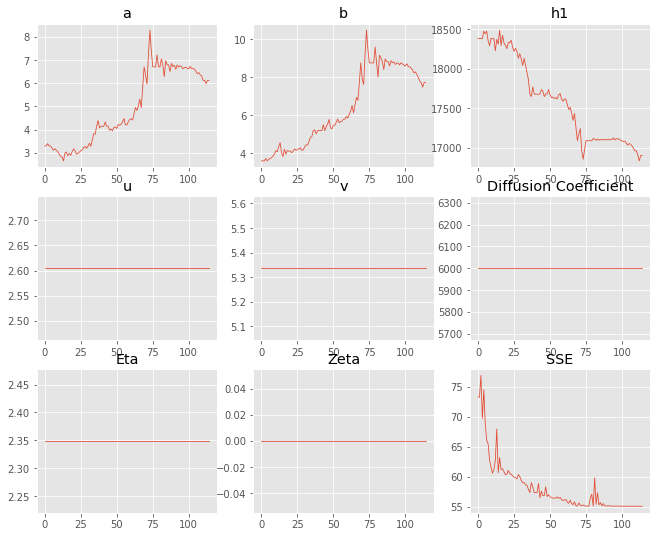

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,3.29723,6.11996
b,3.57529,7.7159
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"18,380.1","16,900.2"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 17 Time: 0.064 minutes


Estimated remaining run time: 0.131 minutes


Run 17===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.12e+02 	2.64e+02 	1.2450 		1.0000


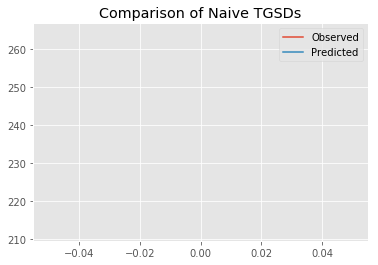

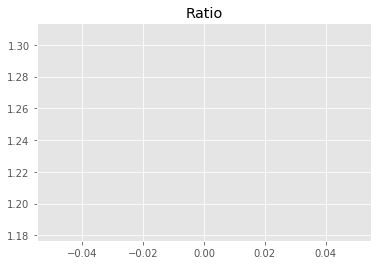

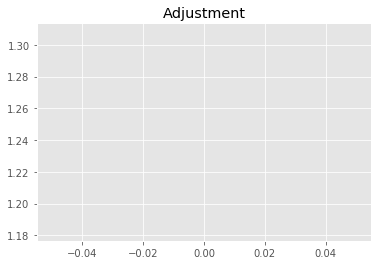

1981587844.291843
1


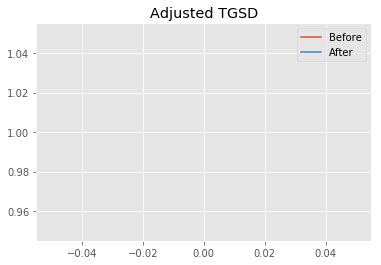

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.29113 	3.35183 	31956.9 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.59164e+09
After: 		|2.12746 	5.4877 	28063.5 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 107.551
New Misfit: 75.2005
Convergence:
0.3007910896073544

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.43e+02 	2.64e+02 	1.0861 		1.0000


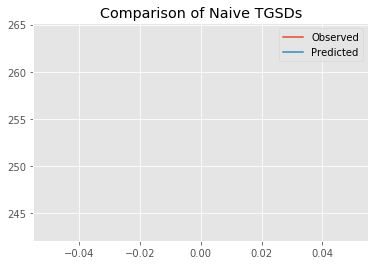

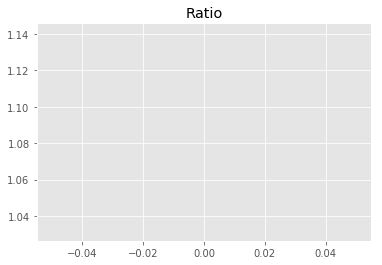

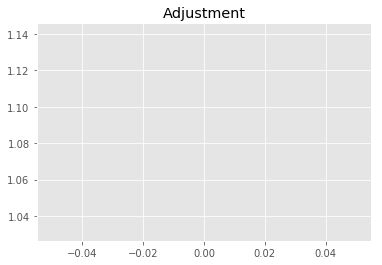

1728738652.8595107
1


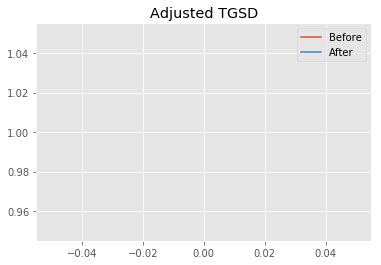

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.12746 	5.4877 	28063.5 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.59164e+09
After: 		|2.32665 	3.39076 	18069.2 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 75.2005
New Misfit: 65.2173
Convergence:
0.13275407248552898

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.73e+02 	2.64e+02 	0.9660 		1.0000


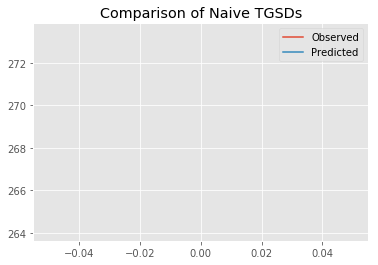

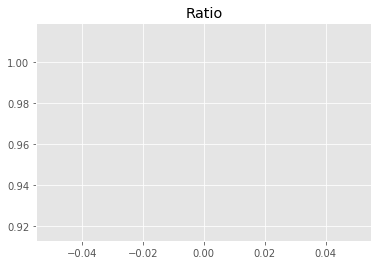

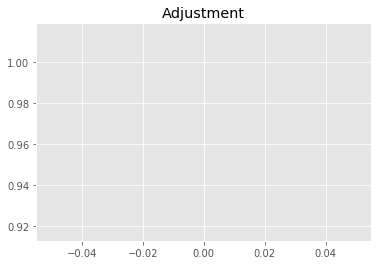

1537521906.9373884
1


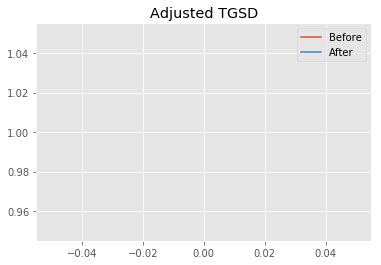

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.32665 	3.39076 	18069.2 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.59164e+09
After: 		|5.32705 	5.36013 	15542.9 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 65.2173
New Misfit: 55.0738
Convergence:
0.1555339748735247

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.71e+02 	2.64e+02 	0.9749 		1.0000


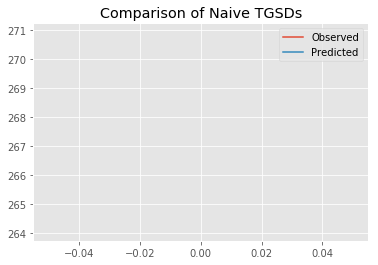

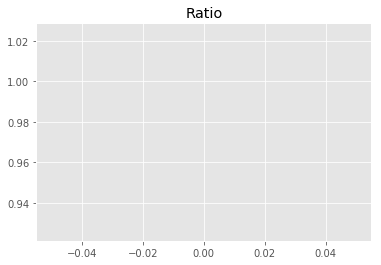

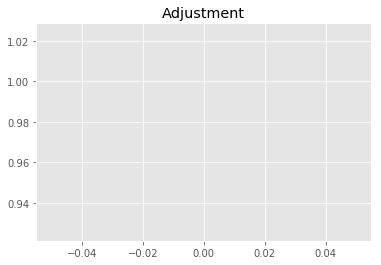

1551740752.0387254
1


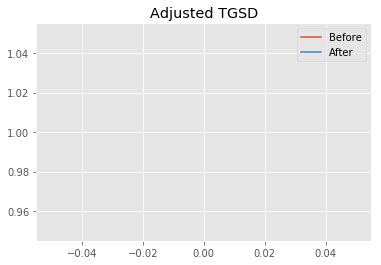

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|5.32705 	5.36013 	15542.9 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.59164e+09
After: 		|5.34914 	5.5151 	15515.2 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 55.0738
New Misfit: 54.9151
Convergence:
0.002881960338552889

____________________
a = 5.34914	b = 5.51510	            h1 = 15515.23544	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 1591642903.26821
Success: True
Status: Successful convergence.
Iterations: 4
Misfit: 54.91508901082896
Prior Misfit: 107.551,	 Post Misfit: 54.9151


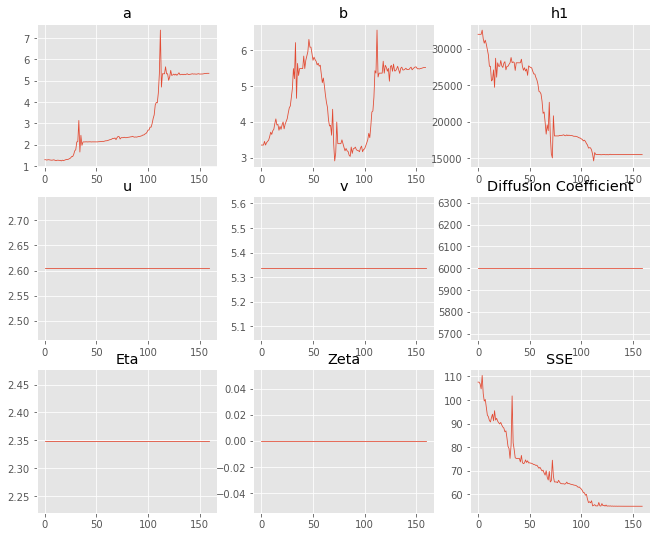

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,1.29113,5.34914
b,3.35183,5.5151
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"31,956.9","15,515.2"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 18 Time: 0.084 minutes


Estimated remaining run time: 0.066 minutes


Run 18===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.83e+02 	2.64e+02 	0.9327 		1.0000


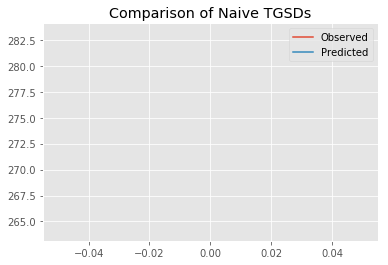

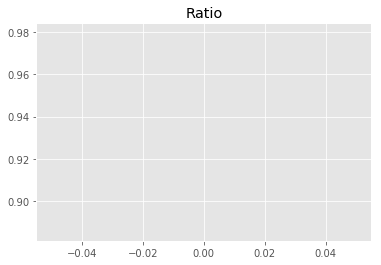

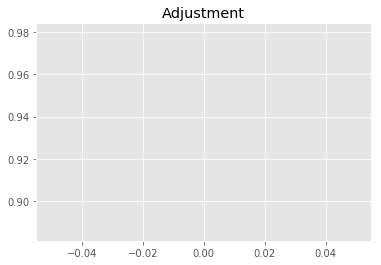

1484529744.748375
1


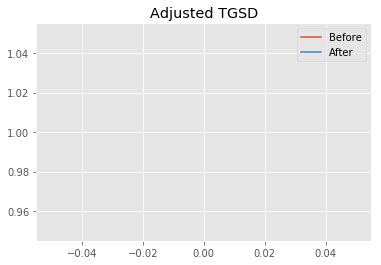

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.21602 	3.49961 	24300.4 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.59164e+09
After: 		|4.17124 	11.2412 	27023.4 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 92.4369
New Misfit: 59.0622
Convergence:
0.36105426281115044

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.63e+02 	2.64e+02 	1.0031 		1.0000


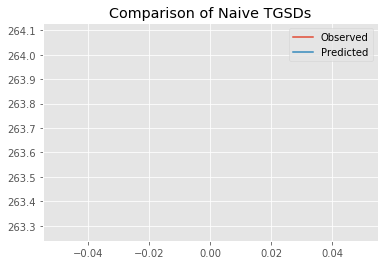

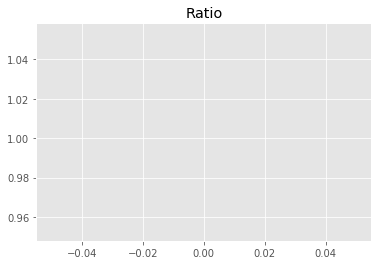

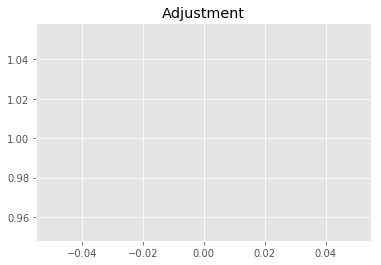

1596529387.7768598
1


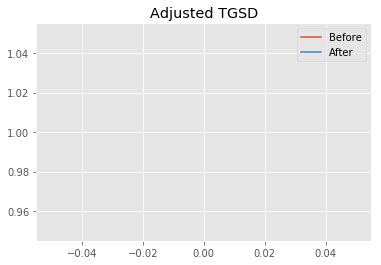

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|4.17124 	11.2412 	27023.4 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.59164e+09
After: 		|6.29241 	10.721 	19457.8 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 59.0622
New Misfit: 55.498
Convergence:
0.060346438673720075

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.82e+02 	2.64e+02 	0.9354 		1.0000


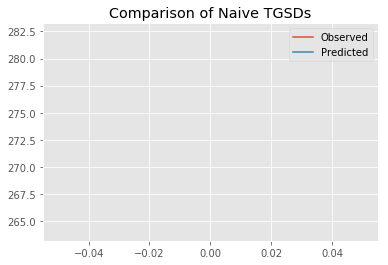

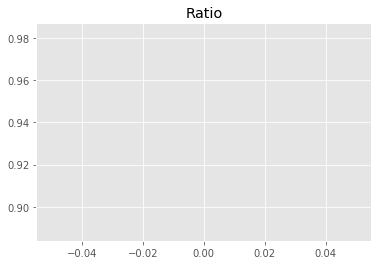

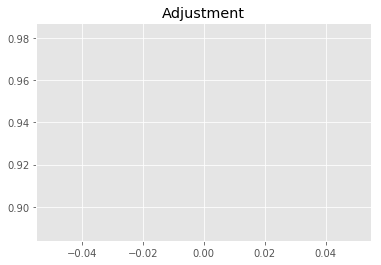

1488763082.2457848
1


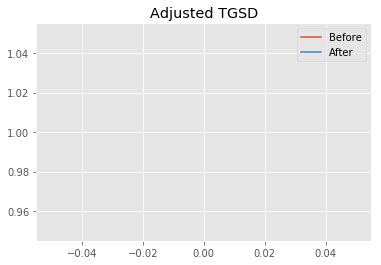

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|6.29241 	10.721 	19457.8 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.59164e+09
After: 		|7.37683 	11.5926 	18799.2 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 55.498
New Misfit: 55.2375
Convergence:
0.004692761623329564

____________________
a = 7.37683	b = 11.59265	            h1 = 18799.19162	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 1591642903.26821
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 55.237536386586754
Prior Misfit: 92.4369,	 Post Misfit: 55.2375


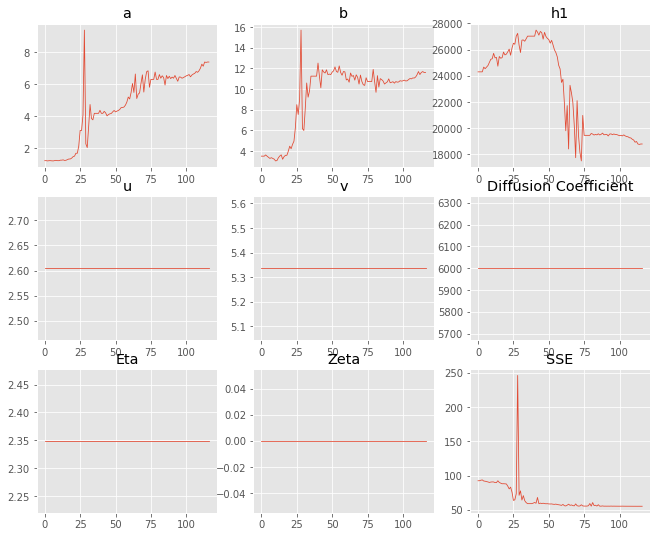

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,1.21602,7.37683
b,3.49961,11.5926
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"24,300.4","18,799.2"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 19 Time: 0.066 minutes


Estimated remaining run time: 0.000 minutes


Run 19===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.64e+02 	2.64e+02 	1.0001 		1.0000


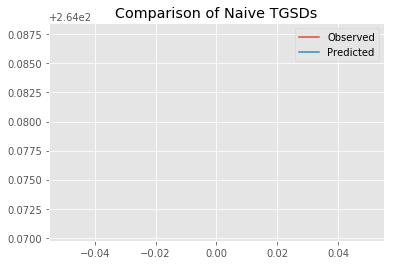

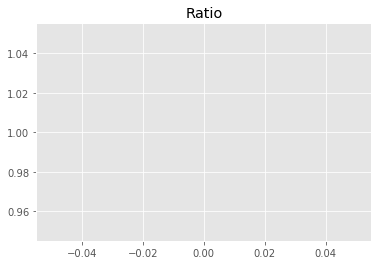

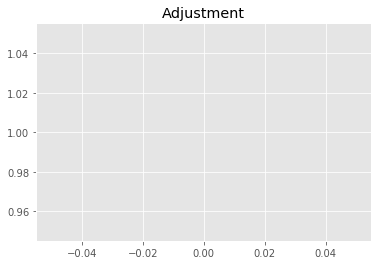

1591745454.6388075
1


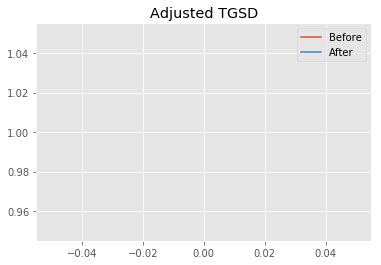

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.56997 	2.47323 	18889.8 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.59164e+09
After: 		|3.17038 	3.44789 	15929.5 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 75.542
New Misfit: 57.8562
Convergence:
0.23411935773555748

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.73e+02 	2.64e+02 	0.9680 		1.0000


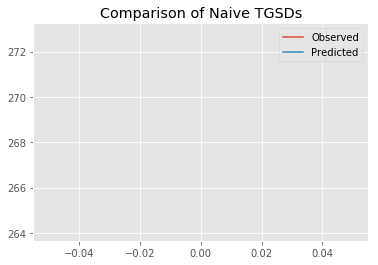

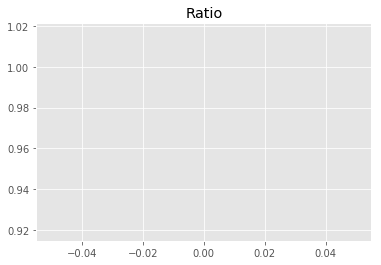

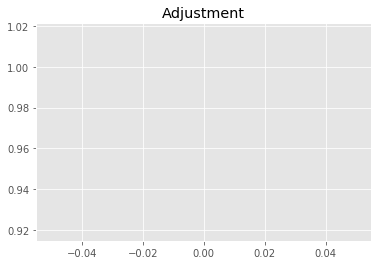

1540753132.540856
1


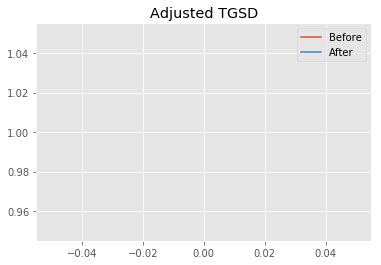

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.17038 	3.44789 	15929.5 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.59164e+09
After: 		|6.36139 	7.70838 	16568 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 57.8562
New Misfit: 55.0281
Convergence:
0.04888163455311899

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	1.59e+09 	2.78e+02 	2.64e+02 	0.9489 		1.0000


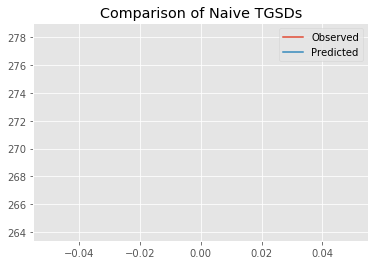

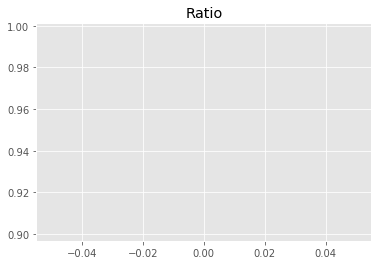

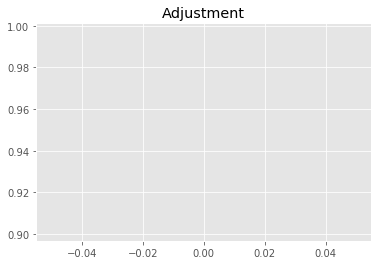

1510382621.4476702
1


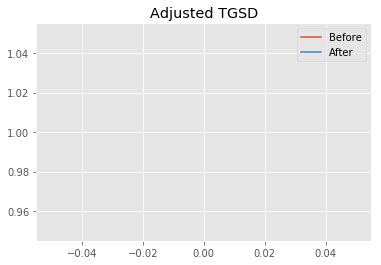

Old Total Mass: 1.59164e+09
New Total Mass: 1.59164e+09
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|6.36139 	7.70838 	16568 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 1.59164e+09
After: 		|6.27099 	7.58146 	16560.7 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 55.0281
New Misfit: 55.0266
Convergence:
2.681402954948176e-05

____________________
a = 6.27099	b = 7.58146	            h1 = 16560.71908	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 1591642903.26821
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 55.026604818505476
Prior Misfit: 75.542,	 Post Misfit: 55.0266


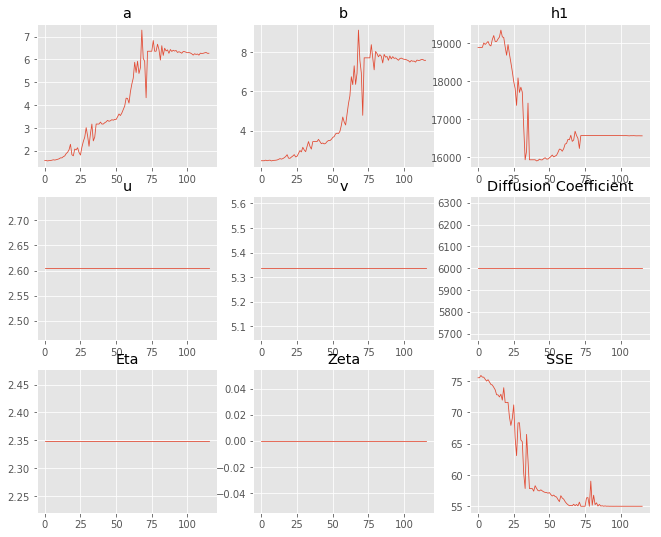

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,1.56997,6.27099
b,2.47323,7.58146
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"18,889.8","16,560.7"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 20 Time: 0.065 minutes


Estimated remaining run time: -0.066 minutes


Total Run Time: 1.39115 minutes


[{'a': 3.5160700634542676,
  'b': 1.6152911815408033,
  'h1': 12402.26632796987,
  'u': 2.60482,
  'v': 5.33615,
  'D': 5999.899999999996,
  'ftt': 6457.999999999996,
  'eta': 2.34894,
  'zeta': 0.0},
 {'a': 1.9981434703537642,
  'b': 1.0645558995376734,
  'h1': 12836.660788671736,
  'u': 2.60482,
  'v': 5.33615,
  'D': 5999.899999999996,
  'ftt': 6457.999999999996,
  'eta': 2.34894,
  'zeta': 0.0},
 {'a': 6.002948070063499,
  'b': 6.249993099314034,
  'h1': 15498.324558712637,
  'u': 2.60482,
  'v': 5.33615,
  'D': 5999.899999999996,
  'ftt': 6457.999999999996,
  'eta': 2.34894,
  'zeta': 0.0},
 {'a': 4.127084597164641,
  'b': 2.309904959467106,
  'h1': 12500.151562921272,
  'u': 2.60482,
  'v': 5.33615,
  'D': 5999.899999999996,
  'ftt': 6457.999999999996,
  'eta': 2.34894,
  'zeta': 0.0},
 {'a': 5.765495603570262,
  'b': 5.735808309955443,
  'h1': 15292.770447428693,
  'u': 2.60482,
  'v': 5.33615,
  'D': 5999.899999999996,
  'ftt': 6457.999999999996,
  'eta': 2.34894,
  'zeta': 0.0

,a,b,h1,u,v,D,ftt,eta,zeta,M,Misfit
0,3.51607,1.61529,"12,402.3",2.60482,5.33615,"5,999.9","6,458",2.34894,0,1.59164e+09,53.3907
12,4.28767,2.19606,"12,492.3",2.60482,5.33615,"5,999.9","6,458",2.34894,0,1.59164e+09,53.7466
7,4.04825,1.01107,"11,074.8",2.60482,5.33615,"5,999.9","6,458",2.34894,0,1.59164e+09,53.8971
3,4.12708,2.3099,"12,500.2",2.60482,5.33615,"5,999.9","6,458",2.34894,0,1.59164e+09,54.0456
11,4.37501,2.50201,"12,573.1",2.60482,5.33615,"5,999.9","6,458",2.34894,0,1.59164e+09,54.1011
9,4.26978,2.47564,"12,644.7",2.60482,5.33615,"5,999.9","6,458",2.34894,0,1.59164e+09,54.1051
5,4.49133,2.51349,"12,520.7",2.60482,5.33615,"5,999.9","6,458",2.34894,0,1.59164e+09,54.1094
14,3.39011,1.81871,"12,497.1",2.60482,5.33615,"5,999.9","6,458",2.34894,0,1.59164e+09,54.1745
4,5.7655,5.73581,"15,292.8",2.60482,5.33615,"5,999.9","6,458",2.34894,0,1.59164e+09,54.8664
2,6.00295,6.24999,"15,498.3",2.60482,5.33615,"5,999.9","6,458",2.34894,0,1.59164e+09,54.8881


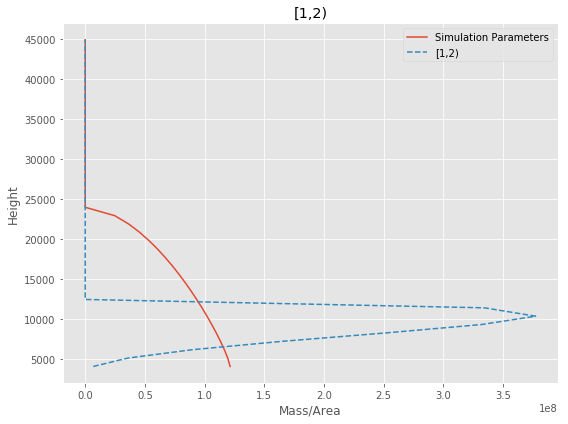

[1,2) Run Time: 1.39349 minutes


Mass Test: 54226745681.1571
========[2,3)========
Run 0===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	3.88e+08 	3.76e+01 	6.43e+01 	1.7119 		1.0000


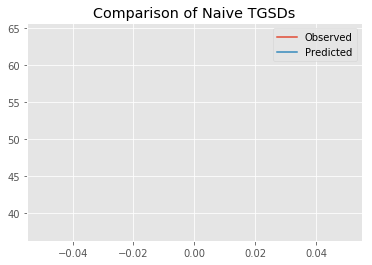

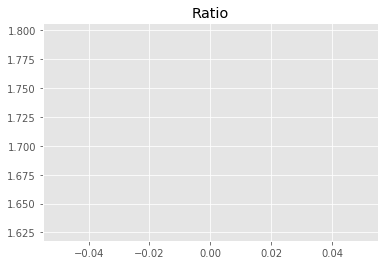

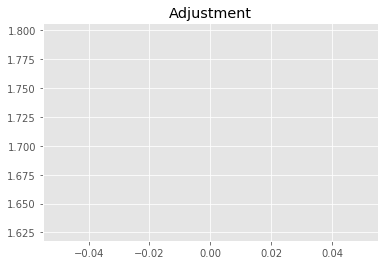

663639993.8865516
1


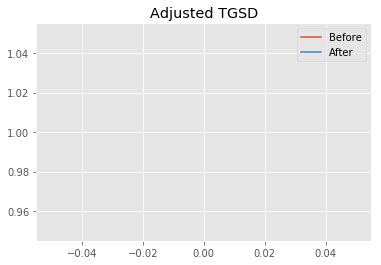

Old Total Mass: 3.87664e+08
New Total Mass: 3.87664e+08
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.03825 	4.33357 	18985.2 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 3.87664e+08
After: 		|2.01617 	15.9622 	16985.2 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 140.895
New Misfit: 40.4754
Convergence:
0.7127271244797714

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	3.88e+08 	9.89e+01 	6.43e+01 	0.6503 		1.0000


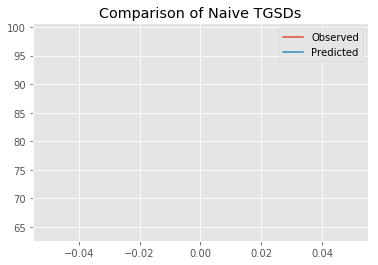

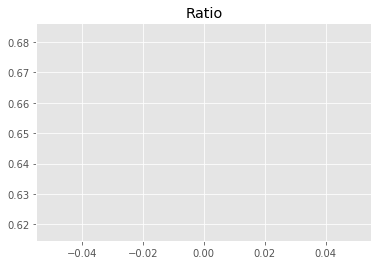

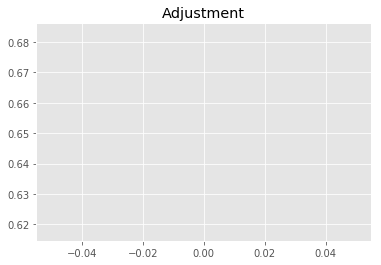

252114599.5035127
1


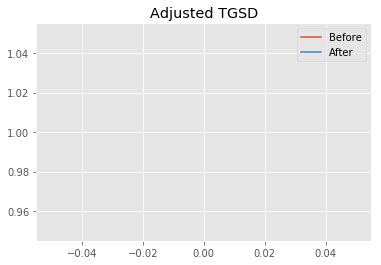

Old Total Mass: 3.87664e+08
New Total Mass: 3.87664e+08
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.01617 	15.9622 	16985.2 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 3.87664e+08
After: 		|1.90732 	18.1845 	18837.5 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 40.4754
New Misfit: 40.3647
Convergence:
0.0027372878821597777

____________________
a = 1.90732	b = 18.18448	            h1 = 18837.48293	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 387664367.47453
Success: True
Status: Successful convergence.
Iterations: 2
Misfit: 40.364650998347074
Prior Misfit: 140.895,	 Post Misfit: 40.3647


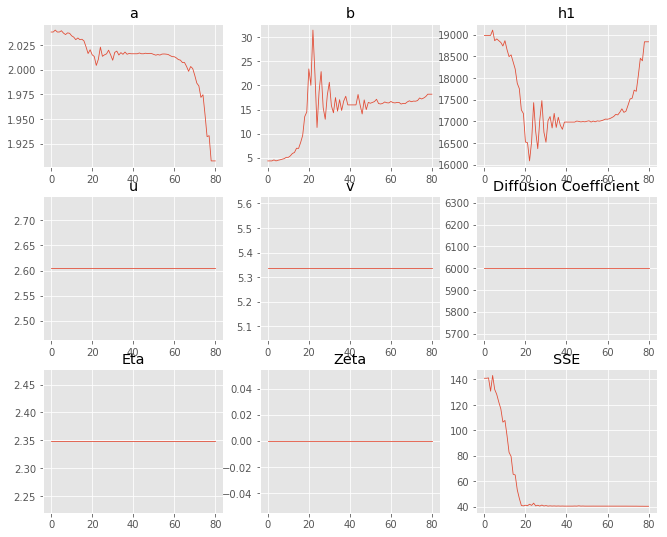

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,2.03825,1.90732
b,4.33357,18.1845
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"18,985.2","18,837.5"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 1 Time: 0.050 minutes


Estimated remaining run time: 0.452 minutes


Run 1===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	3.88e+08 	9.94e+01 	6.43e+01 	0.6469 		1.0000


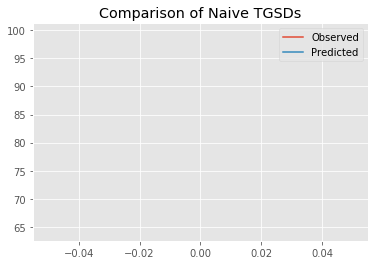

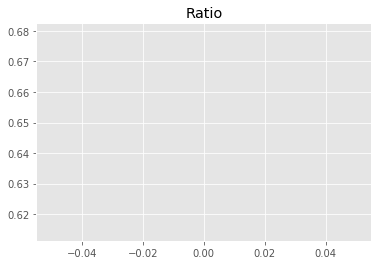

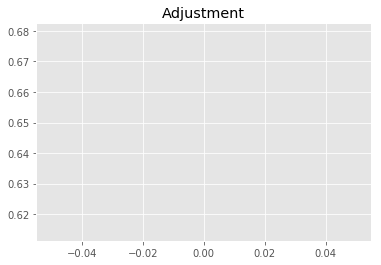

250770664.1272088
1


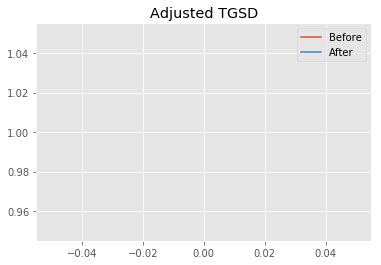

Old Total Mass: 3.87664e+08
New Total Mass: 3.87664e+08
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.28101 	2.36373 	6946.55 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Optimization terminated successfully.
         Current function value: 42.660640
         Iterations: 16
         Function evaluations: 58
New Total Mass: 3.87664e+08
After: 		|3.159 	2.37553 	6075.25 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 45.5148
New Misfit: 42.6606
Convergence:
0.06270755959246933

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	3.88e+08 	1.16e+02 	6.43e+01 	0.5523 		1.0000


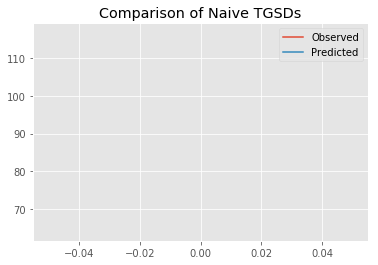

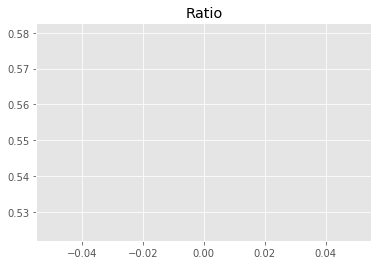

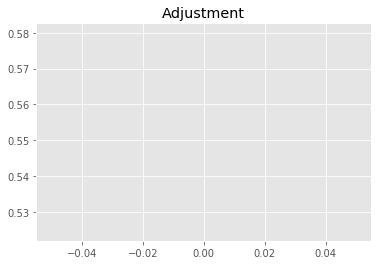

214088127.75297847
1


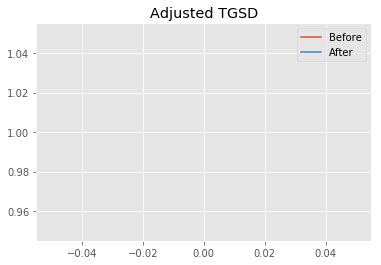

Old Total Mass: 3.87664e+08
New Total Mass: 3.87664e+08
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.159 	2.37553 	6075.25 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Optimization terminated successfully.
         Current function value: 42.660640
         Iterations: 10
         Function evaluations: 49
New Total Mass: 3.87664e+08
After: 		|3.159 	2.37553 	6075.25 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 42.6606
New Misfit: 42.6606
Convergence:
1.6655698093334067e-16

____________________
a = 3.15900	b = 2.37553	            h1 = 6075.24689	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 387664367.47453
Success: True
Status: Successful convergence.
Iterations: 2
Misfit: 42.66063972692164
Prior Misfit: 45.5148,	 Post Misfit: 42.6606


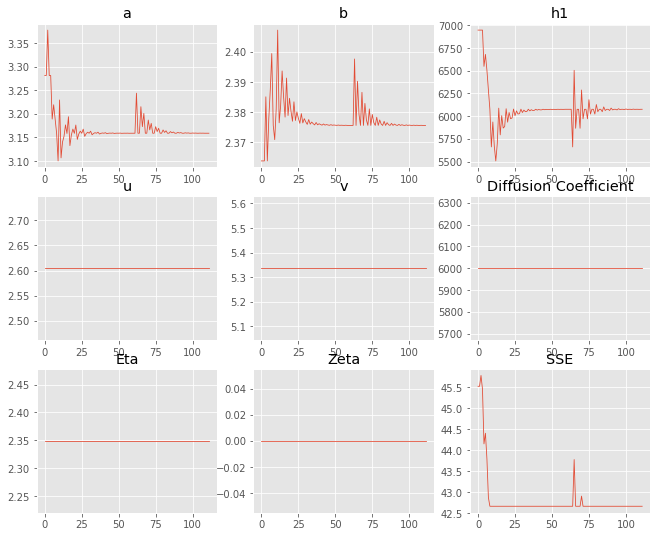

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,3.28101,3.159
b,2.36373,2.37553
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"6,946.55","6,075.25"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 2 Time: 0.058 minutes


Estimated remaining run time: 0.614 minutes


Run 2===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	3.88e+08 	1.08e+02 	6.43e+01 	0.5931 		1.0000


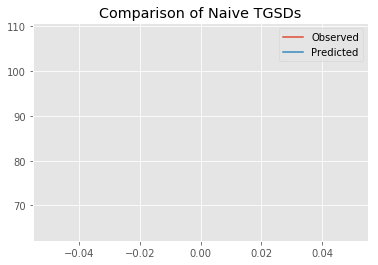

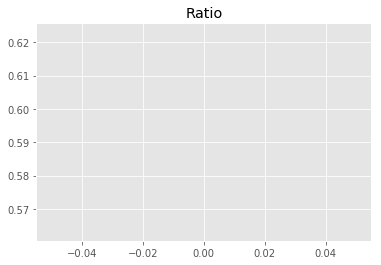

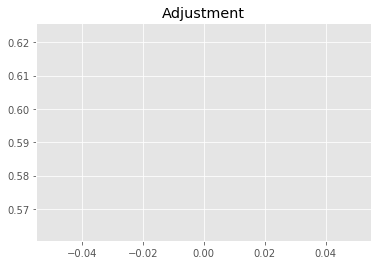

229904942.24954593
1


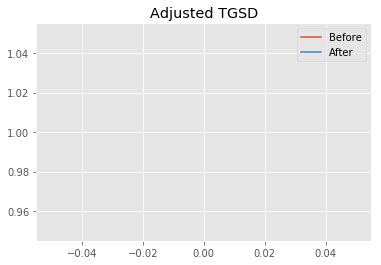

Old Total Mass: 3.87664e+08
New Total Mass: 3.87664e+08
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.10922 	2.80149 	6404.55 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 3.87664e+08
After: 		|2.10587 	2.9154 	6232.43 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 41.9226
New Misfit: 41.8364
Convergence:
0.0020560888484087154

____________________
a = 2.10587	b = 2.91540	            h1 = 6232.43197	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 387664367.47453
Success: True
Status: Successful convergence.
Iterations: 1
Misfit: 41.83635960061581
Prior Misfit: 41.9226,	 Post Misfit: 41.8364


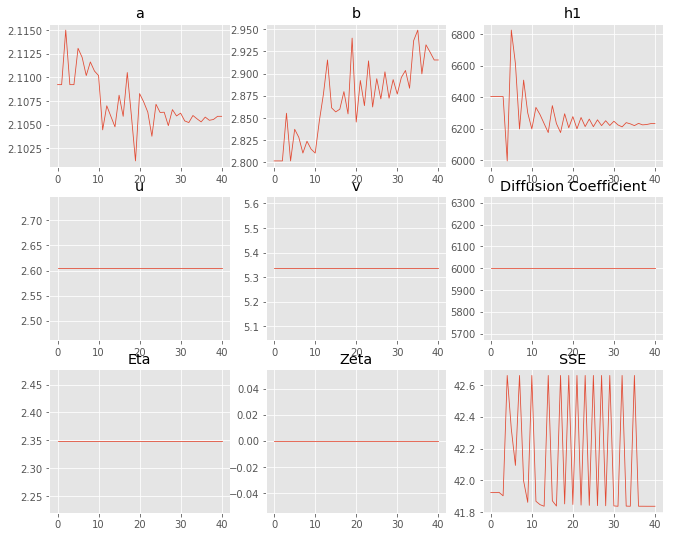

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,2.10922,2.10587
b,2.80149,2.9154
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"6,404.55","6,232.43"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 3 Time: 0.029 minutes


Estimated remaining run time: 0.548 minutes


Run 3===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	3.88e+08 	5.25e+01 	6.43e+01 	1.2244 		1.0000


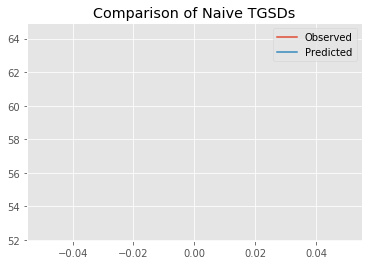

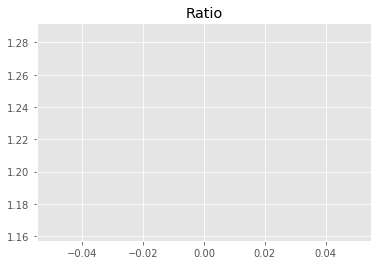

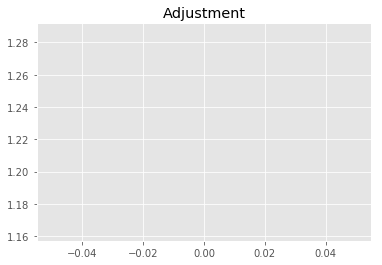

474673987.7114612
1


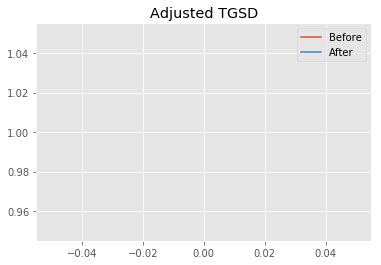

Old Total Mass: 3.87664e+08
New Total Mass: 3.87664e+08
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.04758 	4.32721 	12285 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 3.87664e+08
After: 		|1.98332 	9.49261 	11682.5 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 93.2106
New Misfit: 40.7456
Convergence:
0.5628651381959507

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	3.88e+08 	1.01e+02 	6.43e+01 	0.6343 		1.0000


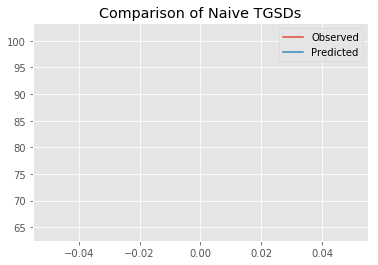

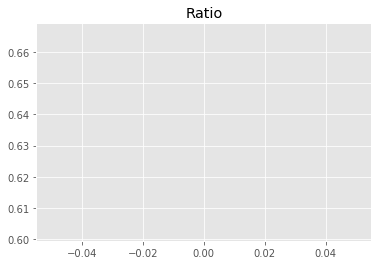

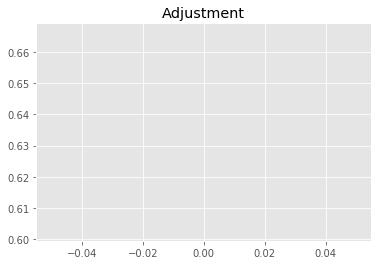

245901328.20102513
1


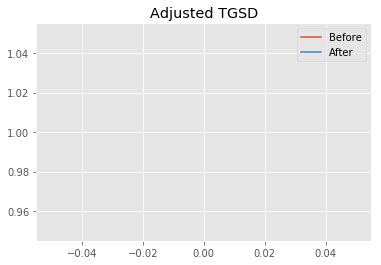

Old Total Mass: 3.87664e+08
New Total Mass: 3.87664e+08
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.98332 	9.49261 	11682.5 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 3.87664e+08
After: 		|1.96756 	25.8397 	23327.2 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 40.7456
New Misfit: 40.3416
Convergence:
0.009915408163611587

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	3.88e+08 	1.01e+02 	6.43e+01 	0.6381 		1.0000


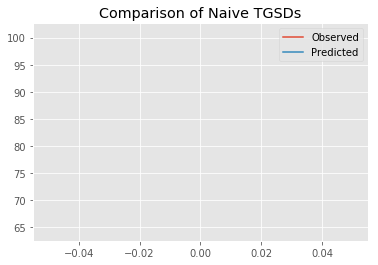

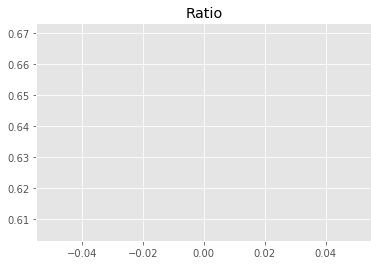

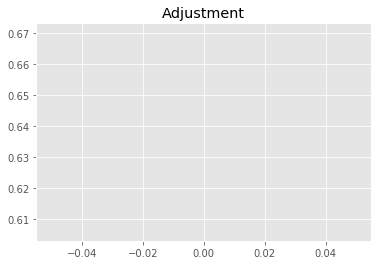

247355638.5061514
1


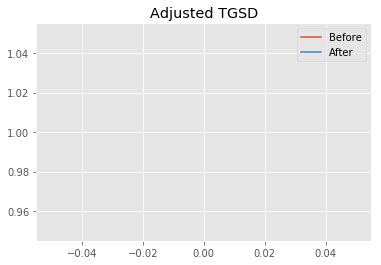

Old Total Mass: 3.87664e+08
New Total Mass: 3.87664e+08
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.96756 	25.8397 	23327.2 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 3.87664e+08
After: 		|1.96506 	36.2637 	31662.7 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 40.3416
New Misfit: 40.234
Convergence:
0.002665767501855603

____________________
a = 1.96506	b = 36.26372	            h1 = 31662.70171	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 387664367.47453
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 40.23403943205209
Prior Misfit: 93.2106,	 Post Misfit: 40.234


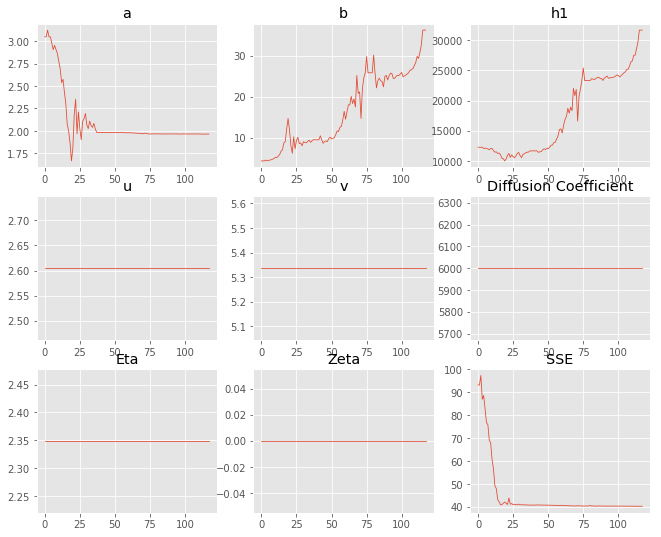

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,3.04758,1.96506
b,4.32721,36.2637
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"12,285","31,662.7"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 4 Time: 0.065 minutes


Estimated remaining run time: 0.605 minutes


Run 4===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	3.88e+08 	3.84e+01 	6.43e+01 	1.6748 		1.0000


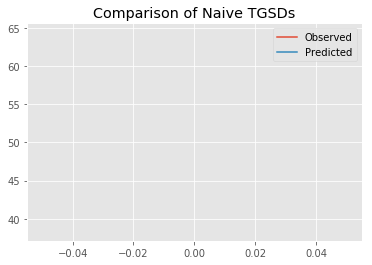

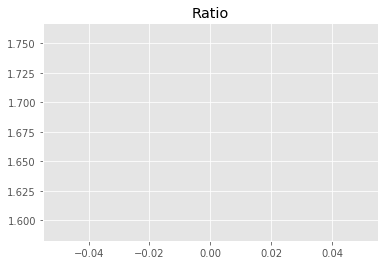

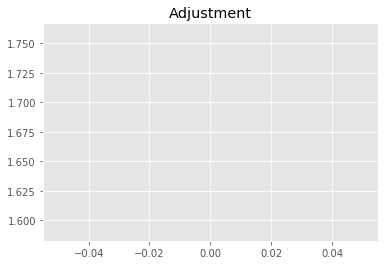

649272723.1521662
1


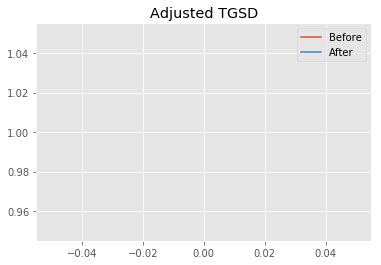

Old Total Mass: 3.87664e+08
New Total Mass: 3.87664e+08
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.18156 	1.99839 	16590.8 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 3.87664e+08
After: 		|1 	2.03663 	14873.1 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 124.572
New Misfit: 83.601
Convergence:
0.32889361845485826

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	3.88e+08 	4.89e+01 	6.43e+01 	1.3167 		1.0000


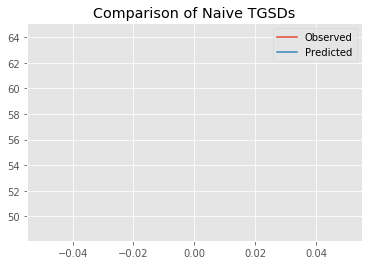

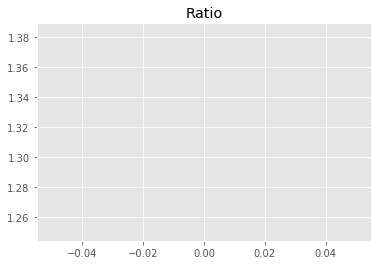

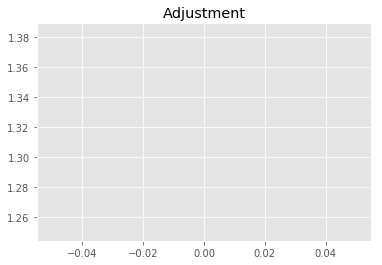

510435057.3643384
1


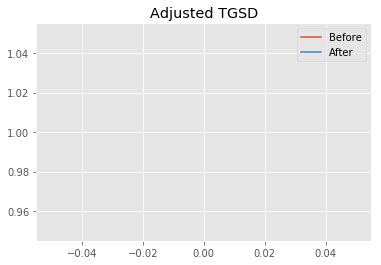

Old Total Mass: 3.87664e+08
New Total Mass: 3.87664e+08
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1 	2.03663 	14873.1 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0


C:\Users\nmostert\Documents\repos\inversion_project\utils.py:455: RuntimeWarning: divide by zero encountered in log
  a_star = np.log(a - 1)


New Total Mass: 3.87664e+08
After: 		|1 	2.03663 	14790.9 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 83.601
New Misfit: 82.8752
Convergence:
0.008681066012410697

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	3.88e+08 	4.91e+01 	6.43e+01 	1.3091 		1.0000


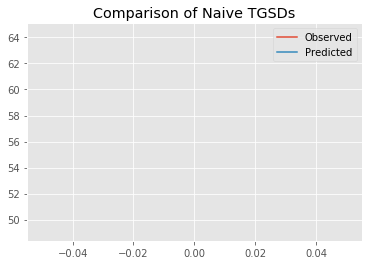

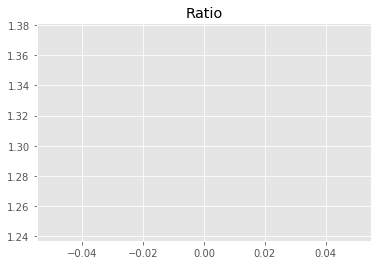

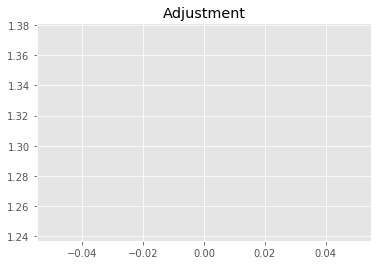

507499308.5438093
1


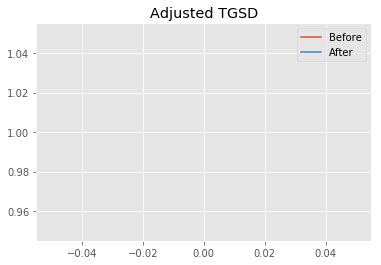

Old Total Mass: 3.87664e+08
New Total Mass: 3.87664e+08
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1 	2.03663 	14790.9 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 3.87664e+08
After: 		|1 	2.03663 	14704.6 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 82.8752
New Misfit: 82.1048
Convergence:
0.009296150967532238

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	3.88e+08 	4.94e+01 	6.43e+01 	1.3010 		1.0000


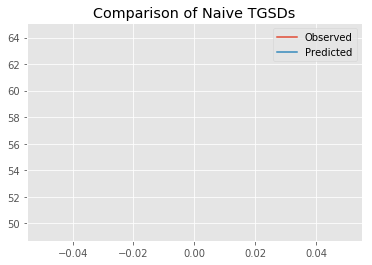

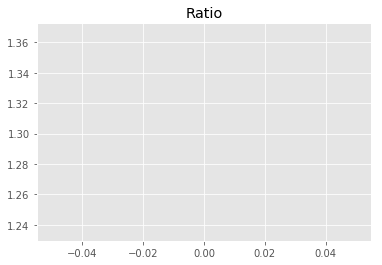

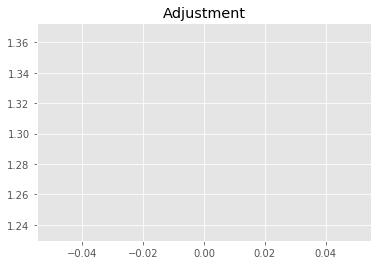

504364656.3227785
1


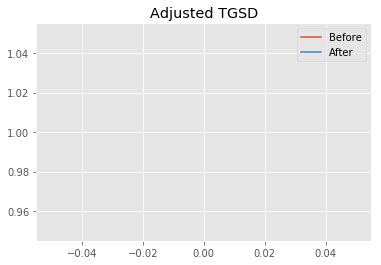

Old Total Mass: 3.87664e+08
New Total Mass: 3.87664e+08
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1 	2.03663 	14704.6 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 3.87664e+08
After: 		|1 	2.03663 	14614.1 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 82.1048
New Misfit: 81.2869
Convergence:
0.009962002285917242

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	3.88e+08 	4.98e+01 	6.43e+01 	1.2924 		1.0000


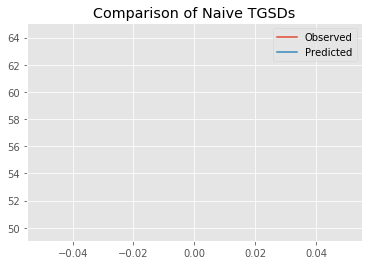

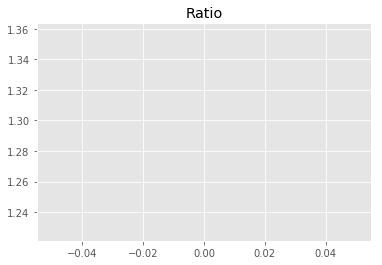

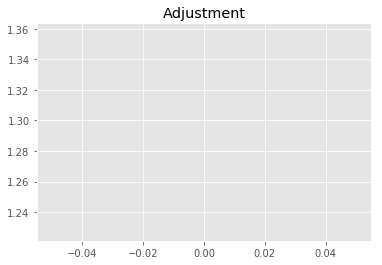

501015620.2666162
1


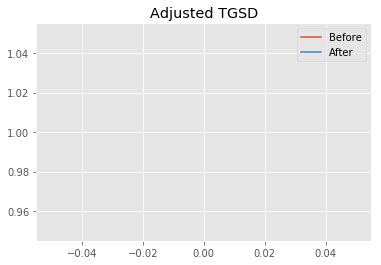

Old Total Mass: 3.87664e+08
New Total Mass: 3.87664e+08
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1 	2.03663 	14614.1 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 3.87664e+08
After: 		|1 	2.03663 	14519.1 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 81.2869
New Misfit: 79.5457
Convergence:
0.021420618199988348

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	3.88e+08 	5.05e+01 	6.43e+01 	1.2729 		1.0000


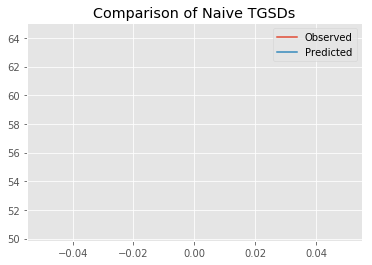

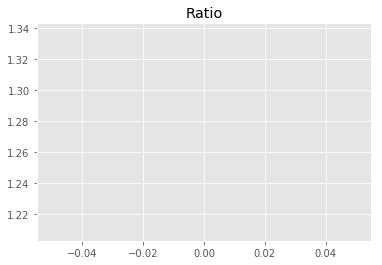

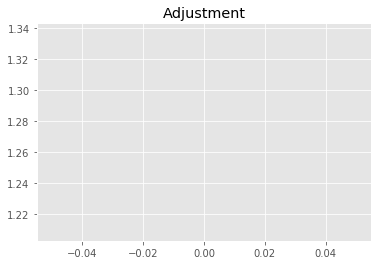

493457420.3242594
1


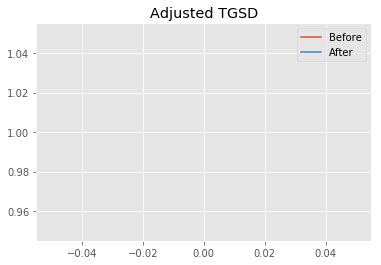

Old Total Mass: 3.87664e+08
New Total Mass: 3.87664e+08
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1 	2.03663 	14519.1 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 3.87664e+08
After: 		|1 	2.03663 	14419.4 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 79.5457
New Misfit: 78.8137
Convergence:
0.009202133213626887

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	3.88e+08 	5.08e+01 	6.43e+01 	1.2652 		1.0000


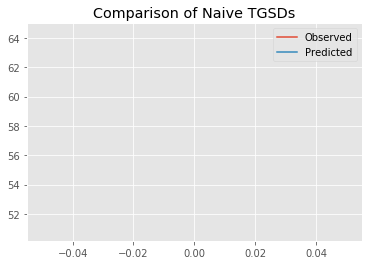

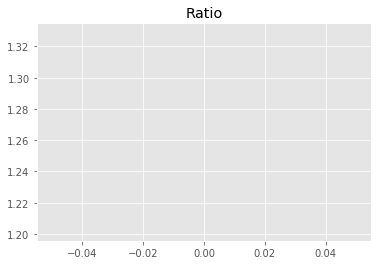

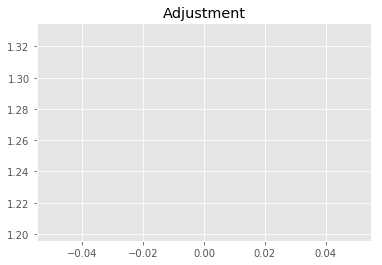

490470755.592648
1


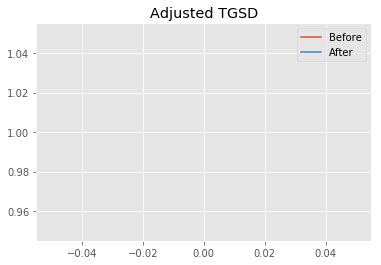

Old Total Mass: 3.87664e+08
New Total Mass: 3.87664e+08
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1 	2.03663 	14419.4 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 3.87664e+08
After: 		|1 	2.03663 	14314.9 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 78.8137
New Misfit: 78.0333
Convergence:
0.00990114167090724

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	3.88e+08 	5.12e+01 	6.43e+01 	1.2569 		1.0000


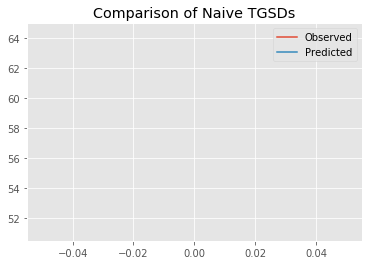

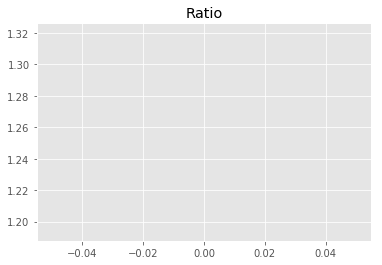

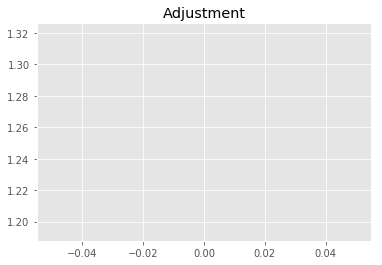

487264619.7241688
1


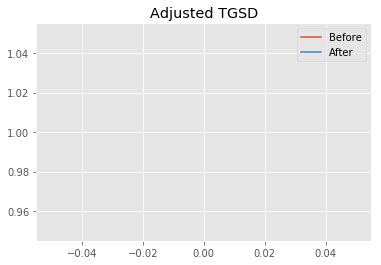

Old Total Mass: 3.87664e+08
New Total Mass: 3.87664e+08
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1 	2.03663 	14314.9 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 3.87664e+08
After: 		|1 	2.03663 	14205.2 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 78.0333
New Misfit: 77.2009
Convergence:
0.010666972570470758

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	3.88e+08 	5.15e+01 	6.43e+01 	1.2480 		1.0000


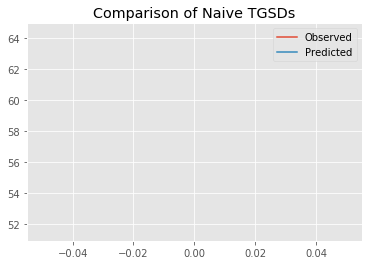

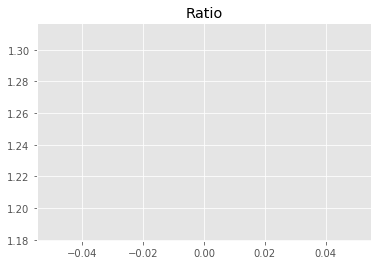

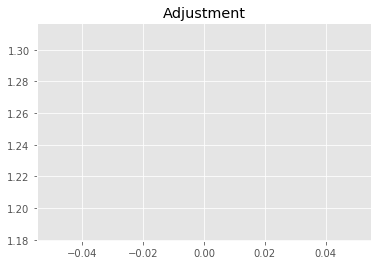

483818553.69362193
1


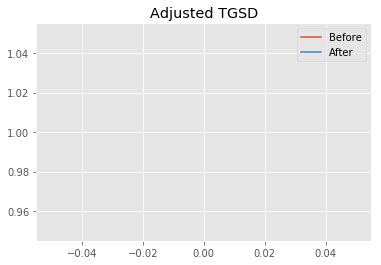

Old Total Mass: 3.87664e+08
New Total Mass: 3.87664e+08
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1 	2.03663 	14205.2 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 3.87664e+08
After: 		|1 	2.03663 	14090.2 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 77.2009
New Misfit: 76.3126
Convergence:
0.011507317295720933

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	3.88e+08 	5.19e+01 	6.43e+01 	1.2385 		1.0000


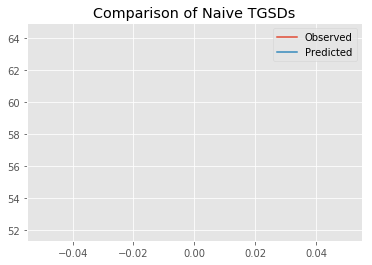

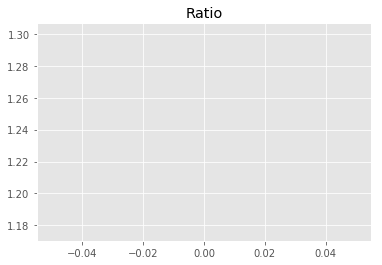

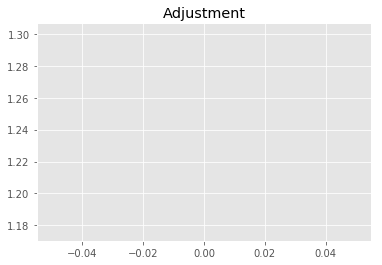

480109698.19427246
1


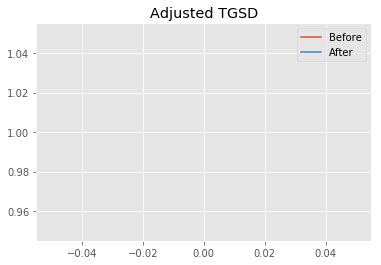

Old Total Mass: 3.87664e+08
New Total Mass: 3.87664e+08
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1 	2.03663 	14090.2 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 3.87664e+08
After: 		|1 	2.03663 	13969.5 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 76.3126
New Misfit: 75.364
Convergence:
0.01243068566176241

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	3.88e+08 	5.24e+01 	6.43e+01 	1.2282 		1.0000


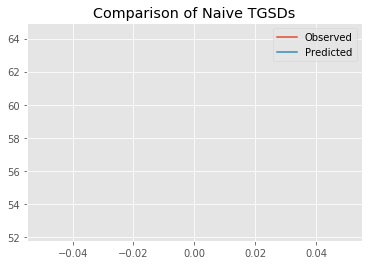

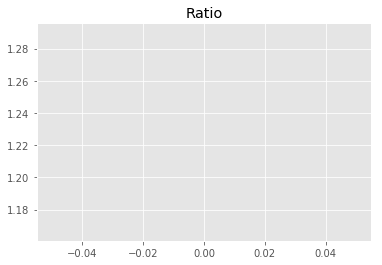

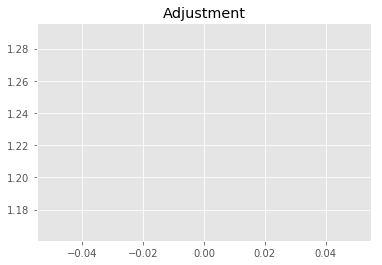

476112494.43320143
1


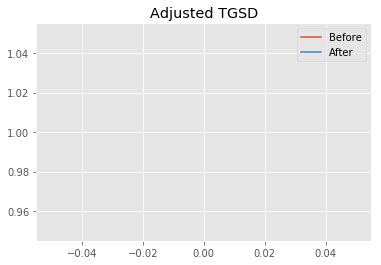

Old Total Mass: 3.87664e+08
New Total Mass: 3.87664e+08
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1 	2.03663 	13969.5 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 3.87664e+08
After: 		|1 	2.03663 	13843 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 75.364
New Misfit: 74.3506
Convergence:
0.013446276917502342

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	3.88e+08 	5.29e+01 	6.43e+01 	1.2170 		1.0000


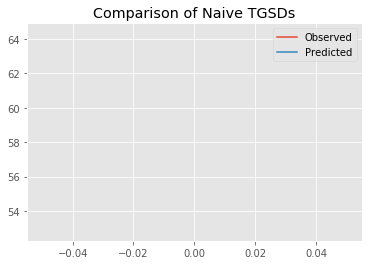

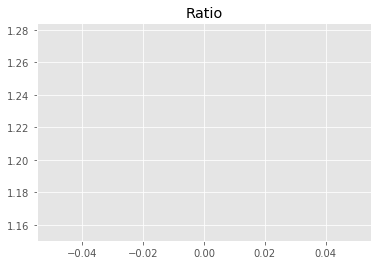

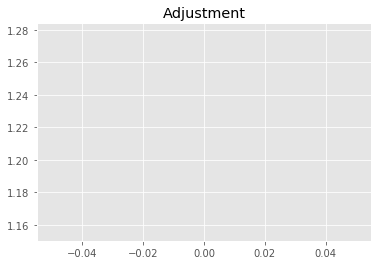

471798400.4483671
1


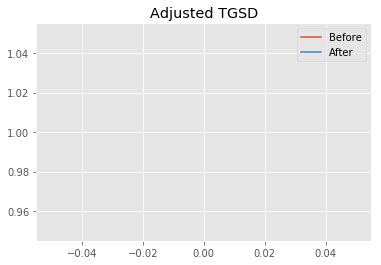

Old Total Mass: 3.87664e+08
New Total Mass: 3.87664e+08
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1 	2.03663 	13843 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 3.87664e+08
After: 		|1 	2.03663 	13710.3 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 74.3506
New Misfit: 73.2678
Convergence:
0.014563442463442109

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	3.88e+08 	5.34e+01 	6.43e+01 	1.2050 		1.0000


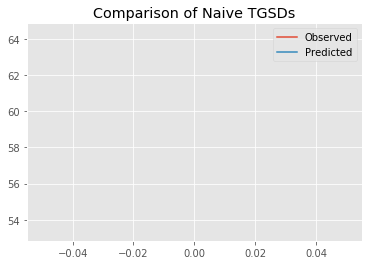

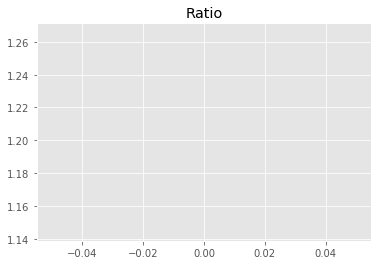

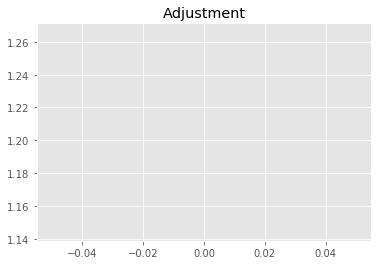

467135748.8750295
1


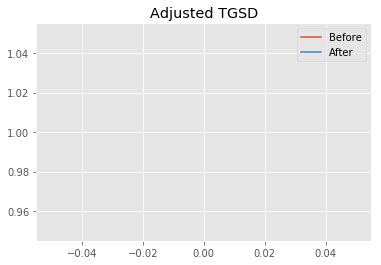

Old Total Mass: 3.87664e+08
New Total Mass: 3.87664e+08
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1 	2.03663 	13710.3 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 3.87664e+08
After: 		|1 	2.03663 	13571.3 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 73.2678
New Misfit: 72.1109
Convergence:
0.015789216058701358

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	3.88e+08 	5.40e+01 	6.43e+01 	1.1920 		1.0000


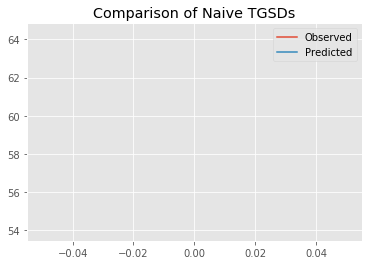

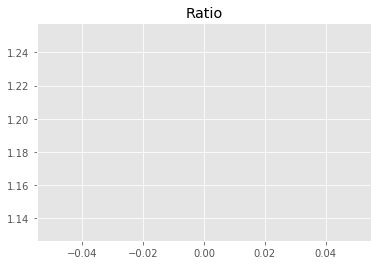

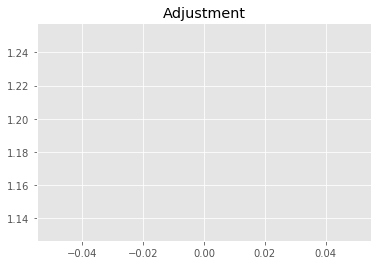

462090408.78459907
1


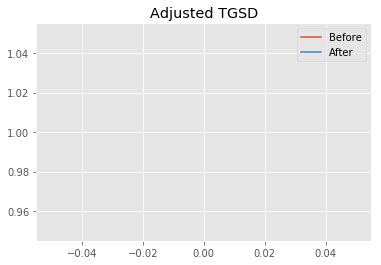

Old Total Mass: 3.87664e+08
New Total Mass: 3.87664e+08
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1 	2.03663 	13571.3 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 3.87664e+08
After: 		|1 	2.03663 	13425.5 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 72.1109
New Misfit: 70.0656
Convergence:
0.028363467199502147

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	3.88e+08 	5.51e+01 	6.43e+01 	1.1674 		1.0000


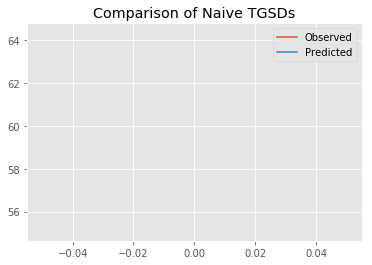

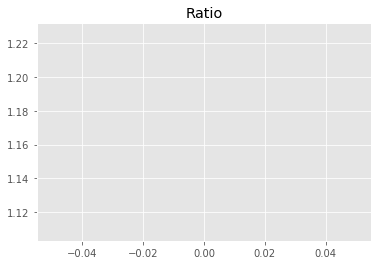

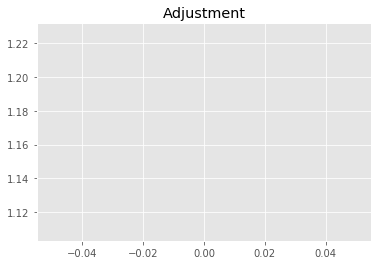

452558668.43874794
1


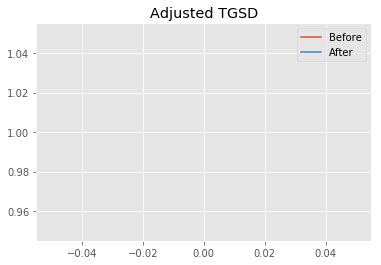

Old Total Mass: 3.87664e+08
New Total Mass: 3.87664e+08
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1 	2.03663 	13425.5 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 3.87664e+08
After: 		|1 	2.03663 	13272.7 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 70.0656
New Misfit: 69.05
Convergence:
0.014494836954186208

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	3.88e+08 	5.56e+01 	6.43e+01 	1.1559 		1.0000


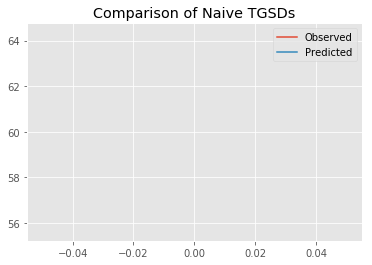

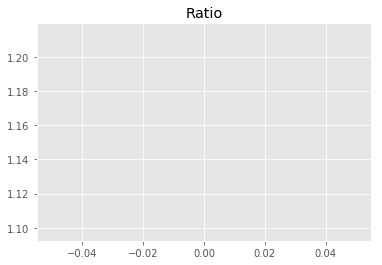

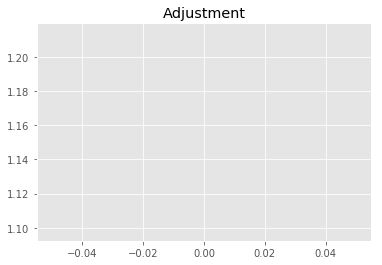

448110577.5256603
1


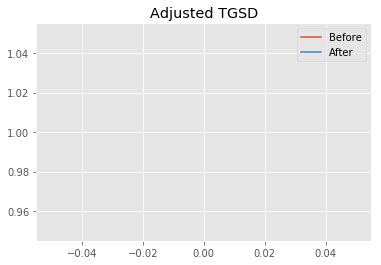

Old Total Mass: 3.87664e+08
New Total Mass: 3.87664e+08
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1 	2.03663 	13272.7 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 3.87664e+08
After: 		|1 	2.03663 	13112.6 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 69.05
New Misfit: 67.9581
Convergence:
0.015813673574643822

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	3.88e+08 	5.63e+01 	6.43e+01 	1.1434 		1.0000


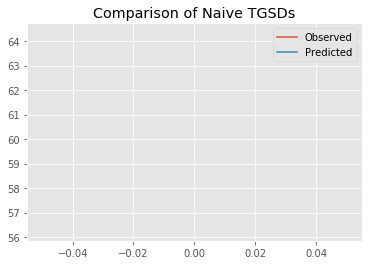

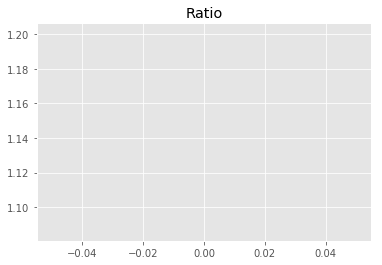

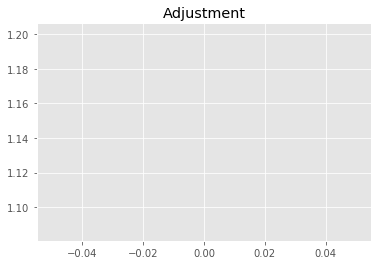

443256882.8813526
1


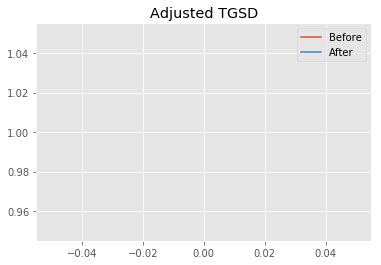

Old Total Mass: 3.87664e+08
New Total Mass: 3.87664e+08
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1 	2.03663 	13112.6 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 3.87664e+08
After: 		|1 	2.03663 	12944.9 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 67.9581
New Misfit: 66.7836
Convergence:
0.01728213630988335

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	3.88e+08 	5.69e+01 	6.43e+01 	1.1297 		1.0000


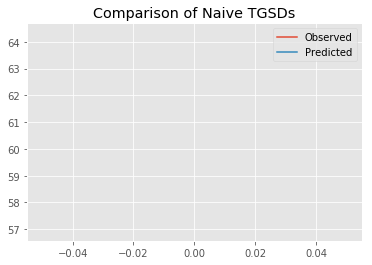

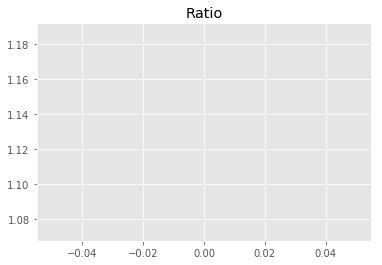

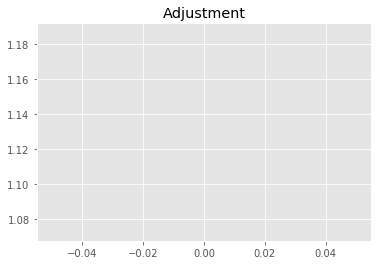

437947950.1434848
1


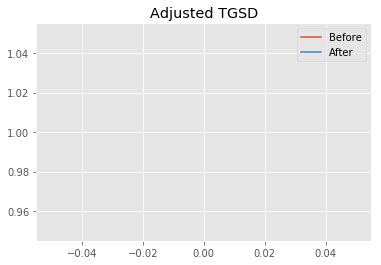

Old Total Mass: 3.87664e+08
New Total Mass: 3.87664e+08
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1 	2.03663 	12944.9 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 3.87664e+08
After: 		|1 	2.03663 	12769.3 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 66.7836
New Misfit: 65.5204
Convergence:
0.01891588105712339

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	3.88e+08 	5.77e+01 	6.43e+01 	1.1147 		1.0000


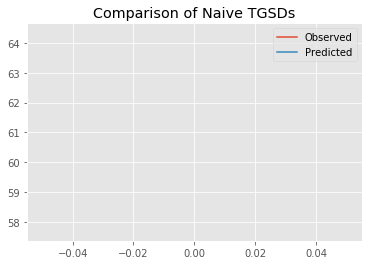

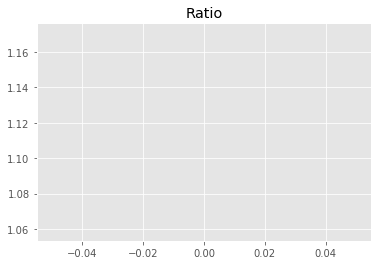

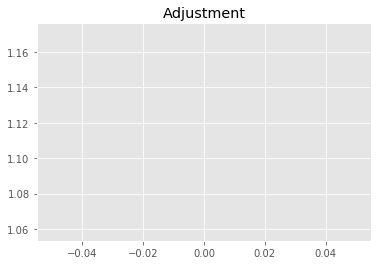

432126833.71546805
1


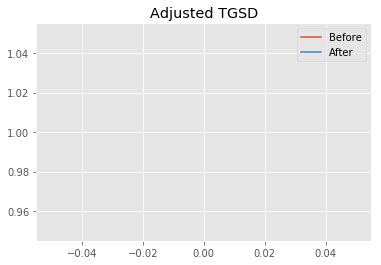

Old Total Mass: 3.87664e+08
New Total Mass: 3.87664e+08
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1 	2.03663 	12769.3 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 3.87664e+08
After: 		|1 	2.03663 	12585.5 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 65.5204
New Misfit: 64.1624
Convergence:
0.02072619753955222

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	3.88e+08 	5.86e+01 	6.43e+01 	1.0982 		1.0000


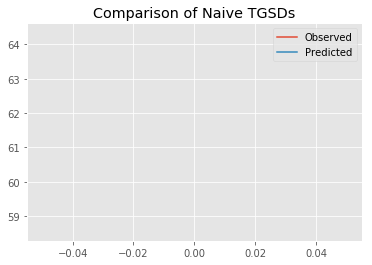

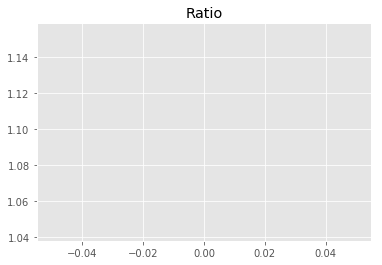

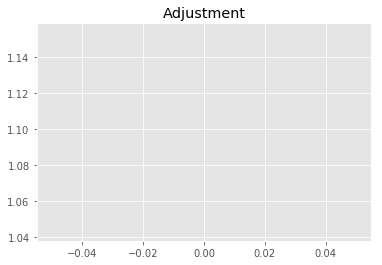

425729316.2433713
1


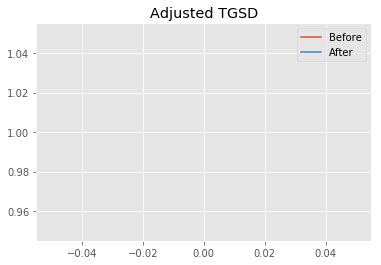

Old Total Mass: 3.87664e+08
New Total Mass: 3.87664e+08
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1 	2.03663 	12585.5 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 3.87664e+08
After: 		|1 	2.03663 	12393 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 64.1624
New Misfit: 61.857
Convergence:
0.035931198620668965

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	3.88e+08 	6.03e+01 	6.43e+01 	1.0675 		1.0000


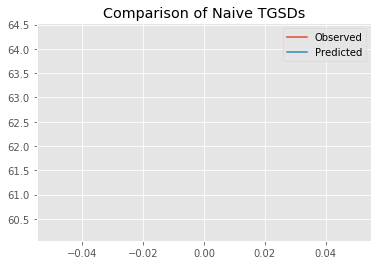

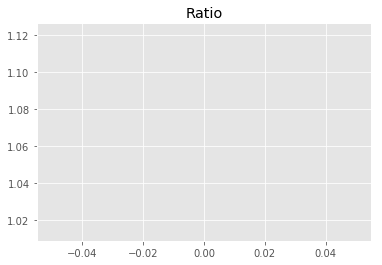

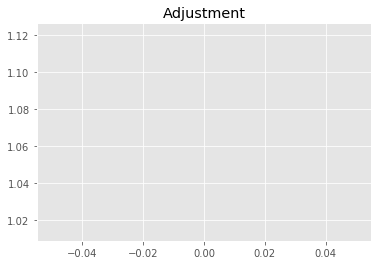

413842186.76085454
1


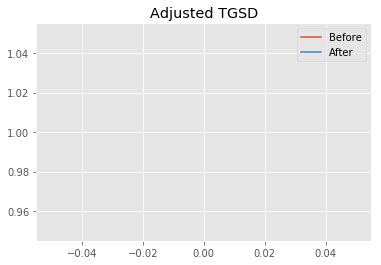

Old Total Mass: 3.87664e+08
New Total Mass: 3.87664e+08
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1 	2.03663 	12393 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 3.87664e+08
After: 		|1 	2.03663 	12191.7 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 61.857
New Misfit: 60.7042
Convergence:
0.01863584730081865

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	3.88e+08 	6.11e+01 	6.43e+01 	1.0533 		1.0000


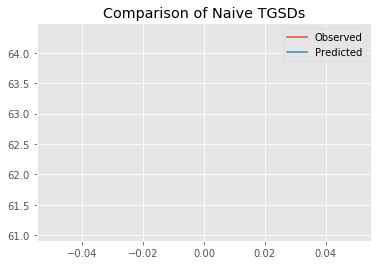

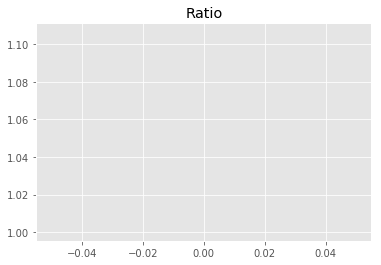

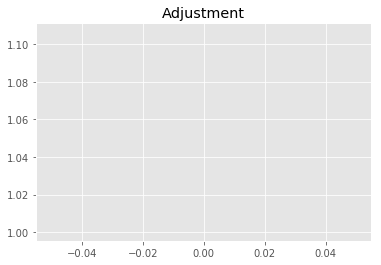

408318083.46372765
1


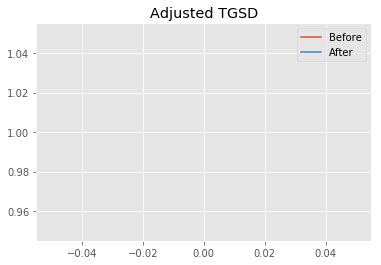

Old Total Mass: 3.87664e+08
New Total Mass: 3.87664e+08
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1 	2.03663 	12191.7 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 3.87664e+08
After: 		|1 	2.03663 	11981.1 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 60.7042
New Misfit: 59.4554
Convergence:
0.02057171120961966

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	3.88e+08 	6.20e+01 	6.43e+01 	1.0374 		1.0000


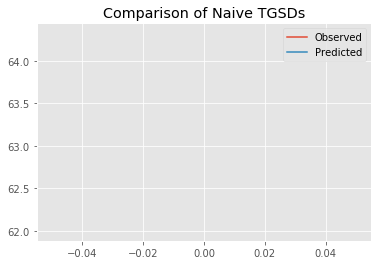

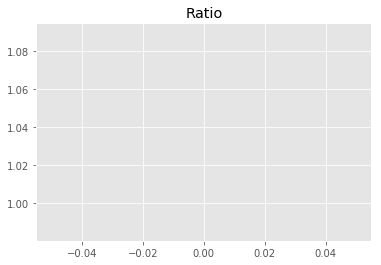

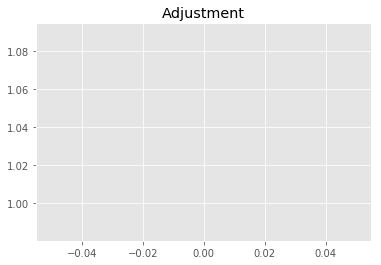

402167843.33227646
1


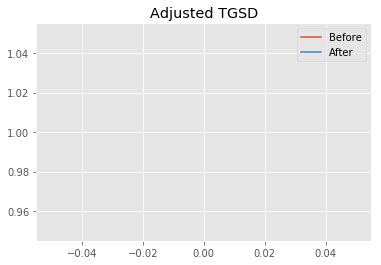

Old Total Mass: 3.87664e+08
New Total Mass: 3.87664e+08
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1 	2.03663 	11981.1 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 3.87664e+08
After: 		|1 	2.03663 	11761 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 59.4554
New Misfit: 58.104
Convergence:
0.022730330262210514

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	3.88e+08 	6.31e+01 	6.43e+01 	1.0197 		1.0000


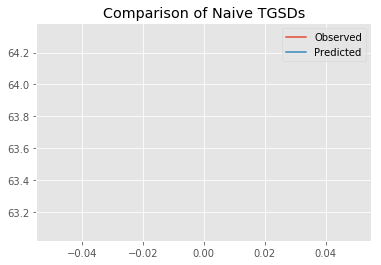

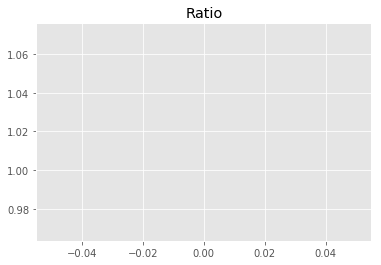

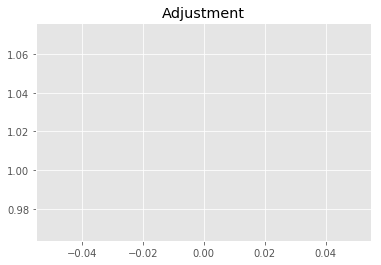

395292556.941851
1


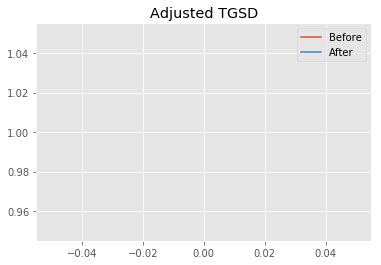

Old Total Mass: 3.87664e+08
New Total Mass: 3.87664e+08
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1 	2.03663 	11761 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 3.87664e+08
After: 		|1 	2.03663 	11531 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 58.104
New Misfit: 56.6453
Convergence:
0.025105185416175513

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	3.88e+08 	6.43e+01 	6.43e+01 	0.9998 		1.0000


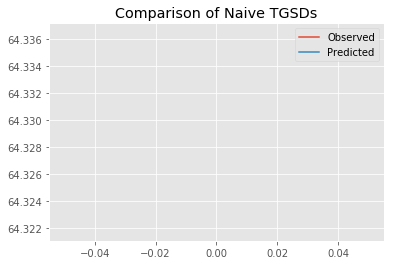

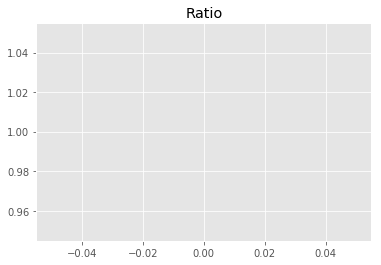

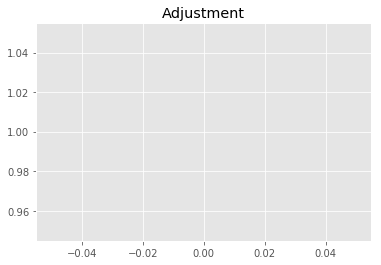

387576399.49855316
1


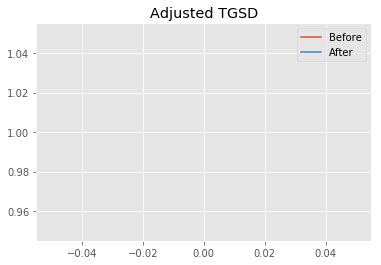

Old Total Mass: 3.87664e+08
New Total Mass: 3.87664e+08
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1 	2.03663 	11531 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 3.87664e+08
After: 		|1 	2.03663 	11290.7 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 56.6453
New Misfit: 54.371
Convergence:
0.040148687321135655

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	3.88e+08 	6.67e+01 	6.43e+01 	0.9645 		1.0000


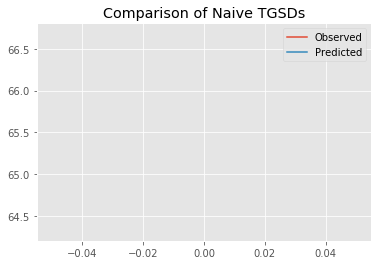

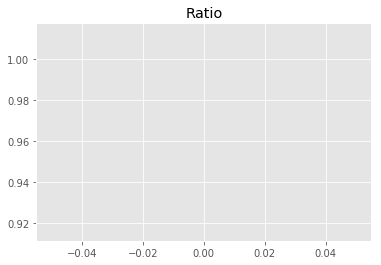

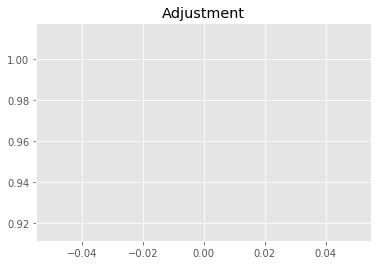

373919202.8612334
1


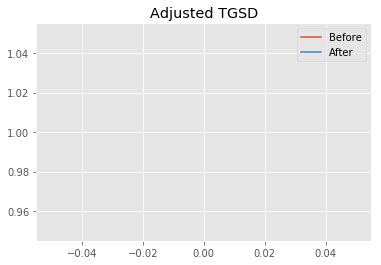

Old Total Mass: 3.87664e+08
New Total Mass: 3.87664e+08
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1 	2.03663 	11290.7 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 3.87664e+08
After: 		|1 	2.03663 	11040 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 54.371
New Misfit: 53.1938
Convergence:
0.0216512822328042

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	3.88e+08 	6.79e+01 	6.43e+01 	0.9478 		1.0000


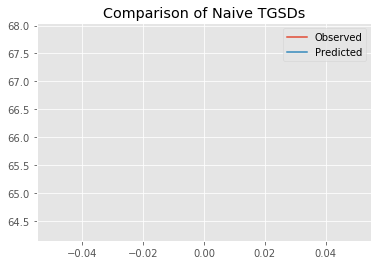

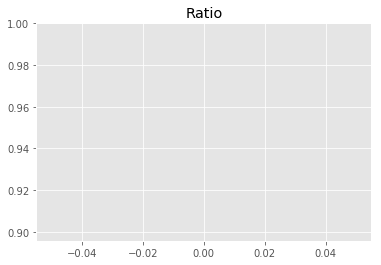

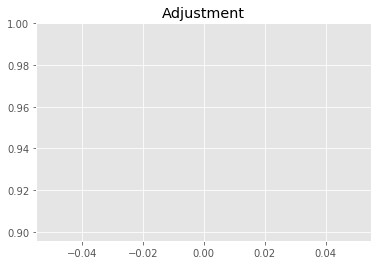

367439762.20587474
1


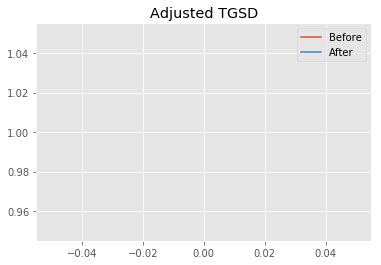

Old Total Mass: 3.87664e+08
New Total Mass: 3.87664e+08
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1 	2.03663 	11040 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 3.87664e+08
After: 		|1 	2.03663 	10778.5 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 53.1938
New Misfit: 51.9141
Convergence:
0.024057806608977196

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	3.88e+08 	6.93e+01 	6.43e+01 	0.9287 		1.0000


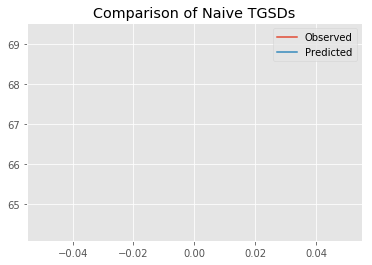

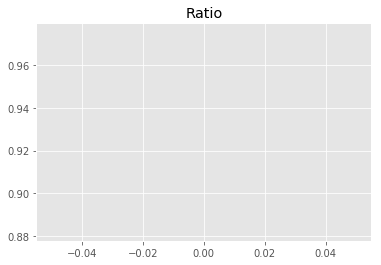

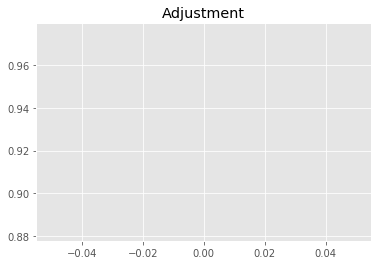

360013483.5528004
1


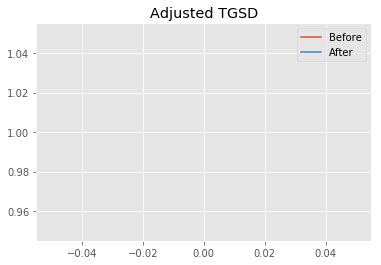

Old Total Mass: 3.87664e+08
New Total Mass: 3.87664e+08
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1 	2.03663 	10778.5 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 3.87664e+08
After: 		|1 	2.03663 	10506 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 51.9141
New Misfit: 50.5333
Convergence:
0.02659783835181482

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	3.88e+08 	7.10e+01 	6.43e+01 	0.9066 		1.0000


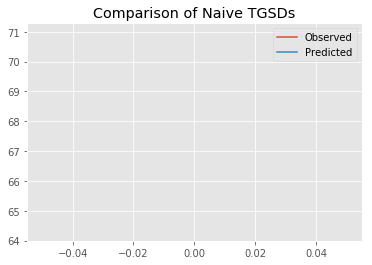

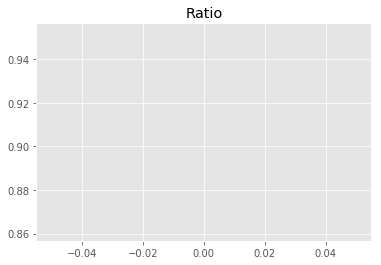

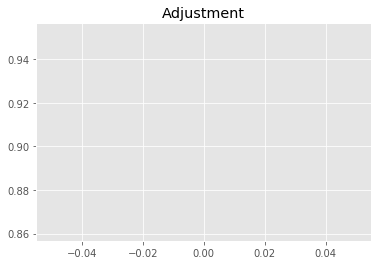

351443401.6787061
1


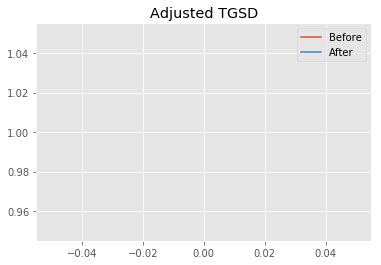

Old Total Mass: 3.87664e+08
New Total Mass: 3.87664e+08
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1 	2.03663 	10506 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 3.87664e+08
After: 		|1 	2.03663 	10222.1 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 50.5333
New Misfit: 48.4924
Convergence:
0.04038674260848918

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	3.88e+08 	7.42e+01 	6.43e+01 	0.8664 		1.0000


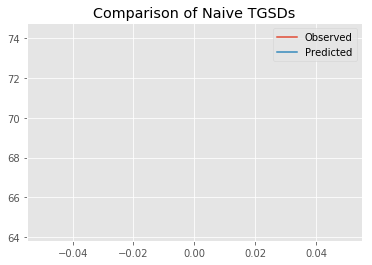

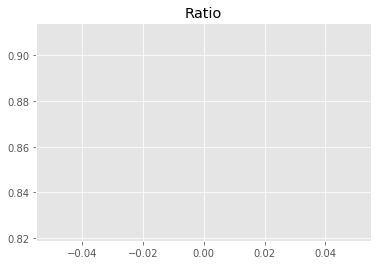

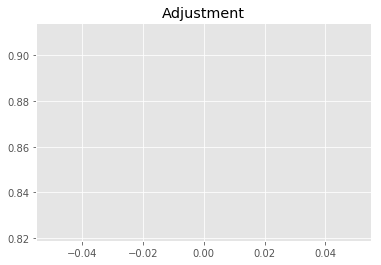

335874357.0799712
1


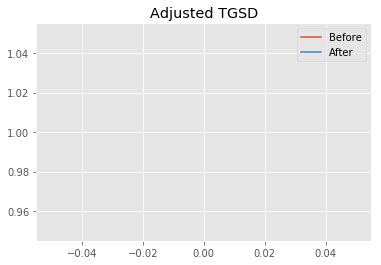

Old Total Mass: 3.87664e+08
New Total Mass: 3.87664e+08
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1 	2.03663 	10222.1 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 3.87664e+08
After: 		|1 	2.03663 	9926.84 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 48.4924
New Misfit: 47.4715
Convergence:
0.021053802565113598

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	3.88e+08 	7.58e+01 	6.43e+01 	0.8487 		1.0000


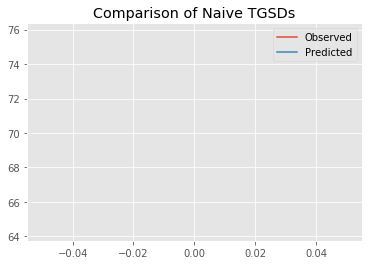

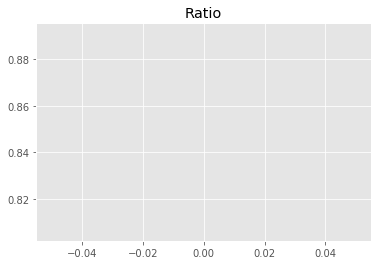

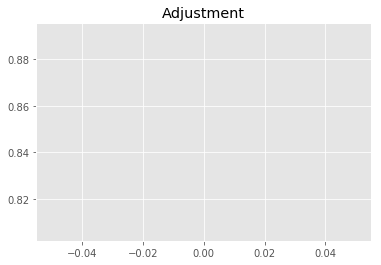

329020472.5137263
1


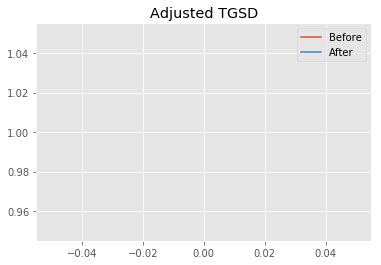

Old Total Mass: 3.87664e+08
New Total Mass: 3.87664e+08
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1 	2.03663 	9926.84 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 3.87664e+08
After: 		|1 	2.03663 	9619.95 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 47.4715
New Misfit: 46.372
Convergence:
0.023160487384534235

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	3.88e+08 	7.77e+01 	6.43e+01 	0.8276 		1.0000


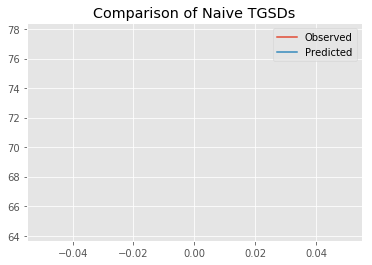

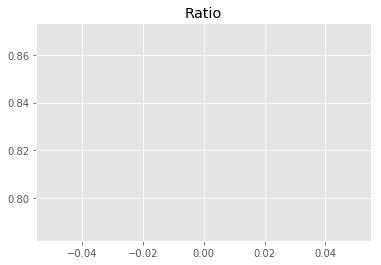

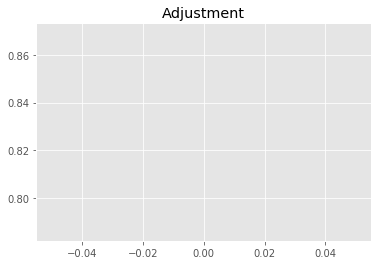

320838053.03126836
1


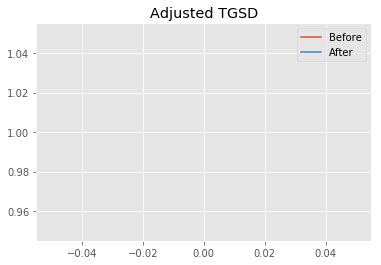

Old Total Mass: 3.87664e+08
New Total Mass: 3.87664e+08
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1 	2.03663 	9619.95 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 3.87664e+08
After: 		|1 	2.03663 	9301.37 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 46.372
New Misfit: 44.6895
Convergence:
0.03628241294949828

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	3.88e+08 	8.26e+01 	6.43e+01 	0.7786 		1.0000


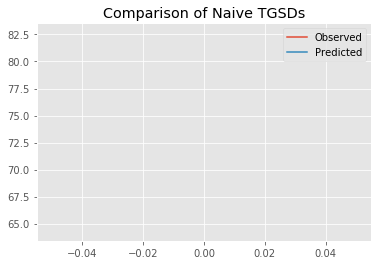

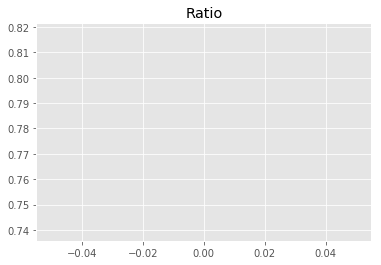

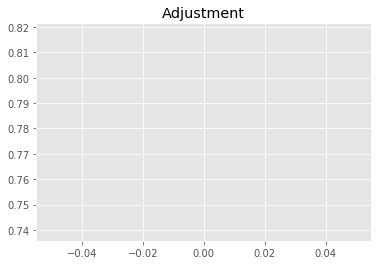

301826849.3106559
1


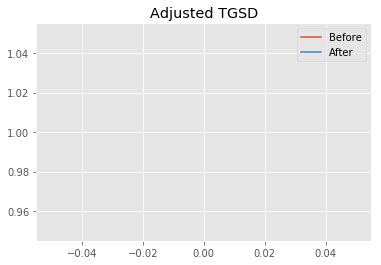

Old Total Mass: 3.87664e+08
New Total Mass: 3.87664e+08
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1 	2.03663 	9301.37 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 3.87664e+08
After: 		|1 	2.03663 	8971.11 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 44.6895
New Misfit: 43.9933
Convergence:
0.015579461460102747

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	3.88e+08 	8.43e+01 	6.43e+01 	0.7634 		1.0000


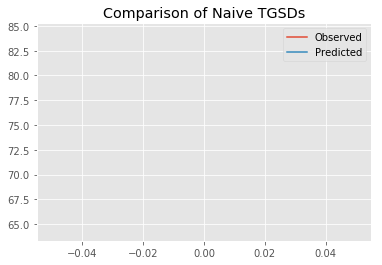

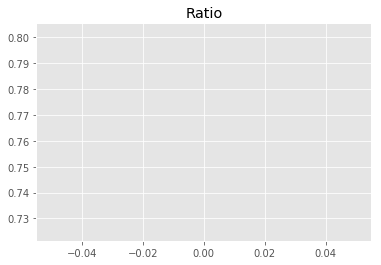

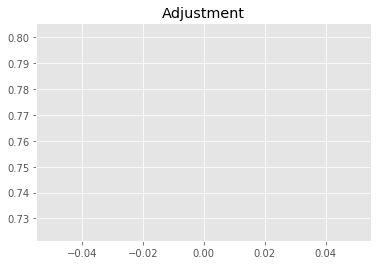

295927812.5038197
1


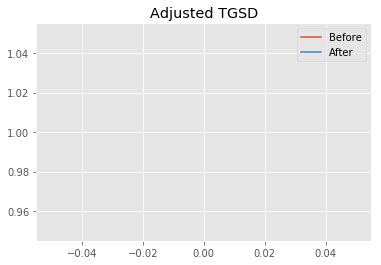

Old Total Mass: 3.87664e+08
New Total Mass: 3.87664e+08
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1 	2.03663 	8971.11 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 3.87664e+08
After: 		|1 	2.03663 	8629.23 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 43.9933
New Misfit: 43.2607
Convergence:
0.016652178893317406

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	3.88e+08 	8.64e+01 	6.43e+01 	0.7442 		1.0000


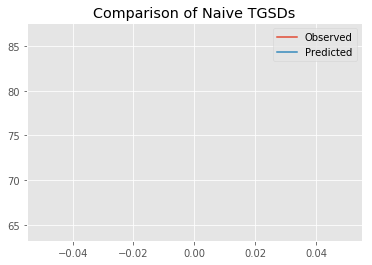

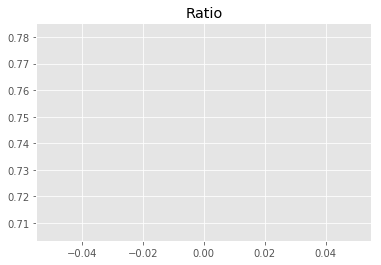

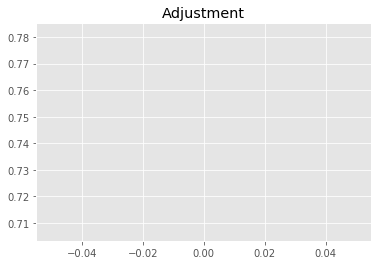

288506339.7731479
1


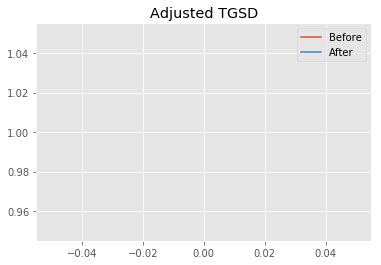

Old Total Mass: 3.87664e+08
New Total Mass: 3.87664e+08
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1 	2.03663 	8629.23 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 3.87664e+08
After: 		|1 	2.03663 	8275.91 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 43.2607
New Misfit: 42.5474
Convergence:
0.016488436372800112

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	3.88e+08 	9.33e+01 	6.43e+01 	0.6896 		1.0000


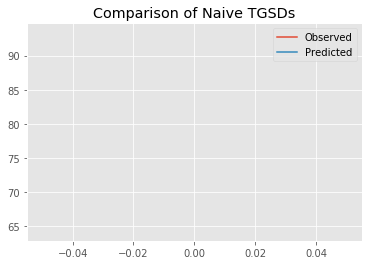

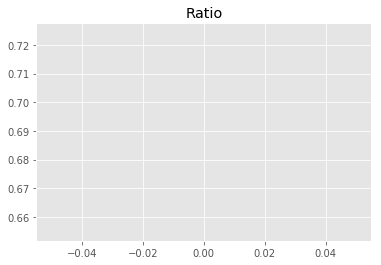

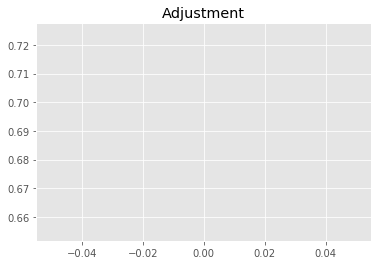

267326268.4660069
1


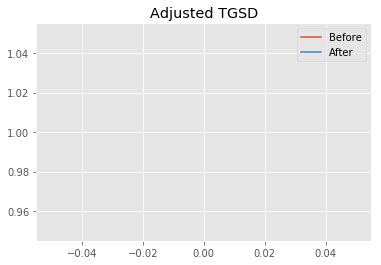

Old Total Mass: 3.87664e+08
New Total Mass: 3.87664e+08
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1 	2.03663 	8275.91 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 3.87664e+08
After: 		|1 	2.03663 	7911.45 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 42.5474
New Misfit: 42.172
Convergence:
0.00882183623502228

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	3.88e+08 	9.48e+01 	6.43e+01 	0.6782 		1.0000


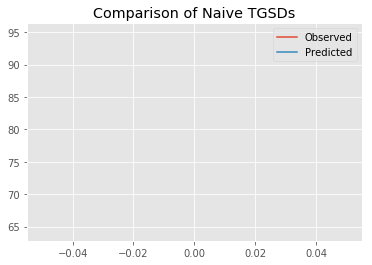

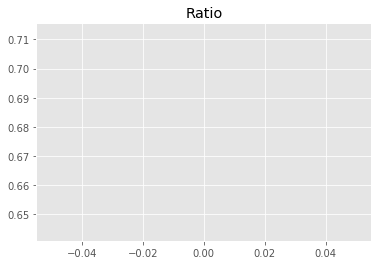

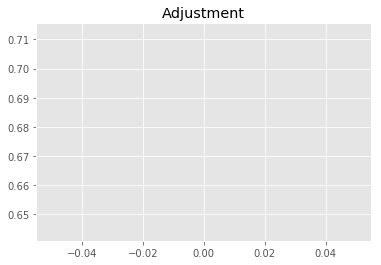

262913955.994372
1


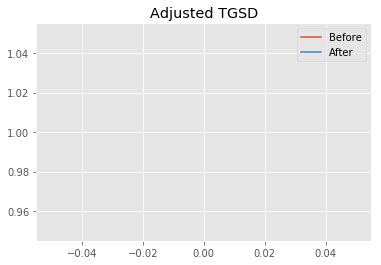

Old Total Mass: 3.87664e+08
New Total Mass: 3.87664e+08
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1 	2.03663 	7911.45 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 3.87664e+08
After: 		|1 	2.03663 	7536.3 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 42.172
New Misfit: 41.8108
Convergence:
0.008566897624896992

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	3.88e+08 	9.71e+01 	6.43e+01 	0.6625 		1.0000


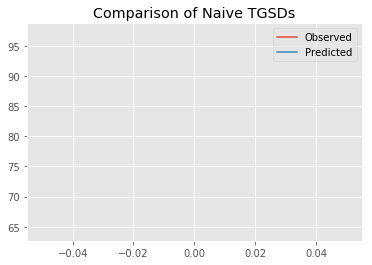

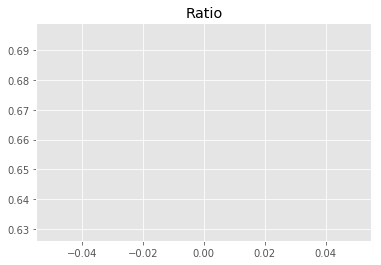

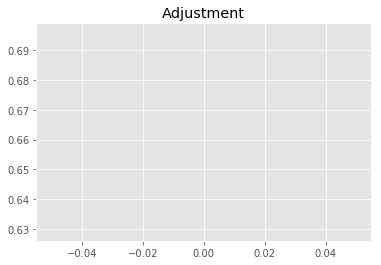

256837864.40166333
1


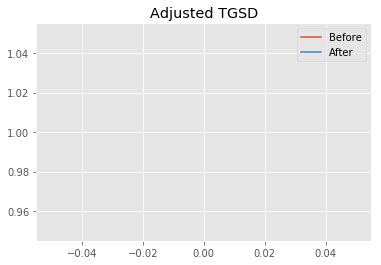

Old Total Mass: 3.87664e+08
New Total Mass: 3.87664e+08
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1 	2.03663 	7536.3 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 3.87664e+08
After: 		|1 	2.03694 	7342.54 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 41.8108
New Misfit: 41.6715
Convergence:
0.003329638002802202

____________________
a = 1.00000	b = 2.03694	            h1 = 7342.53878	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 387664367.47453
Success: True
Status: Successful convergence.
Iterations: 38
Misfit: 41.67154913216016
Prior Misfit: 124.572,	 Post Misfit: 41.6715


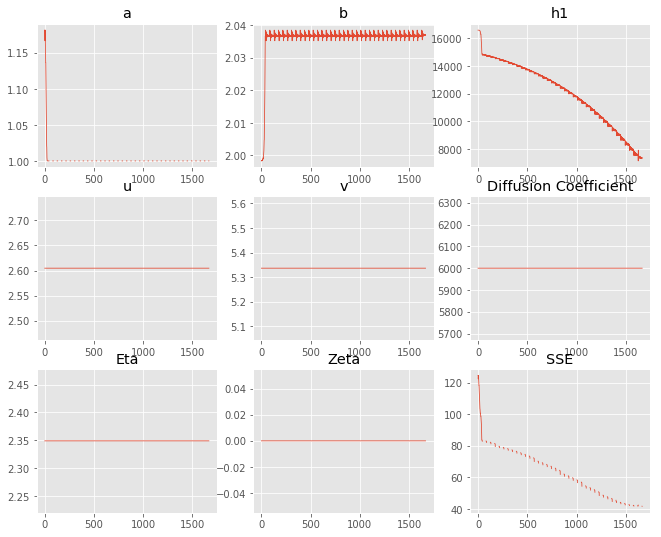

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,1.18156,1
b,1.99839,2.03694
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"16,590.8","7,342.54"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 5 Time: 0.775 minutes


Estimated remaining run time: 2.279 minutes


Run 5===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	3.88e+08 	8.12e+01 	6.43e+01 	0.7918 		1.0000


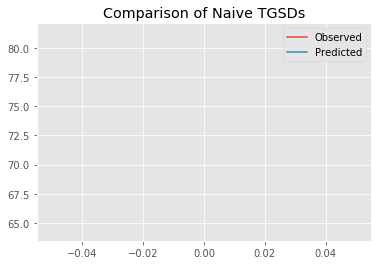

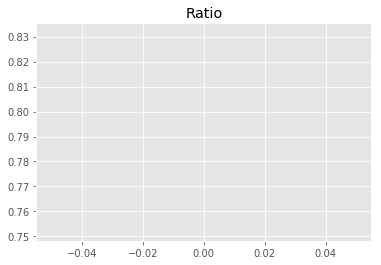

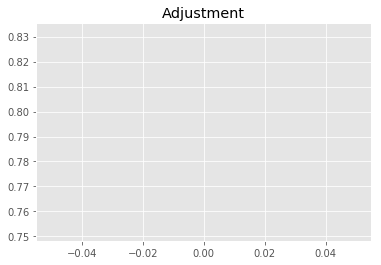

306942251.707146
1


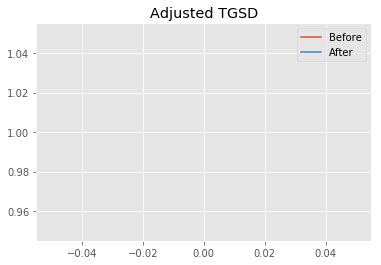

Old Total Mass: 3.87664e+08
New Total Mass: 3.87664e+08
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.16189 	2.74338 	8691.59 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 3.87664e+08
After: 		|2.139 	2.75921 	6226.84 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 48.1384
New Misfit: 41.848
Convergence:
0.1306729664214344

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	3.88e+08 	1.10e+02 	6.43e+01 	0.5867 		1.0000


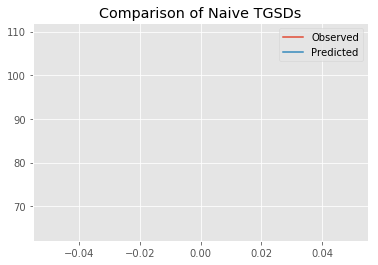

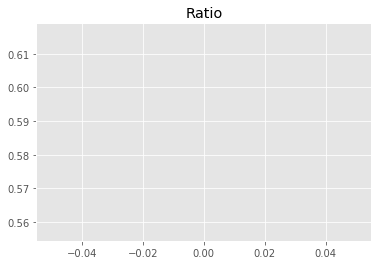

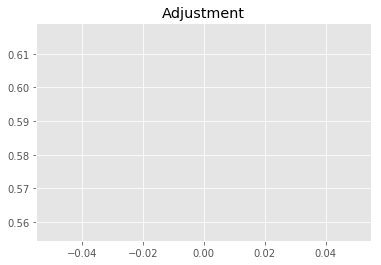

227453461.00885046
1


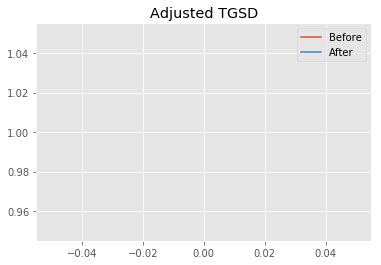

Old Total Mass: 3.87664e+08
New Total Mass: 3.87664e+08
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.139 	2.75921 	6226.84 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 3.87664e+08
After: 		|2.13153 	2.93748 	6230.6 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 41.848
New Misfit: 41.8363
Convergence:
0.0002794979304284125

____________________
a = 2.13153	b = 2.93748	            h1 = 6230.60498	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 387664367.47453
Success: True
Status: Successful convergence.
Iterations: 2
Misfit: 41.836339345392076
Prior Misfit: 48.1384,	 Post Misfit: 41.8363


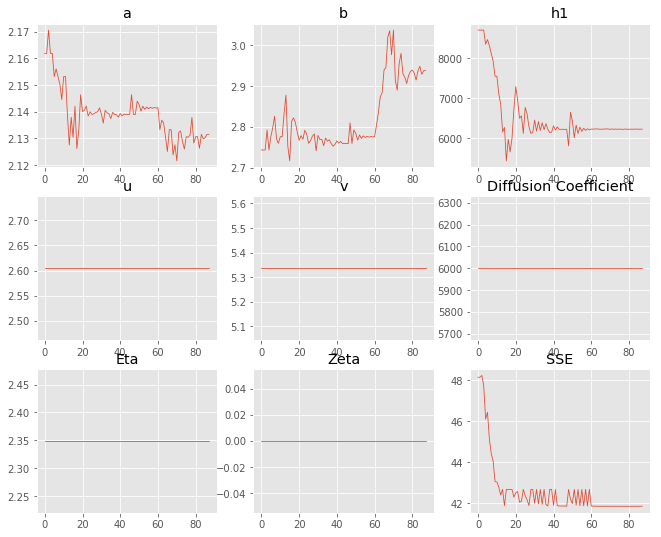

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,2.16189,2.13153
b,2.74338,2.93748
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"8,691.59","6,230.6"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 6 Time: 0.052 minutes


Estimated remaining run time: 1.910 minutes


Run 6===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	3.88e+08 	1.16e+02 	6.43e+01 	0.5523 		1.0000


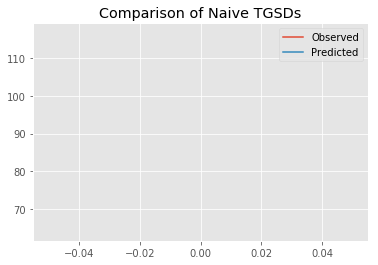

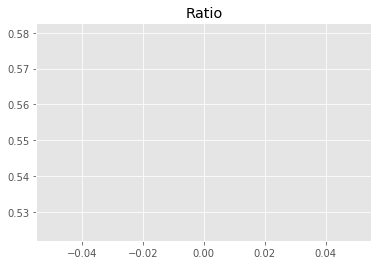

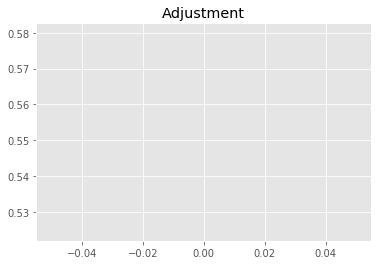

214088127.75297847
1


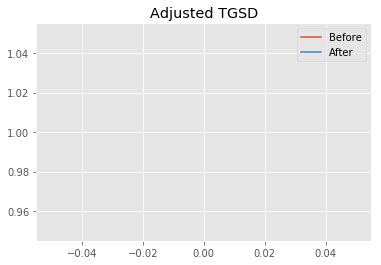

Old Total Mass: 3.87664e+08
New Total Mass: 3.87664e+08
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.07004 	4.72584 	5247.84 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Optimization terminated successfully.
         Current function value: 42.660640
         Iterations: 11
         Function evaluations: 54
New Total Mass: 3.87664e+08
After: 		|2.07004 	4.72584 	5247.84 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 42.6606
New Misfit: 42.6606
Convergence:
1.6655698093334067e-16

____________________
a = 2.07004	b = 4.72584	            h1 = 5247.84023	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 387664367.47453
Success: True
Status: Successful convergence.
Iterations: 1
Misfit: 42.66063972692164
Prior Misfit: 42.6606,	 Post Misfit: 42.6606


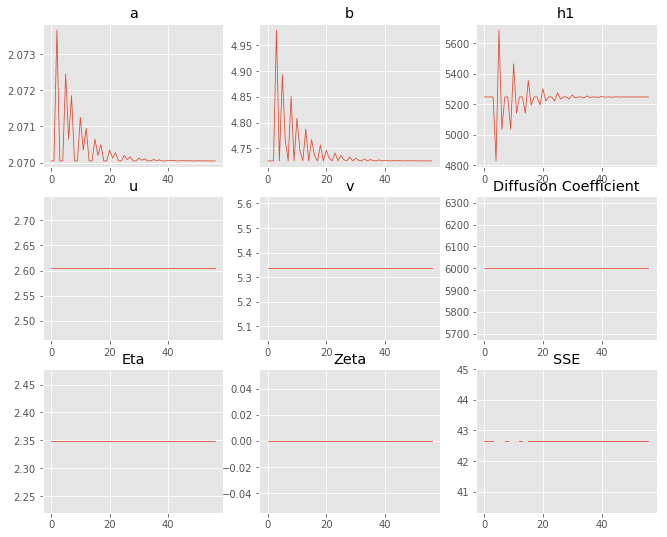

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,2.07004,2.07004
b,4.72584,4.72584
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"5,247.84","5,247.84"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 7 Time: 0.034 minutes


Estimated remaining run time: 1.593 minutes


Run 7===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	3.88e+08 	9.99e+01 	6.43e+01 	0.6437 		1.0000


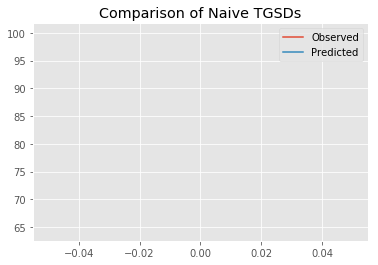

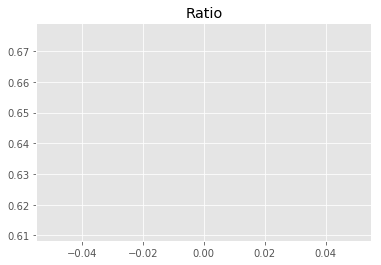

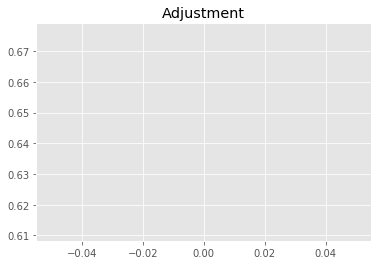

249527627.46926174
1


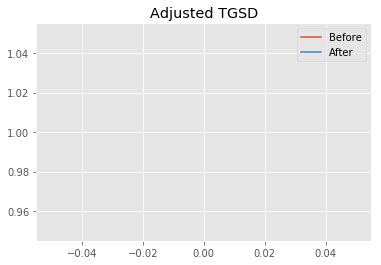

Old Total Mass: 3.87664e+08
New Total Mass: 3.87664e+08
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.02726 	2.12644 	6767.88 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Optimization terminated successfully.
         Current function value: 42.660640
         Iterations: 15
         Function evaluations: 56
New Total Mass: 3.87664e+08
After: 		|2.95688 	2.13767 	6103.44 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 45.1393
New Misfit: 42.6606
Convergence:
0.0549123531609284

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	3.88e+08 	1.16e+02 	6.43e+01 	0.5523 		1.0000


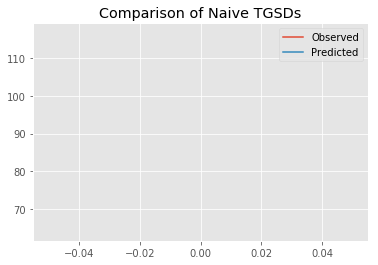

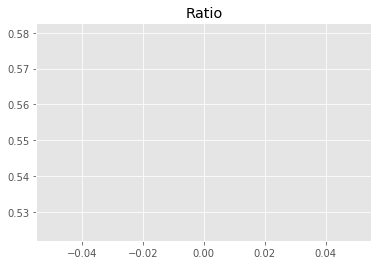

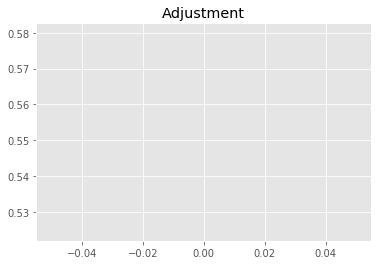

214088127.75297847
1


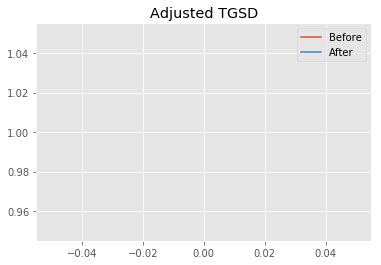

Old Total Mass: 3.87664e+08
New Total Mass: 3.87664e+08
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.95688 	2.13767 	6103.44 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Optimization terminated successfully.
         Current function value: 42.660640
         Iterations: 10
         Function evaluations: 49
New Total Mass: 3.87664e+08
After: 		|2.95688 	2.13767 	6103.44 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 42.6606
New Misfit: 42.6606
Convergence:
1.6655698093334067e-16

____________________
a = 2.95688	b = 2.13767	            h1 = 6103.43946	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 387664367.47453
Success: True
Status: Successful convergence.
Iterations: 2
Misfit: 42.66063972692164
Prior Misfit: 45.1393,	 Post Misfit: 42.6606


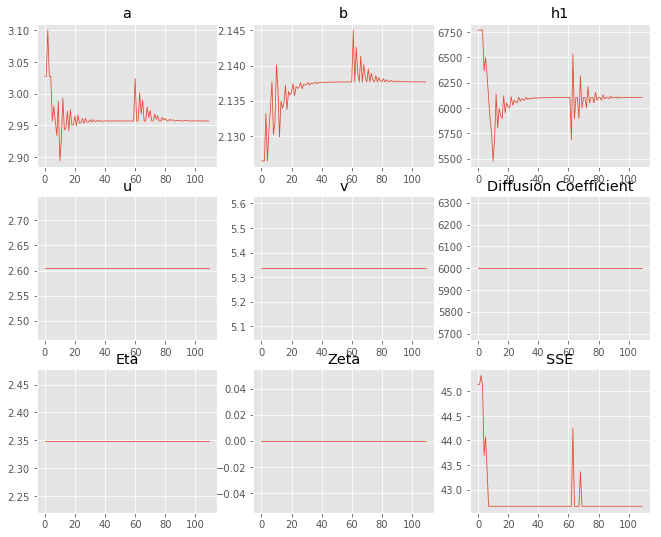

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,3.02726,2.95688
b,2.12644,2.13767
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"6,767.88","6,103.44"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 8 Time: 0.057 minutes


Estimated remaining run time: 1.368 minutes


Run 8===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	3.88e+08 	1.16e+02 	6.43e+01 	0.5523 		1.0000


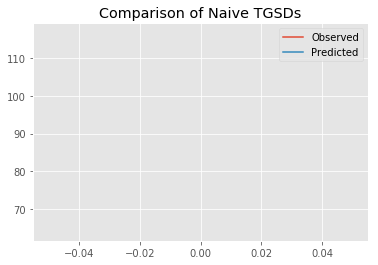

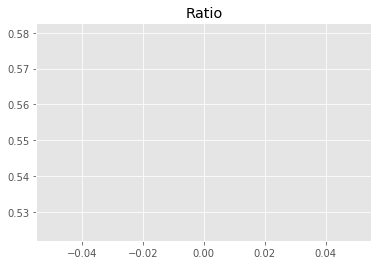

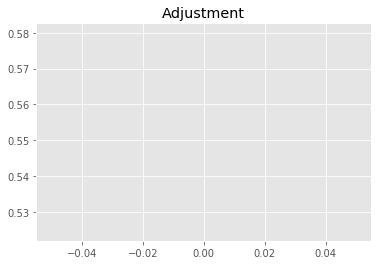

214088127.75297847
1


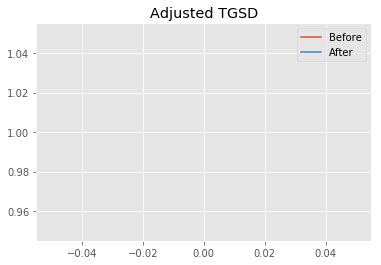

Old Total Mass: 3.87664e+08
New Total Mass: 3.87664e+08
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.191 	4.2945 	5798.4 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 3.87664e+08
After: 		|1.15486 	7.97937 	13936.1 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 42.6606
New Misfit: 40.165
Convergence:
0.05849913184739235

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	3.88e+08 	9.58e+01 	6.43e+01 	0.6716 		1.0000


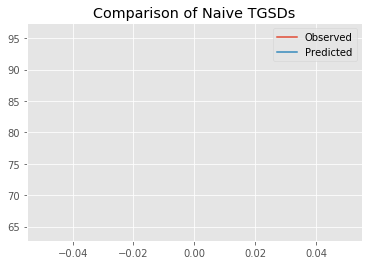

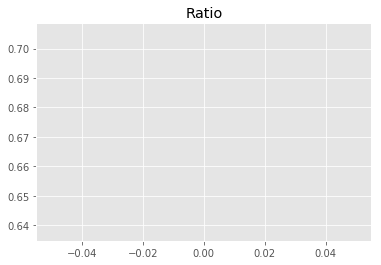

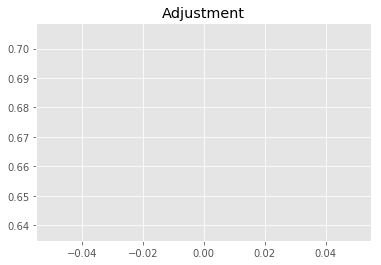

260360240.44847763
1


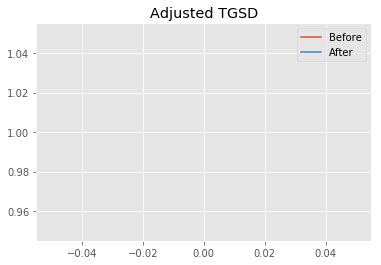

Old Total Mass: 3.87664e+08
New Total Mass: 3.87664e+08
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.15486 	7.97937 	13936.1 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 3.87664e+08
After: 		|1.00001 	15.788 	24430.8 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 40.165
New Misfit: 39.7176
Convergence:
0.011140972302809958

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	3.88e+08 	9.45e+01 	6.43e+01 	0.6805 		1.0000


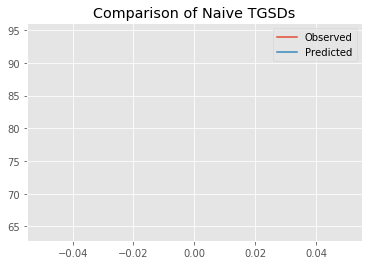

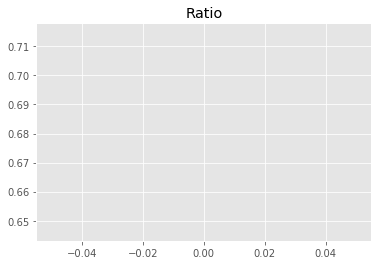

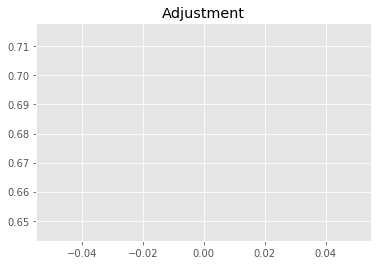

263803741.20523396
1


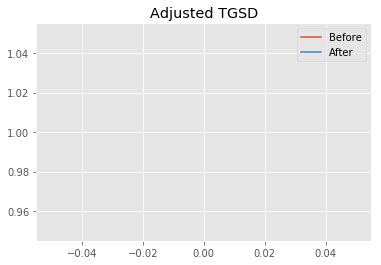

Old Total Mass: 3.87664e+08
New Total Mass: 3.87664e+08
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.00001 	15.788 	24430.8 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 3.87664e+08
After: 		|1.0166 	22.84 	31478.8 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 39.7176
New Misfit: 39.6408
Convergence:
0.0019314786990165128

____________________
a = 1.01660	b = 22.84001	            h1 = 31478.79498	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 387664367.47453
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 39.640838254043146
Prior Misfit: 42.6606,	 Post Misfit: 39.6408


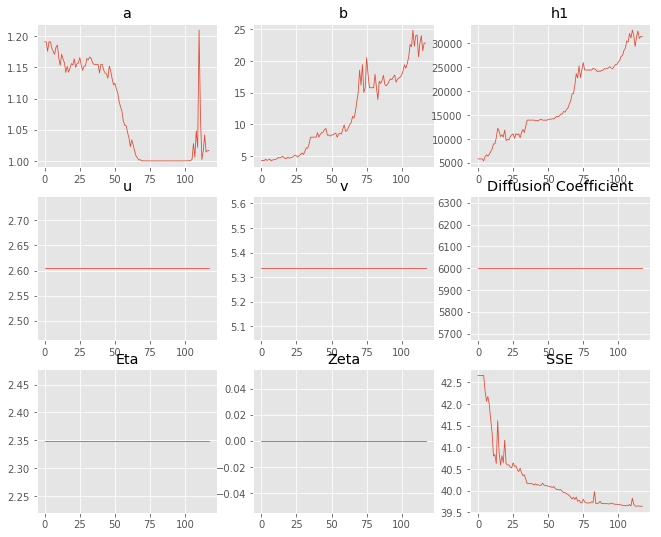

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,1.191,1.0166
b,4.2945,22.84
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"5,798.4","31,478.8"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 9 Time: 0.066 minutes


Estimated remaining run time: 1.185 minutes


Run 9===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	3.88e+08 	7.20e+01 	6.43e+01 	0.8937 		1.0000


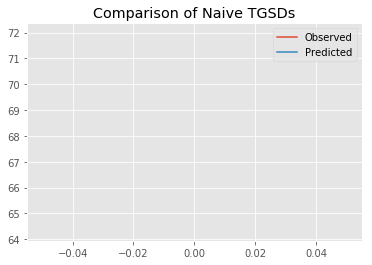

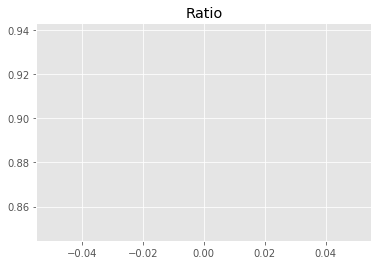

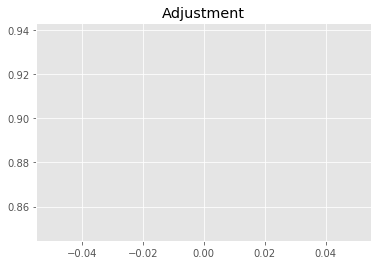

346460413.6649301
1


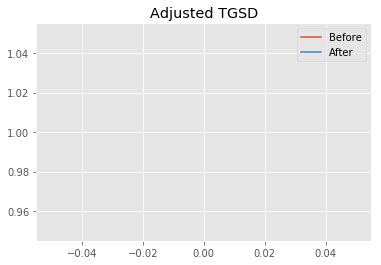

Old Total Mass: 3.87664e+08
New Total Mass: 3.87664e+08
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.83688 	2.9674 	10372.2 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 3.87664e+08
After: 		|1.89643 	3.13024 	7269.76 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 53.0531
New Misfit: 41.7361
Convergence:
0.21331379548608845

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	3.88e+08 	1.03e+02 	6.43e+01 	0.6266 		1.0000


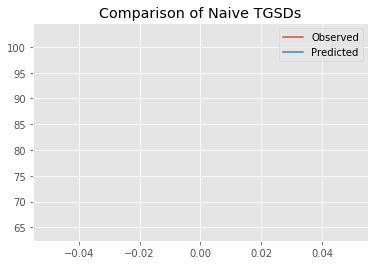

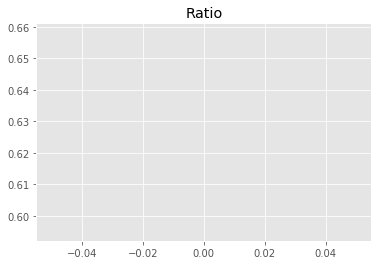

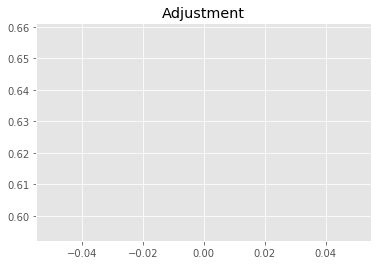

242916579.19744492
1


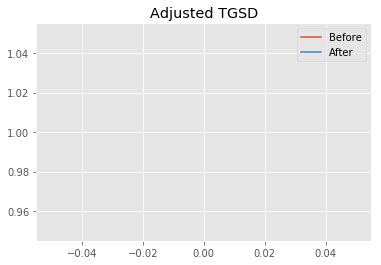

Old Total Mass: 3.87664e+08
New Total Mass: 3.87664e+08
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.89643 	3.13024 	7269.76 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 3.87664e+08
After: 		|1.97902 	5.98925 	8863.08 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 41.7361
New Misfit: 41.134
Convergence:
0.014426701211444898

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	3.88e+08 	1.04e+02 	6.43e+01 	0.6186 		1.0000


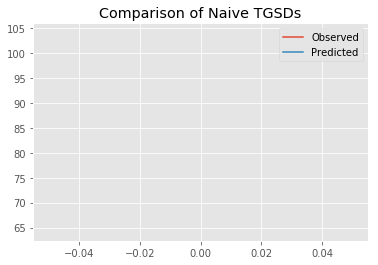

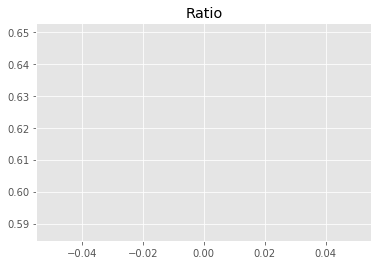

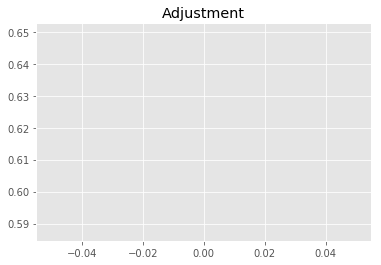

239818513.63320985
1


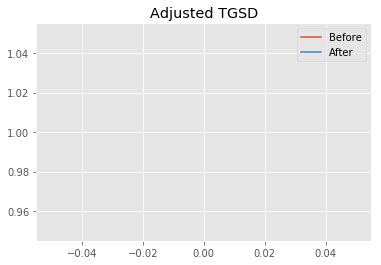

Old Total Mass: 3.87664e+08
New Total Mass: 3.87664e+08
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.97902 	5.98925 	8863.08 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 3.87664e+08
After: 		|1.96685 	15.4096 	16197.4 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 41.134
New Misfit: 40.4778
Convergence:
0.015954096553573736

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	3.88e+08 	1.00e+02 	6.43e+01 	0.6412 		1.0000


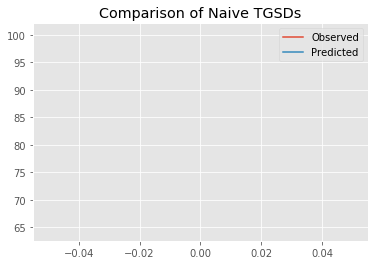

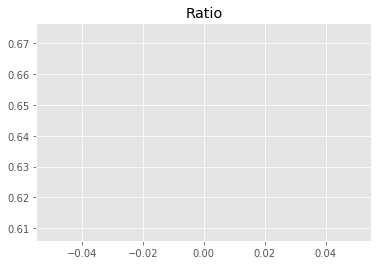

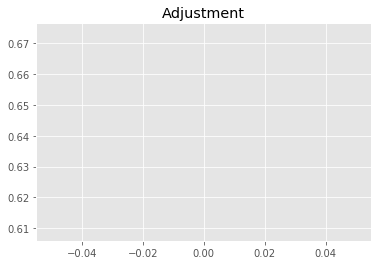

248557084.00032502
1


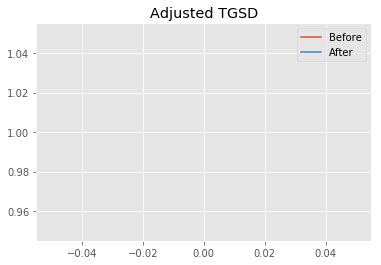

Old Total Mass: 3.87664e+08
New Total Mass: 3.87664e+08
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.96685 	15.4096 	16197.4 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 3.87664e+08
After: 		|1.78493 	17.0377 	18537.2 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 40.4778
New Misfit: 40.3105
Convergence:
0.004132681576339851

____________________
a = 1.78493	b = 17.03768	            h1 = 18537.18991	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 387664367.47453
Success: True
Status: Successful convergence.
Iterations: 4
Misfit: 40.31049358421965
Prior Misfit: 53.0531,	 Post Misfit: 40.3105


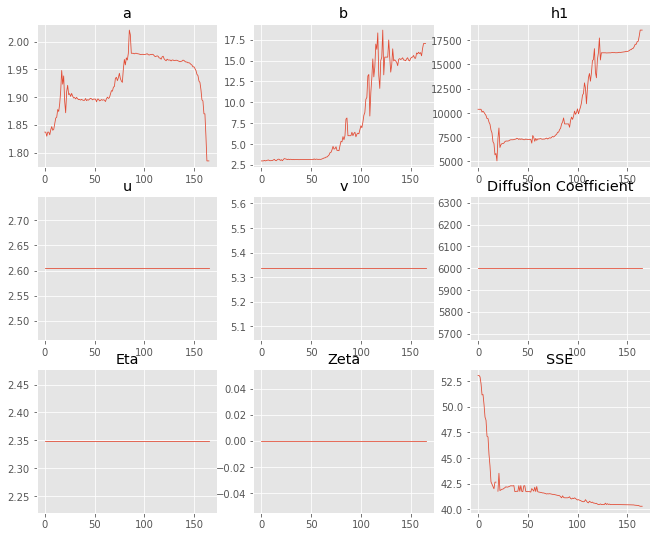

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,1.83688,1.78493
b,2.9674,17.0377
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"10,372.2","18,537.2"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 10 Time: 0.088 minutes


Estimated remaining run time: 1.042 minutes


Run 10===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	3.88e+08 	2.26e+01 	6.43e+01 	2.8431 		1.0000


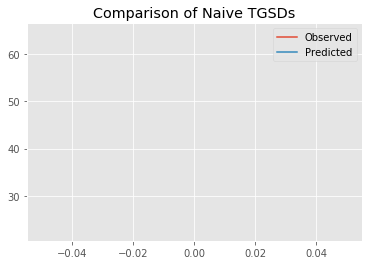

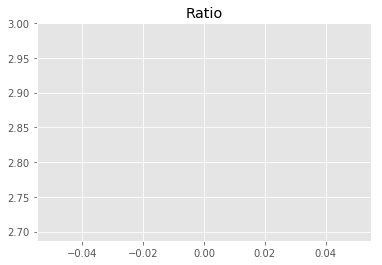

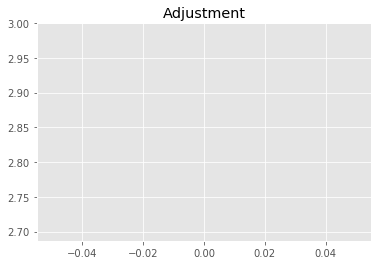

1102166246.3463175
1


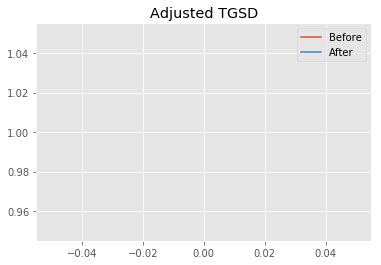

Old Total Mass: 3.87664e+08
New Total Mass: 3.87664e+08
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.11765 	3.42839 	41188.2 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 3.87664e+08
After: 		|1.04575 	6.32626 	11759.1 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 260.042
New Misfit: 40.2403
Convergence:
0.8452544364465158

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	3.88e+08 	9.83e+01 	6.43e+01 	0.6542 		1.0000


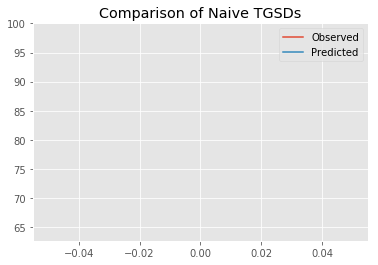

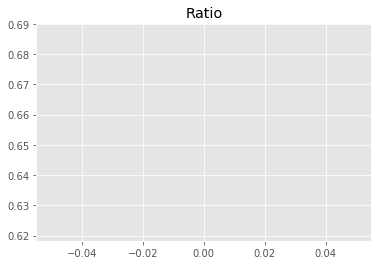

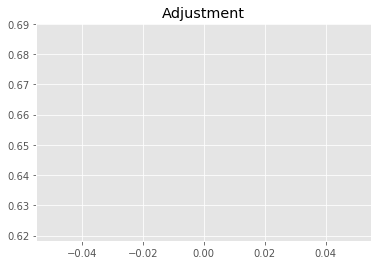

253622459.68695655
1


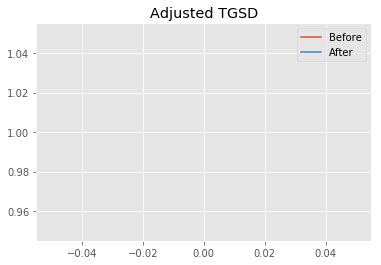

Old Total Mass: 3.87664e+08
New Total Mass: 3.87664e+08
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.04575 	6.32626 	11759.1 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 3.87664e+08
After: 		|1.00041 	22.257 	29432.6 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 40.2403
New Misfit: 39.6821
Convergence:
0.013873615654293672

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	3.88e+08 	9.76e+01 	6.43e+01 	0.6587 		1.0000


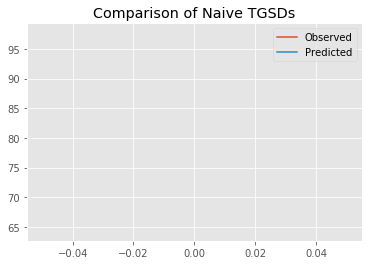

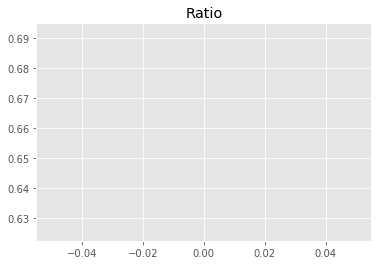

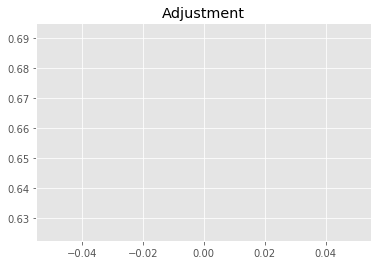

255372912.95843464
1


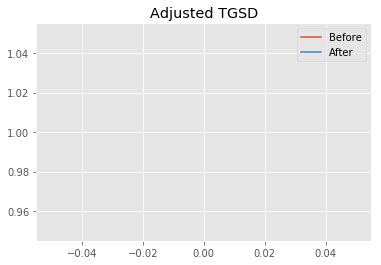

Old Total Mass: 3.87664e+08
New Total Mass: 3.87664e+08
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.00041 	22.257 	29432.6 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 3.87664e+08
After: 		|1.00103 	27.1626 	36267.9 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 39.6821
New Misfit: 39.6036
Convergence:
0.0019761726598397943

____________________
a = 1.00103	b = 27.16255	            h1 = 36267.92792	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 387664367.47453
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 39.60364708922522
Prior Misfit: 260.042,	 Post Misfit: 39.6036


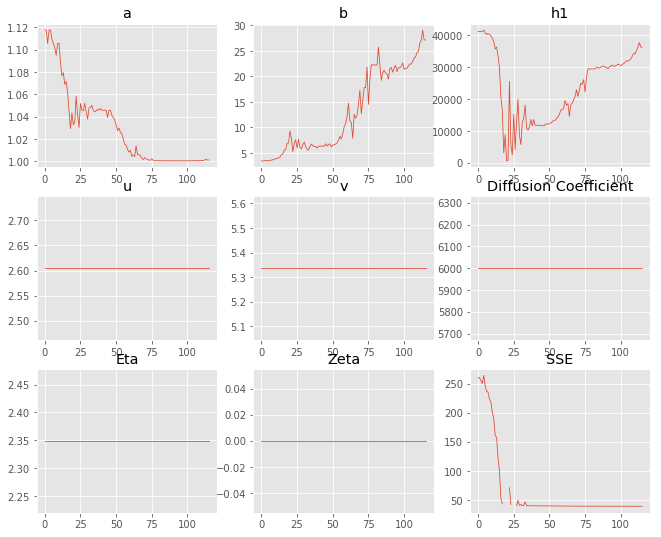

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,1.11765,1.00103
b,3.42839,27.1626
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"41,188.2","36,267.9"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 11 Time: 0.066 minutes


Estimated remaining run time: 0.893 minutes


Run 11===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	3.88e+08 	4.31e+01 	6.43e+01 	1.4911 		1.0000


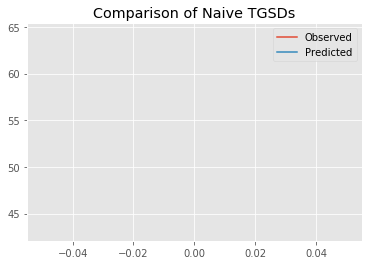

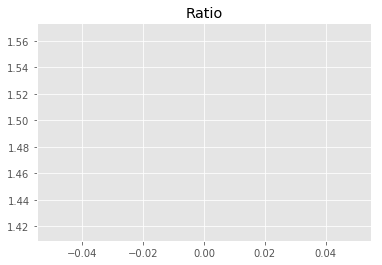

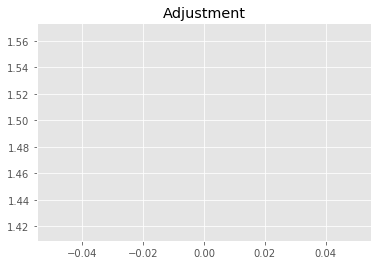

578029734.4881645
1


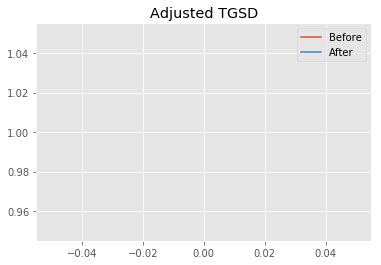

Old Total Mass: 3.87664e+08
New Total Mass: 3.87664e+08
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.85393 	3.30726 	12424.5 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 3.87664e+08
After: 		|1.71638 	5.98313 	9975.24 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 129.406
New Misfit: 40.8844
Convergence:
0.6840621641183927

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	3.88e+08 	9.93e+01 	6.43e+01 	0.6475 		1.0000


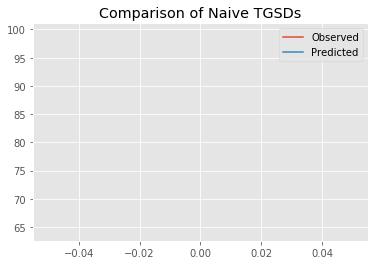

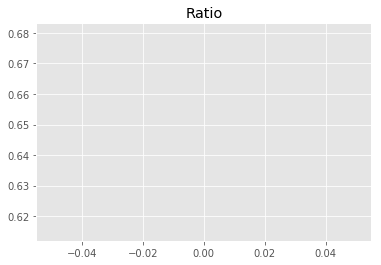

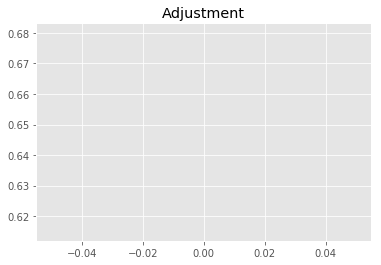

251024367.01485062
1


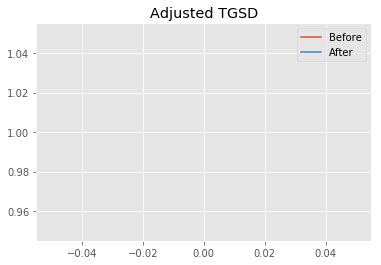

Old Total Mass: 3.87664e+08
New Total Mass: 3.87664e+08
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.71638 	5.98313 	9975.24 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 3.87664e+08
After: 		|1.44356 	26.0517 	29490.5 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 40.8844
New Misfit: 39.9448
Convergence:
0.022980416266399337

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	3.88e+08 	9.73e+01 	6.43e+01 	0.6611 		1.0000


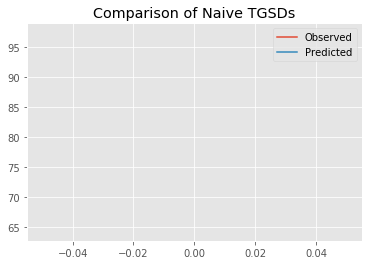

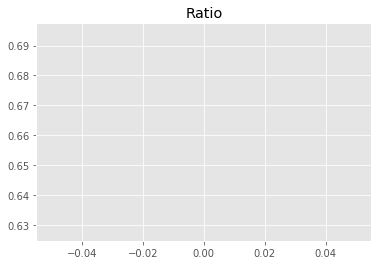

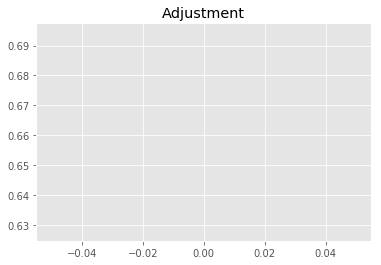

256266950.9182741
1


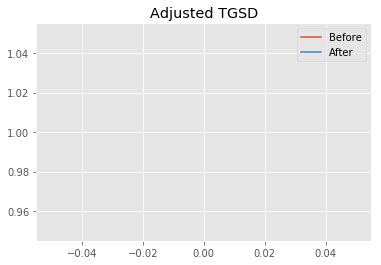

Old Total Mass: 3.87664e+08
New Total Mass: 3.87664e+08
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.44356 	26.0517 	29490.5 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 3.87664e+08
After: 		|1.0337 	19.5091 	28790 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 39.9448
New Misfit: 39.6934
Convergence:
0.006294432739751106

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	3.88e+08 	9.43e+01 	6.43e+01 	0.6820 		1.0000


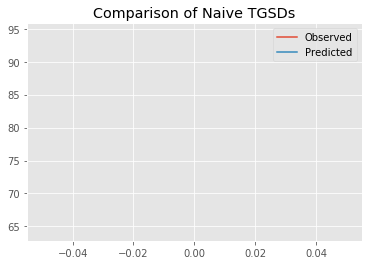

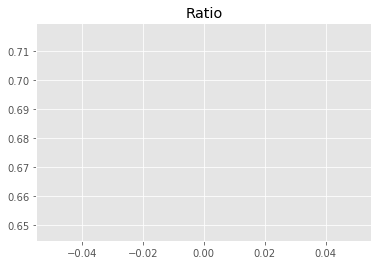

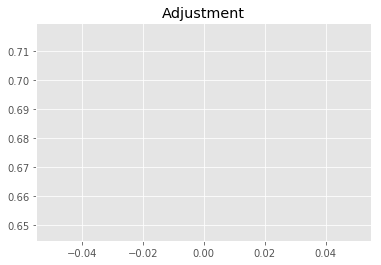

264369048.46038893
1


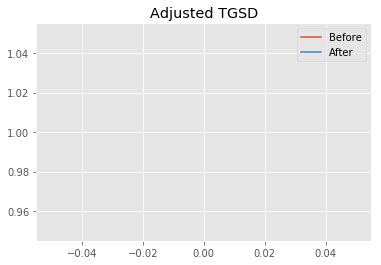

Old Total Mass: 3.87664e+08
New Total Mass: 3.87664e+08
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.0337 	19.5091 	28790 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 3.87664e+08
After: 		|1.0174 	25.3639 	34224.5 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 39.6934
New Misfit: 39.6238
Convergence:
0.001751985870097669

____________________
a = 1.01740	b = 25.36391	            h1 = 34224.49996	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 387664367.47453
Success: True
Status: Successful convergence.
Iterations: 4
Misfit: 39.6238428347742
Prior Misfit: 129.406,	 Post Misfit: 39.6238


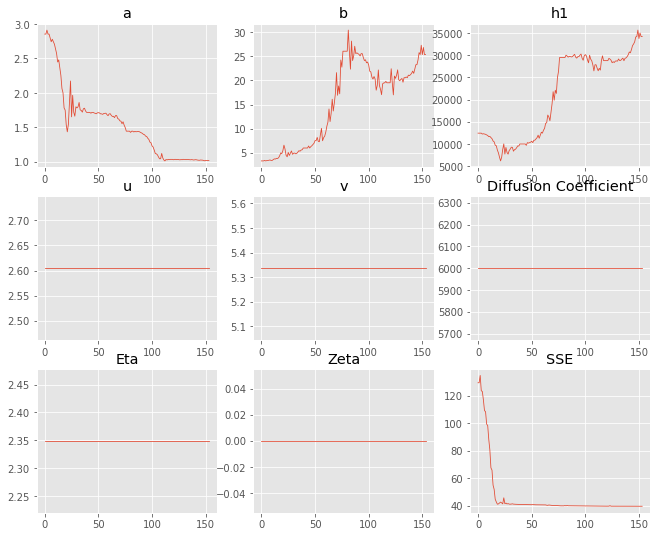

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,2.85393,1.0174
b,3.30726,25.3639
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"12,424.5","34,224.5"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 12 Time: 0.085 minutes


Estimated remaining run time: 0.767 minutes


Run 12===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	3.88e+08 	9.06e+01 	6.43e+01 	0.7097 		1.0000


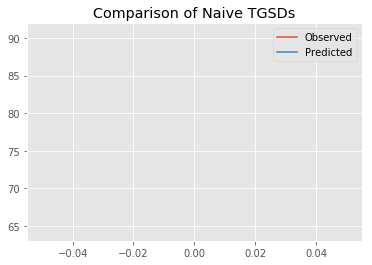

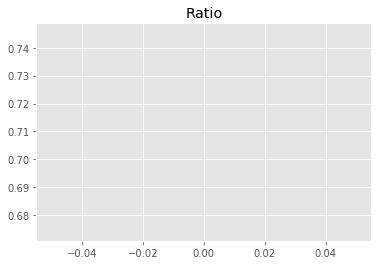

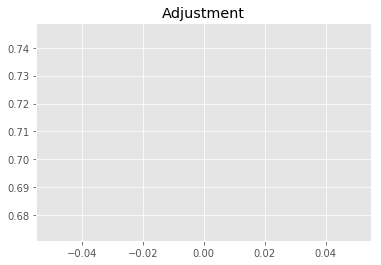

275141699.9759089
1


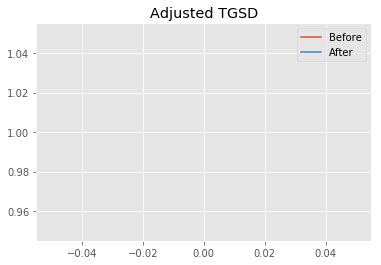

Old Total Mass: 3.87664e+08
New Total Mass: 3.87664e+08
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|4.24583 	4.44101 	7891.92 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 3.87664e+08
After: 		|3.54344 	4.82134 	6611.76 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 46.5984
New Misfit: 41.8364
Convergence:
0.10219260125537813

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	3.88e+08 	1.10e+02 	6.43e+01 	0.5833 		1.0000


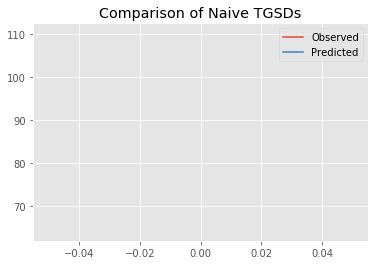

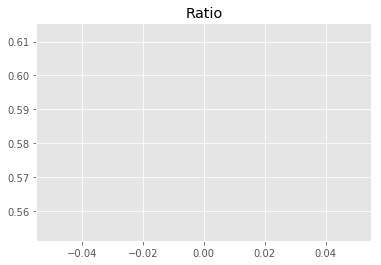

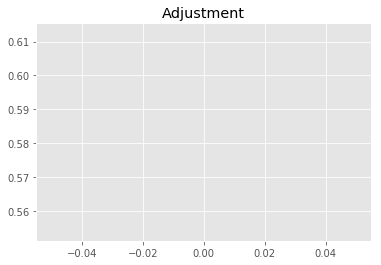

226125642.92410913
1


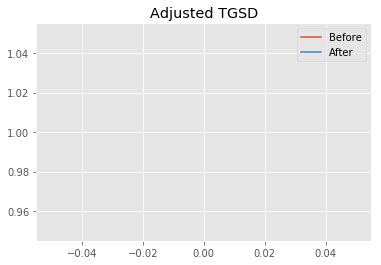

Old Total Mass: 3.87664e+08
New Total Mass: 3.87664e+08
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.54344 	4.82134 	6611.76 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 3.87664e+08
After: 		|3.54481 	4.86871 	6622.37 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 41.8364
New Misfit: 41.8363
Convergence:
1.458227800460661e-06

____________________
a = 3.54481	b = 4.86871	            h1 = 6622.36951	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 387664367.47453
Success: True
Status: Successful convergence.
Iterations: 2
Misfit: 41.83633684219427
Prior Misfit: 46.5984,	 Post Misfit: 41.8363


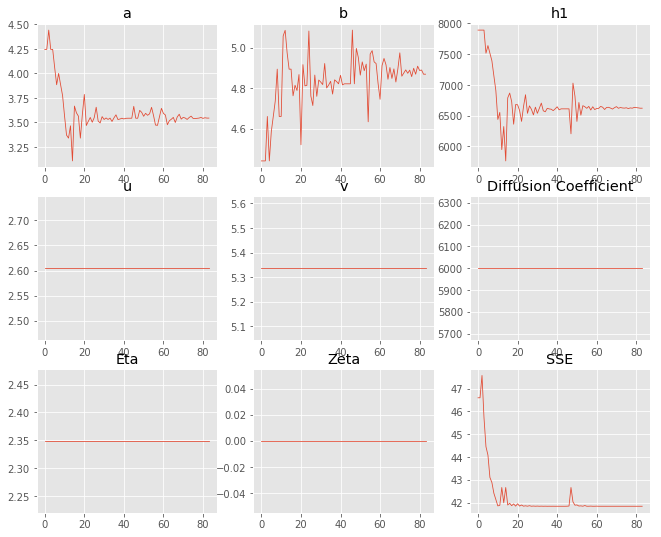

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,4.24583,3.54481
b,4.44101,4.86871
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"7,891.92","6,622.37"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 13 Time: 0.050 minutes


Estimated remaining run time: 0.632 minutes


Run 13===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	3.88e+08 	1.16e+02 	6.43e+01 	0.5523 		1.0000


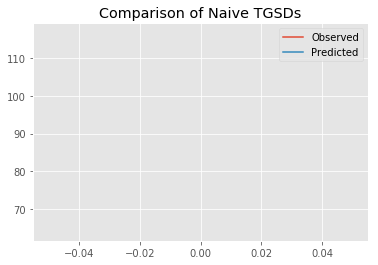

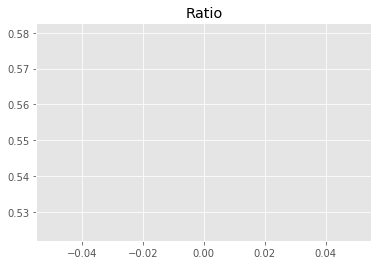

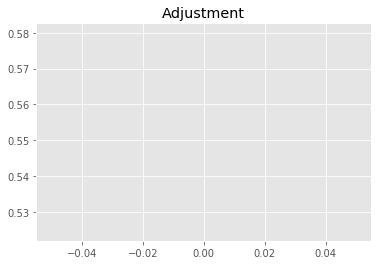

214088127.75297847
1


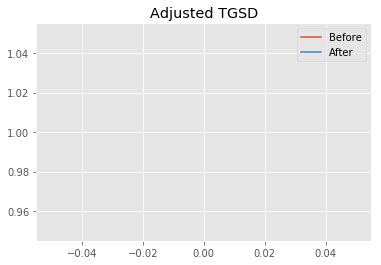

Old Total Mass: 3.87664e+08
New Total Mass: 3.87664e+08
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.0903 	4.51652 	5406.44 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Optimization terminated successfully.
         Current function value: 42.660640
         Iterations: 11
         Function evaluations: 54
New Total Mass: 3.87664e+08
After: 		|2.0903 	4.51652 	5406.44 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 42.6606
New Misfit: 42.6606
Convergence:
1.6655698093334067e-16

____________________
a = 2.09030	b = 4.51652	            h1 = 5406.44032	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 387664367.47453
Success: True
Status: Successful convergence.
Iterations: 1
Misfit: 42.66063972692164
Prior Misfit: 42.6606,	 Post Misfit: 42.6606


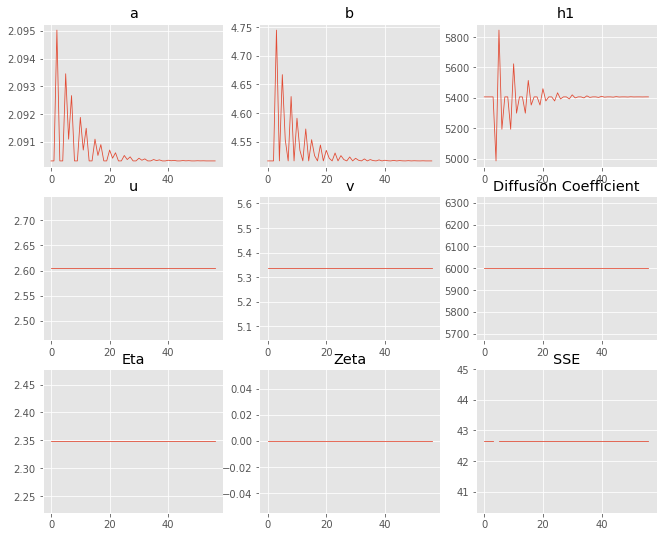

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,2.0903,2.0903
b,4.51652,4.51652
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"5,406.44","5,406.44"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 14 Time: 0.033 minutes


Estimated remaining run time: 0.502 minutes


Run 14===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	3.88e+08 	8.75e+01 	6.43e+01 	0.7347 		1.0000


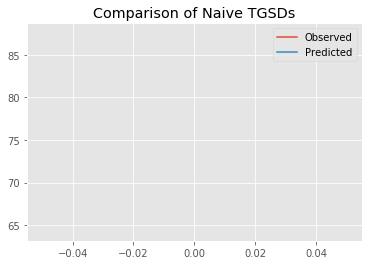

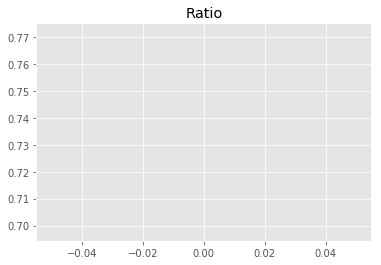

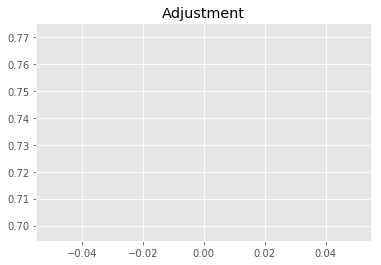

284834294.8115754
1


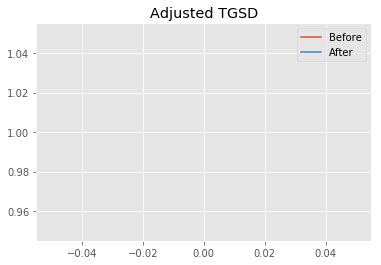

Old Total Mass: 3.87664e+08
New Total Mass: 3.87664e+08
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.97566 	3.43368 	9013.94 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 3.87664e+08
After: 		|2.00051 	11.8774 	12718.8 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 44.064
New Misfit: 40.7242
Convergence:
0.0757942047426808

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	3.88e+08 	1.03e+02 	6.43e+01 	0.6231 		1.0000


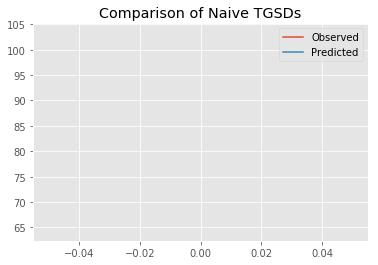

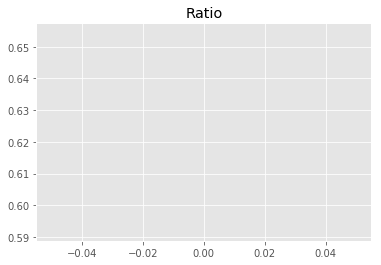

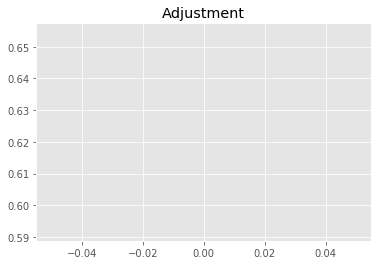

241544374.32935196
1


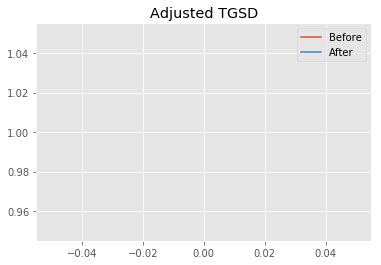

Old Total Mass: 3.87664e+08
New Total Mass: 3.87664e+08
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.00051 	11.8774 	12718.8 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 3.87664e+08
After: 		|2.00071 	24.9879 	23173.3 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 40.7242
New Misfit: 40.3327
Convergence:
0.00961302062998165

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	3.88e+08 	9.98e+01 	6.43e+01 	0.6445 		1.0000


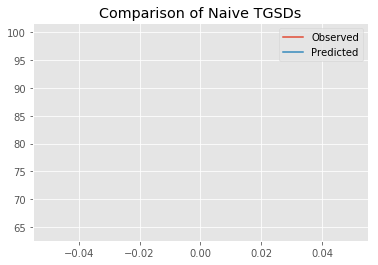

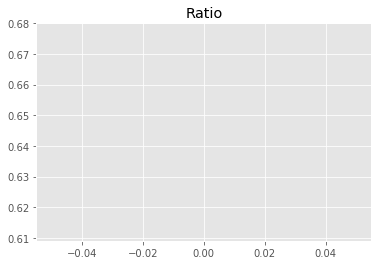

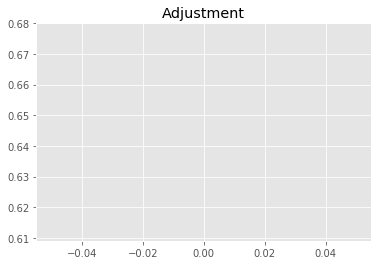

249855646.97570804
1


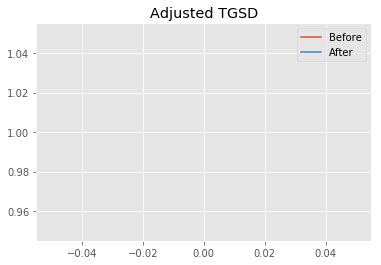

Old Total Mass: 3.87664e+08
New Total Mass: 3.87664e+08
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.00071 	24.9879 	23173.3 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 3.87664e+08
After: 		|2.00044 	32.1037 	29193.2 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 40.3327
New Misfit: 40.2577
Convergence:
0.0018599361786137444

____________________
a = 2.00044	b = 32.10368	            h1 = 29193.19982	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 387664367.47453
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 40.257697382607965
Prior Misfit: 44.064,	 Post Misfit: 40.2577


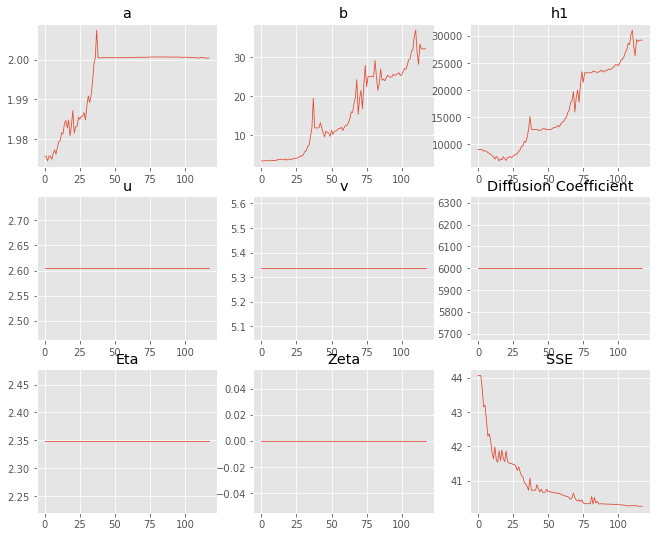

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,1.97566,2.00044
b,3.43368,32.1037
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"9,013.94","29,193.2"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 15 Time: 0.066 minutes


Estimated remaining run time: 0.393 minutes


Run 15===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	3.88e+08 	4.01e+01 	6.43e+01 	1.6057 		1.0000


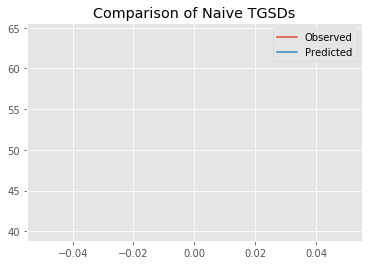

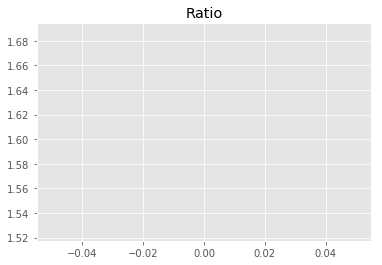

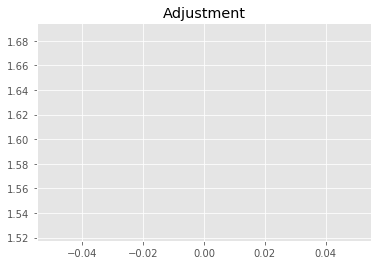

622488699.09416
1


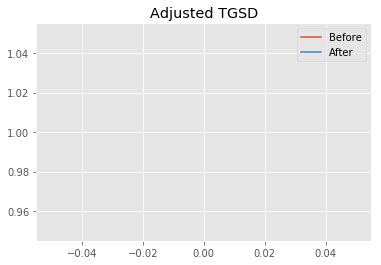

Old Total Mass: 3.87664e+08
New Total Mass: 3.87664e+08
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.34317 	4.71802 	14005.3 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 3.87664e+08
After: 		|1.85081 	11.0148 	13344.7 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 149.595
New Misfit: 40.5583
Convergence:
0.7288795789782168

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	3.88e+08 	1.00e+02 	6.43e+01 	0.6415 		1.0000


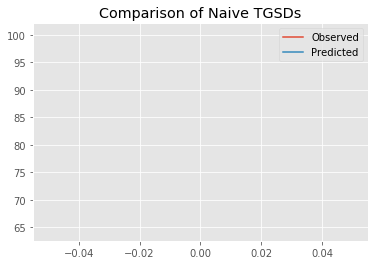

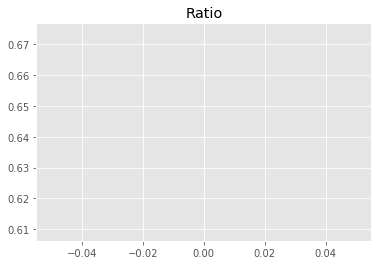

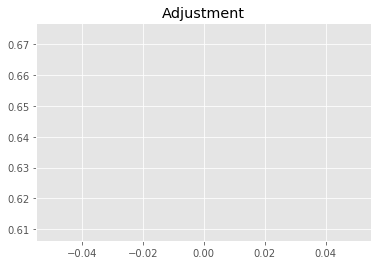

248698364.4797234
1


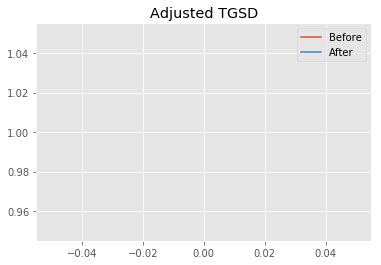

Old Total Mass: 3.87664e+08
New Total Mass: 3.87664e+08
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.85081 	11.0148 	13344.7 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 3.87664e+08
After: 		|1.44981 	20.2115 	24462.3 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 40.5583
New Misfit: 40.0081
Convergence:
0.013565372270597476

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	3.88e+08 	9.66e+01 	6.43e+01 	0.6660 		1.0000


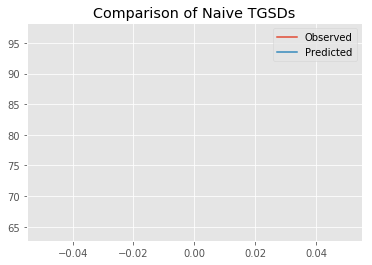

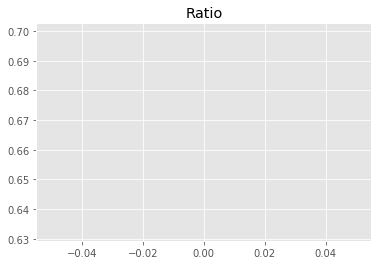

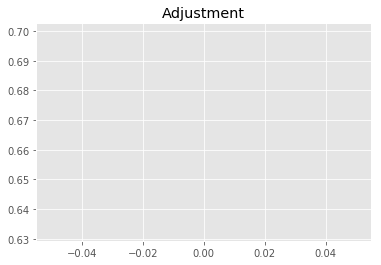

258166682.30628684
1


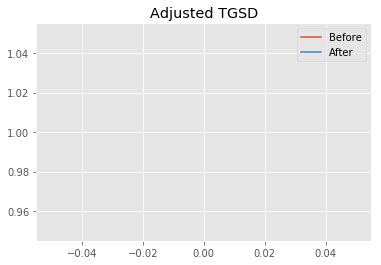

Old Total Mass: 3.87664e+08
New Total Mass: 3.87664e+08
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.44981 	20.2115 	24462.3 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 3.87664e+08
After: 		|1.03 	28.587 	38177.4 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 40.0081
New Misfit: 39.608
Convergence:
0.010000487138402783

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	3.88e+08 	9.57e+01 	6.43e+01 	0.6719 		1.0000


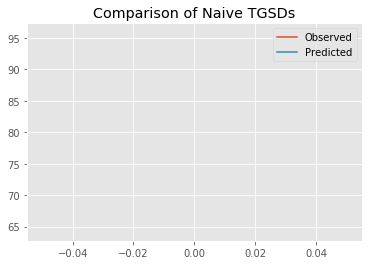

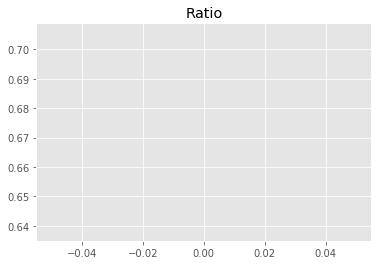

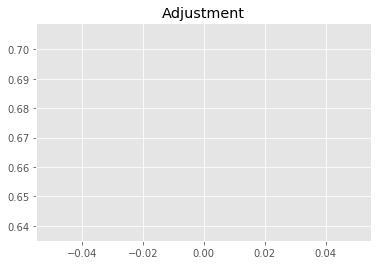

260468338.6802457
1


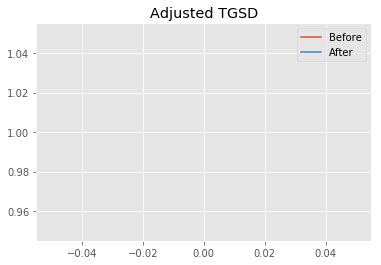

Old Total Mass: 3.87664e+08
New Total Mass: 3.87664e+08
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.03 	28.587 	38177.4 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 3.87664e+08
After: 		|1.00427 	29.3646 	39610.2 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 39.608
New Misfit: 39.5822
Convergence:
0.0006533874093063944

____________________
a = 1.00427	b = 29.36464	            h1 = 39610.15271	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 387664367.47453
Success: True
Status: Successful convergence.
Iterations: 4
Misfit: 39.582152100563775
Prior Misfit: 149.595,	 Post Misfit: 39.5822


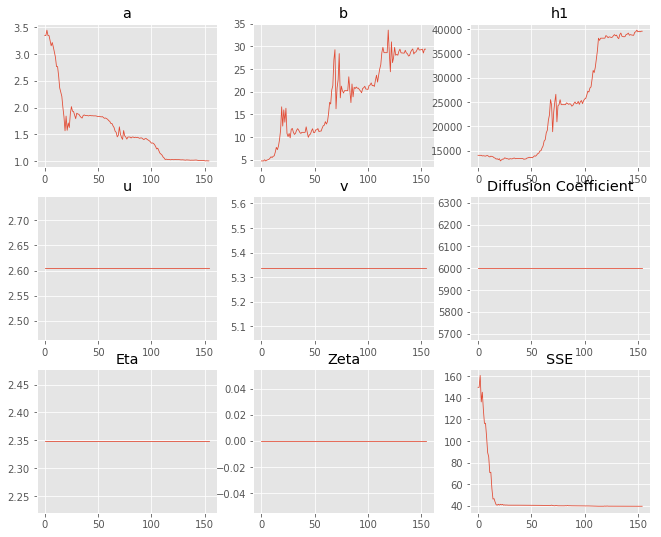

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,3.34317,1.00427
b,4.71802,29.3646
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"14,005.3","39,610.2"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 16 Time: 0.083 minutes


Estimated remaining run time: 0.292 minutes


Run 16===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	3.88e+08 	6.77e+01 	6.43e+01 	0.9494 		1.0000


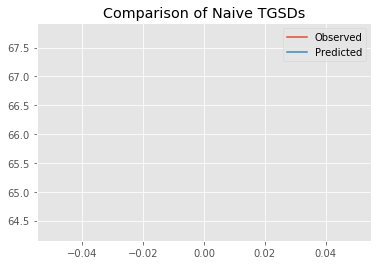

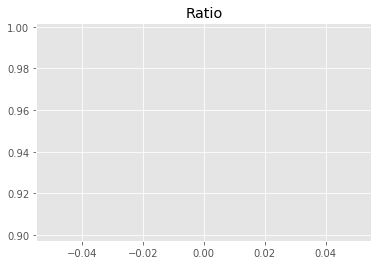

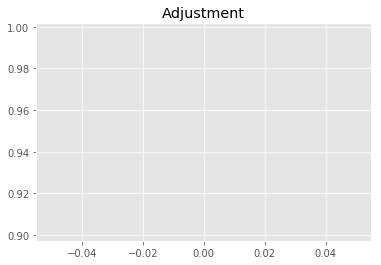

368051722.2352632
1


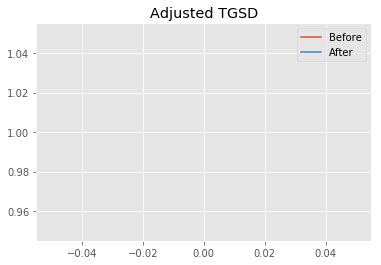

Old Total Mass: 3.87664e+08
New Total Mass: 3.87664e+08
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.2309 	2.95368 	12438.4 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 3.87664e+08
After: 		|1.19385 	4.39372 	9870.55 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 53.279
New Misfit: 40.7331
Convergence:
0.23547487873653583

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	3.88e+08 	9.63e+01 	6.43e+01 	0.6678 		1.0000


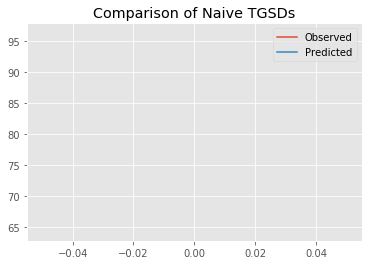

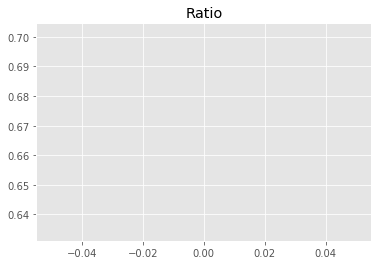

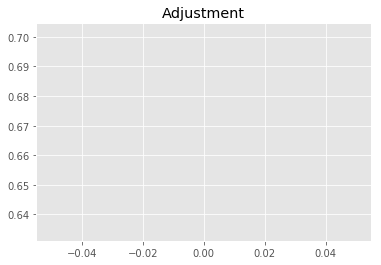

258895832.5580449
1


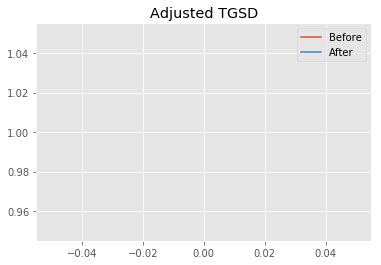

Old Total Mass: 3.87664e+08
New Total Mass: 3.87664e+08
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.19385 	4.39372 	9870.55 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 3.87664e+08
After: 		|1.10362 	14.7548 	20221.9 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 40.7331
New Misfit: 39.8829
Convergence:
0.020872157130387

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	3.88e+08 	9.83e+01 	6.43e+01 	0.6543 		1.0000


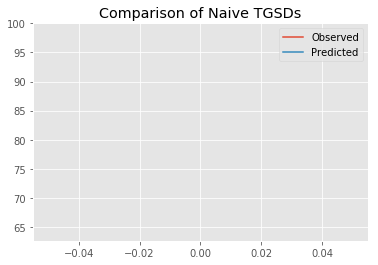

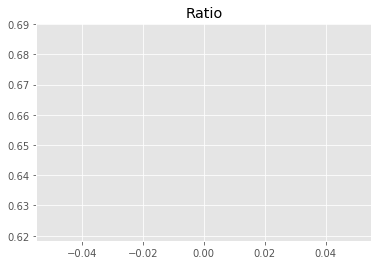

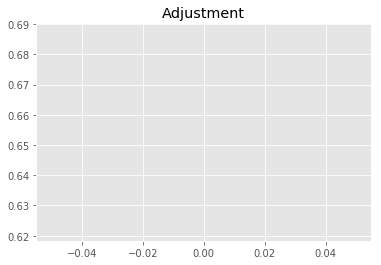

253647763.31784245
1


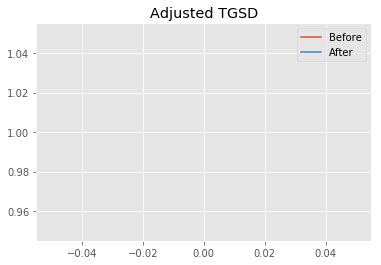

Old Total Mass: 3.87664e+08
New Total Mass: 3.87664e+08
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.10362 	14.7548 	20221.9 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 3.87664e+08
After: 		|1.00816 	13.4116 	21076.3 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 39.8829
New Misfit: 39.7733
Convergence:
0.002749608377796707

____________________
a = 1.00816	b = 13.41164	            h1 = 21076.34679	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 387664367.47453
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 39.77327273502238
Prior Misfit: 53.279,	 Post Misfit: 39.7733


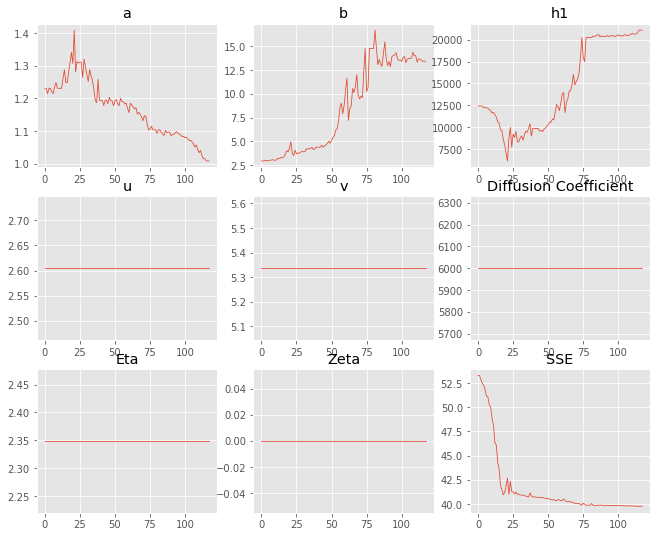

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,1.2309,1.00816
b,2.95368,13.4116
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"12,438.4","21,076.3"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 17 Time: 0.066 minutes


Estimated remaining run time: 0.191 minutes


Run 17===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	3.88e+08 	4.47e+01 	6.43e+01 	1.4391 		1.0000


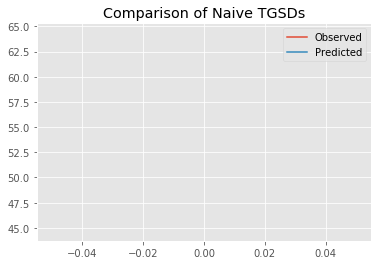

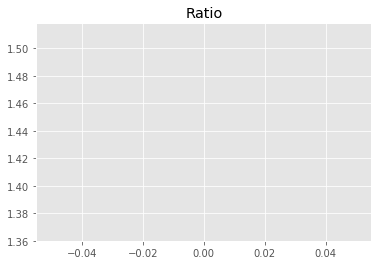

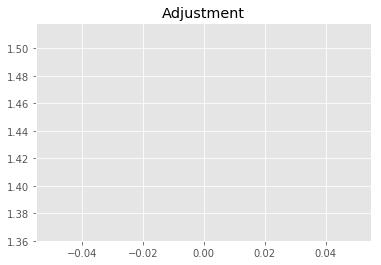

557887674.3982614
1


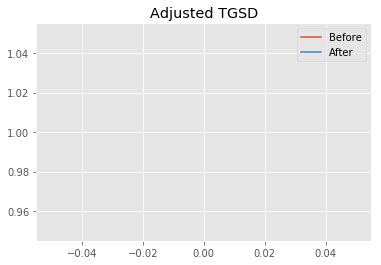

Old Total Mass: 3.87664e+08
New Total Mass: 3.87664e+08
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.01001 	4.99608 	30864.9 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 3.87664e+08
After: 		|1.00338 	12.1841 	18992.3 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 92.6679
New Misfit: 39.814
Convergence:
0.5703578325574106

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	3.88e+08 	9.65e+01 	6.43e+01 	0.6665 		1.0000


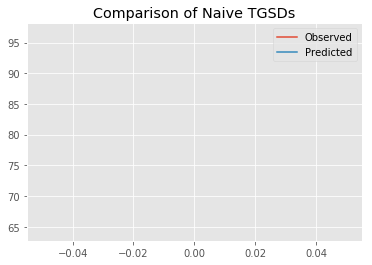

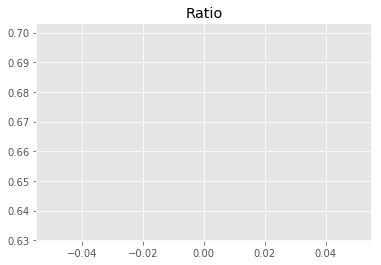

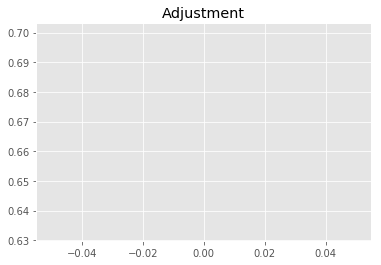

258359418.43074048
1


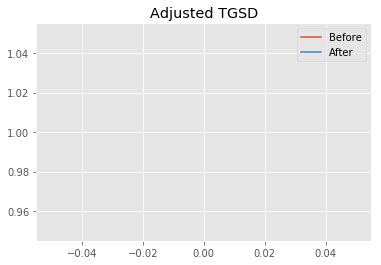

Old Total Mass: 3.87664e+08
New Total Mass: 3.87664e+08
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.00338 	12.1841 	18992.3 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 3.87664e+08
After: 		|1.00087 	19.9095 	27682.8 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 39.814
New Misfit: 39.6714
Convergence:
0.0035829280750692325

____________________
a = 1.00087	b = 19.90950	            h1 = 27682.82712	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 387664367.47453
Success: True
Status: Successful convergence.
Iterations: 2
Misfit: 39.671383419526926
Prior Misfit: 92.6679,	 Post Misfit: 39.6714


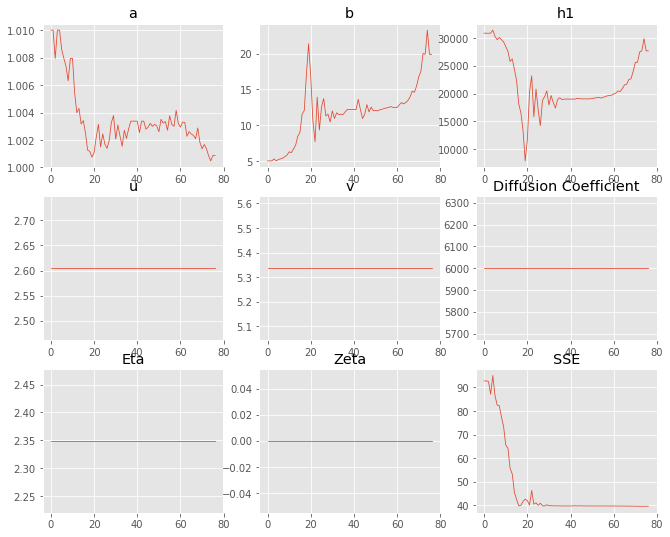

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,1.01001,1.00087
b,4.99608,19.9095
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"30,864.9","27,682.8"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 18 Time: 0.047 minutes


Estimated remaining run time: 0.093 minutes


Run 18===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	3.88e+08 	4.38e+01 	6.43e+01 	1.4679 		1.0000


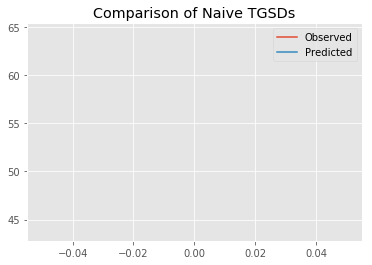

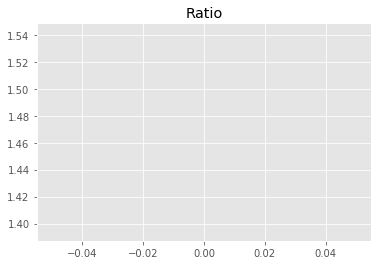

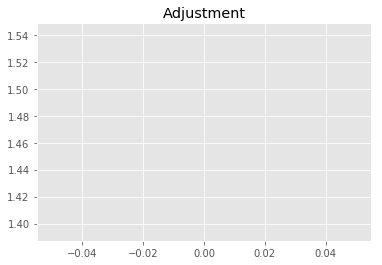

569054792.6329194
1


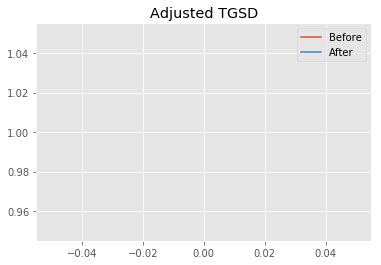

Old Total Mass: 3.87664e+08
New Total Mass: 3.87664e+08
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.04173 	2.15987 	11913.7 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 3.87664e+08
After: 		|2.01619 	2.19404 	6249.7 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 117.293
New Misfit: 42.1254
Convergence:
0.6408519330133468

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	3.88e+08 	1.07e+02 	6.43e+01 	0.6013 		1.0000


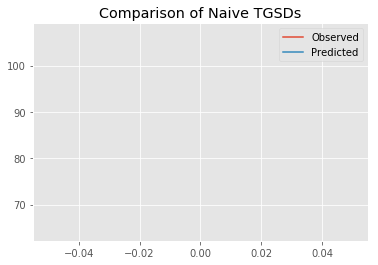

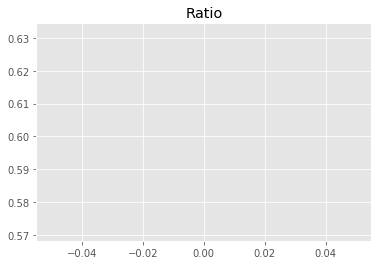

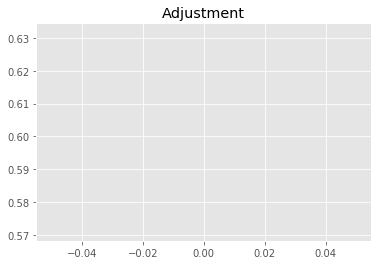

233119250.8711828
1


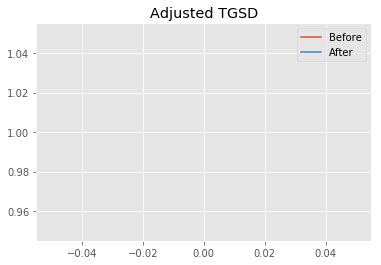

Old Total Mass: 3.87664e+08
New Total Mass: 3.87664e+08
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.01619 	2.19404 	6249.7 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 3.87664e+08
After: 		|2.01606 	2.2042 	6222.28 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 42.1254
New Misfit: 42.0736
Convergence:
0.001229554785861252

____________________
a = 2.01606	b = 2.20420	            h1 = 6222.27863	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 387664367.47453
Success: True
Status: Successful convergence.
Iterations: 2
Misfit: 42.0736147955899
Prior Misfit: 117.293,	 Post Misfit: 42.0736


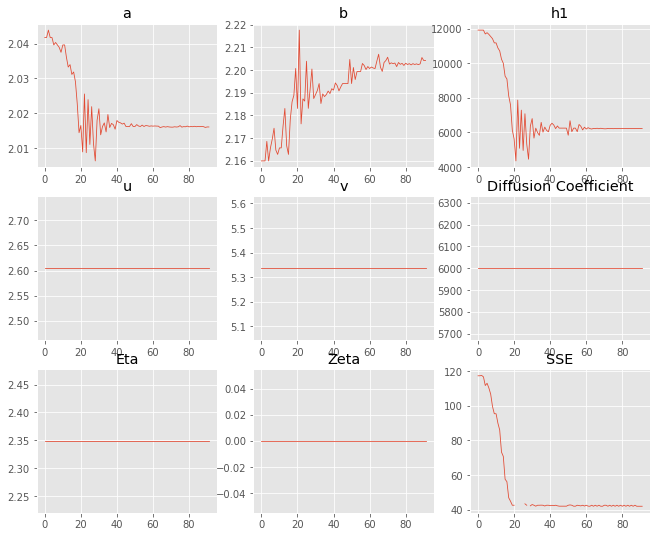

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,2.04173,2.01606
b,2.15987,2.2042
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"11,913.7","6,222.28"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 19 Time: 0.052 minutes


Estimated remaining run time: 0.000 minutes


Run 19===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	3.88e+08 	9.59e+01 	6.43e+01 	0.6705 		1.0000


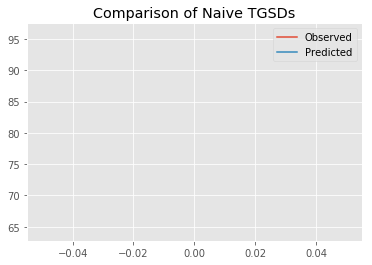

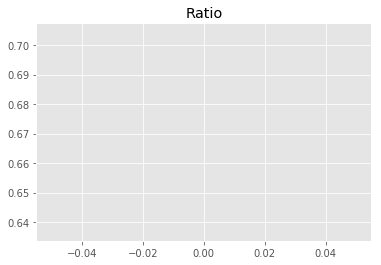

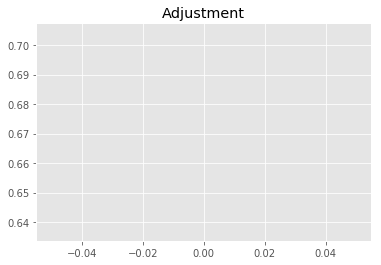

259928046.70465228
1


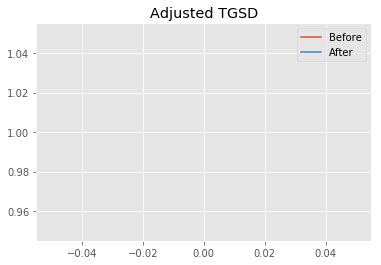

Old Total Mass: 3.87664e+08
New Total Mass: 3.87664e+08
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.70879 	4.02204 	8877.08 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 3.87664e+08
After: 		|1.67435 	10.8227 	14318.6 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 41.5396
New Misfit: 40.4254
Convergence:
0.02682378900336448

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	3.88e+08 	9.81e+01 	6.43e+01 	0.6559 		1.0000


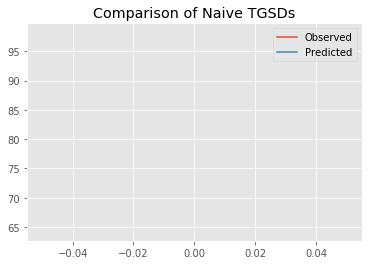

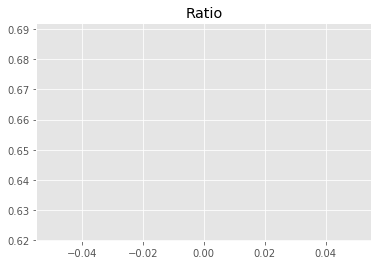

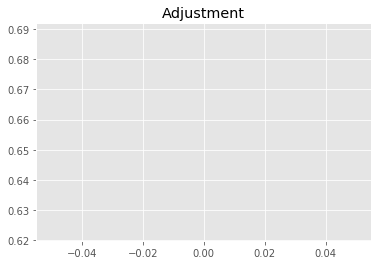

254249857.29207212
1


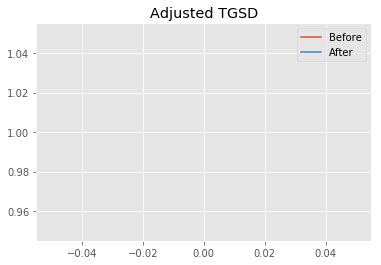

Old Total Mass: 3.87664e+08
New Total Mass: 3.87664e+08
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.67435 	10.8227 	14318.6 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 3.87664e+08
After: 		|1.05042 	13.8213 	22822.1 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 40.4254
New Misfit: 39.8827
Convergence:
0.013424505560120939

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	3.88e+08 	9.25e+01 	6.43e+01 	0.6951 		1.0000


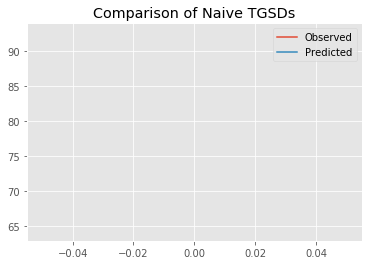

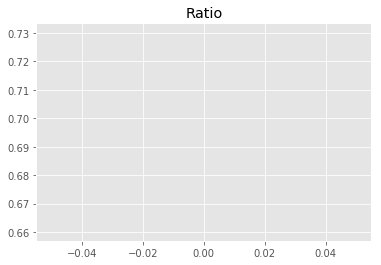

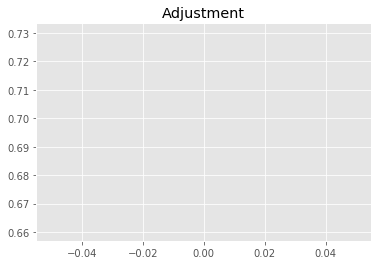

269484540.9716245
1


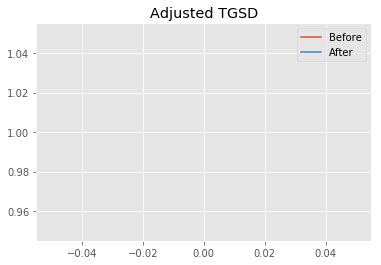

Old Total Mass: 3.87664e+08
New Total Mass: 3.87664e+08
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.05042 	13.8213 	22822.1 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 3.87664e+08
After: 		|1.0051 	15.115 	22896.3 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 39.8827
New Misfit: 39.7313
Convergence:
0.0037966006096503565

____________________
a = 1.00510	b = 15.11500	            h1 = 22896.25775	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 387664367.47453
Success: True
Status: Successful convergence.
Iterations: 3
Misfit: 39.73128917853657
Prior Misfit: 41.5396,	 Post Misfit: 39.7313


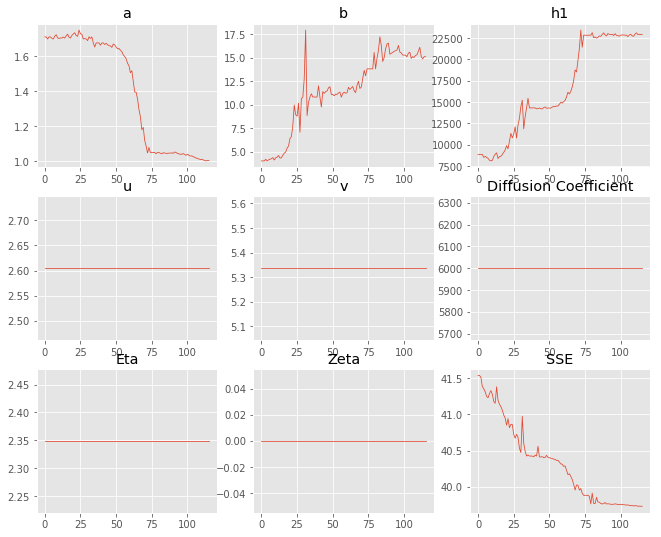

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,1.70879,1.0051
b,4.02204,15.115
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"8,877.08","22,896.3"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 20 Time: 0.065 minutes


Estimated remaining run time: -0.090 minutes


Total Run Time: 1.88594 minutes


[{'a': 1.9073151411284035,
  'b': 18.184482481867903,
  'h1': 18837.482927573332,
  'u': 2.60482,
  'v': 5.33615,
  'D': 5999.899999999996,
  'ftt': 6457.999999999996,
  'eta': 2.34894,
  'zeta': 0.0},
 {'a': 3.1589958560474583,
  'b': 2.375527861078364,
  'h1': 6075.246894543868,
  'u': 2.60482,
  'v': 5.33615,
  'D': 5999.899999999996,
  'ftt': 6457.999999999996,
  'eta': 2.34894,
  'zeta': 0.0},
 {'a': 2.105867226809095,
  'b': 2.915398022205805,
  'h1': 6232.431968555488,
  'u': 2.60482,
  'v': 5.33615,
  'D': 5999.899999999996,
  'ftt': 6457.999999999996,
  'eta': 2.34894,
  'zeta': 0.0},
 {'a': 1.9650557605582446,
  'b': 36.26371566463738,
  'h1': 31662.701713624796,
  'u': 2.60482,
  'v': 5.33615,
  'D': 5999.899999999996,
  'ftt': 6457.999999999996,
  'eta': 2.34894,
  'zeta': 0.0},
 {'a': 1.0,
  'b': 2.0369410266500045,
  'h1': 7342.538776494618,
  'u': 2.60482,
  'v': 5.33615,
  'D': 5999.899999999996,
  'ftt': 6457.999999999996,
  'eta': 2.34894,
  'zeta': 0.0},
 {'a': 2.131

,a,b,h1,u,v,D,ftt,eta,zeta,M,Misfit
15,1.00427,29.3646,"39,610.2",2.60482,5.33615,"5,999.9","6,458",2.34894,0,3.87664e+08,39.5822
10,1.00103,27.1626,"36,267.9",2.60482,5.33615,"5,999.9","6,458",2.34894,0,3.87664e+08,39.6036
11,1.0174,25.3639,"34,224.5",2.60482,5.33615,"5,999.9","6,458",2.34894,0,3.87664e+08,39.6238
8,1.0166,22.84,"31,478.8",2.60482,5.33615,"5,999.9","6,458",2.34894,0,3.87664e+08,39.6408
17,1.00087,19.9095,"27,682.8",2.60482,5.33615,"5,999.9","6,458",2.34894,0,3.87664e+08,39.6714
19,1.0051,15.115,"22,896.3",2.60482,5.33615,"5,999.9","6,458",2.34894,0,3.87664e+08,39.7313
16,1.00816,13.4116,"21,076.3",2.60482,5.33615,"5,999.9","6,458",2.34894,0,3.87664e+08,39.7733
3,1.96506,36.2637,"31,662.7",2.60482,5.33615,"5,999.9","6,458",2.34894,0,3.87664e+08,40.234
14,2.00044,32.1037,"29,193.2",2.60482,5.33615,"5,999.9","6,458",2.34894,0,3.87664e+08,40.2577
9,1.78493,17.0377,"18,537.2",2.60482,5.33615,"5,999.9","6,458",2.34894,0,3.87664e+08,40.3105


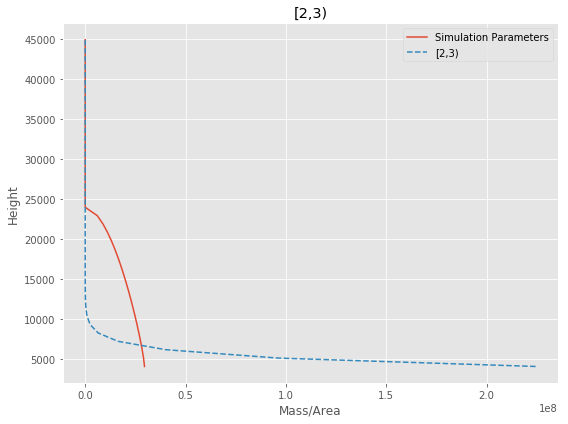

[2,3) Run Time: 1.88828 minutes


Mass Test: 54614410048.63162
========[3,4)========
Run 0===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	3.86e+08 	5.86e+01 	6.40e+01 	1.0918 		1.0000


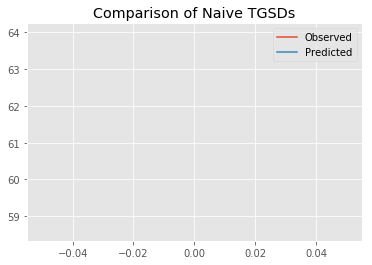

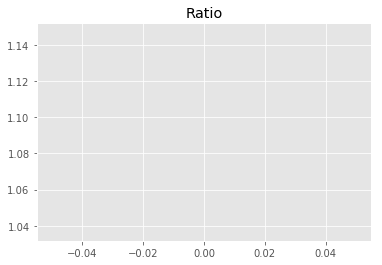

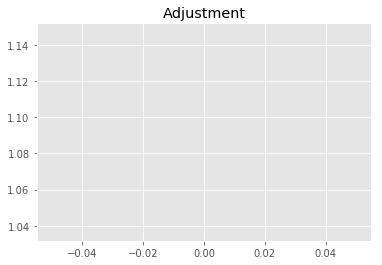

420984234.87496984
1


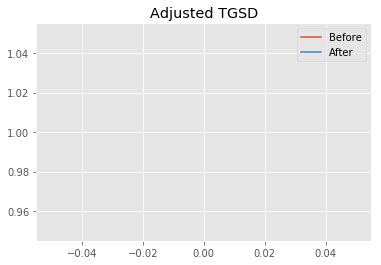

Old Total Mass: 3.8559e+08
New Total Mass: 3.8559e+08
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.04331 	4.99539 	6377.32 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Optimization terminated successfully.
         Current function value: 147.791459
         Iterations: 14
         Function evaluations: 58
New Total Mass: 3.8559e+08
After: 		|3.04331 	4.99539 	5967.7 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 164.693
New Misfit: 147.791
Convergence:
0.10262512850205677

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	3.86e+08 	6.42e+01 	6.40e+01 	0.9967 		1.0000


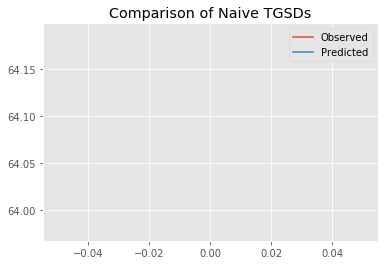

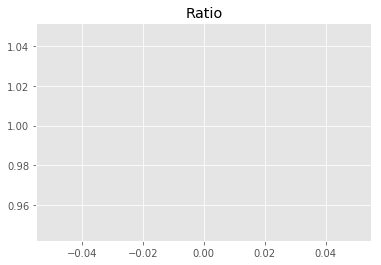

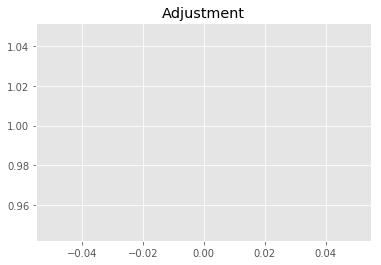

384327799.76459837
1


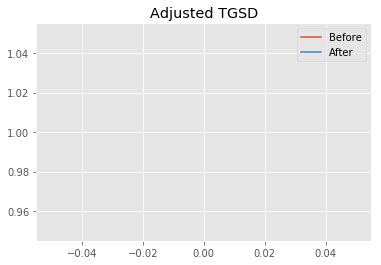

Old Total Mass: 3.8559e+08
New Total Mass: 3.8559e+08
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.04331 	4.99539 	5967.7 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Optimization terminated successfully.
         Current function value: 147.791459
         Iterations: 11
         Function evaluations: 54
New Total Mass: 3.8559e+08
After: 		|3.04331 	4.99539 	5967.7 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 147.791
New Misfit: 147.791
Convergence:
1.9230955334497995e-16

____________________
a = 3.04331	b = 4.99539	            h1 = 5967.70353	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 385589951.36837
Success: True
Status: Successful convergence.
Iterations: 2
Misfit: 147.79145880193963
Prior Misfit: 164.693,	 Post Misfit: 147.791


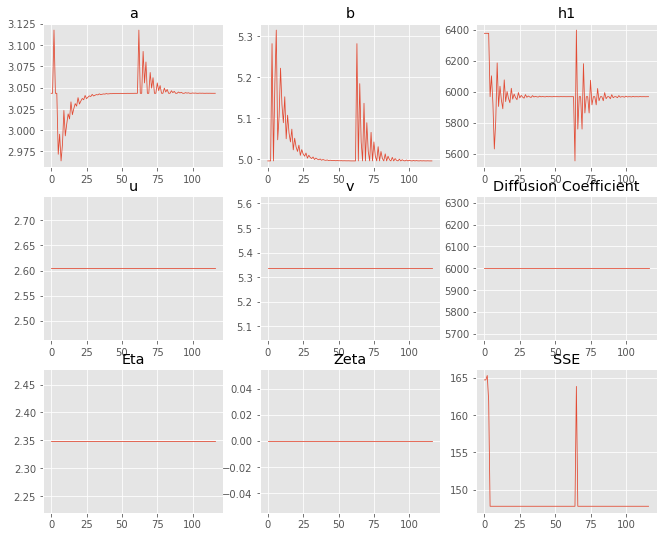

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,3.04331,3.04331
b,4.99539,4.99539
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"6,377.32","5,967.7"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 1 Time: 0.059 minutes


Estimated remaining run time: 0.530 minutes


Run 1===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	3.86e+08 	1.50e+01 	6.40e+01 	4.2695 		1.0000


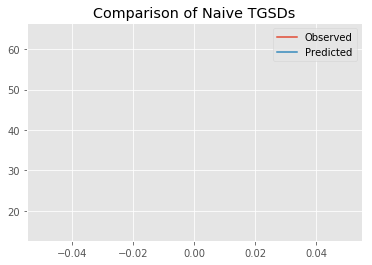

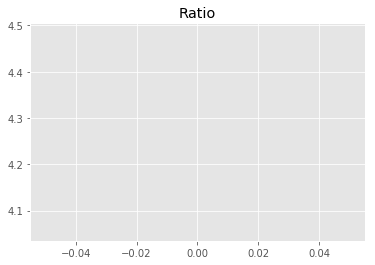

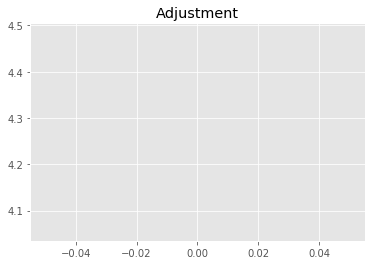

1646280213.1473093
1


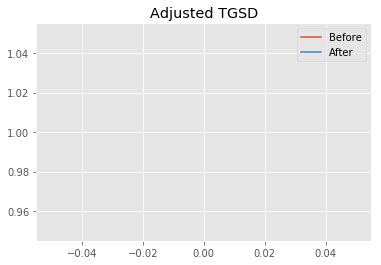

Old Total Mass: 3.8559e+08
New Total Mass: 3.8559e+08
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.20383 	1.61129 	11532.5 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 3.8559e+08
After: 		|1.05864 	2.64484 	5299.79 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 874.062
New Misfit: 147.791
Convergence:
0.8309142334283409

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	3.86e+08 	6.42e+01 	6.40e+01 	0.9967 		1.0000


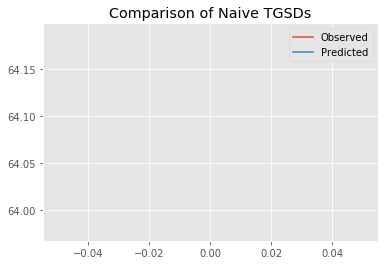

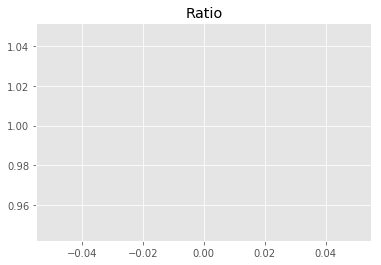

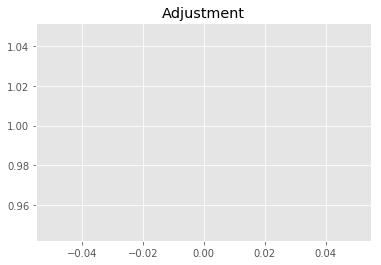

384327799.76459837
1


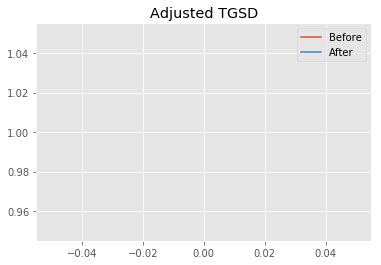

Old Total Mass: 3.8559e+08
New Total Mass: 3.8559e+08
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.05864 	2.64484 	5299.79 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Optimization terminated successfully.
         Current function value: 147.791459
         Iterations: 12
         Function evaluations: 59
New Total Mass: 3.8559e+08
After: 		|1.05864 	2.64484 	5299.79 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 147.791
New Misfit: 147.791
Convergence:
1.9230955334497995e-16

____________________
a = 1.05864	b = 2.64484	            h1 = 5299.78835	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 385589951.36837
Success: True
Status: Successful convergence.
Iterations: 2
Misfit: 147.79145880193963
Prior Misfit: 874.062,	 Post Misfit: 147.791


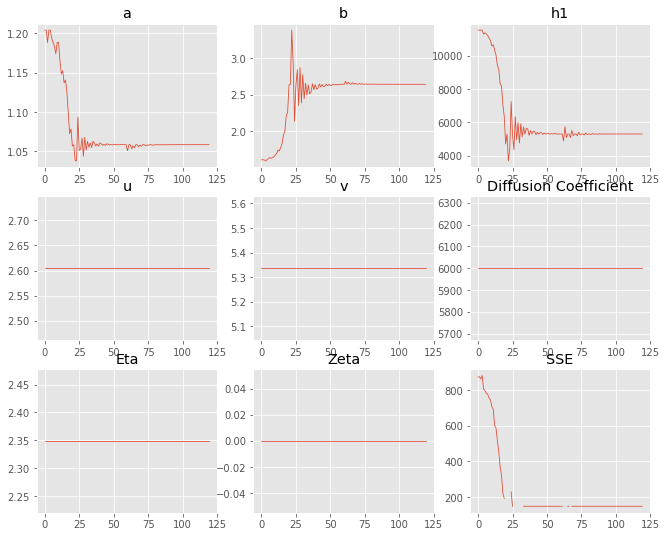

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,1.20383,1.05864
b,1.61129,2.64484
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"11,532.5","5,299.79"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 2 Time: 0.059 minutes


Estimated remaining run time: 0.668 minutes


Run 2===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	3.86e+08 	7.63e+00 	6.40e+01 	8.3811 		1.0000


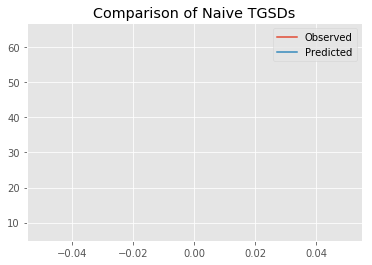

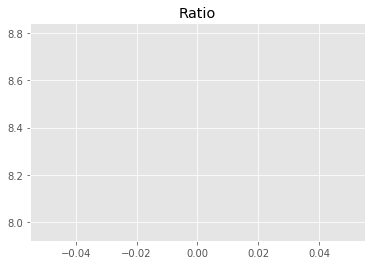

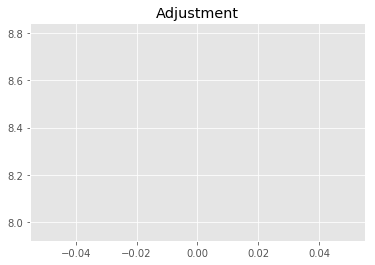

3231684119.6315346
1


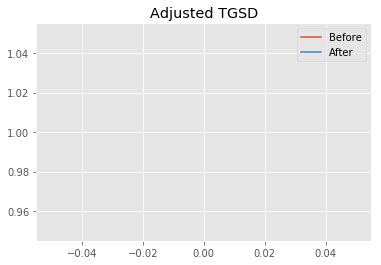

Old Total Mass: 3.8559e+08
New Total Mass: 3.8559e+08
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.31138 	3.97177 	17436.9 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 3.8559e+08
After: 		|1.63075 	241.349 	15944.5 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 1888.38
New Misfit: 147.791
Convergence:
0.9217364012813294

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	3.86e+08 	6.42e+01 	6.40e+01 	0.9967 		1.0000


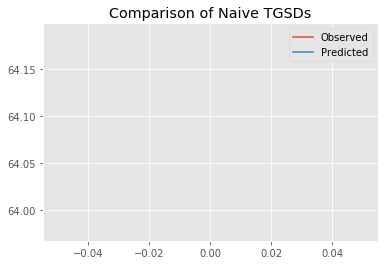

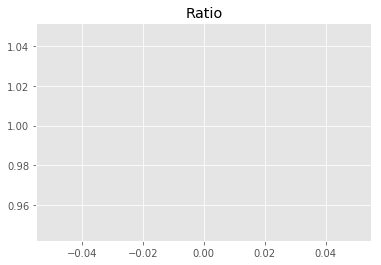

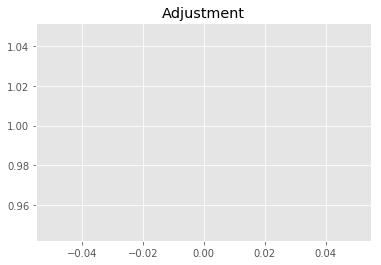

384327799.76459837
1


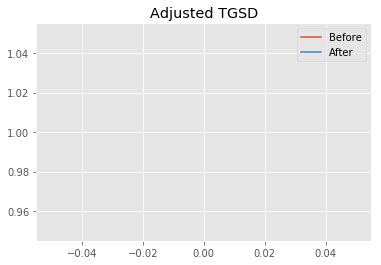

Old Total Mass: 3.8559e+08
New Total Mass: 3.8559e+08
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.63075 	241.349 	15944.5 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Optimization terminated successfully.
         Current function value: 147.791459
         Iterations: 13
         Function evaluations: 64
New Total Mass: 3.8559e+08
After: 		|1.63075 	241.349 	15944.5 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 147.791
New Misfit: 147.791
Convergence:
1.9230955334497995e-16

____________________
a = 1.63075	b = 241.34910	            h1 = 15944.51442	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 385589951.36837
Success: True
Status: Successful convergence.
Iterations: 2
Misfit: 147.79145880193963
Prior Misfit: 1888.38,	 Post Misfit: 147.791


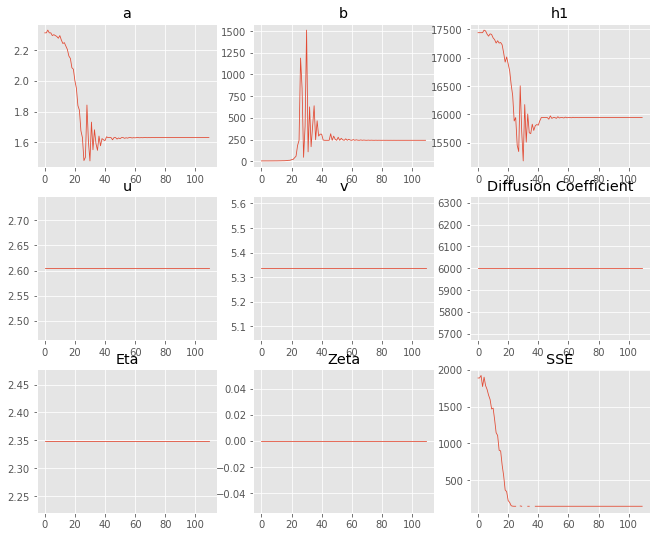

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,2.31138,1.63075
b,3.97177,241.349
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"17,436.9","15,944.5"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 3 Time: 0.060 minutes


Estimated remaining run time: 0.711 minutes


Run 3===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	3.86e+08 	1.48e+01 	6.40e+01 	4.3247 		1.0000


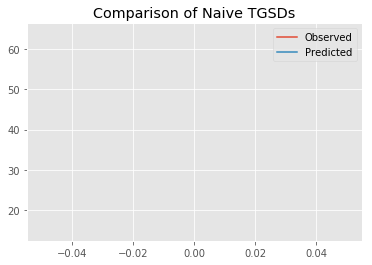

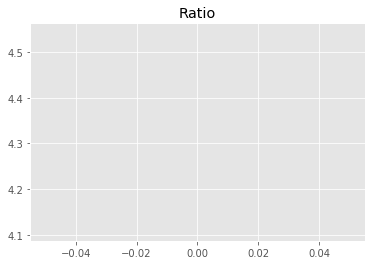

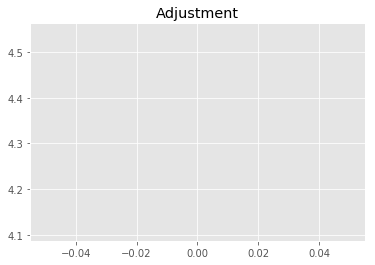

1667574324.2044175
1


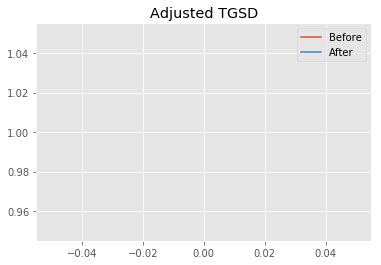

Old Total Mass: 3.8559e+08
New Total Mass: 3.8559e+08
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.55871 	3.52823 	11412.9 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 3.8559e+08
After: 		|1.81291 	5.41069 	6148.96 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 918.299
New Misfit: 147.791
Convergence:
0.8390596273744237

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	3.86e+08 	6.42e+01 	6.40e+01 	0.9967 		1.0000


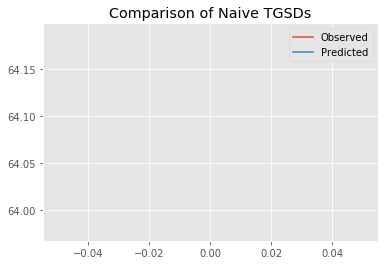

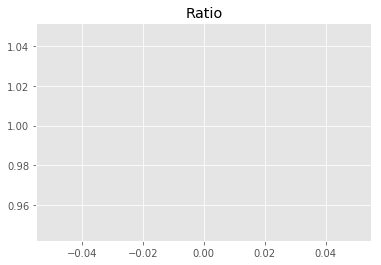

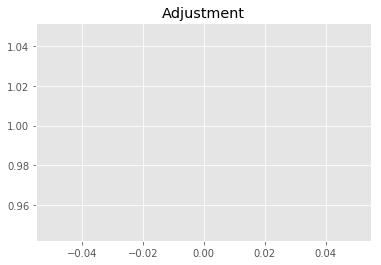

384327799.76459837
1


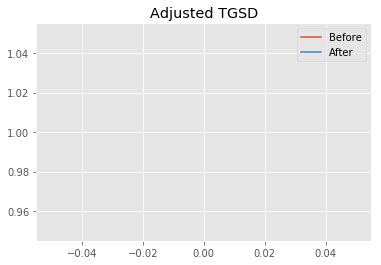

Old Total Mass: 3.8559e+08
New Total Mass: 3.8559e+08
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.81291 	5.41069 	6148.96 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Optimization terminated successfully.
         Current function value: 147.791459
         Iterations: 11
         Function evaluations: 54
New Total Mass: 3.8559e+08
After: 		|1.81291 	5.41069 	6148.96 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 147.791
New Misfit: 147.791
Convergence:
1.9230955334497995e-16

____________________
a = 1.81291	b = 5.41069	            h1 = 6148.95889	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 385589951.36837
Success: True
Status: Successful convergence.
Iterations: 2
Misfit: 147.79145880193963
Prior Misfit: 918.299,	 Post Misfit: 147.791


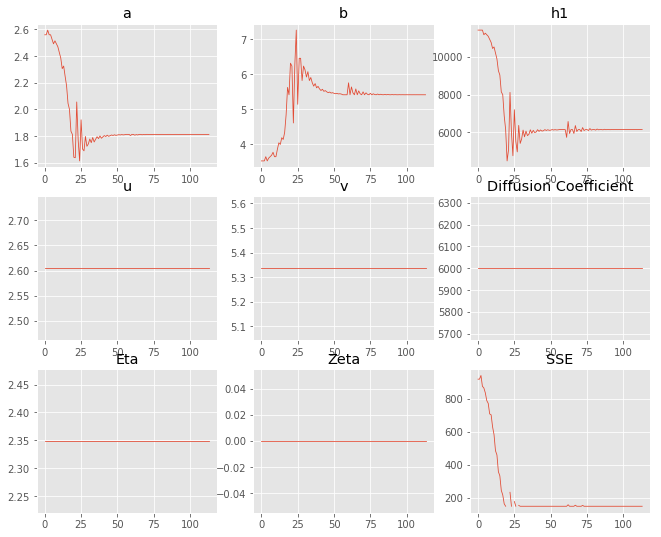

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,2.55871,1.81291
b,3.52823,5.41069
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"11,412.9","6,148.96"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 4 Time: 0.060 minutes


Estimated remaining run time: 0.713 minutes


Run 4===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	3.86e+08 	2.51e+01 	6.40e+01 	2.5483 		1.0000


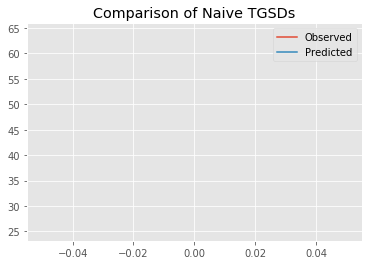

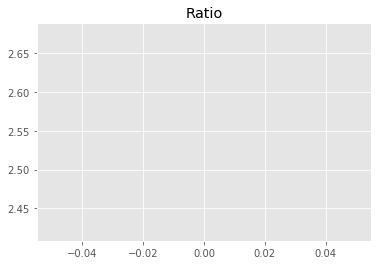

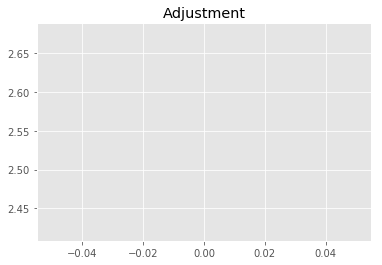

982586018.2809471
1


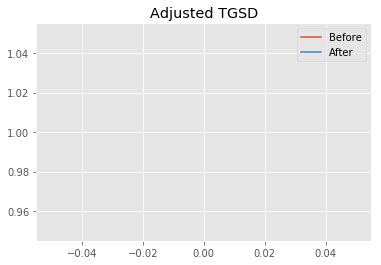

Old Total Mass: 3.8559e+08
New Total Mass: 3.8559e+08
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.56827 	4.38727 	10111.2 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 3.8559e+08
After: 		|2 	6.8652 	6086.13 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 487.07
New Misfit: 147.791
Convergence:
0.6965702978322065

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	3.86e+08 	6.42e+01 	6.40e+01 	0.9967 		1.0000


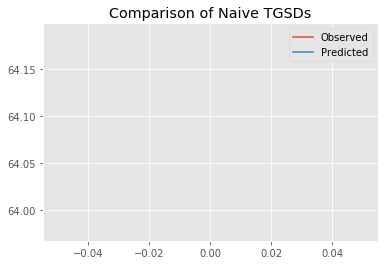

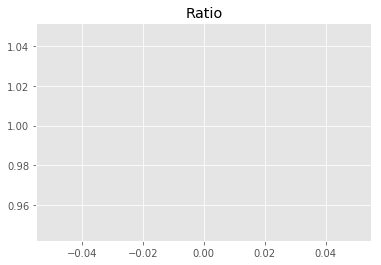

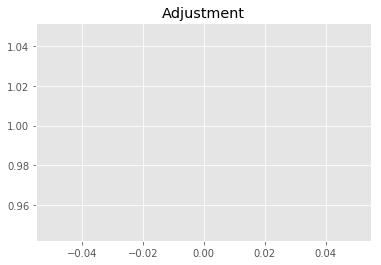

384327799.76459837
1


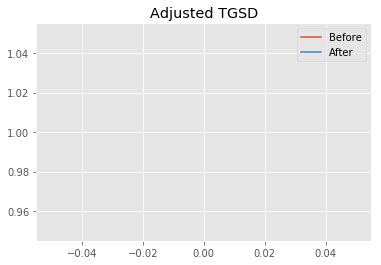

Old Total Mass: 3.8559e+08
New Total Mass: 3.8559e+08
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2 	6.8652 	6086.13 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Optimization terminated successfully.
         Current function value: 147.791459
         Iterations: 11
         Function evaluations: 54
New Total Mass: 3.8559e+08
After: 		|2 	6.8652 	6086.13 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 147.791
New Misfit: 147.791
Convergence:
1.9230955334497995e-16

____________________
a = 2.00000	b = 6.86520	            h1 = 6086.12778	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 385589951.36837
Success: True
Status: Successful convergence.
Iterations: 2
Misfit: 147.79145880193963
Prior Misfit: 487.07,	 Post Misfit: 147.791


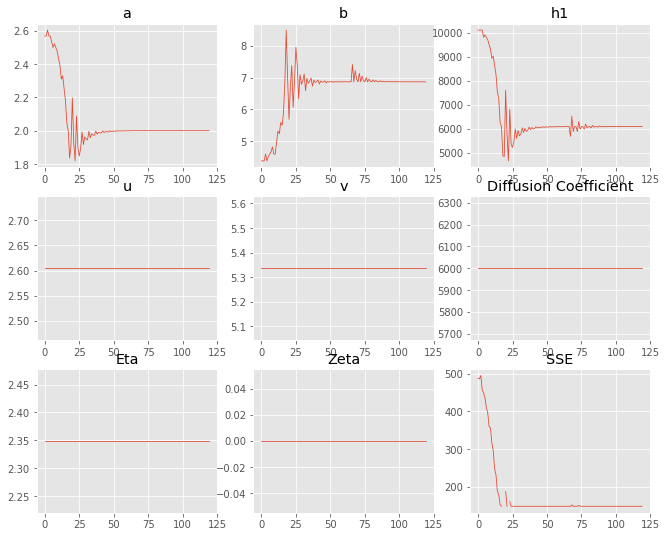

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,2.56827,2
b,4.38727,6.8652
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"10,111.2","6,086.13"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 5 Time: 0.061 minutes


Estimated remaining run time: 0.698 minutes


Run 5===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	3.86e+08 	4.85e+00 	6.40e+01 	13.1944 		1.0000


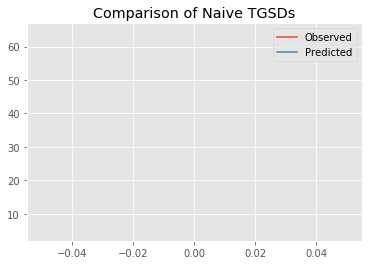

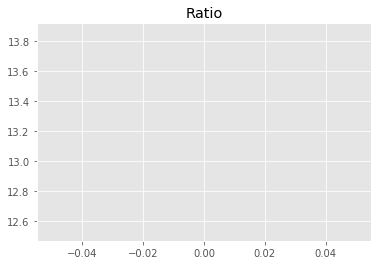

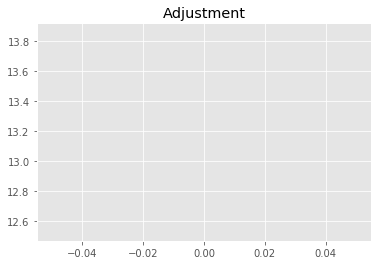

5087637830.445904
1


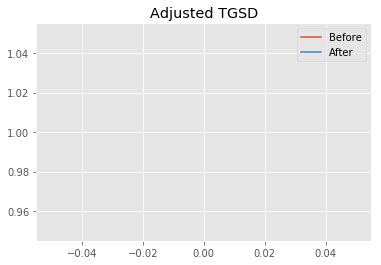

Old Total Mass: 3.8559e+08
New Total Mass: 3.8559e+08
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.34591 	1.78057 	23312.6 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 3.8559e+08
After: 		|1.0342 	1.87062 	5770.14 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 2934.27
New Misfit: 147.791
Convergence:
0.9496326976852152

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	3.86e+08 	6.42e+01 	6.40e+01 	0.9967 		1.0000


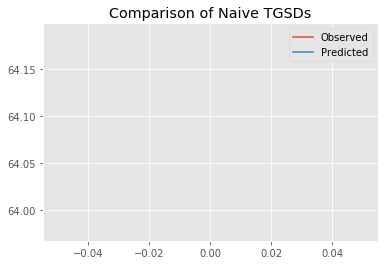

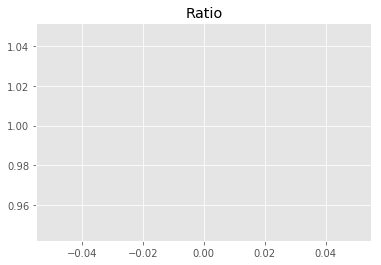

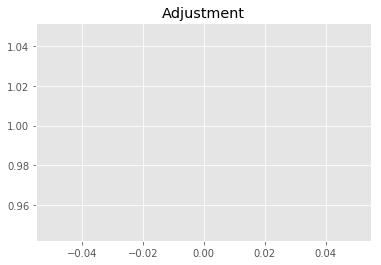

384327799.76459837
1


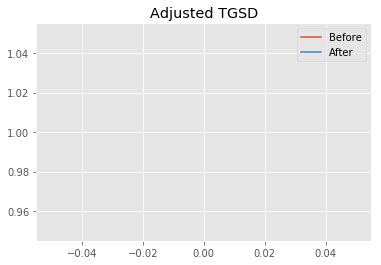

Old Total Mass: 3.8559e+08
New Total Mass: 3.8559e+08
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.0342 	1.87062 	5770.14 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Optimization terminated successfully.
         Current function value: 147.791459
         Iterations: 12
         Function evaluations: 59
New Total Mass: 3.8559e+08
After: 		|1.0342 	1.87062 	5770.14 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 147.791
New Misfit: 147.791
Convergence:
1.9230955334497995e-16

____________________
a = 1.03420	b = 1.87062	            h1 = 5770.13562	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 385589951.36837
Success: True
Status: Successful convergence.
Iterations: 2
Misfit: 147.79145880193963
Prior Misfit: 2934.27,	 Post Misfit: 147.791


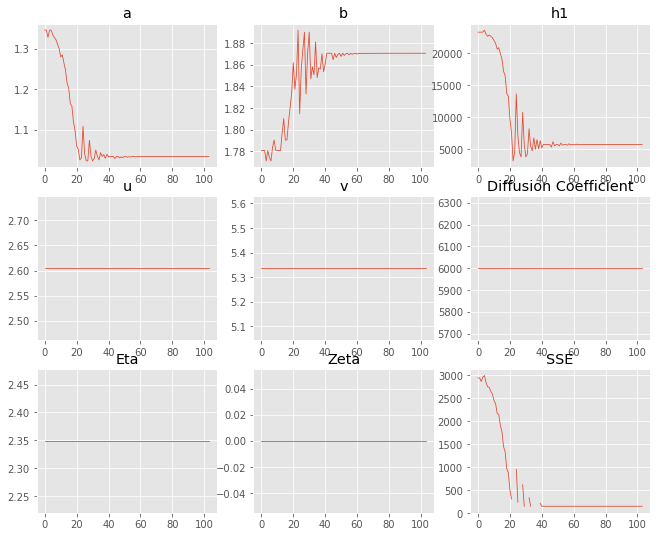

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,1.34591,1.0342
b,1.78057,1.87062
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"23,312.6","5,770.14"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 6 Time: 0.063 minutes


Estimated remaining run time: 0.672 minutes


Run 6===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	3.86e+08 	1.74e+01 	6.40e+01 	3.6700 		1.0000


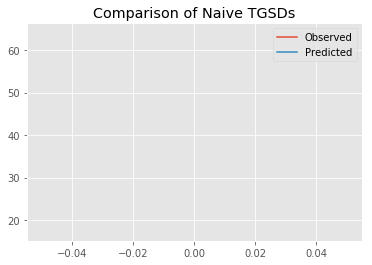

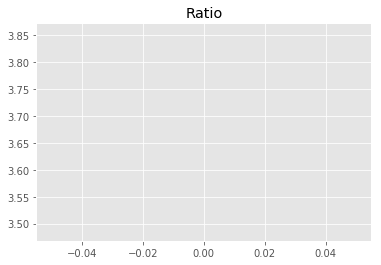

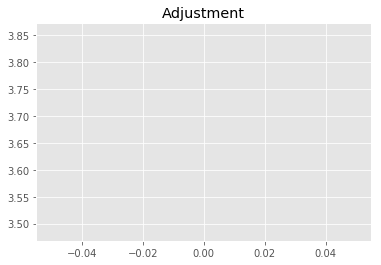

1415101945.6231973
1


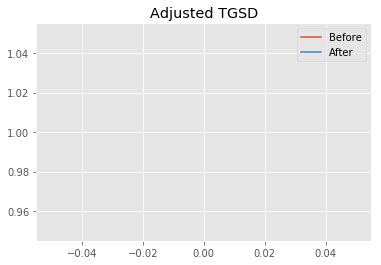

Old Total Mass: 3.8559e+08
New Total Mass: 3.8559e+08
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.07691 	2.12641 	9393.36 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 3.8559e+08
After: 		|2.0446 	2.14468 	5355.79 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 756.601
New Misfit: 147.791
Convergence:
0.8046638190951553

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	3.86e+08 	6.42e+01 	6.40e+01 	0.9967 		1.0000


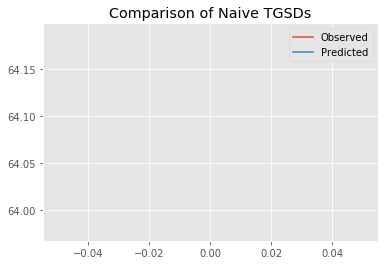

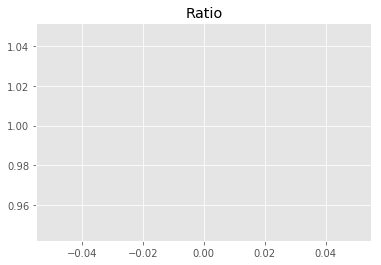

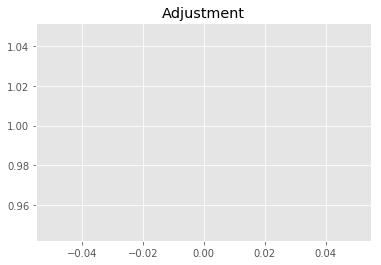

384327799.76459837
1


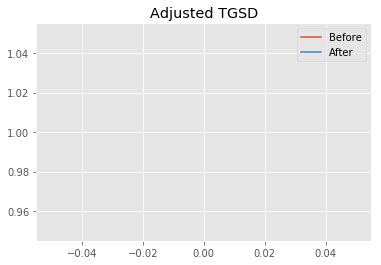

Old Total Mass: 3.8559e+08
New Total Mass: 3.8559e+08
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.0446 	2.14468 	5355.79 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Optimization terminated successfully.
         Current function value: 147.791459
         Iterations: 10
         Function evaluations: 49
New Total Mass: 3.8559e+08
After: 		|2.0446 	2.14468 	5355.79 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 147.791
New Misfit: 147.791
Convergence:
1.9230955334497995e-16

____________________
a = 2.04460	b = 2.14468	            h1 = 5355.78906	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 385589951.36837
Success: True
Status: Successful convergence.
Iterations: 2
Misfit: 147.79145880193963
Prior Misfit: 756.601,	 Post Misfit: 147.791


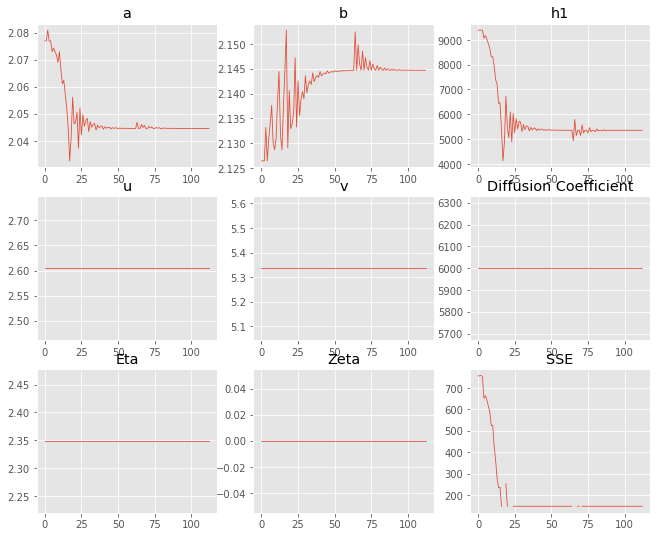

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,2.07691,2.0446
b,2.12641,2.14468
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"9,393.36","5,355.79"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 7 Time: 0.064 minutes


Estimated remaining run time: 0.639 minutes


Run 7===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	3.86e+08 	4.67e+00 	6.40e+01 	13.7144 		1.0000


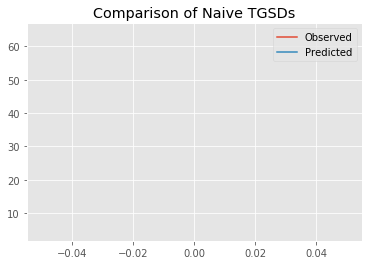

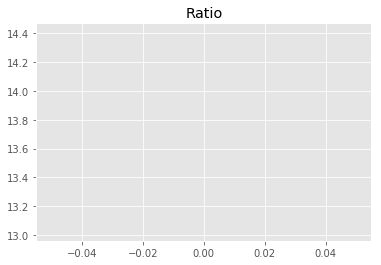

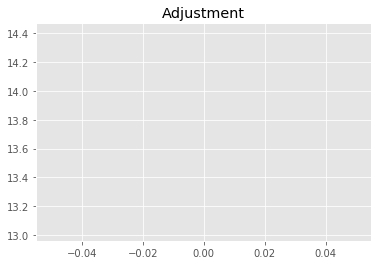

5288121380.764234
1


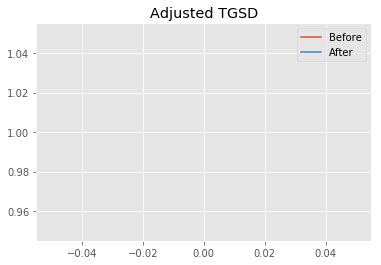

Old Total Mass: 3.8559e+08
New Total Mass: 3.8559e+08
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.35621 	3.07278 	36280.3 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 3.8559e+08
After: 		|1.19175 	5.91069 	5749.5 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 3048.28
New Misfit: 147.791
Convergence:
0.9515164084374683

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	3.86e+08 	6.42e+01 	6.40e+01 	0.9967 		1.0000


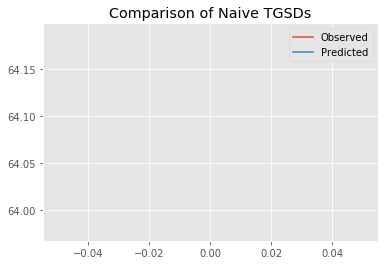

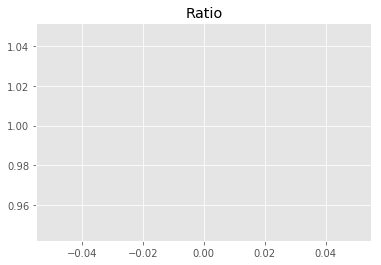

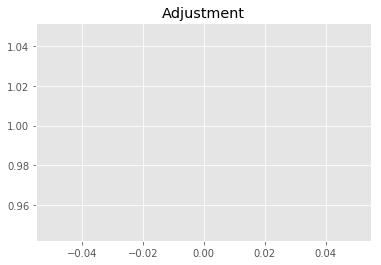

384327799.76459837
1


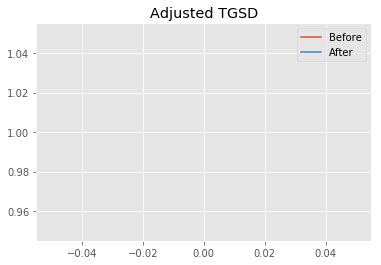

Old Total Mass: 3.8559e+08
New Total Mass: 3.8559e+08
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.19175 	5.91069 	5749.5 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Optimization terminated successfully.
         Current function value: 147.791459
         Iterations: 11
         Function evaluations: 54
New Total Mass: 3.8559e+08
After: 		|1.19175 	5.91069 	5749.5 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 147.791
New Misfit: 147.791
Convergence:
1.9230955334497995e-16

____________________
a = 1.19175	b = 5.91069	            h1 = 5749.49925	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 385589951.36837
Success: True
Status: Successful convergence.
Iterations: 2
Misfit: 147.79145880193963
Prior Misfit: 3048.28,	 Post Misfit: 147.791


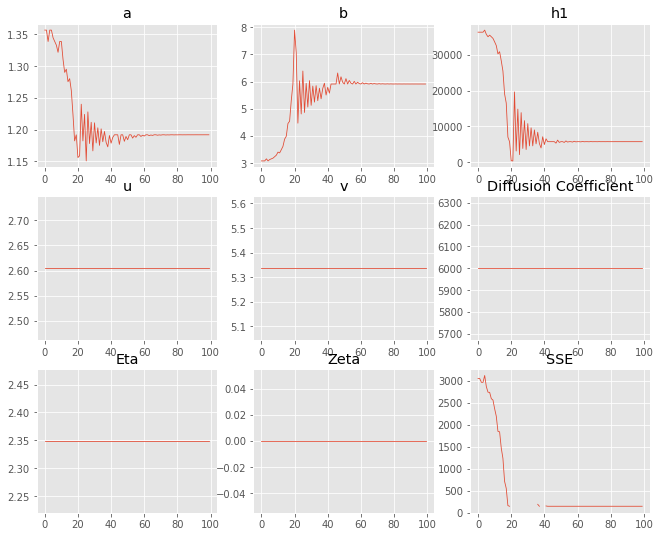

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,1.35621,1.19175
b,3.07278,5.91069
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"36,280.3","5,749.5"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 8 Time: 0.059 minutes


Estimated remaining run time: 0.593 minutes


Run 8===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	3.86e+08 	6.28e+00 	6.40e+01 	10.1824 		1.0000


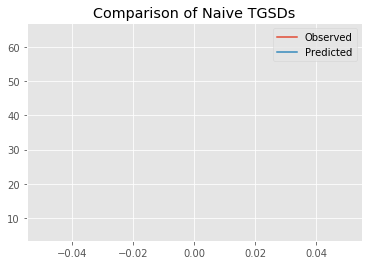

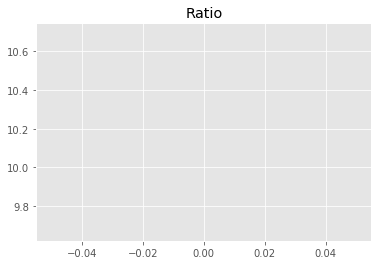

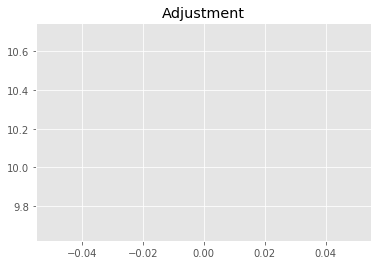

3926235499.4977803
1


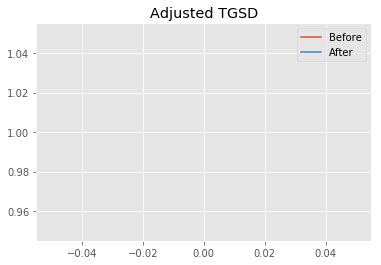

Old Total Mass: 3.8559e+08
New Total Mass: 3.8559e+08
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.44023 	3.94133 	33048.4 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 3.8559e+08
After: 		|1.25827 	11.9297 	5426.65 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 2241.2
New Misfit: 147.791
Convergence:
0.9340569164496426

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	3.86e+08 	6.42e+01 	6.40e+01 	0.9967 		1.0000


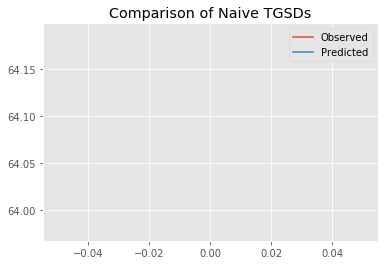

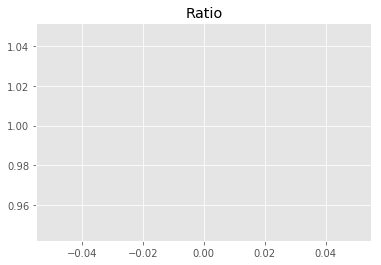

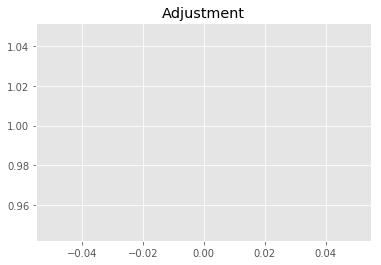

384327799.76459837
1


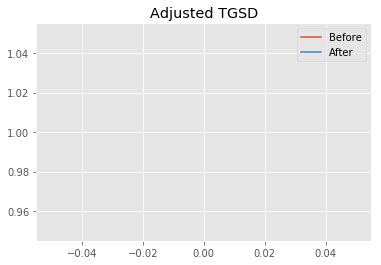

Old Total Mass: 3.8559e+08
New Total Mass: 3.8559e+08
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.25827 	11.9297 	5426.65 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Optimization terminated successfully.
         Current function value: 147.791459
         Iterations: 12
         Function evaluations: 59
New Total Mass: 3.8559e+08
After: 		|1.25827 	11.9297 	5426.65 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 147.791
New Misfit: 147.791
Convergence:
1.9230955334497995e-16

____________________
a = 1.25827	b = 11.92965	            h1 = 5426.64528	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 385589951.36837
Success: True
Status: Successful convergence.
Iterations: 2
Misfit: 147.79145880193963
Prior Misfit: 2241.2,	 Post Misfit: 147.791


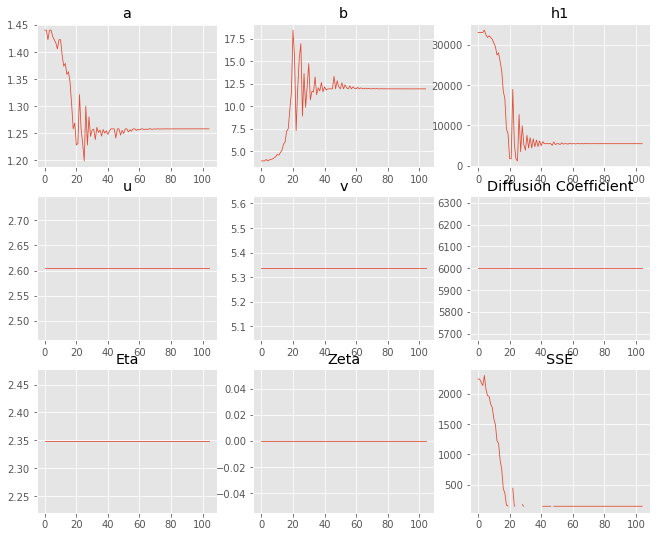

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,1.44023,1.25827
b,3.94133,11.9297
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"33,048.4","5,426.65"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 9 Time: 0.058 minutes


Estimated remaining run time: 0.543 minutes


Run 9===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	3.86e+08 	4.29e+01 	6.40e+01 	1.4904 		1.0000


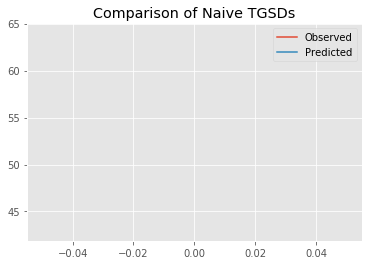

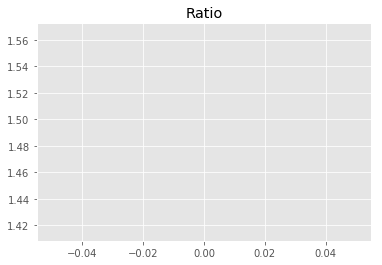

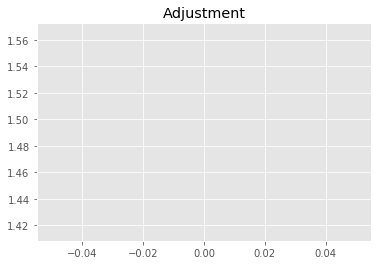

574667265.9740613
1


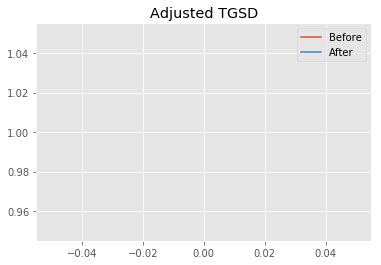

Old Total Mass: 3.8559e+08
New Total Mass: 3.8559e+08
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.83263 	1.92251 	6569.19 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Optimization terminated successfully.
         Current function value: 147.791459
         Iterations: 14
         Function evaluations: 54
New Total Mass: 3.8559e+08
After: 		|1.83263 	1.92251 	6162.81 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 248.517
New Misfit: 147.791
Convergence:
0.4053074062206357

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	3.86e+08 	6.42e+01 	6.40e+01 	0.9967 		1.0000


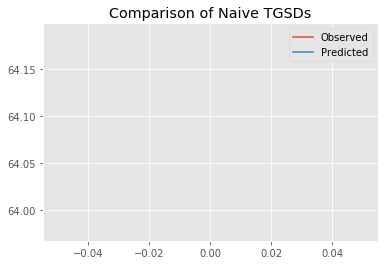

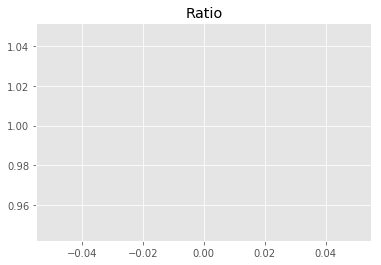

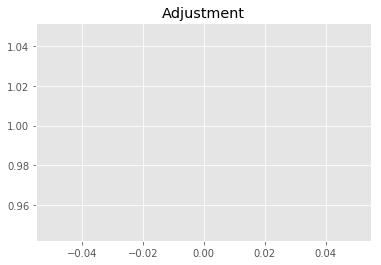

384327799.76459837
1


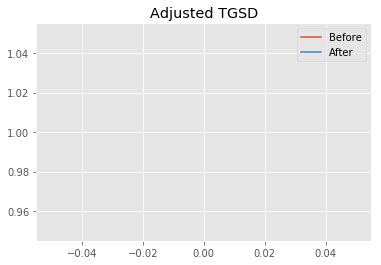

Old Total Mass: 3.8559e+08
New Total Mass: 3.8559e+08
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.83263 	1.92251 	6162.81 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Optimization terminated successfully.
         Current function value: 147.791459
         Iterations: 10
         Function evaluations: 49
New Total Mass: 3.8559e+08
After: 		|1.83263 	1.92251 	6162.81 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 147.791
New Misfit: 147.791
Convergence:
1.9230955334497995e-16

____________________
a = 1.83263	b = 1.92251	            h1 = 6162.81118	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 385589951.36837
Success: True
Status: Successful convergence.
Iterations: 2
Misfit: 147.79145880193963
Prior Misfit: 248.517,	 Post Misfit: 147.791


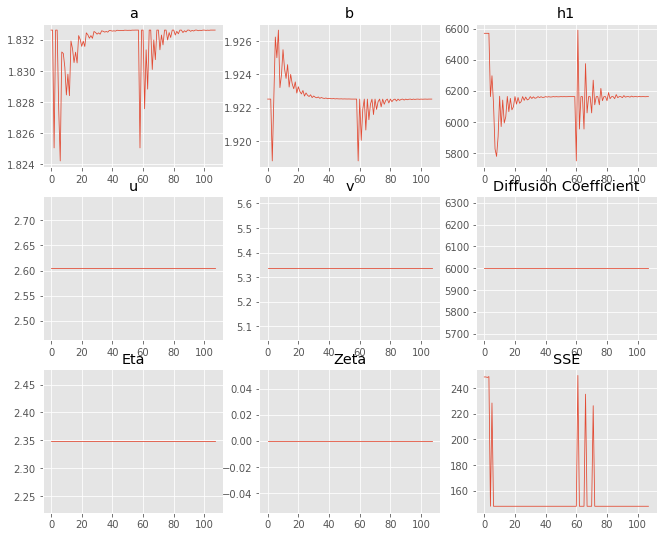

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,1.83263,1.83263
b,1.92251,1.92251
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"6,569.19","6,162.81"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 10 Time: 0.058 minutes


Estimated remaining run time: 0.492 minutes


Run 10===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	3.86e+08 	1.29e+01 	6.40e+01 	4.9549 		1.0000


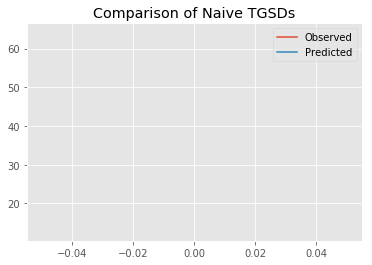

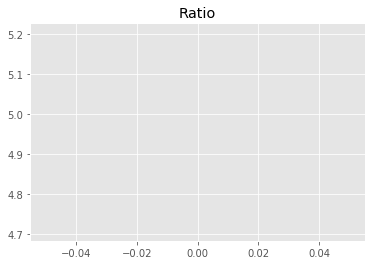

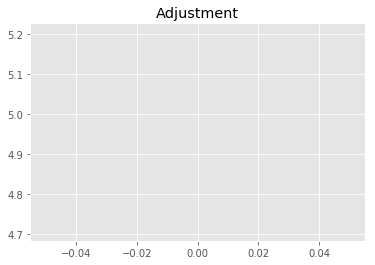

1910565383.2668283
1


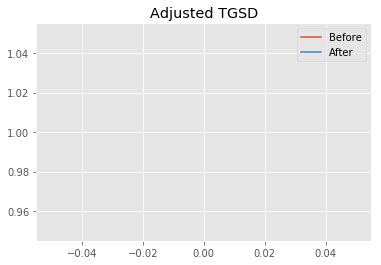

Old Total Mass: 3.8559e+08
New Total Mass: 3.8559e+08
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.89622 	4.68028 	12888 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 3.8559e+08
After: 		|1.22954 	90.5962 	8646.47 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 1078.19
New Misfit: 147.791
Convergence:
0.8629268889064453

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	3.86e+08 	6.42e+01 	6.40e+01 	0.9967 		1.0000


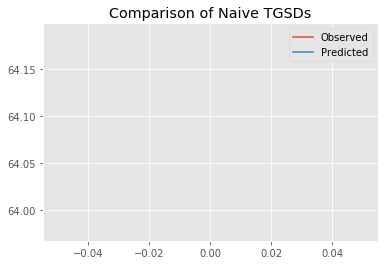

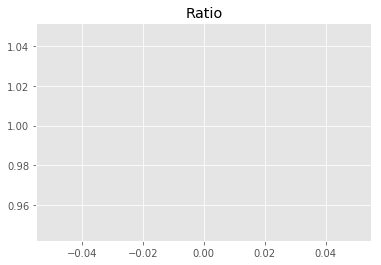

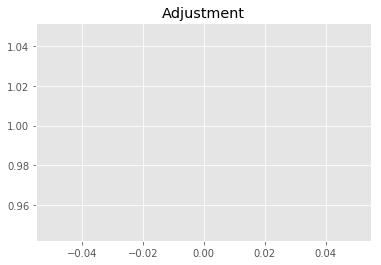

384327799.76459837
1


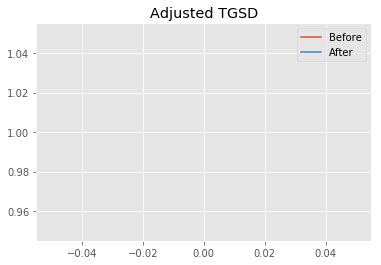

Old Total Mass: 3.8559e+08
New Total Mass: 3.8559e+08
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.22954 	90.5962 	8646.47 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Optimization terminated successfully.
         Current function value: 147.791459
         Iterations: 13
         Function evaluations: 64
New Total Mass: 3.8559e+08
After: 		|1.22954 	90.5962 	8646.47 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 147.791
New Misfit: 147.791
Convergence:
1.9230955334497995e-16

____________________
a = 1.22954	b = 90.59615	            h1 = 8646.47247	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 385589951.36837
Success: True
Status: Successful convergence.
Iterations: 2
Misfit: 147.79145880193963
Prior Misfit: 1078.19,	 Post Misfit: 147.791


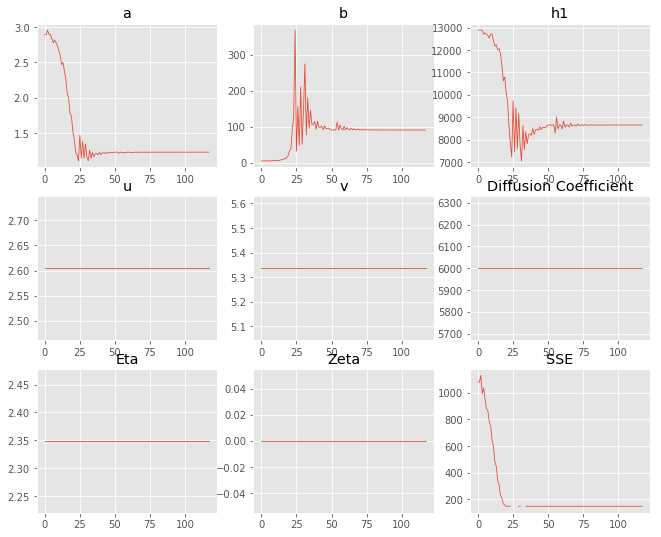

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,2.89622,1.22954
b,4.68028,90.5962
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"12,888","8,646.47"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 11 Time: 0.063 minutes


Estimated remaining run time: 0.443 minutes


Run 11===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	3.86e+08 	6.42e+01 	6.40e+01 	0.9967 		1.0000


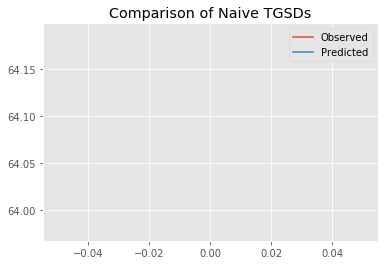

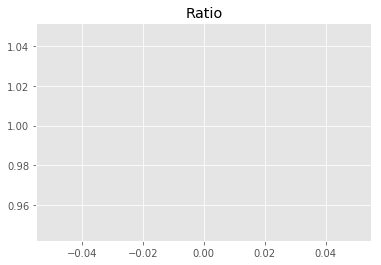

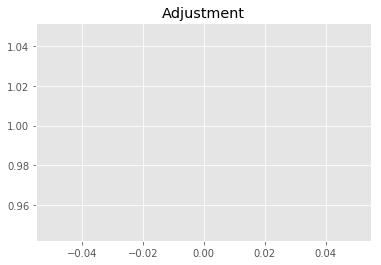

384327799.76459837
1


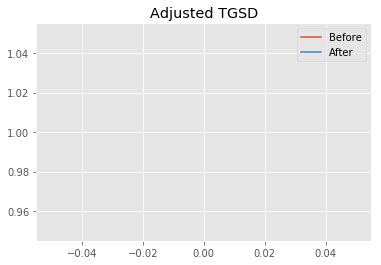

Old Total Mass: 3.8559e+08
New Total Mass: 3.8559e+08
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.96825 	1.24599 	5622.65 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Optimization terminated successfully.
         Current function value: 147.791459
         Iterations: 11
         Function evaluations: 54
New Total Mass: 3.8559e+08
After: 		|1.96825 	1.24599 	5622.65 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 147.791
New Misfit: 147.791
Convergence:
1.9230955334497995e-16

____________________
a = 1.96825	b = 1.24599	            h1 = 5622.65308	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 385589951.36837
Success: True
Status: Successful convergence.
Iterations: 1
Misfit: 147.79145880193963
Prior Misfit: 147.791,	 Post Misfit: 147.791


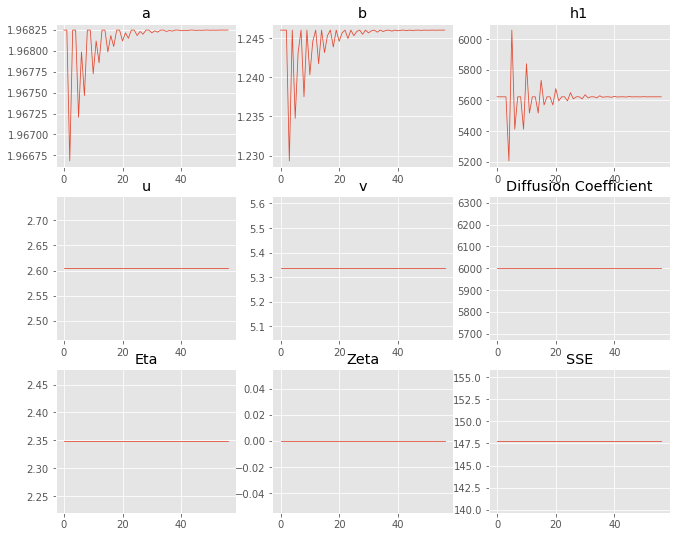

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,1.96825,1.96825
b,1.24599,1.24599
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"5,622.65","5,622.65"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 12 Time: 0.036 minutes


Estimated remaining run time: 0.377 minutes


Run 12===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	3.86e+08 	6.78e+00 	6.40e+01 	9.4352 		1.0000


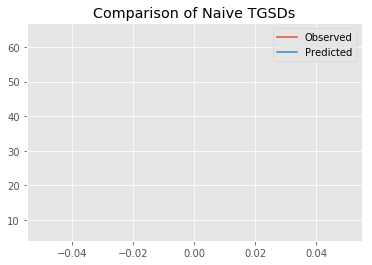

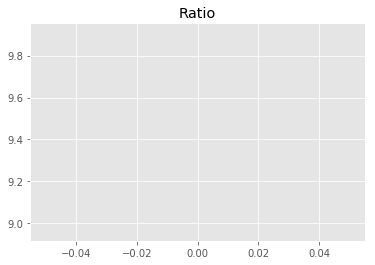

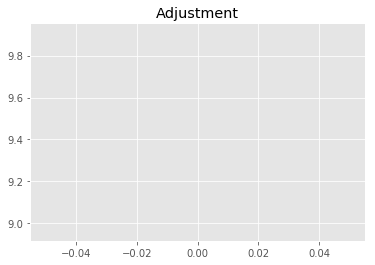

3638114221.141873
1


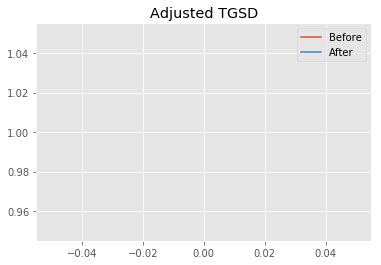

Old Total Mass: 3.8559e+08
New Total Mass: 3.8559e+08
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.48592 	3.82475 	12620.8 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 3.8559e+08
After: 		|1.01747 	67.675 	7274.49 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 2266.73
New Misfit: 147.791
Convergence:
0.9347997763288008

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	3.86e+08 	6.42e+01 	6.40e+01 	0.9967 		1.0000


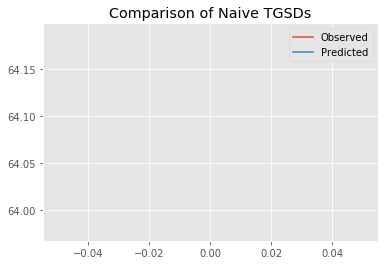

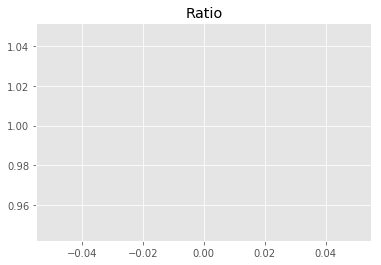

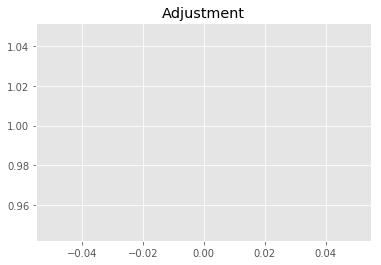

384327799.76459837
1


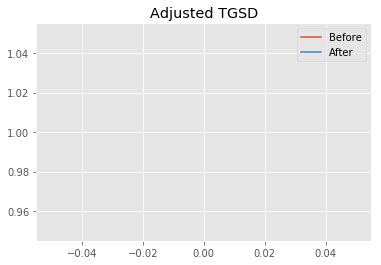

Old Total Mass: 3.8559e+08
New Total Mass: 3.8559e+08
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.01747 	67.675 	7274.49 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Optimization terminated successfully.
         Current function value: 147.791459
         Iterations: 13
         Function evaluations: 64
New Total Mass: 3.8559e+08
After: 		|1.01747 	67.675 	7274.49 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 147.791
New Misfit: 147.791
Convergence:
1.9230955334497995e-16

____________________
a = 1.01747	b = 67.67503	            h1 = 7274.48542	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 385589951.36837
Success: True
Status: Successful convergence.
Iterations: 2
Misfit: 147.79145880193963
Prior Misfit: 2266.73,	 Post Misfit: 147.791


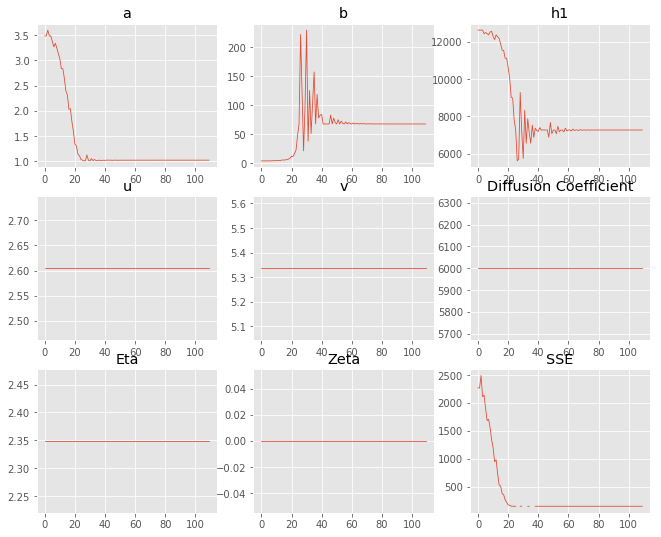

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,3.48592,1.01747
b,3.82475,67.675
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"12,620.8","7,274.49"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 13 Time: 0.058 minutes


Estimated remaining run time: 0.325 minutes


Run 13===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	3.86e+08 	6.73e+00 	6.40e+01 	9.5072 		1.0000


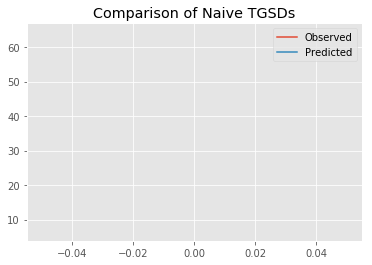

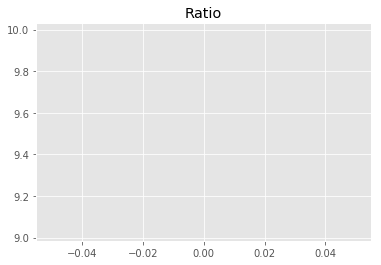

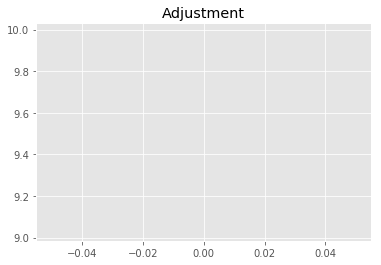

3665887171.183889
1


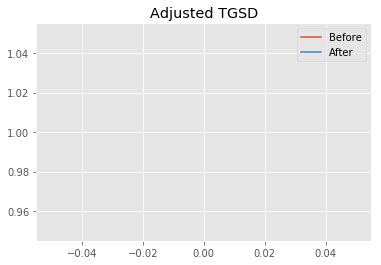

Old Total Mass: 3.8559e+08
New Total Mass: 3.8559e+08
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.51256 	3.41812 	15533.9 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 3.8559e+08
After: 		|1.02222 	355.913 	13960.1 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 2185.47
New Misfit: 147.791
Convergence:
0.9323754930259153

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	3.86e+08 	6.42e+01 	6.40e+01 	0.9967 		1.0000


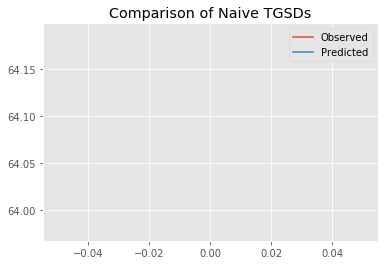

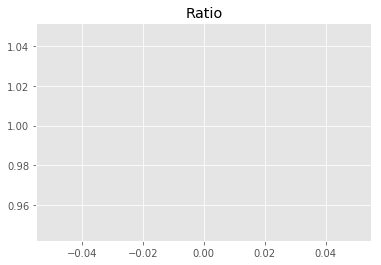

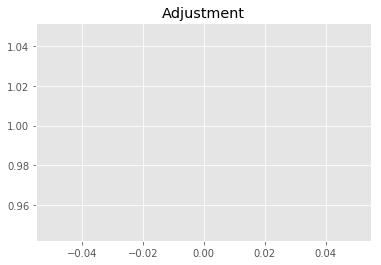

384327799.76459837
1


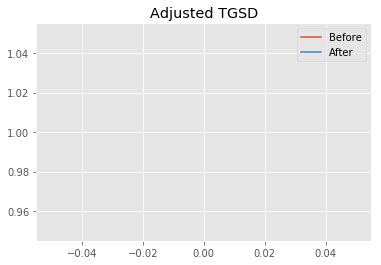

Old Total Mass: 3.8559e+08
New Total Mass: 3.8559e+08
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.02222 	355.913 	13960.1 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Optimization terminated successfully.
         Current function value: 147.791459
         Iterations: 13
         Function evaluations: 64
New Total Mass: 3.8559e+08
After: 		|1.02222 	355.913 	13960.1 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 147.791
New Misfit: 147.791
Convergence:
1.9230955334497995e-16

____________________
a = 1.02222	b = 355.91287	            h1 = 13960.11072	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 385589951.36837
Success: True
Status: Successful convergence.
Iterations: 2
Misfit: 147.79145880193963
Prior Misfit: 2185.47,	 Post Misfit: 147.791


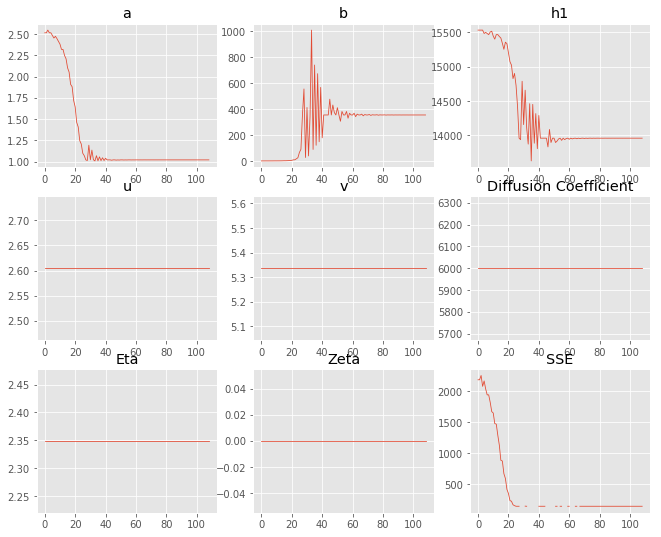

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,2.51256,1.02222
b,3.41812,355.913
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"15,533.9","13,960.1"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 14 Time: 0.059 minutes


Estimated remaining run time: 0.273 minutes


Run 14===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	3.86e+08 	4.40e+01 	6.40e+01 	1.4546 		1.0000


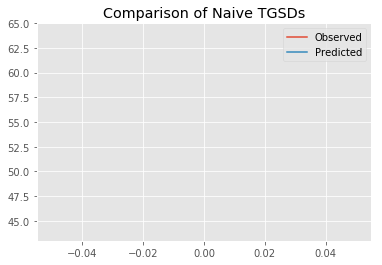

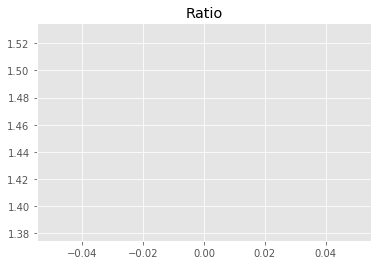

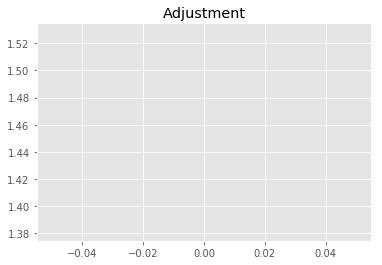

560883492.9272966
1


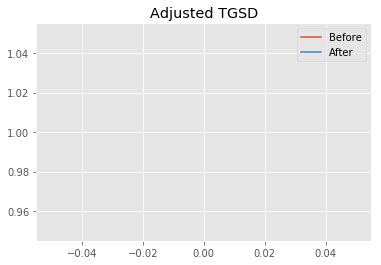

Old Total Mass: 3.8559e+08
New Total Mass: 3.8559e+08
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.91248 	4.20194 	8048.47 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Optimization terminated successfully.
         Current function value: 147.791459
         Iterations: 19
         Function evaluations: 67
New Total Mass: 3.8559e+08
After: 		|1.92746 	4.5509 	6123.84 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 237.387
New Misfit: 147.791
Convergence:
0.3774245108868919

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	3.86e+08 	6.42e+01 	6.40e+01 	0.9967 		1.0000


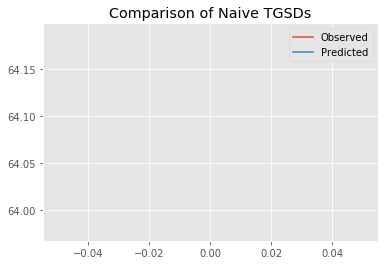

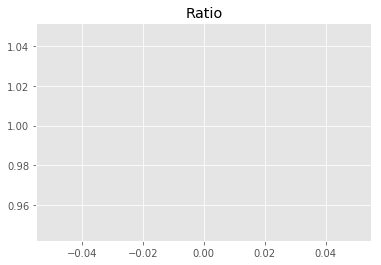

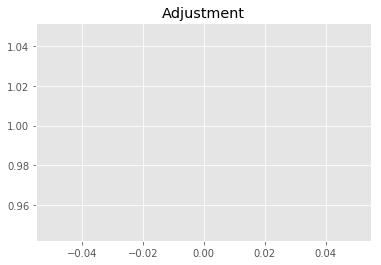

384327799.76459837
1


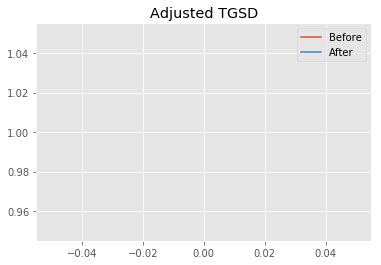

Old Total Mass: 3.8559e+08
New Total Mass: 3.8559e+08
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.92746 	4.5509 	6123.84 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Optimization terminated successfully.
         Current function value: 147.791459
         Iterations: 11
         Function evaluations: 54
New Total Mass: 3.8559e+08
After: 		|1.92746 	4.5509 	6123.84 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 147.791
New Misfit: 147.791
Convergence:
1.9230955334497995e-16

____________________
a = 1.92746	b = 4.55090	            h1 = 6123.84302	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 385589951.36837
Success: True
Status: Successful convergence.
Iterations: 2
Misfit: 147.79145880193963
Prior Misfit: 237.387,	 Post Misfit: 147.791


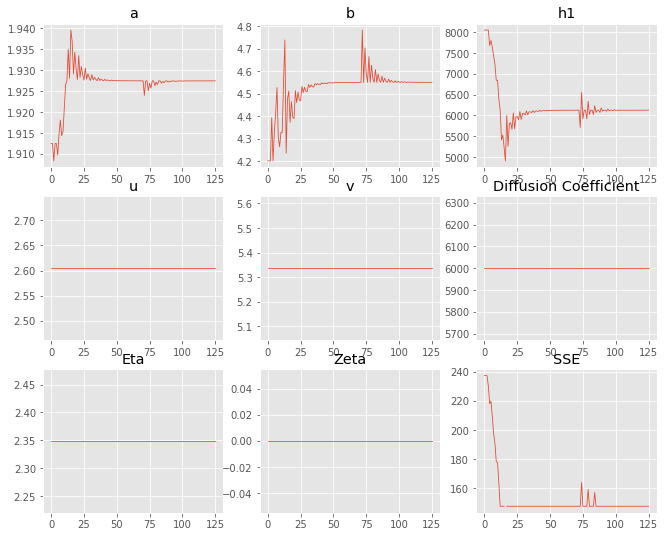

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,1.91248,1.92746
b,4.20194,4.5509
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"8,048.47","6,123.84"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 15 Time: 0.065 minutes


Estimated remaining run time: 0.221 minutes


Run 15===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	3.86e+08 	6.09e+00 	6.40e+01 	10.5104 		1.0000


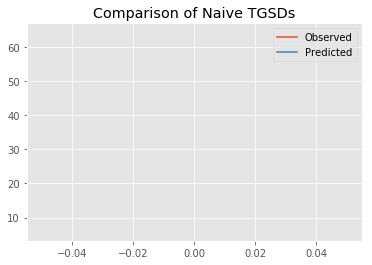

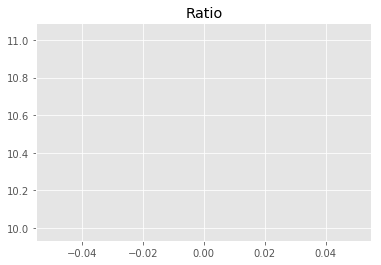

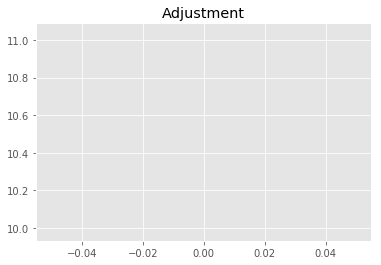

4052689634.9579825
1


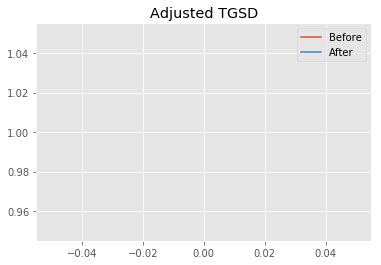

Old Total Mass: 3.8559e+08
New Total Mass: 3.8559e+08
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|3.5106 	3.47683 	12382.2 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 3.8559e+08
After: 		|1.01196 	57.0984 	6727.87 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 2557.62
New Misfit: 147.791
Convergence:
0.9422152496132082

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	3.86e+08 	6.42e+01 	6.40e+01 	0.9967 		1.0000


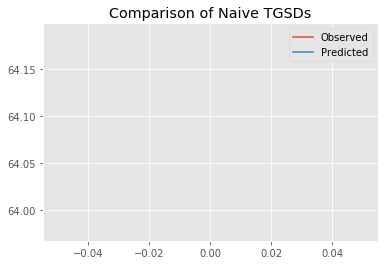

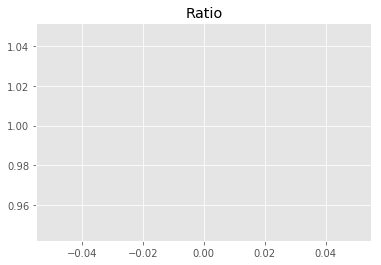

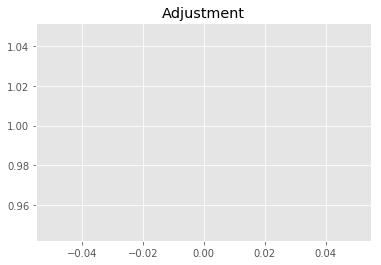

384327799.76459837
1


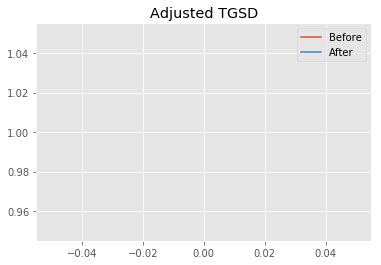

Old Total Mass: 3.8559e+08
New Total Mass: 3.8559e+08
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.01196 	57.0984 	6727.87 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Optimization terminated successfully.
         Current function value: 147.791459
         Iterations: 13
         Function evaluations: 64
New Total Mass: 3.8559e+08
After: 		|1.01196 	57.0984 	6727.87 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 147.791
New Misfit: 147.791
Convergence:
1.9230955334497995e-16

____________________
a = 1.01196	b = 57.09842	            h1 = 6727.86839	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 385589951.36837
Success: True
Status: Successful convergence.
Iterations: 2
Misfit: 147.79145880193963
Prior Misfit: 2557.62,	 Post Misfit: 147.791


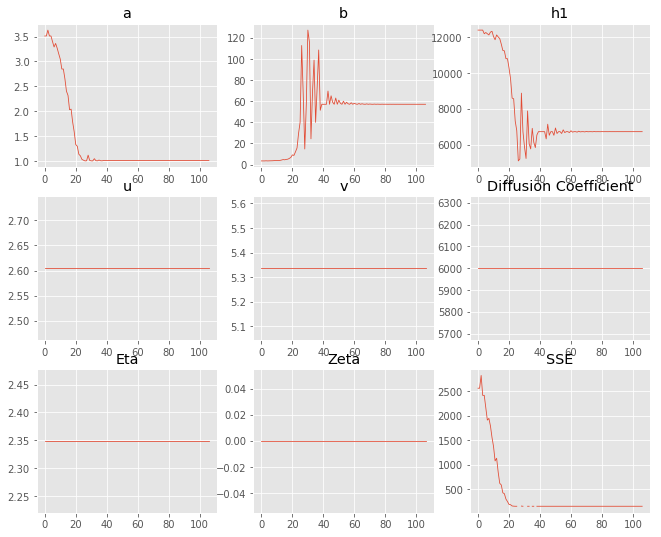

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,3.5106,1.01196
b,3.47683,57.0984
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"12,382.2","6,727.87"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 16 Time: 0.059 minutes


Estimated remaining run time: 0.166 minutes


Run 16===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	3.86e+08 	4.02e+01 	6.40e+01 	1.5925 		1.0000


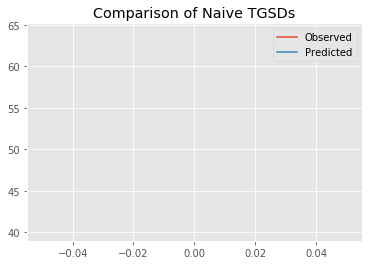

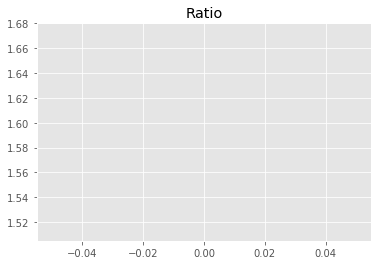

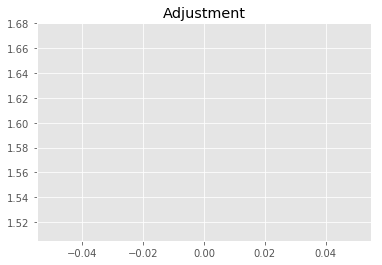

614048438.7161835
1


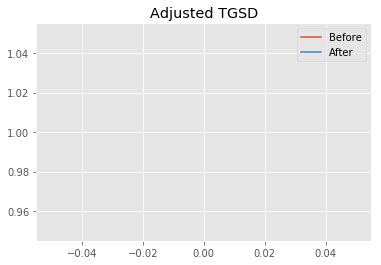

Old Total Mass: 3.8559e+08
New Total Mass: 3.8559e+08
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.12748 	3.34861 	7637.95 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Optimization terminated successfully.
         Current function value: 147.791459
         Iterations: 18
         Function evaluations: 62
New Total Mass: 3.8559e+08
After: 		|2.12073 	3.41641 	5931.11 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 267.986
New Misfit: 147.791
Convergence:
0.44851113192089953

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	3.86e+08 	6.42e+01 	6.40e+01 	0.9967 		1.0000


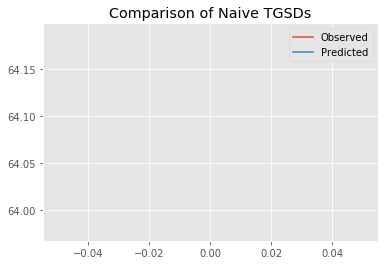

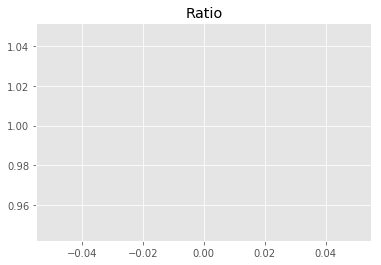

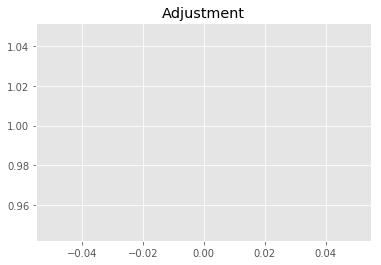

384327799.76459837
1


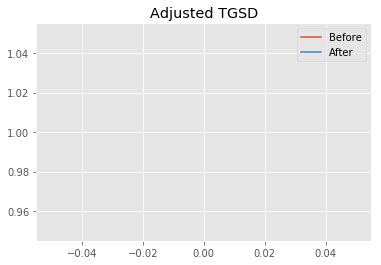

Old Total Mass: 3.8559e+08
New Total Mass: 3.8559e+08
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.12073 	3.41641 	5931.11 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Optimization terminated successfully.
         Current function value: 147.791459
         Iterations: 10
         Function evaluations: 49
New Total Mass: 3.8559e+08
After: 		|2.12073 	3.41641 	5931.11 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 147.791
New Misfit: 147.791
Convergence:
1.9230955334497995e-16

____________________
a = 2.12073	b = 3.41641	            h1 = 5931.11214	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 385589951.36837
Success: True
Status: Successful convergence.
Iterations: 2
Misfit: 147.79145880193963
Prior Misfit: 267.986,	 Post Misfit: 147.791


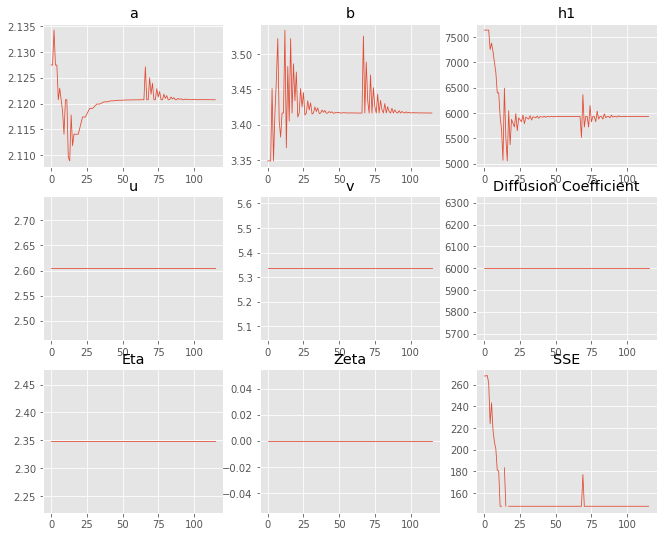

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,2.12748,2.12073
b,3.34861,3.41641
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"7,637.95","5,931.11"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 17 Time: 0.062 minutes


Estimated remaining run time: 0.111 minutes


Run 17===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	3.86e+08 	1.60e+01 	6.40e+01 	4.0019 		1.0000


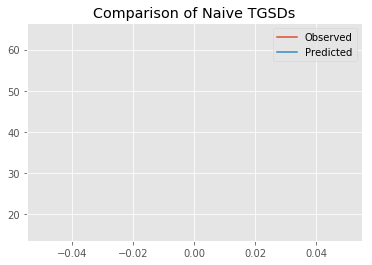

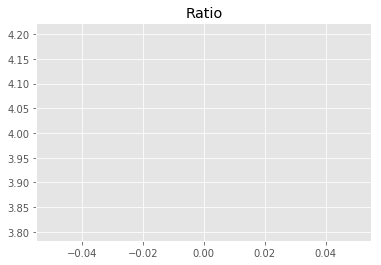

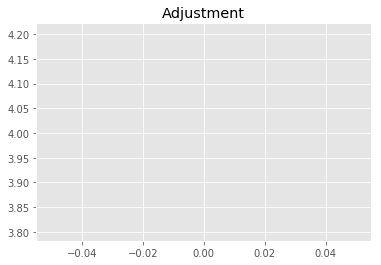

1543077495.9996214
1


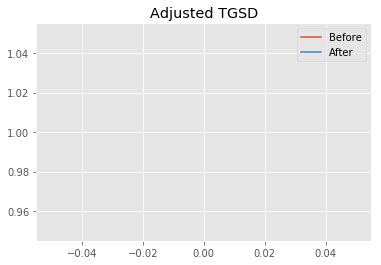

Old Total Mass: 3.8559e+08
New Total Mass: 3.8559e+08
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.38503 	2.91375 	14454.6 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 3.8559e+08
After: 		|1.08186 	105.003 	7742.11 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 810.782
New Misfit: 147.791
Convergence:
0.8177174570011451

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	3.86e+08 	6.42e+01 	6.40e+01 	0.9967 		1.0000


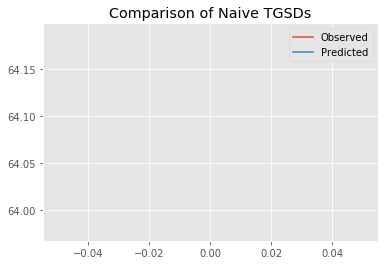

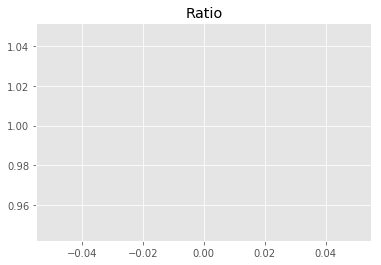

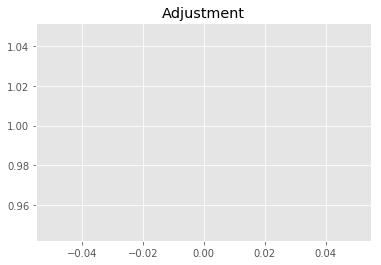

384327799.76459837
1


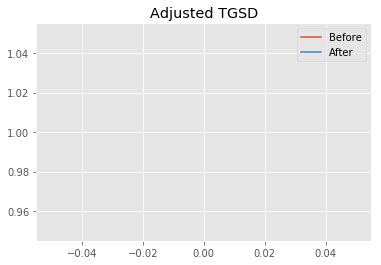

Old Total Mass: 3.8559e+08
New Total Mass: 3.8559e+08
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|1.08186 	105.003 	7742.11 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Optimization terminated successfully.
         Current function value: 147.791459
         Iterations: 13
         Function evaluations: 64
New Total Mass: 3.8559e+08
After: 		|1.08186 	105.003 	7742.11 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 147.791
New Misfit: 147.791
Convergence:
1.9230955334497995e-16

____________________
a = 1.08186	b = 105.00341	            h1 = 7742.11422	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 385589951.36837
Success: True
Status: Successful convergence.
Iterations: 2
Misfit: 147.79145880193963
Prior Misfit: 810.782,	 Post Misfit: 147.791


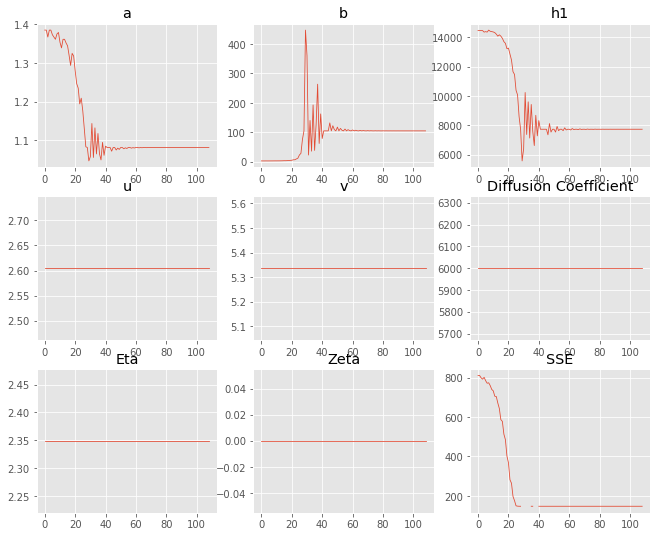

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,1.38503,1.08186
b,2.91375,105.003
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"14,454.6","7,742.11"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 18 Time: 0.059 minutes


Estimated remaining run time: 0.056 minutes


Run 18===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	3.86e+08 	3.26e+01 	6.40e+01 	1.9647 		1.0000


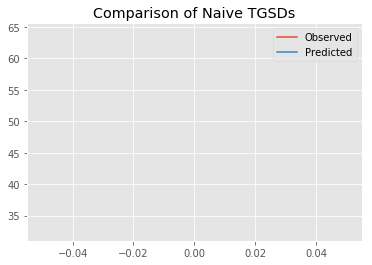

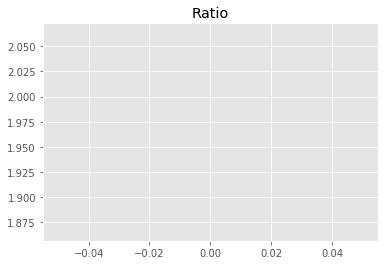

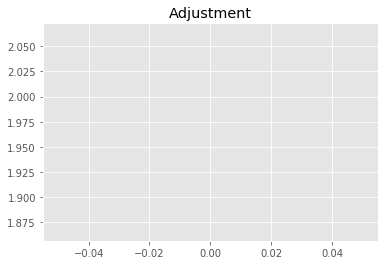

757560836.2769234
1


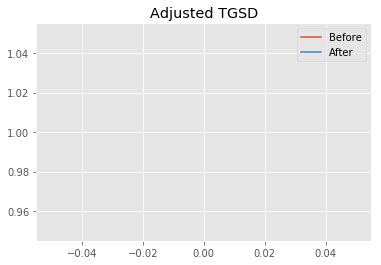

Old Total Mass: 3.8559e+08
New Total Mass: 3.8559e+08
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.19488 	3.66944 	8745.23 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 3.8559e+08
After: 		|2.15651 	3.77333 	5893.01 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 350.598
New Misfit: 147.791
Convergence:
0.5784593213071914

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	3.86e+08 	6.42e+01 	6.40e+01 	0.9967 		1.0000


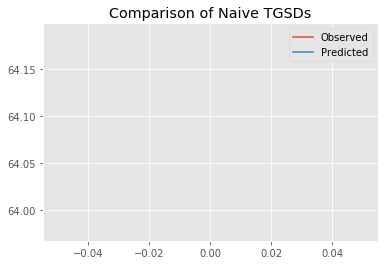

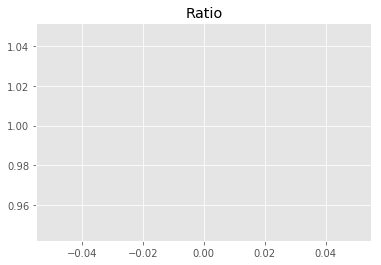

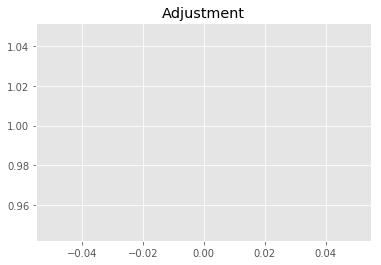

384327799.76459837
1


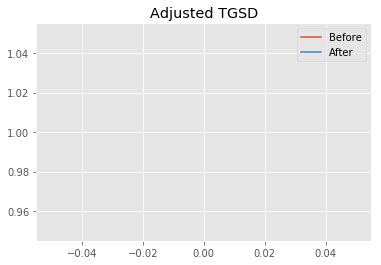

Old Total Mass: 3.8559e+08
New Total Mass: 3.8559e+08
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.15651 	3.77333 	5893.01 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Optimization terminated successfully.
         Current function value: 147.791459
         Iterations: 10
         Function evaluations: 49
New Total Mass: 3.8559e+08
After: 		|2.15651 	3.77333 	5893.01 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 147.791
New Misfit: 147.791
Convergence:
1.9230955334497995e-16

____________________
a = 2.15651	b = 3.77333	            h1 = 5893.00520	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 385589951.36837
Success: True
Status: Successful convergence.
Iterations: 2
Misfit: 147.79145880193963
Prior Misfit: 350.598,	 Post Misfit: 147.791


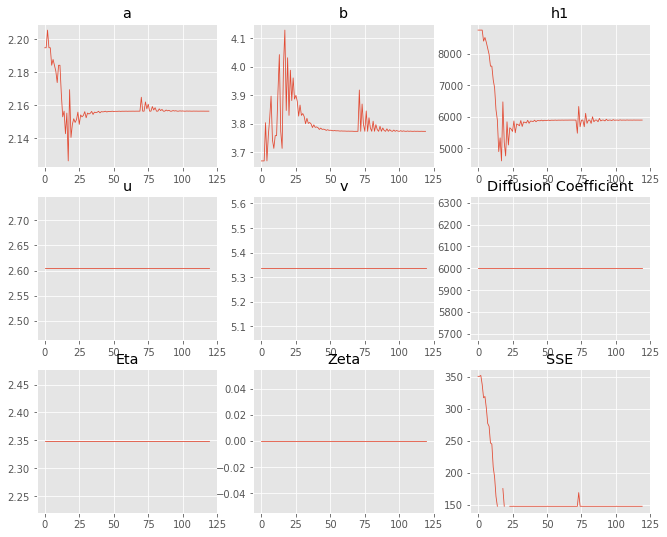

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,2.19488,2.15651
b,3.66944,3.77333
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"8,745.23","5,893.01"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 19 Time: 0.062 minutes


Estimated remaining run time: 0.000 minutes


Run 19===========================================================================
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	3.86e+08 	2.93e+01 	6.40e+01 	2.1860 		1.0000


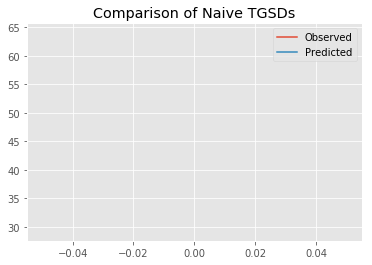

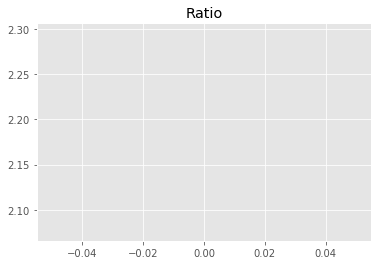

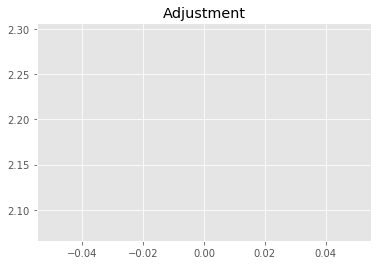

842881410.5253747
1


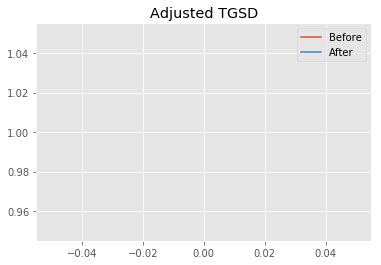

Old Total Mass: 3.8559e+08
New Total Mass: 3.8559e+08
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.32637 	3.82983 	9224.14 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
New Total Mass: 3.8559e+08
After: 		|2.10912 	4.60721 	6129.93 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 401.801
New Misfit: 147.791
Convergence:
0.6321770864238658

____________________
Phi: 	Theo Mass: 	Pred Mass: 	Obs Mass: 	Adjustment: 	Factor:
0 	3.86e+08 	6.42e+01 	6.40e+01 	0.9967 		1.0000


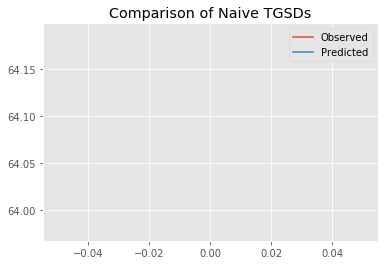

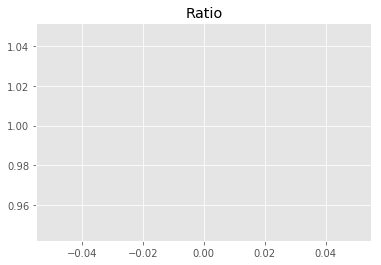

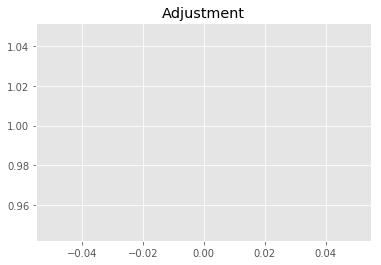

384327799.76459837
1


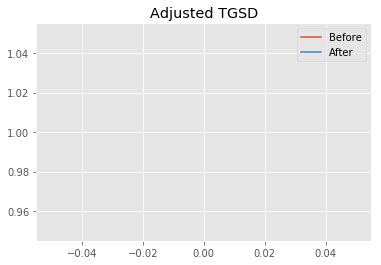

Old Total Mass: 3.8559e+08
New Total Mass: 3.8559e+08
Nelder-Mead Solver:
	 	|a: 		b: 		h1: 		u: 		v: 		D: 		ftt: 		eta: 		zeta:
--------------------------------------------------------------
Before: 	|2.10912 	4.60721 	6129.93 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Optimization terminated successfully.
         Current function value: 147.791459
         Iterations: 11
         Function evaluations: 54
New Total Mass: 3.8559e+08
After: 		|2.10912 	4.60721 	6129.93 	2.60482 	5.33615 	5999.9 	6458 	2.34894 	0
Old Misfit: 147.791
New Misfit: 147.791
Convergence:
1.9230955334497995e-16

____________________
a = 2.10912	b = 4.60721	            h1 = 6129.92725	u = 2.60482	v = 5.33615	            D = 5999.90000	ftt = 6458.00000	TM = 2.34894	            eta = 0.00000	zeta = 385589951.36837
Success: True
Status: Successful convergence.
Iterations: 2
Misfit: 147.79145880193963
Prior Misfit: 401.801,	 Post Misfit: 147.791


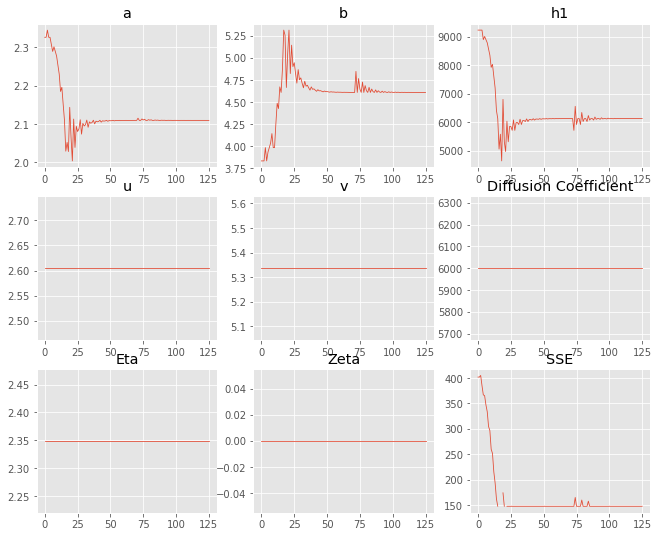

,Priors,Posteriors
D,"5,999.9","5,999.9"
a,2.32637,2.10912
b,3.82983,4.60721
eta,2.34894,2.34894
ftt,"6,458","6,458"
h1,"9,224.14","6,129.93"
u,2.60482,2.60482
v,5.33615,5.33615
zeta,0,0


Run 20 Time: 0.067 minutes


Estimated remaining run time: -0.057 minutes


Total Run Time: 1.19219 minutes


[{'a': 3.0433132595077326,
  'b': 4.9953899695796435,
  'h1': 5967.703530240569,
  'u': 2.60482,
  'v': 5.33615,
  'D': 5999.899999999996,
  'ftt': 6457.999999999996,
  'eta': 2.34894,
  'zeta': 0.0},
 {'a': 1.0586394660236578,
  'b': 2.6448436166459226,
  'h1': 5299.788349292739,
  'u': 2.60482,
  'v': 5.33615,
  'D': 5999.899999999996,
  'ftt': 6457.999999999996,
  'eta': 2.34894,
  'zeta': 0.0},
 {'a': 1.6307532036228276,
  'b': 241.34910453441552,
  'h1': 15944.514415368203,
  'u': 2.60482,
  'v': 5.33615,
  'D': 5999.899999999996,
  'ftt': 6457.999999999996,
  'eta': 2.34894,
  'zeta': 0.0},
 {'a': 1.8129097890960177,
  'b': 5.410694242669084,
  'h1': 6148.958886253312,
  'u': 2.60482,
  'v': 5.33615,
  'D': 5999.899999999996,
  'ftt': 6457.999999999996,
  'eta': 2.34894,
  'zeta': 0.0},
 {'a': 1.9999999999999996,
  'b': 6.865196761652646,
  'h1': 6086.127775133602,
  'u': 2.60482,
  'v': 5.33615,
  'D': 5999.899999999996,
  'ftt': 6457.999999999996,
  'eta': 2.34894,
  'zeta': 0.

,a,b,h1,u,v,D,ftt,eta,zeta,M,Misfit
0,3.04331,4.99539,"5,967.7",2.60482,5.33615,"5,999.9","6,458",2.34894,0,3.8559e+08,147.791
17,1.08186,105.003,"7,742.11",2.60482,5.33615,"5,999.9","6,458",2.34894,0,3.8559e+08,147.791
16,2.12073,3.41641,"5,931.11",2.60482,5.33615,"5,999.9","6,458",2.34894,0,3.8559e+08,147.791
15,1.01196,57.0984,"6,727.87",2.60482,5.33615,"5,999.9","6,458",2.34894,0,3.8559e+08,147.791
14,1.92746,4.5509,"6,123.84",2.60482,5.33615,"5,999.9","6,458",2.34894,0,3.8559e+08,147.791
13,1.02222,355.913,"13,960.1",2.60482,5.33615,"5,999.9","6,458",2.34894,0,3.8559e+08,147.791
12,1.01747,67.675,"7,274.49",2.60482,5.33615,"5,999.9","6,458",2.34894,0,3.8559e+08,147.791
11,1.96825,1.24599,"5,622.65",2.60482,5.33615,"5,999.9","6,458",2.34894,0,3.8559e+08,147.791
10,1.22954,90.5962,"8,646.47",2.60482,5.33615,"5,999.9","6,458",2.34894,0,3.8559e+08,147.791
9,1.83263,1.92251,"6,162.81",2.60482,5.33615,"5,999.9","6,458",2.34894,0,3.8559e+08,147.791


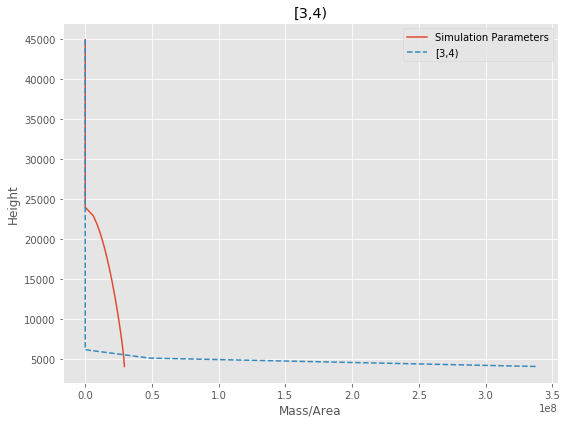

[3,4) Run Time: 1.19505 minutes


Mass Test: 54999999999.99999
Total Run Time: 12.91172 minutes


In [17]:
data_set = obs_df
t_tot = process_time()
single_run_time = 0
inverted_masses_list = []
params_list = []
iterations = 20
log="verb"
tgsd = get_tgsd(data_set, naive_phi_steps)


prior_phi_steps = copy.deepcopy(naive_phi_steps)
# for j, phi in enumerate(prior_phi_steps):
# #     phi["probability"] = 1/8
#     phi["probability"] = phi_probs[j]
params_dfs = []
all_misfits = []

phi_masses = []

mass_test = 0

for phi_step in prior_phi_steps:
    t = process_time()
    
    phi_df = data_set.copy()
    
    phi_df["MassArea"] = phi_df["MassArea"]*phi_df[phi_step["interval"]]/100
    phi_df[phi_step["interval"]] = 100
    mass_in_phi = config["ERUPTION_MASS"] * phi_step["probability"]
    mass_test += mass_in_phi

    
    print("========%s========"%phi_step["interval"])
    
#     out = gaussian_stack_inversion(
#         phi_df, len(phi_df), 20, config["VENT_ELEVATION"], 
#         H, 2500, [phi_step],
#         invert_params=invert_params,
#         priors=priors_vals,
#         column_cap=H)
#     inversion_table, params, sol, sse, plume_trace, param_trace, sse_trace = out
    iso_step = phi_step.copy()
    iso_step["probability"] = 1
    out = gaussian_stack_multi_run(
        phi_df, len(phi_df), int(config["INV_STEPS"]), 
        config["VENT_ELEVATION"], 
        config["THEO_MAX_COL"], 2500, [iso_step], mass_in_phi, param_config, runs=iterations, column_cap = config["THEO_MAX_COL"], pre_samples=5,
        sol_iter=20, max_iter=40, tol=0.006, 
        adjust_TGSD=False, adjust_mass=False,
        adjustment_factor=0.5
    )
    
    masses_list, misfit_list, params_runs, priors_list, heights, tgsd_list, mass_list = out
    best = np.argsort(misfit_list)
    
    params_df = pd.DataFrame(params_runs)
    display.display(params_runs)
    params_df["M"] = mass_list
    params_df["Misfit"] = misfit_list
    params_df = params_df.sort_values("Misfit")
    params_df = params_df[["a", "b", "h1", "u", "v", "D", "ftt", "eta", "zeta", "M", "Misfit"]]
    display.display(params_df)
    params_dfs += [params_df]
    
    all_misfits += [misfit_list]
    
    params = params_runs[best[0]]    
    params_list += [params]
    best_mass = mass_list[best[0]]
    phi_masses += [best_mass]
    
    inv_mass = mass_dist_in_plume(params["a"],params["b"], 
                                config["VENT_ELEVATION"], 
                                params["h1"], 
                                heights,
                                mass_in_phi)
    inverted_masses_list += [inv_mass]


     
    fig, ax1 = plt.subplots(1,1, figsize=(
    8, 6), facecolor='w', edgecolor='k')

    q_mass = mass_dist_in_plume(config["ALPHA"],config["BETA"], 
                                config["VENT_ELEVATION"], 
                                config["PLUME_HEIGHT"], 
                                heights,
                                mass_in_phi)

    ax1.plot(q_mass, heights, label="Simulation Parameters")
    
    ax1.plot(inv_mass, heights, 
             '--', label=phi_step["interval"])
    ax1.legend()
    ax1.set_title("%s"%phi_step["interval"])
    ax1.set_ylabel("Height")
    ax1.set_xlabel("Mass/Area")

    plt.tight_layout()
    plt.show()
    run_time = process_time() - t
    print("%s Run Time: %.5f minutes\n\n"%(phi_step["interval"], run_time/60))
    print("Mass Test:", mass_test)
total_run_time = process_time() - t_tot

print("Total Run Time: %.5f minutes"%(total_run_time/60))

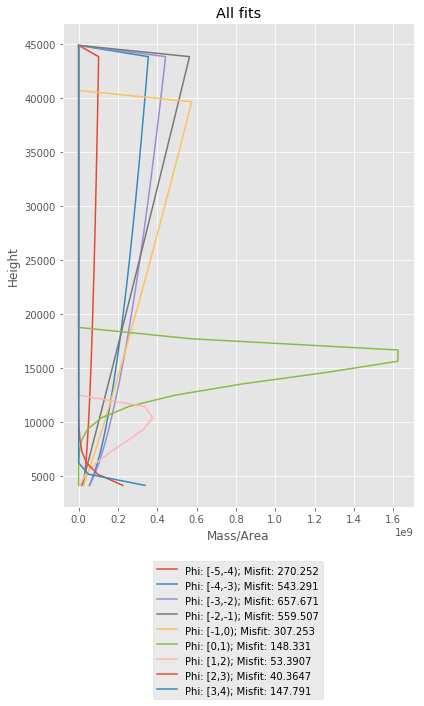

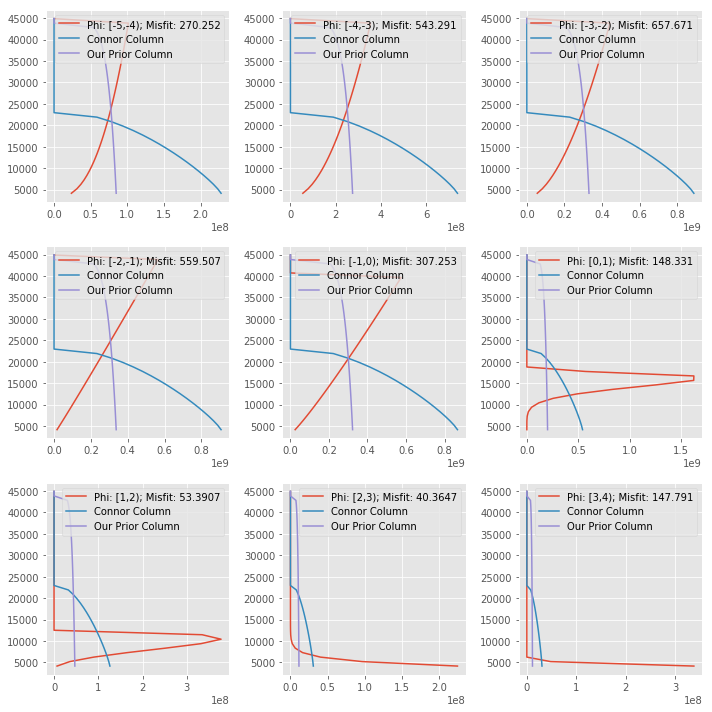

Phi Class: [-5,-4)

,a,b,h1,u,v,D,ftt,eta,zeta,M,Misfit
14,1.39718,1,"44,912",2.60482,5.33615,"5,999.9","6,458",2.34894,0,2.8774e+09,261.875
10,1.39877,1,"44,911.3",2.60482,5.33615,"5,999.9","6,458",2.34894,0,2.8774e+09,261.875
16,1.39665,1.00001,"44,915",2.60482,5.33615,"5,999.9","6,458",2.34894,0,2.8774e+09,261.875
8,1.39908,1.00002,"44,796.6",2.60482,5.33615,"5,999.9","6,458",2.34894,0,2.8774e+09,261.875
5,1.4006,1.00001,"44,827.6",2.60482,5.33615,"5,999.9","6,458",2.34894,0,2.8774e+09,261.875
12,1.39856,1.00005,"44,325.8",2.60482,5.33615,"5,999.9","6,458",2.34894,0,2.8774e+09,261.876
1,1.39944,1.00008,"44,876.3",2.60482,5.33615,"5,999.9","6,458",2.34894,0,2.8774e+09,261.877
17,1.40426,1.00008,"44,915",2.60482,5.33615,"5,999.9","6,458",2.34894,0,2.8774e+09,261.879
15,1.39482,1.00028,"43,980.2",2.60482,5.33615,"5,999.9","6,458",2.34894,0,2.8774e+09,261.883
13,1.40747,1.00008,"44,745.3",2.60482,5.33615,"5,999.9","6,458",2.34894,0,2.8774e+09,261.883


Phi Class: [-4,-3)

,a,b,h1,u,v,D,ftt,eta,zeta,M,Misfit
6,1.50953,1,"44,903.8",2.60482,5.33615,"5,999.9","6,458",2.34894,0,9.31979e+09,543.287
3,1.50982,1.00001,"44,913.4",2.60482,5.33615,"5,999.9","6,458",2.34894,0,9.31979e+09,543.287
19,1.51057,1.00001,"44,378.6",2.60482,5.33615,"5,999.9","6,458",2.34894,0,9.31979e+09,543.287
13,1.50897,1.00002,"44,914.7",2.60482,5.33615,"5,999.9","6,458",2.34894,0,9.31979e+09,543.287
15,1.51201,1.00001,"44,915",2.60482,5.33615,"5,999.9","6,458",2.34894,0,9.31979e+09,543.288
8,1.50559,1.00004,"44,914.9",2.60482,5.33615,"5,999.9","6,458",2.34894,0,9.31979e+09,543.29
10,1.514,1.00004,"44,675.3",2.60482,5.33615,"5,999.9","6,458",2.34894,0,9.31979e+09,543.291
0,1.50554,1.00007,"44,696.5",2.60482,5.33615,"5,999.9","6,458",2.34894,0,9.31979e+09,543.291
9,1.51267,1.00008,"44,914.1",2.60482,5.33615,"5,999.9","6,458",2.34894,0,9.31979e+09,543.292
11,1.50585,1.0001,"44,438.3",2.60482,5.33615,"5,999.9","6,458",2.34894,0,9.31979e+09,543.293


Phi Class: [-3,-2)

,a,b,h1,u,v,D,ftt,eta,zeta,M,Misfit
8,1.56636,1,"44,803.1",2.60482,5.33615,"5,999.9","6,458",2.34894,0,1.1215e+10,657.671
11,1.56572,1,"44,915",2.60482,5.33615,"5,999.9","6,458",2.34894,0,1.1215e+10,657.671
12,1.56564,1,"44,915",2.60482,5.33615,"5,999.9","6,458",2.34894,0,1.1215e+10,657.671
0,1.56605,1,"44,255.8",2.60482,5.33615,"5,999.9","6,458",2.34894,0,1.1215e+10,657.671
15,1.56444,1,"44,915",2.60482,5.33615,"5,999.9","6,458",2.34894,0,1.1215e+10,657.671
10,1.56778,1,"44,366.5",2.60482,5.33615,"5,999.9","6,458",2.34894,0,1.1215e+10,657.671
5,1.56898,1.00001,"44,915",2.60482,5.33615,"5,999.9","6,458",2.34894,0,1.1215e+10,657.672
1,1.56103,1.00001,"44,463.9",2.60482,5.33615,"5,999.9","6,458",2.34894,0,1.1215e+10,657.674
7,1.56305,1.00003,"44,019",2.60482,5.33615,"5,999.9","6,458",2.34894,0,1.1215e+10,657.674
9,1.56358,1.00004,"44,423.6",2.60482,5.33615,"5,999.9","6,458",2.34894,0,1.1215e+10,657.675


Phi Class: [-2,-1)

,a,b,h1,u,v,D,ftt,eta,zeta,M,Misfit
6,1.96971,1,"44,915",2.60482,5.33615,"5,999.9","6,458",2.34894,0,1.14451e+10,546.826
18,1.97014,1,"44,533",2.60482,5.33615,"5,999.9","6,458",2.34894,0,1.14451e+10,546.826
19,1.97064,1,"44,912",2.60482,5.33615,"5,999.9","6,458",2.34894,0,1.14451e+10,546.826
15,1.96885,1,"44,915",2.60482,5.33615,"5,999.9","6,458",2.34894,0,1.14451e+10,546.826
8,1.97155,1,"44,915",2.60482,5.33615,"5,999.9","6,458",2.34894,0,1.14451e+10,546.826
11,1.96862,1,"44,199.5",2.60482,5.33615,"5,999.9","6,458",2.34894,0,1.14451e+10,546.826
9,1.97063,1,"43,955.7",2.60482,5.33615,"5,999.9","6,458",2.34894,0,1.14451e+10,546.826
13,1.96994,1,"44,914.8",2.60482,5.33615,"5,999.9","6,458",2.34894,0,1.14451e+10,546.826
10,1.97857,1,"44,245.4",2.60482,5.33615,"5,999.9","6,458",2.34894,0,1.14451e+10,546.827
16,1.99295,1.00003,"44,901.5",2.60482,5.33615,"5,999.9","6,458",2.34894,0,1.14451e+10,546.836


Phi Class: [-1,0)

,a,b,h1,u,v,D,ftt,eta,zeta,M,Misfit
19,1.88879,1.00007,"40,568.3",2.60482,5.33615,"5,999.9","6,458",2.34894,0,1.09416e+10,300.295
7,1.87217,1.22298,"43,869.3",2.60482,5.33615,"5,999.9","6,458",2.34894,0,1.09416e+10,300.39
5,1.87764,1.23267,"43,922.9",2.60482,5.33615,"5,999.9","6,458",2.34894,0,1.09416e+10,300.404
17,1.92641,1.26703,"43,879.4",2.60482,5.33615,"5,999.9","6,458",2.34894,0,1.09416e+10,300.45
4,1.87745,1.25577,"44,897.7",2.60482,5.33615,"5,999.9","6,458",2.34894,0,1.09416e+10,300.474
15,1.88133,1.25938,"44,915",2.60482,5.33615,"5,999.9","6,458",2.34894,0,1.09416e+10,300.475
11,1.88142,1.25824,"44,913.8",2.60482,5.33615,"5,999.9","6,458",2.34894,0,1.09416e+10,300.475
9,1.88179,1.26026,"44,915",2.60482,5.33615,"5,999.9","6,458",2.34894,0,1.09416e+10,300.475
2,1.87942,1.25728,"44,915",2.60482,5.33615,"5,999.9","6,458",2.34894,0,1.09416e+10,300.475
14,1.87543,1.25493,"44,915",2.60482,5.33615,"5,999.9","6,458",2.34894,0,1.09416e+10,300.476


Phi Class: [0,1)

,a,b,h1,u,v,D,ftt,eta,zeta,M,Misfit
2,7.89436,1.92387,"17,962.4",2.60482,5.33615,"5,999.9","6,458",2.34894,0,6.83614e+09,148.172
10,7.02679,1.01486,"16,692.7",2.60482,5.33615,"5,999.9","6,458",2.34894,0,6.83614e+09,148.175
16,6.96781,2.13679,"18,773.2",2.60482,5.33615,"5,999.9","6,458",2.34894,0,6.83614e+09,148.196
14,6.67614,2.05299,"18,786.6",2.60482,5.33615,"5,999.9","6,458",2.34894,0,6.83614e+09,148.201
15,7.21065,2.22009,"18,788.3",2.60482,5.33615,"5,999.9","6,458",2.34894,0,6.83614e+09,148.202
8,7.39069,2.29629,"18,801.7",2.60482,5.33615,"5,999.9","6,458",2.34894,0,6.83614e+09,148.207
3,6.22343,1.89511,"18,797.7",2.60482,5.33615,"5,999.9","6,458",2.34894,0,6.83614e+09,148.216
7,5.70286,1.72781,"18,785.8",2.60482,5.33615,"5,999.9","6,458",2.34894,0,6.83614e+09,148.261
4,8.89695,3.05008,"19,169.1",2.60482,5.33615,"5,999.9","6,458",2.34894,0,6.83614e+09,148.281
6,7.23099,2.60728,"19,546.9",2.60482,5.33615,"5,999.9","6,458",2.34894,0,6.83614e+09,148.282


Phi Class: [1,2)

,a,b,h1,u,v,D,ftt,eta,zeta,M,Misfit
0,3.51607,1.61529,"12,402.3",2.60482,5.33615,"5,999.9","6,458",2.34894,0,1.59164e+09,53.3907
12,4.28767,2.19606,"12,492.3",2.60482,5.33615,"5,999.9","6,458",2.34894,0,1.59164e+09,53.7466
7,4.04825,1.01107,"11,074.8",2.60482,5.33615,"5,999.9","6,458",2.34894,0,1.59164e+09,53.8971
3,4.12708,2.3099,"12,500.2",2.60482,5.33615,"5,999.9","6,458",2.34894,0,1.59164e+09,54.0456
11,4.37501,2.50201,"12,573.1",2.60482,5.33615,"5,999.9","6,458",2.34894,0,1.59164e+09,54.1011
9,4.26978,2.47564,"12,644.7",2.60482,5.33615,"5,999.9","6,458",2.34894,0,1.59164e+09,54.1051
5,4.49133,2.51349,"12,520.7",2.60482,5.33615,"5,999.9","6,458",2.34894,0,1.59164e+09,54.1094
14,3.39011,1.81871,"12,497.1",2.60482,5.33615,"5,999.9","6,458",2.34894,0,1.59164e+09,54.1745
4,5.7655,5.73581,"15,292.8",2.60482,5.33615,"5,999.9","6,458",2.34894,0,1.59164e+09,54.8664
2,6.00295,6.24999,"15,498.3",2.60482,5.33615,"5,999.9","6,458",2.34894,0,1.59164e+09,54.8881


Phi Class: [2,3)

,a,b,h1,u,v,D,ftt,eta,zeta,M,Misfit
15,1.00427,29.3646,"39,610.2",2.60482,5.33615,"5,999.9","6,458",2.34894,0,3.87664e+08,39.5822
10,1.00103,27.1626,"36,267.9",2.60482,5.33615,"5,999.9","6,458",2.34894,0,3.87664e+08,39.6036
11,1.0174,25.3639,"34,224.5",2.60482,5.33615,"5,999.9","6,458",2.34894,0,3.87664e+08,39.6238
8,1.0166,22.84,"31,478.8",2.60482,5.33615,"5,999.9","6,458",2.34894,0,3.87664e+08,39.6408
17,1.00087,19.9095,"27,682.8",2.60482,5.33615,"5,999.9","6,458",2.34894,0,3.87664e+08,39.6714
19,1.0051,15.115,"22,896.3",2.60482,5.33615,"5,999.9","6,458",2.34894,0,3.87664e+08,39.7313
16,1.00816,13.4116,"21,076.3",2.60482,5.33615,"5,999.9","6,458",2.34894,0,3.87664e+08,39.7733
3,1.96506,36.2637,"31,662.7",2.60482,5.33615,"5,999.9","6,458",2.34894,0,3.87664e+08,40.234
14,2.00044,32.1037,"29,193.2",2.60482,5.33615,"5,999.9","6,458",2.34894,0,3.87664e+08,40.2577
9,1.78493,17.0377,"18,537.2",2.60482,5.33615,"5,999.9","6,458",2.34894,0,3.87664e+08,40.3105


Phi Class: [3,4)

,a,b,h1,u,v,D,ftt,eta,zeta,M,Misfit
0,3.04331,4.99539,"5,967.7",2.60482,5.33615,"5,999.9","6,458",2.34894,0,3.8559e+08,147.791
17,1.08186,105.003,"7,742.11",2.60482,5.33615,"5,999.9","6,458",2.34894,0,3.8559e+08,147.791
16,2.12073,3.41641,"5,931.11",2.60482,5.33615,"5,999.9","6,458",2.34894,0,3.8559e+08,147.791
15,1.01196,57.0984,"6,727.87",2.60482,5.33615,"5,999.9","6,458",2.34894,0,3.8559e+08,147.791
14,1.92746,4.5509,"6,123.84",2.60482,5.33615,"5,999.9","6,458",2.34894,0,3.8559e+08,147.791
13,1.02222,355.913,"13,960.1",2.60482,5.33615,"5,999.9","6,458",2.34894,0,3.8559e+08,147.791
12,1.01747,67.675,"7,274.49",2.60482,5.33615,"5,999.9","6,458",2.34894,0,3.8559e+08,147.791
11,1.96825,1.24599,"5,622.65",2.60482,5.33615,"5,999.9","6,458",2.34894,0,3.8559e+08,147.791
10,1.22954,90.5962,"8,646.47",2.60482,5.33615,"5,999.9","6,458",2.34894,0,3.8559e+08,147.791
9,1.83263,1.92251,"6,162.81",2.60482,5.33615,"5,999.9","6,458",2.34894,0,3.8559e+08,147.791


In [18]:
fig, ax1 = plt.subplots(1,1, figsize=(6, 10), facecolor='w', edgecolor='k')

for i, phi_step in enumerate(prior_phi_steps):
    label = "Phi: %s; Misfit: %g"%(phi_step["interval"], params_dfs[i]["Misfit"][0])
    ax1.plot(inverted_masses_list[i],
             heights, 
             '-', label=label)
ax1.legend(loc='upper center', bbox_to_anchor=(0.5, -0.1))
ax1.set_title("All fits")
ax1.set_ylabel("Height")
ax1.set_xlabel("Mass/Area")
plt.tight_layout()
plt.show()

q_mass = beta_plume(config["ALPHA"],config["BETA"],config["PLUME_HEIGHT"],
                config["ERUPTION_MASS"],
                heights,
                config["VENT_ELEVATION"], 
                config["THEO_MAX_COL"])

q_mass_prior = beta_plume(config["ALPHA"],config["BETA"],config["PLUME_HEIGHT"],
                config["ERUPTION_MASS"],
                heights,
                config["VENT_ELEVATION"], 
                config["THEO_MAX_COL"])

fig, axs = plt.subplots(3,3, figsize=(
            10, 10), facecolor='w', edgecolor='k')
axs = axs.ravel()

for j, phi_step in enumerate(prior_phi_steps):
    q_mass = beta_plume(config["ALPHA"],config["BETA"],config["PLUME_HEIGHT"],
                phi_masses[j],
                heights,
                config["VENT_ELEVATION"], 
                config["THEO_MAX_COL"])

    q_mass_prior = beta_plume(1.00002,1.13405 ,44908,
                phi_masses[j],
                heights,
                config["VENT_ELEVATION"], 
                config["THEO_MAX_COL"])
    
    label = "Phi: %s; Misfit: %g"%(phi_step["interval"], params_dfs[j]["Misfit"][0])
    axs[j].plot(inverted_masses_list[j],
             heights, 
             '-', label=label)
    axs[j].plot(q_mass, heights, label="Connor Column")
    axs[j].plot(q_mass_prior, heights, label="Our Prior Column")
    axs[j].legend()
plt.tight_layout()
plt.show()


for j, phi_step in enumerate(prior_phi_steps):
    display.display_markdown(display.Markdown('''Phi Class: %s'''%phi_step['interval']))
    display.display(params_dfs[j])




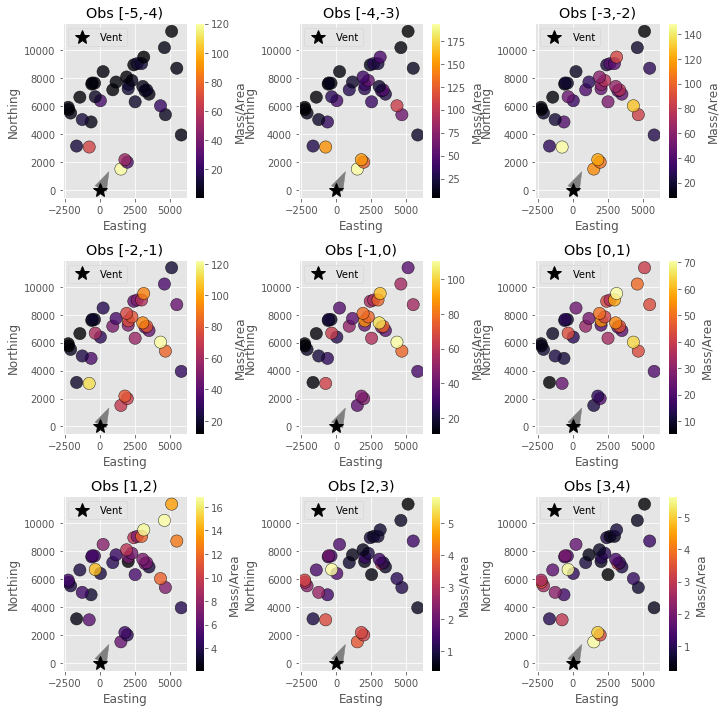

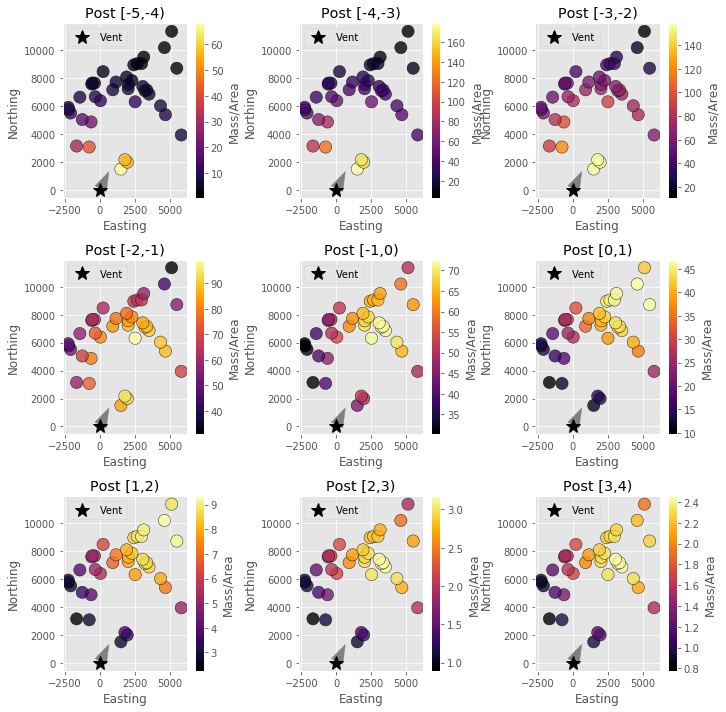

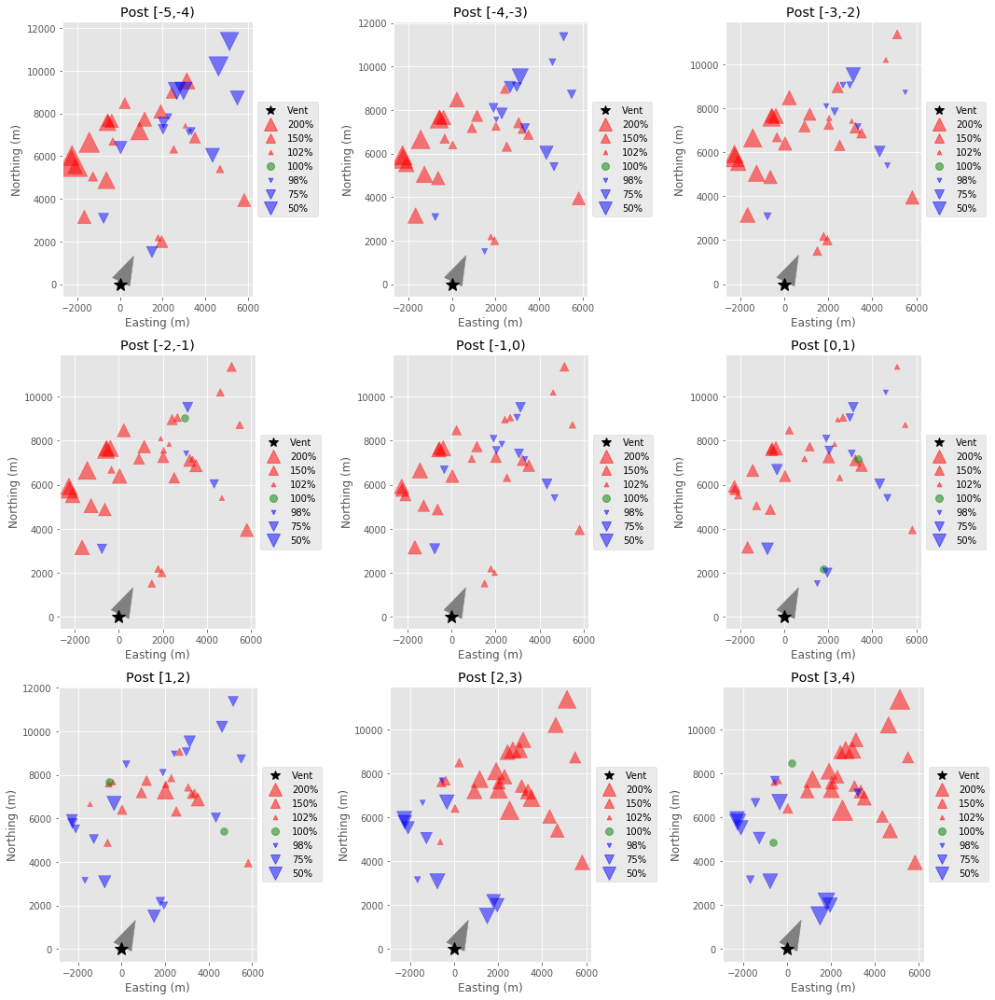

In [19]:
observation_phis = []
posterior_phis = []

for j, phi_step in enumerate(prior_phi_steps):
    phi_obs = data_set.copy()
    phi_obs["MassArea"] = phi_obs["MassArea"]*phi_obs[phi_step["interval"]]/100
    phi_obs[phi_step["interval"]] = 100
    bounds=(0, 200)

    observation_phis += [phi_obs]
    _, phi_post, _, _, _ = gaussian_stack_single_phi(
        grid, int(config["COL_STEPS"]), config["VENT_ELEVATION"], 
        params_list[j]["h1"], (params_list[j]["a"],params_list[j]["b"]), 
        phi_masses[j], (params_list[j]["u"],params_list[j]["v"]), phi_step["lower"], 
        phi_step["density"],2500,
        params_list[j]["D"], config["EDDY_CONST"],
        params_list[j]["ftt"], params_list[j]["eta"], params_list[j]["zeta"]
    )
    phi_post["radius"] = np.sqrt(phi_post["Easting"]**2 + phi_post["Northing"]**2)
    phi_post = phi_post.sort_values(by=['radius'])
    phi_post["Residual"] = phi_post["MassArea"].values/phi_obs["MassArea"].values
    
    posterior_phis += [phi_post]

fig, axs = plt.subplots(3,3, figsize=(
            10, 10), facecolor='w', edgecolor='k')
axs = axs.ravel()
for j, phi_step in enumerate(prior_phi_steps):
    vis.plot_sample(observation_phis[j], vent=(0,0), log=False,#bounds=bounds, 
                   title="Obs %s"%phi_step["interval"], cbar_label="Mass/Area", ax=axs[j],
                   wind=(params_list[j]["u"]*20,params_list[j]["v"]*20))


plt.tight_layout()
plt.show()

fig, axs = plt.subplots(3,3, figsize=(
            10, 10), facecolor='w', edgecolor='k')
axs = axs.ravel()

for j, phi_step in enumerate(prior_phi_steps):
    vis.plot_sample(posterior_phis[j], vent=(0,0), log=False,#bounds=bounds, 
                   title="Post %s"%phi_step["interval"], cbar_label="Mass/Area", ax=axs[j],
                   wind=(params_list[j]["u"]*20,params_list[j]["v"]*20))
    
plt.tight_layout()
plt.show()

fig, axs = plt.subplots(3,3, figsize=(
            15, 15), facecolor='w', edgecolor='k')
axs = axs.ravel()

for j, phi_step in enumerate(prior_phi_steps):
    vis.plot_residuals(posterior_phis[j], vent=(0,0), plot_type="size",
                   title="Post %s"%phi_step["interval"], ax=axs[j],
                   wind=(params_list[j]["u"]*20,params_list[j]["v"]*20))
    
plt.tight_layout()
plt.show()

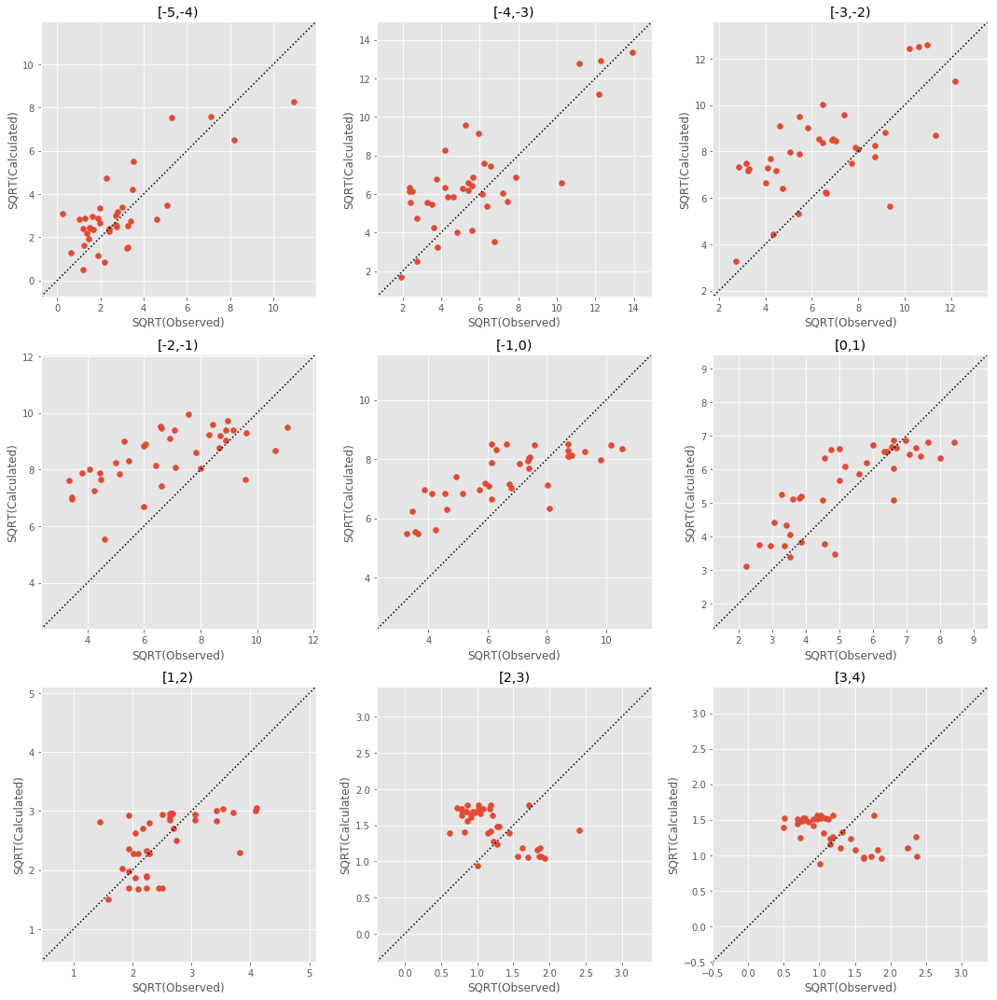

In [20]:
fig, axs = plt.subplots(3,3, figsize=(
            15, 15), facecolor='w', edgecolor='k')
axs = axs.ravel()

for j, phi_step in enumerate(prior_phi_steps):
    min_mass = min((min(observation_phis[j]["MassArea"].values), min(posterior_phis[j]["MassArea"].values)))
    max_mass = max((max(observation_phis[j]["MassArea"].values), max(posterior_phis[j]["MassArea"].values)))
    axs[j].scatter(np.sqrt(observation_phis[j]["MassArea"].values), np.sqrt(posterior_phis[j]["MassArea"].values))
    axs[j].plot([-100,100],[-100,100], "k:")
    axs[j].set_xlabel("SQRT(Observed)")
    axs[j].set_ylabel("SQRT(Calculated)")
    axs[j].set_aspect('equal', 'box')
    axs[j].set_title(phi_step["interval"])
    axs[j].set_xlim([np.sqrt(min_mass)-1, np.sqrt(max_mass)+1])
    axs[j].set_ylim([np.sqrt(min_mass)-1, np.sqrt(max_mass)+1])
    
plt.tight_layout()
plt.show()

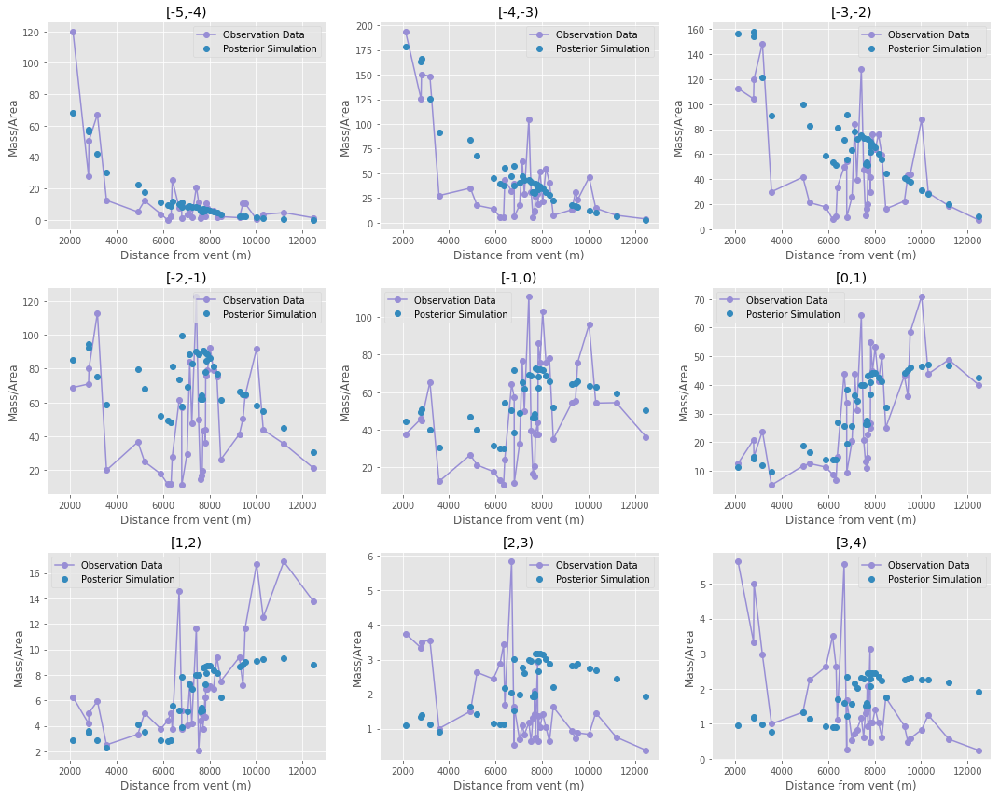

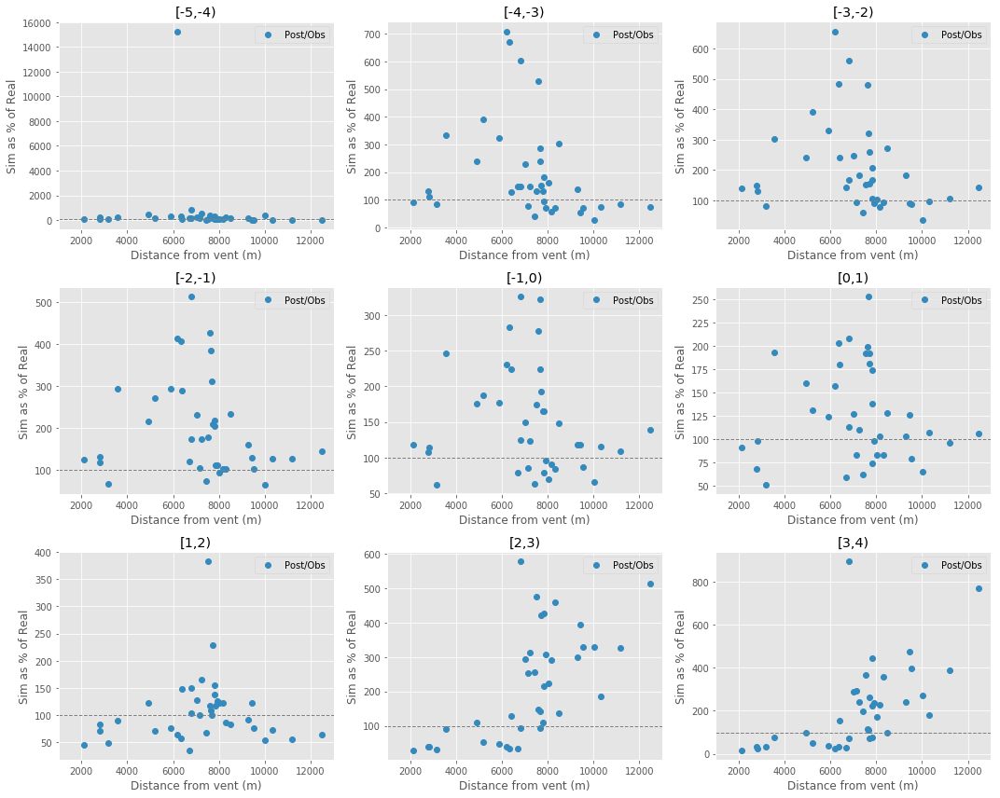

In [21]:
fig, axs = plt.subplots(3,3, figsize=(
            15, 12), facecolor='w', edgecolor='k')
axs = axs.ravel()

for j, phi_step in enumerate(prior_phi_steps):
    axs[j].plot(observation_phis[j]["radius"].values, observation_phis[j]["MassArea"].values, 'C2o-', label="Observation Data")
    axs[j].plot(posterior_phis[j]["radius"].values, posterior_phis[j]["MassArea"].values, 'C1o', label="Posterior Simulation")
    axs[j].legend()
    axs[j].set_title(phi_step["interval"])
    axs[j].set_xlabel("Distance from vent (m)")
    axs[j].set_ylabel("Mass/Area")
    axs[j].set_xlim(1000, 13000)
    
plt.tight_layout()
plt.show()

fig, axs = plt.subplots(3,3, figsize=(
            15, 12), facecolor='w', edgecolor='k')
axs = axs.ravel()

for j, phi_step in enumerate(prior_phi_steps):
    axs[j].plot(posterior_phis[j]["radius"].values, posterior_phis[j]["Residual"].values*100, 'C1o', label="Post/Obs")
    axs[j].axhline(100, linestyle="--", lw=1, c="gray")  
    axs[j].legend()
    axs[j].set_xlabel("Distance from vent (m)")
    axs[j].set_title(phi_step["interval"])
    axs[j].set_ylabel("Sim as % of Real")
    axs[j].set_xlim(1000, 13000)
    
plt.tight_layout()
plt.show()

261.874597745488
38
543.2867845512999
38
657.6712089615357
38
546.8258496207652
38
300.29509401725585
38
148.17180186021858
38
53.3906538326101
38
39.582152100563775
38
147.79145880193963
38


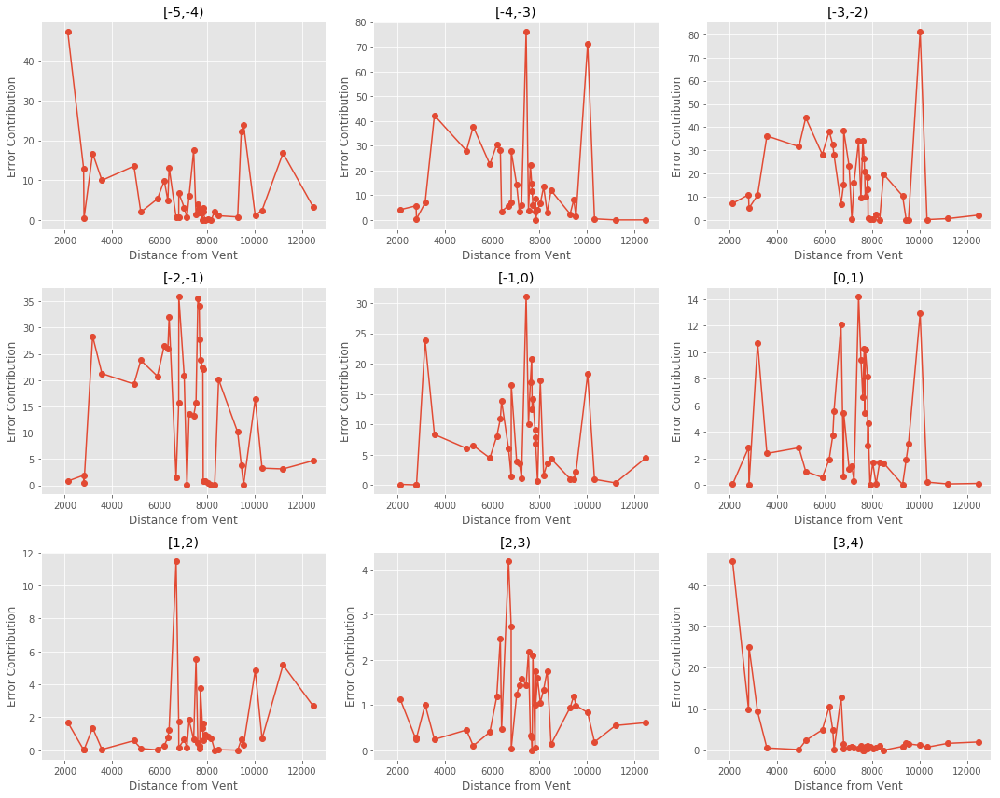

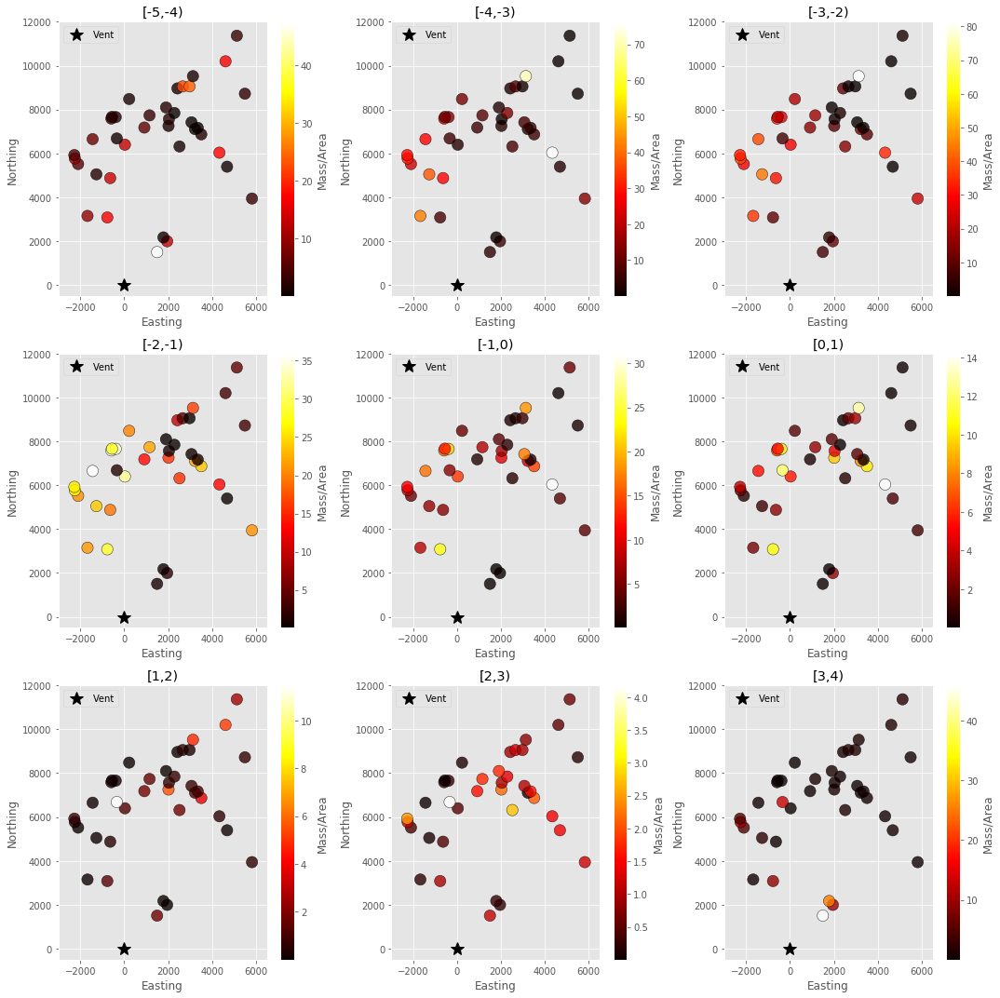

In [26]:


all_point_conts = []
all_phi_conts = []

for j, phi_step in enumerate(prior_phi_steps):
    iso_step = phi_step.copy()
    iso_step["probability"] = 1
    misfit, contributions, setup = get_error_contributions(
        observation_phis[j], len(observation_phis[j]), int(config["INV_STEPS"]), 
        config["VENT_ELEVATION"], config["THEO_MAX_COL"], 2500, [iso_step], 
        params_list[j], phi_masses[j], column_cap = config["THEO_MAX_COL"])
    
    print(misfit)
    print(len(contributions[0]))
    point_contributions = np.sum(contributions, 0)
    phi_contributions = np.sum(contributions, 1)
    
    all_point_conts += [point_contributions]
    all_phi_conts += [phi_contributions]
    

fig, axs = plt.subplots(3,3, figsize=(
            15, 12), facecolor='w', edgecolor='k')
axs = axs.ravel()
for j, phi_step in enumerate(prior_phi_steps):
    axs[j].plot(observation_phis[j]["radius"], all_point_conts[j], "C0o-")
    axs[j].set_xlabel("Distance from Vent")
    axs[j].set_ylabel("Error Contribution")
    axs[j].set_title(phi_step["interval"])
    axs[j].set_xlim(1000, 13000)

plt.tight_layout()
plt.show()

fig, axs = plt.subplots(3,3, figsize=(
            15, 15), facecolor='w', edgecolor='k')
axs = axs.ravel()
for j, phi_step in enumerate(prior_phi_steps):
    observation_phis[j]["Contributions"] = all_point_conts[j]
    vis.plot_sample(observation_phis[j], vent=(0,0), log=False, values="Contributions",
                title="Error Contributions", cbar_label="Mass/Area", ax = axs[j], cmap="hot")
    axs[j].set_xlim([-3000, 6500])
    axs[j].set_ylim([-500, 12000])
    axs[j].set_title(phi_step["interval"])

plt.tight_layout()
plt.show()

In [59]:
sum(sum(all_point_conts))

2698.8771866439374

[-5,-4) 294.54202905216937
[-4,-3) 627.8649052751365
[-3,-2) 726.0760180774736
[-2,-1) 612.3302070529672
[-1,0) 408.5427331938268
[0,1) 559.5133531470638
[1,2) 615.5732404780476
[2,3) 813.8846940923594
[3,4) 5805.307069153514
Full Misfit:  10463.634249522562


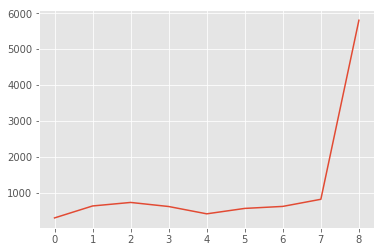

In [51]:
all_point_conts = []
all_phi_conts = []

for j, phi_step in enumerate(prior_phi_steps):
    iso_step = phi_step.copy()
    iso_step["probability"] = 1
    misfit, contributions, setup = get_error_contributions(
        observation_phis[j], len(observation_phis[j]), int(config["INV_STEPS"]), 
        config["VENT_ELEVATION"], config["THEO_MAX_COL"], 2500, [iso_step], 
        full_inversion_priors, phi_masses[j], column_cap = config["THEO_MAX_COL"])
    
    print(phi_step["interval"], misfit)
    
    point_contributions = np.sum(contributions, 0)
    phi_contributions = np.sum(contributions, 1)
    all_point_conts += [point_contributions]
    all_phi_conts += [phi_contributions]
    
print("Full Misfit: ", sum(sum(all_point_conts)))
plt.plot(all_phi_conts)
plt.show()


In [50]:
misfit, contributions, setup = get_error_contributions(
        data_set, len(data_set), int(config["INV_STEPS"]), 
        config["VENT_ELEVATION"], config["THEO_MAX_COL"], 2500, prior_phi_steps, 
        full_inversion_priors, config["ERUPTION_MASS"], column_cap = config["THEO_MAX_COL"])
print("Full misfit", misfit)
point_contributions = np.sum(contributions, 0)
phi_contributions = np.sum(contributions, 1)
print("Point Contributions", point_contributions)
print("Phi Contributions", phi_contributions)

print("Sum of Point Conts:", sum(point_contributions))
print("Sum of Phi Conts:", sum(phi_contributions))

Full misfit 10463.634249522558
Point Contributions [1850.76261945  631.0265232  1132.18071308  522.97099825  232.10277851
  173.4403227   326.90795501  375.66914868  628.77647898  445.37509353
  129.12182443  898.45032605   34.4975931   198.1962214    57.59364358
   56.37422173   43.02110544  383.57975528   34.39600536  131.37072961
  125.49654204  158.00395182   47.58550556  164.66185169   45.18754932
   81.20398339   55.99174744   90.67127807   80.93157208   81.26858231
  106.71263377   56.42816876   82.33059675  153.39117833  541.51558613
   87.64643776  144.78063753   74.0123894 ]
Phi Contributions [ 294.54202905  627.86490528  726.07601808  612.33020705  408.54273319
  559.51335315  615.57324048  813.88469409 5805.30706915]
Sum of Point Conts: 10463.634249522562
Sum of Phi Conts: 10463.63424952256


In [222]:
print(sum(phi_masses))
print(config["ERUPTION_MASS"])
print(55000000000.0)

55000000000.0
55000000000.0
55000000000.0
